# **Предсказание вероятности риска развития заболеваний сердечно-сосудистой системы**

**Соревнование на Kaggle**

https://www.kaggle.com/competitions/yap15-heart-diseases-predictions

In [1]:
#from google.colab import files
#files.upload()

In [2]:
# import json 
# import os 
# os.chdir("C:/Users/Elena/.kaggle")
# data = {"username":"*****","key":"****"} # get this data from kaggle.json file 
# with open('kaggle.json', 'w') as outfile:
#     json.dump(data, outfile)

In [3]:
# ! kaggle competitions download -c yap15-heart-diseases-predictions

In [4]:
# ! unzip C:/Users/Elena/.kaggle/yap15-heart-diseases-predictions.zip

# Первичный анализ датасета

In [5]:
import sklearn

In [6]:
print('The scikit-learn version is {}.'.format(sklearn.__version__))

The scikit-learn version is 1.1.3.


In [7]:
! pip install pandas-profiling

In [8]:
!pip install optuna

In [9]:
conda install -c anaconda py-xgboost

Solving environment: ...working... done

# All requested packages already installed.

Retrieving notices: ...working... done

Note: you may need to restart the kernel to use updated packages.


In [10]:
conda install -c conda-forge catboost

Solving environment: ...working... done

# All requested packages already installed.

Retrieving notices: ...working... done

Note: you may need to restart the kernel to use updated packages.




==> WARNING: A newer version of conda exists. <==
  current version: 22.9.0
  latest version: 23.1.0

Please update conda by running

    $ conda update -n base -c conda-forge conda




In [11]:
conda install -c conda-forge shap

Solving environment: ...working... done

# All requested packages already installed.

Retrieving notices: ...working... done

Note: you may need to restart the kernel to use updated packages.




==> WARNING: A newer version of conda exists. <==
  current version: 22.9.0
  latest version: 23.1.0

Please update conda by running

    $ conda update -n base -c conda-forge conda




In [12]:
# Импортируем библиотеки
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import seaborn as sns
import itertools
import pandas_profiling
import optuna
import shap
import xgboost as xgb
import catboost as catboost
%matplotlib inline 
from sklearn import tree
from shap import TreeExplainer
from catboost import CatBoostClassifier, Pool
from catboost.utils import eval_metric
from optuna.integration import CatBoostPruningCallback
from optuna.pruners import MedianPruner
from sklearn.utils import shuffle
from sklearn.metrics import accuracy_score, confusion_matrix
from sklearn.metrics import roc_curve 
from sklearn.metrics import roc_auc_score
from sklearn.metrics import f1_score, precision_score, recall_score
from sklearn.tree import DecisionTreeClassifier
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.linear_model import LogisticRegression
from sklearn.preprocessing import StandardScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.model_selection import GridSearchCV, train_test_split
from sklearn.model_selection import RandomizedSearchCV
from sklearn.model_selection import cross_val_score
from numpy.random import RandomState
from scipy.stats import randint
from scipy import stats as st
from tqdm import tqdm
pd.options.mode.chained_assignment = None
pd.options.display.max_colwidth = 200
import warnings
warnings.filterwarnings("ignore")

In [13]:
# Установим константы
RANDOM_STATE = 42
CV = 5
VERBOSE = 100
SCORING = 'roc_auc'

In [14]:
# Загрузим данные из файла в датафрейм
data_train = pd.read_csv('C:/Users/Elena/.kaggle/train.csv')
data_train.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
0,0,18393,2,168,62.0,110,80,1,1,0,0,1,0
1,1,20228,1,156,85.0,140,90,3,1,0,0,1,1
2,2,18857,1,165,64.0,130,70,3,1,0,0,0,1
3,3,17623,2,169,82.0,150,100,1,1,0,0,1,1
4,4,17474,1,156,56.0,100,60,1,1,0,0,0,0


In [15]:
# Загрузим данные из файла в датафрейм
data_test = pd.read_csv('C:/Users/Elena/.kaggle/test.csv')
data_test.head()

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active
0,5,18888,1,154,85.0,130,80,1,1,0,0,1
1,6,19042,2,170,69.0,130,90,1,1,0,0,1
2,7,20432,1,160,70.0,120,75,1,1,0,0,0
3,10,18133,2,185,94.0,130,90,1,1,0,0,1
4,11,16093,2,170,76.0,120,80,1,1,0,0,1


In [16]:
#Напишем функцию, которая выводит основную информацию о датафреймe
def general_information(data):
    print(data.info())
    print('Количество дубликатов в датафрейме:', data['id'].duplicated().sum())
    print(f'''Пропусков в датафрейме:
{data.isna().sum()}''')
    display(data.describe())
    print(data.shape)

In [17]:
general_information(data_train)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 13 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           70000 non-null  int64  
 1   age          70000 non-null  int64  
 2   gender       70000 non-null  int64  
 3   height       70000 non-null  int64  
 4   weight       70000 non-null  float64
 5   ap_hi        70000 non-null  int64  
 6   ap_lo        70000 non-null  int64  
 7   cholesterol  70000 non-null  int64  
 8   gluc         70000 non-null  int64  
 9   smoke        70000 non-null  int64  
 10  alco         70000 non-null  int64  
 11  active       70000 non-null  int64  
 12  cardio       70000 non-null  int64  
dtypes: float64(1), int64(12)
memory usage: 6.9 MB
None
Количество дубликатов в датафрейме: 0
Пропусков в датафрейме:
id             0
age            0
gender         0
height         0
weight         0
ap_hi          0
ap_lo          0
cholesterol    0
gluc   

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active,cardio
count,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000,70000.000000
mean,49972.419900,19468.865814,1.349571,164.359229,74.205690,128.817286,96.630414,1.366871,1.226457,0.088129,0.053771,0.803729,0.499700
std,28851.302323,2467.251667,0.476838,8.210126,14.395757,154.011419,188.472530,0.680250,0.572270,0.283484,0.225568,0.397179,0.500003
min,0.000000,10798.000000,1.000000,55.000000,10.000000,-150.000000,-70.000000,1.000000,1.000000,0.000000,0.000000,0.000000,0.000000
25%,25006.750000,17664.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
50%,50001.500000,19703.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.000000,0.000000,1.000000,0.000000
75%,74889.250000,21327.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.000000,0.000000,1.000000,1.000000
max,99999.000000,23713.000000,2.000000,250.000000,200.000000,16020.000000,11000.000000,3.000000,3.000000,1.000000,1.000000,1.000000,1.000000


(70000, 13)


In [18]:
general_information(data_test)

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 12 columns):
 #   Column       Non-Null Count  Dtype  
---  ------       --------------  -----  
 0   id           30000 non-null  int64  
 1   age          30000 non-null  int64  
 2   gender       30000 non-null  int64  
 3   height       30000 non-null  int64  
 4   weight       30000 non-null  float64
 5   ap_hi        30000 non-null  int64  
 6   ap_lo        30000 non-null  int64  
 7   cholesterol  30000 non-null  int64  
 8   gluc         30000 non-null  int64  
 9   smoke        30000 non-null  int64  
 10  alco         30000 non-null  int64  
 11  active       30000 non-null  int64  
dtypes: float64(1), int64(11)
memory usage: 2.7 MB
None
Количество дубликатов в датафрейме: 0
Пропусков в датафрейме:
id             0
age            0
gender         0
height         0
weight         0
ap_hi          0
ap_lo          0
cholesterol    0
gluc           0
smoke          0
alco           

,id,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,active
count,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.000000,30000.00000,30000.000000,30000.000000
mean,50062.686900,19455.528400,1.353733,164.322267,74.120615,130.271300,95.689000,1.368033,1.222700,0.08860,0.055000,0.805733
std,28906.167148,2477.840922,0.478136,8.213740,14.341540,212.501152,163.852598,0.679166,0.566494,0.28417,0.227984,0.395642
min,5.000000,8865.000000,1.000000,50.000000,10.000000,-130.000000,-90.000000,1.000000,1.000000,0.00000,0.000000,0.000000
25%,24983.250000,17658.000000,1.000000,159.000000,65.000000,120.000000,80.000000,1.000000,1.000000,0.00000,0.000000,1.000000
50%,49995.500000,19694.000000,1.000000,165.000000,72.000000,120.000000,80.000000,1.000000,1.000000,0.00000,0.000000,1.000000
75%,75232.250000,21320.000000,2.000000,170.000000,82.000000,140.000000,90.000000,2.000000,1.000000,0.00000,0.000000,1.000000
max,99997.000000,23705.000000,2.000000,198.000000,183.000000,16020.000000,9100.000000,3.000000,3.000000,1.00000,1.000000,1.000000


(30000, 12)


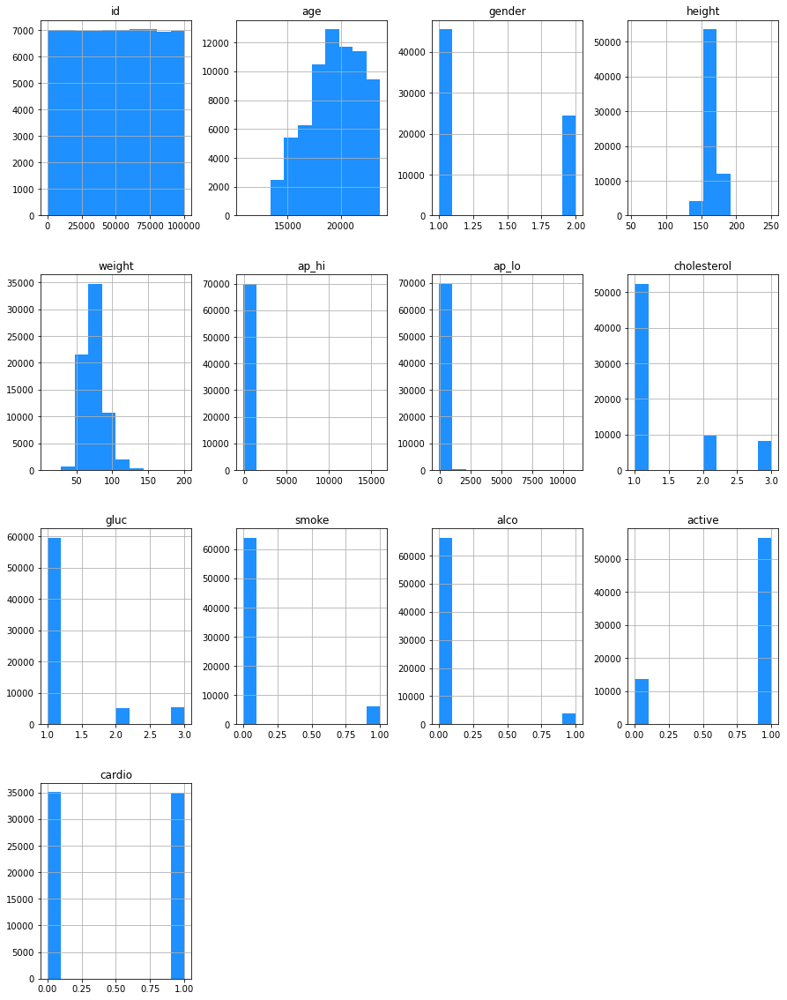

In [19]:
data_train.hist(figsize=(15,20),color='dodgerblue')# Построим общую гистограмму для всех столбцов таблицы
plt.show()

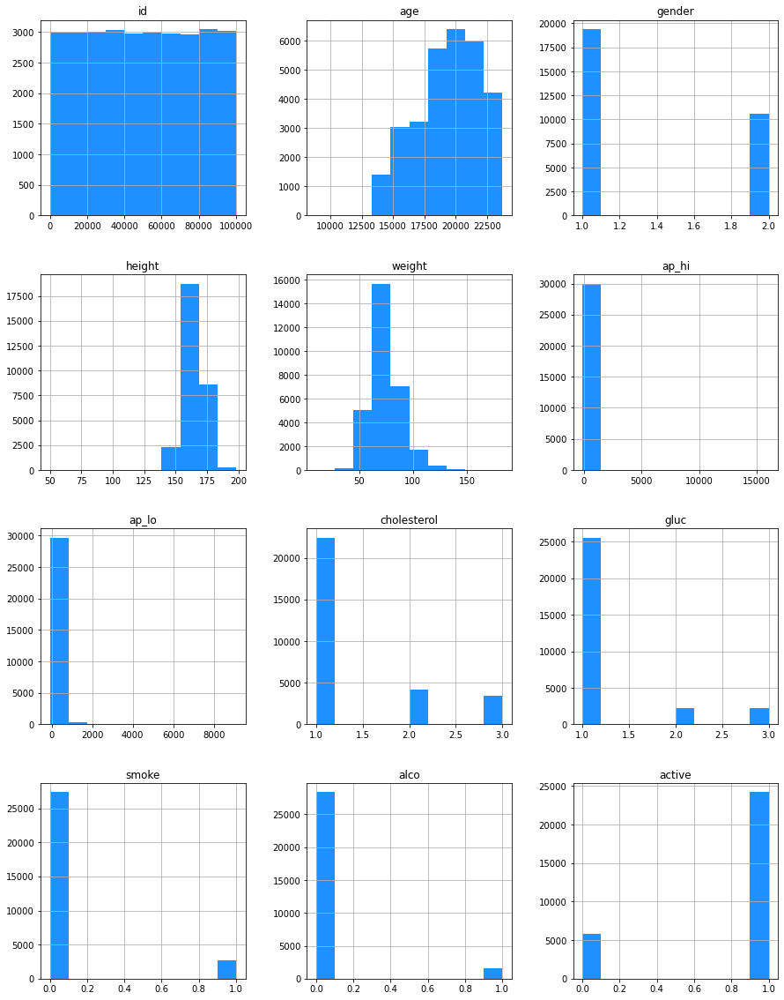

In [20]:
data_test.hist(figsize=(15,20),color='dodgerblue')# Построим общую гистограмму для всех столбцов таблицы
plt.show()

# EDA

In [21]:
colors = sns.color_palette('Paired')
sns.set(rc={'figure.figsize':(15, 5)}, palette=colors) # Настройки графиков
def distribution_plots(data, name, title): # Создадим функции для отображения плотности распределения и boxplot
    fig, ax = plt.subplots(1, 2)
    fig.suptitle('Распределение признака в датасете ' + name, fontweight='bold', fontsize=18)
    sns.distplot(data, ax=ax[0])
    ax[0].set_ylabel('Плотность')
    ax[0].set_title(title, fontweight='bold', fontsize=13)
    sns.boxplot(data, ax=ax[1])
    ax[1].set_title(title, fontweight='bold', fontsize=13)
    plt.show()
def distribution(data, name):
    columns = [i for i in data.columns if data[i].dtypes != 'object']
    for column in columns:
        distribution_plots(data[column], name, column)

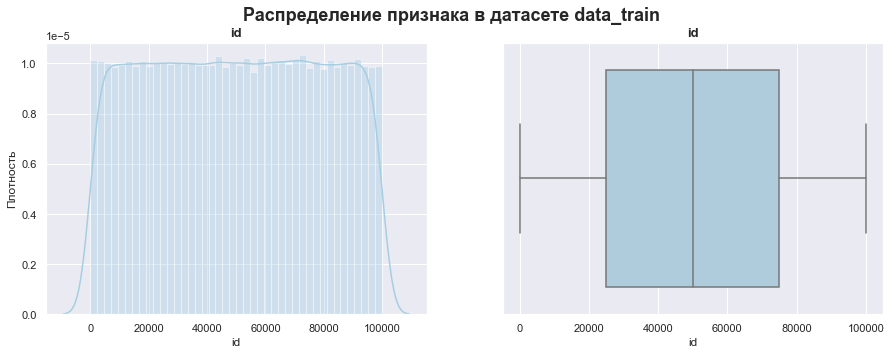

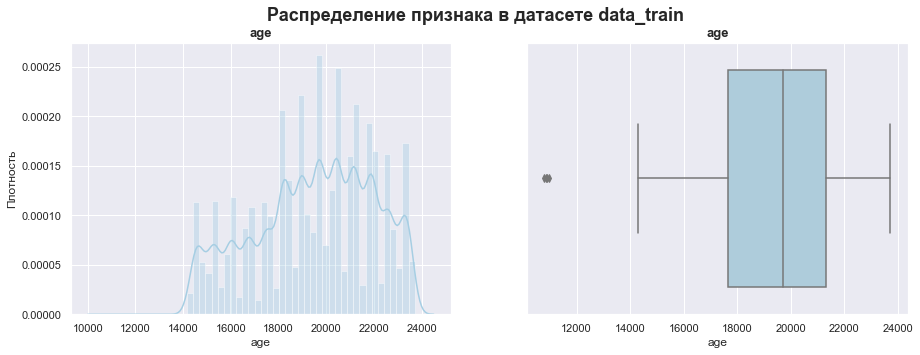

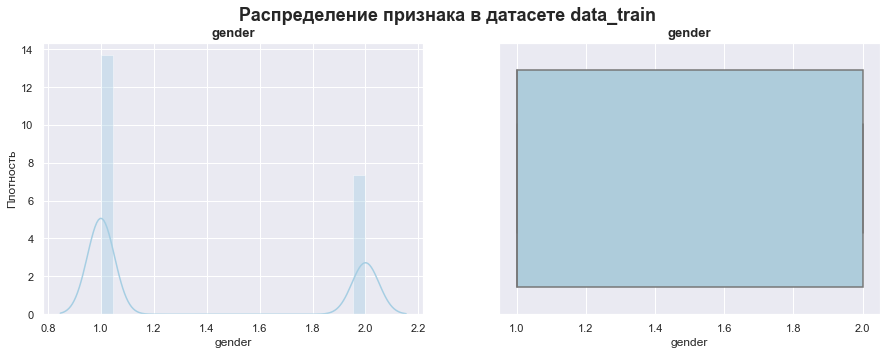

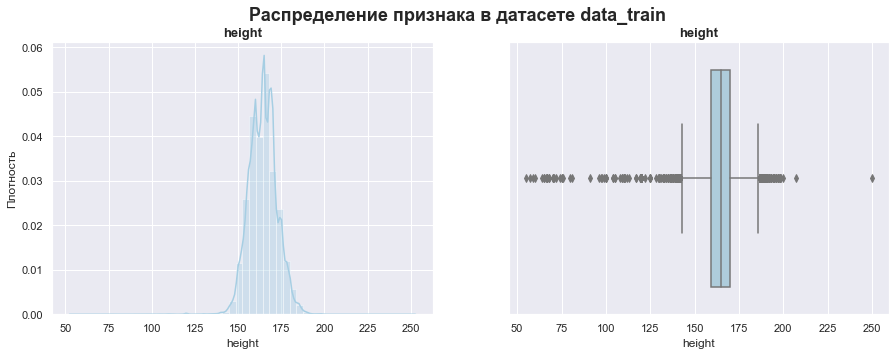

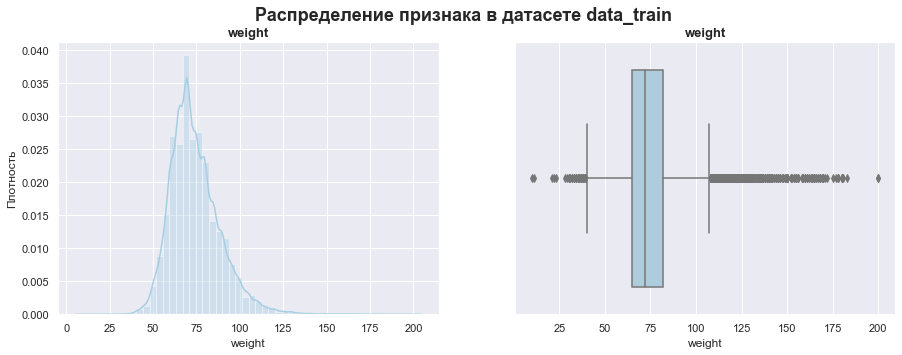

...

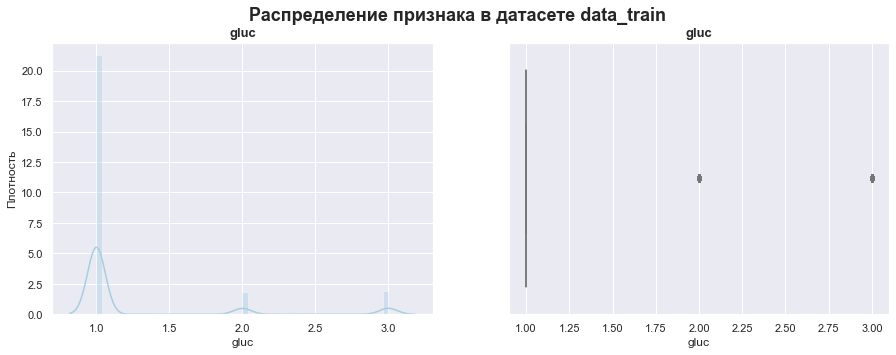

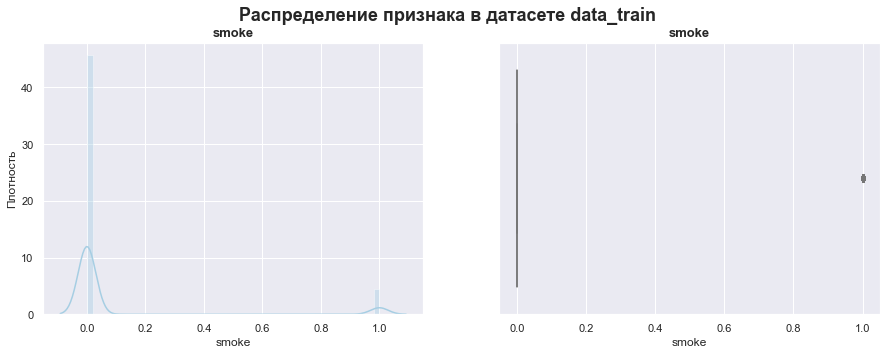

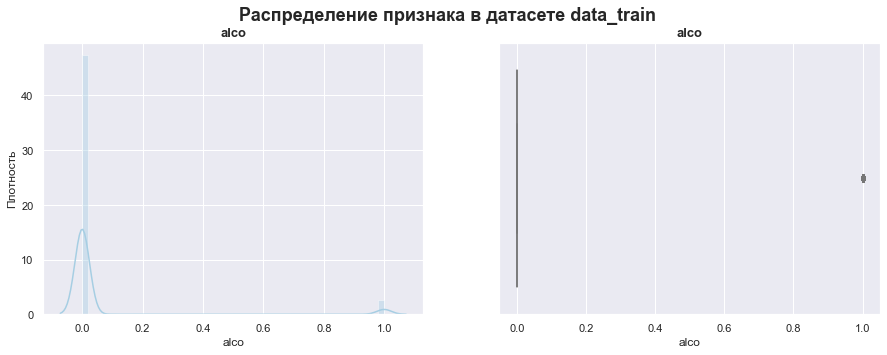

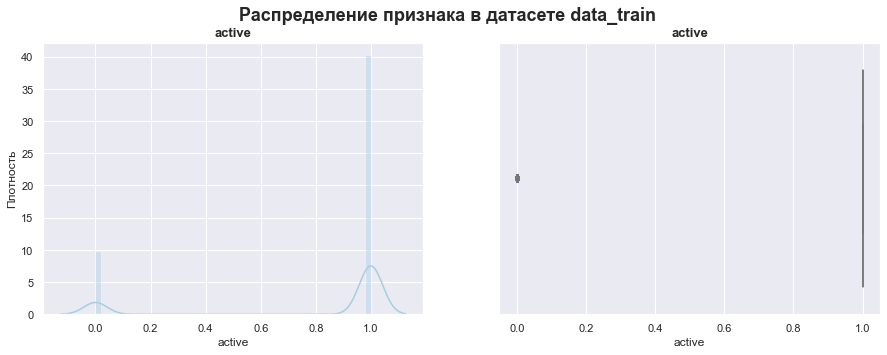

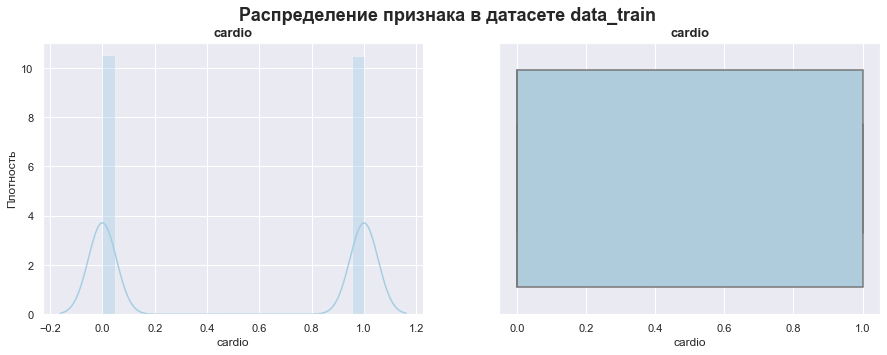

In [22]:
distribution(data_train, 'data_train')

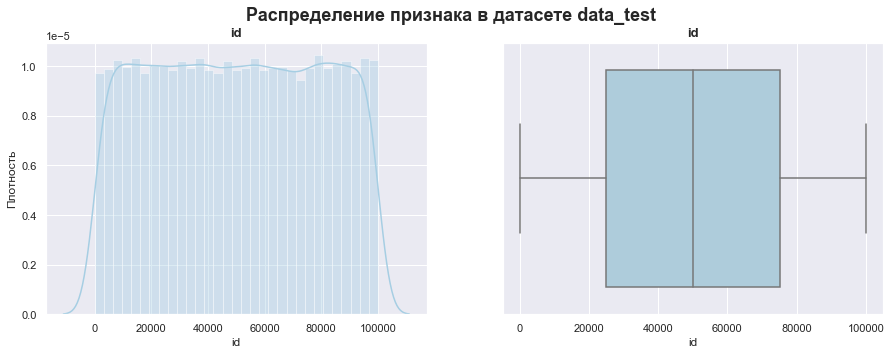

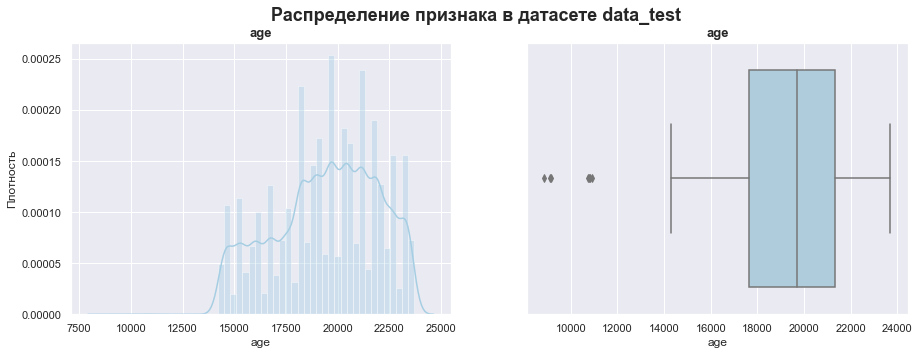

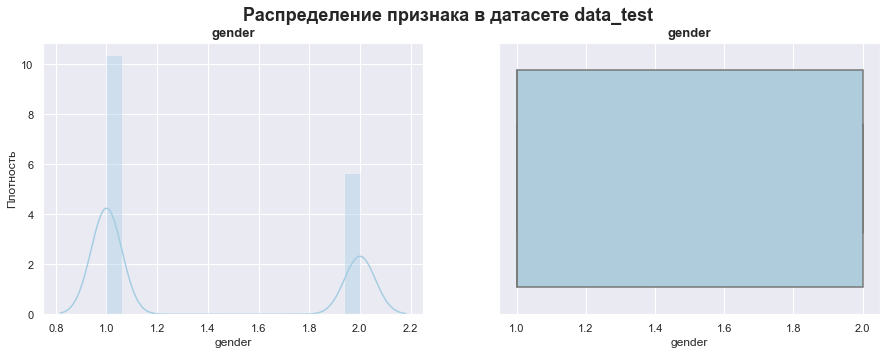

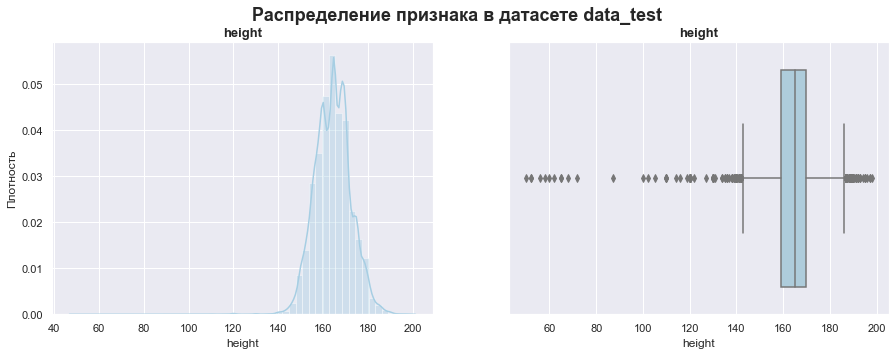

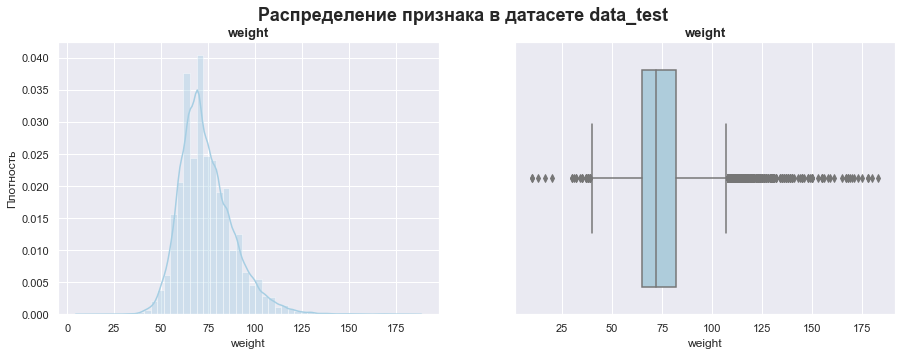

...

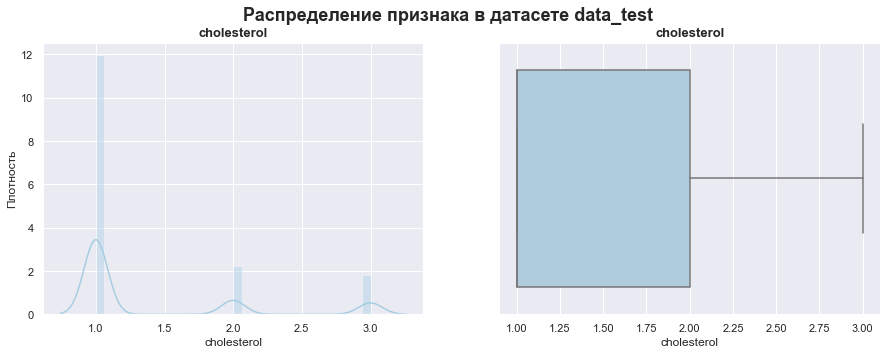

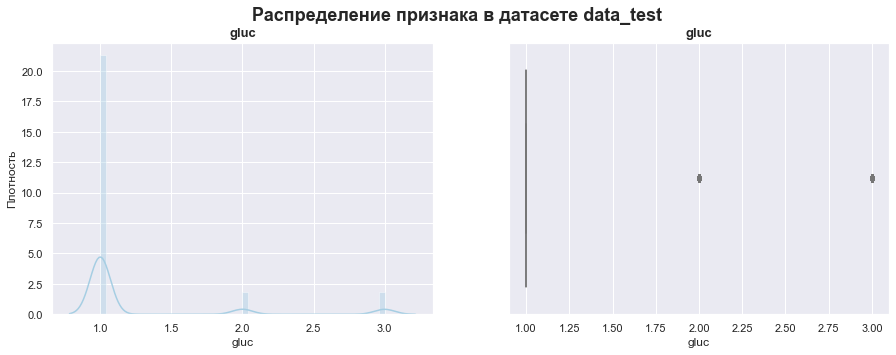

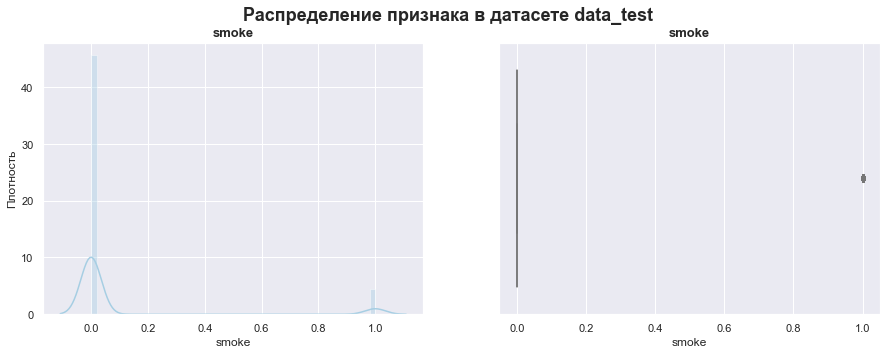

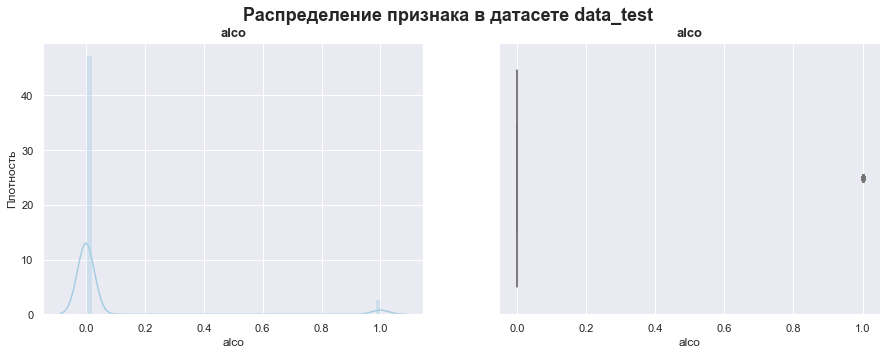

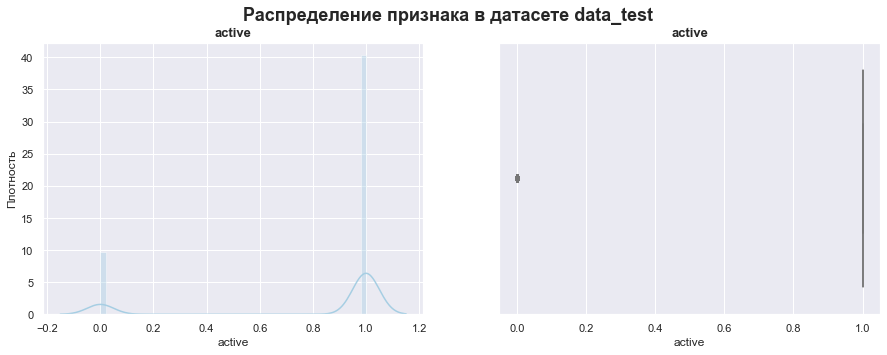

In [23]:
distribution(data_test, 'data_test')

In [24]:
pandas_profiling.ProfileReport(data_train)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [25]:
pandas_profiling.ProfileReport(data_test)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [26]:
dataframes = [data_train, data_test] # Проверим категориальные столбцы на скрытые дубликаты
for data in dataframes:
   for column in data.loc[:,  (data.dtypes == 'object')].columns:
       print(sorted(data[column].unique()))
       print(f'Количество уникальных значений {column}:', data[column].nunique())

In [27]:
def analysis_ouliers(df,column):
    q25=np.array(df[column].quantile(0.25))
    
    q75=np.array(df[column].quantile(0.75))
    first_part=q25-1.5*(q75-q25)
    second_part=q75+1.5*(q75-q25)
    del_index = []
    for indexes, value in zip(df[column].index,df[column]):
        if value <= first_part or second_part <= value:
            del_index.append(indexes)
    
    print(df.name, column,'Количество строк, содержащих выбросы, отобранных для удаления: ', len(del_index))
    return del_index

In [28]:
outliers = [(data_train, 'age'), (data_train,'height'), (data_train, 'weight'), (data_train,'ap_hi'), (data_train,'ap_lo')]
data_train.name = 'data_train'

for df,column in outliers:
    indexes_for_dell = analysis_ouliers(df,column)    

data_train age Количество строк, содержащих выбросы, отобранных для удаления:  4
data_train height Количество строк, содержащих выбросы, отобранных для удаления:  519
data_train weight Количество строк, содержащих выбросы, отобранных для удаления:  1819
data_train ap_hi Количество строк, содержащих выбросы, отобранных для удаления:  3134
data_train ap_lo Количество строк, содержащих выбросы, отобранных для удаления:  4730


In [29]:
# for df,column in outliers:
#     indexes_for_dell = analysis_ouliers(df,column)
#     df.drop(indexes_for_dell,axis = 0,inplace = True)

In [30]:
# data_train = data_train.reset_index(drop = True)

In [31]:
# print(data_train.shape)
# print(data_test.shape)

Ограничиваем данные, чтобы исключить выбросы рассчитываем данные на основании межквартильного размаха по формуле 

 first_part=q25-1.5*(q75-q25)
 
 second_part=q75+1.5*(q75-q25)

In [32]:
def analysis_quantile(df,column):
    q25=np.array(df[column].quantile(0.25))
    
    q75=np.array(df[column].quantile(0.75))
    first_part=np.ceil(q25-1.5*(q75-q25))
    second_part=np.ceil(q75+1.5*(q75-q25))
   
    return first_part, second_part

In [33]:
first_part_height, second_part_height = analysis_quantile(data_train, 'height')
first_part_height=int(first_part_height)
second_part_height=int(second_part_height)
print(first_part_height)
print(second_part_height)

143
187


In [34]:
first_part_weight, second_part_weight = analysis_quantile(data_train, 'weight')
print(first_part_weight)
print(second_part_weight)

40.0
108.0


In [35]:
first_part_ap_hi, second_part_ap_hi = analysis_quantile(data_train, 'ap_hi')
first_part_ap_hi=int(first_part_ap_hi)
second_part_ap_hi=int(second_part_ap_hi)
print(first_part_ap_hi)
print(second_part_ap_hi)

90
170


In [36]:
first_part_ap_lo, second_part_ap_lo = analysis_quantile(data_train, 'ap_lo')
first_part_ap_lo=int(first_part_ap_lo)
second_part_ap_lo=int(second_part_ap_lo)
print(first_part_ap_lo)
print(second_part_ap_lo)

65
105


In [37]:
data_train.loc[data_train['height']<first_part_height, 'height']=first_part_height

In [38]:
data_test.loc[data_test['height']<first_part_height, 'height']=first_part_height

In [39]:
data_train.loc[data_train['height']>second_part_height, 'height']=second_part_height

In [40]:
data_test.loc[data_test['height']>second_part_height, 'height']=second_part_height

In [41]:
data_train.loc[data_train['weight']<first_part_weight, 'weight']=first_part_weight

In [42]:
data_test.loc[data_test['weight']<first_part_weight, 'weight']=first_part_weight

In [43]:
data_train.loc[data_train['weight']>second_part_weight, 'weight']=second_part_weight

In [44]:
data_test.loc[data_test['weight']>second_part_weight, 'weight']=second_part_weight

In [45]:
data_train.loc[data_train['ap_hi']<first_part_ap_hi, 'ap_hi']=first_part_ap_hi

In [46]:
data_test.loc[data_test['ap_hi']<first_part_ap_hi, 'ap_hi']=first_part_ap_hi

In [47]:
data_train.loc[data_train['ap_hi']>second_part_ap_hi, 'ap_hi']=second_part_ap_hi

In [48]:
data_test.loc[data_test['ap_hi']>second_part_ap_hi, 'ap_hi']=second_part_ap_hi

In [49]:
data_train.loc[data_train['ap_lo']<first_part_ap_lo, 'ap_lo']=first_part_ap_lo

In [50]:
data_test.loc[data_test['ap_lo']<first_part_ap_lo, 'ap_lo']=first_part_ap_lo

In [51]:
data_train.loc[data_train['ap_lo']>second_part_ap_lo, 'ap_lo']=second_part_ap_lo

In [52]:
data_test.loc[data_test['ap_lo']>second_part_ap_lo, 'ap_lo']=second_part_ap_lo

In [53]:
ids = data_test['id']

In [54]:
print(data_train['cardio'].value_counts(normalize=True))

0    0.5003
1    0.4997
Name: cardio, dtype: float64


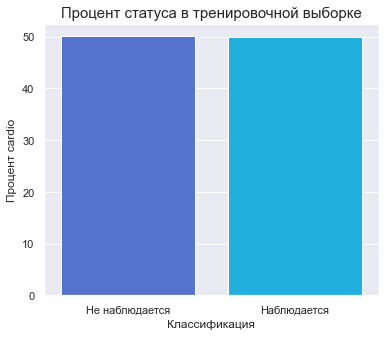

In [55]:
plt.figure(figsize=(6,5)) 
plt.title("Процент статуса в тренировочной выборке", fontsize = 15)
sns.barplot(x=data_train['cardio'].unique(), y=(data_train['cardio'].value_counts(normalize=True)*100), palette=['royalblue', 'deepskyblue'])
plt.xlabel("Классификация", fontsize = 12, labelpad = 5)
plt.ylabel("Процент cardio", fontsize = 12, labelpad = 5)
plt.xticks(ticks=[0, 1], labels=['Не наблюдается', 'Наблюдается'])
plt.show()

В нашем датафрейме столбец id не несет прогностического значения для целей проекта, поэтому удалим его.

In [56]:
data_train.drop(columns='id', inplace=True)
data_test.drop(columns='id', inplace=True)

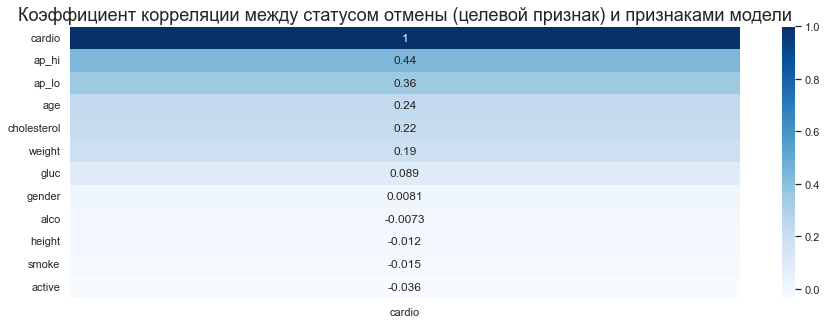

In [57]:
sns.heatmap(data_train.corr()[['cardio']].sort_values('cardio', ascending=False),annot = True, annot_kws = {"size":12}, cmap='Blues')
plt.title('Коэффициент корреляции между статусом отмены (целевой признак) и признаками модели', fontsize=18)
plt.show()

In [58]:
categorical = ['gender', 'cholesterol', 'gluc', 'smoke', 'alco', 'active']
ohe = OneHotEncoder(handle_unknown='ignore',sparse=False)
feature_arr = ohe.fit_transform(data_train[categorical])
feature_labels = ohe.get_feature_names(categorical)
ohe_train = pd.DataFrame(feature_arr, columns=feature_labels)

In [59]:
features_arr = ohe.transform(data_test[categorical])
ohe_test = pd.DataFrame(features_arr,columns=feature_labels)

In [60]:
ohe_train = pd.merge(data_train, ohe_train, left_index=True, right_index=True)

In [61]:
ohe_test = pd.merge(data_test, ohe_test, left_index=True, right_index=True)

In [62]:
print('Количество строк и столбцов в ohe обучающей выборке:', ohe_train.shape)
print('Количество строк и столбцов в ohe тестовой выборке:', ohe_test.shape)

Количество строк и столбцов в ohe обучающей выборке: (70000, 26)
Количество строк и столбцов в ohe тестовой выборке: (30000, 25)


In [63]:
ohe_train.head()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,...,cholesterol_3,gluc_1,gluc_2,gluc_3,smoke_0,smoke_1,alco_0,alco_1,active_0,active_1
0,18393,2,168,62.0,110,80,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
1,20228,1,156,85.0,140,90,3,1,0,0,...,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,18857,1,165,64.0,130,70,3,1,0,0,...,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3,17623,2,169,82.0,150,100,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
4,17474,1,156,56.0,100,65,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [64]:
ohe_test.head()

,age,gender,height,weight,ap_hi,ap_lo,cholesterol,gluc,smoke,alco,...,cholesterol_3,gluc_1,gluc_2,gluc_3,smoke_0,smoke_1,alco_0,alco_1,active_0,active_1
0,18888,1,154,85.0,130,80,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
1,19042,2,170,69.0,130,90,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,20432,1,160,70.0,120,75,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3,18133,2,185,94.0,130,90,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
4,16093,2,170,76.0,120,80,1,1,0,0,...,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0


In [65]:
ohe_train= ohe_train.drop(['gender', 'cholesterol', 'gluc', 'smoke', 'alco', 'active'], axis=1)

In [66]:
ohe_test = ohe_test.drop(['gender', 'cholesterol', 'gluc', 'smoke', 'alco', 'active'], axis=1)

In [67]:
features_train = ohe_train.drop(['cardio'], axis=1) # пролучим признаки
target_train = ohe_train['cardio'] # получим целевой признак

In [68]:
features_test = ohe_test

Проверим типы данных в train и test, они должны совпадать.

In [69]:
features_train.dtypes == features_test.dtypes

age              True
height           True
weight           True
ap_hi            True
ap_lo            True
gender_1         True
gender_2         True
cholesterol_1    True
cholesterol_2    True
cholesterol_3    True
gluc_1           True
gluc_2           True
gluc_3           True
smoke_0          True
smoke_1          True
alco_0           True
alco_1           True
active_0         True
active_1         True
dtype: bool

In [70]:
# масштабирование признаков
numeric = ['age', 'height', 'weight', 'ap_hi', 'ap_lo']

scaler = StandardScaler()
scaler.fit(features_train[numeric])

features_train[numeric] = scaler.transform(features_train[numeric])
features_test[numeric] = scaler.transform(features_test[numeric])
features_train.head()

,age,height,weight,ap_hi,ap_lo,gender_1,gender_2,cholesterol_1,cholesterol_2,cholesterol_3,gluc_1,gluc_2,gluc_3,smoke_0,smoke_1,alco_0,alco_1,active_0,active_1
0,-0.436062,0.458601,-0.886113,-1.019924,-0.196356,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
1,0.307686,-1.074707,0.820995,0.810923,0.907076,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,-0.247997,0.075274,-0.737669,0.200641,-1.299787,1.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3,-0.748152,0.586377,0.598329,1.421205,2.010507,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
4,-0.808543,-1.074707,-1.331445,-1.630206,-1.851503,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0


In [71]:
features_test.head()

,age,height,weight,ap_hi,ap_lo,gender_1,gender_2,cholesterol_1,cholesterol_2,cholesterol_3,gluc_1,gluc_2,gluc_3,smoke_0,smoke_1,alco_0,alco_1,active_0,active_1
0,-0.235432,-1.330258,0.820995,0.200641,-0.196356,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
1,-0.173014,0.714153,-0.366558,0.200641,0.907076,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
2,0.390370,-0.563604,-0.292336,-0.409642,-0.748071,1.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0,0.0
3,-0.541443,2.630788,1.488994,0.200641,0.907076,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
4,-1.368280,0.714153,0.152996,-0.409642,-0.196356,0.0,1.0,1.0,0.0,0.0,1.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0


# Построение модели, подбор гиперпараметров и выбор лучшей модели

In [72]:
# %%time
# model_dt = DecisionTreeClassifier(random_state=RANDOM_STATE)
# parameters = { 
#     'max_depth': range (1, 11),
#     'criterion':['gini', 'entropy', 'log_loss']
# }

# grid_search_dt = GridSearchCV(
#     model_dt,
#     parameters,
#     cv = CV, 
#     verbose=VERBOSE,
#     scoring = 'roc_auc',
#     return_train_score=True
#     )

# grid_search_dt.fit(features_train, target_train)
#metrics_columns_dt = [f'mean_test_{x}' for x in SCORING]
#final_metrics_dt = pd.DataFrame(grid_search_dt.cv_results_)[metrics_columns_dt].iloc[grid_search_dt.best_index_]

In [73]:
# # среднее значение auc-roc на кросс-валидации 
# print(f'Значение auc-roc: {grid_search_dt.best_score_}')
# # лучшие гиперпараметры модели на кросс-валидации 
# print(f'Лучшие параметры модели для нулевого региона: {grid_search_dt.best_params_}')

In [74]:
# test_scores = grid_search_dt.cv_results_['mean_test_score']
# train_scores = grid_search_dt.cv_results_['mean_train_score'] 

# plt.plot(test_scores, label='test')
# plt.plot(train_scores, label='train')
# plt.legend(loc='best')
# plt.xlabel('Training examples')
# plt.ylabel('Score')
# plt.title('Кривая обучения AUC-ROC')
# plt.show()

In [75]:
# %%time
# model_rf = RandomForestClassifier(random_state=RANDOM_STATE)
# parameters = { 
#     'n_estimators': range (300, 351,50),
#     'max_depth': range (9, 10),
#     'min_samples_leaf': range (3, 4),
#     'min_samples_split': range (2, 3)
# }
# grid_search_rf = GridSearchCV(
#     model_rf,
#     parameters,
#     cv = CV, 
#     verbose= VERBOSE,
#     scoring = 'roc_auc',
#     return_train_score=True
# )

# grid_search_rf.fit(features_train, target_train)
# #metrics_columns_rf = [f'mean_test_{x}' for x in SCORING]
# #final_metrics_rf = pd.DataFrame(grid_search_rf.cv_results_)[metrics_columns_rf].iloc[grid_search_rf.best_index_]

In [76]:
# # среднее значение auc-roc на кросс-валидации 
# print(f'Значение auc-roc: {grid_search_rf.best_score_}')
# # лучшие гиперпараметры модели на кросс-валидации 
# print(f'Лучшие параметры: {grid_search_rf.best_params_}')

In [77]:
# test_scores = grid_search_rf.cv_results_['mean_test_score']
# train_scores = grid_search_rf.cv_results_['mean_train_score'] 

# plt.plot(test_scores, label='test')
# plt.plot(train_scores, label='train')
# plt.legend(loc='best')
# plt.xlabel('Training examples')
# plt.ylabel('Score')
# plt.title('Кривая обучения AUC-ROC')
# plt.show()

In [78]:
# model_lr = LogisticRegression(random_state=RANDOM_STATE)
# parameters = [{ 
#               'solver': ['lbfgs', 'liblinear', 'newton-cg'],
#               'max_iter': range (0,700,100),
#               'penalty': ['l1', 'l2', 'elasticnet', None]            
#              }]
# grid_search_lr = GridSearchCV(
#               model_lr,
#               parameters,
#               cv =CV, 
#               verbose=VERBOSE,
#               scoring = 'roc_auc',
#               return_train_score=True
#               )
# grid_search_lr.fit(features_train, target_train)
# #metrics_columns_lr = [f'mean_test_{x}' for x in SCORING]
# #final_metrics_lr = pd.DataFrame(grid_search_lr.cv_results_)[mean_train_score].iloc[grid_search_lr.best_index_]

In [79]:
# # среднее значение auc-roc на кросс-валидации 
# print(f'Значение auc-roc: {grid_search_lr.best_score_}')
# # лучшие гиперпараметры модели на кросс-валидации 
# print(f'Лучшие параметры: {grid_search_lr.best_params_}')

In [80]:
# test_scores = grid_search_lr.cv_results_['mean_test_score']
# train_scores = grid_search_lr.cv_results_['mean_train_score'] 

# plt.plot(test_scores, label='test')
# plt.plot(train_scores, label='train')
# plt.legend(loc='best')
# plt.xlabel('Training examples')
# plt.ylabel('Score')
# plt.title('Кривая обучения AUC-ROC')
# plt.show()

In [82]:
# функция для поиска optuna
def objective(trial):
    n_estimators = trial.suggest_int("n_estimators", 150, 600)
    criterion = trial.suggest_categorical("criterion", ['friedman_mse'])
    loss = trial.suggest_categorical("loss", ['exponential'])
    max_depth = trial.suggest_int("max_depth", 3, 6)
    min_samples_leaf = trial.suggest_int("min_samples_leaf", 3, 6)
    min_samples_split = trial.suggest_int("min_samples_split", 2, 6)
    max_features = trial.suggest_int("max_features", 5,6)
    learning_rate = trial.suggest_float("learning_rate", 0.01, 0.05)
    subsample = trial.suggest_float("subsample", 0.66, 1)
    
    model = GradientBoostingClassifier(
        n_estimators=n_estimators,
        criterion=criterion,
        loss=loss,
        max_depth=max_depth,
        min_samples_leaf=min_samples_leaf,
        min_samples_split=min_samples_split,
        max_features=max_features,
        learning_rate=learning_rate,
        subsample=subsample
    )
    
    score = cross_val_score(model, features_train, target_train , cv=3, scoring='roc_auc')
    roc_auc= score.mean()
    return roc_auc
study = optuna.create_study(
    direction='maximize',
    sampler=optuna.samplers.RandomSampler(),
    study_name='cardio',
    storage="sqlite:///cardio.db"
)

study.optimize(objective, n_trials=100)
study.best_params
study.best_value
study.best_trial

# loaded_study = optuna.load_study(study_name="Shipkova", storage="sqlite:///cardio.db")
# assert len(loaded_study.trials) == len(study.trials)

#Сохранение только истории поиска в виде датафрейма
# df = study.trials_dataframe()
# df.to_csv('study.csv')
# loaded = pd.read_csv('study.csv')
#Сохранение дампа самого оптимизатора
#joblib.dump(study, 'experiments.pkl')
#study_loaded = joblib.load('experiments.pkl')
#study_loaded.trials_dataframe()

[I 2023-03-08 20:51:48,139] A new study created in RDB with name: cardio
[I 2023-03-08 20:52:03,947] Trial 0 finished with value: 0.7989012000675841 and parameters: {'n_estimators': 267, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 3, 'min_samples_leaf': 3, 'min_samples_split': 4, 'max_features': 6, 'learning_rate': 0.011049828581935874, 'subsample': 0.9041146021991993}. Best is trial 0 with value: 0.7989012000675841.
[I 2023-03-08 20:52:38,370] Trial 1 finished with value: 0.8027411329655593 and parameters: {'n_estimators': 476, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 4, 'min_samples_leaf': 6, 'min_samples_split': 4, 'max_features': 6, 'learning_rate': 0.04907095763391037, 'subsample': 0.8697309103305201}. Best is trial 1 with value: 0.8027411329655593.
[I 2023-03-08 20:53:17,846] Trial 2 finished with value: 0.8016588797829317 and parameters: {'n_estimators': 510, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_sam

[I 2023-03-08 21:03:43,662] Trial 22 finished with value: 0.8032079589230282 and parameters: {'n_estimators': 239, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 6, 'min_samples_leaf': 5, 'min_samples_split': 3, 'max_features': 6, 'learning_rate': 0.021876756891732366, 'subsample': 0.7832668308792576}. Best is trial 11 with value: 0.8032866347204153.
[I 2023-03-08 21:04:09,843] Trial 23 finished with value: 0.8015694577480647 and parameters: {'n_estimators': 481, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 3, 'min_samples_leaf': 6, 'min_samples_split': 5, 'max_features': 5, 'learning_rate': 0.016470711985635936, 'subsample': 0.9560763084308772}. Best is trial 11 with value: 0.8032866347204153.
[I 2023-03-08 21:04:58,438] Trial 24 finished with value: 0.802821144682957 and parameters: {'n_estimators': 544, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_samples_leaf': 6, 'min_samples_split': 4, 'max_features': 6, 'learning_

[I 2023-03-08 21:15:07,694] Trial 44 finished with value: 0.8033740674329185 and parameters: {'n_estimators': 561, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_samples_leaf': 3, 'min_samples_split': 2, 'max_features': 5, 'learning_rate': 0.01439696345430137, 'subsample': 0.9174590306767632}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:15:32,723] Trial 45 finished with value: 0.8030690659579106 and parameters: {'n_estimators': 249, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 6, 'min_samples_leaf': 3, 'min_samples_split': 3, 'max_features': 5, 'learning_rate': 0.02806988671111714, 'subsample': 0.9458709254583433}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:16:08,963] Trial 46 finished with value: 0.8032693392334056 and parameters: {'n_estimators': 489, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_samples_leaf': 4, 'min_samples_split': 5, 'max_features': 5, 'learning_rat

[I 2023-03-08 21:25:51,113] Trial 66 finished with value: 0.8028939017290805 and parameters: {'n_estimators': 420, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_samples_leaf': 4, 'min_samples_split': 6, 'max_features': 5, 'learning_rate': 0.035404043053127665, 'subsample': 0.8939179843638886}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:26:27,633] Trial 67 finished with value: 0.8032144189048429 and parameters: {'n_estimators': 502, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 5, 'min_samples_leaf': 6, 'min_samples_split': 6, 'max_features': 5, 'learning_rate': 0.023322112762907122, 'subsample': 0.7168768622557675}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:27:08,105] Trial 68 finished with value: 0.8031581141029402 and parameters: {'n_estimators': 374, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 6, 'min_samples_leaf': 5, 'min_samples_split': 2, 'max_features': 6, 'learning_r

[I 2023-03-08 21:36:13,591] Trial 88 finished with value: 0.8009618061818317 and parameters: {'n_estimators': 170, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 3, 'min_samples_leaf': 6, 'min_samples_split': 5, 'max_features': 5, 'learning_rate': 0.03957897156057882, 'subsample': 0.7320141431149516}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:37:13,535] Trial 89 finished with value: 0.8022801587836556 and parameters: {'n_estimators': 581, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 6, 'min_samples_leaf': 4, 'min_samples_split': 2, 'max_features': 6, 'learning_rate': 0.021106388377984637, 'subsample': 0.8128688220943457}. Best is trial 26 with value: 0.803396769921064.
[I 2023-03-08 21:37:44,618] Trial 90 finished with value: 0.8025346049176161 and parameters: {'n_estimators': 501, 'criterion': 'friedman_mse', 'loss': 'exponential', 'max_depth': 4, 'min_samples_leaf': 5, 'min_samples_split': 3, 'max_features': 5, 'learning_ra

FrozenTrial(number=26, state=TrialState.COMPLETE, values=[0.803396769921064], datetime_start=datetime.datetime(2023, 3, 8, 21, 5, 20, 631913), datetime_complete=datetime.datetime(2023, 3, 8, 21, 5, 53, 529383), params={'criterion': 'friedman_mse', 'learning_rate': 0.015445303011647234, 'loss': 'exponential', 'max_depth': 6, 'max_features': 6, 'min_samples_leaf': 3, 'min_samples_split': 6, 'n_estimators': 347, 'subsample': 0.662815844986698}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'criterion': CategoricalDistribution(choices=('friedman_mse',)), 'learning_rate': FloatDistribution(high=0.05, log=False, low=0.01, step=None), 'loss': CategoricalDistribution(choices=('exponential',)), 'max_depth': IntDistribution(high=6, log=False, low=3, step=1), 'max_features': IntDistribution(high=6, log=False, low=5, step=1), 'min_samples_leaf': IntDistribution(high=6, log=False, low=3, step=1), 'min_samples_split': IntDistribution(high=6, log=False, low=2, step=1), 'n_est

FrozenTrial(number=26, state=TrialState.COMPLETE, values=[0.803396769921064], datetime_start=datetime.datetime(2023, 3, 8, 21, 5, 20, 631913), datetime_complete=datetime.datetime(2023, 3, 8, 21, 5, 53, 529383), params={'criterion': 'friedman_mse', 'learning_rate': 0.015445303011647234, 'loss': 'exponential', 'max_depth': 6, 'max_features': 6, 'min_samples_leaf': 3, 'min_samples_split': 6, 'n_estimators': 347, 'subsample': 0.662815844986698}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'criterion': CategoricalDistribution(choices=('friedman_mse',)), 'learning_rate': FloatDistribution(high=0.05, log=False, low=0.01, step=None), 'loss': CategoricalDistribution(choices=('exponential',)), 'max_depth': IntDistribution(high=6, log=False, low=3, step=1), 'max_features': IntDistribution(high=6, log=False, low=5, step=1), 'min_samples_leaf': IntDistribution(high=6, log=False, low=3, step=1), 'min_samples_split': IntDistribution(high=6, log=False, low=2, step=1), 'n_estimators': IntDistribution(high=600, log=False, low=150, step=1), 'subsample': FloatDistribution(high=1.0, log=False, low=0.66, step=None)}, trial_id=973, value=None)

In [83]:
# random search cv
rs_space={'max_depth':list(np.arange(4, 7, step=1)),
          'n_estimators':np.arange(340, 550, step=10),
          'max_features':randint(5,7),
          'subsample' : [0.66, 0.75, 1],
          'loss': ['exponential'],
          'learning_rate': np.arange(0.015, 0.05, step=0.01),
          'min_samples_leaf': randint(3,6),
          'min_samples_split':np.arange(2, 7, step=1)
          }

gb = GradientBoostingClassifier(random_state=RANDOM_STATE)

gb_random = RandomizedSearchCV(gb, rs_space, n_iter=50, scoring='roc_auc', cv=3, verbose=100)
model_random_gb = gb_random.fit(features_train, target_train)

# random random search результаты
print('Лучшие параметры модели: '+str(model_random_gb.best_params_))
print('Лучший random search score : '+str(model_random_gb.best_score_))

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3; 1/50] START learning_rate=0.025, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=360, subsample=0.66
[CV 1/3; 1/50] END learning_rate=0.025, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=360, subsample=0.66;, score=0.801 total time=   7.5s
[CV 2/3; 1/50] START learning_rate=0.025, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=360, subsample=0.66
[CV 2/3; 1/50] END learning_rate=0.025, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=360, subsample=0.66;, score=0.806 total time=   7.5s
[CV 3/3; 1/50] START learning_rate=0.025, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=360, subsample=0.66
[CV 3/3; 1/50] END learning_rate=0.025, loss=exponential, max

[CV 3/3; 8/50] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=5, min_samples_split=5, n_estimators=380, subsample=0.75;, score=0.802 total time=  10.8s
[CV 1/3; 9/50] START learning_rate=0.035, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=500, subsample=0.66
[CV 1/3; 9/50] END learning_rate=0.035, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=500, subsample=0.66;, score=0.802 total time=  10.3s
[CV 2/3; 9/50] START learning_rate=0.035, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=500, subsample=0.66
[CV 2/3; 9/50] END learning_rate=0.035, loss=exponential, max_depth=4, max_features=6, min_samples_leaf=4, min_samples_split=2, n_estimators=500, subsample=0.66;, score=0.806 total time=  10.6s
[CV 3/3; 9/50] START learning_rate=0.035, loss=exponential, max_depth=4, max_features=6, min

[CV 2/3; 16/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=530, subsample=1;, score=0.804 total time=  15.8s
[CV 3/3; 16/50] START learning_rate=0.045000000000000005, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=530, subsample=1
[CV 3/3; 16/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=530, subsample=1;, score=0.802 total time=  15.6s
[CV 1/3; 17/50] START learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1
[CV 1/3; 17/50] END learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1;, score=0.801 total time=  12.8s
[CV 2/3; 17/50] START learning_rate=0.035, loss=exponenti

[CV 1/3; 24/50] END learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=4, min_samples_split=2, n_estimators=520, subsample=0.75;, score=0.800 total time=  15.4s
[CV 2/3; 24/50] START learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=4, min_samples_split=2, n_estimators=520, subsample=0.75
[CV 2/3; 24/50] END learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=4, min_samples_split=2, n_estimators=520, subsample=0.75;, score=0.803 total time=  15.6s
[CV 3/3; 24/50] START learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=4, min_samples_split=2, n_estimators=520, subsample=0.75
[CV 3/3; 24/50] END learning_rate=0.035, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=4, min_samples_split=2, n_estimators=520, subsample=0.75;, score=0.802 total time=  15.2s
[CV 1/3; 25/50] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=

[CV 3/3; 31/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=6, max_features=5, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66;, score=0.801 total time=  14.1s
[CV 1/3; 32/50] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=2, n_estimators=530, subsample=0.66
[CV 1/3; 32/50] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=2, n_estimators=530, subsample=0.66;, score=0.802 total time=  14.9s
[CV 2/3; 32/50] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=2, n_estimators=530, subsample=0.66
[CV 2/3; 32/50] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=2, n_estimators=530, subsample=0.66;, score=0.806 total time=  14.6s
[CV 3/3; 32/50] START learning_rate=0.015, loss=exponential, max_depth=5

[CV 2/3; 39/50] END learning_rate=0.035, loss=exponential, max_depth=5, max_features=5, min_samples_leaf=5, min_samples_split=5, n_estimators=470, subsample=0.66;, score=0.806 total time=  11.2s
[CV 3/3; 39/50] START learning_rate=0.035, loss=exponential, max_depth=5, max_features=5, min_samples_leaf=5, min_samples_split=5, n_estimators=470, subsample=0.66
[CV 3/3; 39/50] END learning_rate=0.035, loss=exponential, max_depth=5, max_features=5, min_samples_leaf=5, min_samples_split=5, n_estimators=470, subsample=0.66;, score=0.802 total time=  11.4s
[CV 1/3; 40/50] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=5, n_estimators=540, subsample=0.75
[CV 1/3; 40/50] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=5, n_estimators=540, subsample=0.75;, score=0.801 total time=  15.5s
[CV 2/3; 40/50] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=

[CV 1/3; 47/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=4, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=370, subsample=0.75;, score=0.801 total time=   8.2s
[CV 2/3; 47/50] START learning_rate=0.045000000000000005, loss=exponential, max_depth=4, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=370, subsample=0.75
[CV 2/3; 47/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=4, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=370, subsample=0.75;, score=0.805 total time=   8.0s
[CV 3/3; 47/50] START learning_rate=0.045000000000000005, loss=exponential, max_depth=4, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=370, subsample=0.75
[CV 3/3; 47/50] END learning_rate=0.045000000000000005, loss=exponential, max_depth=4, max_features=5, min_samples_leaf=5, min_samples_split=2, n_estimators=370, subsample=0.75;, score=0.803 total time=   7.8s
[CV 1/3; 48/

Лучшие параметры модели: {'learning_rate': 0.025, 'loss': 'exponential', 'max_depth': 5, 'max_features': 6, 'min_samples_leaf': 5, 'min_samples_split': 4, 'n_estimators': 400, 'subsample': 0.75}
Лучший random search score : 0.8033220983480104

Значение auc-roc: 0.8035094787525118
Лучшие параметры: {'learning_rate': 0.02, 'loss': 'exponential', 'max_depth': 5, 'max_features': 6, 'min_samples_leaf': 4, 'min_samples_split': 4, 'n_estimators': 440, 'subsample': 1}

In [84]:
%%time
model_gb = GradientBoostingClassifier(random_state=RANDOM_STATE)
parameters = [{ 
              'max_depth': range (5, 7),
              'learning_rate': [0.015, 0.02, 0.025],
              'subsample' : [0.66, 0.75, 1],
              'n_estimators' : [400, 440, 490],
              'loss': ['exponential'],
              'max_features': [6],
              'min_samples_leaf': [3, 4, 5], 
              'min_samples_split': [4,6]            
}]
grid_search_gb = GridSearchCV(
    model_gb,
    parameters,
    cv = 3, 
    verbose=100,
    scoring ='roc_auc' ,
    return_train_score=True
    
)

grid_search_gb.fit(features_train, target_train)

#metrics_columns_gb = [f'mean_test_{x}' for x in SCORING]
#final_metrics_gb = pd.DataFrame(grid_search_gb.cv_results_)[metrics_columns_gb].iloc[grid_search_gb.best_index_]

Fitting 3 folds for each of 324 candidates, totalling 972 fits
[CV 1/3; 1/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 1/3; 1/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.815, test=0.801) total time=  10.3s
[CV 2/3; 1/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 2/3; 1/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.814, test=0.806) total time=  10.4s
[CV 3/3; 1/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 3/3; 1/324]

[CV 2/3; 8/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.815, test=0.805) total time=  13.4s
[CV 3/3; 8/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75
[CV 3/3; 8/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.817, test=0.803) total time=  13.5s
[CV 1/3; 9/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=1
[CV 1/3; 9/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.817, test=0.802) total time=  14.8s
[CV 2/3; 9/324] START learning_ra

[CV 3/3; 15/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.816, test=0.803) total time=  13.4s
[CV 1/3; 16/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 1/3; 16/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.817, test=0.802) total time=  13.0s
[CV 2/3; 16/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 2/3; 16/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.815, test=0.806) total time=  13.1s
[CV 3/3; 16/324] START le

[CV 1/3; 23/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.816, test=0.801) total time=  12.4s
[CV 2/3; 23/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75
[CV 2/3; 23/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.814, test=0.806) total time=  12.4s
[CV 3/3; 23/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75
[CV 3/3; 23/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.815, test=0.803) total time=  12.3s
[CV 1/3; 24/324] START

[CV 2/3; 30/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.814, test=0.805) total time=  12.2s
[CV 3/3; 30/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1
[CV 3/3; 30/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.815, test=0.803) total time=  12.5s
[CV 1/3; 31/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 1/3; 31/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.816, test=0.802) total time=  11.9s
[CV 2/3; 31/324] START learning

[CV 3/3; 37/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.814, test=0.803) total time=  10.5s
[CV 1/3; 38/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 1/3; 38/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.815, test=0.801) total time=  11.2s
[CV 2/3; 38/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 2/3; 38/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.814, test=0.805) total time=  11.5s
[CV 3/3; 38/324] START

[CV 1/3; 45/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.817, test=0.802) total time=  14.9s
[CV 2/3; 45/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1
[CV 2/3; 45/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.815, test=0.805) total time=  14.6s
[CV 3/3; 45/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1
[CV 3/3; 45/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.816, test=0.803) total time=  14.9s
[CV 1/3; 46/324] START learning_rate=

[CV 2/3; 52/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.815, test=0.806) total time=  12.3s
[CV 3/3; 52/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 3/3; 52/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.816, test=0.803) total time=  12.4s
[CV 1/3; 53/324] START learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 1/3; 53/324] END learning_rate=0.015, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.817, test=0.801) total time=  13.3s
[CV 2/3; 53/324] START

[CV 3/3; 59/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.824, test=0.803) total time=  15.2s
[CV 1/3; 60/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=1
[CV 1/3; 60/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.825, test=0.802) total time=  16.9s
[CV 2/3; 60/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=1
[CV 2/3; 60/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.823, test=0.805) total time=  17.2s
[CV 3/3; 60/324] START learning_ra

[CV 1/3; 67/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.824, test=0.802) total time=  13.4s
[CV 2/3; 67/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 2/3; 67/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.822, test=0.805) total time=  13.4s
[CV 3/3; 67/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 3/3; 67/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.824, test=0.803) total time=  13.4s
[CV 1/3; 68/324] START

[CV 2/3; 74/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.821, test=0.805) total time=  13.6s
[CV 3/3; 74/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 3/3; 74/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.822, test=0.803) total time=  13.9s
[CV 1/3; 75/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=1
[CV 1/3; 75/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.823, test=0.802) total time=  15.5s
[CV 2/3; 75/324] START learn

[CV 3/3; 81/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.825, test=0.803) total time=  18.1s
[CV 1/3; 82/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 1/3; 82/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.822, test=0.802) total time=  12.9s
[CV 2/3; 82/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 2/3; 82/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.821, test=0.805) total time=  12.6s
[CV 3/3; 82/324] START le

[CV 1/3; 89/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.826, test=0.801) total time=  16.6s
[CV 2/3; 89/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 2/3; 89/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.824, test=0.805) total time=  17.2s
[CV 3/3; 89/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 3/3; 89/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.825, test=0.803) total time=  16.4s
[CV 1/3; 90/324] START

[CV 2/3; 96/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.823, test=0.805) total time=  15.6s
[CV 3/3; 96/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1
[CV 3/3; 96/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.824, test=0.803) total time=  15.6s
[CV 1/3; 97/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=0.66
[CV 1/3; 97/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.825, test=0.802) total time=  14.6s
[CV 2/3; 97/324] START learning

[CV 3/3; 103/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.823, test=0.803) total time=  13.1s
[CV 1/3; 104/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.75
[CV 1/3; 104/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.824, test=0.802) total time=  14.1s
[CV 2/3; 104/324] START learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.75
[CV 2/3; 104/324] END learning_rate=0.015, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.822, test=0.805) total time=  14.0s
[CV 3/3; 104/324]

[CV 1/3; 111/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.818, test=0.802) total time=  11.4s
[CV 2/3; 111/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1
[CV 2/3; 111/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.816, test=0.805) total time=  11.4s
[CV 3/3; 111/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1
[CV 3/3; 111/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.817, test=0.803) total time=  11.4s
[CV 1/3; 112/324] START learning_rate

[CV 2/3; 118/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.816, test=0.806) total time=   9.9s
[CV 3/3; 118/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 3/3; 118/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.817, test=0.803) total time=   9.8s
[CV 1/3; 119/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.75
[CV 1/3; 119/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.818, test=0.802) total time=  10.7s
[CV 2/3; 119/324] STAR

[CV 3/3; 125/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.820, test=0.803) total time=  13.1s
[CV 1/3; 126/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=1
[CV 1/3; 126/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.820, test=0.802) total time=  13.9s
[CV 2/3; 126/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=1
[CV 2/3; 126/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.818, test=0.805) total time=  14.0s
[CV 3/3; 126/324] START learning_r

[CV 1/3; 133/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.820, test=0.802) total time=  12.0s
[CV 2/3; 133/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66
[CV 2/3; 133/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.818, test=0.805) total time=  12.9s
[CV 3/3; 133/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66
[CV 3/3; 133/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.819, test=0.803) total time=  12.0s
[CV 1/3; 134/324] STAR

[CV 2/3; 140/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.817, test=0.806) total time=  11.5s
[CV 3/3; 140/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75
[CV 3/3; 140/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.818, test=0.803) total time=  11.4s
[CV 1/3; 141/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=1
[CV 1/3; 141/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.819, test=0.802) total time=  12.3s
[CV 2/3; 141/324] START lear

[CV 3/3; 147/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.817, test=0.803) total time=  11.3s
[CV 1/3; 148/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=0.66
[CV 1/3; 148/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=0.66;, score=(train=0.819, test=0.802) total time=  10.8s
[CV 2/3; 148/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=0.66
[CV 2/3; 148/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=0.66;, score=(train=0.817, test=0.805) total time=  10.8s
[CV 3/3; 148/324] START l

[CV 1/3; 155/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.818, test=0.802) total time=  10.6s
[CV 2/3; 155/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75
[CV 2/3; 155/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.816, test=0.806) total time=  10.6s
[CV 3/3; 155/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75
[CV 3/3; 155/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.817, test=0.803) total time=  11.4s
[CV 1/3; 156/324] STAR

[CV 2/3; 162/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.818, test=0.805) total time=  13.9s
[CV 3/3; 162/324] START learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1
[CV 3/3; 162/324] END learning_rate=0.02, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.819, test=0.803) total time=  13.8s
[CV 1/3; 163/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 1/3; 163/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.826, test=0.802) total time=  11.8s
[CV 2/3; 163/324] START learnin

[CV 3/3; 169/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.830, test=0.802) total time=  14.5s
[CV 1/3; 170/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75
[CV 1/3; 170/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.830, test=0.801) total time=  15.7s
[CV 2/3; 170/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75
[CV 2/3; 170/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.829, test=0.805) total time=  15.3s
[CV 3/3; 170/324] STAR

[CV 1/3; 177/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.829, test=0.801) total time=  15.4s
[CV 2/3; 177/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1
[CV 2/3; 177/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.827, test=0.805) total time=  15.4s
[CV 3/3; 177/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1
[CV 3/3; 177/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.828, test=0.803) total time=  15.1s
[CV 1/3; 178/324] START learning_rate

[CV 2/3; 184/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.66;, score=(train=0.826, test=0.805) total time=  13.0s
[CV 3/3; 184/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.66
[CV 3/3; 184/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.66;, score=(train=0.828, test=0.803) total time=  13.0s
[CV 1/3; 185/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75
[CV 1/3; 185/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.828, test=0.801) total time=  13.9s
[CV 2/3; 185/324] STAR

[CV 3/3; 191/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.826, test=0.803) total time=  12.8s
[CV 1/3; 192/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1
[CV 1/3; 192/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.827, test=0.801) total time=  13.9s
[CV 2/3; 192/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1
[CV 2/3; 192/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.825, test=0.805) total time=  13.8s
[CV 3/3; 192/324] START learning_r

[CV 1/3; 199/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.826, test=0.801) total time=  11.7s
[CV 2/3; 199/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 2/3; 199/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.825, test=0.805) total time=  11.5s
[CV 3/3; 199/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66
[CV 3/3; 199/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.826, test=0.803) total time=  12.0s
[CV 1/3; 200/324] STAR

[CV 2/3; 206/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.828, test=0.805) total time=  15.3s
[CV 3/3; 206/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=0.75
[CV 3/3; 206/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=0.75;, score=(train=0.830, test=0.802) total time=  15.3s
[CV 1/3; 207/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1
[CV 1/3; 207/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.830, test=0.801) total time=  16.9s
[CV 2/3; 207/324] START lear

[CV 3/3; 213/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=1;, score=(train=0.828, test=0.803) total time=  15.4s
[CV 1/3; 214/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 1/3; 214/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.830, test=0.802) total time=  14.4s
[CV 2/3; 214/324] START learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 2/3; 214/324] END learning_rate=0.02, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.828, test=0.805) total time=  14.3s
[CV 3/3; 214/324] START l

[CV 1/3; 221/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.821, test=0.802) total time=  11.5s
[CV 2/3; 221/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75
[CV 2/3; 221/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.820, test=0.805) total time=  11.5s
[CV 3/3; 221/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75
[CV 3/3; 221/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.821, test=0.803) total time=  11.5s
[CV 1/3; 222/324]

[CV 2/3; 228/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.818, test=0.805) total time=  11.4s
[CV 3/3; 228/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=1
[CV 3/3; 228/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=1;, score=(train=0.820, test=0.803) total time=  11.4s
[CV 1/3; 229/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 1/3; 229/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.821, test=0.801) total time=  11.2s
[CV 2/3; 229/324] START le

[CV 3/3; 235/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.66;, score=(train=0.819, test=0.803) total time=  10.0s
[CV 1/3; 236/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 1/3; 236/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.820, test=0.801) total time=  10.5s
[CV 2/3; 236/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 2/3; 236/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.819, test=0.805) total time=  10.5s
[CV 3/3; 236/324]

[CV 1/3; 243/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.823, test=0.801) total time=  14.9s
[CV 2/3; 243/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1
[CV 2/3; 243/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.821, test=0.805) total time=  14.7s
[CV 3/3; 243/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1
[CV 3/3; 243/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.822, test=0.803) total time=  14.5s
[CV 1/3; 244/324] START learning

[CV 2/3; 250/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.821, test=0.805) total time=  12.5s
[CV 3/3; 250/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.66
[CV 3/3; 250/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.66;, score=(train=0.822, test=0.803) total time=  12.4s
[CV 1/3; 251/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 1/3; 251/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.823, test=0.801) total time=  13.3s
[CV 2/3; 251/324]

[CV 3/3; 257/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=0.75;, score=(train=0.821, test=0.803) total time=  11.5s
[CV 1/3; 258/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1
[CV 1/3; 258/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.821, test=0.802) total time=  12.8s
[CV 2/3; 258/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1
[CV 2/3; 258/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.820, test=0.805) total time=  12.5s
[CV 3/3; 258/324] START learn

[CV 1/3; 265/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.821, test=0.801) total time=  11.1s
[CV 2/3; 265/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 2/3; 265/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.819, test=0.805) total time=  11.0s
[CV 3/3; 265/324] START learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66
[CV 3/3; 265/324] END learning_rate=0.025, loss=exponential, max_depth=5, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.821, test=0.803) total time=  11.1s
[CV 1/3; 266/324]

[CV 2/3; 272/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.829, test=0.805) total time=  12.6s
[CV 3/3; 272/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.75
[CV 3/3; 272/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=0.75;, score=(train=0.830, test=0.803) total time=  12.6s
[CV 1/3; 273/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1
[CV 1/3; 273/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.831, test=0.801) total time=  14.0s
[CV 2/3; 273/324] START

[CV 3/3; 279/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=4, n_estimators=490, subsample=1;, score=(train=0.834, test=0.802) total time=  17.1s
[CV 1/3; 280/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 1/3; 280/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.830, test=0.801) total time=  11.9s
[CV 2/3; 280/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 2/3; 280/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.829, test=0.805) total time=  12.0s
[CV 3/3; 280/324] ST

[CV 1/3; 287/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.834, test=0.801) total time=  16.8s
[CV 2/3; 287/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 2/3; 287/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.833, test=0.804) total time=  19.1s
[CV 3/3; 287/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75
[CV 3/3; 287/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=3, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.834, test=0.802) total time=  19.7s
[CV 1/3; 288/324]

[CV 2/3; 294/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.830, test=0.804) total time=  16.2s
[CV 3/3; 294/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=1
[CV 3/3; 294/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=440, subsample=1;, score=(train=0.832, test=0.802) total time=  15.9s
[CV 1/3; 295/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66
[CV 1/3; 295/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=4, n_estimators=490, subsample=0.66;, score=(train=0.834, test=0.801) total time=  14.9s
[CV 2/3; 295/324] START le

[CV 3/3; 301/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.66;, score=(train=0.832, test=0.802) total time=  13.0s
[CV 1/3; 302/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75
[CV 1/3; 302/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.832, test=0.801) total time=  14.1s
[CV 2/3; 302/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75
[CV 2/3; 302/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=4, min_samples_split=6, n_estimators=440, subsample=0.75;, score=(train=0.831, test=0.805) total time=  14.2s
[CV 3/3; 302/324]

[CV 1/3; 309/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.830, test=0.801) total time=  14.2s
[CV 2/3; 309/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1
[CV 2/3; 309/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.828, test=0.805) total time=  14.2s
[CV 3/3; 309/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1
[CV 3/3; 309/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=4, n_estimators=400, subsample=1;, score=(train=0.830, test=0.802) total time=  14.1s
[CV 1/3; 310/324] START learning

[CV 2/3; 316/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.828, test=0.805) total time=  12.1s
[CV 3/3; 316/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.66
[CV 3/3; 316/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.66;, score=(train=0.829, test=0.803) total time=  11.9s
[CV 1/3; 317/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75
[CV 1/3; 317/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=400, subsample=0.75;, score=(train=0.830, test=0.801) total time=  13.2s
[CV 2/3; 317/324]

[CV 3/3; 323/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=0.75;, score=(train=0.834, test=0.802) total time=  15.5s
[CV 1/3; 324/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1
[CV 1/3; 324/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.834, test=0.801) total time=  17.3s
[CV 2/3; 324/324] START learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1
[CV 2/3; 324/324] END learning_rate=0.025, loss=exponential, max_depth=6, max_features=6, min_samples_leaf=5, min_samples_split=6, n_estimators=490, subsample=1;, score=(train=0.832, test=0.804) total time=  17.1s
[CV 3/3; 324/324] START learn

GridSearchCV(cv=3, estimator=GradientBoostingClassifier(random_state=42),
             param_grid=[{'learning_rate': [0.015, 0.02, 0.025],
                          'loss': ['exponential'], 'max_depth': range(5, 7),
                          'max_features': [6], 'min_samples_leaf': [3, 4, 5],
                          'min_samples_split': [4, 6],
                          'n_estimators': [400, 440, 490],
                          'subsample': [0.66, 0.75, 1]}],
             return_train_score=True, scoring='roc_auc', verbose=100)

In [85]:
# среднее значение auc-roc на кросс-валидации 
print(f'Значение auc-roc: {grid_search_gb.best_score_}')
# лучшие гиперпараметры модели на кросс-валидации 
print(f'Лучшие параметры: {grid_search_gb.best_params_}')

Значение auc-roc: 0.8035094787525118
Лучшие параметры: {'learning_rate': 0.02, 'loss': 'exponential', 'max_depth': 5, 'max_features': 6, 'min_samples_leaf': 4, 'min_samples_split': 4, 'n_estimators': 440, 'subsample': 1}


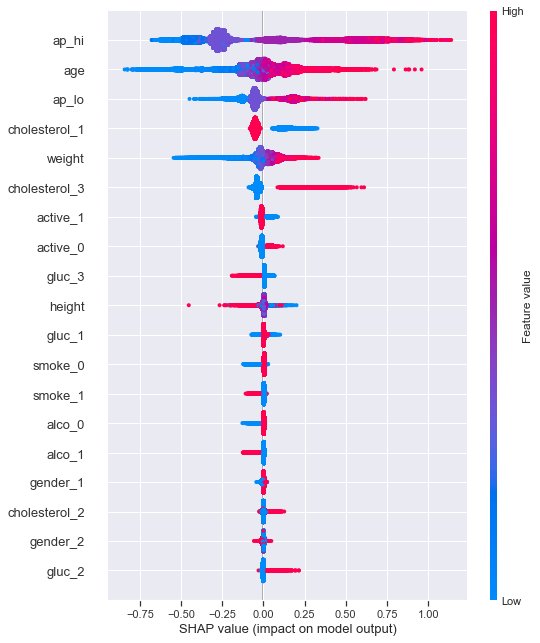

In [86]:
best_model_gb = grid_search_gb.best_estimator_
explainer = shap.TreeExplainer(best_model_gb)
shap_values=explainer.shap_values(features_train, target_train)
shap.initjs()
shap.summary_plot(shap_values, features_train)

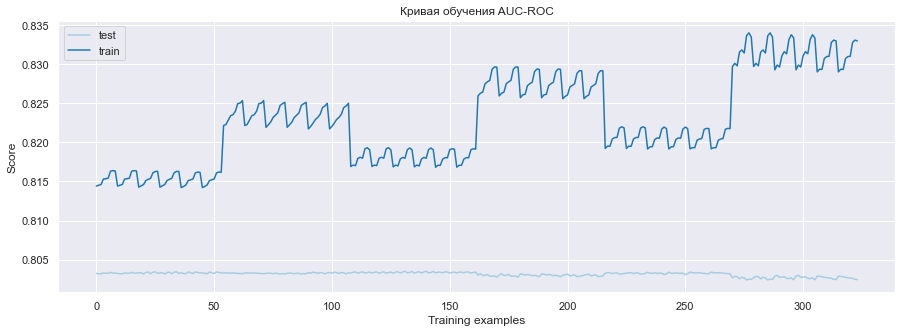

In [87]:
test_scores = grid_search_gb.cv_results_['mean_test_score']
train_scores = grid_search_gb.cv_results_['mean_train_score'] 

plt.plot(test_scores, label='test')
plt.plot(train_scores, label='train')
plt.legend(loc='best')
plt.xlabel('Training examples')
plt.ylabel('Score')
plt.title('Кривая обучения AUC-ROC')
plt.show()

In [88]:
# функция для поиска optuna
def objective(trial):
    n_estimators = trial.suggest_int("n_estimators", 150, 600)       
    max_depth = trial.suggest_int("max_depth", 3, 7)
    eta = trial.suggest_float("eta", 0.01, 0.1)
    subsample = trial.suggest_float("subsample", 0.75, 1)
    
    
    model_xgb = xgb.XGBClassifier(random_state=RANDOM_STATE, 
        objective='binary:logistic', 
        eval_metric='auc',                                
        n_estimators=n_estimators,       
        max_depth=max_depth,        
        subsample=subsample,
        eta = eta
                               
    )
    
    score = cross_val_score(model_xgb, features_train, target_train , cv=3, scoring='roc_auc')
    roc_auc= score.mean()
    return roc_auc
study = optuna.create_study(
    direction='maximize',
    sampler=optuna.samplers.RandomSampler(),
    study_name='cardio_xgb',
    storage="sqlite:///cardio.db"
)

study.optimize(objective, n_trials=100)
study.best_params
study.best_value
study.best_trial

# loaded_study = optuna.load_study(study_name="Kostileva", storage="sqlite:///cardio.db")
# assert len(loaded_study.trials) == len(study.trials)

# Сохранение только истории поиска в виде датафрейма
# df = study.trials_dataframe()
# df.to_csv('study.csv')
# loaded = pd.read_csv('study.csv')
# Сохранение дампа самого оптимизатора
# joblib.dump(study, 'experiments.pkl')
# study_loaded = joblib.load('experiments.pkl')
# study_loaded.trials_dataframe()

[I 2023-03-09 03:16:22,290] A new study created in RDB with name: cardio_xgb
[I 2023-03-09 03:16:35,924] Trial 0 finished with value: 0.8030474194380943 and parameters: {'n_estimators': 237, 'max_depth': 5, 'eta': 0.038044334021618574, 'subsample': 0.8427204053472751}. Best is trial 0 with value: 0.8030474194380943.
[I 2023-03-09 03:17:15,927] Trial 1 finished with value: 0.8023394835898041 and parameters: {'n_estimators': 441, 'max_depth': 7, 'eta': 0.011009172482102616, 'subsample': 0.9313815351759065}. Best is trial 0 with value: 0.8030474194380943.
[I 2023-03-09 03:17:41,143] Trial 2 finished with value: 0.7970853208899751 and parameters: {'n_estimators': 287, 'max_depth': 7, 'eta': 0.08836349476492227, 'subsample': 0.99421874089321}. Best is trial 0 with value: 0.8030474194380943.
[I 2023-03-09 03:17:59,876] Trial 3 finished with value: 0.802629633995072 and parameters: {'n_estimators': 390, 'max_depth': 3, 'eta': 0.024556249043653278, 'subsample': 0.8671807187858407}. Best is tri

[I 2023-03-09 03:30:51,393] Trial 32 finished with value: 0.8018932897462392 and parameters: {'n_estimators': 320, 'max_depth': 3, 'eta': 0.02036954397508537, 'subsample': 0.9662873307001408}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:31:07,009] Trial 33 finished with value: 0.8027656569625498 and parameters: {'n_estimators': 289, 'max_depth': 3, 'eta': 0.040065074791391445, 'subsample': 0.8742541354226567}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:31:17,036] Trial 34 finished with value: 0.8027899162915103 and parameters: {'n_estimators': 180, 'max_depth': 3, 'eta': 0.09208115851012207, 'subsample': 0.8178486577798136}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:32:04,133] Trial 35 finished with value: 0.8024197673960244 and parameters: {'n_estimators': 502, 'max_depth': 6, 'eta': 0.016969595332033335, 'subsample': 0.9939683024583141}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:32:33,474] Trial 

[I 2023-03-09 03:45:47,566] Trial 65 finished with value: 0.8024924318627984 and parameters: {'n_estimators': 162, 'max_depth': 3, 'eta': 0.06349549284348727, 'subsample': 0.990567032507182}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:46:11,848] Trial 66 finished with value: 0.8022442053618618 and parameters: {'n_estimators': 457, 'max_depth': 3, 'eta': 0.07579974868386748, 'subsample': 0.7864908525439167}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:46:36,132] Trial 67 finished with value: 0.8016601022042699 and parameters: {'n_estimators': 320, 'max_depth': 5, 'eta': 0.05839109779539781, 'subsample': 0.7595986451097825}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:47:01,919] Trial 68 finished with value: 0.8027947406106423 and parameters: {'n_estimators': 458, 'max_depth': 3, 'eta': 0.04551543405901864, 'subsample': 0.8195875764506529}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 03:47:19,864] Trial 69 

[I 2023-03-09 04:00:59,066] Trial 98 finished with value: 0.8026392017482838 and parameters: {'n_estimators': 284, 'max_depth': 3, 'eta': 0.07888763342762684, 'subsample': 0.917057840752093}. Best is trial 6 with value: 0.8033884246992794.
[I 2023-03-09 04:01:26,057] Trial 99 finished with value: 0.8020321027205172 and parameters: {'n_estimators': 418, 'max_depth': 4, 'eta': 0.059978261075550945, 'subsample': 0.8152628869269971}. Best is trial 6 with value: 0.8033884246992794.


FrozenTrial(number=6, state=TrialState.COMPLETE, values=[0.8033884246992794], datetime_start=datetime.datetime(2023, 3, 9, 3, 18, 52, 179291), datetime_complete=datetime.datetime(2023, 3, 9, 3, 19, 30, 575412), params={'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 560, 'subsample': 0.7985915078268784}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'eta': FloatDistribution(high=0.1, log=False, low=0.01, step=None), 'max_depth': IntDistribution(high=7, log=False, low=3, step=1), 'n_estimators': IntDistribution(high=600, log=False, low=150, step=1), 'subsample': FloatDistribution(high=1.0, log=False, low=0.75, step=None)}, trial_id=1053, value=None)

FrozenTrial(number=6, state=TrialState.COMPLETE, values=[0.8033884246992794], datetime_start=datetime.datetime(2023, 3, 9, 3, 18, 52, 179291), datetime_complete=datetime.datetime(2023, 3, 9, 3, 19, 30, 575412), params={'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 560, 'subsample': 0.7985915078268784}, user_attrs={}, system_attrs={}, intermediate_values={}, distributions={'eta': FloatDistribution(high=0.1, log=False, low=0.01, step=None), 'max_depth': IntDistribution(high=7, log=False, low=3, step=1), 'n_estimators': IntDistribution(high=600, log=False, low=150, step=1), 'subsample': FloatDistribution(high=1.0, log=False, low=0.75, step=None)}, trial_id=1053, value=None)

In [89]:
# random search cv
rs_space_xgb={'max_depth':list(np.arange(3, 6, step=1)),
          'n_estimators':np.arange(200, 600, step=10),           
          'eta': np.arange(0.014, 0.03, step=0.01),
          'subsample' : [0.75, 0.80, 1],
             }

model_xgb = xgb.XGBClassifier(random_state=RANDOM_STATE, objective='binary:logistic')

xgb_random = RandomizedSearchCV(model_xgb, rs_space_xgb, n_iter=50, scoring='roc_auc', cv=3, verbose=100)
model_random_xgb = xgb_random.fit(features_train, target_train)

# random random search результаты
print('Лучшие параметры модели: '+str(model_random_xgb.best_params_))
print('Лучший random search score : '+str(model_random_xgb.best_score_))

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3; 1/50] START eta=0.014, max_depth=4, n_estimators=490, subsample=0.8....
[CV 1/3; 1/50] END eta=0.014, max_depth=4, n_estimators=490, subsample=0.8;, score=0.801 total time=   7.6s
[CV 2/3; 1/50] START eta=0.014, max_depth=4, n_estimators=490, subsample=0.8....
[CV 2/3; 1/50] END eta=0.014, max_depth=4, n_estimators=490, subsample=0.8;, score=0.805 total time=   7.7s
[CV 3/3; 1/50] START eta=0.014, max_depth=4, n_estimators=490, subsample=0.8....
[CV 3/3; 1/50] END eta=0.014, max_depth=4, n_estimators=490, subsample=0.8;, score=0.803 total time=   8.3s
[CV 1/3; 2/50] START eta=0.024, max_depth=4, n_estimators=510, subsample=0.75...
[CV 1/3; 2/50] END eta=0.024, max_depth=4, n_estimators=510, subsample=0.75;, score=0.801 total time=  10.2s
[CV 2/3; 2/50] START eta=0.024, max_depth=4, n_estimators=510, subsample=0.75...
[CV 2/3; 2/50] END eta=0.024, max_depth=4, n_estimators=510, subsample=0.75;, score=0.805 total time

[CV 2/3; 15/50] END eta=0.024, max_depth=3, n_estimators=270, subsample=1;, score=0.804 total time=   2.9s
[CV 3/3; 15/50] START eta=0.024, max_depth=3, n_estimators=270, subsample=1.....
[CV 3/3; 15/50] END eta=0.024, max_depth=3, n_estimators=270, subsample=1;, score=0.802 total time=   2.8s
[CV 1/3; 16/50] START eta=0.014, max_depth=3, n_estimators=470, subsample=0.8...
[CV 1/3; 16/50] END eta=0.014, max_depth=3, n_estimators=470, subsample=0.8;, score=0.800 total time=   7.9s
[CV 2/3; 16/50] START eta=0.014, max_depth=3, n_estimators=470, subsample=0.8...
[CV 2/3; 16/50] END eta=0.014, max_depth=3, n_estimators=470, subsample=0.8;, score=0.804 total time=   8.0s
[CV 3/3; 16/50] START eta=0.014, max_depth=3, n_estimators=470, subsample=0.8...
[CV 3/3; 16/50] END eta=0.014, max_depth=3, n_estimators=470, subsample=0.8;, score=0.802 total time=   7.9s
[CV 1/3; 17/50] START eta=0.014, max_depth=4, n_estimators=220, subsample=1.....
[CV 1/3; 17/50] END eta=0.014, max_depth=4, n_estimato

[CV 1/3; 30/50] END eta=0.014, max_depth=5, n_estimators=580, subsample=1;, score=0.801 total time=  12.3s
[CV 2/3; 30/50] START eta=0.014, max_depth=5, n_estimators=580, subsample=1.....
[CV 2/3; 30/50] END eta=0.014, max_depth=5, n_estimators=580, subsample=1;, score=0.805 total time=  12.3s
[CV 3/3; 30/50] START eta=0.014, max_depth=5, n_estimators=580, subsample=1.....
[CV 3/3; 30/50] END eta=0.014, max_depth=5, n_estimators=580, subsample=1;, score=0.803 total time=  12.5s
[CV 1/3; 31/50] START eta=0.024, max_depth=5, n_estimators=210, subsample=0.8...
[CV 1/3; 31/50] END eta=0.024, max_depth=5, n_estimators=210, subsample=0.8;, score=0.801 total time=   6.7s
[CV 2/3; 31/50] START eta=0.024, max_depth=5, n_estimators=210, subsample=0.8...
[CV 2/3; 31/50] END eta=0.024, max_depth=5, n_estimators=210, subsample=0.8;, score=0.805 total time=   6.1s
[CV 3/3; 31/50] START eta=0.024, max_depth=5, n_estimators=210, subsample=0.8...
[CV 3/3; 31/50] END eta=0.024, max_depth=5, n_estimators

[CV 3/3; 44/50] END eta=0.014, max_depth=3, n_estimators=560, subsample=0.8;, score=0.802 total time=  11.4s
[CV 1/3; 45/50] START eta=0.024, max_depth=5, n_estimators=250, subsample=0.8...
[CV 1/3; 45/50] END eta=0.024, max_depth=5, n_estimators=250, subsample=0.8;, score=0.801 total time=   7.1s
[CV 2/3; 45/50] START eta=0.024, max_depth=5, n_estimators=250, subsample=0.8...
[CV 2/3; 45/50] END eta=0.024, max_depth=5, n_estimators=250, subsample=0.8;, score=0.805 total time=   7.1s
[CV 3/3; 45/50] START eta=0.024, max_depth=5, n_estimators=250, subsample=0.8...
[CV 3/3; 45/50] END eta=0.024, max_depth=5, n_estimators=250, subsample=0.8;, score=0.803 total time=   7.0s
[CV 1/3; 46/50] START eta=0.014, max_depth=4, n_estimators=400, subsample=0.75..
[CV 1/3; 46/50] END eta=0.014, max_depth=4, n_estimators=400, subsample=0.75;, score=0.801 total time=   9.3s
[CV 2/3; 46/50] START eta=0.014, max_depth=4, n_estimators=400, subsample=0.75..
[CV 2/3; 46/50] END eta=0.014, max_depth=4, n_est

Лучшие параметры модели: {'subsample': 0.8, 'n_estimators': 450, 'max_depth': 5, 'eta': 0.014}
Лучший random search score : 0.8033567998538164

In [90]:
%%time
model_xgb = xgb.XGBClassifier(random_state=RANDOM_STATE, objective='binary:logistic',eval_metric='auc')
parameters = [{ 
              'n_estimators': [440, 450, 560, 600],
              'max_depth': [5],
              'eta': [0.013991302340458816, 0.014, 0.02],
              'subsample' : [0.7985915078268784, 0.8, 1]
              }]
grid_search_xgb = GridSearchCV(
    model_xgb,
    parameters,
    cv = 3, 
    verbose=100,
    scoring ='roc_auc' ,
    return_train_score=True
    
)

grid_search_xgb.fit(features_train, target_train)

#metrics_columns_xgb = [f'mean_test_{x}' for x in SCORING]
#final_metrics_xgb = pd.DataFrame(grid_search_xgb.cv_results_)[metrics_columns_xgb].iloc[grid_search_xgb.best_index_]

Fitting 3 folds for each of 36 candidates, totalling 108 fits
[CV 1/3; 1/36] START eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 1/3; 1/36] END eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.817, test=0.802) total time=   8.3s
[CV 2/3; 1/36] START eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 2/3; 1/36] END eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.815, test=0.805) total time=   8.5s
[CV 3/3; 1/36] START eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 3/3; 1/36] END eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.817, test=0.803) total time=   8.8s
[CV 1/3; 2/36] START eta=0.013991302340458816, max_depth=5, n_estimators=440, subsample=0.8
[CV 1/3; 2/36] END eta=0.013991302340458816, max_de

[CV 1/3; 12/36] END eta=0.013991302340458816, max_depth=5, n_estimators=600, subsample=1;, score=(train=0.819, test=0.801) total time=  10.6s
[CV 2/3; 12/36] START eta=0.013991302340458816, max_depth=5, n_estimators=600, subsample=1
[CV 2/3; 12/36] END eta=0.013991302340458816, max_depth=5, n_estimators=600, subsample=1;, score=(train=0.817, test=0.805) total time=  10.8s
[CV 3/3; 12/36] START eta=0.013991302340458816, max_depth=5, n_estimators=600, subsample=1
[CV 3/3; 12/36] END eta=0.013991302340458816, max_depth=5, n_estimators=600, subsample=1;, score=(train=0.819, test=0.803) total time=  11.1s
[CV 1/3; 13/36] START eta=0.014, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 1/3; 13/36] END eta=0.014, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.817, test=0.802) total time=  10.9s
[CV 2/3; 13/36] START eta=0.014, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 2/3; 13/36] END eta=0.014, max_depth=5, n_estimators=440, 

[CV 3/3; 24/36] END eta=0.014, max_depth=5, n_estimators=600, subsample=1;, score=(train=0.819, test=0.803) total time=  11.6s
[CV 1/3; 25/36] START eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 1/3; 25/36] END eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.821, test=0.801) total time=  11.1s
[CV 2/3; 25/36] START eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 2/3; 25/36] END eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.819, test=0.805) total time=  11.7s
[CV 3/3; 25/36] START eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784
[CV 3/3; 25/36] END eta=0.02, max_depth=5, n_estimators=440, subsample=0.7985915078268784;, score=(train=0.821, test=0.803) total time=  11.7s
[CV 1/3; 26/36] START eta=0.02, max_depth=5, n_estimators=440, subsample=0.8....
[CV 1/3; 26/36] END eta=0.02, max_depth=5, n_estimators=440, subsample=0.8;, score=(tra

GridSearchCV(cv=3,
             estimator=XGBClassifier(base_score=None, booster=None,
                                     callbacks=None, colsample_bylevel=None,
                                     colsample_bynode=None,
                                     colsample_bytree=None,
                                     early_stopping_rounds=None,
                                     enable_categorical=False,
                                     eval_metric='auc', feature_types=None,
                                     gamma=None, gpu_id=None, grow_policy=None,
                                     importance_type=None,
                                     interaction_constraints=None,
                                     learning_rate=None...
                                     max_leaves=None, min_child_weight=None,
                                     missing=nan, monotone_constraints=None,
                                     n_estimators=100, n_jobs=None,
                                     num_parallel_tree=None, predictor=None,
                                     random_state=42, ...),
             param_grid=[{'eta': [0.013991302340458816, 0.014, 0.02],
                          'max_depth': [5],
                          'n_estimators': [440, 450, 560, 600],
                          'subsample': [0.7985915078268784, 0.8, 1]}],
             return_train_score=True, scoring='roc_auc', verbose=100)

In [91]:
# среднее значение auc-roc на кросс-валидации 
print(f'Значение auc-roc: {grid_search_xgb.best_score_}')
# лучшие гиперпараметры модели на кросс-валидации 
print(f'Лучшие параметры: {grid_search_xgb.best_params_}')

Значение auc-roc: 0.8033953803236461
Лучшие параметры: {'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 450, 'subsample': 0.7985915078268784}


Значение auc-roc: 0.8033953803236461
Лучшие параметры: {'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 450, 'subsample': 0.7985915078268784}

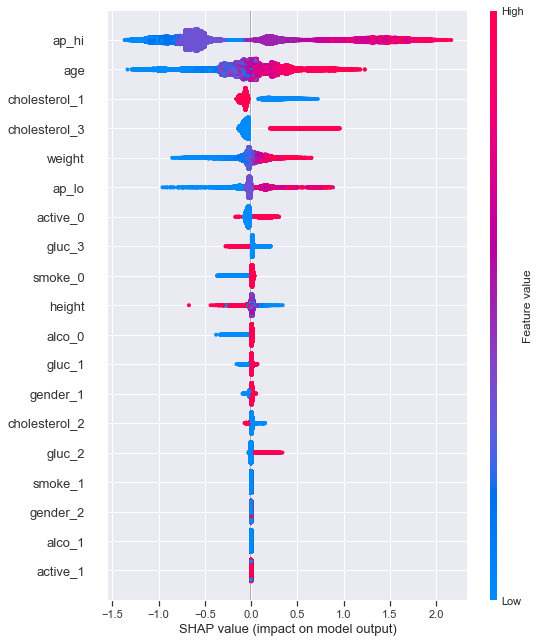

In [92]:
best_model_xgb = grid_search_xgb.best_estimator_
explainer = shap.TreeExplainer(best_model_xgb)
shap_values=explainer.shap_values(features_train, target_train)
shap.initjs()
shap.summary_plot(shap_values, features_train)

Значение auc-roc: 0.8033953803236461
Лучшие параметры: {'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 450, 'subsample': 0.7985915078268784}


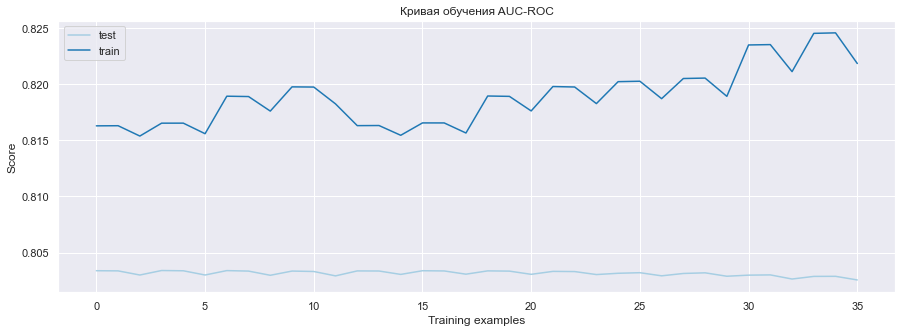

In [93]:
test_scores = grid_search_xgb.cv_results_['mean_test_score']
train_scores = grid_search_xgb.cv_results_['mean_train_score'] 

plt.plot(test_scores, label='test')
plt.plot(train_scores, label='train')# среднее значение auc-roc на кросс-валидации 
print(f'Значение auc-roc: {grid_search_xgb.best_score_}')
# лучшие гиперпараметры модели на кросс-валидации 
print(f'Лучшие параметры: {grid_search_xgb.best_params_}')
plt.legend(loc='best')
plt.xlabel('Training examples')
plt.ylabel('Score')
plt.title('Кривая обучения AUC-ROC')
plt.show()

In [94]:
cat_features = ['gender_1', 'gender_2','cholesterol_1', 'cholesterol_2', 'cholesterol_3', 'gluc_1', 'gluc_2','gluc_3', 'smoke_0', 'smoke_1', 'alco_0', 'alco_1', 'active_0','active_1']
for cat_feature in cat_features:
    features_train[cat_feature]=features_train[cat_feature].astype('int')
for cat_feature in cat_features:
    features_test[cat_feature]=features_test[cat_feature].astype('int')

In [95]:
features_train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 70000 entries, 0 to 69999
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   age            70000 non-null  float64
 1   height         70000 non-null  float64
 2   weight         70000 non-null  float64
 3   ap_hi          70000 non-null  float64
 4   ap_lo          70000 non-null  float64
 5   gender_1       70000 non-null  int32  
 6   gender_2       70000 non-null  int32  
 7   cholesterol_1  70000 non-null  int32  
 8   cholesterol_2  70000 non-null  int32  
 9   cholesterol_3  70000 non-null  int32  
 10  gluc_1         70000 non-null  int32  
 11  gluc_2         70000 non-null  int32  
 12  gluc_3         70000 non-null  int32  
 13  smoke_0        70000 non-null  int32  
 14  smoke_1        70000 non-null  int32  
 15  alco_0         70000 non-null  int32  
 16  alco_1         70000 non-null  int32  
 17  active_0       70000 non-null  int32  
 18  active

In [96]:
features_test.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 30000 entries, 0 to 29999
Data columns (total 19 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   age            30000 non-null  float64
 1   height         30000 non-null  float64
 2   weight         30000 non-null  float64
 3   ap_hi          30000 non-null  float64
 4   ap_lo          30000 non-null  float64
 5   gender_1       30000 non-null  int32  
 6   gender_2       30000 non-null  int32  
 7   cholesterol_1  30000 non-null  int32  
 8   cholesterol_2  30000 non-null  int32  
 9   cholesterol_3  30000 non-null  int32  
 10  gluc_1         30000 non-null  int32  
 11  gluc_2         30000 non-null  int32  
 12  gluc_3         30000 non-null  int32  
 13  smoke_0        30000 non-null  int32  
 14  smoke_1        30000 non-null  int32  
 15  alco_0         30000 non-null  int32  
 16  alco_1         30000 non-null  int32  
 17  active_0       30000 non-null  int32  
 18  active

In [97]:
def objective(trial: optuna.Trial) -> float:
   
    param = {
        "objective": trial.suggest_categorical("objective", ["Logloss"]),
        "colsample_bylevel": trial.suggest_float("colsample_bylevel", 0.01, 0.1, log=True),
        "depth": trial.suggest_int("depth", 1, 12),
        "boosting_type": trial.suggest_categorical("boosting_type", ["Ordered", "Plain"]),
        "bootstrap_type": trial.suggest_categorical(
            "bootstrap_type", ["Bayesian", "Bernoulli", "MVS"]
        ),
        "used_ram_limit": "3gb",
        "eval_metric": "AUC",
        'custom_metric' : 'AUC:hints=skip_train~false',
        'n_estimators': trial.suggest_int("n_estimators", 10, 500),
        'l2_leaf_reg': trial.suggest_int("l2_leaf_reg", 1, 10)
    }
    if param["bootstrap_type"] == "Bayesian":
        param["bagging_temperature"] = trial.suggest_float("bagging_temperature", 0, 10)
    elif param["bootstrap_type"] == "Bernoulli":
        param["subsample"] = trial.suggest_float("subsample", 0.1, 1, log=True)

    model_catboost = catboost.CatBoostClassifier(**param, loss_function='Logloss', random_state=RANDOM_STATE)
    cat_features = ['gender_1', 'gender_2','cholesterol_1', 'cholesterol_2', 'cholesterol_3', 'gluc_1', 'gluc_2','gluc_3', 'smoke_0', 'smoke_1', 'alco_0', 'alco_1', 'active_0','active_1']
    pool_train = Pool(features_train, target_train, cat_features = cat_features) 
    pool_test = Pool(features_test, cat_features = cat_features)
    

    model_catboost.fit(
        pool_train,
        plot=True,
        verbose=0            
         
    )
    
#    scores = cv(pool=Pool(features_train, target_train, cat_features = cat_features),
#            params=params, 
#            fold_count=4,
#            shuffle=True,
#            random_state=RANDOM_STATE,
#            plot=True
#           )

    score = cross_val_score(model_catboost, features_train, target_train , cv=3, scoring='roc_auc')
    roc_auc= score.mean()
    return roc_auc
    
     

if __name__ == "__main__":
    study = optuna.create_study(
    pruner=optuna.pruners.MedianPruner(n_warmup_steps=5), direction="maximize",study_name='cardio_catboost',
    storage="sqlite:///cardio.db"
    )
    study.optimize(objective, n_trials=100)

    print("Количество завершенных триалов: {}".format(len(study.trials)))

    print("Лучший триал:")
    trial = study.best_trial

    print("  Значение: {}".format(trial.value))

    print("  Параметры: ")
    for key, value in trial.params.items():
        print("    {}: {}".format(key, value))

[I 2023-03-09 04:59:53,465] A new study created in RDB with name: cardio_catboost


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5969131	total: 21.5ms	remaining: 9.66s
1:	learn: 0.5969131	total: 41.1ms	remaining: 9.22s
2:	learn: 0.5969131	total: 61.8ms	remaining: 9.23s
3:	learn: 0.6402719	total: 85.3ms	remaining: 9.54s
4:	learn: 0.6402719	total: 106ms	remaining: 9.49s
5:	learn: 0.6445100	total: 131ms	remaining: 9.71s
6:	learn: 0.7426888	total: 153ms	remaining: 9.71s
7:	learn: 0.7425072	total: 172ms	remaining: 9.52s
8:	learn: 0.7412368	total: 192ms	remaining: 9.45s
9:	learn: 0.7412368	total: 212ms	remaining: 9.34s
10:	learn: 0.7452471	total: 237ms	remaining: 9.49s
11:	learn: 0.7452941	total: 257ms	remaining: 9.42s
12:	learn: 0.7452497	total: 277ms	remaining: 9.33s
13:	learn: 0.7452497	total: 297ms	remaining: 9.29s
14:	learn: 0.7453183	total: 317ms	remaining: 9.22s
15:	learn: 0.7442774	total: 339ms	remaining: 9.22s
16:	learn: 0.7442774	total: 359ms	remaining: 9.17s
17:	learn: 0.7691848	total: 381ms	remaining: 9.18s
18:	learn: 0.7687383	total: 402ms	remaining: 9.14s
19:	learn: 0.7687383	total: 422ms	rem

162:	learn: 0.7898317	total: 3.79s	remaining: 6.69s
163:	learn: 0.7896761	total: 3.81s	remaining: 6.67s
164:	learn: 0.7900479	total: 3.83s	remaining: 6.64s
165:	learn: 0.7903820	total: 3.86s	remaining: 6.62s
166:	learn: 0.7903743	total: 3.88s	remaining: 6.6s
167:	learn: 0.7902332	total: 3.9s	remaining: 6.57s
168:	learn: 0.7901030	total: 3.92s	remaining: 6.54s
169:	learn: 0.7899924	total: 3.95s	remaining: 6.52s
170:	learn: 0.7905119	total: 3.97s	remaining: 6.5s
171:	learn: 0.7905119	total: 3.99s	remaining: 6.47s
172:	learn: 0.7905158	total: 4.01s	remaining: 6.44s
173:	learn: 0.7905055	total: 4.03s	remaining: 6.42s
174:	learn: 0.7905055	total: 4.05s	remaining: 6.39s
175:	learn: 0.7905079	total: 4.08s	remaining: 6.37s
176:	learn: 0.7904890	total: 4.1s	remaining: 6.34s
177:	learn: 0.7904890	total: 4.12s	remaining: 6.32s
178:	learn: 0.7903903	total: 4.14s	remaining: 6.29s
179:	learn: 0.7902790	total: 4.16s	remaining: 6.26s
180:	learn: 0.7902790	total: 4.18s	remaining: 6.24s
181:	learn: 0.79

323:	learn: 0.7947049	total: 7.32s	remaining: 2.87s
324:	learn: 0.7947050	total: 7.34s	remaining: 2.84s
325:	learn: 0.7947042	total: 7.36s	remaining: 2.82s
326:	learn: 0.7947487	total: 7.38s	remaining: 2.8s
327:	learn: 0.7947945	total: 7.41s	remaining: 2.78s
328:	learn: 0.7947937	total: 7.43s	remaining: 2.75s
329:	learn: 0.7947873	total: 7.45s	remaining: 2.73s
330:	learn: 0.7947926	total: 7.47s	remaining: 2.71s
331:	learn: 0.7948892	total: 7.49s	remaining: 2.69s
332:	learn: 0.7948892	total: 7.51s	remaining: 2.66s
333:	learn: 0.7949029	total: 7.54s	remaining: 2.64s
334:	learn: 0.7949029	total: 7.55s	remaining: 2.62s
335:	learn: 0.7949029	total: 7.57s	remaining: 2.59s
336:	learn: 0.7949029	total: 7.59s	remaining: 2.57s
337:	learn: 0.7949029	total: 7.61s	remaining: 2.54s
338:	learn: 0.7949019	total: 7.63s	remaining: 2.52s
339:	learn: 0.7949019	total: 7.65s	remaining: 2.5s
340:	learn: 0.7950483	total: 7.67s	remaining: 2.48s
341:	learn: 0.7950483	total: 7.69s	remaining: 2.45s
342:	learn: 0.

31:	learn: 0.7763884	total: 692ms	remaining: 9.07s
32:	learn: 0.7756484	total: 718ms	remaining: 9.09s
33:	learn: 0.7762748	total: 741ms	remaining: 9.09s
34:	learn: 0.7754398	total: 762ms	remaining: 9.06s
35:	learn: 0.7754398	total: 782ms	remaining: 9.02s
36:	learn: 0.7756150	total: 802ms	remaining: 8.97s
37:	learn: 0.7742629	total: 826ms	remaining: 8.97s
38:	learn: 0.7747889	total: 848ms	remaining: 8.96s
39:	learn: 0.7760762	total: 870ms	remaining: 8.94s
40:	learn: 0.7760762	total: 890ms	remaining: 8.9s
41:	learn: 0.7760762	total: 913ms	remaining: 8.89s
42:	learn: 0.7762687	total: 940ms	remaining: 8.92s
43:	learn: 0.7762687	total: 963ms	remaining: 8.9s
44:	learn: 0.7762751	total: 987ms	remaining: 8.9s
45:	learn: 0.7762751	total: 1.01s	remaining: 8.88s
46:	learn: 0.7756020	total: 1.03s	remaining: 8.89s
47:	learn: 0.7792856	total: 1.06s	remaining: 8.93s
48:	learn: 0.7792696	total: 1.09s	remaining: 8.92s
49:	learn: 0.7792696	total: 1.11s	remaining: 8.91s
50:	learn: 0.7814884	total: 1.14s	

194:	learn: 0.7882727	total: 4.66s	remaining: 6.12s
195:	learn: 0.7884396	total: 4.69s	remaining: 6.1s
196:	learn: 0.7884396	total: 4.71s	remaining: 6.08s
197:	learn: 0.7883363	total: 4.74s	remaining: 6.05s
198:	learn: 0.7883363	total: 4.76s	remaining: 6.02s
199:	learn: 0.7883363	total: 4.78s	remaining: 6s
200:	learn: 0.7883363	total: 4.8s	remaining: 5.97s
201:	learn: 0.7883245	total: 4.82s	remaining: 5.94s
202:	learn: 0.7883210	total: 4.84s	remaining: 5.91s
203:	learn: 0.7883983	total: 4.86s	remaining: 5.89s
204:	learn: 0.7883983	total: 4.88s	remaining: 5.86s
205:	learn: 0.7883983	total: 4.91s	remaining: 5.84s
206:	learn: 0.7891067	total: 4.95s	remaining: 5.83s
207:	learn: 0.7890953	total: 4.98s	remaining: 5.82s
208:	learn: 0.7890953	total: 5s	remaining: 5.79s
209:	learn: 0.7891793	total: 5.03s	remaining: 5.77s
210:	learn: 0.7891209	total: 5.06s	remaining: 5.75s
211:	learn: 0.7893301	total: 5.08s	remaining: 5.73s
212:	learn: 0.7893380	total: 5.11s	remaining: 5.71s
213:	learn: 0.789697

354:	learn: 0.7946444	total: 8.66s	remaining: 2.34s
355:	learn: 0.7946393	total: 8.68s	remaining: 2.32s
356:	learn: 0.7946393	total: 8.71s	remaining: 2.29s
357:	learn: 0.7946633	total: 8.73s	remaining: 2.27s
358:	learn: 0.7946720	total: 8.75s	remaining: 2.24s
359:	learn: 0.7946720	total: 8.77s	remaining: 2.22s
360:	learn: 0.7947399	total: 8.8s	remaining: 2.19s
361:	learn: 0.7947399	total: 8.82s	remaining: 2.17s
362:	learn: 0.7947434	total: 8.84s	remaining: 2.14s
363:	learn: 0.7947102	total: 8.86s	remaining: 2.12s
364:	learn: 0.7947102	total: 8.89s	remaining: 2.09s
365:	learn: 0.7947279	total: 8.92s	remaining: 2.07s
366:	learn: 0.7947279	total: 8.94s	remaining: 2.05s
367:	learn: 0.7947279	total: 8.97s	remaining: 2.02s
368:	learn: 0.7947430	total: 8.99s	remaining: 2s
369:	learn: 0.7947430	total: 9.02s	remaining: 1.97s
370:	learn: 0.7947445	total: 9.06s	remaining: 1.95s
371:	learn: 0.7947445	total: 9.08s	remaining: 1.93s
372:	learn: 0.7948950	total: 9.11s	remaining: 1.9s
373:	learn: 0.794

68:	learn: 0.7859255	total: 1.72s	remaining: 9.54s
69:	learn: 0.7869898	total: 1.75s	remaining: 9.52s
70:	learn: 0.7866168	total: 1.77s	remaining: 9.48s
71:	learn: 0.7866221	total: 1.81s	remaining: 9.53s
72:	learn: 0.7866221	total: 1.84s	remaining: 9.51s
73:	learn: 0.7868639	total: 1.86s	remaining: 9.49s
74:	learn: 0.7868695	total: 1.89s	remaining: 9.45s
75:	learn: 0.7868695	total: 1.91s	remaining: 9.42s
76:	learn: 0.7868695	total: 1.93s	remaining: 9.39s
77:	learn: 0.7868695	total: 1.95s	remaining: 9.35s
78:	learn: 0.7868785	total: 1.98s	remaining: 9.31s
79:	learn: 0.7868785	total: 2s	remaining: 9.29s
80:	learn: 0.7868785	total: 2.02s	remaining: 9.25s
81:	learn: 0.7869838	total: 2.05s	remaining: 9.23s
82:	learn: 0.7866038	total: 2.08s	remaining: 9.21s
83:	learn: 0.7866038	total: 2.1s	remaining: 9.17s
84:	learn: 0.7866038	total: 2.12s	remaining: 9.13s
85:	learn: 0.7866038	total: 2.14s	remaining: 9.1s
86:	learn: 0.7876243	total: 2.18s	remaining: 9.11s
87:	learn: 0.7876243	total: 2.2s	rem

234:	learn: 0.7940228	total: 6.12s	remaining: 5.63s
235:	learn: 0.7940228	total: 6.14s	remaining: 5.6s
236:	learn: 0.7940233	total: 6.17s	remaining: 5.57s
237:	learn: 0.7941229	total: 6.2s	remaining: 5.54s
238:	learn: 0.7941659	total: 6.23s	remaining: 5.52s
239:	learn: 0.7941659	total: 6.25s	remaining: 5.49s
240:	learn: 0.7942936	total: 6.28s	remaining: 5.47s
241:	learn: 0.7942932	total: 6.31s	remaining: 5.45s
242:	learn: 0.7942928	total: 6.33s	remaining: 5.42s
243:	learn: 0.7942890	total: 6.36s	remaining: 5.4s
244:	learn: 0.7942964	total: 6.39s	remaining: 5.37s
245:	learn: 0.7944669	total: 6.43s	remaining: 5.36s
246:	learn: 0.7944669	total: 6.45s	remaining: 5.33s
247:	learn: 0.7944669	total: 6.48s	remaining: 5.3s
248:	learn: 0.7944669	total: 6.5s	remaining: 5.27s
249:	learn: 0.7945990	total: 6.54s	remaining: 5.26s
250:	learn: 0.7945990	total: 6.56s	remaining: 5.23s
251:	learn: 0.7945990	total: 6.58s	remaining: 5.2s
252:	learn: 0.7947161	total: 6.61s	remaining: 5.17s
253:	learn: 0.7947

395:	learn: 0.7974516	total: 10.4s	remaining: 1.45s
396:	learn: 0.7974574	total: 10.5s	remaining: 1.42s
397:	learn: 0.7974502	total: 10.5s	remaining: 1.4s
398:	learn: 0.7974492	total: 10.5s	remaining: 1.37s
399:	learn: 0.7974533	total: 10.5s	remaining: 1.34s
400:	learn: 0.7976502	total: 10.6s	remaining: 1.32s
401:	learn: 0.7976502	total: 10.6s	remaining: 1.29s
402:	learn: 0.7976452	total: 10.7s	remaining: 1.27s
403:	learn: 0.7976476	total: 10.7s	remaining: 1.24s
404:	learn: 0.7977641	total: 10.7s	remaining: 1.22s
405:	learn: 0.7977956	total: 10.8s	remaining: 1.19s
406:	learn: 0.7977956	total: 10.8s	remaining: 1.17s
407:	learn: 0.7977956	total: 10.8s	remaining: 1.14s
408:	learn: 0.7977956	total: 10.8s	remaining: 1.11s
409:	learn: 0.7977954	total: 10.9s	remaining: 1.08s
410:	learn: 0.7978031	total: 10.9s	remaining: 1.06s
411:	learn: 0.7978053	total: 10.9s	remaining: 1.03s
412:	learn: 0.7978694	total: 11s	remaining: 1.01s
413:	learn: 0.7978694	total: 11s	remaining: 982ms
414:	learn: 0.797

[I 2023-03-09 05:00:43,783] Trial 0 finished with value: 0.7955116044374299 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.050540061086187124, 'depth': 11, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 451, 'l2_leaf_reg': 1, 'subsample': 0.46783625513613236}. Best is trial 0 with value: 0.7955116044374299.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6621363	total: 9.33ms	remaining: 1.99s
1:	learn: 0.6621363	total: 18.4ms	remaining: 1.95s
2:	learn: 0.6621363	total: 27.4ms	remaining: 1.93s
3:	learn: 0.6621363	total: 35.7ms	remaining: 1.87s
4:	learn: 0.6621363	total: 44.5ms	remaining: 1.86s
5:	learn: 0.6637769	total: 52.6ms	remaining: 1.82s
6:	learn: 0.7323686	total: 62.3ms	remaining: 1.84s
7:	learn: 0.7463122	total: 70.8ms	remaining: 1.82s
8:	learn: 0.7507897	total: 79.1ms	remaining: 1.8s
9:	learn: 0.7507897	total: 86ms	remaining: 1.75s
10:	learn: 0.7700871	total: 93.6ms	remaining: 1.73s
11:	learn: 0.7700871	total: 100ms	remaining: 1.69s
12:	learn: 0.7700871	total: 108ms	remaining: 1.67s
13:	learn: 0.7700871	total: 115ms	remaining: 1.64s
14:	learn: 0.7700871	total: 122ms	remaining: 1.62s
15:	learn: 0.7700871	total: 130ms	remaining: 1.61s
16:	learn: 0.7701902	total: 139ms	remaining: 1.61s
17:	learn: 0.7728600	total: 149ms	remaining: 1.62s
18:	learn: 0.7707797	total: 158ms	remaining: 1.62s
19:	learn: 0.7707797	total: 166ms

177:	learn: 0.7822417	total: 1.5s	remaining: 305ms
178:	learn: 0.7832345	total: 1.51s	remaining: 296ms
179:	learn: 0.7831869	total: 1.52s	remaining: 288ms
180:	learn: 0.7831869	total: 1.53s	remaining: 280ms
181:	learn: 0.7830662	total: 1.54s	remaining: 272ms
182:	learn: 0.7830662	total: 1.55s	remaining: 263ms
183:	learn: 0.7831084	total: 1.57s	remaining: 255ms
184:	learn: 0.7831084	total: 1.57s	remaining: 247ms
185:	learn: 0.7830908	total: 1.58s	remaining: 239ms
186:	learn: 0.7828683	total: 1.59s	remaining: 230ms
187:	learn: 0.7829959	total: 1.6s	remaining: 222ms
188:	learn: 0.7829039	total: 1.61s	remaining: 213ms
189:	learn: 0.7828145	total: 1.62s	remaining: 205ms
190:	learn: 0.7828145	total: 1.63s	remaining: 196ms
191:	learn: 0.7825478	total: 1.64s	remaining: 188ms
192:	learn: 0.7825478	total: 1.65s	remaining: 179ms
193:	learn: 0.7825478	total: 1.66s	remaining: 171ms
194:	learn: 0.7825478	total: 1.67s	remaining: 162ms
195:	learn: 0.7824504	total: 1.67s	remaining: 154ms
196:	learn: 0.

133:	learn: 0.7842706	total: 1.13s	remaining: 675ms
134:	learn: 0.7838503	total: 1.14s	remaining: 667ms
135:	learn: 0.7838918	total: 1.15s	remaining: 660ms
136:	learn: 0.7838918	total: 1.16s	remaining: 652ms
137:	learn: 0.7839088	total: 1.17s	remaining: 644ms
138:	learn: 0.7839088	total: 1.18s	remaining: 635ms
139:	learn: 0.7839088	total: 1.19s	remaining: 627ms
140:	learn: 0.7839088	total: 1.2s	remaining: 619ms
141:	learn: 0.7839088	total: 1.2s	remaining: 610ms
142:	learn: 0.7852230	total: 1.21s	remaining: 603ms
143:	learn: 0.7852230	total: 1.22s	remaining: 594ms
144:	learn: 0.7852230	total: 1.23s	remaining: 586ms
145:	learn: 0.7852230	total: 1.24s	remaining: 577ms
146:	learn: 0.7863635	total: 1.25s	remaining: 569ms
147:	learn: 0.7863635	total: 1.26s	remaining: 560ms
148:	learn: 0.7863550	total: 1.26s	remaining: 551ms
149:	learn: 0.7863550	total: 1.27s	remaining: 543ms
150:	learn: 0.7870634	total: 1.28s	remaining: 534ms
151:	learn: 0.7870983	total: 1.29s	remaining: 526ms
152:	learn: 0.

91:	learn: 0.7789465	total: 748ms	remaining: 991ms
92:	learn: 0.7789465	total: 758ms	remaining: 986ms
93:	learn: 0.7787393	total: 768ms	remaining: 981ms
94:	learn: 0.7787393	total: 778ms	remaining: 974ms
95:	learn: 0.7787393	total: 789ms	remaining: 969ms
96:	learn: 0.7787393	total: 797ms	remaining: 961ms
97:	learn: 0.7785884	total: 807ms	remaining: 955ms
98:	learn: 0.7788801	total: 815ms	remaining: 947ms
99:	learn: 0.7787293	total: 824ms	remaining: 939ms
100:	learn: 0.7786894	total: 832ms	remaining: 931ms
101:	learn: 0.7786894	total: 840ms	remaining: 923ms
102:	learn: 0.7786894	total: 848ms	remaining: 914ms
103:	learn: 0.7786894	total: 855ms	remaining: 905ms
104:	learn: 0.7786894	total: 863ms	remaining: 896ms
105:	learn: 0.7787347	total: 871ms	remaining: 887ms
106:	learn: 0.7787347	total: 879ms	remaining: 879ms
107:	learn: 0.7784030	total: 887ms	remaining: 871ms
108:	learn: 0.7784030	total: 896ms	remaining: 863ms
109:	learn: 0.7806305	total: 904ms	remaining: 855ms
110:	learn: 0.7806029

[I 2023-03-09 05:00:52,819] Trial 1 finished with value: 0.7842496063378165 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.03693137960316016, 'depth': 2, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 214, 'l2_leaf_reg': 6, 'subsample': 0.2757549129339057}. Best is trial 0 with value: 0.7955116044374299.


210:	learn: 0.7809523	total: 1.86s	remaining: 26.4ms
211:	learn: 0.7809571	total: 1.87s	remaining: 17.7ms
212:	learn: 0.7809571	total: 1.88s	remaining: 8.83ms
213:	learn: 0.7809571	total: 1.89s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.26ms	remaining: 2.53s
1:	learn: 0.5000000	total: 14.6ms	remaining: 2.53s
2:	learn: 0.5752157	total: 22.1ms	remaining: 2.56s
3:	learn: 0.6892338	total: 29.7ms	remaining: 2.56s
4:	learn: 0.7203788	total: 42.1ms	remaining: 2.91s
5:	learn: 0.7571970	total: 51.6ms	remaining: 2.96s
6:	learn: 0.7581391	total: 60.9ms	remaining: 2.98s
7:	learn: 0.7570164	total: 69.2ms	remaining: 2.96s
8:	learn: 0.7648954	total: 80.6ms	remaining: 3.06s
9:	learn: 0.7646977	total: 90.1ms	remaining: 3.06s
10:	learn: 0.7647248	total: 98.2ms	remaining: 3.03s
11:	learn: 0.7772860	total: 107ms	remaining: 3.03s
12:	learn: 0.7772860	total: 115ms	remaining: 2.97s
13:	learn: 0.7764162	total: 123ms	remaining: 2.95s
14:	learn: 0.7807593	total: 131ms	remaining: 2.93s
15:	learn: 0.7807593	total: 138ms	remaining: 2.88s
16:	learn: 0.7800144	total: 147ms	remaining: 2.89s
17:	learn: 0.7798682	total: 155ms	remaining: 2.86s
18:	learn: 0.7832721	total: 163ms	remaining: 2.84s
19:	learn: 0.7807608	total: 17

169:	learn: 0.7924476	total: 1.72s	remaining: 1.82s
170:	learn: 0.7924476	total: 1.73s	remaining: 1.81s
171:	learn: 0.7924539	total: 1.74s	remaining: 1.8s
172:	learn: 0.7925422	total: 1.75s	remaining: 1.79s
173:	learn: 0.7925315	total: 1.76s	remaining: 1.78s
174:	learn: 0.7925315	total: 1.77s	remaining: 1.77s
175:	learn: 0.7925223	total: 1.78s	remaining: 1.76s
176:	learn: 0.7925223	total: 1.79s	remaining: 1.75s
177:	learn: 0.7925223	total: 1.8s	remaining: 1.74s
178:	learn: 0.7925223	total: 1.8s	remaining: 1.72s
179:	learn: 0.7930738	total: 1.81s	remaining: 1.71s
180:	learn: 0.7930738	total: 1.82s	remaining: 1.7s
181:	learn: 0.7930738	total: 1.83s	remaining: 1.69s
182:	learn: 0.7930718	total: 1.84s	remaining: 1.68s
183:	learn: 0.7930718	total: 1.84s	remaining: 1.66s
184:	learn: 0.7933333	total: 1.85s	remaining: 1.65s
185:	learn: 0.7936153	total: 1.86s	remaining: 1.64s
186:	learn: 0.7936100	total: 1.87s	remaining: 1.63s
187:	learn: 0.7936100	total: 1.88s	remaining: 1.62s
188:	learn: 0.79

347:	learn: 0.7985149	total: 3.46s	remaining: 19.9ms
348:	learn: 0.7985146	total: 3.47s	remaining: 9.94ms
349:	learn: 0.7985404	total: 3.48s	remaining: 0us
0:	learn: 0.5000000	total: 10.6ms	remaining: 3.71s
1:	learn: 0.5000000	total: 17.4ms	remaining: 3.03s
2:	learn: 0.5785224	total: 25ms	remaining: 2.89s
3:	learn: 0.5869123	total: 32ms	remaining: 2.77s
4:	learn: 0.5895393	total: 39.3ms	remaining: 2.71s
5:	learn: 0.6046453	total: 51.1ms	remaining: 2.93s
6:	learn: 0.7530778	total: 64.4ms	remaining: 3.16s
7:	learn: 0.7521211	total: 71.8ms	remaining: 3.07s
8:	learn: 0.7521211	total: 78.2ms	remaining: 2.96s
9:	learn: 0.7521726	total: 85ms	remaining: 2.89s
10:	learn: 0.7515205	total: 95.5ms	remaining: 2.94s
11:	learn: 0.7636901	total: 106ms	remaining: 2.99s
12:	learn: 0.7636901	total: 114ms	remaining: 2.97s
13:	learn: 0.7806526	total: 129ms	remaining: 3.09s
14:	learn: 0.7807607	total: 137ms	remaining: 3.06s
15:	learn: 0.7833044	total: 149ms	remaining: 3.1s
16:	learn: 0.7804668	total: 157ms	

163:	learn: 0.7952343	total: 1.61s	remaining: 1.82s
164:	learn: 0.7952230	total: 1.62s	remaining: 1.81s
165:	learn: 0.7952108	total: 1.63s	remaining: 1.81s
166:	learn: 0.7952108	total: 1.64s	remaining: 1.79s
167:	learn: 0.7952108	total: 1.64s	remaining: 1.78s
168:	learn: 0.7953159	total: 1.66s	remaining: 1.78s
169:	learn: 0.7953159	total: 1.67s	remaining: 1.77s
170:	learn: 0.7954890	total: 1.68s	remaining: 1.75s
171:	learn: 0.7955082	total: 1.69s	remaining: 1.75s
172:	learn: 0.7955566	total: 1.71s	remaining: 1.74s
173:	learn: 0.7955566	total: 1.71s	remaining: 1.73s
174:	learn: 0.7955212	total: 1.72s	remaining: 1.72s
175:	learn: 0.7955326	total: 1.73s	remaining: 1.71s
176:	learn: 0.7954759	total: 1.74s	remaining: 1.7s
177:	learn: 0.7954776	total: 1.75s	remaining: 1.69s
178:	learn: 0.7955561	total: 1.76s	remaining: 1.69s
179:	learn: 0.7955157	total: 1.77s	remaining: 1.68s
180:	learn: 0.7955108	total: 1.78s	remaining: 1.66s
181:	learn: 0.7956709	total: 1.79s	remaining: 1.66s
182:	learn: 0

342:	learn: 0.7996842	total: 3.38s	remaining: 69ms
343:	learn: 0.7997166	total: 3.39s	remaining: 59.1ms
344:	learn: 0.7997020	total: 3.4s	remaining: 49.3ms
345:	learn: 0.7997070	total: 3.41s	remaining: 39.4ms
346:	learn: 0.7997082	total: 3.42s	remaining: 29.6ms
347:	learn: 0.7997096	total: 3.43s	remaining: 19.7ms
348:	learn: 0.7997096	total: 3.44s	remaining: 9.86ms
349:	learn: 0.7997155	total: 3.45s	remaining: 0us
0:	learn: 0.5000000	total: 7.48ms	remaining: 2.61s
1:	learn: 0.5000000	total: 15.5ms	remaining: 2.7s
2:	learn: 0.5981477	total: 23.1ms	remaining: 2.67s
3:	learn: 0.6000504	total: 32.7ms	remaining: 2.83s
4:	learn: 0.6015262	total: 41.2ms	remaining: 2.84s
5:	learn: 0.7597210	total: 55.9ms	remaining: 3.2s
6:	learn: 0.7626858	total: 69.3ms	remaining: 3.39s
7:	learn: 0.7622428	total: 81.7ms	remaining: 3.49s
8:	learn: 0.7675454	total: 91.5ms	remaining: 3.47s
9:	learn: 0.7851402	total: 105ms	remaining: 3.56s
10:	learn: 0.7843013	total: 116ms	remaining: 3.58s
11:	learn: 0.7844056	tot

160:	learn: 0.7957385	total: 1.75s	remaining: 2.05s
161:	learn: 0.7957385	total: 1.76s	remaining: 2.04s
162:	learn: 0.7960786	total: 1.78s	remaining: 2.04s
163:	learn: 0.7962726	total: 1.79s	remaining: 2.03s
164:	learn: 0.7962647	total: 1.8s	remaining: 2.02s
165:	learn: 0.7963282	total: 1.81s	remaining: 2.01s
166:	learn: 0.7963282	total: 1.82s	remaining: 2s
167:	learn: 0.7963472	total: 1.83s	remaining: 1.99s
168:	learn: 0.7963445	total: 1.84s	remaining: 1.97s
169:	learn: 0.7963090	total: 1.85s	remaining: 1.96s
170:	learn: 0.7963745	total: 1.86s	remaining: 1.95s
171:	learn: 0.7964495	total: 1.88s	remaining: 1.95s
172:	learn: 0.7964252	total: 1.89s	remaining: 1.93s
173:	learn: 0.7963629	total: 1.91s	remaining: 1.93s
174:	learn: 0.7963709	total: 1.91s	remaining: 1.91s
175:	learn: 0.7964938	total: 1.92s	remaining: 1.9s
176:	learn: 0.7964370	total: 1.94s	remaining: 1.89s
177:	learn: 0.7964370	total: 1.95s	remaining: 1.88s
178:	learn: 0.7964370	total: 1.96s	remaining: 1.87s
179:	learn: 0.796

338:	learn: 0.7994916	total: 3.73s	remaining: 121ms
339:	learn: 0.7994916	total: 3.74s	remaining: 110ms
340:	learn: 0.7994946	total: 3.75s	remaining: 99.1ms
341:	learn: 0.7996128	total: 3.77s	remaining: 88.2ms
342:	learn: 0.7996118	total: 3.78s	remaining: 77.1ms
343:	learn: 0.7996109	total: 3.79s	remaining: 66.1ms
344:	learn: 0.7996109	total: 3.79s	remaining: 55ms
345:	learn: 0.7996172	total: 3.81s	remaining: 44ms
346:	learn: 0.7996172	total: 3.81s	remaining: 33ms
347:	learn: 0.7996172	total: 3.82s	remaining: 22ms
348:	learn: 0.7996258	total: 3.83s	remaining: 11ms
349:	learn: 0.7996859	total: 3.84s	remaining: 0us


[I 2023-03-09 05:01:09,787] Trial 2 finished with value: 0.7973051396929568 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0611350406889329, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'n_estimators': 350, 'l2_leaf_reg': 7}. Best is trial 2 with value: 0.7973051396929568.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 12.8ms	remaining: 4.9s
1:	learn: 0.5000000	total: 24.3ms	remaining: 4.65s
2:	learn: 0.5082626	total: 33.1ms	remaining: 4.21s
3:	learn: 0.7143713	total: 41.7ms	remaining: 3.97s
4:	learn: 0.7167637	total: 48.5ms	remaining: 3.69s
5:	learn: 0.7246017	total: 56.7ms	remaining: 3.58s
6:	learn: 0.7458027	total: 64.5ms	remaining: 3.48s
7:	learn: 0.7458027	total: 70.8ms	remaining: 3.34s
8:	learn: 0.7457588	total: 80.9ms	remaining: 3.38s
9:	learn: 0.7510399	total: 89.5ms	remaining: 3.35s
10:	learn: 0.7697120	total: 97.2ms	remaining: 3.3s
11:	learn: 0.7697120	total: 104ms	remaining: 3.22s
12:	learn: 0.7683994	total: 111ms	remaining: 3.18s
13:	learn: 0.7683994	total: 117ms	remaining: 3.09s
14:	learn: 0.7662235	total: 124ms	remaining: 3.07s
15:	learn: 0.7681970	total: 133ms	remaining: 3.06s
16:	learn: 0.7681970	total: 141ms	remaining: 3.05s
17:	learn: 0.7681970	total: 147ms	remaining: 3s
18:	learn: 0.7667170	total: 156ms	remaining: 3s
19:	learn: 0.7667170	total: 162ms	rema

168:	learn: 0.7891702	total: 1.52s	remaining: 1.94s
169:	learn: 0.7891147	total: 1.53s	remaining: 1.94s
170:	learn: 0.7891147	total: 1.54s	remaining: 1.93s
171:	learn: 0.7889156	total: 1.56s	remaining: 1.93s
172:	learn: 0.7889156	total: 1.57s	remaining: 1.92s
173:	learn: 0.7889047	total: 1.58s	remaining: 1.91s
174:	learn: 0.7889164	total: 1.59s	remaining: 1.91s
175:	learn: 0.7889078	total: 1.6s	remaining: 1.9s
176:	learn: 0.7889078	total: 1.61s	remaining: 1.89s
177:	learn: 0.7889487	total: 1.62s	remaining: 1.88s
178:	learn: 0.7889220	total: 1.63s	remaining: 1.87s
179:	learn: 0.7889025	total: 1.64s	remaining: 1.86s
180:	learn: 0.7889087	total: 1.65s	remaining: 1.86s
181:	learn: 0.7889087	total: 1.66s	remaining: 1.85s
182:	learn: 0.7889087	total: 1.67s	remaining: 1.84s
183:	learn: 0.7889189	total: 1.68s	remaining: 1.83s
184:	learn: 0.7889189	total: 1.69s	remaining: 1.82s
185:	learn: 0.7889189	total: 1.7s	remaining: 1.82s
186:	learn: 0.7889189	total: 1.71s	remaining: 1.81s
187:	learn: 0.7

341:	learn: 0.7947948	total: 3.08s	remaining: 387ms
342:	learn: 0.7947948	total: 3.08s	remaining: 378ms
343:	learn: 0.7947961	total: 3.1s	remaining: 369ms
344:	learn: 0.7947961	total: 3.1s	remaining: 360ms
345:	learn: 0.7947961	total: 3.11s	remaining: 351ms
346:	learn: 0.7948675	total: 3.12s	remaining: 342ms
347:	learn: 0.7949111	total: 3.13s	remaining: 333ms
348:	learn: 0.7949104	total: 3.14s	remaining: 324ms
349:	learn: 0.7949128	total: 3.15s	remaining: 315ms
350:	learn: 0.7949158	total: 3.16s	remaining: 306ms
351:	learn: 0.7949158	total: 3.17s	remaining: 297ms
352:	learn: 0.7949497	total: 3.18s	remaining: 288ms
353:	learn: 0.7950261	total: 3.19s	remaining: 279ms
354:	learn: 0.7950261	total: 3.2s	remaining: 270ms
355:	learn: 0.7951279	total: 3.21s	remaining: 262ms
356:	learn: 0.7951279	total: 3.22s	remaining: 252ms
357:	learn: 0.7951287	total: 3.23s	remaining: 243ms
358:	learn: 0.7951287	total: 3.24s	remaining: 234ms
359:	learn: 0.7951287	total: 3.25s	remaining: 225ms
360:	learn: 0.7

135:	learn: 0.7836978	total: 1.19s	remaining: 2.17s
136:	learn: 0.7842913	total: 1.2s	remaining: 2.17s
137:	learn: 0.7847352	total: 1.21s	remaining: 2.17s
138:	learn: 0.7847564	total: 1.22s	remaining: 2.16s
139:	learn: 0.7847146	total: 1.23s	remaining: 2.15s
140:	learn: 0.7847146	total: 1.24s	remaining: 2.15s
141:	learn: 0.7847146	total: 1.25s	remaining: 2.13s
142:	learn: 0.7847146	total: 1.26s	remaining: 2.13s
143:	learn: 0.7857165	total: 1.27s	remaining: 2.12s
144:	learn: 0.7857165	total: 1.27s	remaining: 2.11s
145:	learn: 0.7856817	total: 1.28s	remaining: 2.1s
146:	learn: 0.7854450	total: 1.29s	remaining: 2.09s
147:	learn: 0.7854450	total: 1.3s	remaining: 2.08s
148:	learn: 0.7862681	total: 1.31s	remaining: 2.08s
149:	learn: 0.7862765	total: 1.32s	remaining: 2.07s
150:	learn: 0.7862765	total: 1.33s	remaining: 2.06s
151:	learn: 0.7869629	total: 1.34s	remaining: 2.05s
152:	learn: 0.7874283	total: 1.35s	remaining: 2.05s
153:	learn: 0.7876785	total: 1.36s	remaining: 2.04s
154:	learn: 0.7

311:	learn: 0.7925600	total: 3.13s	remaining: 731ms
312:	learn: 0.7925600	total: 3.13s	remaining: 721ms
313:	learn: 0.7925747	total: 3.14s	remaining: 711ms
314:	learn: 0.7925866	total: 3.15s	remaining: 701ms
315:	learn: 0.7925866	total: 3.16s	remaining: 690ms
316:	learn: 0.7925892	total: 3.17s	remaining: 680ms
317:	learn: 0.7927152	total: 3.18s	remaining: 670ms
318:	learn: 0.7927194	total: 3.19s	remaining: 660ms
319:	learn: 0.7926842	total: 3.2s	remaining: 650ms
320:	learn: 0.7927411	total: 3.21s	remaining: 640ms
321:	learn: 0.7927411	total: 3.22s	remaining: 630ms
322:	learn: 0.7927487	total: 3.23s	remaining: 620ms
323:	learn: 0.7927529	total: 3.24s	remaining: 610ms
324:	learn: 0.7927816	total: 3.25s	remaining: 600ms
325:	learn: 0.7927816	total: 3.26s	remaining: 590ms
326:	learn: 0.7927882	total: 3.27s	remaining: 580ms
327:	learn: 0.7927943	total: 3.28s	remaining: 570ms
328:	learn: 0.7927943	total: 3.29s	remaining: 560ms
329:	learn: 0.7927943	total: 3.29s	remaining: 549ms
330:	learn: 0

103:	learn: 0.7778407	total: 961ms	remaining: 2.6s
104:	learn: 0.7778039	total: 972ms	remaining: 2.59s
105:	learn: 0.7776595	total: 983ms	remaining: 2.59s
106:	learn: 0.7776719	total: 993ms	remaining: 2.58s
107:	learn: 0.7776719	total: 1s	remaining: 2.57s
108:	learn: 0.7775889	total: 1.01s	remaining: 2.56s
109:	learn: 0.7775889	total: 1.02s	remaining: 2.55s
110:	learn: 0.7773359	total: 1.03s	remaining: 2.54s
111:	learn: 0.7774132	total: 1.03s	remaining: 2.52s
112:	learn: 0.7771334	total: 1.04s	remaining: 2.51s
113:	learn: 0.7771334	total: 1.05s	remaining: 2.5s
114:	learn: 0.7769510	total: 1.06s	remaining: 2.49s
115:	learn: 0.7769510	total: 1.07s	remaining: 2.48s
116:	learn: 0.7769789	total: 1.07s	remaining: 2.46s
117:	learn: 0.7770813	total: 1.08s	remaining: 2.45s
118:	learn: 0.7767609	total: 1.09s	remaining: 2.44s
119:	learn: 0.7767609	total: 1.1s	remaining: 2.43s
120:	learn: 0.7767326	total: 1.11s	remaining: 2.42s
121:	learn: 0.7768116	total: 1.12s	remaining: 2.41s
122:	learn: 0.7768

265:	learn: 0.7905443	total: 2.42s	remaining: 1.08s
266:	learn: 0.7904871	total: 2.44s	remaining: 1.08s
267:	learn: 0.7904871	total: 2.44s	remaining: 1.07s
268:	learn: 0.7904897	total: 2.46s	remaining: 1.06s
269:	learn: 0.7904464	total: 2.46s	remaining: 1.05s
270:	learn: 0.7907166	total: 2.47s	remaining: 1.04s
271:	learn: 0.7907177	total: 2.48s	remaining: 1.03s
272:	learn: 0.7907261	total: 2.49s	remaining: 1.02s
273:	learn: 0.7907261	total: 2.5s	remaining: 1.01s
274:	learn: 0.7907870	total: 2.51s	remaining: 1s
275:	learn: 0.7909548	total: 2.52s	remaining: 994ms
276:	learn: 0.7909548	total: 2.52s	remaining: 984ms
277:	learn: 0.7911874	total: 2.53s	remaining: 975ms
278:	learn: 0.7912762	total: 2.54s	remaining: 965ms
279:	learn: 0.7914038	total: 2.55s	remaining: 956ms
280:	learn: 0.7914114	total: 2.56s	remaining: 947ms
281:	learn: 0.7914180	total: 2.57s	remaining: 938ms
282:	learn: 0.7914180	total: 2.57s	remaining: 928ms
283:	learn: 0.7914265	total: 2.58s	remaining: 918ms
284:	learn: 0.79

[I 2023-03-09 05:01:26,576] Trial 3 finished with value: 0.7937391606403197 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.05553128318126949, 'depth': 2, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'n_estimators': 385, 'l2_leaf_reg': 5}. Best is trial 2 with value: 0.7973051396929568.


374:	learn: 0.7937299	total: 3.38s	remaining: 90.1ms
375:	learn: 0.7937299	total: 3.39s	remaining: 81.1ms
376:	learn: 0.7937547	total: 3.4s	remaining: 72.2ms
377:	learn: 0.7937578	total: 3.41s	remaining: 63.2ms
378:	learn: 0.7937734	total: 3.42s	remaining: 54.2ms
379:	learn: 0.7938030	total: 3.43s	remaining: 45.2ms
380:	learn: 0.7938061	total: 3.44s	remaining: 36.2ms
381:	learn: 0.7938061	total: 3.45s	remaining: 27.1ms
382:	learn: 0.7938055	total: 3.46s	remaining: 18.1ms
383:	learn: 0.7938055	total: 3.47s	remaining: 9.04ms
384:	learn: 0.7938055	total: 3.48s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 6.52ms	remaining: 2.33s
1:	learn: 0.5000000	total: 12.7ms	remaining: 2.27s
2:	learn: 0.5000000	total: 19.5ms	remaining: 2.31s
3:	learn: 0.5000000	total: 25.2ms	remaining: 2.23s
4:	learn: 0.5000000	total: 31.1ms	remaining: 2.2s
5:	learn: 0.5000000	total: 36.8ms	remaining: 2.17s
6:	learn: 0.5000000	total: 42.2ms	remaining: 2.12s
7:	learn: 0.5000000	total: 47.9ms	remaining: 2.1s
8:	learn: 0.5608846	total: 54.6ms	remaining: 2.12s
9:	learn: 0.6913443	total: 61.2ms	remaining: 2.14s
10:	learn: 0.6913443	total: 67.3ms	remaining: 2.13s
11:	learn: 0.6913443	total: 73.4ms	remaining: 2.12s
12:	learn: 0.6913443	total: 79.4ms	remaining: 2.11s
13:	learn: 0.6909502	total: 86.5ms	remaining: 2.13s
14:	learn: 0.7199490	total: 93.8ms	remaining: 2.15s
15:	learn: 0.7199490	total: 101ms	remaining: 2.17s
16:	learn: 0.7199490	total: 107ms	remaining: 2.15s
17:	learn: 0.7199490	total: 113ms	remaining: 2.14s
18:	learn: 0.7199490	total: 118ms	remaining: 2.12s
19:	learn: 0.7199490	total: 

168:	learn: 0.7834060	total: 1.3s	remaining: 1.46s
169:	learn: 0.7834060	total: 1.3s	remaining: 1.45s
170:	learn: 0.7862368	total: 1.32s	remaining: 1.45s
171:	learn: 0.7862368	total: 1.33s	remaining: 1.44s
172:	learn: 0.7862368	total: 1.33s	remaining: 1.43s
173:	learn: 0.7872015	total: 1.34s	remaining: 1.43s
174:	learn: 0.7872015	total: 1.35s	remaining: 1.42s
175:	learn: 0.7872015	total: 1.36s	remaining: 1.41s
176:	learn: 0.7872015	total: 1.36s	remaining: 1.4s
177:	learn: 0.7872589	total: 1.37s	remaining: 1.4s
178:	learn: 0.7872589	total: 1.38s	remaining: 1.39s
179:	learn: 0.7872589	total: 1.39s	remaining: 1.38s
180:	learn: 0.7872589	total: 1.4s	remaining: 1.37s
181:	learn: 0.7872589	total: 1.41s	remaining: 1.37s
182:	learn: 0.7872589	total: 1.41s	remaining: 1.36s
183:	learn: 0.7872589	total: 1.42s	remaining: 1.35s
184:	learn: 0.7872736	total: 1.43s	remaining: 1.34s
185:	learn: 0.7872736	total: 1.44s	remaining: 1.34s
186:	learn: 0.7872736	total: 1.45s	remaining: 1.33s
187:	learn: 0.787

348:	learn: 0.7878183	total: 2.77s	remaining: 79.3ms
349:	learn: 0.7877992	total: 2.77s	remaining: 71.4ms
350:	learn: 0.7877992	total: 2.78s	remaining: 63.4ms
351:	learn: 0.7877858	total: 2.79s	remaining: 55.5ms
352:	learn: 0.7877858	total: 2.8s	remaining: 47.6ms
353:	learn: 0.7879264	total: 2.81s	remaining: 39.7ms
354:	learn: 0.7879264	total: 2.82s	remaining: 31.8ms
355:	learn: 0.7878873	total: 2.83s	remaining: 23.8ms
356:	learn: 0.7878944	total: 2.83s	remaining: 15.9ms
357:	learn: 0.7878876	total: 2.84s	remaining: 7.94ms
358:	learn: 0.7878876	total: 2.85s	remaining: 0us
0:	learn: 0.5000000	total: 7.22ms	remaining: 2.58s
1:	learn: 0.5000000	total: 13.8ms	remaining: 2.46s
2:	learn: 0.5000000	total: 20.9ms	remaining: 2.47s
3:	learn: 0.5000000	total: 28ms	remaining: 2.49s
4:	learn: 0.5000000	total: 36.1ms	remaining: 2.56s
5:	learn: 0.5000000	total: 43.3ms	remaining: 2.54s
6:	learn: 0.5000000	total: 51.3ms	remaining: 2.58s
7:	learn: 0.5000000	total: 58.4ms	remaining: 2.56s
8:	learn: 0.502

151:	learn: 0.7743033	total: 1.12s	remaining: 1.52s
152:	learn: 0.7775491	total: 1.13s	remaining: 1.52s
153:	learn: 0.7775491	total: 1.14s	remaining: 1.52s
154:	learn: 0.7774827	total: 1.15s	remaining: 1.51s
155:	learn: 0.7774827	total: 1.16s	remaining: 1.51s
156:	learn: 0.7774305	total: 1.17s	remaining: 1.5s
157:	learn: 0.7774305	total: 1.17s	remaining: 1.49s
158:	learn: 0.7774305	total: 1.18s	remaining: 1.49s
159:	learn: 0.7774305	total: 1.19s	remaining: 1.48s
160:	learn: 0.7773133	total: 1.2s	remaining: 1.47s
161:	learn: 0.7773133	total: 1.2s	remaining: 1.46s
162:	learn: 0.7773133	total: 1.21s	remaining: 1.46s
163:	learn: 0.7771969	total: 1.22s	remaining: 1.45s
164:	learn: 0.7771969	total: 1.23s	remaining: 1.44s
165:	learn: 0.7766562	total: 1.23s	remaining: 1.43s
166:	learn: 0.7766562	total: 1.24s	remaining: 1.43s
167:	learn: 0.7766562	total: 1.25s	remaining: 1.42s
168:	learn: 0.7766562	total: 1.25s	remaining: 1.41s
169:	learn: 0.7760487	total: 1.26s	remaining: 1.4s
170:	learn: 0.77

329:	learn: 0.7810358	total: 2.59s	remaining: 228ms
330:	learn: 0.7810358	total: 2.6s	remaining: 220ms
331:	learn: 0.7815575	total: 2.61s	remaining: 212ms
332:	learn: 0.7815575	total: 2.62s	remaining: 205ms
333:	learn: 0.7815575	total: 2.63s	remaining: 197ms
334:	learn: 0.7815575	total: 2.64s	remaining: 189ms
335:	learn: 0.7815575	total: 2.64s	remaining: 181ms
336:	learn: 0.7815408	total: 2.65s	remaining: 173ms
337:	learn: 0.7815408	total: 2.66s	remaining: 165ms
338:	learn: 0.7815408	total: 2.67s	remaining: 157ms
339:	learn: 0.7815566	total: 2.67s	remaining: 149ms
340:	learn: 0.7815566	total: 2.68s	remaining: 141ms
341:	learn: 0.7815566	total: 2.69s	remaining: 134ms
342:	learn: 0.7815814	total: 2.7s	remaining: 126ms
343:	learn: 0.7812166	total: 2.71s	remaining: 118ms
344:	learn: 0.7812166	total: 2.72s	remaining: 110ms
345:	learn: 0.7812166	total: 2.73s	remaining: 102ms
346:	learn: 0.7812166	total: 2.74s	remaining: 94.6ms
347:	learn: 0.7812166	total: 2.74s	remaining: 86.7ms
348:	learn: 

137:	learn: 0.7704067	total: 1.12s	remaining: 1.8s
138:	learn: 0.7690888	total: 1.14s	remaining: 1.8s
139:	learn: 0.7690888	total: 1.15s	remaining: 1.79s
140:	learn: 0.7690888	total: 1.16s	remaining: 1.79s
141:	learn: 0.7686277	total: 1.17s	remaining: 1.78s
142:	learn: 0.7686253	total: 1.18s	remaining: 1.77s
143:	learn: 0.7686253	total: 1.18s	remaining: 1.77s
144:	learn: 0.7686104	total: 1.19s	remaining: 1.76s
145:	learn: 0.7680644	total: 1.2s	remaining: 1.75s
146:	learn: 0.7680644	total: 1.21s	remaining: 1.74s
147:	learn: 0.7680644	total: 1.22s	remaining: 1.74s
148:	learn: 0.7680883	total: 1.22s	remaining: 1.73s
149:	learn: 0.7680883	total: 1.23s	remaining: 1.72s
150:	learn: 0.7674513	total: 1.24s	remaining: 1.71s
151:	learn: 0.7674513	total: 1.25s	remaining: 1.7s
152:	learn: 0.7674513	total: 1.26s	remaining: 1.69s
153:	learn: 0.7674513	total: 1.27s	remaining: 1.69s
154:	learn: 0.7674434	total: 1.27s	remaining: 1.68s
155:	learn: 0.7674434	total: 1.28s	remaining: 1.67s
156:	learn: 0.76

308:	learn: 0.7822895	total: 2.62s	remaining: 423ms
309:	learn: 0.7822895	total: 2.62s	remaining: 415ms
310:	learn: 0.7822895	total: 2.63s	remaining: 407ms
311:	learn: 0.7822895	total: 2.64s	remaining: 398ms
312:	learn: 0.7822895	total: 2.65s	remaining: 390ms
313:	learn: 0.7822858	total: 2.66s	remaining: 381ms
314:	learn: 0.7822858	total: 2.67s	remaining: 373ms
315:	learn: 0.7822325	total: 2.68s	remaining: 365ms
316:	learn: 0.7822325	total: 2.69s	remaining: 356ms
317:	learn: 0.7822325	total: 2.69s	remaining: 348ms
318:	learn: 0.7822325	total: 2.7s	remaining: 339ms
319:	learn: 0.7820840	total: 2.71s	remaining: 331ms
320:	learn: 0.7820970	total: 2.72s	remaining: 322ms
321:	learn: 0.7820970	total: 2.73s	remaining: 314ms
322:	learn: 0.7820970	total: 2.74s	remaining: 305ms
323:	learn: 0.7820970	total: 2.75s	remaining: 297ms
324:	learn: 0.7820970	total: 2.75s	remaining: 288ms
325:	learn: 0.7820970	total: 2.76s	remaining: 280ms
326:	learn: 0.7820970	total: 2.77s	remaining: 271ms
327:	learn: 0

[I 2023-03-09 05:01:40,561] Trial 4 finished with value: 0.7838217591266909 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0275592749251354, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 359, 'l2_leaf_reg': 1, 'bagging_temperature': 3.0351147171077364}. Best is trial 2 with value: 0.7973051396929568.


352:	learn: 0.7826922	total: 3s	remaining: 51ms
353:	learn: 0.7826922	total: 3.01s	remaining: 42.5ms
354:	learn: 0.7843846	total: 3.03s	remaining: 34.1ms
355:	learn: 0.7852246	total: 3.04s	remaining: 25.6ms
356:	learn: 0.7852246	total: 3.04s	remaining: 17.1ms
357:	learn: 0.7852246	total: 3.05s	remaining: 8.52ms
358:	learn: 0.7858517	total: 3.06s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5047740	total: 10.4ms	remaining: 574ms
1:	learn: 0.6001124	total: 17.3ms	remaining: 468ms
2:	learn: 0.6001124	total: 23ms	remaining: 407ms
3:	learn: 0.6185615	total: 29ms	remaining: 377ms
4:	learn: 0.6218221	total: 34.9ms	remaining: 356ms
5:	learn: 0.6218221	total: 40.7ms	remaining: 339ms
6:	learn: 0.6218221	total: 44.9ms	remaining: 315ms
7:	learn: 0.6218221	total: 49ms	remaining: 294ms
8:	learn: 0.6214612	total: 53.9ms	remaining: 282ms
9:	learn: 0.6214612	total: 57.6ms	remaining: 265ms
10:	learn: 0.7583006	total: 61.4ms	remaining: 251ms
11:	learn: 0.7583006	total: 65.1ms	remaining: 239ms
12:	learn: 0.7583006	total: 68.8ms	remaining: 228ms
13:	learn: 0.7583006	total: 72.4ms	remaining: 217ms
14:	learn: 0.7583006	total: 75.9ms	remaining: 207ms
15:	learn: 0.7583006	total: 79.6ms	remaining: 199ms
16:	learn: 0.7583006	total: 83.4ms	remaining: 191ms
17:	learn: 0.7575599	total: 88ms	remaining: 186ms
18:	learn: 0.7575599	total: 92.2ms	remaining: 180ms
19:	learn: 0.7510313	total: 96

[I 2023-03-09 05:01:42,881] Trial 5 finished with value: 0.779438180654231 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.029169123691800834, 'depth': 3, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 56, 'l2_leaf_reg': 6, 'subsample': 0.1238607939043363}. Best is trial 2 with value: 0.7973051396929568.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 4.09ms	remaining: 352ms
1:	learn: 0.5000000	total: 8.39ms	remaining: 356ms
2:	learn: 0.5047740	total: 12.8ms	remaining: 359ms
3:	learn: 0.5939639	total: 17.3ms	remaining: 360ms
4:	learn: 0.5939639	total: 22.1ms	remaining: 362ms
5:	learn: 0.5969110	total: 27.6ms	remaining: 372ms
6:	learn: 0.7479356	total: 33ms	remaining: 378ms
7:	learn: 0.7389921	total: 38.1ms	remaining: 376ms
8:	learn: 0.7362319	total: 43.9ms	remaining: 381ms
9:	learn: 0.7460986	total: 49ms	remaining: 377ms
10:	learn: 0.7443570	total: 54.5ms	remaining: 377ms
11:	learn: 0.7436843	total: 59ms	remaining: 369ms
12:	learn: 0.7454313	total: 63.7ms	remaining: 363ms
13:	learn: 0.7460743	total: 69.3ms	remaining: 361ms
14:	learn: 0.7459640	total: 74.7ms	remaining: 359ms
15:	learn: 0.7465868	total: 79.7ms	remaining: 354ms
16:	learn: 0.7465868	total: 84.1ms	remaining: 346ms
17:	learn: 0.7465868	total: 88.6ms	remaining: 340ms
18:	learn: 0.7460889	total: 93.9ms	remaining: 336ms
19:	learn: 0.7460889	total: 

1:	learn: 0.5000000	total: 10.3ms	remaining: 438ms
2:	learn: 0.5016089	total: 15ms	remaining: 419ms
3:	learn: 0.5921312	total: 19.9ms	remaining: 413ms
4:	learn: 0.5921312	total: 24.3ms	remaining: 398ms
5:	learn: 0.5957437	total: 30ms	remaining: 405ms
6:	learn: 0.7492846	total: 36ms	remaining: 411ms
7:	learn: 0.7429244	total: 42ms	remaining: 415ms
8:	learn: 0.7354761	total: 47.9ms	remaining: 415ms
9:	learn: 0.7455101	total: 55ms	remaining: 423ms
10:	learn: 0.7444074	total: 61.5ms	remaining: 425ms
11:	learn: 0.7437658	total: 66.8ms	remaining: 417ms
12:	learn: 0.7472121	total: 73ms	remaining: 415ms
13:	learn: 0.7474200	total: 78.5ms	remaining: 409ms
14:	learn: 0.7480504	total: 84.5ms	remaining: 406ms
15:	learn: 0.7485616	total: 89.4ms	remaining: 397ms
16:	learn: 0.7485616	total: 93.7ms	remaining: 386ms
17:	learn: 0.7485616	total: 98ms	remaining: 376ms
18:	learn: 0.7481367	total: 104ms	remaining: 371ms
19:	learn: 0.7481367	total: 108ms	remaining: 361ms
20:	learn: 0.7502278	total: 114ms	rem

[I 2023-03-09 05:01:46,104] Trial 6 finished with value: 0.7771245679470228 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06757125763904566, 'depth': 2, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'n_estimators': 87, 'l2_leaf_reg': 6}. Best is trial 2 with value: 0.7973051396929568.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5968946	total: 10.2ms	remaining: 1.82s
1:	learn: 0.5968946	total: 18.7ms	remaining: 1.66s
2:	learn: 0.5981793	total: 28.1ms	remaining: 1.65s
3:	learn: 0.6125059	total: 37.1ms	remaining: 1.62s
4:	learn: 0.6125059	total: 45.3ms	remaining: 1.57s
5:	learn: 0.6125059	total: 53.8ms	remaining: 1.55s
6:	learn: 0.6125059	total: 62.3ms	remaining: 1.53s
7:	learn: 0.6125059	total: 70.6ms	remaining: 1.51s
8:	learn: 0.6125059	total: 79ms	remaining: 1.49s
9:	learn: 0.6125059	total: 87.4ms	remaining: 1.48s
10:	learn: 0.6125059	total: 95.9ms	remaining: 1.46s
11:	learn: 0.6125059	total: 104ms	remaining: 1.45s
12:	learn: 0.6125059	total: 113ms	remaining: 1.44s
13:	learn: 0.6072661	total: 122ms	remaining: 1.44s
14:	learn: 0.6072661	total: 131ms	remaining: 1.43s
15:	learn: 0.6072661	total: 140ms	remaining: 1.42s
16:	learn: 0.6076115	total: 149ms	remaining: 1.42s
17:	learn: 0.6182617	total: 160ms	remaining: 1.43s
18:	learn: 0.6182617	total: 168ms	remaining: 1.42s
19:	learn: 0.6182617	total: 177m

174:	learn: 0.7708295	total: 1.71s	remaining: 39.1ms
175:	learn: 0.7708295	total: 1.72s	remaining: 29.4ms
176:	learn: 0.7708295	total: 1.73s	remaining: 19.6ms
177:	learn: 0.7708295	total: 1.74s	remaining: 9.79ms
178:	learn: 0.7708295	total: 1.75s	remaining: 0us
0:	learn: 0.5005256	total: 10.4ms	remaining: 1.85s
1:	learn: 0.5005256	total: 19.4ms	remaining: 1.72s
2:	learn: 0.5798643	total: 28.9ms	remaining: 1.7s
3:	learn: 0.6216090	total: 38.2ms	remaining: 1.67s
4:	learn: 0.6216090	total: 46.8ms	remaining: 1.63s
5:	learn: 0.6216090	total: 55.6ms	remaining: 1.6s
6:	learn: 0.6216090	total: 65.3ms	remaining: 1.6s
7:	learn: 0.6216090	total: 74.9ms	remaining: 1.6s
8:	learn: 0.6216090	total: 84.6ms	remaining: 1.6s
9:	learn: 0.6216090	total: 94.3ms	remaining: 1.59s
10:	learn: 0.6216090	total: 103ms	remaining: 1.57s
11:	learn: 0.6216090	total: 112ms	remaining: 1.55s
12:	learn: 0.6216090	total: 121ms	remaining: 1.54s
13:	learn: 0.6216090	total: 130ms	remaining: 1.53s
14:	learn: 0.6216090	total: 1

159:	learn: 0.7609529	total: 1.57s	remaining: 186ms
160:	learn: 0.7609529	total: 1.58s	remaining: 177ms
161:	learn: 0.7609936	total: 1.59s	remaining: 167ms
162:	learn: 0.7591474	total: 1.6s	remaining: 158ms
163:	learn: 0.7591474	total: 1.61s	remaining: 148ms
164:	learn: 0.7591474	total: 1.62s	remaining: 138ms
165:	learn: 0.7591474	total: 1.63s	remaining: 128ms
166:	learn: 0.7591474	total: 1.64s	remaining: 118ms
167:	learn: 0.7591474	total: 1.65s	remaining: 108ms
168:	learn: 0.7591474	total: 1.66s	remaining: 98.3ms
169:	learn: 0.7556967	total: 1.67s	remaining: 88.6ms
170:	learn: 0.7557177	total: 1.68s	remaining: 78.7ms
171:	learn: 0.7557177	total: 1.69s	remaining: 68.8ms
172:	learn: 0.7545717	total: 1.7s	remaining: 59ms
173:	learn: 0.7545717	total: 1.71s	remaining: 49.2ms
174:	learn: 0.7545717	total: 1.72s	remaining: 39.3ms
175:	learn: 0.7545717	total: 1.73s	remaining: 29.5ms
176:	learn: 0.7546259	total: 1.74s	remaining: 19.6ms
177:	learn: 0.7528011	total: 1.75s	remaining: 9.83ms
178:	l

155:	learn: 0.7633200	total: 1.53s	remaining: 226ms
156:	learn: 0.7633200	total: 1.54s	remaining: 216ms
157:	learn: 0.7633872	total: 1.55s	remaining: 207ms
158:	learn: 0.7633872	total: 1.56s	remaining: 197ms
159:	learn: 0.7612716	total: 1.58s	remaining: 187ms
160:	learn: 0.7612716	total: 1.59s	remaining: 178ms
161:	learn: 0.7612985	total: 1.6s	remaining: 168ms
162:	learn: 0.7598184	total: 1.61s	remaining: 158ms
163:	learn: 0.7598184	total: 1.62s	remaining: 148ms
164:	learn: 0.7598184	total: 1.63s	remaining: 138ms
165:	learn: 0.7598184	total: 1.64s	remaining: 128ms
166:	learn: 0.7598184	total: 1.65s	remaining: 118ms
167:	learn: 0.7598184	total: 1.66s	remaining: 108ms
168:	learn: 0.7598184	total: 1.67s	remaining: 98.6ms
169:	learn: 0.7562305	total: 1.68s	remaining: 88.8ms
170:	learn: 0.7562608	total: 1.69s	remaining: 79ms
171:	learn: 0.7562608	total: 1.7s	remaining: 69ms
172:	learn: 0.7551182	total: 1.71s	remaining: 59.2ms


[I 2023-03-09 05:01:55,209] Trial 7 finished with value: 0.7583432500949588 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.015182144401600184, 'depth': 3, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 179, 'l2_leaf_reg': 9}. Best is trial 2 with value: 0.7973051396929568.


173:	learn: 0.7551182	total: 1.72s	remaining: 49.4ms
174:	learn: 0.7551182	total: 1.73s	remaining: 39.5ms
175:	learn: 0.7551182	total: 1.74s	remaining: 29.7ms
176:	learn: 0.7551974	total: 1.75s	remaining: 19.8ms
177:	learn: 0.7534055	total: 1.77s	remaining: 9.93ms
178:	learn: 0.7533993	total: 1.78s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.85ms	remaining: 3.67s
1:	learn: 0.5000000	total: 17ms	remaining: 3.52s
2:	learn: 0.5082626	total: 27ms	remaining: 3.72s
3:	learn: 0.5082626	total: 34.3ms	remaining: 3.53s
4:	learn: 0.5082626	total: 41.7ms	remaining: 3.43s
5:	learn: 0.5082626	total: 47.8ms	remaining: 3.27s
6:	learn: 0.5082626	total: 54.2ms	remaining: 3.16s
7:	learn: 0.5884633	total: 63.6ms	remaining: 3.24s
8:	learn: 0.5884633	total: 70.8ms	remaining: 3.2s
9:	learn: 0.5884633	total: 77.5ms	remaining: 3.15s
10:	learn: 0.5884633	total: 84.4ms	remaining: 3.11s
11:	learn: 0.5883719	total: 93.3ms	remaining: 3.14s
12:	learn: 0.5941819	total: 102ms	remaining: 3.16s
13:	learn: 0.5941819	total: 109ms	remaining: 3.13s
14:	learn: 0.5941819	total: 116ms	remaining: 3.09s
15:	learn: 0.5941819	total: 123ms	remaining: 3.07s
16:	learn: 0.5940000	total: 130ms	remaining: 3.06s
17:	learn: 0.5940000	total: 138ms	remaining: 3.04s
18:	learn: 0.5941340	total: 145ms	remaining: 3.04s
19:	learn: 0.5941340	total: 153ms	

171:	learn: 0.7895619	total: 1.5s	remaining: 2.13s
172:	learn: 0.7895228	total: 1.51s	remaining: 2.12s
173:	learn: 0.7893834	total: 1.52s	remaining: 2.12s
174:	learn: 0.7893050	total: 1.53s	remaining: 2.11s
175:	learn: 0.7891224	total: 1.54s	remaining: 2.1s
176:	learn: 0.7891391	total: 1.55s	remaining: 2.09s
177:	learn: 0.7891391	total: 1.56s	remaining: 2.08s
178:	learn: 0.7891130	total: 1.57s	remaining: 2.07s
179:	learn: 0.7897920	total: 1.58s	remaining: 2.07s
180:	learn: 0.7897920	total: 1.59s	remaining: 2.06s
181:	learn: 0.7897920	total: 1.59s	remaining: 2.05s
182:	learn: 0.7897920	total: 1.6s	remaining: 2.04s
183:	learn: 0.7897595	total: 1.61s	remaining: 2.03s
184:	learn: 0.7896844	total: 1.62s	remaining: 2.02s
185:	learn: 0.7895182	total: 1.63s	remaining: 2.02s
186:	learn: 0.7895182	total: 1.64s	remaining: 2s
187:	learn: 0.7895182	total: 1.65s	remaining: 2s
188:	learn: 0.7895182	total: 1.65s	remaining: 1.99s
189:	learn: 0.7895182	total: 1.66s	remaining: 1.98s
190:	learn: 0.7893674

349:	learn: 0.7939975	total: 3s	remaining: 565ms
350:	learn: 0.7939975	total: 3s	remaining: 557ms
351:	learn: 0.7940043	total: 3.01s	remaining: 548ms
352:	learn: 0.7940102	total: 3.02s	remaining: 539ms
353:	learn: 0.7940102	total: 3.03s	remaining: 530ms
354:	learn: 0.7941860	total: 3.04s	remaining: 522ms
355:	learn: 0.7941867	total: 3.04s	remaining: 513ms
356:	learn: 0.7941867	total: 3.05s	remaining: 504ms
357:	learn: 0.7941866	total: 3.06s	remaining: 496ms
358:	learn: 0.7941853	total: 3.07s	remaining: 487ms
359:	learn: 0.7941853	total: 3.08s	remaining: 478ms
360:	learn: 0.7941853	total: 3.08s	remaining: 470ms
361:	learn: 0.7941224	total: 3.09s	remaining: 461ms
362:	learn: 0.7941224	total: 3.1s	remaining: 452ms
363:	learn: 0.7941224	total: 3.11s	remaining: 444ms
364:	learn: 0.7941224	total: 3.11s	remaining: 435ms
365:	learn: 0.7942120	total: 3.13s	remaining: 427ms
366:	learn: 0.7942381	total: 3.14s	remaining: 419ms
367:	learn: 0.7942381	total: 3.15s	remaining: 410ms
368:	learn: 0.79444

106:	learn: 0.7879160	total: 887ms	remaining: 2.56s
107:	learn: 0.7879160	total: 900ms	remaining: 2.57s
108:	learn: 0.7879160	total: 908ms	remaining: 2.56s
109:	learn: 0.7878771	total: 918ms	remaining: 2.55s
110:	learn: 0.7878771	total: 927ms	remaining: 2.55s
111:	learn: 0.7877271	total: 938ms	remaining: 2.55s
112:	learn: 0.7876040	total: 948ms	remaining: 2.54s
113:	learn: 0.7876040	total: 956ms	remaining: 2.53s
114:	learn: 0.7875266	total: 968ms	remaining: 2.53s
115:	learn: 0.7875266	total: 976ms	remaining: 2.52s
116:	learn: 0.7875266	total: 984ms	remaining: 2.51s
117:	learn: 0.7875422	total: 992ms	remaining: 2.5s
118:	learn: 0.7875422	total: 1s	remaining: 2.5s
119:	learn: 0.7875422	total: 1.01s	remaining: 2.48s
120:	learn: 0.7874870	total: 1.01s	remaining: 2.48s
121:	learn: 0.7873878	total: 1.02s	remaining: 2.47s
122:	learn: 0.7873878	total: 1.03s	remaining: 2.46s
123:	learn: 0.7873948	total: 1.04s	remaining: 2.45s
124:	learn: 0.7873948	total: 1.05s	remaining: 2.44s
125:	learn: 0.787

281:	learn: 0.7921553	total: 2.37s	remaining: 1.12s
282:	learn: 0.7921553	total: 2.37s	remaining: 1.11s
283:	learn: 0.7920969	total: 2.38s	remaining: 1.11s
284:	learn: 0.7920971	total: 2.39s	remaining: 1.1s
285:	learn: 0.7920819	total: 2.4s	remaining: 1.09s
286:	learn: 0.7920817	total: 2.4s	remaining: 1.08s
287:	learn: 0.7920817	total: 2.41s	remaining: 1.07s
288:	learn: 0.7922503	total: 2.42s	remaining: 1.06s
289:	learn: 0.7922544	total: 2.43s	remaining: 1.06s
290:	learn: 0.7922544	total: 2.44s	remaining: 1.05s
291:	learn: 0.7922544	total: 2.44s	remaining: 1.04s
292:	learn: 0.7924208	total: 2.46s	remaining: 1.03s
293:	learn: 0.7926276	total: 2.47s	remaining: 1.03s
294:	learn: 0.7926621	total: 2.48s	remaining: 1.02s
295:	learn: 0.7926397	total: 2.49s	remaining: 1.01s
296:	learn: 0.7926397	total: 2.5s	remaining: 1s
297:	learn: 0.7926397	total: 2.51s	remaining: 993ms
298:	learn: 0.7926477	total: 2.52s	remaining: 984ms
299:	learn: 0.7926105	total: 2.52s	remaining: 976ms
300:	learn: 0.79267

35:	learn: 0.7784383	total: 276ms	remaining: 2.92s
36:	learn: 0.7784383	total: 284ms	remaining: 2.9s
37:	learn: 0.7834107	total: 295ms	remaining: 2.93s
38:	learn: 0.7832915	total: 304ms	remaining: 2.94s
39:	learn: 0.7832915	total: 311ms	remaining: 2.93s
40:	learn: 0.7832915	total: 319ms	remaining: 2.92s
41:	learn: 0.7827185	total: 328ms	remaining: 2.92s
42:	learn: 0.7822821	total: 335ms	remaining: 2.91s
43:	learn: 0.7822637	total: 344ms	remaining: 2.9s
44:	learn: 0.7836758	total: 355ms	remaining: 2.93s
45:	learn: 0.7836758	total: 362ms	remaining: 2.92s
46:	learn: 0.7836758	total: 370ms	remaining: 2.9s
47:	learn: 0.7836758	total: 377ms	remaining: 2.89s
48:	learn: 0.7836758	total: 384ms	remaining: 2.87s
49:	learn: 0.7836758	total: 391ms	remaining: 2.86s
50:	learn: 0.7834650	total: 399ms	remaining: 2.85s
51:	learn: 0.7834650	total: 406ms	remaining: 2.84s
52:	learn: 0.7840376	total: 415ms	remaining: 2.84s
53:	learn: 0.7834720	total: 424ms	remaining: 2.85s
54:	learn: 0.7834720	total: 432ms	

209:	learn: 0.7916246	total: 1.79s	remaining: 1.76s
210:	learn: 0.7917560	total: 1.8s	remaining: 1.75s
211:	learn: 0.7917560	total: 1.81s	remaining: 1.74s
212:	learn: 0.7918008	total: 1.82s	remaining: 1.73s
213:	learn: 0.7918070	total: 1.83s	remaining: 1.73s
214:	learn: 0.7920315	total: 1.84s	remaining: 1.72s
215:	learn: 0.7920315	total: 1.85s	remaining: 1.71s
216:	learn: 0.7920325	total: 1.86s	remaining: 1.7s
217:	learn: 0.7920325	total: 1.86s	remaining: 1.69s
218:	learn: 0.7920753	total: 1.87s	remaining: 1.68s
219:	learn: 0.7921205	total: 1.88s	remaining: 1.68s
220:	learn: 0.7921205	total: 1.89s	remaining: 1.67s
221:	learn: 0.7923837	total: 1.9s	remaining: 1.66s
222:	learn: 0.7927299	total: 1.91s	remaining: 1.66s
223:	learn: 0.7927299	total: 1.92s	remaining: 1.65s
224:	learn: 0.7928806	total: 1.93s	remaining: 1.64s
225:	learn: 0.7929071	total: 1.94s	remaining: 1.63s
226:	learn: 0.7929071	total: 1.95s	remaining: 1.62s
227:	learn: 0.7929071	total: 1.96s	remaining: 1.61s
228:	learn: 0.7

376:	learn: 0.7967301	total: 3.29s	remaining: 340ms
377:	learn: 0.7967798	total: 3.3s	remaining: 332ms
378:	learn: 0.7967798	total: 3.31s	remaining: 323ms
379:	learn: 0.7967798	total: 3.31s	remaining: 314ms
380:	learn: 0.7967798	total: 3.32s	remaining: 305ms
381:	learn: 0.7967612	total: 3.33s	remaining: 296ms
382:	learn: 0.7967597	total: 3.34s	remaining: 288ms
383:	learn: 0.7968456	total: 3.35s	remaining: 279ms
384:	learn: 0.7968456	total: 3.35s	remaining: 270ms
385:	learn: 0.7968420	total: 3.36s	remaining: 261ms
386:	learn: 0.7968608	total: 3.37s	remaining: 253ms
387:	learn: 0.7968608	total: 3.38s	remaining: 244ms
388:	learn: 0.7969814	total: 3.4s	remaining: 236ms
389:	learn: 0.7971367	total: 3.41s	remaining: 227ms
390:	learn: 0.7971423	total: 3.42s	remaining: 219ms
391:	learn: 0.7971423	total: 3.43s	remaining: 210ms
392:	learn: 0.7972093	total: 3.44s	remaining: 201ms
393:	learn: 0.7972095	total: 3.45s	remaining: 193ms
394:	learn: 0.7972095	total: 3.46s	remaining: 184ms
395:	learn: 0.

[I 2023-03-09 05:02:12,356] Trial 8 finished with value: 0.7948207791568889 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.04320384143333741, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'MVS', 'n_estimators': 416, 'l2_leaf_reg': 1}. Best is trial 2 with value: 0.7973051396929568.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5860172	total: 9.42ms	remaining: 348ms
1:	learn: 0.5860172	total: 17.6ms	remaining: 317ms
2:	learn: 0.6032622	total: 28.1ms	remaining: 328ms
3:	learn: 0.6032622	total: 36.7ms	remaining: 312ms
4:	learn: 0.6032622	total: 44.5ms	remaining: 294ms
5:	learn: 0.6083531	total: 53.6ms	remaining: 286ms
6:	learn: 0.6083531	total: 61.9ms	remaining: 274ms
7:	learn: 0.6083531	total: 70.1ms	remaining: 263ms
8:	learn: 0.6083531	total: 78.4ms	remaining: 252ms
9:	learn: 0.6083531	total: 86.6ms	remaining: 243ms
10:	learn: 0.6083531	total: 95.3ms	remaining: 234ms
11:	learn: 0.6117570	total: 106ms	remaining: 229ms
12:	learn: 0.6117570	total: 115ms	remaining: 221ms
13:	learn: 0.6117570	total: 123ms	remaining: 211ms
14:	learn: 0.7507552	total: 132ms	remaining: 203ms
15:	learn: 0.7377694	total: 143ms	remaining: 196ms
16:	learn: 0.7377694	total: 151ms	remaining: 187ms
17:	learn: 0.7377694	total: 159ms	remaining: 177ms
18:	learn: 0.7377694	total: 168ms	remaining: 168ms
19:	learn: 0.7377694	total: 17

[I 2023-03-09 05:02:15,016] Trial 9 finished with value: 0.7251083770957388 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0194296312038181, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'n_estimators': 38, 'l2_leaf_reg': 10, 'bagging_temperature': 6.842635207811379}. Best is trial 2 with value: 0.7973051396929568.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 30.7ms	remaining: 8.68s
1:	learn: 0.7585795	total: 54.2ms	remaining: 7.65s
2:	learn: 0.7585795	total: 74.9ms	remaining: 7.01s
3:	learn: 0.7596401	total: 109ms	remaining: 7.66s
4:	learn: 0.7734256	total: 136ms	remaining: 7.56s
5:	learn: 0.7748406	total: 160ms	remaining: 7.42s
6:	learn: 0.7717129	total: 185ms	remaining: 7.34s
7:	learn: 0.7764023	total: 222ms	remaining: 7.66s
8:	learn: 0.7849865	total: 257ms	remaining: 7.84s
9:	learn: 0.7860640	total: 300ms	remaining: 8.22s
10:	learn: 0.7856759	total: 328ms	remaining: 8.15s
11:	learn: 0.7861794	total: 380ms	remaining: 8.6s
12:	learn: 0.7862402	total: 415ms	remaining: 8.65s
13:	learn: 0.7861740	total: 440ms	remaining: 8.48s
14:	learn: 0.7861740	total: 465ms	remaining: 8.35s
15:	learn: 0.7859247	total: 491ms	remaining: 8.22s
16:	learn: 0.7873787	total: 540ms	remaining: 8.48s
17:	learn: 0.7891863	total: 568ms	remaining: 8.4s
18:	learn: 0.7884306	total: 595ms	remaining: 8.29s
19:	learn: 0.7895366	total: 624ms	remain

163:	learn: 0.8014726	total: 5.38s	remaining: 3.94s
164:	learn: 0.8016235	total: 5.43s	remaining: 3.92s
165:	learn: 0.8016235	total: 5.45s	remaining: 3.88s
166:	learn: 0.8016235	total: 5.47s	remaining: 3.84s
167:	learn: 0.8017078	total: 5.52s	remaining: 3.81s
168:	learn: 0.8017328	total: 5.56s	remaining: 3.79s
169:	learn: 0.8017208	total: 5.59s	remaining: 3.75s
170:	learn: 0.8017196	total: 5.61s	remaining: 3.71s
171:	learn: 0.8017195	total: 5.64s	remaining: 3.67s
172:	learn: 0.8017501	total: 5.68s	remaining: 3.64s
173:	learn: 0.8017527	total: 5.71s	remaining: 3.61s
174:	learn: 0.8017842	total: 5.74s	remaining: 3.57s
175:	learn: 0.8018111	total: 5.78s	remaining: 3.55s
176:	learn: 0.8018771	total: 5.82s	remaining: 3.52s
177:	learn: 0.8018605	total: 5.84s	remaining: 3.48s
178:	learn: 0.8019011	total: 5.89s	remaining: 3.45s
179:	learn: 0.8019629	total: 5.93s	remaining: 3.42s
180:	learn: 0.8019612	total: 5.95s	remaining: 3.39s
181:	learn: 0.8019698	total: 5.98s	remaining: 3.35s
182:	learn: 

40:	learn: 0.7911750	total: 1.35s	remaining: 8.02s
41:	learn: 0.7911750	total: 1.38s	remaining: 7.93s
42:	learn: 0.7915566	total: 1.43s	remaining: 7.99s
43:	learn: 0.7915476	total: 1.45s	remaining: 7.92s
44:	learn: 0.7918427	total: 1.49s	remaining: 7.92s
45:	learn: 0.7921504	total: 1.52s	remaining: 7.89s
46:	learn: 0.7920623	total: 1.55s	remaining: 7.84s
47:	learn: 0.7920314	total: 1.58s	remaining: 7.77s
48:	learn: 0.7924506	total: 1.63s	remaining: 7.83s
49:	learn: 0.7923424	total: 1.66s	remaining: 7.77s
50:	learn: 0.7923599	total: 1.69s	remaining: 7.74s
51:	learn: 0.7923599	total: 1.72s	remaining: 7.67s
52:	learn: 0.7925698	total: 1.77s	remaining: 7.72s
53:	learn: 0.7927484	total: 1.81s	remaining: 7.72s
54:	learn: 0.7930468	total: 1.86s	remaining: 7.75s
55:	learn: 0.7930124	total: 1.89s	remaining: 7.68s
56:	learn: 0.7932596	total: 1.92s	remaining: 7.63s
57:	learn: 0.7933373	total: 1.95s	remaining: 7.61s
58:	learn: 0.7932966	total: 1.99s	remaining: 7.59s
59:	learn: 0.7932876	total: 2.0

206:	learn: 0.8005413	total: 6.86s	remaining: 2.55s
207:	learn: 0.8005482	total: 6.9s	remaining: 2.52s
208:	learn: 0.8005460	total: 6.92s	remaining: 2.48s
209:	learn: 0.8005462	total: 6.95s	remaining: 2.45s
210:	learn: 0.8005516	total: 7s	remaining: 2.42s
211:	learn: 0.8005732	total: 7.03s	remaining: 2.39s
212:	learn: 0.8006156	total: 7.08s	remaining: 2.36s
213:	learn: 0.8006158	total: 7.11s	remaining: 2.32s
214:	learn: 0.8005988	total: 7.13s	remaining: 2.29s
215:	learn: 0.8006549	total: 7.18s	remaining: 2.26s
216:	learn: 0.8006549	total: 7.2s	remaining: 2.22s
217:	learn: 0.8006548	total: 7.22s	remaining: 2.19s
218:	learn: 0.8006464	total: 7.25s	remaining: 2.15s
219:	learn: 0.8006988	total: 7.3s	remaining: 2.12s
220:	learn: 0.8006986	total: 7.33s	remaining: 2.09s
221:	learn: 0.8006986	total: 7.35s	remaining: 2.05s
222:	learn: 0.8007007	total: 7.37s	remaining: 2.02s
223:	learn: 0.8007007	total: 7.39s	remaining: 1.98s
224:	learn: 0.8008116	total: 7.44s	remaining: 1.95s
225:	learn: 0.8008

87:	learn: 0.7986606	total: 3.15s	remaining: 7s
88:	learn: 0.7986689	total: 3.17s	remaining: 6.95s
89:	learn: 0.7986755	total: 3.2s	remaining: 6.9s
90:	learn: 0.7987509	total: 3.24s	remaining: 6.88s
91:	learn: 0.7987534	total: 3.27s	remaining: 6.82s
92:	learn: 0.7986660	total: 3.3s	remaining: 6.77s
93:	learn: 0.7986660	total: 3.32s	remaining: 6.72s
94:	learn: 0.7987603	total: 3.38s	remaining: 6.72s
95:	learn: 0.7988045	total: 3.42s	remaining: 6.71s
96:	learn: 0.7988726	total: 3.46s	remaining: 6.67s
97:	learn: 0.7988563	total: 3.48s	remaining: 6.61s
98:	learn: 0.7988984	total: 3.52s	remaining: 6.58s
99:	learn: 0.7989298	total: 3.55s	remaining: 6.53s
100:	learn: 0.7989453	total: 3.57s	remaining: 6.48s
101:	learn: 0.7990569	total: 3.62s	remaining: 6.45s
102:	learn: 0.7990569	total: 3.64s	remaining: 6.39s
103:	learn: 0.7991539	total: 3.67s	remaining: 6.36s
104:	learn: 0.7991949	total: 3.71s	remaining: 6.32s
105:	learn: 0.7992388	total: 3.73s	remaining: 6.27s
106:	learn: 0.7993330	total: 3.

252:	learn: 0.8029917	total: 9.09s	remaining: 1.11s
253:	learn: 0.8029935	total: 9.12s	remaining: 1.08s
254:	learn: 0.8030031	total: 9.15s	remaining: 1.04s
255:	learn: 0.8030300	total: 9.2s	remaining: 1s
256:	learn: 0.8030298	total: 9.23s	remaining: 970ms
257:	learn: 0.8030307	total: 9.26s	remaining: 933ms
258:	learn: 0.8030515	total: 9.29s	remaining: 897ms
259:	learn: 0.8030764	total: 9.34s	remaining: 862ms
260:	learn: 0.8030797	total: 9.37s	remaining: 825ms
261:	learn: 0.8030799	total: 9.39s	remaining: 789ms
262:	learn: 0.8030927	total: 9.43s	remaining: 753ms
263:	learn: 0.8030927	total: 9.46s	remaining: 716ms
264:	learn: 0.8031019	total: 9.48s	remaining: 680ms
265:	learn: 0.8031015	total: 9.51s	remaining: 644ms
266:	learn: 0.8031007	total: 9.54s	remaining: 607ms
267:	learn: 0.8031126	total: 9.57s	remaining: 571ms
268:	learn: 0.8031126	total: 9.59s	remaining: 535ms
269:	learn: 0.8031126	total: 9.62s	remaining: 499ms
270:	learn: 0.8031639	total: 9.67s	remaining: 464ms
271:	learn: 0.80

[I 2023-03-09 05:02:58,483] Trial 10 finished with value: 0.7994838554925812 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0982633190096585, 'depth': 7, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 284, 'l2_leaf_reg': 8}. Best is trial 10 with value: 0.7994838554925812.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 34.7ms	remaining: 10.7s
1:	learn: 0.7585795	total: 59.2ms	remaining: 9.09s
2:	learn: 0.7585795	total: 83.3ms	remaining: 8.49s
3:	learn: 0.7596401	total: 124ms	remaining: 9.46s
4:	learn: 0.7734256	total: 154ms	remaining: 9.35s
5:	learn: 0.7748406	total: 184ms	remaining: 9.3s
6:	learn: 0.7717129	total: 214ms	remaining: 9.22s
7:	learn: 0.7752016	total: 278ms	remaining: 10.4s
8:	learn: 0.7759146	total: 312ms	remaining: 10.4s
9:	learn: 0.7846725	total: 358ms	remaining: 10.7s
10:	learn: 0.7834683	total: 407ms	remaining: 11s
11:	learn: 0.7820600	total: 444ms	remaining: 11s
12:	learn: 0.7827393	total: 492ms	remaining: 11.2s
13:	learn: 0.7827393	total: 519ms	remaining: 10.9s
14:	learn: 0.7840805	total: 550ms	remaining: 10.8s
15:	learn: 0.7837650	total: 583ms	remaining: 10.7s
16:	learn: 0.7828064	total: 617ms	remaining: 10.6s
17:	learn: 0.7824543	total: 651ms	remaining: 10.5s
18:	learn: 0.7826867	total: 703ms	remaining: 10.7s
19:	learn: 0.7827655	total: 741ms	remaining

164:	learn: 0.8008149	total: 5.73s	remaining: 5s
165:	learn: 0.8008159	total: 5.76s	remaining: 4.96s
166:	learn: 0.8008087	total: 5.79s	remaining: 4.92s
167:	learn: 0.8008259	total: 5.81s	remaining: 4.88s
168:	learn: 0.8008362	total: 5.85s	remaining: 4.84s
169:	learn: 0.8008172	total: 5.87s	remaining: 4.8s
170:	learn: 0.8008868	total: 5.92s	remaining: 4.77s
171:	learn: 0.8008868	total: 5.94s	remaining: 4.73s
172:	learn: 0.8008868	total: 5.96s	remaining: 4.69s
173:	learn: 0.8009597	total: 6s	remaining: 4.66s
174:	learn: 0.8009900	total: 6.04s	remaining: 4.63s
175:	learn: 0.8010073	total: 6.07s	remaining: 4.59s
176:	learn: 0.8010061	total: 6.09s	remaining: 4.54s
177:	learn: 0.8010061	total: 6.11s	remaining: 4.5s
178:	learn: 0.8012202	total: 6.17s	remaining: 4.48s
179:	learn: 0.8012233	total: 6.2s	remaining: 4.45s
180:	learn: 0.8012434	total: 6.24s	remaining: 4.41s
181:	learn: 0.8012798	total: 6.28s	remaining: 4.38s
182:	learn: 0.8013464	total: 6.32s	remaining: 4.35s
183:	learn: 0.8013384

15:	learn: 0.7748519	total: 464ms	remaining: 8.51s
16:	learn: 0.7752816	total: 491ms	remaining: 8.44s
17:	learn: 0.7752816	total: 514ms	remaining: 8.31s
18:	learn: 0.7847044	total: 542ms	remaining: 8.27s
19:	learn: 0.7887383	total: 592ms	remaining: 8.56s
20:	learn: 0.7905493	total: 621ms	remaining: 8.52s
21:	learn: 0.7906003	total: 648ms	remaining: 8.45s
22:	learn: 0.7909013	total: 673ms	remaining: 8.37s
23:	learn: 0.7917342	total: 702ms	remaining: 8.33s
24:	learn: 0.7918456	total: 727ms	remaining: 8.26s
25:	learn: 0.7926970	total: 775ms	remaining: 8.44s
26:	learn: 0.7927248	total: 822ms	remaining: 8.58s
27:	learn: 0.7924463	total: 852ms	remaining: 8.55s
28:	learn: 0.7924875	total: 887ms	remaining: 8.56s
29:	learn: 0.7922949	total: 916ms	remaining: 8.52s
30:	learn: 0.7920300	total: 945ms	remaining: 8.47s
31:	learn: 0.7931877	total: 990ms	remaining: 8.57s
32:	learn: 0.7929271	total: 1.01s	remaining: 8.49s
33:	learn: 0.7929271	total: 1.04s	remaining: 8.39s
34:	learn: 0.7926446	total: 1.0

177:	learn: 0.7999232	total: 6.22s	remaining: 4.58s
178:	learn: 0.7999232	total: 6.25s	remaining: 4.54s
179:	learn: 0.7999246	total: 6.28s	remaining: 4.5s
180:	learn: 0.7999246	total: 6.3s	remaining: 4.46s
181:	learn: 0.7999249	total: 6.33s	remaining: 4.41s
182:	learn: 0.8000341	total: 6.38s	remaining: 4.39s
183:	learn: 0.8000321	total: 6.41s	remaining: 4.35s
184:	learn: 0.8000329	total: 6.44s	remaining: 4.31s
185:	learn: 0.8000904	total: 6.48s	remaining: 4.28s
186:	learn: 0.8001286	total: 6.52s	remaining: 4.25s
187:	learn: 0.8001715	total: 6.56s	remaining: 4.22s
188:	learn: 0.8001697	total: 6.58s	remaining: 4.18s
189:	learn: 0.8002099	total: 6.63s	remaining: 4.15s
190:	learn: 0.8002100	total: 6.65s	remaining: 4.11s
191:	learn: 0.8002635	total: 6.68s	remaining: 4.07s
192:	learn: 0.8002635	total: 6.7s	remaining: 4.03s
193:	learn: 0.8002645	total: 6.73s	remaining: 3.99s
194:	learn: 0.8002645	total: 6.75s	remaining: 3.95s
195:	learn: 0.8002645	total: 6.78s	remaining: 3.91s
196:	learn: 0.8

33:	learn: 0.7939537	total: 1.1s	remaining: 8.92s
34:	learn: 0.7939284	total: 1.13s	remaining: 8.86s
35:	learn: 0.7947756	total: 1.19s	remaining: 8.99s
36:	learn: 0.7949650	total: 1.21s	remaining: 8.91s
37:	learn: 0.7949535	total: 1.25s	remaining: 8.95s
38:	learn: 0.7953459	total: 1.31s	remaining: 9.05s
39:	learn: 0.7950498	total: 1.36s	remaining: 9.12s
40:	learn: 0.7950445	total: 1.38s	remaining: 9.03s
41:	learn: 0.7955472	total: 1.42s	remaining: 9.03s
42:	learn: 0.7958065	total: 1.47s	remaining: 9.1s
43:	learn: 0.7956300	total: 1.51s	remaining: 9.09s
44:	learn: 0.7954357	total: 1.53s	remaining: 9.01s
45:	learn: 0.7954431	total: 1.57s	remaining: 9.01s
46:	learn: 0.7953635	total: 1.61s	remaining: 8.97s
47:	learn: 0.7951490	total: 1.64s	remaining: 8.9s
48:	learn: 0.7951293	total: 1.68s	remaining: 8.91s
49:	learn: 0.7955510	total: 1.73s	remaining: 8.96s
50:	learn: 0.7955167	total: 1.78s	remaining: 8.99s
51:	learn: 0.7956780	total: 1.81s	remaining: 8.94s
52:	learn: 0.7955520	total: 1.84s	

198:	learn: 0.8030089	total: 6.77s	remaining: 3.74s
199:	learn: 0.8030089	total: 6.79s	remaining: 3.7s
200:	learn: 0.8030399	total: 6.83s	remaining: 3.67s
201:	learn: 0.8030399	total: 6.86s	remaining: 3.63s
202:	learn: 0.8030423	total: 6.89s	remaining: 3.6s
203:	learn: 0.8030454	total: 6.92s	remaining: 3.56s
204:	learn: 0.8030905	total: 6.97s	remaining: 3.53s
205:	learn: 0.8031181	total: 7s	remaining: 3.5s
206:	learn: 0.8031183	total: 7.03s	remaining: 3.46s
207:	learn: 0.8031391	total: 7.06s	remaining: 3.43s
208:	learn: 0.8031490	total: 7.09s	remaining: 3.39s
209:	learn: 0.8031449	total: 7.12s	remaining: 3.36s
210:	learn: 0.8031421	total: 7.15s	remaining: 3.32s
211:	learn: 0.8031597	total: 7.18s	remaining: 3.29s
212:	learn: 0.8031594	total: 7.21s	remaining: 3.25s
213:	learn: 0.8031885	total: 7.25s	remaining: 3.22s
214:	learn: 0.8031947	total: 7.28s	remaining: 3.18s
215:	learn: 0.8031950	total: 7.3s	remaining: 3.15s
216:	learn: 0.8031983	total: 7.34s	remaining: 3.11s
217:	learn: 0.80319

[I 2023-03-09 05:03:46,691] Trial 11 finished with value: 0.7996640155784105 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09663530707685854, 'depth': 7, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 309, 'l2_leaf_reg': 8}. Best is trial 11 with value: 0.7996640155784105.


307:	learn: 0.8040255	total: 10.4s	remaining: 33.7ms
308:	learn: 0.8040302	total: 10.4s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 31.2ms	remaining: 8.86s
1:	learn: 0.7585795	total: 54.2ms	remaining: 7.66s
2:	learn: 0.7585795	total: 74.6ms	remaining: 7.01s
3:	learn: 0.7596401	total: 108ms	remaining: 7.62s
4:	learn: 0.7734256	total: 135ms	remaining: 7.56s
5:	learn: 0.7748406	total: 161ms	remaining: 7.47s
6:	learn: 0.7717129	total: 188ms	remaining: 7.46s
7:	learn: 0.7764023	total: 226ms	remaining: 7.83s
8:	learn: 0.7849865	total: 262ms	remaining: 8.04s
9:	learn: 0.7860640	total: 305ms	remaining: 8.4s
10:	learn: 0.7856759	total: 338ms	remaining: 8.41s
11:	learn: 0.7863448	total: 406ms	remaining: 9.23s
12:	learn: 0.7857066	total: 434ms	remaining: 9.08s
13:	learn: 0.7857850	total: 460ms	remaining: 8.9s
14:	learn: 0.7857850	total: 482ms	remaining: 8.68s
15:	learn: 0.7878086	total: 511ms	remaining: 8.59s
16:	learn: 0.7872586	total: 540ms	remaining: 8.51s
17:	learn: 0.7865734	total: 566ms	remaining: 8.39s
18:	learn: 0.7876919	total: 598ms	remaining: 8.37s
19:	learn: 0.7873833	total: 649ms	remain

167:	learn: 0.8020237	total: 6.13s	remaining: 4.27s
168:	learn: 0.8020278	total: 6.17s	remaining: 4.23s
169:	learn: 0.8020637	total: 6.21s	remaining: 4.2s
170:	learn: 0.8020894	total: 6.25s	remaining: 4.16s
171:	learn: 0.8021495	total: 6.29s	remaining: 4.13s
172:	learn: 0.8021362	total: 6.32s	remaining: 4.09s
173:	learn: 0.8021486	total: 6.36s	remaining: 4.06s
174:	learn: 0.8021654	total: 6.4s	remaining: 4.02s
175:	learn: 0.8021654	total: 6.42s	remaining: 3.98s
176:	learn: 0.8021654	total: 6.45s	remaining: 3.93s
177:	learn: 0.8021726	total: 6.47s	remaining: 3.89s
178:	learn: 0.8021705	total: 6.5s	remaining: 3.85s
179:	learn: 0.8021773	total: 6.53s	remaining: 3.81s
180:	learn: 0.8021769	total: 6.56s	remaining: 3.77s
181:	learn: 0.8022089	total: 6.58s	remaining: 3.73s
182:	learn: 0.8022651	total: 6.62s	remaining: 3.69s
183:	learn: 0.8023366	total: 6.68s	remaining: 3.67s
184:	learn: 0.8023349	total: 6.71s	remaining: 3.63s
185:	learn: 0.8023334	total: 6.74s	remaining: 3.59s
186:	learn: 0.8

46:	learn: 0.7939957	total: 1.78s	remaining: 9s
47:	learn: 0.7940240	total: 1.8s	remaining: 8.91s
48:	learn: 0.7940240	total: 1.82s	remaining: 8.79s
49:	learn: 0.7941657	total: 1.86s	remaining: 8.73s
50:	learn: 0.7941961	total: 1.89s	remaining: 8.69s
51:	learn: 0.7941961	total: 1.92s	remaining: 8.61s
52:	learn: 0.7944996	total: 1.98s	remaining: 8.67s
53:	learn: 0.7945095	total: 2.01s	remaining: 8.61s
54:	learn: 0.7948076	total: 2.04s	remaining: 8.54s
55:	learn: 0.7947855	total: 2.07s	remaining: 8.46s
56:	learn: 0.7947855	total: 2.09s	remaining: 8.37s
57:	learn: 0.7947937	total: 2.13s	remaining: 8.34s
58:	learn: 0.7946769	total: 2.16s	remaining: 8.27s
59:	learn: 0.7947424	total: 2.19s	remaining: 8.21s
60:	learn: 0.7947424	total: 2.21s	remaining: 8.13s
61:	learn: 0.7946213	total: 2.25s	remaining: 8.08s
62:	learn: 0.7947731	total: 2.27s	remaining: 8s
63:	learn: 0.7947610	total: 2.3s	remaining: 7.93s
64:	learn: 0.7946280	total: 2.32s	remaining: 7.87s
65:	learn: 0.7946280	total: 2.35s	remai

209:	learn: 0.8018463	total: 7.53s	remaining: 2.69s
210:	learn: 0.8018475	total: 7.56s	remaining: 2.65s
211:	learn: 0.8018517	total: 7.6s	remaining: 2.62s
212:	learn: 0.8018701	total: 7.64s	remaining: 2.58s
213:	learn: 0.8018957	total: 7.68s	remaining: 2.55s
214:	learn: 0.8019028	total: 7.71s	remaining: 2.51s
215:	learn: 0.8019019	total: 7.75s	remaining: 2.48s
216:	learn: 0.8019015	total: 7.79s	remaining: 2.44s
217:	learn: 0.8019050	total: 7.83s	remaining: 2.4s
218:	learn: 0.8019055	total: 7.85s	remaining: 2.37s
219:	learn: 0.8019236	total: 7.91s	remaining: 2.34s
220:	learn: 0.8019238	total: 7.95s	remaining: 2.3s
221:	learn: 0.8019588	total: 8s	remaining: 2.27s
222:	learn: 0.8019637	total: 8.04s	remaining: 2.23s
223:	learn: 0.8019410	total: 8.07s	remaining: 2.2s
224:	learn: 0.8019464	total: 8.11s	remaining: 2.16s
225:	learn: 0.8019751	total: 8.16s	remaining: 2.13s
226:	learn: 0.8020203	total: 8.24s	remaining: 2.1s
227:	learn: 0.8020203	total: 8.26s	remaining: 2.06s
228:	learn: 0.802018

85:	learn: 0.7991670	total: 3.38s	remaining: 7.83s
86:	learn: 0.7992653	total: 3.45s	remaining: 7.85s
87:	learn: 0.7992653	total: 3.48s	remaining: 7.79s
88:	learn: 0.7995034	total: 3.54s	remaining: 7.79s
89:	learn: 0.7994610	total: 3.57s	remaining: 7.75s
90:	learn: 0.7996346	total: 3.62s	remaining: 7.73s
91:	learn: 0.7996346	total: 3.65s	remaining: 7.67s
92:	learn: 0.7996952	total: 3.69s	remaining: 7.62s
93:	learn: 0.7996952	total: 3.71s	remaining: 7.55s
94:	learn: 0.7998142	total: 3.75s	remaining: 7.49s
95:	learn: 0.7999238	total: 3.77s	remaining: 7.43s
96:	learn: 0.8000985	total: 3.82s	remaining: 7.41s
97:	learn: 0.8001283	total: 3.86s	remaining: 7.36s
98:	learn: 0.8001089	total: 3.91s	remaining: 7.34s
99:	learn: 0.8002389	total: 3.94s	remaining: 7.3s
100:	learn: 0.8006623	total: 4.06s	remaining: 7.39s
101:	learn: 0.8006826	total: 4.1s	remaining: 7.36s
102:	learn: 0.8006826	total: 4.13s	remaining: 7.29s
103:	learn: 0.8006826	total: 4.15s	remaining: 7.22s
104:	learn: 0.8006826	total: 

247:	learn: 0.8040573	total: 9.48s	remaining: 1.41s
248:	learn: 0.8040573	total: 9.51s	remaining: 1.37s
249:	learn: 0.8041316	total: 9.56s	remaining: 1.34s
250:	learn: 0.8041555	total: 9.6s	remaining: 1.3s
251:	learn: 0.8041511	total: 9.64s	remaining: 1.26s
252:	learn: 0.8041511	total: 9.66s	remaining: 1.22s
253:	learn: 0.8041511	total: 9.69s	remaining: 1.18s
254:	learn: 0.8041504	total: 9.74s	remaining: 1.15s
255:	learn: 0.8041504	total: 9.76s	remaining: 1.1s
256:	learn: 0.8041543	total: 9.79s	remaining: 1.07s
257:	learn: 0.8041543	total: 9.82s	remaining: 1.03s
258:	learn: 0.8041543	total: 9.85s	remaining: 989ms
259:	learn: 0.8041592	total: 9.88s	remaining: 950ms
260:	learn: 0.8041614	total: 9.91s	remaining: 911ms
261:	learn: 0.8041614	total: 9.93s	remaining: 872ms
262:	learn: 0.8041783	total: 9.98s	remaining: 835ms
263:	learn: 0.8042119	total: 10s	remaining: 797ms
264:	learn: 0.8042184	total: 10s	remaining: 758ms
265:	learn: 0.8042176	total: 10.1s	remaining: 720ms
266:	learn: 0.80421

[I 2023-03-09 05:04:35,206] Trial 12 finished with value: 0.7998815144329662 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09818412758888795, 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 285, 'l2_leaf_reg': 8}. Best is trial 12 with value: 0.7998815144329662.


284:	learn: 0.8043618	total: 10.8s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 35.2ms	remaining: 9.7s
1:	learn: 0.7533751	total: 59.9ms	remaining: 8.24s
2:	learn: 0.7533751	total: 82.6ms	remaining: 7.54s
3:	learn: 0.7807789	total: 117ms	remaining: 8.02s
4:	learn: 0.7818399	total: 145ms	remaining: 7.9s
5:	learn: 0.7818399	total: 170ms	remaining: 7.67s
6:	learn: 0.7833069	total: 206ms	remaining: 7.95s
7:	learn: 0.7870268	total: 236ms	remaining: 7.92s
8:	learn: 0.7856421	total: 275ms	remaining: 8.18s
9:	learn: 0.7842884	total: 316ms	remaining: 8.44s
10:	learn: 0.7854529	total: 379ms	remaining: 9.16s
11:	learn: 0.7854880	total: 411ms	remaining: 9.08s
12:	learn: 0.7856110	total: 482ms	remaining: 9.79s
13:	learn: 0.7861868	total: 513ms	remaining: 9.64s
14:	learn: 0.7860930	total: 538ms	remaining: 9.4s
15:	learn: 0.7860930	total: 562ms	remaining: 9.17s
16:	learn: 0.7878575	total: 591ms	remaining: 9.04s
17:	learn: 0.7899412	total: 635ms	remaining: 9.14s
18:	learn: 0.7896159	total: 670ms	remaining: 9.1s
19:	learn: 0.7890957	total: 703ms	remainin

166:	learn: 0.8021222	total: 6.32s	remaining: 4.16s
167:	learn: 0.8021389	total: 6.35s	remaining: 4.12s
168:	learn: 0.8023671	total: 6.45s	remaining: 4.12s
169:	learn: 0.8023671	total: 6.48s	remaining: 4.08s
170:	learn: 0.8023744	total: 6.51s	remaining: 4.03s
171:	learn: 0.8023729	total: 6.53s	remaining: 3.99s
172:	learn: 0.8023729	total: 6.55s	remaining: 3.94s
173:	learn: 0.8025054	total: 6.66s	remaining: 3.94s
174:	learn: 0.8025163	total: 6.68s	remaining: 3.9s
175:	learn: 0.8026171	total: 6.73s	remaining: 3.86s
176:	learn: 0.8026171	total: 6.76s	remaining: 3.82s
177:	learn: 0.8027285	total: 6.81s	remaining: 3.79s
178:	learn: 0.8027201	total: 6.83s	remaining: 3.74s
179:	learn: 0.8027507	total: 6.88s	remaining: 3.71s
180:	learn: 0.8027687	total: 6.91s	remaining: 3.66s
181:	learn: 0.8027687	total: 6.93s	remaining: 3.62s
182:	learn: 0.8027687	total: 6.95s	remaining: 3.57s
183:	learn: 0.8027742	total: 6.98s	remaining: 3.53s
184:	learn: 0.8027742	total: 7s	remaining: 3.48s
185:	learn: 0.80

52:	learn: 0.7935119	total: 2.08s	remaining: 8.8s
53:	learn: 0.7934626	total: 2.11s	remaining: 8.7s
54:	learn: 0.7933591	total: 2.14s	remaining: 8.64s
55:	learn: 0.7933591	total: 2.16s	remaining: 8.54s
56:	learn: 0.7939353	total: 2.2s	remaining: 8.5s
57:	learn: 0.7944998	total: 2.24s	remaining: 8.45s
58:	learn: 0.7944873	total: 2.26s	remaining: 8.37s
59:	learn: 0.7944220	total: 2.3s	remaining: 8.31s
60:	learn: 0.7944695	total: 2.33s	remaining: 8.24s
61:	learn: 0.7947631	total: 2.4s	remaining: 8.32s
62:	learn: 0.7947727	total: 2.42s	remaining: 8.23s
63:	learn: 0.7951550	total: 2.49s	remaining: 8.29s
64:	learn: 0.7952188	total: 2.52s	remaining: 8.24s
65:	learn: 0.7955811	total: 2.57s	remaining: 8.23s
66:	learn: 0.7955948	total: 2.61s	remaining: 8.19s
67:	learn: 0.7954807	total: 2.65s	remaining: 8.14s
68:	learn: 0.7954514	total: 2.68s	remaining: 8.08s
69:	learn: 0.7954503	total: 2.71s	remaining: 8.01s
70:	learn: 0.7958295	total: 2.76s	remaining: 8s
71:	learn: 0.7958317	total: 2.78s	remain

214:	learn: 0.8012760	total: 7.99s	remaining: 2.3s
215:	learn: 0.8012759	total: 8.02s	remaining: 2.26s
216:	learn: 0.8012891	total: 8.06s	remaining: 2.23s
217:	learn: 0.8012963	total: 8.08s	remaining: 2.19s
218:	learn: 0.8012778	total: 8.11s	remaining: 2.15s
219:	learn: 0.8012903	total: 8.16s	remaining: 2.11s
220:	learn: 0.8012902	total: 8.19s	remaining: 2.08s
221:	learn: 0.8012955	total: 8.23s	remaining: 2.04s
222:	learn: 0.8013721	total: 8.31s	remaining: 2.01s
223:	learn: 0.8013721	total: 8.33s	remaining: 1.97s
224:	learn: 0.8013839	total: 8.37s	remaining: 1.94s
225:	learn: 0.8016414	total: 8.46s	remaining: 1.91s
226:	learn: 0.8016539	total: 8.49s	remaining: 1.87s
227:	learn: 0.8016539	total: 8.52s	remaining: 1.83s
228:	learn: 0.8016631	total: 8.55s	remaining: 1.79s
229:	learn: 0.8016700	total: 8.59s	remaining: 1.75s
230:	learn: 0.8017340	total: 8.67s	remaining: 1.73s
231:	learn: 0.8017401	total: 8.7s	remaining: 1.69s
232:	learn: 0.8017382	total: 8.73s	remaining: 1.65s
233:	learn: 0.

104:	learn: 0.7993280	total: 3.83s	remaining: 6.27s
105:	learn: 0.7992869	total: 3.86s	remaining: 6.22s
106:	learn: 0.7994650	total: 3.9s	remaining: 6.2s
107:	learn: 0.7994811	total: 3.94s	remaining: 6.16s
108:	learn: 0.7994965	total: 3.97s	remaining: 6.12s
109:	learn: 0.7994563	total: 4s	remaining: 6.07s
110:	learn: 0.7997095	total: 4.07s	remaining: 6.09s
111:	learn: 0.7997101	total: 4.1s	remaining: 6.04s
112:	learn: 0.7997996	total: 4.13s	remaining: 5.99s
113:	learn: 0.7997996	total: 4.15s	remaining: 5.94s
114:	learn: 0.7997995	total: 4.19s	remaining: 5.91s
115:	learn: 0.7998030	total: 4.22s	remaining: 5.86s
116:	learn: 0.7998178	total: 4.26s	remaining: 5.83s
117:	learn: 0.7998178	total: 4.29s	remaining: 5.78s
118:	learn: 0.7998178	total: 4.32s	remaining: 5.73s
119:	learn: 0.7998048	total: 4.36s	remaining: 5.71s
120:	learn: 0.7997834	total: 4.42s	remaining: 5.7s
121:	learn: 0.7999211	total: 4.5s	remaining: 5.71s
122:	learn: 0.8001102	total: 4.56s	remaining: 5.71s
123:	learn: 0.800142

263:	learn: 0.8040593	total: 10.7s	remaining: 528ms
264:	learn: 0.8040582	total: 10.8s	remaining: 487ms
265:	learn: 0.8040582	total: 10.8s	remaining: 446ms
266:	learn: 0.8040578	total: 10.8s	remaining: 405ms
267:	learn: 0.8040823	total: 10.9s	remaining: 365ms
268:	learn: 0.8040820	total: 10.9s	remaining: 324ms
269:	learn: 0.8040877	total: 10.9s	remaining: 284ms
270:	learn: 0.8041395	total: 11s	remaining: 244ms
271:	learn: 0.8041871	total: 11.1s	remaining: 204ms
272:	learn: 0.8041876	total: 11.1s	remaining: 163ms
273:	learn: 0.8041876	total: 11.1s	remaining: 122ms


[I 2023-03-09 05:05:24,287] Trial 13 finished with value: 0.7996431070132365 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0971903795758041, 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 277, 'l2_leaf_reg': 4}. Best is trial 12 with value: 0.7998815144329662.


274:	learn: 0.8041876	total: 11.1s	remaining: 81ms
275:	learn: 0.8041854	total: 11.2s	remaining: 40.5ms
276:	learn: 0.8042379	total: 11.2s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 12.6ms	remaining: 1.86s
1:	learn: 0.6384704	total: 23.7ms	remaining: 1.74s
2:	learn: 0.6544787	total: 41.5ms	remaining: 2.02s
3:	learn: 0.6532841	total: 51.4ms	remaining: 1.86s
4:	learn: 0.6560377	total: 62.3ms	remaining: 1.79s
5:	learn: 0.7579440	total: 72.8ms	remaining: 1.73s
6:	learn: 0.7653102	total: 84.3ms	remaining: 1.71s
7:	learn: 0.7653102	total: 94.5ms	remaining: 1.66s
8:	learn: 0.7799455	total: 145ms	remaining: 2.26s
9:	learn: 0.7853123	total: 156ms	remaining: 2.17s
10:	learn: 0.7872622	total: 173ms	remaining: 2.17s
11:	learn: 0.7879305	total: 183ms	remaining: 2.09s
12:	learn: 0.7914730	total: 217ms	remaining: 2.27s
13:	learn: 0.7930039	total: 242ms	remaining: 2.33s
14:	learn: 0.7925391	total: 251ms	remaining: 2.25s
15:	learn: 0.7925391	total: 261ms	remaining: 2.17s
16:	learn: 0.7923808	total: 272ms	remaining: 2.11s
17:	learn: 0.7923808	total: 280ms	remaining: 2.04s
18:	learn: 0.7927350	total: 336ms	remaining: 2.3s
19:	learn: 0.7923548	total: 353ms	

13:	learn: 0.7902186	total: 246ms	remaining: 2.37s
14:	learn: 0.7907728	total: 273ms	remaining: 2.43s
15:	learn: 0.7909786	total: 282ms	remaining: 2.35s
16:	learn: 0.7909786	total: 293ms	remaining: 2.28s
17:	learn: 0.7903558	total: 306ms	remaining: 2.22s
18:	learn: 0.7903558	total: 316ms	remaining: 2.16s
19:	learn: 0.7911570	total: 375ms	remaining: 2.42s
20:	learn: 0.7904717	total: 393ms	remaining: 2.4s
21:	learn: 0.7901421	total: 410ms	remaining: 2.37s
22:	learn: 0.7898250	total: 424ms	remaining: 2.32s
23:	learn: 0.7898250	total: 435ms	remaining: 2.27s
24:	learn: 0.7905767	total: 468ms	remaining: 2.32s
25:	learn: 0.7906239	total: 479ms	remaining: 2.27s
26:	learn: 0.7906239	total: 490ms	remaining: 2.21s
27:	learn: 0.7919832	total: 543ms	remaining: 2.34s
28:	learn: 0.7917751	total: 556ms	remaining: 2.3s
29:	learn: 0.7916173	total: 570ms	remaining: 2.26s
30:	learn: 0.7918225	total: 583ms	remaining: 2.22s
31:	learn: 0.7921781	total: 594ms	remaining: 2.17s
32:	learn: 0.7921781	total: 605ms

32:	learn: 0.7941291	total: 597ms	remaining: 2.1s
33:	learn: 0.7938182	total: 611ms	remaining: 2.06s
34:	learn: 0.7930741	total: 622ms	remaining: 2.03s
35:	learn: 0.7930741	total: 633ms	remaining: 1.99s
36:	learn: 0.7926722	total: 645ms	remaining: 1.95s
37:	learn: 0.7928626	total: 658ms	remaining: 1.92s
38:	learn: 0.7936094	total: 691ms	remaining: 1.95s
39:	learn: 0.7935690	total: 705ms	remaining: 1.92s
40:	learn: 0.7934007	total: 716ms	remaining: 1.89s
41:	learn: 0.7930839	total: 728ms	remaining: 1.85s
42:	learn: 0.7932346	total: 741ms	remaining: 1.83s
43:	learn: 0.7934173	total: 762ms	remaining: 1.82s
44:	learn: 0.7931379	total: 775ms	remaining: 1.79s
45:	learn: 0.7931554	total: 786ms	remaining: 1.76s
46:	learn: 0.7930880	total: 810ms	remaining: 1.76s
47:	learn: 0.7927748	total: 825ms	remaining: 1.74s
48:	learn: 0.7928069	total: 836ms	remaining: 1.71s
49:	learn: 0.7928068	total: 846ms	remaining: 1.67s
50:	learn: 0.7927633	total: 859ms	remaining: 1.65s
51:	learn: 0.7927791	total: 871m

[I 2023-03-09 05:05:35,166] Trial 14 finished with value: 0.7963137679813461 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0773572593157556, 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 149, 'l2_leaf_reg': 8}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5948820	total: 26.2ms	remaining: 8.04s
1:	learn: 0.5996579	total: 47.7ms	remaining: 7.3s
2:	learn: 0.6299251	total: 68.4ms	remaining: 6.95s
3:	learn: 0.6299251	total: 87.4ms	remaining: 6.64s
4:	learn: 0.7591711	total: 114ms	remaining: 6.93s
5:	learn: 0.7638024	total: 144ms	remaining: 7.27s
6:	learn: 0.7643992	total: 173ms	remaining: 7.45s
7:	learn: 0.7579840	total: 198ms	remaining: 7.43s
8:	learn: 0.7584532	total: 224ms	remaining: 7.43s
9:	learn: 0.7584532	total: 249ms	remaining: 7.41s
10:	learn: 0.7584532	total: 275ms	remaining: 7.44s
11:	learn: 0.7528078	total: 299ms	remaining: 7.38s
12:	learn: 0.7664771	total: 341ms	remaining: 7.73s
13:	learn: 0.7661182	total: 377ms	remaining: 7.91s
14:	learn: 0.7692716	total: 416ms	remaining: 8.13s
15:	learn: 0.7692716	total: 441ms	remaining: 8.05s
16:	learn: 0.7692716	total: 471ms	remaining: 8.07s
17:	learn: 0.7692716	total: 498ms	remaining: 8.02s
18:	learn: 0.7736607	total: 540ms	remaining: 8.22s
19:	learn: 0.7773285	total: 581ms	rema

165:	learn: 0.7957231	total: 5.59s	remaining: 4.78s
166:	learn: 0.7956979	total: 5.63s	remaining: 4.75s
167:	learn: 0.7957148	total: 5.66s	remaining: 4.71s
168:	learn: 0.7956751	total: 5.69s	remaining: 4.68s
169:	learn: 0.7958630	total: 5.72s	remaining: 4.65s
170:	learn: 0.7958693	total: 5.75s	remaining: 4.61s
171:	learn: 0.7958693	total: 5.77s	remaining: 4.57s
172:	learn: 0.7959275	total: 5.81s	remaining: 4.53s
173:	learn: 0.7959275	total: 5.83s	remaining: 4.49s
174:	learn: 0.7959453	total: 5.87s	remaining: 4.46s
175:	learn: 0.7962392	total: 5.91s	remaining: 4.43s
176:	learn: 0.7962425	total: 5.93s	remaining: 4.39s
177:	learn: 0.7962425	total: 5.96s	remaining: 4.35s
178:	learn: 0.7962425	total: 5.98s	remaining: 4.31s
179:	learn: 0.7962425	total: 6s	remaining: 4.27s
180:	learn: 0.7963149	total: 6.03s	remaining: 4.23s
181:	learn: 0.7963149	total: 6.05s	remaining: 4.19s
182:	learn: 0.7962859	total: 6.08s	remaining: 4.16s
183:	learn: 0.7964612	total: 6.12s	remaining: 4.13s
184:	learn: 0.7

16:	learn: 0.7619080	total: 482ms	remaining: 8.25s
17:	learn: 0.7619322	total: 507ms	remaining: 8.17s
18:	learn: 0.7629579	total: 540ms	remaining: 8.22s
19:	learn: 0.7629579	total: 564ms	remaining: 8.13s
20:	learn: 0.7632994	total: 607ms	remaining: 8.29s
21:	learn: 0.7631684	total: 637ms	remaining: 8.28s
22:	learn: 0.7631684	total: 666ms	remaining: 8.25s
23:	learn: 0.7631684	total: 691ms	remaining: 8.18s
24:	learn: 0.7646007	total: 718ms	remaining: 8.12s
25:	learn: 0.7646007	total: 743ms	remaining: 8.05s
26:	learn: 0.7646007	total: 767ms	remaining: 7.98s
27:	learn: 0.7647271	total: 808ms	remaining: 8.08s
28:	learn: 0.7645301	total: 851ms	remaining: 8.18s
29:	learn: 0.7654568	total: 879ms	remaining: 8.15s
30:	learn: 0.7657150	total: 917ms	remaining: 8.19s
31:	learn: 0.7763876	total: 955ms	remaining: 8.24s
32:	learn: 0.7764841	total: 989ms	remaining: 8.24s
33:	learn: 0.7797723	total: 1.03s	remaining: 8.28s
34:	learn: 0.7795013	total: 1.06s	remaining: 8.26s
35:	learn: 0.7793561	total: 1.1

177:	learn: 0.7935726	total: 5.65s	remaining: 4.13s
178:	learn: 0.7935726	total: 5.68s	remaining: 4.09s
179:	learn: 0.7937864	total: 5.71s	remaining: 4.06s
180:	learn: 0.7938268	total: 5.76s	remaining: 4.04s
181:	learn: 0.7938268	total: 5.79s	remaining: 4.01s
182:	learn: 0.7938268	total: 5.82s	remaining: 3.98s
183:	learn: 0.7938268	total: 5.85s	remaining: 3.94s
184:	learn: 0.7938268	total: 5.88s	remaining: 3.91s
185:	learn: 0.7938303	total: 5.91s	remaining: 3.88s
186:	learn: 0.7938303	total: 5.94s	remaining: 3.84s
187:	learn: 0.7938303	total: 5.97s	remaining: 3.81s
188:	learn: 0.7937649	total: 6.02s	remaining: 3.79s
189:	learn: 0.7937261	total: 6.05s	remaining: 3.76s
190:	learn: 0.7936872	total: 6.08s	remaining: 3.73s
191:	learn: 0.7938269	total: 6.13s	remaining: 3.7s
192:	learn: 0.7938067	total: 6.16s	remaining: 3.67s
193:	learn: 0.7938068	total: 6.19s	remaining: 3.63s
194:	learn: 0.7939713	total: 6.23s	remaining: 3.61s
195:	learn: 0.7939713	total: 6.25s	remaining: 3.57s
196:	learn: 0

30:	learn: 0.7804357	total: 1.03s	remaining: 9.22s
31:	learn: 0.7806044	total: 1.07s	remaining: 9.21s
32:	learn: 0.7806044	total: 1.09s	remaining: 9.11s
33:	learn: 0.7794102	total: 1.14s	remaining: 9.15s
34:	learn: 0.7792457	total: 1.19s	remaining: 9.26s
35:	learn: 0.7792457	total: 1.22s	remaining: 9.21s
36:	learn: 0.7779813	total: 1.26s	remaining: 9.27s
37:	learn: 0.7774399	total: 1.3s	remaining: 9.24s
38:	learn: 0.7769472	total: 1.33s	remaining: 9.19s
39:	learn: 0.7769190	total: 1.36s	remaining: 9.12s
40:	learn: 0.7769444	total: 1.39s	remaining: 9.04s
41:	learn: 0.7769298	total: 1.42s	remaining: 9s
42:	learn: 0.7769298	total: 1.45s	remaining: 8.92s
43:	learn: 0.7769297	total: 1.48s	remaining: 8.86s
44:	learn: 0.7768238	total: 1.51s	remaining: 8.82s
45:	learn: 0.7800373	total: 1.55s	remaining: 8.83s
46:	learn: 0.7838225	total: 1.59s	remaining: 8.83s
47:	learn: 0.7837118	total: 1.62s	remaining: 8.78s
48:	learn: 0.7835713	total: 1.66s	remaining: 8.75s
49:	learn: 0.7835713	total: 1.68s	r

190:	learn: 0.7945351	total: 6.15s	remaining: 3.77s
191:	learn: 0.7945351	total: 6.18s	remaining: 3.73s
192:	learn: 0.7946301	total: 6.2s	remaining: 3.7s
193:	learn: 0.7946302	total: 6.24s	remaining: 3.66s
194:	learn: 0.7947118	total: 6.29s	remaining: 3.64s
195:	learn: 0.7950752	total: 6.34s	remaining: 3.62s
196:	learn: 0.7950957	total: 6.38s	remaining: 3.6s
197:	learn: 0.7950957	total: 6.41s	remaining: 3.56s
198:	learn: 0.7950976	total: 6.44s	remaining: 3.53s
199:	learn: 0.7950994	total: 6.46s	remaining: 3.49s
200:	learn: 0.7951021	total: 6.5s	remaining: 3.46s
201:	learn: 0.7951013	total: 6.52s	remaining: 3.42s
202:	learn: 0.7951081	total: 6.55s	remaining: 3.39s
203:	learn: 0.7951235	total: 6.59s	remaining: 3.36s
204:	learn: 0.7951144	total: 6.63s	remaining: 3.33s
205:	learn: 0.7951679	total: 6.67s	remaining: 3.31s
206:	learn: 0.7953110	total: 6.7s	remaining: 3.27s
207:	learn: 0.7953110	total: 6.73s	remaining: 3.23s
208:	learn: 0.7954663	total: 6.76s	remaining: 3.2s
209:	learn: 0.7954

[I 2023-03-09 05:06:21,133] Trial 15 finished with value: 0.7955575686729865 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07855894735927871, 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'n_estimators': 308, 'l2_leaf_reg': 10, 'bagging_temperature': 9.208681679637788}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 32.4ms	remaining: 7.25s
1:	learn: 0.7585795	total: 55.8ms	remaining: 6.22s
2:	learn: 0.7585795	total: 79.3ms	remaining: 5.87s
3:	learn: 0.7523111	total: 115ms	remaining: 6.34s
4:	learn: 0.7603206	total: 144ms	remaining: 6.33s
5:	learn: 0.7603206	total: 167ms	remaining: 6.08s
6:	learn: 0.7708150	total: 200ms	remaining: 6.23s
7:	learn: 0.7705873	total: 227ms	remaining: 6.15s
8:	learn: 0.7803262	total: 298ms	remaining: 7.15s
9:	learn: 0.7863742	total: 348ms	remaining: 7.49s
10:	learn: 0.7849388	total: 406ms	remaining: 7.9s
11:	learn: 0.7828033	total: 442ms	remaining: 7.85s
12:	learn: 0.7832649	total: 493ms	remaining: 8.04s
13:	learn: 0.7853493	total: 522ms	remaining: 7.86s
14:	learn: 0.7847940	total: 548ms	remaining: 7.67s
15:	learn: 0.7834392	total: 577ms	remaining: 7.53s
16:	learn: 0.7839011	total: 604ms	remaining: 7.4s
17:	learn: 0.7835587	total: 639ms	remaining: 7.34s
18:	learn: 0.7832492	total: 663ms	remaining: 7.18s
19:	learn: 0.7853459	total: 715ms	remain

162:	learn: 0.7994150	total: 5.89s	remaining: 2.24s
163:	learn: 0.7994061	total: 5.93s	remaining: 2.21s
164:	learn: 0.7996420	total: 5.99s	remaining: 2.18s
165:	learn: 0.7996410	total: 6.02s	remaining: 2.14s
166:	learn: 0.7997270	total: 6.06s	remaining: 2.1s
167:	learn: 0.7997315	total: 6.09s	remaining: 2.07s
168:	learn: 0.7997371	total: 6.12s	remaining: 2.03s
169:	learn: 0.7997450	total: 6.18s	remaining: 2s
170:	learn: 0.7997450	total: 6.2s	remaining: 1.96s
171:	learn: 0.7997938	total: 6.23s	remaining: 1.92s
172:	learn: 0.7997939	total: 6.25s	remaining: 1.88s
173:	learn: 0.7998362	total: 6.31s	remaining: 1.85s
174:	learn: 0.7998362	total: 6.33s	remaining: 1.81s
175:	learn: 0.7998362	total: 6.36s	remaining: 1.77s
176:	learn: 0.7998403	total: 6.39s	remaining: 1.73s
177:	learn: 0.7999040	total: 6.42s	remaining: 1.69s
178:	learn: 0.7999870	total: 6.46s	remaining: 1.66s
179:	learn: 0.8000160	total: 6.49s	remaining: 1.62s
180:	learn: 0.8000142	total: 6.53s	remaining: 1.59s
181:	learn: 0.800

100:	learn: 0.7972210	total: 3.75s	remaining: 4.61s
101:	learn: 0.7971854	total: 3.79s	remaining: 4.57s
102:	learn: 0.7972376	total: 3.82s	remaining: 4.53s
103:	learn: 0.7972797	total: 3.86s	remaining: 4.49s
104:	learn: 0.7973277	total: 3.9s	remaining: 4.45s
105:	learn: 0.7974604	total: 3.94s	remaining: 4.42s
106:	learn: 0.7974605	total: 3.96s	remaining: 4.37s
107:	learn: 0.7974557	total: 3.99s	remaining: 4.32s
108:	learn: 0.7979354	total: 4.09s	remaining: 4.35s
109:	learn: 0.7980762	total: 4.12s	remaining: 4.31s
110:	learn: 0.7980641	total: 4.15s	remaining: 4.26s
111:	learn: 0.7980674	total: 4.18s	remaining: 4.21s
112:	learn: 0.7979944	total: 4.21s	remaining: 4.17s
113:	learn: 0.7981916	total: 4.24s	remaining: 4.13s
114:	learn: 0.7981916	total: 4.27s	remaining: 4.08s
115:	learn: 0.7983238	total: 4.31s	remaining: 4.05s
116:	learn: 0.7983062	total: 4.34s	remaining: 4.01s
117:	learn: 0.7984817	total: 4.43s	remaining: 4.01s
118:	learn: 0.7986876	total: 4.48s	remaining: 3.99s
119:	learn: 0

38:	learn: 0.7941409	total: 1.52s	remaining: 7.26s
39:	learn: 0.7942720	total: 1.61s	remaining: 7.45s
40:	learn: 0.7942720	total: 1.63s	remaining: 7.33s
41:	learn: 0.7944681	total: 1.67s	remaining: 7.28s
42:	learn: 0.7942502	total: 1.7s	remaining: 7.18s
43:	learn: 0.7949093	total: 1.79s	remaining: 7.36s
44:	learn: 0.7948559	total: 1.82s	remaining: 7.27s
45:	learn: 0.7952336	total: 1.86s	remaining: 7.24s
46:	learn: 0.7952284	total: 1.89s	remaining: 7.14s
47:	learn: 0.7954784	total: 1.92s	remaining: 7.07s
48:	learn: 0.7954360	total: 1.95s	remaining: 6.99s
49:	learn: 0.7953550	total: 1.99s	remaining: 6.96s
50:	learn: 0.7953415	total: 2.02s	remaining: 6.89s
51:	learn: 0.7953415	total: 2.04s	remaining: 6.8s
52:	learn: 0.7954077	total: 2.14s	remaining: 6.93s
53:	learn: 0.7954077	total: 2.16s	remaining: 6.84s
54:	learn: 0.7952336	total: 2.2s	remaining: 6.79s
55:	learn: 0.7952727	total: 2.23s	remaining: 6.71s
56:	learn: 0.7957802	total: 2.27s	remaining: 6.68s
57:	learn: 0.7957802	total: 2.29s	

198:	learn: 0.8033327	total: 7.74s	remaining: 1.01s
199:	learn: 0.8033332	total: 7.76s	remaining: 971ms
200:	learn: 0.8033460	total: 7.79s	remaining: 931ms
201:	learn: 0.8033485	total: 7.82s	remaining: 891ms
202:	learn: 0.8033559	total: 7.86s	remaining: 852ms
203:	learn: 0.8034524	total: 7.92s	remaining: 816ms
204:	learn: 0.8034595	total: 7.96s	remaining: 776ms
205:	learn: 0.8034594	total: 7.99s	remaining: 737ms
206:	learn: 0.8034649	total: 8.03s	remaining: 698ms
207:	learn: 0.8034638	total: 8.05s	remaining: 658ms
208:	learn: 0.8034664	total: 8.11s	remaining: 621ms
209:	learn: 0.8034729	total: 8.14s	remaining: 582ms
210:	learn: 0.8034849	total: 8.17s	remaining: 542ms
211:	learn: 0.8035322	total: 8.21s	remaining: 504ms
212:	learn: 0.8035320	total: 8.24s	remaining: 464ms
213:	learn: 0.8035409	total: 8.28s	remaining: 426ms
214:	learn: 0.8035592	total: 8.31s	remaining: 387ms
215:	learn: 0.8035787	total: 8.38s	remaining: 349ms
216:	learn: 0.8035941	total: 8.42s	remaining: 310ms
217:	learn: 

[I 2023-03-09 05:06:59,351] Trial 16 finished with value: 0.7993590905027772 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09400988365244417, 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 225, 'l2_leaf_reg': 8}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 29ms	remaining: 13.4s
1:	learn: 0.6175229	total: 57.9ms	remaining: 13.4s
2:	learn: 0.6225324	total: 90.3ms	remaining: 13.9s
3:	learn: 0.6225324	total: 120ms	remaining: 13.8s
4:	learn: 0.6501734	total: 171ms	remaining: 15.6s
5:	learn: 0.6529988	total: 201ms	remaining: 15.3s
6:	learn: 0.6547133	total: 236ms	remaining: 15.4s
7:	learn: 0.6537565	total: 268ms	remaining: 15.3s
8:	learn: 0.7260253	total: 311ms	remaining: 15.7s
9:	learn: 0.7260253	total: 343ms	remaining: 15.5s
10:	learn: 0.7497496	total: 396ms	remaining: 16.3s
11:	learn: 0.7709674	total: 463ms	remaining: 17.4s
12:	learn: 0.7705147	total: 494ms	remaining: 17.1s
13:	learn: 0.7681625	total: 531ms	remaining: 17s
14:	learn: 0.7681625	total: 557ms	remaining: 16.6s
15:	learn: 0.7758593	total: 588ms	remaining: 16.4s
16:	learn: 0.7758593	total: 615ms	remaining: 16.1s
17:	learn: 0.7765000	total: 645ms	remaining: 15.9s
18:	learn: 0.7814567	total: 681ms	remaining: 15.9s
19:	learn: 0.7814567	total: 707ms	remainin

164:	learn: 0.7963096	total: 5.69s	remaining: 10.3s
165:	learn: 0.7963096	total: 5.72s	remaining: 10.2s
166:	learn: 0.7963159	total: 5.75s	remaining: 10.2s
167:	learn: 0.7963159	total: 5.78s	remaining: 10.2s
168:	learn: 0.7963268	total: 5.81s	remaining: 10.1s
169:	learn: 0.7963494	total: 5.85s	remaining: 10.1s
170:	learn: 0.7963545	total: 5.89s	remaining: 10.1s
171:	learn: 0.7965258	total: 5.93s	remaining: 10s
172:	learn: 0.7965258	total: 5.96s	remaining: 9.99s
173:	learn: 0.7965957	total: 5.99s	remaining: 9.95s
174:	learn: 0.7966139	total: 6.03s	remaining: 9.93s
175:	learn: 0.7966139	total: 6.06s	remaining: 9.88s
176:	learn: 0.7966139	total: 6.08s	remaining: 9.82s
177:	learn: 0.7968378	total: 6.22s	remaining: 9.95s
178:	learn: 0.7969585	total: 6.25s	remaining: 9.91s
179:	learn: 0.7969618	total: 6.3s	remaining: 9.91s
180:	learn: 0.7969618	total: 6.33s	remaining: 9.86s
181:	learn: 0.7969618	total: 6.36s	remaining: 9.81s
182:	learn: 0.7969202	total: 6.39s	remaining: 9.78s
183:	learn: 0.7

324:	learn: 0.8004751	total: 11s	remaining: 4.68s
325:	learn: 0.8004754	total: 11s	remaining: 4.64s
326:	learn: 0.8004791	total: 11.1s	remaining: 4.6s
327:	learn: 0.8004791	total: 11.1s	remaining: 4.57s
328:	learn: 0.8004791	total: 11.1s	remaining: 4.53s
329:	learn: 0.8004645	total: 11.1s	remaining: 4.49s
330:	learn: 0.8004646	total: 11.2s	remaining: 4.46s
331:	learn: 0.8004667	total: 11.2s	remaining: 4.42s
332:	learn: 0.8004667	total: 11.2s	remaining: 4.38s
333:	learn: 0.8004608	total: 11.3s	remaining: 4.35s
334:	learn: 0.8005018	total: 11.3s	remaining: 4.32s
335:	learn: 0.8005213	total: 11.3s	remaining: 4.28s
336:	learn: 0.8005290	total: 11.4s	remaining: 4.25s
337:	learn: 0.8005625	total: 11.4s	remaining: 4.22s
338:	learn: 0.8006329	total: 11.5s	remaining: 4.19s
339:	learn: 0.8006328	total: 11.5s	remaining: 4.15s
340:	learn: 0.8006328	total: 11.5s	remaining: 4.12s
341:	learn: 0.8006342	total: 11.5s	remaining: 4.08s
342:	learn: 0.8006334	total: 11.6s	remaining: 4.04s
343:	learn: 0.800

20:	learn: 0.7853231	total: 660ms	remaining: 13.9s
21:	learn: 0.7853231	total: 685ms	remaining: 13.7s
22:	learn: 0.7845512	total: 716ms	remaining: 13.7s
23:	learn: 0.7839415	total: 753ms	remaining: 13.8s
24:	learn: 0.7857184	total: 802ms	remaining: 14.1s
25:	learn: 0.7857184	total: 832ms	remaining: 14s
26:	learn: 0.7864199	total: 882ms	remaining: 14.2s
27:	learn: 0.7857664	total: 912ms	remaining: 14.2s
28:	learn: 0.7852606	total: 941ms	remaining: 14.1s
29:	learn: 0.7868650	total: 981ms	remaining: 14.2s
30:	learn: 0.7879652	total: 1.04s	remaining: 14.4s
31:	learn: 0.7896201	total: 1.1s	remaining: 14.9s
32:	learn: 0.7899334	total: 1.13s	remaining: 14.8s
33:	learn: 0.7896082	total: 1.16s	remaining: 14.7s
34:	learn: 0.7895917	total: 1.2s	remaining: 14.6s
35:	learn: 0.7900369	total: 1.24s	remaining: 14.7s
36:	learn: 0.7898447	total: 1.26s	remaining: 14.6s
37:	learn: 0.7898447	total: 1.29s	remaining: 14.4s
38:	learn: 0.7895149	total: 1.32s	remaining: 14.3s
39:	learn: 0.7899386	total: 1.36s	r

183:	learn: 0.7972562	total: 6.17s	remaining: 9.35s
184:	learn: 0.7972537	total: 6.19s	remaining: 9.31s
185:	learn: 0.7972547	total: 6.22s	remaining: 9.26s
186:	learn: 0.7972611	total: 6.25s	remaining: 9.23s
187:	learn: 0.7973629	total: 6.29s	remaining: 9.21s
188:	learn: 0.7974424	total: 6.32s	remaining: 9.17s
189:	learn: 0.7974424	total: 6.35s	remaining: 9.12s
190:	learn: 0.7974445	total: 6.38s	remaining: 9.09s
191:	learn: 0.7974445	total: 6.41s	remaining: 9.04s
192:	learn: 0.7975362	total: 6.45s	remaining: 9.02s
193:	learn: 0.7975376	total: 6.47s	remaining: 8.97s
194:	learn: 0.7976285	total: 6.51s	remaining: 8.95s
195:	learn: 0.7976384	total: 6.54s	remaining: 8.91s
196:	learn: 0.7976394	total: 6.58s	remaining: 8.89s
197:	learn: 0.7976299	total: 6.62s	remaining: 8.86s
198:	learn: 0.7976306	total: 6.65s	remaining: 8.82s
199:	learn: 0.7976315	total: 6.67s	remaining: 8.78s
200:	learn: 0.7977402	total: 6.72s	remaining: 8.76s
201:	learn: 0.7977419	total: 6.75s	remaining: 8.72s
202:	learn: 

342:	learn: 0.7998464	total: 11.3s	remaining: 3.95s
343:	learn: 0.7998509	total: 11.3s	remaining: 3.92s
344:	learn: 0.7998538	total: 11.4s	remaining: 3.9s
345:	learn: 0.7998495	total: 11.4s	remaining: 3.86s
346:	learn: 0.7998495	total: 11.5s	remaining: 3.83s
347:	learn: 0.7998491	total: 11.5s	remaining: 3.8s
348:	learn: 0.7998491	total: 11.5s	remaining: 3.77s
349:	learn: 0.7998491	total: 11.6s	remaining: 3.73s
350:	learn: 0.7998491	total: 11.6s	remaining: 3.7s
351:	learn: 0.7998516	total: 11.6s	remaining: 3.67s
352:	learn: 0.7998722	total: 11.7s	remaining: 3.64s
353:	learn: 0.7998722	total: 11.8s	remaining: 3.62s
354:	learn: 0.7998723	total: 11.8s	remaining: 3.6s
355:	learn: 0.7998997	total: 11.9s	remaining: 3.58s
356:	learn: 0.7999165	total: 12s	remaining: 3.56s
357:	learn: 0.7999093	total: 12s	remaining: 3.53s
358:	learn: 0.7999092	total: 12.1s	remaining: 3.5s
359:	learn: 0.7999092	total: 12.1s	remaining: 3.47s
360:	learn: 0.7999092	total: 12.2s	remaining: 3.44s
361:	learn: 0.7999092

42:	learn: 0.7896802	total: 1.44s	remaining: 14s
43:	learn: 0.7897168	total: 1.48s	remaining: 14.1s
44:	learn: 0.7905034	total: 1.51s	remaining: 14.1s
45:	learn: 0.7905034	total: 1.54s	remaining: 14s
46:	learn: 0.7911836	total: 1.59s	remaining: 14s
47:	learn: 0.7912265	total: 1.62s	remaining: 14s
48:	learn: 0.7912557	total: 1.64s	remaining: 13.9s
49:	learn: 0.7912713	total: 1.67s	remaining: 13.8s
50:	learn: 0.7912854	total: 1.7s	remaining: 13.7s
51:	learn: 0.7913260	total: 1.72s	remaining: 13.6s
52:	learn: 0.7913457	total: 1.75s	remaining: 13.6s
53:	learn: 0.7913457	total: 1.78s	remaining: 13.5s
54:	learn: 0.7913279	total: 1.81s	remaining: 13.4s
55:	learn: 0.7912773	total: 1.84s	remaining: 13.4s
56:	learn: 0.7917645	total: 1.88s	remaining: 13.4s
57:	learn: 0.7919770	total: 1.95s	remaining: 13.6s
58:	learn: 0.7920003	total: 1.97s	remaining: 13.5s
59:	learn: 0.7920003	total: 2s	remaining: 13.4s
60:	learn: 0.7920003	total: 2.02s	remaining: 13.3s
61:	learn: 0.7922662	total: 2.06s	remaining

206:	learn: 0.7995854	total: 7.03s	remaining: 8.7s
207:	learn: 0.7995603	total: 7.06s	remaining: 8.66s
208:	learn: 0.7995603	total: 7.09s	remaining: 8.61s
209:	learn: 0.7995600	total: 7.12s	remaining: 8.57s
210:	learn: 0.7995877	total: 7.16s	remaining: 8.55s
211:	learn: 0.7995877	total: 7.18s	remaining: 8.5s
212:	learn: 0.7996348	total: 7.22s	remaining: 8.47s
213:	learn: 0.7996496	total: 7.25s	remaining: 8.44s
214:	learn: 0.7996496	total: 7.28s	remaining: 8.39s
215:	learn: 0.7996496	total: 7.3s	remaining: 8.35s
216:	learn: 0.7996496	total: 7.33s	remaining: 8.31s
217:	learn: 0.7996550	total: 7.36s	remaining: 8.27s
218:	learn: 0.7996573	total: 7.39s	remaining: 8.23s
219:	learn: 0.7996573	total: 7.41s	remaining: 8.19s
220:	learn: 0.7996623	total: 7.44s	remaining: 8.15s
221:	learn: 0.7997785	total: 7.5s	remaining: 8.14s
222:	learn: 0.7997696	total: 7.53s	remaining: 8.1s
223:	learn: 0.7997694	total: 7.56s	remaining: 8.07s
224:	learn: 0.7998049	total: 7.59s	remaining: 8.03s
225:	learn: 0.799

370:	learn: 0.8018020	total: 12.4s	remaining: 3.07s
371:	learn: 0.8018062	total: 12.4s	remaining: 3.04s
372:	learn: 0.8018096	total: 12.5s	remaining: 3s
373:	learn: 0.8018108	total: 12.5s	remaining: 2.97s
374:	learn: 0.8018141	total: 12.5s	remaining: 2.94s
375:	learn: 0.8018141	total: 12.5s	remaining: 2.9s
376:	learn: 0.8018139	total: 12.6s	remaining: 2.87s
377:	learn: 0.8018141	total: 12.6s	remaining: 2.83s
378:	learn: 0.8019070	total: 12.7s	remaining: 2.81s
379:	learn: 0.8019059	total: 12.7s	remaining: 2.77s
380:	learn: 0.8018953	total: 12.7s	remaining: 2.74s
381:	learn: 0.8018977	total: 12.8s	remaining: 2.7s
382:	learn: 0.8018977	total: 12.8s	remaining: 2.67s
383:	learn: 0.8018976	total: 12.8s	remaining: 2.63s
384:	learn: 0.8018977	total: 12.8s	remaining: 2.6s
385:	learn: 0.8018977	total: 12.9s	remaining: 2.56s
386:	learn: 0.8018906	total: 12.9s	remaining: 2.53s
387:	learn: 0.8018841	total: 12.9s	remaining: 2.5s
388:	learn: 0.8018841	total: 12.9s	remaining: 2.46s
389:	learn: 0.80188

[I 2023-03-09 05:08:10,628] Trial 17 finished with value: 0.798518338499098 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06890863112621996, 'depth': 12, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 463, 'l2_leaf_reg': 3}. Best is trial 12 with value: 0.7998815144329662.


461:	learn: 0.8023594	total: 15.4s	remaining: 33.4ms
462:	learn: 0.8023593	total: 15.5s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5981004	total: 32.5ms	remaining: 10.4s
1:	learn: 0.5981004	total: 58.7ms	remaining: 9.34s
2:	learn: 0.5981004	total: 84ms	remaining: 8.87s
3:	learn: 0.5998635	total: 124ms	remaining: 9.8s
4:	learn: 0.7565536	total: 165ms	remaining: 10.4s
5:	learn: 0.7565536	total: 189ms	remaining: 9.89s
6:	learn: 0.7602468	total: 221ms	remaining: 9.9s
7:	learn: 0.7708009	total: 255ms	remaining: 9.96s
8:	learn: 0.7708009	total: 281ms	remaining: 9.7s
9:	learn: 0.7708009	total: 312ms	remaining: 9.68s
10:	learn: 0.7676343	total: 366ms	remaining: 10.3s
11:	learn: 0.7676741	total: 410ms	remaining: 10.5s
12:	learn: 0.7677960	total: 449ms	remaining: 10.6s
13:	learn: 0.7677960	total: 478ms	remaining: 10.5s
14:	learn: 0.7675901	total: 522ms	remaining: 10.6s
15:	learn: 0.7675901	total: 550ms	remaining: 10.4s
16:	learn: 0.7675901	total: 574ms	remaining: 10.2s
17:	learn: 0.7675901	total: 598ms	remaining: 10s
18:	learn: 0.7663852	total: 627ms	remaining: 9.94s
19:	learn: 0.7663852	total: 652ms	remaining: 

164:	learn: 0.7897195	total: 5.08s	remaining: 4.77s
165:	learn: 0.7896051	total: 5.11s	remaining: 4.74s
166:	learn: 0.7896084	total: 5.14s	remaining: 4.71s
167:	learn: 0.7896084	total: 5.17s	remaining: 4.68s
168:	learn: 0.7894824	total: 5.21s	remaining: 4.65s
169:	learn: 0.7894860	total: 5.23s	remaining: 4.62s
170:	learn: 0.7894823	total: 5.27s	remaining: 4.59s
171:	learn: 0.7897267	total: 5.3s	remaining: 4.56s
172:	learn: 0.7902116	total: 5.35s	remaining: 4.54s
173:	learn: 0.7902116	total: 5.37s	remaining: 4.51s
174:	learn: 0.7902145	total: 5.4s	remaining: 4.47s
175:	learn: 0.7902145	total: 5.43s	remaining: 4.44s
176:	learn: 0.7903091	total: 5.47s	remaining: 4.42s
177:	learn: 0.7901950	total: 5.5s	remaining: 4.39s
178:	learn: 0.7901950	total: 5.54s	remaining: 4.36s
179:	learn: 0.7901950	total: 5.57s	remaining: 4.33s
180:	learn: 0.7901950	total: 5.59s	remaining: 4.3s
181:	learn: 0.7900989	total: 5.64s	remaining: 4.28s
182:	learn: 0.7899294	total: 5.67s	remaining: 4.25s
183:	learn: 0.79

3:	learn: 0.6761942	total: 108ms	remaining: 8.57s
4:	learn: 0.7019949	total: 142ms	remaining: 8.93s
5:	learn: 0.7019949	total: 167ms	remaining: 8.72s
6:	learn: 0.7019949	total: 195ms	remaining: 8.71s
7:	learn: 0.7053726	total: 228ms	remaining: 8.89s
8:	learn: 0.7053726	total: 257ms	remaining: 8.88s
9:	learn: 0.7053726	total: 288ms	remaining: 8.92s
10:	learn: 0.7016561	total: 326ms	remaining: 9.15s
11:	learn: 0.7016561	total: 357ms	remaining: 9.16s
12:	learn: 0.6978682	total: 392ms	remaining: 9.25s
13:	learn: 0.6796641	total: 425ms	remaining: 9.29s
14:	learn: 0.6788208	total: 456ms	remaining: 9.27s
15:	learn: 0.6935704	total: 489ms	remaining: 9.29s
16:	learn: 0.6935704	total: 519ms	remaining: 9.24s
17:	learn: 0.6935704	total: 547ms	remaining: 9.18s
18:	learn: 0.7156851	total: 592ms	remaining: 9.37s
19:	learn: 0.7156851	total: 619ms	remaining: 9.29s
20:	learn: 0.7156851	total: 646ms	remaining: 9.2s
21:	learn: 0.7157152	total: 673ms	remaining: 9.12s
22:	learn: 0.7357197	total: 714ms	remai

165:	learn: 0.7815316	total: 5.19s	remaining: 4.82s
166:	learn: 0.7811241	total: 5.23s	remaining: 4.79s
167:	learn: 0.7810986	total: 5.27s	remaining: 4.77s
168:	learn: 0.7811112	total: 5.3s	remaining: 4.74s
169:	learn: 0.7809229	total: 5.34s	remaining: 4.71s
170:	learn: 0.7807519	total: 5.38s	remaining: 4.68s
171:	learn: 0.7817319	total: 5.41s	remaining: 4.66s
172:	learn: 0.7817319	total: 5.44s	remaining: 4.62s
173:	learn: 0.7817076	total: 5.47s	remaining: 4.59s
174:	learn: 0.7817076	total: 5.5s	remaining: 4.55s
175:	learn: 0.7817076	total: 5.52s	remaining: 4.52s
176:	learn: 0.7817147	total: 5.55s	remaining: 4.48s
177:	learn: 0.7817147	total: 5.58s	remaining: 4.45s
178:	learn: 0.7817147	total: 5.6s	remaining: 4.41s
179:	learn: 0.7817267	total: 5.63s	remaining: 4.38s
180:	learn: 0.7817267	total: 5.66s	remaining: 4.34s
181:	learn: 0.7817347	total: 5.69s	remaining: 4.32s
182:	learn: 0.7831052	total: 5.73s	remaining: 4.29s
183:	learn: 0.7829015	total: 5.77s	remaining: 4.26s
184:	learn: 0.7

7:	learn: 0.7644523	total: 262ms	remaining: 10.2s
8:	learn: 0.7644523	total: 290ms	remaining: 10s
9:	learn: 0.7661243	total: 325ms	remaining: 10.1s
10:	learn: 0.7715623	total: 362ms	remaining: 10.2s
11:	learn: 0.7695374	total: 391ms	remaining: 10s
12:	learn: 0.7696911	total: 423ms	remaining: 9.98s
13:	learn: 0.7696911	total: 452ms	remaining: 9.87s
14:	learn: 0.7699466	total: 502ms	remaining: 10.2s
15:	learn: 0.7699466	total: 532ms	remaining: 10.1s
16:	learn: 0.7699466	total: 560ms	remaining: 9.98s
17:	learn: 0.7699466	total: 588ms	remaining: 9.86s
18:	learn: 0.7721910	total: 621ms	remaining: 9.83s
19:	learn: 0.7719354	total: 656ms	remaining: 9.83s
20:	learn: 0.7719490	total: 686ms	remaining: 9.77s
21:	learn: 0.7719490	total: 718ms	remaining: 9.73s
22:	learn: 0.7711233	total: 754ms	remaining: 9.73s
23:	learn: 0.7711053	total: 788ms	remaining: 9.72s
24:	learn: 0.7678985	total: 820ms	remaining: 9.68s
25:	learn: 0.7754821	total: 870ms	remaining: 9.84s
26:	learn: 0.7742136	total: 904ms	rema

172:	learn: 0.7889053	total: 5.67s	remaining: 4.82s
173:	learn: 0.7889053	total: 5.7s	remaining: 4.78s
174:	learn: 0.7889053	total: 5.79s	remaining: 4.79s
175:	learn: 0.7889053	total: 5.82s	remaining: 4.76s
176:	learn: 0.7889053	total: 5.85s	remaining: 4.73s
177:	learn: 0.7889053	total: 5.88s	remaining: 4.69s
178:	learn: 0.7888947	total: 5.92s	remaining: 4.66s
179:	learn: 0.7888947	total: 5.95s	remaining: 4.63s
180:	learn: 0.7888947	total: 5.98s	remaining: 4.59s
181:	learn: 0.7888947	total: 6.01s	remaining: 4.56s
182:	learn: 0.7888964	total: 6.05s	remaining: 4.53s
183:	learn: 0.7888964	total: 6.08s	remaining: 4.49s
184:	learn: 0.7888921	total: 6.12s	remaining: 4.46s
185:	learn: 0.7888921	total: 6.15s	remaining: 4.43s
186:	learn: 0.7889270	total: 6.19s	remaining: 4.4s
187:	learn: 0.7893828	total: 6.24s	remaining: 4.38s
188:	learn: 0.7896454	total: 6.27s	remaining: 4.35s
189:	learn: 0.7895767	total: 6.31s	remaining: 4.32s
190:	learn: 0.7901226	total: 6.34s	remaining: 4.28s
191:	learn: 0.

[I 2023-03-09 05:08:56,275] Trial 18 finished with value: 0.792166116142705 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.046513883602521386, 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 320, 'l2_leaf_reg': 9, 'subsample': 0.8475641074578185}. Best is trial 12 with value: 0.7998815144329662.


317:	learn: 0.7944831	total: 10.6s	remaining: 66.7ms
318:	learn: 0.7944831	total: 10.6s	remaining: 33.3ms
319:	learn: 0.7944730	total: 10.7s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5968946	total: 12.4ms	remaining: 1.61s
1:	learn: 0.5968946	total: 23.1ms	remaining: 1.49s
2:	learn: 0.5981793	total: 34ms	remaining: 1.45s
3:	learn: 0.6125059	total: 46ms	remaining: 1.46s
4:	learn: 0.6125059	total: 56.7ms	remaining: 1.43s
5:	learn: 0.6125059	total: 67.4ms	remaining: 1.4s
6:	learn: 0.6125059	total: 79.1ms	remaining: 1.4s
7:	learn: 0.6125059	total: 90.7ms	remaining: 1.39s
8:	learn: 0.6125059	total: 101ms	remaining: 1.37s
9:	learn: 0.6125059	total: 113ms	remaining: 1.36s
10:	learn: 0.6125059	total: 125ms	remaining: 1.36s
11:	learn: 0.6125059	total: 136ms	remaining: 1.35s
12:	learn: 0.6125059	total: 148ms	remaining: 1.34s
13:	learn: 0.6072661	total: 161ms	remaining: 1.34s
14:	learn: 0.6072661	total: 172ms	remaining: 1.33s
15:	learn: 0.6072661	total: 183ms	remaining: 1.32s
16:	learn: 0.6072661	total: 195ms	remaining: 1.3s
17:	learn: 0.6072661	total: 206ms	remaining: 1.29s
18:	learn: 0.6139277	total: 218ms	remaining: 1.29s
19:	learn: 0.6139277	total: 229ms	remain

40:	learn: 0.6612031	total: 429ms	remaining: 942ms
41:	learn: 0.6612031	total: 440ms	remaining: 932ms
42:	learn: 0.6612031	total: 451ms	remaining: 922ms
43:	learn: 0.6612031	total: 461ms	remaining: 912ms
44:	learn: 0.6612031	total: 472ms	remaining: 903ms
45:	learn: 0.6612031	total: 485ms	remaining: 896ms
46:	learn: 0.6612031	total: 496ms	remaining: 887ms
47:	learn: 0.6612031	total: 508ms	remaining: 878ms
48:	learn: 0.6612031	total: 520ms	remaining: 870ms
49:	learn: 0.6612031	total: 530ms	remaining: 859ms
50:	learn: 0.6612031	total: 541ms	remaining: 849ms
51:	learn: 0.6612031	total: 553ms	remaining: 840ms
52:	learn: 0.6612031	total: 563ms	remaining: 829ms
53:	learn: 0.6612031	total: 574ms	remaining: 818ms
54:	learn: 0.6612031	total: 584ms	remaining: 807ms
55:	learn: 0.6612031	total: 594ms	remaining: 796ms
56:	learn: 0.6612031	total: 604ms	remaining: 784ms
57:	learn: 0.6612031	total: 614ms	remaining: 773ms
58:	learn: 0.6612031	total: 625ms	remaining: 762ms
59:	learn: 0.6612031	total: 636

82:	learn: 0.6644543	total: 835ms	remaining: 483ms
83:	learn: 0.6644543	total: 846ms	remaining: 473ms
84:	learn: 0.6626381	total: 857ms	remaining: 464ms
85:	learn: 0.6626381	total: 868ms	remaining: 454ms
86:	learn: 0.6626381	total: 880ms	remaining: 445ms
87:	learn: 0.6626381	total: 890ms	remaining: 435ms
88:	learn: 0.6626381	total: 902ms	remaining: 426ms
89:	learn: 0.6626381	total: 913ms	remaining: 416ms
90:	learn: 0.6626381	total: 923ms	remaining: 406ms
91:	learn: 0.6626381	total: 933ms	remaining: 395ms
92:	learn: 0.6626381	total: 942ms	remaining: 385ms
93:	learn: 0.6626381	total: 952ms	remaining: 375ms
94:	learn: 0.6626381	total: 962ms	remaining: 364ms
95:	learn: 0.6626381	total: 971ms	remaining: 354ms
96:	learn: 0.6624220	total: 983ms	remaining: 345ms
97:	learn: 0.6624220	total: 994ms	remaining: 335ms
98:	learn: 0.6624220	total: 1s	remaining: 324ms
99:	learn: 0.6695630	total: 1.01s	remaining: 315ms
100:	learn: 0.6695630	total: 1.02s	remaining: 304ms
101:	learn: 0.6705636	total: 1.03

[I 2023-03-09 05:09:03,870] Trial 19 finished with value: 0.767829021589643 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.010574401630440697, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'n_estimators': 131, 'l2_leaf_reg': 7, 'bagging_temperature': 0.1811983424803838}. Best is trial 12 with value: 0.7998815144329662.


120:	learn: 0.7727361	total: 1.24s	remaining: 102ms
121:	learn: 0.7727361	total: 1.25s	remaining: 92ms
122:	learn: 0.7727361	total: 1.26s	remaining: 81.8ms
123:	learn: 0.7727361	total: 1.27s	remaining: 71.7ms
124:	learn: 0.7727361	total: 1.28s	remaining: 61.5ms
125:	learn: 0.7727361	total: 1.29s	remaining: 51.2ms
126:	learn: 0.7727361	total: 1.3s	remaining: 41ms
127:	learn: 0.7727281	total: 1.31s	remaining: 30.7ms
128:	learn: 0.7727281	total: 1.32s	remaining: 20.5ms
129:	learn: 0.7727281	total: 1.33s	remaining: 10.2ms
130:	learn: 0.7727281	total: 1.34s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 29.3ms	remaining: 6.78s
1:	learn: 0.6080718	total: 54ms	remaining: 6.21s
2:	learn: 0.6152270	total: 80.4ms	remaining: 6.13s
3:	learn: 0.6152270	total: 105ms	remaining: 5.97s
4:	learn: 0.7297032	total: 151ms	remaining: 6.86s
5:	learn: 0.7364604	total: 182ms	remaining: 6.85s
6:	learn: 0.7364147	total: 209ms	remaining: 6.72s
7:	learn: 0.7364147	total: 239ms	remaining: 6.69s
8:	learn: 0.7351716	total: 276ms	remaining: 6.83s
9:	learn: 0.7351716	total: 306ms	remaining: 6.79s
10:	learn: 0.7353842	total: 335ms	remaining: 6.73s
11:	learn: 0.7613902	total: 367ms	remaining: 6.73s
12:	learn: 0.7613902	total: 396ms	remaining: 6.67s
13:	learn: 0.7706218	total: 445ms	remaining: 6.92s
14:	learn: 0.7751727	total: 499ms	remaining: 7.22s
15:	learn: 0.7754702	total: 527ms	remaining: 7.11s
16:	learn: 0.7754702	total: 553ms	remaining: 7s
17:	learn: 0.7796896	total: 583ms	remaining: 6.94s
18:	learn: 0.7796896	total: 609ms	remaining: 6.83s
19:	learn: 0.7795909	total: 640ms	remaining

163:	learn: 0.7947431	total: 5.82s	remaining: 2.41s
164:	learn: 0.7947686	total: 5.9s	remaining: 2.39s
165:	learn: 0.7947686	total: 5.93s	remaining: 2.36s
166:	learn: 0.7948207	total: 5.98s	remaining: 2.33s
167:	learn: 0.7948138	total: 6.01s	remaining: 2.29s
168:	learn: 0.7948828	total: 6.05s	remaining: 2.26s
169:	learn: 0.7948828	total: 6.08s	remaining: 2.22s
170:	learn: 0.7948828	total: 6.12s	remaining: 2.18s
171:	learn: 0.7948693	total: 6.15s	remaining: 2.15s
172:	learn: 0.7948121	total: 6.19s	remaining: 2.11s
173:	learn: 0.7948540	total: 6.26s	remaining: 2.09s
174:	learn: 0.7948614	total: 6.3s	remaining: 2.05s
175:	learn: 0.7948614	total: 6.33s	remaining: 2.01s
176:	learn: 0.7948354	total: 6.37s	remaining: 1.98s
177:	learn: 0.7948524	total: 6.41s	remaining: 1.95s
178:	learn: 0.7948599	total: 6.47s	remaining: 1.92s
179:	learn: 0.7949449	total: 6.51s	remaining: 1.88s
180:	learn: 0.7949453	total: 6.55s	remaining: 1.84s
181:	learn: 0.7949808	total: 6.58s	remaining: 1.81s
182:	learn: 0.

93:	learn: 0.7888715	total: 3.13s	remaining: 4.59s
94:	learn: 0.7887862	total: 3.16s	remaining: 4.56s
95:	learn: 0.7887640	total: 3.19s	remaining: 4.52s
96:	learn: 0.7892281	total: 3.25s	remaining: 4.52s
97:	learn: 0.7892281	total: 3.28s	remaining: 4.49s
98:	learn: 0.7892336	total: 3.32s	remaining: 4.46s
99:	learn: 0.7893403	total: 3.37s	remaining: 4.45s
100:	learn: 0.7891460	total: 3.41s	remaining: 4.43s
101:	learn: 0.7895840	total: 3.48s	remaining: 4.43s
102:	learn: 0.7899825	total: 3.54s	remaining: 4.43s
103:	learn: 0.7899941	total: 3.57s	remaining: 4.39s
104:	learn: 0.7899968	total: 3.6s	remaining: 4.36s
105:	learn: 0.7896527	total: 3.64s	remaining: 4.32s
106:	learn: 0.7896527	total: 3.66s	remaining: 4.28s
107:	learn: 0.7897092	total: 3.69s	remaining: 4.24s
108:	learn: 0.7898473	total: 3.73s	remaining: 4.2s
109:	learn: 0.7900072	total: 3.76s	remaining: 4.17s
110:	learn: 0.7904835	total: 3.82s	remaining: 4.17s
111:	learn: 0.7904807	total: 3.86s	remaining: 4.13s
112:	learn: 0.7904807

21:	learn: 0.7357950	total: 687ms	remaining: 6.56s
22:	learn: 0.7615985	total: 721ms	remaining: 6.55s
23:	learn: 0.7597382	total: 752ms	remaining: 6.52s
24:	learn: 0.7694752	total: 788ms	remaining: 6.52s
25:	learn: 0.7694752	total: 814ms	remaining: 6.45s
26:	learn: 0.7694752	total: 845ms	remaining: 6.41s
27:	learn: 0.7694752	total: 871ms	remaining: 6.35s
28:	learn: 0.7739172	total: 905ms	remaining: 6.33s
29:	learn: 0.7739172	total: 941ms	remaining: 6.34s
30:	learn: 0.7783394	total: 1.04s	remaining: 6.73s
31:	learn: 0.7783885	total: 1.07s	remaining: 6.67s
32:	learn: 0.7783885	total: 1.09s	remaining: 6.59s
33:	learn: 0.7783885	total: 1.13s	remaining: 6.55s
34:	learn: 0.7783908	total: 1.16s	remaining: 6.53s
35:	learn: 0.7784068	total: 1.19s	remaining: 6.47s
36:	learn: 0.7783056	total: 1.23s	remaining: 6.46s
37:	learn: 0.7783694	total: 1.27s	remaining: 6.47s
38:	learn: 0.7766143	total: 1.32s	remaining: 6.54s
39:	learn: 0.7766045	total: 1.35s	remaining: 6.5s
40:	learn: 0.7759215	total: 1.39

185:	learn: 0.7951356	total: 6.78s	remaining: 1.68s
186:	learn: 0.7951354	total: 6.81s	remaining: 1.64s
187:	learn: 0.7951354	total: 6.85s	remaining: 1.6s
188:	learn: 0.7951370	total: 6.89s	remaining: 1.57s
189:	learn: 0.7951363	total: 6.93s	remaining: 1.53s
190:	learn: 0.7951364	total: 7.02s	remaining: 1.51s
191:	learn: 0.7954700	total: 7.09s	remaining: 1.48s
192:	learn: 0.7954700	total: 7.13s	remaining: 1.44s
193:	learn: 0.7955040	total: 7.17s	remaining: 1.4s
194:	learn: 0.7955050	total: 7.22s	remaining: 1.37s
195:	learn: 0.7956849	total: 7.27s	remaining: 1.33s
196:	learn: 0.7956558	total: 7.3s	remaining: 1.3s
197:	learn: 0.7956558	total: 7.33s	remaining: 1.26s
198:	learn: 0.7956574	total: 7.37s	remaining: 1.22s
199:	learn: 0.7957648	total: 7.42s	remaining: 1.19s
200:	learn: 0.7957997	total: 7.46s	remaining: 1.15s
201:	learn: 0.7961546	total: 7.52s	remaining: 1.12s
202:	learn: 0.7961203	total: 7.56s	remaining: 1.08s
203:	learn: 0.7962709	total: 7.64s	remaining: 1.05s
204:	learn: 0.79

[I 2023-03-09 05:09:41,561] Trial 20 finished with value: 0.794759575281143 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.05907538756699286, 'depth': 10, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 232, 'l2_leaf_reg': 9}. Best is trial 12 with value: 0.7998815144329662.


231:	learn: 0.7967880	total: 8.62s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 35.4ms	remaining: 9.69s
1:	learn: 0.7533751	total: 59.7ms	remaining: 8.14s
2:	learn: 0.7533751	total: 83ms	remaining: 7.53s
3:	learn: 0.7807789	total: 122ms	remaining: 8.28s
4:	learn: 0.7818399	total: 151ms	remaining: 8.16s
5:	learn: 0.7818399	total: 175ms	remaining: 7.86s
6:	learn: 0.7833069	total: 212ms	remaining: 8.11s
7:	learn: 0.7870268	total: 242ms	remaining: 8.06s
8:	learn: 0.7903356	total: 326ms	remaining: 9.64s
9:	learn: 0.7921881	total: 380ms	remaining: 10.1s
10:	learn: 0.7914070	total: 440ms	remaining: 10.6s
11:	learn: 0.7899107	total: 482ms	remaining: 10.6s
12:	learn: 0.7894768	total: 535ms	remaining: 10.8s
13:	learn: 0.7894861	total: 563ms	remaining: 10.5s
14:	learn: 0.7894861	total: 591ms	remaining: 10.2s
15:	learn: 0.7894292	total: 627ms	remaining: 10.2s
16:	learn: 0.7895743	total: 681ms	remaining: 10.3s
17:	learn: 0.7898610	total: 728ms	remaining: 10.4s
18:	learn: 0.7902444	total: 803ms	remaining: 10.8s
19:	learn: 0.7897451	total: 839ms	remain

162:	learn: 0.8025975	total: 7.39s	remaining: 5.08s
163:	learn: 0.8025975	total: 7.42s	remaining: 5.02s
164:	learn: 0.8025987	total: 7.46s	remaining: 4.97s
165:	learn: 0.8026409	total: 7.5s	remaining: 4.93s
166:	learn: 0.8026411	total: 7.54s	remaining: 4.87s
167:	learn: 0.8026445	total: 7.57s	remaining: 4.82s
168:	learn: 0.8026826	total: 7.63s	remaining: 4.78s
169:	learn: 0.8026966	total: 7.65s	remaining: 4.73s
170:	learn: 0.8027099	total: 7.7s	remaining: 4.69s
171:	learn: 0.8027297	total: 7.74s	remaining: 4.64s
172:	learn: 0.8027297	total: 7.77s	remaining: 4.58s
173:	learn: 0.8027297	total: 7.8s	remaining: 4.53s
174:	learn: 0.8027534	total: 7.84s	remaining: 4.48s
175:	learn: 0.8027534	total: 7.88s	remaining: 4.43s
176:	learn: 0.8027534	total: 7.91s	remaining: 4.38s
177:	learn: 0.8027732	total: 7.96s	remaining: 4.34s
178:	learn: 0.8027732	total: 7.99s	remaining: 4.29s
179:	learn: 0.8027731	total: 8.02s	remaining: 4.23s
180:	learn: 0.8028076	total: 8.07s	remaining: 4.19s
181:	learn: 0.8

48:	learn: 0.7932240	total: 2.06s	remaining: 9.48s
49:	learn: 0.7935473	total: 2.1s	remaining: 9.46s
50:	learn: 0.7935704	total: 2.14s	remaining: 9.39s
51:	learn: 0.7935704	total: 2.16s	remaining: 9.27s
52:	learn: 0.7934886	total: 2.2s	remaining: 9.21s
53:	learn: 0.7933693	total: 2.23s	remaining: 9.12s
54:	learn: 0.7933649	total: 2.27s	remaining: 9.06s
55:	learn: 0.7935966	total: 2.31s	remaining: 9.02s
56:	learn: 0.7935071	total: 2.35s	remaining: 8.97s
57:	learn: 0.7934768	total: 2.38s	remaining: 8.89s
58:	learn: 0.7936943	total: 2.41s	remaining: 8.81s
59:	learn: 0.7938092	total: 2.44s	remaining: 8.75s
60:	learn: 0.7943482	total: 2.51s	remaining: 8.79s
61:	learn: 0.7943369	total: 2.55s	remaining: 8.75s
62:	learn: 0.7942716	total: 2.59s	remaining: 8.72s
63:	learn: 0.7942429	total: 2.64s	remaining: 8.7s
64:	learn: 0.7941334	total: 2.67s	remaining: 8.63s
65:	learn: 0.7939374	total: 2.72s	remaining: 8.62s
66:	learn: 0.7944971	total: 2.82s	remaining: 8.76s
67:	learn: 0.7948053	total: 2.86s	

209:	learn: 0.8005009	total: 8.42s	remaining: 2.61s
210:	learn: 0.8005353	total: 8.46s	remaining: 2.57s
211:	learn: 0.8005586	total: 8.5s	remaining: 2.53s
212:	learn: 0.8005621	total: 8.54s	remaining: 2.48s
213:	learn: 0.8005801	total: 8.58s	remaining: 2.45s
214:	learn: 0.8005798	total: 8.61s	remaining: 2.4s
215:	learn: 0.8006039	total: 8.65s	remaining: 2.36s
216:	learn: 0.8006036	total: 8.68s	remaining: 2.32s
217:	learn: 0.8006036	total: 8.71s	remaining: 2.28s
218:	learn: 0.8006023	total: 8.74s	remaining: 2.23s
219:	learn: 0.8006578	total: 8.78s	remaining: 2.19s
220:	learn: 0.8006576	total: 8.81s	remaining: 2.15s
221:	learn: 0.8006576	total: 8.84s	remaining: 2.11s
222:	learn: 0.8007271	total: 8.9s	remaining: 2.08s
223:	learn: 0.8007271	total: 8.93s	remaining: 2.03s
224:	learn: 0.8007263	total: 8.96s	remaining: 1.99s
225:	learn: 0.8007587	total: 9s	remaining: 1.95s
226:	learn: 0.8007738	total: 9.03s	remaining: 1.91s
227:	learn: 0.8007774	total: 9.05s	remaining: 1.87s
228:	learn: 0.8007

97:	learn: 0.7987115	total: 3.92s	remaining: 7.08s
98:	learn: 0.7987116	total: 3.95s	remaining: 7.02s
99:	learn: 0.7988529	total: 4s	remaining: 6.99s
100:	learn: 0.7990082	total: 4.03s	remaining: 6.95s
101:	learn: 0.7989657	total: 4.07s	remaining: 6.9s
102:	learn: 0.7990329	total: 4.1s	remaining: 6.85s
103:	learn: 0.7991329	total: 4.14s	remaining: 6.82s
104:	learn: 0.7991458	total: 4.17s	remaining: 6.76s
105:	learn: 0.7991392	total: 4.2s	remaining: 6.7s
106:	learn: 0.7991348	total: 4.23s	remaining: 6.64s
107:	learn: 0.7992792	total: 4.33s	remaining: 6.7s
108:	learn: 0.7993938	total: 4.36s	remaining: 6.64s
109:	learn: 0.7993923	total: 4.39s	remaining: 6.59s
110:	learn: 0.7993921	total: 4.42s	remaining: 6.53s
111:	learn: 0.7994714	total: 4.49s	remaining: 6.53s
112:	learn: 0.7994714	total: 4.51s	remaining: 6.47s
113:	learn: 0.7994902	total: 4.54s	remaining: 6.42s
114:	learn: 0.7994902	total: 4.57s	remaining: 6.36s
115:	learn: 0.7998097	total: 4.65s	remaining: 6.37s
116:	learn: 0.8002615	t

261:	learn: 0.8039658	total: 10.5s	remaining: 519ms
262:	learn: 0.8040127	total: 10.5s	remaining: 481ms
263:	learn: 0.8040132	total: 10.6s	remaining: 441ms
264:	learn: 0.8040779	total: 10.7s	remaining: 402ms
265:	learn: 0.8040779	total: 10.7s	remaining: 361ms
266:	learn: 0.8040779	total: 10.7s	remaining: 321ms
267:	learn: 0.8041090	total: 10.8s	remaining: 281ms
268:	learn: 0.8041111	total: 10.8s	remaining: 241ms
269:	learn: 0.8041144	total: 10.8s	remaining: 201ms
270:	learn: 0.8041660	total: 10.9s	remaining: 161ms
271:	learn: 0.8041765	total: 11s	remaining: 121ms
272:	learn: 0.8041764	total: 11s	remaining: 80.5ms
273:	learn: 0.8041764	total: 11s	remaining: 40.2ms
274:	learn: 0.8041801	total: 11s	remaining: 0us


[I 2023-03-09 05:10:32,364] Trial 21 finished with value: 0.7995332179468594 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09864472037561363, 'depth': 9, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 275, 'l2_leaf_reg': 4}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 30.8ms	remaining: 9.96s
1:	learn: 0.6080718	total: 58.5ms	remaining: 9.42s
2:	learn: 0.6152270	total: 85.5ms	remaining: 9.14s
3:	learn: 0.6152270	total: 114ms	remaining: 9.11s
4:	learn: 0.7567911	total: 143ms	remaining: 9.15s
5:	learn: 0.7563398	total: 171ms	remaining: 9.07s
6:	learn: 0.7616884	total: 201ms	remaining: 9.08s
7:	learn: 0.7586621	total: 231ms	remaining: 9.13s
8:	learn: 0.7508621	total: 260ms	remaining: 9.09s
9:	learn: 0.7506021	total: 290ms	remaining: 9.12s
10:	learn: 0.7769472	total: 370ms	remaining: 10.5s
11:	learn: 0.7769228	total: 398ms	remaining: 10.4s
12:	learn: 0.7867580	total: 464ms	remaining: 11.1s
13:	learn: 0.7848821	total: 502ms	remaining: 11.1s
14:	learn: 0.7854655	total: 543ms	remaining: 11.2s
15:	learn: 0.7854944	total: 572ms	remaining: 11s
16:	learn: 0.7899812	total: 639ms	remaining: 11.5s
17:	learn: 0.7899812	total: 665ms	remaining: 11.3s
18:	learn: 0.7913608	total: 697ms	remaining: 11.2s
19:	learn: 0.7913608	total: 723ms	remain

164:	learn: 0.8002889	total: 6.16s	remaining: 5.93s
165:	learn: 0.8002889	total: 6.18s	remaining: 5.89s
166:	learn: 0.8003546	total: 6.21s	remaining: 5.84s
167:	learn: 0.8003537	total: 6.25s	remaining: 5.8s
168:	learn: 0.8004823	total: 6.28s	remaining: 5.76s
169:	learn: 0.8004823	total: 6.31s	remaining: 5.72s
170:	learn: 0.8005317	total: 6.35s	remaining: 5.68s
171:	learn: 0.8005309	total: 6.39s	remaining: 5.65s
172:	learn: 0.8005309	total: 6.42s	remaining: 5.6s
173:	learn: 0.8005353	total: 6.45s	remaining: 5.56s
174:	learn: 0.8005323	total: 6.49s	remaining: 5.53s
175:	learn: 0.8006464	total: 6.54s	remaining: 5.5s
176:	learn: 0.8006988	total: 6.59s	remaining: 5.47s
177:	learn: 0.8006988	total: 6.62s	remaining: 5.43s
178:	learn: 0.8006988	total: 6.64s	remaining: 5.38s
179:	learn: 0.8007519	total: 6.68s	remaining: 5.35s
180:	learn: 0.8007519	total: 6.71s	remaining: 5.3s
181:	learn: 0.8009317	total: 6.78s	remaining: 5.29s
182:	learn: 0.8009660	total: 6.81s	remaining: 5.25s
183:	learn: 0.80

323:	learn: 0.8030814	total: 11.9s	remaining: 0us
0:	learn: 0.5737836	total: 30.8ms	remaining: 9.96s
1:	learn: 0.5799022	total: 58.2ms	remaining: 9.38s
2:	learn: 0.6038084	total: 82.4ms	remaining: 8.82s
3:	learn: 0.6038084	total: 109ms	remaining: 8.7s
4:	learn: 0.7409396	total: 191ms	remaining: 12.2s
5:	learn: 0.7307586	total: 219ms	remaining: 11.6s
6:	learn: 0.7418625	total: 249ms	remaining: 11.3s
7:	learn: 0.7694570	total: 275ms	remaining: 10.9s
8:	learn: 0.7694570	total: 299ms	remaining: 10.5s
9:	learn: 0.7694570	total: 325ms	remaining: 10.2s
10:	learn: 0.7689583	total: 354ms	remaining: 10.1s
11:	learn: 0.7832035	total: 416ms	remaining: 10.8s
12:	learn: 0.7832035	total: 440ms	remaining: 10.5s
13:	learn: 0.7868160	total: 500ms	remaining: 11.1s
14:	learn: 0.7857087	total: 535ms	remaining: 11s
15:	learn: 0.7862688	total: 570ms	remaining: 11s
16:	learn: 0.7862688	total: 595ms	remaining: 10.7s
17:	learn: 0.7860081	total: 641ms	remaining: 10.9s
18:	learn: 0.7853347	total: 669ms	remaining:

163:	learn: 0.7984254	total: 6.02s	remaining: 5.88s
164:	learn: 0.7984275	total: 6.05s	remaining: 5.83s
165:	learn: 0.7984275	total: 6.08s	remaining: 5.79s
166:	learn: 0.7984270	total: 6.11s	remaining: 5.74s
167:	learn: 0.7985174	total: 6.15s	remaining: 5.71s
168:	learn: 0.7985174	total: 6.18s	remaining: 5.66s
169:	learn: 0.7985760	total: 6.21s	remaining: 5.62s
170:	learn: 0.7986131	total: 6.25s	remaining: 5.59s
171:	learn: 0.7986888	total: 6.29s	remaining: 5.56s
172:	learn: 0.7986862	total: 6.32s	remaining: 5.51s
173:	learn: 0.7987334	total: 6.35s	remaining: 5.48s
174:	learn: 0.7987355	total: 6.4s	remaining: 5.45s
175:	learn: 0.7987326	total: 6.43s	remaining: 5.41s
176:	learn: 0.7987475	total: 6.47s	remaining: 5.38s
177:	learn: 0.7987475	total: 6.5s	remaining: 5.33s
178:	learn: 0.7988134	total: 6.54s	remaining: 5.3s
179:	learn: 0.7988167	total: 6.58s	remaining: 5.27s
180:	learn: 0.7988807	total: 6.61s	remaining: 5.22s
181:	learn: 0.7988807	total: 6.64s	remaining: 5.18s
182:	learn: 0.7

323:	learn: 0.8009981	total: 11.7s	remaining: 0us
0:	learn: 0.5727044	total: 32.7ms	remaining: 10.5s
1:	learn: 0.5758874	total: 63.7ms	remaining: 10.3s
2:	learn: 0.6005586	total: 94.3ms	remaining: 10.1s
3:	learn: 0.6005586	total: 119ms	remaining: 9.53s
4:	learn: 0.7484247	total: 191ms	remaining: 12.2s
5:	learn: 0.7497629	total: 221ms	remaining: 11.7s
6:	learn: 0.7471280	total: 251ms	remaining: 11.4s
7:	learn: 0.7442441	total: 278ms	remaining: 11s
8:	learn: 0.7442441	total: 304ms	remaining: 10.6s
9:	learn: 0.7443850	total: 333ms	remaining: 10.4s
10:	learn: 0.7750260	total: 406ms	remaining: 11.6s
11:	learn: 0.7750260	total: 432ms	remaining: 11.2s
12:	learn: 0.7880624	total: 479ms	remaining: 11.5s
13:	learn: 0.7858856	total: 511ms	remaining: 11.3s
14:	learn: 0.7881978	total: 550ms	remaining: 11.3s
15:	learn: 0.7881978	total: 576ms	remaining: 11.1s
16:	learn: 0.7887652	total: 623ms	remaining: 11.3s
17:	learn: 0.7882160	total: 652ms	remaining: 11.1s
18:	learn: 0.7882160	total: 679ms	remaini

163:	learn: 0.8013854	total: 6.41s	remaining: 6.26s
164:	learn: 0.8013854	total: 6.44s	remaining: 6.21s
165:	learn: 0.8013929	total: 6.48s	remaining: 6.16s
166:	learn: 0.8013929	total: 6.5s	remaining: 6.12s
167:	learn: 0.8014319	total: 6.55s	remaining: 6.08s
168:	learn: 0.8014742	total: 6.6s	remaining: 6.05s
169:	learn: 0.8014742	total: 6.62s	remaining: 6s
170:	learn: 0.8014742	total: 6.65s	remaining: 5.95s
171:	learn: 0.8014832	total: 6.7s	remaining: 5.92s
172:	learn: 0.8014832	total: 6.72s	remaining: 5.87s
173:	learn: 0.8014832	total: 6.76s	remaining: 5.83s
174:	learn: 0.8014984	total: 6.88s	remaining: 5.86s
175:	learn: 0.8014984	total: 6.92s	remaining: 5.82s
176:	learn: 0.8015022	total: 6.95s	remaining: 5.77s
177:	learn: 0.8015052	total: 6.99s	remaining: 5.74s
178:	learn: 0.8015806	total: 7.03s	remaining: 5.7s
179:	learn: 0.8016033	total: 7.08s	remaining: 5.66s
180:	learn: 0.8016559	total: 7.13s	remaining: 5.63s
181:	learn: 0.8016679	total: 7.18s	remaining: 5.6s
182:	learn: 0.801687

[I 2023-03-09 05:11:27,071] Trial 22 finished with value: 0.7991236611628847 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08065291681008371, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 324, 'l2_leaf_reg': 3}. Best is trial 12 with value: 0.7998815144329662.


321:	learn: 0.8031768	total: 12.6s	remaining: 78.5ms
322:	learn: 0.8031766	total: 12.7s	remaining: 39.2ms
323:	learn: 0.8031766	total: 12.7s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 29.2ms	remaining: 7.9s
1:	learn: 0.6080718	total: 56.2ms	remaining: 7.55s
2:	learn: 0.6201491	total: 82ms	remaining: 7.33s
3:	learn: 0.6201491	total: 106ms	remaining: 7.08s
4:	learn: 0.7543018	total: 135ms	remaining: 7.18s
5:	learn: 0.7579525	total: 163ms	remaining: 7.2s
6:	learn: 0.7716657	total: 195ms	remaining: 7.34s
7:	learn: 0.7715806	total: 222ms	remaining: 7.31s
8:	learn: 0.7674226	total: 251ms	remaining: 7.32s
9:	learn: 0.7685389	total: 280ms	remaining: 7.31s
10:	learn: 0.7843145	total: 388ms	remaining: 9.18s
11:	learn: 0.7843145	total: 415ms	remaining: 8.95s
12:	learn: 0.7846829	total: 465ms	remaining: 9.22s
13:	learn: 0.7837852	total: 493ms	remaining: 9.05s
14:	learn: 0.7833346	total: 524ms	remaining: 8.94s
15:	learn: 0.7818966	total: 567ms	remaining: 9.03s
16:	learn: 0.7843463	total: 654ms	remaining: 9.77s
17:	learn: 0.7840021	total: 685ms	remaining: 9.63s
18:	learn: 0.7848273	total: 717ms	remaining: 9.51s
19:	learn: 0.7908266	total: 840ms	remainin

165:	learn: 0.8002277	total: 6.39s	remaining: 4.04s
166:	learn: 0.8002277	total: 6.42s	remaining: 4s
167:	learn: 0.8002277	total: 6.45s	remaining: 3.95s
168:	learn: 0.8003142	total: 6.49s	remaining: 3.91s
169:	learn: 0.8003163	total: 6.53s	remaining: 3.88s
170:	learn: 0.8003127	total: 6.55s	remaining: 3.83s
171:	learn: 0.8003254	total: 6.59s	remaining: 3.79s
172:	learn: 0.8003254	total: 6.62s	remaining: 3.75s
173:	learn: 0.8003268	total: 6.67s	remaining: 3.71s
174:	learn: 0.8003464	total: 6.72s	remaining: 3.69s
175:	learn: 0.8003398	total: 6.75s	remaining: 3.65s
176:	learn: 0.8003332	total: 6.78s	remaining: 3.6s
177:	learn: 0.8004359	total: 6.84s	remaining: 3.57s
178:	learn: 0.8004994	total: 6.88s	remaining: 3.54s
179:	learn: 0.8004994	total: 6.91s	remaining: 3.49s
180:	learn: 0.8006971	total: 6.95s	remaining: 3.46s
181:	learn: 0.8007027	total: 6.99s	remaining: 3.42s
182:	learn: 0.8007854	total: 7.03s	remaining: 3.38s
183:	learn: 0.8007906	total: 7.06s	remaining: 3.34s
184:	learn: 0.80

56:	learn: 0.7940178	total: 2.44s	remaining: 9.16s
57:	learn: 0.7940178	total: 2.47s	remaining: 9.06s
58:	learn: 0.7940160	total: 2.5s	remaining: 8.99s
59:	learn: 0.7943790	total: 2.54s	remaining: 8.94s
60:	learn: 0.7943246	total: 2.58s	remaining: 8.88s
61:	learn: 0.7947176	total: 2.63s	remaining: 8.88s
62:	learn: 0.7946703	total: 2.67s	remaining: 8.81s
63:	learn: 0.7946703	total: 2.7s	remaining: 8.72s
64:	learn: 0.7946271	total: 2.73s	remaining: 8.64s
65:	learn: 0.7945363	total: 2.76s	remaining: 8.57s
66:	learn: 0.7944575	total: 2.8s	remaining: 8.53s
67:	learn: 0.7944660	total: 2.84s	remaining: 8.48s
68:	learn: 0.7944729	total: 2.87s	remaining: 8.4s
69:	learn: 0.7944340	total: 2.9s	remaining: 8.32s
70:	learn: 0.7947441	total: 2.95s	remaining: 8.3s
71:	learn: 0.7948136	total: 2.98s	remaining: 8.24s
72:	learn: 0.7953012	total: 3.03s	remaining: 8.22s
73:	learn: 0.7954179	total: 3.08s	remaining: 8.19s
74:	learn: 0.7952987	total: 3.11s	remaining: 8.13s
75:	learn: 0.7955646	total: 3.17s	rem

216:	learn: 0.8011925	total: 8.46s	remaining: 2.1s
217:	learn: 0.8012227	total: 8.51s	remaining: 2.07s
218:	learn: 0.8012227	total: 8.53s	remaining: 2.02s
219:	learn: 0.8012411	total: 8.57s	remaining: 1.99s
220:	learn: 0.8012431	total: 8.6s	remaining: 1.95s
221:	learn: 0.8012425	total: 8.63s	remaining: 1.91s
222:	learn: 0.8012535	total: 8.68s	remaining: 1.87s
223:	learn: 0.8012594	total: 8.71s	remaining: 1.83s
224:	learn: 0.8012839	total: 8.76s	remaining: 1.79s
225:	learn: 0.8012986	total: 8.8s	remaining: 1.75s
226:	learn: 0.8012986	total: 8.83s	remaining: 1.71s
227:	learn: 0.8013052	total: 8.87s	remaining: 1.67s
228:	learn: 0.8013113	total: 8.9s	remaining: 1.63s
229:	learn: 0.8013199	total: 8.94s	remaining: 1.59s
230:	learn: 0.8013168	total: 8.98s	remaining: 1.55s
231:	learn: 0.8013450	total: 9.02s	remaining: 1.52s
232:	learn: 0.8013700	total: 9.08s	remaining: 1.48s
233:	learn: 0.8013778	total: 9.12s	remaining: 1.44s
234:	learn: 0.8014022	total: 9.18s	remaining: 1.41s
235:	learn: 0.80

108:	learn: 0.7968431	total: 4.37s	remaining: 6.49s
109:	learn: 0.7968530	total: 4.41s	remaining: 6.45s
110:	learn: 0.7968530	total: 4.44s	remaining: 6.4s
111:	learn: 0.7971051	total: 4.5s	remaining: 6.38s
112:	learn: 0.7970829	total: 4.55s	remaining: 6.36s
113:	learn: 0.7971167	total: 4.6s	remaining: 6.33s
114:	learn: 0.7971167	total: 4.63s	remaining: 6.27s
115:	learn: 0.7972829	total: 4.67s	remaining: 6.24s
116:	learn: 0.7972829	total: 4.7s	remaining: 6.18s
117:	learn: 0.7972830	total: 4.73s	remaining: 6.13s
118:	learn: 0.7974968	total: 4.76s	remaining: 6.08s
119:	learn: 0.7974667	total: 4.8s	remaining: 6.04s
120:	learn: 0.7976260	total: 4.83s	remaining: 5.99s
121:	learn: 0.7976260	total: 4.86s	remaining: 5.94s
122:	learn: 0.7976260	total: 4.89s	remaining: 5.88s
123:	learn: 0.7978116	total: 4.95s	remaining: 5.87s
124:	learn: 0.7980133	total: 5s	remaining: 5.84s
125:	learn: 0.7982268	total: 5.05s	remaining: 5.82s
126:	learn: 0.7984060	total: 5.09s	remaining: 5.77s
127:	learn: 0.798405

[I 2023-03-09 05:12:14,194] Trial 23 finished with value: 0.798959780978866 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08028337670882585, 'depth': 10, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 271, 'l2_leaf_reg': 5}. Best is trial 12 with value: 0.7998815144329662.


269:	learn: 0.8023265	total: 10.3s	remaining: 38.2ms
270:	learn: 0.8023263	total: 10.3s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7536583	total: 37ms	remaining: 15.1s
1:	learn: 0.7585795	total: 60.8ms	remaining: 12.4s
2:	learn: 0.7585795	total: 85.8ms	remaining: 11.6s
3:	learn: 0.7523193	total: 126ms	remaining: 12.8s
4:	learn: 0.7642704	total: 161ms	remaining: 13.1s
5:	learn: 0.7647610	total: 190ms	remaining: 12.8s
6:	learn: 0.7683690	total: 221ms	remaining: 12.7s
7:	learn: 0.7700001	total: 267ms	remaining: 13.4s
8:	learn: 0.7700611	total: 294ms	remaining: 13.1s
9:	learn: 0.7760087	total: 333ms	remaining: 13.3s
10:	learn: 0.7755218	total: 377ms	remaining: 13.7s
11:	learn: 0.7755218	total: 404ms	remaining: 13.4s
12:	learn: 0.7755218	total: 431ms	remaining: 13.2s
13:	learn: 0.7759121	total: 472ms	remaining: 13.3s
14:	learn: 0.7835968	total: 511ms	remaining: 13.5s
15:	learn: 0.7838050	total: 546ms	remaining: 13.4s
16:	learn: 0.7822183	total: 586ms	remaining: 13.6s
17:	learn: 0.7822183	total: 613ms	remaining: 13.3s
18:	learn: 0.7806843	total: 646ms	remaining: 13.3s
19:	learn: 0.7798687	total: 683ms	remain

161:	learn: 0.7981067	total: 6.25s	remaining: 9.57s
162:	learn: 0.7981067	total: 6.27s	remaining: 9.51s
163:	learn: 0.7981067	total: 6.3s	remaining: 9.45s
164:	learn: 0.7981152	total: 6.35s	remaining: 9.42s
165:	learn: 0.7982622	total: 6.39s	remaining: 9.4s
166:	learn: 0.7983470	total: 6.43s	remaining: 9.36s
167:	learn: 0.7984421	total: 6.48s	remaining: 9.33s
168:	learn: 0.7985730	total: 6.53s	remaining: 9.31s
169:	learn: 0.7985663	total: 6.58s	remaining: 9.28s
170:	learn: 0.7986091	total: 6.63s	remaining: 9.27s
171:	learn: 0.7986091	total: 6.66s	remaining: 9.22s
172:	learn: 0.7985852	total: 6.71s	remaining: 9.19s
173:	learn: 0.7985871	total: 6.75s	remaining: 9.15s
174:	learn: 0.7987459	total: 6.79s	remaining: 9.12s
175:	learn: 0.7987518	total: 6.84s	remaining: 9.1s
176:	learn: 0.7987518	total: 6.88s	remaining: 9.05s
177:	learn: 0.7987272	total: 6.91s	remaining: 9.01s
178:	learn: 0.7987627	total: 6.96s	remaining: 8.98s
179:	learn: 0.7987616	total: 6.99s	remaining: 8.93s
180:	learn: 0.7

320:	learn: 0.8008531	total: 12.5s	remaining: 3.45s
321:	learn: 0.8008531	total: 12.5s	remaining: 3.41s
322:	learn: 0.8008531	total: 12.5s	remaining: 3.37s
323:	learn: 0.8008531	total: 12.5s	remaining: 3.33s
324:	learn: 0.8008526	total: 12.6s	remaining: 3.29s
325:	learn: 0.8008644	total: 12.6s	remaining: 3.25s
326:	learn: 0.8008780	total: 12.6s	remaining: 3.21s
327:	learn: 0.8008780	total: 12.7s	remaining: 3.17s
328:	learn: 0.8008780	total: 12.7s	remaining: 3.13s
329:	learn: 0.8008790	total: 12.7s	remaining: 3.09s
330:	learn: 0.8008838	total: 12.8s	remaining: 3.05s
331:	learn: 0.8008939	total: 12.8s	remaining: 3.01s
332:	learn: 0.8008939	total: 12.8s	remaining: 2.97s
333:	learn: 0.8009076	total: 12.9s	remaining: 2.92s
334:	learn: 0.8009160	total: 12.9s	remaining: 2.89s
335:	learn: 0.8009362	total: 12.9s	remaining: 2.85s
336:	learn: 0.8009652	total: 13s	remaining: 2.81s
337:	learn: 0.8009643	total: 13s	remaining: 2.77s
338:	learn: 0.8009697	total: 13.1s	remaining: 2.73s
339:	learn: 0.80

75:	learn: 0.7938782	total: 3.05s	remaining: 13.4s
76:	learn: 0.7941418	total: 3.1s	remaining: 13.4s
77:	learn: 0.7942133	total: 3.13s	remaining: 13.3s
78:	learn: 0.7942006	total: 3.17s	remaining: 13.3s
79:	learn: 0.7941437	total: 3.21s	remaining: 13.2s
80:	learn: 0.7941138	total: 3.27s	remaining: 13.3s
81:	learn: 0.7941192	total: 3.32s	remaining: 13.3s
82:	learn: 0.7940425	total: 3.37s	remaining: 13.3s
83:	learn: 0.7939811	total: 3.43s	remaining: 13.3s
84:	learn: 0.7939631	total: 3.47s	remaining: 13.3s
85:	learn: 0.7939631	total: 3.51s	remaining: 13.2s
86:	learn: 0.7940648	total: 3.56s	remaining: 13.2s
87:	learn: 0.7941251	total: 3.62s	remaining: 13.2s
88:	learn: 0.7943272	total: 3.66s	remaining: 13.2s
89:	learn: 0.7946209	total: 3.72s	remaining: 13.2s
90:	learn: 0.7946209	total: 3.76s	remaining: 13.2s
91:	learn: 0.7946209	total: 3.79s	remaining: 13.1s
92:	learn: 0.7946371	total: 3.85s	remaining: 13.1s
93:	learn: 0.7947172	total: 3.9s	remaining: 13.1s
94:	learn: 0.7947732	total: 3.95s

235:	learn: 0.7993092	total: 9.3s	remaining: 6.86s
236:	learn: 0.7993601	total: 9.35s	remaining: 6.82s
237:	learn: 0.7993700	total: 9.38s	remaining: 6.78s
238:	learn: 0.7993903	total: 9.43s	remaining: 6.74s
239:	learn: 0.7994076	total: 9.46s	remaining: 6.7s
240:	learn: 0.7994069	total: 9.51s	remaining: 6.67s
241:	learn: 0.7994386	total: 9.55s	remaining: 6.63s
242:	learn: 0.7994484	total: 9.6s	remaining: 6.6s
243:	learn: 0.7994545	total: 9.64s	remaining: 6.56s
244:	learn: 0.7994545	total: 9.67s	remaining: 6.51s
245:	learn: 0.7994611	total: 9.71s	remaining: 6.48s
246:	learn: 0.7994611	total: 9.74s	remaining: 6.43s
247:	learn: 0.7994819	total: 9.79s	remaining: 6.4s
248:	learn: 0.7994817	total: 9.82s	remaining: 6.35s
249:	learn: 0.7994907	total: 9.85s	remaining: 6.31s
250:	learn: 0.7994966	total: 9.89s	remaining: 6.26s
251:	learn: 0.7995156	total: 9.94s	remaining: 6.23s
252:	learn: 0.7995244	total: 9.97s	remaining: 6.18s
253:	learn: 0.7995595	total: 10s	remaining: 6.15s
254:	learn: 0.79958

397:	learn: 0.8002054	total: 15.7s	remaining: 473ms
398:	learn: 0.8002054	total: 15.7s	remaining: 433ms
399:	learn: 0.8002578	total: 15.8s	remaining: 394ms
400:	learn: 0.8002578	total: 15.8s	remaining: 354ms
401:	learn: 0.8002611	total: 15.8s	remaining: 315ms
402:	learn: 0.8002614	total: 15.9s	remaining: 276ms
403:	learn: 0.8002618	total: 15.9s	remaining: 236ms
404:	learn: 0.8002716	total: 15.9s	remaining: 197ms
405:	learn: 0.8002716	total: 16s	remaining: 157ms
406:	learn: 0.8002716	total: 16s	remaining: 118ms
407:	learn: 0.8002728	total: 16s	remaining: 78.6ms
408:	learn: 0.8002836	total: 16.1s	remaining: 39.3ms
409:	learn: 0.8002816	total: 16.1s	remaining: 0us
0:	learn: 0.5727044	total: 32ms	remaining: 13.1s
1:	learn: 0.7638841	total: 64.3ms	remaining: 13.1s
2:	learn: 0.7638841	total: 91.8ms	remaining: 12.4s
3:	learn: 0.7671654	total: 134ms	remaining: 13.6s
4:	learn: 0.7671654	total: 161ms	remaining: 13s
5:	learn: 0.7803528	total: 191ms	remaining: 12.9s
6:	learn: 0.7803528	total: 218m

152:	learn: 0.7991404	total: 5.81s	remaining: 9.75s
153:	learn: 0.7991593	total: 5.85s	remaining: 9.72s
154:	learn: 0.7992030	total: 5.89s	remaining: 9.7s
155:	learn: 0.7992142	total: 5.92s	remaining: 9.65s
156:	learn: 0.7992104	total: 5.96s	remaining: 9.6s
157:	learn: 0.7992348	total: 6.01s	remaining: 9.58s
158:	learn: 0.7992787	total: 6.05s	remaining: 9.56s
159:	learn: 0.7992908	total: 6.09s	remaining: 9.51s
160:	learn: 0.7994018	total: 6.13s	remaining: 9.48s
161:	learn: 0.7994018	total: 6.16s	remaining: 9.43s
162:	learn: 0.7994567	total: 6.21s	remaining: 9.4s
163:	learn: 0.7995641	total: 6.25s	remaining: 9.37s
164:	learn: 0.7995834	total: 6.29s	remaining: 9.34s
165:	learn: 0.7995930	total: 6.32s	remaining: 9.29s
166:	learn: 0.7996211	total: 6.37s	remaining: 9.26s
167:	learn: 0.7996469	total: 6.42s	remaining: 9.24s
168:	learn: 0.7996727	total: 6.47s	remaining: 9.22s
169:	learn: 0.7996727	total: 6.49s	remaining: 9.17s
170:	learn: 0.7996874	total: 6.54s	remaining: 9.15s
171:	learn: 0.7

314:	learn: 0.8014107	total: 12.3s	remaining: 3.72s
315:	learn: 0.8014450	total: 12.4s	remaining: 3.69s
316:	learn: 0.8014487	total: 12.4s	remaining: 3.65s
317:	learn: 0.8014487	total: 12.5s	remaining: 3.61s
318:	learn: 0.8014487	total: 12.5s	remaining: 3.57s
319:	learn: 0.8014593	total: 12.6s	remaining: 3.53s
320:	learn: 0.8014620	total: 12.6s	remaining: 3.5s
321:	learn: 0.8014898	total: 12.7s	remaining: 3.46s
322:	learn: 0.8014898	total: 12.7s	remaining: 3.42s
323:	learn: 0.8015166	total: 12.8s	remaining: 3.38s
324:	learn: 0.8015166	total: 12.8s	remaining: 3.34s
325:	learn: 0.8015205	total: 12.8s	remaining: 3.31s
326:	learn: 0.8015143	total: 12.9s	remaining: 3.27s
327:	learn: 0.8015153	total: 12.9s	remaining: 3.23s
328:	learn: 0.8015442	total: 13s	remaining: 3.19s
329:	learn: 0.8015704	total: 13s	remaining: 3.16s
330:	learn: 0.8015704	total: 13.1s	remaining: 3.12s
331:	learn: 0.8016155	total: 13.1s	remaining: 3.08s
332:	learn: 0.8016183	total: 13.1s	remaining: 3.04s
333:	learn: 0.801

[I 2023-03-09 05:13:27,216] Trial 24 finished with value: 0.7988356937878848 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09556656735595961, 'depth': 5, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 410, 'l2_leaf_reg': 3}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 18.2ms	remaining: 3.48s
1:	learn: 0.6688339	total: 37ms	remaining: 3.53s
2:	learn: 0.6657888	total: 52.9ms	remaining: 3.35s
3:	learn: 0.6664707	total: 72.9ms	remaining: 3.44s
4:	learn: 0.6668539	total: 89ms	remaining: 3.35s
5:	learn: 0.6651908	total: 107ms	remaining: 3.33s
6:	learn: 0.6651908	total: 121ms	remaining: 3.22s
7:	learn: 0.6651908	total: 135ms	remaining: 3.12s
8:	learn: 0.6647740	total: 151ms	remaining: 3.09s
9:	learn: 0.6721070	total: 167ms	remaining: 3.06s
10:	learn: 0.6721070	total: 182ms	remaining: 3.01s
11:	learn: 0.7482828	total: 199ms	remaining: 3s
12:	learn: 0.7482337	total: 214ms	remaining: 2.96s
13:	learn: 0.7465345	total: 229ms	remaining: 2.92s
14:	learn: 0.7639468	total: 250ms	remaining: 2.96s
15:	learn: 0.7689124	total: 266ms	remaining: 2.94s
16:	learn: 0.7724090	total: 283ms	remaining: 2.94s
17:	learn: 0.7723890	total: 301ms	remaining: 2.93s
18:	learn: 0.7733882	total: 316ms	remaining: 2.9s
19:	learn: 0.7734049	total: 332ms	remaining:

166:	learn: 0.7934563	total: 3.1s	remaining: 482ms
167:	learn: 0.7934563	total: 3.11s	remaining: 463ms
168:	learn: 0.7936149	total: 3.13s	remaining: 444ms
169:	learn: 0.7936078	total: 3.14s	remaining: 425ms
170:	learn: 0.7939223	total: 3.16s	remaining: 407ms
171:	learn: 0.7939223	total: 3.18s	remaining: 388ms
172:	learn: 0.7938418	total: 3.19s	remaining: 369ms
173:	learn: 0.7938016	total: 3.21s	remaining: 351ms
174:	learn: 0.7938203	total: 3.23s	remaining: 332ms
175:	learn: 0.7938203	total: 3.24s	remaining: 313ms
176:	learn: 0.7938203	total: 3.25s	remaining: 294ms
177:	learn: 0.7938770	total: 3.28s	remaining: 276ms
178:	learn: 0.7938595	total: 3.29s	remaining: 258ms
179:	learn: 0.7938349	total: 3.31s	remaining: 239ms
180:	learn: 0.7938205	total: 3.33s	remaining: 221ms
181:	learn: 0.7938599	total: 3.36s	remaining: 203ms
182:	learn: 0.7938599	total: 3.38s	remaining: 184ms
183:	learn: 0.7938645	total: 3.39s	remaining: 166ms
184:	learn: 0.7938645	total: 3.41s	remaining: 147ms
185:	learn: 0

139:	learn: 0.7906312	total: 2.5s	remaining: 949ms
140:	learn: 0.7906370	total: 2.52s	remaining: 931ms
141:	learn: 0.7908413	total: 2.55s	remaining: 915ms
142:	learn: 0.7908363	total: 2.56s	remaining: 897ms
143:	learn: 0.7908363	total: 2.58s	remaining: 878ms
144:	learn: 0.7908184	total: 2.6s	remaining: 860ms
145:	learn: 0.7908179	total: 2.62s	remaining: 842ms
146:	learn: 0.7908179	total: 2.63s	remaining: 824ms
147:	learn: 0.7908179	total: 2.65s	remaining: 805ms
148:	learn: 0.7910231	total: 2.69s	remaining: 795ms
149:	learn: 0.7910195	total: 2.71s	remaining: 777ms
150:	learn: 0.7910195	total: 2.73s	remaining: 758ms
151:	learn: 0.7910195	total: 2.74s	remaining: 739ms
152:	learn: 0.7910195	total: 2.75s	remaining: 720ms
153:	learn: 0.7910195	total: 2.77s	remaining: 702ms
154:	learn: 0.7910218	total: 2.79s	remaining: 684ms
155:	learn: 0.7910218	total: 2.81s	remaining: 666ms
156:	learn: 0.7910230	total: 2.82s	remaining: 647ms
157:	learn: 0.7910230	total: 2.84s	remaining: 629ms
158:	learn: 0.

113:	learn: 0.7912100	total: 2.16s	remaining: 1.5s
114:	learn: 0.7911769	total: 2.18s	remaining: 1.48s
115:	learn: 0.7912548	total: 2.19s	remaining: 1.46s
116:	learn: 0.7915003	total: 2.22s	remaining: 1.44s
117:	learn: 0.7915070	total: 2.24s	remaining: 1.42s
118:	learn: 0.7915421	total: 2.26s	remaining: 1.4s
119:	learn: 0.7916037	total: 2.27s	remaining: 1.38s
120:	learn: 0.7916037	total: 2.29s	remaining: 1.36s
121:	learn: 0.7916037	total: 2.3s	remaining: 1.34s
122:	learn: 0.7916037	total: 2.32s	remaining: 1.32s
123:	learn: 0.7920075	total: 2.34s	remaining: 1.3s
124:	learn: 0.7920085	total: 2.35s	remaining: 1.28s
125:	learn: 0.7921365	total: 2.37s	remaining: 1.26s
126:	learn: 0.7922287	total: 2.39s	remaining: 1.24s
127:	learn: 0.7922339	total: 2.41s	remaining: 1.22s
128:	learn: 0.7922339	total: 2.42s	remaining: 1.2s
129:	learn: 0.7921867	total: 2.44s	remaining: 1.18s
130:	learn: 0.7921867	total: 2.45s	remaining: 1.16s
131:	learn: 0.7922071	total: 2.47s	remaining: 1.14s
132:	learn: 0.792

[I 2023-03-09 05:13:50,025] Trial 25 finished with value: 0.7932006153009891 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0650790574356018, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 193, 'l2_leaf_reg': 7}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 34.7ms	remaining: 8.57s
1:	learn: 0.6080718	total: 63ms	remaining: 7.75s
2:	learn: 0.6374644	total: 91.4ms	remaining: 7.46s
3:	learn: 0.6374644	total: 121ms	remaining: 7.38s
4:	learn: 0.6532966	total: 153ms	remaining: 7.46s
5:	learn: 0.6557786	total: 184ms	remaining: 7.43s
6:	learn: 0.7273166	total: 219ms	remaining: 7.56s
7:	learn: 0.7216991	total: 257ms	remaining: 7.71s
8:	learn: 0.7190788	total: 293ms	remaining: 7.79s
9:	learn: 0.7190788	total: 324ms	remaining: 7.7s
10:	learn: 0.7190788	total: 351ms	remaining: 7.55s
11:	learn: 0.7191013	total: 383ms	remaining: 7.53s
12:	learn: 0.7605741	total: 440ms	remaining: 7.95s
13:	learn: 0.7606569	total: 473ms	remaining: 7.91s
14:	learn: 0.7756743	total: 529ms	remaining: 8.21s
15:	learn: 0.7756743	total: 564ms	remaining: 8.18s
16:	learn: 0.7764435	total: 617ms	remaining: 8.39s
17:	learn: 0.7735502	total: 658ms	remaining: 8.41s
18:	learn: 0.7735502	total: 690ms	remaining: 8.32s
19:	learn: 0.7745912	total: 748ms	remaini

162:	learn: 0.7986736	total: 6.49s	remaining: 3.38s
163:	learn: 0.7986736	total: 6.53s	remaining: 3.34s
164:	learn: 0.7986803	total: 6.57s	remaining: 3.3s
165:	learn: 0.7988818	total: 6.62s	remaining: 3.27s
166:	learn: 0.7989019	total: 6.66s	remaining: 3.23s
167:	learn: 0.7989528	total: 6.7s	remaining: 3.19s
168:	learn: 0.7989577	total: 6.74s	remaining: 3.15s
169:	learn: 0.7990375	total: 6.79s	remaining: 3.11s
170:	learn: 0.7990375	total: 6.82s	remaining: 3.07s
171:	learn: 0.7990375	total: 6.84s	remaining: 3.02s
172:	learn: 0.7990375	total: 6.87s	remaining: 2.98s
173:	learn: 0.7990710	total: 6.9s	remaining: 2.94s
174:	learn: 0.7990689	total: 6.93s	remaining: 2.89s
175:	learn: 0.7990689	total: 6.96s	remaining: 2.85s
176:	learn: 0.7991028	total: 6.99s	remaining: 2.81s
177:	learn: 0.7991026	total: 7.02s	remaining: 2.76s
178:	learn: 0.7991075	total: 7.06s	remaining: 2.72s
179:	learn: 0.7991075	total: 7.08s	remaining: 2.68s
180:	learn: 0.7991093	total: 7.11s	remaining: 2.63s
181:	learn: 0.7

76:	learn: 0.7930694	total: 3.04s	remaining: 6.76s
77:	learn: 0.7930824	total: 3.09s	remaining: 6.73s
78:	learn: 0.7930824	total: 3.12s	remaining: 6.68s
79:	learn: 0.7932796	total: 3.17s	remaining: 6.66s
80:	learn: 0.7934257	total: 3.21s	remaining: 6.63s
81:	learn: 0.7932193	total: 3.25s	remaining: 6.58s
82:	learn: 0.7936618	total: 3.3s	remaining: 6.56s
83:	learn: 0.7936618	total: 3.33s	remaining: 6.51s
84:	learn: 0.7940915	total: 3.38s	remaining: 6.49s
85:	learn: 0.7941627	total: 3.44s	remaining: 6.47s
86:	learn: 0.7941712	total: 3.49s	remaining: 6.45s
87:	learn: 0.7943948	total: 3.55s	remaining: 6.46s
88:	learn: 0.7943902	total: 3.6s	remaining: 6.43s
89:	learn: 0.7943902	total: 3.64s	remaining: 6.39s
90:	learn: 0.7944177	total: 3.69s	remaining: 6.36s
91:	learn: 0.7944173	total: 3.72s	remaining: 6.32s
92:	learn: 0.7945292	total: 3.76s	remaining: 6.27s
93:	learn: 0.7947576	total: 3.83s	remaining: 6.28s
94:	learn: 0.7951185	total: 3.88s	remaining: 6.25s
95:	learn: 0.7951168	total: 3.94s

238:	learn: 0.7997928	total: 10s	remaining: 378ms
239:	learn: 0.7997982	total: 10.1s	remaining: 336ms
240:	learn: 0.7998149	total: 10.1s	remaining: 294ms
241:	learn: 0.7998149	total: 10.2s	remaining: 252ms
242:	learn: 0.7998209	total: 10.2s	remaining: 210ms
243:	learn: 0.7998302	total: 10.2s	remaining: 168ms
244:	learn: 0.7998302	total: 10.3s	remaining: 126ms
245:	learn: 0.7999090	total: 10.4s	remaining: 84.2ms
246:	learn: 0.7999091	total: 10.4s	remaining: 42.1ms
247:	learn: 0.7999397	total: 10.4s	remaining: 0us
0:	learn: 0.5727044	total: 34.5ms	remaining: 8.51s
1:	learn: 0.5758874	total: 63.5ms	remaining: 7.82s
2:	learn: 0.6005586	total: 91.8ms	remaining: 7.5s
3:	learn: 0.6005586	total: 120ms	remaining: 7.32s
4:	learn: 0.6777542	total: 184ms	remaining: 8.94s
5:	learn: 0.7449838	total: 223ms	remaining: 9.01s
6:	learn: 0.7360966	total: 262ms	remaining: 9.01s
7:	learn: 0.7309089	total: 302ms	remaining: 9.06s
8:	learn: 0.7310569	total: 347ms	remaining: 9.2s
9:	learn: 0.7672998	total: 413m

151:	learn: 0.7992321	total: 6.71s	remaining: 4.24s
152:	learn: 0.7993828	total: 6.77s	remaining: 4.2s
153:	learn: 0.7993828	total: 6.8s	remaining: 4.15s
154:	learn: 0.7995586	total: 6.85s	remaining: 4.11s
155:	learn: 0.7995586	total: 6.88s	remaining: 4.05s
156:	learn: 0.7995964	total: 6.92s	remaining: 4.01s
157:	learn: 0.7997173	total: 6.98s	remaining: 3.98s
158:	learn: 0.7997193	total: 7.01s	remaining: 3.93s
159:	learn: 0.7997193	total: 7.04s	remaining: 3.87s
160:	learn: 0.7997633	total: 7.1s	remaining: 3.84s
161:	learn: 0.7997836	total: 7.15s	remaining: 3.8s
162:	learn: 0.7997836	total: 7.19s	remaining: 3.75s
163:	learn: 0.7997836	total: 7.22s	remaining: 3.7s
164:	learn: 0.7998510	total: 7.27s	remaining: 3.66s
165:	learn: 0.7998510	total: 7.3s	remaining: 3.6s
166:	learn: 0.7998725	total: 7.35s	remaining: 3.56s
167:	learn: 0.7999559	total: 7.39s	remaining: 3.52s
168:	learn: 0.8000305	total: 7.45s	remaining: 3.48s
169:	learn: 0.8000305	total: 7.48s	remaining: 3.43s
170:	learn: 0.80007

[I 2023-03-09 05:14:36,322] Trial 26 finished with value: 0.7983037479198863 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08290326807502883, 'depth': 6, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 248, 'l2_leaf_reg': 4}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5969131	total: 29.2ms	remaining: 10.5s
1:	learn: 0.5969131	total: 60ms	remaining: 10.8s
2:	learn: 0.5969131	total: 86.9ms	remaining: 10.4s
3:	learn: 0.5964358	total: 120ms	remaining: 10.7s
4:	learn: 0.7515739	total: 216ms	remaining: 15.3s
5:	learn: 0.7500534	total: 250ms	remaining: 14.8s
6:	learn: 0.7395389	total: 285ms	remaining: 14.4s
7:	learn: 0.7395389	total: 319ms	remaining: 14.1s
8:	learn: 0.7261700	total: 359ms	remaining: 14s
9:	learn: 0.7261700	total: 389ms	remaining: 13.7s
10:	learn: 0.7261700	total: 421ms	remaining: 13.4s
11:	learn: 0.7250266	total: 453ms	remaining: 13.2s
12:	learn: 0.7250266	total: 484ms	remaining: 13s
13:	learn: 0.7252810	total: 520ms	remaining: 12.9s
14:	learn: 0.7252810	total: 549ms	remaining: 12.7s
15:	learn: 0.7674101	total: 584ms	remaining: 12.6s
16:	learn: 0.7666852	total: 615ms	remaining: 12.5s
17:	learn: 0.7827231	total: 654ms	remaining: 12.5s
18:	learn: 0.7827231	total: 690ms	remaining: 12.4s
19:	learn: 0.7824436	total: 725ms	remaining:

162:	learn: 0.7936874	total: 6.11s	remaining: 7.42s
163:	learn: 0.7938536	total: 6.17s	remaining: 7.41s
164:	learn: 0.7939970	total: 6.2s	remaining: 7.37s
165:	learn: 0.7939167	total: 6.23s	remaining: 7.32s
166:	learn: 0.7939167	total: 6.26s	remaining: 7.27s
167:	learn: 0.7939725	total: 6.3s	remaining: 7.23s
168:	learn: 0.7940887	total: 6.34s	remaining: 7.2s
169:	learn: 0.7940887	total: 6.37s	remaining: 7.16s
170:	learn: 0.7940809	total: 6.41s	remaining: 7.12s
171:	learn: 0.7940809	total: 6.44s	remaining: 7.07s
172:	learn: 0.7940747	total: 6.47s	remaining: 7.03s
173:	learn: 0.7940747	total: 6.5s	remaining: 6.98s
174:	learn: 0.7940747	total: 6.52s	remaining: 6.93s
175:	learn: 0.7940747	total: 6.55s	remaining: 6.89s
176:	learn: 0.7942510	total: 6.6s	remaining: 6.86s
177:	learn: 0.7944203	total: 6.64s	remaining: 6.82s
178:	learn: 0.7944203	total: 6.67s	remaining: 6.78s
179:	learn: 0.7945256	total: 6.7s	remaining: 6.74s
180:	learn: 0.7947124	total: 6.73s	remaining: 6.69s
181:	learn: 0.7946

326:	learn: 0.7988707	total: 12.1s	remaining: 1.26s
327:	learn: 0.7988707	total: 12.1s	remaining: 1.22s
328:	learn: 0.7988707	total: 12.1s	remaining: 1.18s
329:	learn: 0.7989409	total: 12.2s	remaining: 1.14s
330:	learn: 0.7989381	total: 12.2s	remaining: 1.11s
331:	learn: 0.7989381	total: 12.2s	remaining: 1.07s
332:	learn: 0.7989225	total: 12.3s	remaining: 1.03s
333:	learn: 0.7989265	total: 12.3s	remaining: 996ms
334:	learn: 0.7989265	total: 12.3s	remaining: 958ms
335:	learn: 0.7989328	total: 12.4s	remaining: 921ms
336:	learn: 0.7989328	total: 12.4s	remaining: 884ms
337:	learn: 0.7989334	total: 12.4s	remaining: 847ms
338:	learn: 0.7989315	total: 12.5s	remaining: 810ms
339:	learn: 0.7989315	total: 12.5s	remaining: 772ms
340:	learn: 0.7989525	total: 12.5s	remaining: 736ms
341:	learn: 0.7989526	total: 12.6s	remaining: 699ms
342:	learn: 0.7989651	total: 12.6s	remaining: 662ms
343:	learn: 0.7989630	total: 12.7s	remaining: 625ms
344:	learn: 0.7989630	total: 12.7s	remaining: 588ms
345:	learn: 

128:	learn: 0.7801998	total: 4.65s	remaining: 8.37s
129:	learn: 0.7801262	total: 4.68s	remaining: 8.32s
130:	learn: 0.7801262	total: 4.71s	remaining: 8.27s
131:	learn: 0.7801262	total: 4.74s	remaining: 8.23s
132:	learn: 0.7801259	total: 4.77s	remaining: 8.18s
133:	learn: 0.7800924	total: 4.81s	remaining: 8.15s
134:	learn: 0.7801972	total: 4.84s	remaining: 8.11s
135:	learn: 0.7818182	total: 4.89s	remaining: 8.09s
136:	learn: 0.7819170	total: 4.94s	remaining: 8.08s
137:	learn: 0.7829165	total: 4.98s	remaining: 8.04s
138:	learn: 0.7829165	total: 5.01s	remaining: 8s
139:	learn: 0.7829408	total: 5.05s	remaining: 7.97s
140:	learn: 0.7829989	total: 5.08s	remaining: 7.93s
141:	learn: 0.7829989	total: 5.12s	remaining: 7.9s
142:	learn: 0.7842245	total: 5.16s	remaining: 7.86s
143:	learn: 0.7852075	total: 5.19s	remaining: 7.83s
144:	learn: 0.7851846	total: 5.23s	remaining: 7.79s
145:	learn: 0.7851846	total: 5.26s	remaining: 7.75s
146:	learn: 0.7851846	total: 5.29s	remaining: 7.7s
147:	learn: 0.785

289:	learn: 0.7941991	total: 10.5s	remaining: 2.57s
290:	learn: 0.7941991	total: 10.5s	remaining: 2.54s
291:	learn: 0.7945563	total: 10.6s	remaining: 2.51s
292:	learn: 0.7945661	total: 10.7s	remaining: 2.48s
293:	learn: 0.7945661	total: 10.7s	remaining: 2.44s
294:	learn: 0.7945939	total: 10.7s	remaining: 2.4s
295:	learn: 0.7945928	total: 10.8s	remaining: 2.37s
296:	learn: 0.7945730	total: 10.8s	remaining: 2.33s
297:	learn: 0.7945730	total: 10.8s	remaining: 2.29s
298:	learn: 0.7945730	total: 10.9s	remaining: 2.25s
299:	learn: 0.7945932	total: 10.9s	remaining: 2.21s
300:	learn: 0.7945954	total: 10.9s	remaining: 2.18s
301:	learn: 0.7945921	total: 11s	remaining: 2.14s
302:	learn: 0.7946701	total: 11s	remaining: 2.11s
303:	learn: 0.7946701	total: 11s	remaining: 2.07s
304:	learn: 0.7946701	total: 11.1s	remaining: 2.03s
305:	learn: 0.7948201	total: 11.1s	remaining: 2s
306:	learn: 0.7948455	total: 11.1s	remaining: 1.96s
307:	learn: 0.7948455	total: 11.2s	remaining: 1.92s
308:	learn: 0.7948435	

93:	learn: 0.7848520	total: 3.5s	remaining: 9.93s
94:	learn: 0.7845829	total: 3.53s	remaining: 9.88s
95:	learn: 0.7854958	total: 3.57s	remaining: 9.85s
96:	learn: 0.7853011	total: 3.6s	remaining: 9.79s
97:	learn: 0.7853354	total: 3.63s	remaining: 9.74s
98:	learn: 0.7850439	total: 3.66s	remaining: 9.69s
99:	learn: 0.7850590	total: 3.69s	remaining: 9.64s
100:	learn: 0.7849952	total: 3.73s	remaining: 9.6s
101:	learn: 0.7849863	total: 3.76s	remaining: 9.56s
102:	learn: 0.7849575	total: 3.79s	remaining: 9.51s
103:	learn: 0.7849575	total: 3.82s	remaining: 9.45s
104:	learn: 0.7849575	total: 3.85s	remaining: 9.39s
105:	learn: 0.7856752	total: 3.88s	remaining: 9.35s
106:	learn: 0.7862443	total: 3.92s	remaining: 9.3s
107:	learn: 0.7866789	total: 3.96s	remaining: 9.27s
108:	learn: 0.7866093	total: 3.99s	remaining: 9.23s
109:	learn: 0.7865083	total: 4.03s	remaining: 9.19s
110:	learn: 0.7865083	total: 4.06s	remaining: 9.13s
111:	learn: 0.7865131	total: 4.09s	remaining: 9.09s
112:	learn: 0.7865131	t

256:	learn: 0.7935521	total: 9.48s	remaining: 3.83s
257:	learn: 0.7937307	total: 9.52s	remaining: 3.8s
258:	learn: 0.7937307	total: 9.55s	remaining: 3.76s
259:	learn: 0.7937311	total: 9.58s	remaining: 3.72s
260:	learn: 0.7937311	total: 9.62s	remaining: 3.69s
261:	learn: 0.7937311	total: 9.66s	remaining: 3.65s
262:	learn: 0.7937311	total: 9.7s	remaining: 3.61s
263:	learn: 0.7937311	total: 9.73s	remaining: 3.58s
264:	learn: 0.7937311	total: 9.77s	remaining: 3.54s
265:	learn: 0.7937311	total: 9.8s	remaining: 3.5s
266:	learn: 0.7937315	total: 9.83s	remaining: 3.46s
267:	learn: 0.7937292	total: 9.86s	remaining: 3.42s
268:	learn: 0.7937292	total: 9.89s	remaining: 3.38s
269:	learn: 0.7937292	total: 9.93s	remaining: 3.35s
270:	learn: 0.7937277	total: 9.97s	remaining: 3.31s
271:	learn: 0.7937784	total: 10s	remaining: 3.27s
272:	learn: 0.7938600	total: 10s	remaining: 3.24s
273:	learn: 0.7938600	total: 10.1s	remaining: 3.2s
274:	learn: 0.7938161	total: 10.1s	remaining: 3.16s
275:	learn: 0.7938161

[I 2023-03-09 05:15:36,109] Trial 27 finished with value: 0.7951754810517585 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.05357000632943208, 'depth': 10, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 361, 'l2_leaf_reg': 4, 'subsample': 0.10019966108742602}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5948820	total: 31.9ms	remaining: 9.46s
1:	learn: 0.6111232	total: 59.9ms	remaining: 8.86s
2:	learn: 0.6140287	total: 88.5ms	remaining: 8.7s
3:	learn: 0.6140287	total: 116ms	remaining: 8.56s
4:	learn: 0.7315969	total: 171ms	remaining: 10s
5:	learn: 0.7315969	total: 198ms	remaining: 9.61s
6:	learn: 0.7401979	total: 231ms	remaining: 9.62s
7:	learn: 0.7407132	total: 266ms	remaining: 9.66s
8:	learn: 0.7406268	total: 303ms	remaining: 9.72s
9:	learn: 0.7406268	total: 330ms	remaining: 9.5s
10:	learn: 0.7406268	total: 358ms	remaining: 9.33s
11:	learn: 0.7405811	total: 388ms	remaining: 9.26s
12:	learn: 0.7447395	total: 420ms	remaining: 9.21s
13:	learn: 0.7447395	total: 454ms	remaining: 9.22s
14:	learn: 0.7467819	total: 506ms	remaining: 9.55s
15:	learn: 0.7716496	total: 543ms	remaining: 9.56s
16:	learn: 0.7795280	total: 579ms	remaining: 9.57s
17:	learn: 0.7790445	total: 611ms	remaining: 9.51s
18:	learn: 0.7795957	total: 656ms	remaining: 9.63s
19:	learn: 0.7810611	total: 693ms	remainin

161:	learn: 0.7947762	total: 7.04s	remaining: 5.91s
162:	learn: 0.7947806	total: 7.09s	remaining: 5.87s
163:	learn: 0.7947806	total: 7.12s	remaining: 5.81s
164:	learn: 0.7949645	total: 7.15s	remaining: 5.76s
165:	learn: 0.7948793	total: 7.18s	remaining: 5.71s
166:	learn: 0.7950527	total: 7.22s	remaining: 5.66s
167:	learn: 0.7950527	total: 7.26s	remaining: 5.62s
168:	learn: 0.7950546	total: 7.29s	remaining: 5.57s
169:	learn: 0.7948958	total: 7.33s	remaining: 5.52s
170:	learn: 0.7948537	total: 7.38s	remaining: 5.48s
171:	learn: 0.7951036	total: 7.44s	remaining: 5.45s
172:	learn: 0.7954405	total: 7.5s	remaining: 5.42s
173:	learn: 0.7953642	total: 7.54s	remaining: 5.37s
174:	learn: 0.7953640	total: 7.57s	remaining: 5.32s
175:	learn: 0.7953790	total: 7.61s	remaining: 5.28s
176:	learn: 0.7953953	total: 7.65s	remaining: 5.23s
177:	learn: 0.7955705	total: 7.68s	remaining: 5.18s
178:	learn: 0.7956296	total: 7.76s	remaining: 5.16s
179:	learn: 0.7956296	total: 7.79s	remaining: 5.1s
180:	learn: 0.

25:	learn: 0.7506130	total: 926ms	remaining: 9.68s
26:	learn: 0.7575073	total: 974ms	remaining: 9.78s
27:	learn: 0.7536451	total: 1.01s	remaining: 9.75s
28:	learn: 0.7525193	total: 1.05s	remaining: 9.73s
29:	learn: 0.7525193	total: 1.08s	remaining: 9.63s
30:	learn: 0.7525292	total: 1.11s	remaining: 9.58s
31:	learn: 0.7520182	total: 1.15s	remaining: 9.59s
32:	learn: 0.7634818	total: 1.21s	remaining: 9.71s
33:	learn: 0.7634818	total: 1.24s	remaining: 9.62s
34:	learn: 0.7631911	total: 1.32s	remaining: 9.92s
35:	learn: 0.7637739	total: 1.36s	remaining: 9.88s
36:	learn: 0.7637739	total: 1.39s	remaining: 9.82s
37:	learn: 0.7637739	total: 1.42s	remaining: 9.75s
38:	learn: 0.7611759	total: 1.53s	remaining: 10.2s
39:	learn: 0.7582828	total: 1.57s	remaining: 10.1s
40:	learn: 0.7592820	total: 1.6s	remaining: 10s
41:	learn: 0.7592808	total: 1.64s	remaining: 9.99s
42:	learn: 0.7584978	total: 1.68s	remaining: 9.97s
43:	learn: 0.7610167	total: 1.71s	remaining: 9.89s
44:	learn: 0.7598194	total: 1.75s	

189:	learn: 0.7928422	total: 7.6s	remaining: 4.32s
190:	learn: 0.7928481	total: 7.64s	remaining: 4.28s
191:	learn: 0.7928481	total: 7.67s	remaining: 4.23s
192:	learn: 0.7927893	total: 7.7s	remaining: 4.19s
193:	learn: 0.7929494	total: 7.75s	remaining: 4.16s
194:	learn: 0.7930228	total: 7.8s	remaining: 4.12s
195:	learn: 0.7929572	total: 7.86s	remaining: 4.09s
196:	learn: 0.7932822	total: 7.9s	remaining: 4.05s
197:	learn: 0.7932822	total: 7.93s	remaining: 4s
198:	learn: 0.7932360	total: 7.96s	remaining: 3.96s
199:	learn: 0.7932997	total: 7.99s	remaining: 3.92s
200:	learn: 0.7931736	total: 8.03s	remaining: 3.88s
201:	learn: 0.7931736	total: 8.06s	remaining: 3.83s
202:	learn: 0.7931729	total: 8.1s	remaining: 3.79s
203:	learn: 0.7931729	total: 8.13s	remaining: 3.75s
204:	learn: 0.7933015	total: 8.17s	remaining: 3.71s
205:	learn: 0.7933069	total: 8.21s	remaining: 3.67s
206:	learn: 0.7933069	total: 8.24s	remaining: 3.62s
207:	learn: 0.7932636	total: 8.27s	remaining: 3.58s
208:	learn: 0.793251

54:	learn: 0.7931603	total: 2.22s	remaining: 9.83s
55:	learn: 0.7929502	total: 2.26s	remaining: 9.78s
56:	learn: 0.7929578	total: 2.3s	remaining: 9.74s
57:	learn: 0.7929578	total: 2.33s	remaining: 9.65s
58:	learn: 0.7923380	total: 2.37s	remaining: 9.59s
59:	learn: 0.7921074	total: 2.4s	remaining: 9.54s
60:	learn: 0.7936142	total: 2.46s	remaining: 9.55s
61:	learn: 0.7937950	total: 2.6s	remaining: 9.9s
62:	learn: 0.7937950	total: 2.63s	remaining: 9.81s
63:	learn: 0.7937950	total: 2.66s	remaining: 9.72s
64:	learn: 0.7937950	total: 2.69s	remaining: 9.65s
65:	learn: 0.7954627	total: 2.73s	remaining: 9.61s
66:	learn: 0.7954760	total: 2.77s	remaining: 9.54s
67:	learn: 0.7953767	total: 2.8s	remaining: 9.46s
68:	learn: 0.7953932	total: 2.83s	remaining: 9.4s
69:	learn: 0.7953932	total: 2.86s	remaining: 9.32s
70:	learn: 0.7963591	total: 2.9s	remaining: 9.29s
71:	learn: 0.7962371	total: 2.98s	remaining: 9.34s
72:	learn: 0.7962371	total: 3.01s	remaining: 9.27s
73:	learn: 0.7959541	total: 3.05s	rema

214:	learn: 0.7986675	total: 8.67s	remaining: 3.35s
215:	learn: 0.7986675	total: 8.71s	remaining: 3.31s
216:	learn: 0.7986440	total: 8.74s	remaining: 3.26s
217:	learn: 0.7986440	total: 8.77s	remaining: 3.22s
218:	learn: 0.7986005	total: 8.81s	remaining: 3.18s
219:	learn: 0.7986041	total: 8.84s	remaining: 3.13s
220:	learn: 0.7986041	total: 8.87s	remaining: 3.09s
221:	learn: 0.7986041	total: 8.9s	remaining: 3.05s
222:	learn: 0.7986047	total: 8.94s	remaining: 3.01s
223:	learn: 0.7986101	total: 8.98s	remaining: 2.97s
224:	learn: 0.7985991	total: 9.01s	remaining: 2.92s
225:	learn: 0.7985642	total: 9.06s	remaining: 2.88s
226:	learn: 0.7985642	total: 9.09s	remaining: 2.84s
227:	learn: 0.7986600	total: 9.13s	remaining: 2.8s
228:	learn: 0.7986479	total: 9.18s	remaining: 2.77s
229:	learn: 0.7986731	total: 9.21s	remaining: 2.72s
230:	learn: 0.7986771	total: 9.25s	remaining: 2.68s
231:	learn: 0.7986768	total: 9.28s	remaining: 2.64s
232:	learn: 0.7986768	total: 9.31s	remaining: 2.6s
233:	learn: 0.7

[I 2023-03-09 05:16:30,201] Trial 28 finished with value: 0.7958035384052881 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07031716396938033, 'depth': 12, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bayesian', 'n_estimators': 298, 'l2_leaf_reg': 2, 'bagging_temperature': 9.685018391909857}. Best is trial 12 with value: 0.7998815144329662.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6038884	total: 34.6ms	remaining: 15.1s
1:	learn: 0.6457936	total: 67.5ms	remaining: 14.7s
2:	learn: 0.6463844	total: 99.5ms	remaining: 14.4s
3:	learn: 0.6463844	total: 128ms	remaining: 13.9s
4:	learn: 0.6663054	total: 162ms	remaining: 14s
5:	learn: 0.6678561	total: 190ms	remaining: 13.7s
6:	learn: 0.6616216	total: 225ms	remaining: 13.9s
7:	learn: 0.6614699	total: 260ms	remaining: 14s
8:	learn: 0.6614699	total: 290ms	remaining: 13.8s
9:	learn: 0.6651653	total: 325ms	remaining: 13.9s
10:	learn: 0.6651653	total: 364ms	remaining: 14.1s
11:	learn: 0.6651653	total: 396ms	remaining: 14.1s
12:	learn: 0.6651653	total: 430ms	remaining: 14.1s
13:	learn: 0.6656340	total: 470ms	remaining: 14.2s
14:	learn: 0.6656340	total: 502ms	remaining: 14.2s
15:	learn: 0.6656340	total: 534ms	remaining: 14.1s
16:	learn: 0.7365729	total: 584ms	remaining: 14.5s
17:	learn: 0.7644841	total: 621ms	remaining: 14.5s
18:	learn: 0.7638695	total: 660ms	remaining: 14.6s
19:	learn: 0.7638813	total: 697ms	remainin

163:	learn: 0.7915583	total: 6.28s	remaining: 10.5s
164:	learn: 0.7914398	total: 6.32s	remaining: 10.5s
165:	learn: 0.7914431	total: 6.36s	remaining: 10.4s
166:	learn: 0.7914431	total: 6.4s	remaining: 10.4s
167:	learn: 0.7916462	total: 6.46s	remaining: 10.4s
168:	learn: 0.7916462	total: 6.49s	remaining: 10.3s
169:	learn: 0.7916855	total: 6.54s	remaining: 10.3s
170:	learn: 0.7916855	total: 6.58s	remaining: 10.3s
171:	learn: 0.7916855	total: 6.61s	remaining: 10.2s
172:	learn: 0.7916855	total: 6.64s	remaining: 10.2s
173:	learn: 0.7918504	total: 6.7s	remaining: 10.2s
174:	learn: 0.7918504	total: 6.74s	remaining: 10.1s
175:	learn: 0.7918577	total: 6.78s	remaining: 10.1s
176:	learn: 0.7918577	total: 6.82s	remaining: 10.1s
177:	learn: 0.7917072	total: 6.85s	remaining: 10s
178:	learn: 0.7919512	total: 6.89s	remaining: 9.97s
179:	learn: 0.7921775	total: 6.93s	remaining: 9.93s
180:	learn: 0.7921775	total: 6.97s	remaining: 9.89s
181:	learn: 0.7921775	total: 7s	remaining: 9.85s
182:	learn: 0.79249

326:	learn: 0.7962737	total: 12.6s	remaining: 4.27s
327:	learn: 0.7962742	total: 12.6s	remaining: 4.23s
328:	learn: 0.7962740	total: 12.7s	remaining: 4.19s
329:	learn: 0.7962740	total: 12.7s	remaining: 4.15s
330:	learn: 0.7963656	total: 12.7s	remaining: 4.12s
331:	learn: 0.7963772	total: 12.8s	remaining: 4.08s
332:	learn: 0.7963772	total: 12.8s	remaining: 4.04s
333:	learn: 0.7963799	total: 12.9s	remaining: 4s
334:	learn: 0.7963799	total: 12.9s	remaining: 3.97s
335:	learn: 0.7963799	total: 12.9s	remaining: 3.92s
336:	learn: 0.7963799	total: 13s	remaining: 3.88s
337:	learn: 0.7964408	total: 13s	remaining: 3.85s
338:	learn: 0.7964290	total: 13.1s	remaining: 3.81s
339:	learn: 0.7964290	total: 13.1s	remaining: 3.77s
340:	learn: 0.7964171	total: 13.1s	remaining: 3.73s
341:	learn: 0.7964107	total: 13.2s	remaining: 3.7s
342:	learn: 0.7964107	total: 13.2s	remaining: 3.66s
343:	learn: 0.7964333	total: 13.2s	remaining: 3.62s
344:	learn: 0.7964698	total: 13.3s	remaining: 3.58s
345:	learn: 0.796469

50:	learn: 0.7866693	total: 1.83s	remaining: 13.9s
51:	learn: 0.7868261	total: 1.87s	remaining: 13.9s
52:	learn: 0.7868261	total: 1.9s	remaining: 13.8s
53:	learn: 0.7865620	total: 1.95s	remaining: 13.9s
54:	learn: 0.7863550	total: 1.99s	remaining: 13.8s
55:	learn: 0.7859024	total: 2.02s	remaining: 13.8s
56:	learn: 0.7857927	total: 2.07s	remaining: 13.8s
57:	learn: 0.7857927	total: 2.1s	remaining: 13.8s
58:	learn: 0.7855169	total: 2.14s	remaining: 13.7s
59:	learn: 0.7851747	total: 2.17s	remaining: 13.7s
60:	learn: 0.7851708	total: 2.21s	remaining: 13.6s
61:	learn: 0.7847604	total: 2.25s	remaining: 13.6s
62:	learn: 0.7866601	total: 2.31s	remaining: 13.7s
63:	learn: 0.7866601	total: 2.34s	remaining: 13.7s
64:	learn: 0.7863773	total: 2.38s	remaining: 13.7s
65:	learn: 0.7862982	total: 2.42s	remaining: 13.6s
66:	learn: 0.7859047	total: 2.46s	remaining: 13.6s
67:	learn: 0.7869716	total: 2.53s	remaining: 13.7s
68:	learn: 0.7866526	total: 2.56s	remaining: 13.7s
69:	learn: 0.7874008	total: 2.6s	

214:	learn: 0.7943287	total: 8.06s	remaining: 8.36s
215:	learn: 0.7943287	total: 8.09s	remaining: 8.32s
216:	learn: 0.7943287	total: 8.13s	remaining: 8.28s
217:	learn: 0.7945135	total: 8.16s	remaining: 8.24s
218:	learn: 0.7944990	total: 8.2s	remaining: 8.2s
219:	learn: 0.7945021	total: 8.23s	remaining: 8.15s
220:	learn: 0.7945021	total: 8.26s	remaining: 8.11s
221:	learn: 0.7945021	total: 8.29s	remaining: 8.07s
222:	learn: 0.7945021	total: 8.32s	remaining: 8.03s
223:	learn: 0.7944856	total: 8.36s	remaining: 7.98s
224:	learn: 0.7944856	total: 8.38s	remaining: 7.94s
225:	learn: 0.7944870	total: 8.42s	remaining: 7.89s
226:	learn: 0.7944870	total: 8.45s	remaining: 7.85s
227:	learn: 0.7944870	total: 8.48s	remaining: 7.81s
228:	learn: 0.7945282	total: 8.52s	remaining: 7.78s
229:	learn: 0.7945282	total: 8.55s	remaining: 7.73s
230:	learn: 0.7945147	total: 8.58s	remaining: 7.69s
231:	learn: 0.7947212	total: 8.62s	remaining: 7.65s
232:	learn: 0.7947769	total: 8.65s	remaining: 7.61s
233:	learn: 0.

378:	learn: 0.7979496	total: 14.9s	remaining: 2.33s
379:	learn: 0.7980014	total: 15s	remaining: 2.29s
380:	learn: 0.7980132	total: 15s	remaining: 2.25s
381:	learn: 0.7980514	total: 15.1s	remaining: 2.21s
382:	learn: 0.7980514	total: 15.1s	remaining: 2.17s
383:	learn: 0.7980763	total: 15.2s	remaining: 2.13s
384:	learn: 0.7980753	total: 15.2s	remaining: 2.09s
385:	learn: 0.7980753	total: 15.2s	remaining: 2.05s
386:	learn: 0.7980861	total: 15.3s	remaining: 2.01s
387:	learn: 0.7980861	total: 15.3s	remaining: 1.97s
388:	learn: 0.7980960	total: 15.4s	remaining: 1.93s
389:	learn: 0.7980835	total: 15.4s	remaining: 1.9s
390:	learn: 0.7980938	total: 15.4s	remaining: 1.85s
391:	learn: 0.7980938	total: 15.5s	remaining: 1.81s
392:	learn: 0.7980904	total: 15.5s	remaining: 1.78s
393:	learn: 0.7980908	total: 15.6s	remaining: 1.74s
394:	learn: 0.7980908	total: 15.6s	remaining: 1.7s
395:	learn: 0.7980727	total: 15.6s	remaining: 1.66s
396:	learn: 0.7980727	total: 15.7s	remaining: 1.62s
397:	learn: 0.7980

103:	learn: 0.7872941	total: 3.94s	remaining: 12.7s
104:	learn: 0.7872371	total: 3.98s	remaining: 12.6s
105:	learn: 0.7870811	total: 4.04s	remaining: 12.7s
106:	learn: 0.7872998	total: 4.09s	remaining: 12.6s
107:	learn: 0.7872985	total: 4.12s	remaining: 12.6s
108:	learn: 0.7877797	total: 4.18s	remaining: 12.6s
109:	learn: 0.7877797	total: 4.21s	remaining: 12.6s
110:	learn: 0.7877797	total: 4.25s	remaining: 12.5s
111:	learn: 0.7876027	total: 4.28s	remaining: 12.4s
112:	learn: 0.7884973	total: 4.35s	remaining: 12.5s
113:	learn: 0.7885148	total: 4.4s	remaining: 12.5s
114:	learn: 0.7889656	total: 4.45s	remaining: 12.5s
115:	learn: 0.7890107	total: 4.48s	remaining: 12.4s
116:	learn: 0.7889983	total: 4.52s	remaining: 12.4s
117:	learn: 0.7889983	total: 4.56s	remaining: 12.4s
118:	learn: 0.7889983	total: 4.59s	remaining: 12.3s
119:	learn: 0.7892302	total: 4.64s	remaining: 12.3s
120:	learn: 0.7891974	total: 4.67s	remaining: 12.2s
121:	learn: 0.7892073	total: 4.71s	remaining: 12.2s
122:	learn: 0

266:	learn: 0.7963308	total: 10.3s	remaining: 6.57s
267:	learn: 0.7963149	total: 10.3s	remaining: 6.54s
268:	learn: 0.7963149	total: 10.3s	remaining: 6.5s
269:	learn: 0.7963149	total: 10.4s	remaining: 6.46s
270:	learn: 0.7963149	total: 10.4s	remaining: 6.41s
271:	learn: 0.7963149	total: 10.4s	remaining: 6.37s
272:	learn: 0.7962921	total: 10.5s	remaining: 6.33s
273:	learn: 0.7962921	total: 10.5s	remaining: 6.29s
274:	learn: 0.7962948	total: 10.6s	remaining: 6.26s
275:	learn: 0.7963094	total: 10.6s	remaining: 6.22s
276:	learn: 0.7963094	total: 10.6s	remaining: 6.18s
277:	learn: 0.7963094	total: 10.7s	remaining: 6.14s
278:	learn: 0.7964444	total: 10.7s	remaining: 6.1s
279:	learn: 0.7964446	total: 10.8s	remaining: 6.07s
280:	learn: 0.7964353	total: 10.8s	remaining: 6.03s
281:	learn: 0.7964353	total: 10.8s	remaining: 5.99s
282:	learn: 0.7964368	total: 10.8s	remaining: 5.94s
283:	learn: 0.7964368	total: 10.9s	remaining: 5.9s
284:	learn: 0.7964368	total: 10.9s	remaining: 5.85s
285:	learn: 0.7

429:	learn: 0.7986403	total: 16.4s	remaining: 305ms
430:	learn: 0.7986403	total: 16.4s	remaining: 266ms
431:	learn: 0.7986403	total: 16.4s	remaining: 228ms
432:	learn: 0.7986403	total: 16.5s	remaining: 190ms
433:	learn: 0.7986419	total: 16.5s	remaining: 152ms
434:	learn: 0.7986345	total: 16.5s	remaining: 114ms
435:	learn: 0.7986351	total: 16.6s	remaining: 76ms


[I 2023-03-09 05:17:44,180] Trial 29 finished with value: 0.7966426726890096 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.05121012756171936, 'depth': 11, 'boosting_type': 'Ordered', 'bootstrap_type': 'MVS', 'n_estimators': 438, 'l2_leaf_reg': 5}. Best is trial 12 with value: 0.7998815144329662.


436:	learn: 0.7986319	total: 16.6s	remaining: 38ms
437:	learn: 0.7986317	total: 16.6s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7175982	total: 55.7ms	remaining: 27.1s
1:	learn: 0.7392453	total: 96.9ms	remaining: 23.5s
2:	learn: 0.7525372	total: 123ms	remaining: 19.9s
3:	learn: 0.7852412	total: 194ms	remaining: 23.5s
4:	learn: 0.7848220	total: 220ms	remaining: 21.3s
5:	learn: 0.7835741	total: 300ms	remaining: 24.1s
6:	learn: 0.7835741	total: 329ms	remaining: 22.6s
7:	learn: 0.7832503	total: 360ms	remaining: 21.6s
8:	learn: 0.7832503	total: 385ms	remaining: 20.4s
9:	learn: 0.7816484	total: 413ms	remaining: 19.7s
10:	learn: 0.7791267	total: 453ms	remaining: 19.6s
11:	learn: 0.7782195	total: 483ms	remaining: 19.1s
12:	learn: 0.7769016	total: 520ms	remaining: 18.9s
13:	learn: 0.7761113	total: 552ms	remaining: 18.7s
14:	learn: 0.7761113	total: 581ms	remaining: 18.3s
15:	learn: 0.7755039	total: 626ms	remaining: 18.4s
16:	learn: 0.7747103	total: 655ms	remaining: 18.1s
17:	learn: 0.7743894	total: 689ms	remaining: 17.9s
18:	learn: 0.7744600	total: 723ms	remaining: 17.8s
19:	learn: 0.7811157	total: 777ms	remai

163:	learn: 0.7991925	total: 6.75s	remaining: 13.3s
164:	learn: 0.7992084	total: 6.8s	remaining: 13.3s
165:	learn: 0.7992088	total: 6.83s	remaining: 13.2s
166:	learn: 0.7995139	total: 6.91s	remaining: 13.2s
167:	learn: 0.7996320	total: 6.98s	remaining: 13.3s
168:	learn: 0.7996534	total: 7.01s	remaining: 13.2s
169:	learn: 0.7996652	total: 7.04s	remaining: 13.1s
170:	learn: 0.7998000	total: 7.09s	remaining: 13.1s
171:	learn: 0.7998000	total: 7.12s	remaining: 13s
172:	learn: 0.7999334	total: 7.17s	remaining: 13s
173:	learn: 0.7999334	total: 7.2s	remaining: 12.9s
174:	learn: 0.7999334	total: 7.22s	remaining: 12.9s
175:	learn: 0.7999334	total: 7.25s	remaining: 12.8s
176:	learn: 0.7999446	total: 7.28s	remaining: 12.8s
177:	learn: 0.8000589	total: 7.32s	remaining: 12.7s
178:	learn: 0.8001267	total: 7.35s	remaining: 12.6s
179:	learn: 0.8001448	total: 7.38s	remaining: 12.6s
180:	learn: 0.8001448	total: 7.41s	remaining: 12.5s
181:	learn: 0.8001649	total: 7.45s	remaining: 12.5s
182:	learn: 0.8002

323:	learn: 0.8035888	total: 12.9s	remaining: 6.51s
324:	learn: 0.8036053	total: 13s	remaining: 6.47s
325:	learn: 0.8036054	total: 13s	remaining: 6.43s
326:	learn: 0.8036345	total: 13s	remaining: 6.38s
327:	learn: 0.8036521	total: 13.1s	remaining: 6.34s
328:	learn: 0.8036521	total: 13.1s	remaining: 6.3s
329:	learn: 0.8036887	total: 13.1s	remaining: 6.25s
330:	learn: 0.8036891	total: 13.2s	remaining: 6.21s
331:	learn: 0.8036859	total: 13.2s	remaining: 6.16s
332:	learn: 0.8036919	total: 13.2s	remaining: 6.13s
333:	learn: 0.8037617	total: 13.3s	remaining: 6.09s
334:	learn: 0.8037883	total: 13.3s	remaining: 6.05s
335:	learn: 0.8037939	total: 13.4s	remaining: 6.01s
336:	learn: 0.8037990	total: 13.4s	remaining: 5.97s
337:	learn: 0.8038762	total: 13.5s	remaining: 5.93s
338:	learn: 0.8038965	total: 13.5s	remaining: 5.9s
339:	learn: 0.8038965	total: 13.5s	remaining: 5.86s
340:	learn: 0.8039037	total: 13.6s	remaining: 5.82s
341:	learn: 0.8039775	total: 13.6s	remaining: 5.78s
342:	learn: 0.803981

0:	learn: 0.7652551	total: 45.4ms	remaining: 22s
1:	learn: 0.7754987	total: 86.9ms	remaining: 21.1s
2:	learn: 0.7742661	total: 120ms	remaining: 19.3s
3:	learn: 0.7861236	total: 183ms	remaining: 22.1s
4:	learn: 0.7868567	total: 214ms	remaining: 20.6s
5:	learn: 0.7878624	total: 272ms	remaining: 21.8s
6:	learn: 0.7877220	total: 302ms	remaining: 20.7s
7:	learn: 0.7900838	total: 355ms	remaining: 21.2s
8:	learn: 0.7898869	total: 387ms	remaining: 20.5s
9:	learn: 0.7903119	total: 433ms	remaining: 20.7s
10:	learn: 0.7906109	total: 462ms	remaining: 20s
11:	learn: 0.7919543	total: 530ms	remaining: 21s
12:	learn: 0.7918959	total: 558ms	remaining: 20.3s
13:	learn: 0.7918959	total: 584ms	remaining: 19.7s
14:	learn: 0.7911888	total: 615ms	remaining: 19.3s
15:	learn: 0.7911888	total: 640ms	remaining: 18.8s
16:	learn: 0.7911888	total: 668ms	remaining: 18.5s
17:	learn: 0.7917036	total: 706ms	remaining: 18.4s
18:	learn: 0.7917036	total: 733ms	remaining: 18.1s
19:	learn: 0.7928532	total: 814ms	remaining: 

161:	learn: 0.7988668	total: 6.38s	remaining: 12.8s
162:	learn: 0.7989021	total: 6.44s	remaining: 12.8s
163:	learn: 0.7989170	total: 6.49s	remaining: 12.8s
164:	learn: 0.7989033	total: 6.55s	remaining: 12.8s
165:	learn: 0.7989039	total: 6.58s	remaining: 12.7s
166:	learn: 0.7989039	total: 6.61s	remaining: 12.7s
167:	learn: 0.7990054	total: 6.68s	remaining: 12.7s
168:	learn: 0.7989859	total: 6.71s	remaining: 12.6s
169:	learn: 0.7989749	total: 6.74s	remaining: 12.6s
170:	learn: 0.7989704	total: 6.77s	remaining: 12.5s
171:	learn: 0.7990300	total: 6.83s	remaining: 12.5s
172:	learn: 0.7991190	total: 6.88s	remaining: 12.5s
173:	learn: 0.7991977	total: 6.92s	remaining: 12.4s
174:	learn: 0.7992914	total: 6.99s	remaining: 12.5s
175:	learn: 0.7994473	total: 7.07s	remaining: 12.5s
176:	learn: 0.7994558	total: 7.1s	remaining: 12.4s
177:	learn: 0.7994558	total: 7.13s	remaining: 12.4s
178:	learn: 0.7994558	total: 7.15s	remaining: 12.3s
179:	learn: 0.7994550	total: 7.19s	remaining: 12.3s
180:	learn: 0

320:	learn: 0.8025377	total: 12.7s	remaining: 6.56s
321:	learn: 0.8025344	total: 12.7s	remaining: 6.52s
322:	learn: 0.8025344	total: 12.8s	remaining: 6.47s
323:	learn: 0.8025340	total: 12.8s	remaining: 6.43s
324:	learn: 0.8025347	total: 12.8s	remaining: 6.39s
325:	learn: 0.8025369	total: 12.8s	remaining: 6.34s
326:	learn: 0.8025402	total: 12.9s	remaining: 6.3s
327:	learn: 0.8025432	total: 12.9s	remaining: 6.26s
328:	learn: 0.8025431	total: 12.9s	remaining: 6.21s
329:	learn: 0.8025431	total: 13s	remaining: 6.17s
330:	learn: 0.8025431	total: 13s	remaining: 6.12s
331:	learn: 0.8025429	total: 13s	remaining: 6.08s
332:	learn: 0.8025495	total: 13.1s	remaining: 6.04s
333:	learn: 0.8025487	total: 13.1s	remaining: 6s
334:	learn: 0.8025854	total: 13.1s	remaining: 5.96s
335:	learn: 0.8025994	total: 13.2s	remaining: 5.92s
336:	learn: 0.8025994	total: 13.2s	remaining: 5.88s
337:	learn: 0.8026013	total: 13.2s	remaining: 5.83s
338:	learn: 0.8026180	total: 13.3s	remaining: 5.79s
339:	learn: 0.8026320	

482:	learn: 0.8051059	total: 18.8s	remaining: 156ms
483:	learn: 0.8051059	total: 18.9s	remaining: 117ms
484:	learn: 0.8051074	total: 18.9s	remaining: 78ms
485:	learn: 0.8051939	total: 19s	remaining: 39.1ms
486:	learn: 0.8051945	total: 19s	remaining: 0us
0:	learn: 0.7665816	total: 49.5ms	remaining: 24s
1:	learn: 0.7767239	total: 91.2ms	remaining: 22.1s
2:	learn: 0.7754388	total: 123ms	remaining: 19.8s
3:	learn: 0.7834644	total: 165ms	remaining: 20s
4:	learn: 0.7837338	total: 193ms	remaining: 18.6s
5:	learn: 0.7799629	total: 224ms	remaining: 18s
6:	learn: 0.7853641	total: 268ms	remaining: 18.4s
7:	learn: 0.7853641	total: 293ms	remaining: 17.6s
8:	learn: 0.7849180	total: 325ms	remaining: 17.3s
9:	learn: 0.7840542	total: 358ms	remaining: 17.1s
10:	learn: 0.7815869	total: 402ms	remaining: 17.4s
11:	learn: 0.7840467	total: 448ms	remaining: 17.7s
12:	learn: 0.7840467	total: 475ms	remaining: 17.3s
13:	learn: 0.7854996	total: 513ms	remaining: 17.3s
14:	learn: 0.7892821	total: 588ms	remaining: 1

159:	learn: 0.7987407	total: 6.41s	remaining: 13.1s
160:	learn: 0.7987997	total: 6.45s	remaining: 13.1s
161:	learn: 0.7989400	total: 6.51s	remaining: 13.1s
162:	learn: 0.7990146	total: 6.55s	remaining: 13s
163:	learn: 0.7990344	total: 6.6s	remaining: 13s
164:	learn: 0.7990345	total: 6.63s	remaining: 12.9s
165:	learn: 0.7990914	total: 6.7s	remaining: 13s
166:	learn: 0.7991316	total: 6.73s	remaining: 12.9s
167:	learn: 0.7991366	total: 6.76s	remaining: 12.8s
168:	learn: 0.7991258	total: 6.79s	remaining: 12.8s
169:	learn: 0.7991654	total: 6.84s	remaining: 12.7s
170:	learn: 0.7991650	total: 6.87s	remaining: 12.7s
171:	learn: 0.7992690	total: 6.94s	remaining: 12.7s
172:	learn: 0.7992985	total: 6.97s	remaining: 12.7s
173:	learn: 0.7995326	total: 7.04s	remaining: 12.7s
174:	learn: 0.7995178	total: 7.08s	remaining: 12.6s
175:	learn: 0.7995178	total: 7.1s	remaining: 12.5s
176:	learn: 0.7996454	total: 7.14s	remaining: 12.5s
177:	learn: 0.7997326	total: 7.17s	remaining: 12.5s
178:	learn: 0.7997265

323:	learn: 0.8036304	total: 13.6s	remaining: 6.85s
324:	learn: 0.8036439	total: 13.6s	remaining: 6.8s
325:	learn: 0.8037498	total: 13.7s	remaining: 6.77s
326:	learn: 0.8037546	total: 13.7s	remaining: 6.73s
327:	learn: 0.8037546	total: 13.8s	remaining: 6.68s
328:	learn: 0.8037488	total: 13.8s	remaining: 6.63s
329:	learn: 0.8038270	total: 13.9s	remaining: 6.61s
330:	learn: 0.8038296	total: 13.9s	remaining: 6.56s
331:	learn: 0.8038350	total: 14s	remaining: 6.52s
332:	learn: 0.8038783	total: 14s	remaining: 6.48s
333:	learn: 0.8038783	total: 14s	remaining: 6.43s
334:	learn: 0.8039175	total: 14.1s	remaining: 6.41s
335:	learn: 0.8039175	total: 14.2s	remaining: 6.37s
336:	learn: 0.8039183	total: 14.2s	remaining: 6.33s
337:	learn: 0.8039183	total: 14.3s	remaining: 6.29s
338:	learn: 0.8039296	total: 14.3s	remaining: 6.26s
339:	learn: 0.8039560	total: 14.4s	remaining: 6.22s
340:	learn: 0.8039740	total: 14.5s	remaining: 6.19s
341:	learn: 0.8039948	total: 14.5s	remaining: 6.16s
342:	learn: 0.80399

[I 2023-03-09 05:19:12,749] Trial 30 finished with value: 0.8010235776353585 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08793424195433094, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 487, 'l2_leaf_reg': 7, 'subsample': 0.8761924440756682}. Best is trial 30 with value: 0.8010235776353585.


485:	learn: 0.8063091	total: 21s	remaining: 43.1ms
486:	learn: 0.8063138	total: 21s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7175982	total: 43.7ms	remaining: 20s
1:	learn: 0.7392453	total: 102ms	remaining: 23.2s
2:	learn: 0.7525372	total: 136ms	remaining: 20.7s
3:	learn: 0.7852412	total: 217ms	remaining: 24.7s
4:	learn: 0.7848220	total: 247ms	remaining: 22.4s
5:	learn: 0.7835741	total: 334ms	remaining: 25.2s
6:	learn: 0.7835741	total: 361ms	remaining: 23.3s
7:	learn: 0.7832503	total: 396ms	remaining: 22.3s
8:	learn: 0.7832503	total: 429ms	remaining: 21.4s
9:	learn: 0.7816484	total: 464ms	remaining: 20.8s
10:	learn: 0.7791267	total: 516ms	remaining: 21s
11:	learn: 0.7776491	total: 556ms	remaining: 20.7s
12:	learn: 0.7776491	total: 590ms	remaining: 20.3s
13:	learn: 0.7758150	total: 634ms	remaining: 20.1s
14:	learn: 0.7820377	total: 714ms	remaining: 21.1s
15:	learn: 0.7814652	total: 757ms	remaining: 20.9s
16:	learn: 0.7814652	total: 786ms	remaining: 20.4s
17:	learn: 0.7805438	total: 839ms	remaining: 20.5s
18:	learn: 0.7805438	total: 870ms	remaining: 20.2s
19:	learn: 0.7854472	total: 945ms	remaining:

162:	learn: 0.7996405	total: 7.28s	remaining: 13.2s
163:	learn: 0.7996463	total: 7.33s	remaining: 13.2s
164:	learn: 0.7996618	total: 7.36s	remaining: 13.1s
165:	learn: 0.7998379	total: 7.42s	remaining: 13.1s
166:	learn: 0.7998815	total: 7.46s	remaining: 13s
167:	learn: 0.7998994	total: 7.5s	remaining: 13s
168:	learn: 0.7998994	total: 7.53s	remaining: 12.9s
169:	learn: 0.7998994	total: 7.55s	remaining: 12.8s
170:	learn: 0.7999371	total: 7.62s	remaining: 12.8s
171:	learn: 0.7999455	total: 7.66s	remaining: 12.8s
172:	learn: 0.7999455	total: 7.69s	remaining: 12.7s
173:	learn: 0.7999186	total: 7.74s	remaining: 12.7s
174:	learn: 0.7999185	total: 7.76s	remaining: 12.6s
175:	learn: 0.7999185	total: 7.79s	remaining: 12.5s
176:	learn: 0.7999185	total: 7.82s	remaining: 12.5s
177:	learn: 0.7999211	total: 7.86s	remaining: 12.4s
178:	learn: 0.7999834	total: 7.91s	remaining: 12.4s
179:	learn: 0.8001107	total: 7.96s	remaining: 12.3s
180:	learn: 0.8001187	total: 8.01s	remaining: 12.3s
181:	learn: 0.800

325:	learn: 0.8039681	total: 14s	remaining: 5.72s
326:	learn: 0.8039677	total: 14s	remaining: 5.67s
327:	learn: 0.8040111	total: 14.1s	remaining: 5.62s
328:	learn: 0.8040135	total: 14.1s	remaining: 5.58s
329:	learn: 0.8041055	total: 14.2s	remaining: 5.55s
330:	learn: 0.8041408	total: 14.3s	remaining: 5.51s
331:	learn: 0.8042951	total: 14.3s	remaining: 5.48s
332:	learn: 0.8042925	total: 14.4s	remaining: 5.43s
333:	learn: 0.8042925	total: 14.4s	remaining: 5.38s
334:	learn: 0.8042925	total: 14.4s	remaining: 5.33s
335:	learn: 0.8043922	total: 14.5s	remaining: 5.3s
336:	learn: 0.8043992	total: 14.5s	remaining: 5.26s
337:	learn: 0.8043992	total: 14.6s	remaining: 5.21s
338:	learn: 0.8043992	total: 14.6s	remaining: 5.16s
339:	learn: 0.8044012	total: 14.6s	remaining: 5.12s
340:	learn: 0.8044010	total: 14.7s	remaining: 5.07s
341:	learn: 0.8044356	total: 14.7s	remaining: 5.03s
342:	learn: 0.8044345	total: 14.7s	remaining: 4.99s
343:	learn: 0.8045789	total: 14.8s	remaining: 4.95s
344:	learn: 0.804

26:	learn: 0.7914762	total: 1.19s	remaining: 19s
27:	learn: 0.7911222	total: 1.24s	remaining: 19.1s
28:	learn: 0.7909405	total: 1.32s	remaining: 19.6s
29:	learn: 0.7916660	total: 1.35s	remaining: 19.4s
30:	learn: 0.7914813	total: 1.4s	remaining: 19.3s
31:	learn: 0.7916048	total: 1.43s	remaining: 19s
32:	learn: 0.7915616	total: 1.46s	remaining: 18.8s
33:	learn: 0.7925356	total: 1.51s	remaining: 18.8s
34:	learn: 0.7925356	total: 1.53s	remaining: 18.6s
35:	learn: 0.7925356	total: 1.56s	remaining: 18.4s
36:	learn: 0.7932590	total: 1.64s	remaining: 18.7s
37:	learn: 0.7927668	total: 1.68s	remaining: 18.6s
38:	learn: 0.7923782	total: 1.72s	remaining: 18.5s
39:	learn: 0.7922811	total: 1.75s	remaining: 18.4s
40:	learn: 0.7929260	total: 1.83s	remaining: 18.6s
41:	learn: 0.7928938	total: 1.86s	remaining: 18.5s
42:	learn: 0.7929419	total: 1.9s	remaining: 18.4s
43:	learn: 0.7927385	total: 1.93s	remaining: 18.2s
44:	learn: 0.7924612	total: 1.96s	remaining: 18s
45:	learn: 0.7924353	total: 1.99s	remai

186:	learn: 0.7995213	total: 7.69s	remaining: 11.2s
187:	learn: 0.7995281	total: 7.72s	remaining: 11.1s
188:	learn: 0.7997072	total: 7.8s	remaining: 11.1s
189:	learn: 0.7997303	total: 7.83s	remaining: 11.1s
190:	learn: 0.7997299	total: 7.86s	remaining: 11s
191:	learn: 0.7997940	total: 7.89s	remaining: 11s
192:	learn: 0.7998527	total: 7.93s	remaining: 10.9s
193:	learn: 0.7998580	total: 7.97s	remaining: 10.9s
194:	learn: 0.7998591	total: 8.01s	remaining: 10.8s
195:	learn: 0.7999838	total: 8.07s	remaining: 10.8s
196:	learn: 0.8000017	total: 8.12s	remaining: 10.8s
197:	learn: 0.7999871	total: 8.15s	remaining: 10.7s
198:	learn: 0.8000000	total: 8.18s	remaining: 10.7s
199:	learn: 0.8000000	total: 8.21s	remaining: 10.6s
200:	learn: 0.7999976	total: 8.24s	remaining: 10.6s
201:	learn: 0.8000844	total: 8.31s	remaining: 10.6s
202:	learn: 0.8000844	total: 8.34s	remaining: 10.5s
203:	learn: 0.8000844	total: 8.37s	remaining: 10.5s
204:	learn: 0.8000969	total: 8.42s	remaining: 10.4s
205:	learn: 0.800

347:	learn: 0.8027097	total: 13.9s	remaining: 4.43s
348:	learn: 0.8027113	total: 13.9s	remaining: 4.39s
349:	learn: 0.8027139	total: 14s	remaining: 4.35s
350:	learn: 0.8027145	total: 14s	remaining: 4.31s
351:	learn: 0.8027275	total: 14s	remaining: 4.27s
352:	learn: 0.8027275	total: 14.1s	remaining: 4.22s
353:	learn: 0.8027276	total: 14.1s	remaining: 4.18s
354:	learn: 0.8027572	total: 14.2s	remaining: 4.15s
355:	learn: 0.8027572	total: 14.2s	remaining: 4.1s
356:	learn: 0.8027593	total: 14.2s	remaining: 4.06s
357:	learn: 0.8027581	total: 14.3s	remaining: 4.02s
358:	learn: 0.8027707	total: 14.3s	remaining: 3.98s
359:	learn: 0.8027747	total: 14.3s	remaining: 3.94s
360:	learn: 0.8027741	total: 14.4s	remaining: 3.9s
361:	learn: 0.8027838	total: 14.4s	remaining: 3.85s
362:	learn: 0.8027838	total: 14.4s	remaining: 3.81s
363:	learn: 0.8027859	total: 14.5s	remaining: 3.77s
364:	learn: 0.8028892	total: 14.5s	remaining: 3.74s
365:	learn: 0.8028921	total: 14.6s	remaining: 3.7s
366:	learn: 0.8028950

50:	learn: 0.7906976	total: 2.58s	remaining: 20.6s
51:	learn: 0.7911248	total: 2.61s	remaining: 20.4s
52:	learn: 0.7915886	total: 2.64s	remaining: 20.3s
53:	learn: 0.7920373	total: 2.72s	remaining: 20.4s
54:	learn: 0.7920030	total: 2.75s	remaining: 20.2s
55:	learn: 0.7918338	total: 2.79s	remaining: 20.1s
56:	learn: 0.7917813	total: 2.83s	remaining: 19.9s
57:	learn: 0.7918604	total: 2.87s	remaining: 19.9s
58:	learn: 0.7915759	total: 2.92s	remaining: 19.8s
59:	learn: 0.7923968	total: 2.98s	remaining: 19.8s
60:	learn: 0.7925456	total: 3.03s	remaining: 19.7s
61:	learn: 0.7925514	total: 3.06s	remaining: 19.6s
62:	learn: 0.7925514	total: 3.09s	remaining: 19.4s
63:	learn: 0.7924165	total: 3.13s	remaining: 19.3s
64:	learn: 0.7930521	total: 3.19s	remaining: 19.3s
65:	learn: 0.7938557	total: 3.26s	remaining: 19.4s
66:	learn: 0.7941018	total: 3.31s	remaining: 19.4s
67:	learn: 0.7940627	total: 3.34s	remaining: 19.2s
68:	learn: 0.7940242	total: 3.37s	remaining: 19.1s
69:	learn: 0.7941384	total: 3.4

212:	learn: 0.8011812	total: 9.34s	remaining: 10.8s
213:	learn: 0.8012356	total: 9.38s	remaining: 10.7s
214:	learn: 0.8012870	total: 9.43s	remaining: 10.7s
215:	learn: 0.8013064	total: 9.46s	remaining: 10.6s
216:	learn: 0.8013679	total: 9.5s	remaining: 10.6s
217:	learn: 0.8013712	total: 9.54s	remaining: 10.5s
218:	learn: 0.8013867	total: 9.57s	remaining: 10.5s
219:	learn: 0.8013867	total: 9.6s	remaining: 10.4s
220:	learn: 0.8015445	total: 9.68s	remaining: 10.4s
221:	learn: 0.8015665	total: 9.72s	remaining: 10.4s
222:	learn: 0.8015663	total: 9.75s	remaining: 10.3s
223:	learn: 0.8015663	total: 9.77s	remaining: 10.3s
224:	learn: 0.8015612	total: 9.8s	remaining: 10.2s
225:	learn: 0.8015739	total: 9.84s	remaining: 10.1s
226:	learn: 0.8015739	total: 9.87s	remaining: 10.1s
227:	learn: 0.8015741	total: 9.9s	remaining: 10s
228:	learn: 0.8015738	total: 9.94s	remaining: 9.98s
229:	learn: 0.8016866	total: 10s	remaining: 9.97s
230:	learn: 0.8017184	total: 10.1s	remaining: 9.94s
231:	learn: 0.801751

374:	learn: 0.8045044	total: 16.1s	remaining: 3.62s
375:	learn: 0.8045572	total: 16.2s	remaining: 3.57s
376:	learn: 0.8045717	total: 16.2s	remaining: 3.53s
377:	learn: 0.8045789	total: 16.3s	remaining: 3.48s
378:	learn: 0.8045837	total: 16.3s	remaining: 3.44s
379:	learn: 0.8046214	total: 16.4s	remaining: 3.4s
380:	learn: 0.8046214	total: 16.4s	remaining: 3.36s
381:	learn: 0.8046216	total: 16.4s	remaining: 3.31s
382:	learn: 0.8046238	total: 16.5s	remaining: 3.27s
383:	learn: 0.8046683	total: 16.5s	remaining: 3.23s
384:	learn: 0.8046800	total: 16.6s	remaining: 3.19s
385:	learn: 0.8047531	total: 16.6s	remaining: 3.15s
386:	learn: 0.8047531	total: 16.7s	remaining: 3.1s
387:	learn: 0.8047659	total: 16.7s	remaining: 3.06s
388:	learn: 0.8047807	total: 16.8s	remaining: 3.02s
389:	learn: 0.8048030	total: 16.8s	remaining: 2.97s
390:	learn: 0.8048272	total: 16.9s	remaining: 2.93s
391:	learn: 0.8048780	total: 16.9s	remaining: 2.89s
392:	learn: 0.8048780	total: 16.9s	remaining: 2.84s
393:	learn: 0.

[I 2023-03-09 05:20:39,687] Trial 31 finished with value: 0.800809668999196 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08830514895659419, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 459, 'l2_leaf_reg': 7, 'subsample': 0.9115125827669687}. Best is trial 30 with value: 0.8010235776353585.


458:	learn: 0.8055156	total: 19.1s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6490216	total: 47.8ms	remaining: 23.9s
1:	learn: 0.6664997	total: 89.5ms	remaining: 22.3s
2:	learn: 0.7313280	total: 122ms	remaining: 20.3s
3:	learn: 0.7782737	total: 187ms	remaining: 23.2s
4:	learn: 0.7782737	total: 215ms	remaining: 21.3s
5:	learn: 0.7780973	total: 255ms	remaining: 21s
6:	learn: 0.7780973	total: 287ms	remaining: 20.2s
7:	learn: 0.7900722	total: 325ms	remaining: 20s
8:	learn: 0.7905886	total: 363ms	remaining: 19.8s
9:	learn: 0.7909898	total: 406ms	remaining: 19.9s
10:	learn: 0.7895889	total: 463ms	remaining: 20.6s
11:	learn: 0.7895889	total: 499ms	remaining: 20.3s
12:	learn: 0.7903275	total: 561ms	remaining: 21s
13:	learn: 0.7903275	total: 599ms	remaining: 20.8s
14:	learn: 0.7896089	total: 655ms	remaining: 21.2s
15:	learn: 0.7914999	total: 701ms	remaining: 21.2s
16:	learn: 0.7914999	total: 729ms	remaining: 20.7s
17:	learn: 0.7914999	total: 759ms	remaining: 20.3s
18:	learn: 0.7915284	total: 790ms	remaining: 20s
19:	learn: 0.7925423	total: 860ms	remaining: 20

163:	learn: 0.7990881	total: 6.33s	remaining: 13s
164:	learn: 0.7993106	total: 6.4s	remaining: 13s
165:	learn: 0.7993935	total: 6.43s	remaining: 12.9s
166:	learn: 0.7996478	total: 6.51s	remaining: 13s
167:	learn: 0.7997029	total: 6.55s	remaining: 12.9s
168:	learn: 0.7998613	total: 6.6s	remaining: 12.9s
169:	learn: 0.7999342	total: 6.64s	remaining: 12.9s
170:	learn: 0.7999617	total: 6.68s	remaining: 12.9s
171:	learn: 0.7999617	total: 6.71s	remaining: 12.8s
172:	learn: 0.7999617	total: 6.73s	remaining: 12.7s
173:	learn: 0.7999617	total: 6.76s	remaining: 12.7s
174:	learn: 0.7999617	total: 6.79s	remaining: 12.6s
175:	learn: 0.7999617	total: 6.81s	remaining: 12.5s
176:	learn: 0.7999891	total: 6.85s	remaining: 12.5s
177:	learn: 0.8001054	total: 6.9s	remaining: 12.5s
178:	learn: 0.8001295	total: 6.93s	remaining: 12.4s
179:	learn: 0.8001960	total: 7s	remaining: 12.4s
180:	learn: 0.8002770	total: 7.03s	remaining: 12.4s
181:	learn: 0.8002748	total: 7.06s	remaining: 12.3s
182:	learn: 0.8002950	to

323:	learn: 0.8032930	total: 12.4s	remaining: 6.73s
324:	learn: 0.8032930	total: 12.4s	remaining: 6.7s
325:	learn: 0.8032930	total: 12.5s	remaining: 6.65s
326:	learn: 0.8032927	total: 12.5s	remaining: 6.62s
327:	learn: 0.8032958	total: 12.6s	remaining: 6.59s
328:	learn: 0.8033508	total: 12.6s	remaining: 6.56s
329:	learn: 0.8033508	total: 12.7s	remaining: 6.52s
330:	learn: 0.8033754	total: 12.7s	remaining: 6.49s
331:	learn: 0.8033824	total: 12.7s	remaining: 6.45s
332:	learn: 0.8033824	total: 12.8s	remaining: 6.41s
333:	learn: 0.8034285	total: 12.8s	remaining: 6.38s
334:	learn: 0.8034274	total: 12.9s	remaining: 6.34s
335:	learn: 0.8034274	total: 12.9s	remaining: 6.29s
336:	learn: 0.8034624	total: 13s	remaining: 6.26s
337:	learn: 0.8035446	total: 13s	remaining: 6.24s
338:	learn: 0.8035446	total: 13.1s	remaining: 6.2s
339:	learn: 0.8035443	total: 13.1s	remaining: 6.16s
340:	learn: 0.8036399	total: 13.1s	remaining: 6.13s
341:	learn: 0.8036398	total: 13.2s	remaining: 6.09s
342:	learn: 0.8036

482:	learn: 0.8058244	total: 18.8s	remaining: 661ms
483:	learn: 0.8058244	total: 18.8s	remaining: 621ms
484:	learn: 0.8058248	total: 18.8s	remaining: 582ms
485:	learn: 0.8058248	total: 18.9s	remaining: 543ms
486:	learn: 0.8058248	total: 18.9s	remaining: 504ms
487:	learn: 0.8058899	total: 19s	remaining: 466ms
488:	learn: 0.8058899	total: 19s	remaining: 427ms
489:	learn: 0.8058893	total: 19s	remaining: 389ms
490:	learn: 0.8058938	total: 19.1s	remaining: 349ms
491:	learn: 0.8058950	total: 19.1s	remaining: 311ms
492:	learn: 0.8059029	total: 19.1s	remaining: 272ms
493:	learn: 0.8059012	total: 19.2s	remaining: 233ms
494:	learn: 0.8059380	total: 19.2s	remaining: 194ms
495:	learn: 0.8059806	total: 19.3s	remaining: 155ms
496:	learn: 0.8059803	total: 19.3s	remaining: 117ms
497:	learn: 0.8059823	total: 19.3s	remaining: 77.7ms
498:	learn: 0.8059964	total: 19.4s	remaining: 38.8ms
499:	learn: 0.8059991	total: 19.4s	remaining: 0us
0:	learn: 0.7652551	total: 42.1ms	remaining: 21s
1:	learn: 0.7738960	t

143:	learn: 0.7957126	total: 5.55s	remaining: 13.7s
144:	learn: 0.7957126	total: 5.58s	remaining: 13.7s
145:	learn: 0.7957443	total: 5.63s	remaining: 13.7s
146:	learn: 0.7957443	total: 5.66s	remaining: 13.6s
147:	learn: 0.7959277	total: 5.71s	remaining: 13.6s
148:	learn: 0.7959246	total: 5.75s	remaining: 13.5s
149:	learn: 0.7961219	total: 5.81s	remaining: 13.6s
150:	learn: 0.7962556	total: 5.86s	remaining: 13.5s
151:	learn: 0.7962556	total: 5.89s	remaining: 13.5s
152:	learn: 0.7962711	total: 5.94s	remaining: 13.5s
153:	learn: 0.7962711	total: 5.97s	remaining: 13.4s
154:	learn: 0.7962711	total: 6s	remaining: 13.3s
155:	learn: 0.7962670	total: 6.03s	remaining: 13.3s
156:	learn: 0.7962322	total: 6.07s	remaining: 13.3s
157:	learn: 0.7962329	total: 6.09s	remaining: 13.2s
158:	learn: 0.7962338	total: 6.13s	remaining: 13.1s
159:	learn: 0.7962324	total: 6.17s	remaining: 13.1s
160:	learn: 0.7963346	total: 6.22s	remaining: 13.1s
161:	learn: 0.7963981	total: 6.27s	remaining: 13.1s
162:	learn: 0.7

304:	learn: 0.8000063	total: 12.3s	remaining: 7.88s
305:	learn: 0.8000406	total: 12.4s	remaining: 7.84s
306:	learn: 0.8000406	total: 12.4s	remaining: 7.8s
307:	learn: 0.8000400	total: 12.4s	remaining: 7.75s
308:	learn: 0.8000402	total: 12.5s	remaining: 7.71s
309:	learn: 0.8000386	total: 12.5s	remaining: 7.67s
310:	learn: 0.8000338	total: 12.5s	remaining: 7.62s
311:	learn: 0.8001435	total: 12.6s	remaining: 7.6s
312:	learn: 0.8001894	total: 12.7s	remaining: 7.56s
313:	learn: 0.8001894	total: 12.7s	remaining: 7.52s
314:	learn: 0.8002163	total: 12.7s	remaining: 7.47s
315:	learn: 0.8002163	total: 12.7s	remaining: 7.42s
316:	learn: 0.8002419	total: 12.8s	remaining: 7.39s
317:	learn: 0.8002383	total: 12.8s	remaining: 7.35s
318:	learn: 0.8002383	total: 12.9s	remaining: 7.3s
319:	learn: 0.8002339	total: 12.9s	remaining: 7.25s
320:	learn: 0.8002574	total: 12.9s	remaining: 7.22s
321:	learn: 0.8002574	total: 13s	remaining: 7.17s
322:	learn: 0.8002566	total: 13s	remaining: 7.12s
323:	learn: 0.80029

464:	learn: 0.8028282	total: 18.5s	remaining: 1.39s
465:	learn: 0.8028800	total: 18.6s	remaining: 1.35s
466:	learn: 0.8028804	total: 18.6s	remaining: 1.31s
467:	learn: 0.8028804	total: 18.6s	remaining: 1.27s
468:	learn: 0.8028967	total: 18.7s	remaining: 1.23s
469:	learn: 0.8029067	total: 18.7s	remaining: 1.19s
470:	learn: 0.8029357	total: 18.8s	remaining: 1.16s
471:	learn: 0.8029355	total: 18.8s	remaining: 1.11s
472:	learn: 0.8029355	total: 18.8s	remaining: 1.07s
473:	learn: 0.8029409	total: 18.9s	remaining: 1.03s
474:	learn: 0.8030054	total: 18.9s	remaining: 997ms
475:	learn: 0.8030464	total: 19s	remaining: 958ms
476:	learn: 0.8030733	total: 19s	remaining: 918ms
477:	learn: 0.8030920	total: 19.1s	remaining: 878ms
478:	learn: 0.8031309	total: 19.1s	remaining: 838ms
479:	learn: 0.8031448	total: 19.1s	remaining: 798ms
480:	learn: 0.8031470	total: 19.2s	remaining: 758ms
481:	learn: 0.8032630	total: 19.3s	remaining: 719ms
482:	learn: 0.8032630	total: 19.3s	remaining: 679ms
483:	learn: 0.80

127:	learn: 0.7972821	total: 4.99s	remaining: 14.5s
128:	learn: 0.7972301	total: 5.04s	remaining: 14.5s
129:	learn: 0.7972554	total: 5.07s	remaining: 14.4s
130:	learn: 0.7972685	total: 5.11s	remaining: 14.4s
131:	learn: 0.7972327	total: 5.14s	remaining: 14.3s
132:	learn: 0.7972640	total: 5.18s	remaining: 14.3s
133:	learn: 0.7972534	total: 5.23s	remaining: 14.3s
134:	learn: 0.7972487	total: 5.28s	remaining: 14.3s
135:	learn: 0.7974320	total: 5.33s	remaining: 14.3s
136:	learn: 0.7973651	total: 5.37s	remaining: 14.2s
137:	learn: 0.7973422	total: 5.41s	remaining: 14.2s
138:	learn: 0.7973162	total: 5.44s	remaining: 14.1s
139:	learn: 0.7973288	total: 5.48s	remaining: 14.1s
140:	learn: 0.7973200	total: 5.52s	remaining: 14.1s
141:	learn: 0.7973392	total: 5.56s	remaining: 14s
142:	learn: 0.7974269	total: 5.61s	remaining: 14s
143:	learn: 0.7974275	total: 5.64s	remaining: 13.9s
144:	learn: 0.7974260	total: 5.68s	remaining: 13.9s
145:	learn: 0.7974187	total: 5.71s	remaining: 13.8s
146:	learn: 0.79

287:	learn: 0.8016182	total: 11.4s	remaining: 8.37s
288:	learn: 0.8016895	total: 11.4s	remaining: 8.34s
289:	learn: 0.8017156	total: 11.5s	remaining: 8.3s
290:	learn: 0.8017156	total: 11.5s	remaining: 8.25s
291:	learn: 0.8017206	total: 11.5s	remaining: 8.2s
292:	learn: 0.8017208	total: 11.6s	remaining: 8.16s
293:	learn: 0.8017276	total: 11.6s	remaining: 8.13s
294:	learn: 0.8017275	total: 11.6s	remaining: 8.09s
295:	learn: 0.8017624	total: 11.7s	remaining: 8.04s
296:	learn: 0.8018080	total: 11.7s	remaining: 8.01s
297:	learn: 0.8018377	total: 11.8s	remaining: 7.97s
298:	learn: 0.8018377	total: 11.8s	remaining: 7.93s
299:	learn: 0.8018377	total: 11.8s	remaining: 7.89s
300:	learn: 0.8018377	total: 11.9s	remaining: 7.84s
301:	learn: 0.8018379	total: 11.9s	remaining: 7.8s
302:	learn: 0.8018379	total: 11.9s	remaining: 7.75s
303:	learn: 0.8018403	total: 11.9s	remaining: 7.71s
304:	learn: 0.8018450	total: 12s	remaining: 7.66s
305:	learn: 0.8019293	total: 12s	remaining: 7.63s
306:	learn: 0.80192

449:	learn: 0.8042204	total: 17.9s	remaining: 1.99s
450:	learn: 0.8042985	total: 18s	remaining: 1.95s
451:	learn: 0.8042975	total: 18s	remaining: 1.91s
452:	learn: 0.8042982	total: 18s	remaining: 1.87s
453:	learn: 0.8042985	total: 18.1s	remaining: 1.83s
454:	learn: 0.8042982	total: 18.1s	remaining: 1.79s
455:	learn: 0.8042996	total: 18.1s	remaining: 1.75s
456:	learn: 0.8042996	total: 18.2s	remaining: 1.71s
457:	learn: 0.8043036	total: 18.2s	remaining: 1.67s
458:	learn: 0.8043036	total: 18.2s	remaining: 1.63s
459:	learn: 0.8043068	total: 18.3s	remaining: 1.59s
460:	learn: 0.8043545	total: 18.3s	remaining: 1.55s
461:	learn: 0.8043549	total: 18.3s	remaining: 1.51s
462:	learn: 0.8043549	total: 18.4s	remaining: 1.47s
463:	learn: 0.8043549	total: 18.4s	remaining: 1.43s
464:	learn: 0.8043552	total: 18.4s	remaining: 1.39s
465:	learn: 0.8043552	total: 18.5s	remaining: 1.35s
466:	learn: 0.8043574	total: 18.5s	remaining: 1.31s
467:	learn: 0.8043574	total: 18.5s	remaining: 1.27s
468:	learn: 0.8044

[I 2023-03-09 05:22:09,534] Trial 32 finished with value: 0.8005781372909722 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08070233128136443, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 500, 'l2_leaf_reg': 7, 'subsample': 0.9110860550491343}. Best is trial 30 with value: 0.8010235776353585.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5981004	total: 39.5ms	remaining: 19.5s
1:	learn: 0.5981004	total: 78.5ms	remaining: 19.3s
2:	learn: 0.6318267	total: 124ms	remaining: 20.2s
3:	learn: 0.6459554	total: 185ms	remaining: 22.6s
4:	learn: 0.7411027	total: 301ms	remaining: 29.5s
5:	learn: 0.7411027	total: 358ms	remaining: 29.1s
6:	learn: 0.7405185	total: 400ms	remaining: 27.8s
7:	learn: 0.7542089	total: 467ms	remaining: 28.4s
8:	learn: 0.7529428	total: 517ms	remaining: 27.9s
9:	learn: 0.7529428	total: 563ms	remaining: 27.2s
10:	learn: 0.7529428	total: 613ms	remaining: 26.9s
11:	learn: 0.7494942	total: 675ms	remaining: 27.1s
12:	learn: 0.7494942	total: 722ms	remaining: 26.7s
13:	learn: 0.7483782	total: 784ms	remaining: 26.9s
14:	learn: 0.7483782	total: 826ms	remaining: 26.4s
15:	learn: 0.7439531	total: 894ms	remaining: 26.7s
16:	learn: 0.7439531	total: 933ms	remaining: 26.2s
17:	learn: 0.7522664	total: 982ms	remaining: 26s
18:	learn: 0.7694356	total: 1.04s	remaining: 26.1s
19:	learn: 0.7697372	total: 1.09s	remaini

161:	learn: 0.7933112	total: 6.76s	remaining: 13.9s
162:	learn: 0.7937276	total: 6.82s	remaining: 13.8s
163:	learn: 0.7937276	total: 6.85s	remaining: 13.8s
164:	learn: 0.7940458	total: 6.93s	remaining: 13.8s
165:	learn: 0.7941527	total: 6.96s	remaining: 13.8s
166:	learn: 0.7941527	total: 7s	remaining: 13.7s
167:	learn: 0.7943089	total: 7.05s	remaining: 13.7s
168:	learn: 0.7943090	total: 7.08s	remaining: 13.6s
169:	learn: 0.7943043	total: 7.11s	remaining: 13.6s
170:	learn: 0.7944956	total: 7.17s	remaining: 13.6s
171:	learn: 0.7944136	total: 7.21s	remaining: 13.5s
172:	learn: 0.7945121	total: 7.24s	remaining: 13.4s
173:	learn: 0.7945152	total: 7.27s	remaining: 13.4s
174:	learn: 0.7944968	total: 7.31s	remaining: 13.3s
175:	learn: 0.7947008	total: 7.38s	remaining: 13.3s
176:	learn: 0.7947005	total: 7.41s	remaining: 13.3s
177:	learn: 0.7947895	total: 7.45s	remaining: 13.2s
178:	learn: 0.7947895	total: 7.47s	remaining: 13.2s
179:	learn: 0.7947895	total: 7.5s	remaining: 13.1s
180:	learn: 0.79

321:	learn: 0.7980119	total: 12.5s	remaining: 6.67s
322:	learn: 0.7980603	total: 12.5s	remaining: 6.63s
323:	learn: 0.7980537	total: 12.6s	remaining: 6.6s
324:	learn: 0.7980537	total: 12.6s	remaining: 6.55s
325:	learn: 0.7980658	total: 12.6s	remaining: 6.52s
326:	learn: 0.7981554	total: 12.7s	remaining: 6.48s
327:	learn: 0.7981554	total: 12.7s	remaining: 6.44s
328:	learn: 0.7982260	total: 12.8s	remaining: 6.4s
329:	learn: 0.7982216	total: 12.8s	remaining: 6.36s
330:	learn: 0.7982172	total: 12.8s	remaining: 6.32s
331:	learn: 0.7981977	total: 12.9s	remaining: 6.28s
332:	learn: 0.7982095	total: 12.9s	remaining: 6.24s
333:	learn: 0.7982059	total: 13s	remaining: 6.21s
334:	learn: 0.7982001	total: 13s	remaining: 6.17s
335:	learn: 0.7981944	total: 13s	remaining: 6.13s
336:	learn: 0.7981944	total: 13.1s	remaining: 6.08s
337:	learn: 0.7981944	total: 13.1s	remaining: 6.04s
338:	learn: 0.7981758	total: 13.1s	remaining: 6.01s
339:	learn: 0.7981741	total: 13.2s	remaining: 5.97s
340:	learn: 0.798174

481:	learn: 0.8009912	total: 18.4s	remaining: 458ms
482:	learn: 0.8009912	total: 18.4s	remaining: 420ms
483:	learn: 0.8009911	total: 18.5s	remaining: 382ms
484:	learn: 0.8009911	total: 18.5s	remaining: 343ms
485:	learn: 0.8009891	total: 18.5s	remaining: 305ms
486:	learn: 0.8010070	total: 18.6s	remaining: 267ms
487:	learn: 0.8010118	total: 18.6s	remaining: 229ms
488:	learn: 0.8010179	total: 18.6s	remaining: 191ms
489:	learn: 0.8010173	total: 18.7s	remaining: 152ms
490:	learn: 0.8010171	total: 18.7s	remaining: 114ms
491:	learn: 0.8010171	total: 18.7s	remaining: 76.1ms
492:	learn: 0.8010440	total: 18.8s	remaining: 38.1ms
493:	learn: 0.8010650	total: 18.8s	remaining: 0us
0:	learn: 0.6720458	total: 32.7ms	remaining: 16.1s
1:	learn: 0.6720458	total: 60.1ms	remaining: 14.8s
2:	learn: 0.6755188	total: 89.4ms	remaining: 14.6s
3:	learn: 0.7002992	total: 130ms	remaining: 15.9s
4:	learn: 0.7163477	total: 166ms	remaining: 16.3s
5:	learn: 0.7523615	total: 207ms	remaining: 16.8s
6:	learn: 0.7521726	t

150:	learn: 0.7915391	total: 5.73s	remaining: 13s
151:	learn: 0.7915360	total: 5.77s	remaining: 13s
152:	learn: 0.7915360	total: 5.8s	remaining: 12.9s
153:	learn: 0.7914342	total: 5.83s	remaining: 12.9s
154:	learn: 0.7914160	total: 5.86s	remaining: 12.8s
155:	learn: 0.7914160	total: 5.89s	remaining: 12.8s
156:	learn: 0.7916629	total: 5.93s	remaining: 12.7s
157:	learn: 0.7917280	total: 5.98s	remaining: 12.7s
158:	learn: 0.7917609	total: 6.01s	remaining: 12.7s
159:	learn: 0.7918159	total: 6.05s	remaining: 12.6s
160:	learn: 0.7918151	total: 6.08s	remaining: 12.6s
161:	learn: 0.7918104	total: 6.11s	remaining: 12.5s
162:	learn: 0.7917928	total: 6.14s	remaining: 12.5s
163:	learn: 0.7917794	total: 6.18s	remaining: 12.4s
164:	learn: 0.7917836	total: 6.21s	remaining: 12.4s
165:	learn: 0.7918758	total: 6.25s	remaining: 12.4s
166:	learn: 0.7919369	total: 6.29s	remaining: 12.3s
167:	learn: 0.7919369	total: 6.32s	remaining: 12.3s
168:	learn: 0.7919369	total: 6.35s	remaining: 12.2s
169:	learn: 0.791

310:	learn: 0.7961622	total: 11.1s	remaining: 6.56s
311:	learn: 0.7961602	total: 11.2s	remaining: 6.52s
312:	learn: 0.7962054	total: 11.2s	remaining: 6.48s
313:	learn: 0.7962054	total: 11.2s	remaining: 6.45s
314:	learn: 0.7962054	total: 11.3s	remaining: 6.41s
315:	learn: 0.7962120	total: 11.3s	remaining: 6.37s
316:	learn: 0.7962273	total: 11.3s	remaining: 6.33s
317:	learn: 0.7962273	total: 11.4s	remaining: 6.29s
318:	learn: 0.7961922	total: 11.4s	remaining: 6.26s
319:	learn: 0.7961922	total: 11.4s	remaining: 6.22s
320:	learn: 0.7961832	total: 11.5s	remaining: 6.18s
321:	learn: 0.7961856	total: 11.5s	remaining: 6.14s
322:	learn: 0.7961856	total: 11.5s	remaining: 6.1s
323:	learn: 0.7961856	total: 11.6s	remaining: 6.06s
324:	learn: 0.7962242	total: 11.6s	remaining: 6.03s
325:	learn: 0.7962242	total: 11.6s	remaining: 5.99s
326:	learn: 0.7962531	total: 11.7s	remaining: 5.95s
327:	learn: 0.7962531	total: 11.7s	remaining: 5.91s
328:	learn: 0.7962479	total: 11.7s	remaining: 5.87s
329:	learn: 0

472:	learn: 0.7983467	total: 16.7s	remaining: 743ms
473:	learn: 0.7983487	total: 16.8s	remaining: 708ms
474:	learn: 0.7985580	total: 16.8s	remaining: 673ms
475:	learn: 0.7985652	total: 16.9s	remaining: 638ms
476:	learn: 0.7986004	total: 16.9s	remaining: 603ms
477:	learn: 0.7986276	total: 17s	remaining: 568ms
478:	learn: 0.7987302	total: 17s	remaining: 534ms
479:	learn: 0.7987561	total: 17.1s	remaining: 498ms
480:	learn: 0.7987609	total: 17.1s	remaining: 462ms
481:	learn: 0.7987609	total: 17.1s	remaining: 426ms
482:	learn: 0.7987579	total: 17.2s	remaining: 391ms
483:	learn: 0.7987743	total: 17.2s	remaining: 355ms
484:	learn: 0.7988062	total: 17.2s	remaining: 320ms
485:	learn: 0.7988062	total: 17.3s	remaining: 284ms
486:	learn: 0.7988047	total: 17.3s	remaining: 249ms
487:	learn: 0.7988767	total: 17.4s	remaining: 213ms
488:	learn: 0.7988767	total: 17.4s	remaining: 178ms
489:	learn: 0.7988767	total: 17.4s	remaining: 142ms
490:	learn: 0.7988766	total: 17.5s	remaining: 107ms
491:	learn: 0.79

144:	learn: 0.7959007	total: 5.2s	remaining: 12.5s
145:	learn: 0.7959007	total: 5.23s	remaining: 12.5s
146:	learn: 0.7959182	total: 5.27s	remaining: 12.4s
147:	learn: 0.7959497	total: 5.3s	remaining: 12.4s
148:	learn: 0.7960004	total: 5.36s	remaining: 12.4s
149:	learn: 0.7959975	total: 5.39s	remaining: 12.4s
150:	learn: 0.7960887	total: 5.43s	remaining: 12.3s
151:	learn: 0.7961312	total: 5.47s	remaining: 12.3s
152:	learn: 0.7961123	total: 5.51s	remaining: 12.3s
153:	learn: 0.7961244	total: 5.54s	remaining: 12.2s
154:	learn: 0.7961244	total: 5.57s	remaining: 12.2s
155:	learn: 0.7961244	total: 5.6s	remaining: 12.1s
156:	learn: 0.7961244	total: 5.63s	remaining: 12.1s
157:	learn: 0.7961127	total: 5.66s	remaining: 12s
158:	learn: 0.7961127	total: 5.68s	remaining: 12s
159:	learn: 0.7961103	total: 5.72s	remaining: 11.9s
160:	learn: 0.7961103	total: 5.75s	remaining: 11.9s
161:	learn: 0.7961103	total: 5.77s	remaining: 11.8s
162:	learn: 0.7963357	total: 5.82s	remaining: 11.8s
163:	learn: 0.79636

304:	learn: 0.7995940	total: 11.5s	remaining: 7.16s
305:	learn: 0.7996303	total: 11.6s	remaining: 7.12s
306:	learn: 0.7996631	total: 11.6s	remaining: 7.08s
307:	learn: 0.7996640	total: 11.7s	remaining: 7.04s
308:	learn: 0.7997744	total: 11.7s	remaining: 7s
309:	learn: 0.7997744	total: 11.7s	remaining: 6.96s
310:	learn: 0.7997573	total: 11.8s	remaining: 6.92s
311:	learn: 0.7997573	total: 11.8s	remaining: 6.88s
312:	learn: 0.7999101	total: 11.9s	remaining: 6.86s
313:	learn: 0.7999161	total: 11.9s	remaining: 6.82s
314:	learn: 0.7999225	total: 11.9s	remaining: 6.78s
315:	learn: 0.7999225	total: 12s	remaining: 6.74s
316:	learn: 0.7999202	total: 12s	remaining: 6.7s
317:	learn: 0.7999202	total: 12s	remaining: 6.66s
318:	learn: 0.7999758	total: 12.1s	remaining: 6.62s
319:	learn: 0.7999758	total: 12.1s	remaining: 6.58s
320:	learn: 0.7999831	total: 12.1s	remaining: 6.54s
321:	learn: 0.7999831	total: 12.2s	remaining: 6.5s
322:	learn: 0.7999831	total: 12.2s	remaining: 6.45s
323:	learn: 0.7999831	t

468:	learn: 0.8019049	total: 17.4s	remaining: 925ms
469:	learn: 0.8019264	total: 17.4s	remaining: 888ms
470:	learn: 0.8019357	total: 17.4s	remaining: 851ms
471:	learn: 0.8019428	total: 17.5s	remaining: 814ms
472:	learn: 0.8019428	total: 17.5s	remaining: 776ms
473:	learn: 0.8019403	total: 17.5s	remaining: 739ms
474:	learn: 0.8019452	total: 17.5s	remaining: 702ms
475:	learn: 0.8019614	total: 17.6s	remaining: 665ms
476:	learn: 0.8019814	total: 17.6s	remaining: 628ms
477:	learn: 0.8019835	total: 17.7s	remaining: 591ms
478:	learn: 0.8019835	total: 17.7s	remaining: 554ms
479:	learn: 0.8019855	total: 17.7s	remaining: 517ms
480:	learn: 0.8019855	total: 17.8s	remaining: 480ms
481:	learn: 0.8019855	total: 17.8s	remaining: 443ms
482:	learn: 0.8019989	total: 17.8s	remaining: 406ms
483:	learn: 0.8020127	total: 17.9s	remaining: 369ms
484:	learn: 0.8020127	total: 17.9s	remaining: 332ms
485:	learn: 0.8020592	total: 17.9s	remaining: 295ms
486:	learn: 0.8020611	total: 18s	remaining: 258ms
487:	learn: 0.

[I 2023-03-09 05:23:32,247] Trial 33 finished with value: 0.7981881375709686 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06213169525236441, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 494, 'l2_leaf_reg': 7, 'subsample': 0.9806825893990215}. Best is trial 30 with value: 0.8010235776353585.


493:	learn: 0.8021371	total: 18.2s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7175982	total: 39.4ms	remaining: 19.4s
1:	learn: 0.7419711	total: 88.9ms	remaining: 21.8s
2:	learn: 0.7429048	total: 122ms	remaining: 19.9s
3:	learn: 0.7730617	total: 184ms	remaining: 22.4s
4:	learn: 0.7728441	total: 216ms	remaining: 21s
5:	learn: 0.7783785	total: 276ms	remaining: 22.3s
6:	learn: 0.7785453	total: 303ms	remaining: 21s
7:	learn: 0.7853871	total: 360ms	remaining: 21.8s
8:	learn: 0.7853871	total: 388ms	remaining: 20.8s
9:	learn: 0.7845314	total: 419ms	remaining: 20.2s
10:	learn: 0.7834348	total: 447ms	remaining: 19.6s
11:	learn: 0.7835261	total: 478ms	remaining: 19.1s
12:	learn: 0.7835261	total: 509ms	remaining: 18.8s
13:	learn: 0.7855163	total: 548ms	remaining: 18.7s
14:	learn: 0.7844645	total: 584ms	remaining: 18.6s
15:	learn: 0.7852595	total: 616ms	remaining: 18.3s
16:	learn: 0.7852809	total: 646ms	remaining: 18.1s
17:	learn: 0.7843906	total: 681ms	remaining: 17.9s
18:	learn: 0.7843906	total: 711ms	remaining: 17.7s
19:	learn: 0.7840722	total: 745ms	remaining

161:	learn: 0.7980500	total: 6.54s	remaining: 13.3s
162:	learn: 0.7981135	total: 6.58s	remaining: 13.3s
163:	learn: 0.7981137	total: 6.62s	remaining: 13.2s
164:	learn: 0.7980806	total: 6.66s	remaining: 13.2s
165:	learn: 0.7981080	total: 6.69s	remaining: 13.1s
166:	learn: 0.7983984	total: 6.77s	remaining: 13.2s
167:	learn: 0.7985238	total: 6.83s	remaining: 13.2s
168:	learn: 0.7985449	total: 6.88s	remaining: 13.1s
169:	learn: 0.7985448	total: 6.91s	remaining: 13.1s
170:	learn: 0.7985638	total: 6.94s	remaining: 13s
171:	learn: 0.7985985	total: 6.98s	remaining: 13s
172:	learn: 0.7987635	total: 7.03s	remaining: 13s
173:	learn: 0.7987635	total: 7.05s	remaining: 12.9s
174:	learn: 0.7987635	total: 7.08s	remaining: 12.8s
175:	learn: 0.7987845	total: 7.12s	remaining: 12.8s
176:	learn: 0.7990103	total: 7.17s	remaining: 12.8s
177:	learn: 0.7990687	total: 7.23s	remaining: 12.8s
178:	learn: 0.7991629	total: 7.28s	remaining: 12.7s
179:	learn: 0.7991629	total: 7.3s	remaining: 12.7s
180:	learn: 0.79915

324:	learn: 0.8028741	total: 13.1s	remaining: 6.73s
325:	learn: 0.8028892	total: 13.1s	remaining: 6.68s
326:	learn: 0.8028871	total: 13.2s	remaining: 6.64s
327:	learn: 0.8029408	total: 13.2s	remaining: 6.62s
328:	learn: 0.8029489	total: 13.3s	remaining: 6.58s
329:	learn: 0.8029505	total: 13.3s	remaining: 6.53s
330:	learn: 0.8029568	total: 13.3s	remaining: 6.49s
331:	learn: 0.8030567	total: 13.4s	remaining: 6.45s
332:	learn: 0.8031705	total: 13.5s	remaining: 6.43s
333:	learn: 0.8031705	total: 13.5s	remaining: 6.38s
334:	learn: 0.8031887	total: 13.5s	remaining: 6.35s
335:	learn: 0.8031945	total: 13.6s	remaining: 6.31s
336:	learn: 0.8031918	total: 13.6s	remaining: 6.27s
337:	learn: 0.8031898	total: 13.7s	remaining: 6.23s
338:	learn: 0.8032382	total: 13.7s	remaining: 6.2s
339:	learn: 0.8032559	total: 13.8s	remaining: 6.16s
340:	learn: 0.8032574	total: 13.8s	remaining: 6.11s
341:	learn: 0.8033488	total: 13.9s	remaining: 6.08s
342:	learn: 0.8033690	total: 13.9s	remaining: 6.04s
343:	learn: 0

483:	learn: 0.8068554	total: 19.9s	remaining: 328ms
484:	learn: 0.8068554	total: 19.9s	remaining: 287ms
485:	learn: 0.8068554	total: 19.9s	remaining: 246ms
486:	learn: 0.8068551	total: 19.9s	remaining: 205ms
487:	learn: 0.8069539	total: 20s	remaining: 164ms
488:	learn: 0.8069538	total: 20s	remaining: 123ms
489:	learn: 0.8069538	total: 20.1s	remaining: 81.9ms
490:	learn: 0.8069537	total: 20.1s	remaining: 41ms
491:	learn: 0.8069537	total: 20.1s	remaining: 0us
0:	learn: 0.7652551	total: 50.6ms	remaining: 24.8s
1:	learn: 0.7738960	total: 98.7ms	remaining: 24.2s
2:	learn: 0.7708920	total: 131ms	remaining: 21.3s
3:	learn: 0.7866342	total: 223ms	remaining: 27.2s
4:	learn: 0.7867335	total: 260ms	remaining: 25.4s
5:	learn: 0.7847834	total: 295ms	remaining: 23.9s
6:	learn: 0.7895966	total: 359ms	remaining: 24.9s
7:	learn: 0.7895966	total: 387ms	remaining: 23.4s
8:	learn: 0.7897338	total: 423ms	remaining: 22.7s
9:	learn: 0.7879537	total: 459ms	remaining: 22.1s
10:	learn: 0.7883712	total: 506ms	re

156:	learn: 0.7954829	total: 6.67s	remaining: 14.2s
157:	learn: 0.7955821	total: 6.71s	remaining: 14.2s
158:	learn: 0.7959062	total: 6.79s	remaining: 14.2s
159:	learn: 0.7959029	total: 6.82s	remaining: 14.2s
160:	learn: 0.7959029	total: 6.85s	remaining: 14.1s
161:	learn: 0.7961219	total: 6.9s	remaining: 14.1s
162:	learn: 0.7961236	total: 6.94s	remaining: 14s
163:	learn: 0.7961004	total: 6.98s	remaining: 14s
164:	learn: 0.7964093	total: 7.07s	remaining: 14s
165:	learn: 0.7964659	total: 7.13s	remaining: 14s
166:	learn: 0.7967328	total: 7.22s	remaining: 14.1s
167:	learn: 0.7967324	total: 7.26s	remaining: 14s
168:	learn: 0.7967733	total: 7.3s	remaining: 14s
169:	learn: 0.7967733	total: 7.34s	remaining: 13.9s
170:	learn: 0.7967762	total: 7.37s	remaining: 13.8s
171:	learn: 0.7969169	total: 7.41s	remaining: 13.8s
172:	learn: 0.7970988	total: 7.46s	remaining: 13.8s
173:	learn: 0.7970988	total: 7.49s	remaining: 13.7s
174:	learn: 0.7970988	total: 7.52s	remaining: 13.6s
175:	learn: 0.7971129	tota

317:	learn: 0.8018403	total: 13.6s	remaining: 7.42s
318:	learn: 0.8019645	total: 13.6s	remaining: 7.4s
319:	learn: 0.8019645	total: 13.7s	remaining: 7.35s
320:	learn: 0.8020272	total: 13.8s	remaining: 7.33s
321:	learn: 0.8020189	total: 13.8s	remaining: 7.28s
322:	learn: 0.8020189	total: 13.8s	remaining: 7.22s
323:	learn: 0.8020705	total: 13.9s	remaining: 7.19s
324:	learn: 0.8020955	total: 13.9s	remaining: 7.15s
325:	learn: 0.8020955	total: 13.9s	remaining: 7.1s
326:	learn: 0.8020925	total: 14s	remaining: 7.05s
327:	learn: 0.8020925	total: 14s	remaining: 7s
328:	learn: 0.8020930	total: 14s	remaining: 6.96s
329:	learn: 0.8021009	total: 14.1s	remaining: 6.92s
330:	learn: 0.8021046	total: 14.1s	remaining: 6.87s
331:	learn: 0.8022377	total: 14.2s	remaining: 6.84s
332:	learn: 0.8022622	total: 14.2s	remaining: 6.8s
333:	learn: 0.8022622	total: 14.3s	remaining: 6.75s
334:	learn: 0.8022548	total: 14.3s	remaining: 6.7s
335:	learn: 0.8022548	total: 14.3s	remaining: 6.65s
336:	learn: 0.8022547	tot

477:	learn: 0.8042361	total: 19.7s	remaining: 577ms
478:	learn: 0.8042631	total: 19.7s	remaining: 536ms
479:	learn: 0.8042636	total: 19.8s	remaining: 494ms
480:	learn: 0.8042727	total: 19.8s	remaining: 453ms
481:	learn: 0.8043247	total: 19.9s	remaining: 413ms
482:	learn: 0.8043254	total: 19.9s	remaining: 371ms
483:	learn: 0.8043279	total: 20s	remaining: 330ms
484:	learn: 0.8043296	total: 20s	remaining: 289ms
485:	learn: 0.8043296	total: 20s	remaining: 247ms
486:	learn: 0.8043629	total: 20.1s	remaining: 206ms
487:	learn: 0.8043701	total: 20.1s	remaining: 165ms
488:	learn: 0.8043701	total: 20.1s	remaining: 123ms
489:	learn: 0.8043701	total: 20.2s	remaining: 82.3ms
490:	learn: 0.8044166	total: 20.2s	remaining: 41.2ms
491:	learn: 0.8044166	total: 20.2s	remaining: 0us
0:	learn: 0.7665816	total: 50.2ms	remaining: 24.6s
1:	learn: 0.7755032	total: 90.3ms	remaining: 22.1s
2:	learn: 0.7780211	total: 124ms	remaining: 20.2s
3:	learn: 0.7850952	total: 167ms	remaining: 20.3s
4:	learn: 0.7850952	tota

152:	learn: 0.7981803	total: 6.05s	remaining: 13.4s
153:	learn: 0.7982970	total: 6.09s	remaining: 13.4s
154:	learn: 0.7983457	total: 6.12s	remaining: 13.3s
155:	learn: 0.7983819	total: 6.15s	remaining: 13.3s
156:	learn: 0.7984832	total: 6.18s	remaining: 13.2s
157:	learn: 0.7984813	total: 6.21s	remaining: 13.1s
158:	learn: 0.7985300	total: 6.27s	remaining: 13.1s
159:	learn: 0.7985300	total: 6.3s	remaining: 13.1s
160:	learn: 0.7985299	total: 6.33s	remaining: 13s
161:	learn: 0.7985299	total: 6.36s	remaining: 12.9s
162:	learn: 0.7986622	total: 6.4s	remaining: 12.9s
163:	learn: 0.7986622	total: 6.42s	remaining: 12.8s
164:	learn: 0.7988490	total: 6.5s	remaining: 12.9s
165:	learn: 0.7989685	total: 6.55s	remaining: 12.9s
166:	learn: 0.7990407	total: 6.59s	remaining: 12.8s
167:	learn: 0.7990215	total: 6.62s	remaining: 12.8s
168:	learn: 0.7990208	total: 6.65s	remaining: 12.7s
169:	learn: 0.7990341	total: 6.68s	remaining: 12.7s
170:	learn: 0.7990133	total: 6.71s	remaining: 12.6s
171:	learn: 0.799

311:	learn: 0.8029051	total: 12.3s	remaining: 7.07s
312:	learn: 0.8029206	total: 12.3s	remaining: 7.03s
313:	learn: 0.8029704	total: 12.3s	remaining: 6.99s
314:	learn: 0.8029702	total: 12.4s	remaining: 6.95s
315:	learn: 0.8029702	total: 12.4s	remaining: 6.9s
316:	learn: 0.8029605	total: 12.4s	remaining: 6.86s
317:	learn: 0.8029605	total: 12.5s	remaining: 6.82s
318:	learn: 0.8029605	total: 12.5s	remaining: 6.77s
319:	learn: 0.8030063	total: 12.5s	remaining: 6.74s
320:	learn: 0.8030054	total: 12.6s	remaining: 6.7s
321:	learn: 0.8030910	total: 12.6s	remaining: 6.67s
322:	learn: 0.8030931	total: 12.7s	remaining: 6.63s
323:	learn: 0.8030900	total: 12.7s	remaining: 6.58s
324:	learn: 0.8030905	total: 12.7s	remaining: 6.54s
325:	learn: 0.8030927	total: 12.8s	remaining: 6.49s
326:	learn: 0.8030897	total: 12.8s	remaining: 6.45s
327:	learn: 0.8030955	total: 12.8s	remaining: 6.41s
328:	learn: 0.8030955	total: 12.9s	remaining: 6.37s
329:	learn: 0.8031339	total: 12.9s	remaining: 6.33s
330:	learn: 0.

470:	learn: 0.8048636	total: 18.7s	remaining: 836ms
471:	learn: 0.8048780	total: 18.8s	remaining: 796ms
472:	learn: 0.8048925	total: 18.9s	remaining: 758ms
473:	learn: 0.8048938	total: 18.9s	remaining: 718ms
474:	learn: 0.8049022	total: 19s	remaining: 679ms
475:	learn: 0.8049004	total: 19s	remaining: 639ms
476:	learn: 0.8050403	total: 19.1s	remaining: 601ms
477:	learn: 0.8050389	total: 19.2s	remaining: 561ms
478:	learn: 0.8050426	total: 19.2s	remaining: 521ms
479:	learn: 0.8050426	total: 19.2s	remaining: 481ms
480:	learn: 0.8050423	total: 19.3s	remaining: 441ms
481:	learn: 0.8050524	total: 19.3s	remaining: 401ms
482:	learn: 0.8050524	total: 19.4s	remaining: 361ms
483:	learn: 0.8050524	total: 19.4s	remaining: 321ms
484:	learn: 0.8050578	total: 19.4s	remaining: 281ms
485:	learn: 0.8051016	total: 19.5s	remaining: 241ms
486:	learn: 0.8051030	total: 19.5s	remaining: 201ms
487:	learn: 0.8051031	total: 19.6s	remaining: 160ms
488:	learn: 0.8051042	total: 19.6s	remaining: 120ms
489:	learn: 0.80

[I 2023-03-09 05:25:03,570] Trial 34 finished with value: 0.8007268426883615 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08506687630191664, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 492, 'l2_leaf_reg': 7, 'subsample': 0.8902757282300379}. Best is trial 30 with value: 0.8010235776353585.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7420195	total: 14.4ms	remaining: 7.09s
1:	learn: 0.7429631	total: 22.8ms	remaining: 5.6s
2:	learn: 0.7659773	total: 32.7ms	remaining: 5.35s
3:	learn: 0.7658551	total: 44ms	remaining: 5.39s
4:	learn: 0.7662110	total: 52.8ms	remaining: 5.16s
5:	learn: 0.7677041	total: 61.3ms	remaining: 4.99s
6:	learn: 0.7677041	total: 69.1ms	remaining: 4.81s
7:	learn: 0.7825445	total: 81.8ms	remaining: 4.97s
8:	learn: 0.7817745	total: 93.5ms	remaining: 5.04s
9:	learn: 0.7862315	total: 112ms	remaining: 5.42s
10:	learn: 0.7878780	total: 127ms	remaining: 5.57s
11:	learn: 0.7879835	total: 136ms	remaining: 5.45s
12:	learn: 0.7879835	total: 146ms	remaining: 5.4s
13:	learn: 0.7879835	total: 155ms	remaining: 5.32s
14:	learn: 0.7904817	total: 173ms	remaining: 5.51s
15:	learn: 0.7904817	total: 181ms	remaining: 5.4s
16:	learn: 0.7902898	total: 194ms	remaining: 5.45s
17:	learn: 0.7900187	total: 203ms	remaining: 5.38s
18:	learn: 0.7898842	total: 214ms	remaining: 5.34s
19:	learn: 0.7896713	total: 225ms	rem

166:	learn: 0.7964905	total: 1.93s	remaining: 3.78s
167:	learn: 0.7964905	total: 1.94s	remaining: 3.76s
168:	learn: 0.7964183	total: 1.95s	remaining: 3.75s
169:	learn: 0.7964113	total: 1.96s	remaining: 3.74s
170:	learn: 0.7963935	total: 1.97s	remaining: 3.73s
171:	learn: 0.7963893	total: 1.98s	remaining: 3.71s
172:	learn: 0.7963894	total: 1.99s	remaining: 3.69s
173:	learn: 0.7963894	total: 2s	remaining: 3.68s
174:	learn: 0.7963491	total: 2.01s	remaining: 3.67s
175:	learn: 0.7965819	total: 2.03s	remaining: 3.67s
176:	learn: 0.7966550	total: 2.04s	remaining: 3.65s
177:	learn: 0.7966550	total: 2.05s	remaining: 3.64s
178:	learn: 0.7966500	total: 2.06s	remaining: 3.62s
179:	learn: 0.7966383	total: 2.07s	remaining: 3.61s
180:	learn: 0.7965913	total: 2.08s	remaining: 3.6s
181:	learn: 0.7967221	total: 2.1s	remaining: 3.6s
182:	learn: 0.7967221	total: 2.1s	remaining: 3.58s
183:	learn: 0.7967221	total: 2.11s	remaining: 3.56s
184:	learn: 0.7968081	total: 2.13s	remaining: 3.56s
185:	learn: 0.79680

334:	learn: 0.8005408	total: 3.9s	remaining: 1.85s
335:	learn: 0.8005408	total: 3.91s	remaining: 1.84s
336:	learn: 0.8006626	total: 3.93s	remaining: 1.83s
337:	learn: 0.8007016	total: 3.94s	remaining: 1.82s
338:	learn: 0.8007124	total: 3.96s	remaining: 1.81s
339:	learn: 0.8007124	total: 3.97s	remaining: 1.8s
340:	learn: 0.8007121	total: 3.98s	remaining: 1.78s
341:	learn: 0.8007334	total: 4s	remaining: 1.77s
342:	learn: 0.8007556	total: 4.01s	remaining: 1.77s
343:	learn: 0.8007847	total: 4.03s	remaining: 1.75s
344:	learn: 0.8008973	total: 4.04s	remaining: 1.75s
345:	learn: 0.8008961	total: 4.05s	remaining: 1.73s
346:	learn: 0.8008956	total: 4.07s	remaining: 1.72s
347:	learn: 0.8008956	total: 4.08s	remaining: 1.71s
348:	learn: 0.8008956	total: 4.08s	remaining: 1.7s
349:	learn: 0.8009391	total: 4.1s	remaining: 1.69s
350:	learn: 0.8009620	total: 4.11s	remaining: 1.68s
351:	learn: 0.8010127	total: 4.12s	remaining: 1.66s
352:	learn: 0.8010343	total: 4.13s	remaining: 1.65s
353:	learn: 0.80103

0:	learn: 0.7376208	total: 12.1ms	remaining: 5.96s
1:	learn: 0.7393160	total: 22.3ms	remaining: 5.48s
2:	learn: 0.7461818	total: 31ms	remaining: 5.07s
3:	learn: 0.7461818	total: 38.6ms	remaining: 4.73s
4:	learn: 0.7441544	total: 48ms	remaining: 4.69s
5:	learn: 0.7437561	total: 58.8ms	remaining: 4.78s
6:	learn: 0.7455032	total: 67.6ms	remaining: 4.7s
7:	learn: 0.7675664	total: 81.5ms	remaining: 4.95s
8:	learn: 0.7660580	total: 92.9ms	remaining: 5s
9:	learn: 0.7659925	total: 108ms	remaining: 5.22s
10:	learn: 0.7624102	total: 121ms	remaining: 5.31s
11:	learn: 0.7621203	total: 131ms	remaining: 5.27s
12:	learn: 0.7621203	total: 141ms	remaining: 5.2s
13:	learn: 0.7621203	total: 149ms	remaining: 5.09s
14:	learn: 0.7748302	total: 158ms	remaining: 5.04s
15:	learn: 0.7748302	total: 167ms	remaining: 4.98s
16:	learn: 0.7750478	total: 180ms	remaining: 5.04s
17:	learn: 0.7741008	total: 189ms	remaining: 5.01s
18:	learn: 0.7741008	total: 198ms	remaining: 4.94s
19:	learn: 0.7718765	total: 208ms	remaini

165:	learn: 0.7933518	total: 1.99s	remaining: 3.94s
166:	learn: 0.7934852	total: 2.01s	remaining: 3.93s
167:	learn: 0.7934852	total: 2.02s	remaining: 3.92s
168:	learn: 0.7934811	total: 2.03s	remaining: 3.9s
169:	learn: 0.7935097	total: 2.05s	remaining: 3.91s
170:	learn: 0.7935151	total: 2.06s	remaining: 3.9s
171:	learn: 0.7934746	total: 2.08s	remaining: 3.88s
172:	learn: 0.7934785	total: 2.09s	remaining: 3.87s
173:	learn: 0.7934785	total: 2.1s	remaining: 3.86s
174:	learn: 0.7934353	total: 2.11s	remaining: 3.85s
175:	learn: 0.7934478	total: 2.13s	remaining: 3.84s
176:	learn: 0.7935373	total: 2.14s	remaining: 3.83s
177:	learn: 0.7937373	total: 2.16s	remaining: 3.84s
178:	learn: 0.7937585	total: 2.18s	remaining: 3.84s
179:	learn: 0.7937585	total: 2.19s	remaining: 3.83s
180:	learn: 0.7937617	total: 2.21s	remaining: 3.82s
181:	learn: 0.7937746	total: 2.22s	remaining: 3.81s
182:	learn: 0.7937746	total: 2.24s	remaining: 3.81s
183:	learn: 0.7939777	total: 2.26s	remaining: 3.81s
184:	learn: 0.7

329:	learn: 0.7982549	total: 4.38s	remaining: 2.17s
330:	learn: 0.7983335	total: 4.4s	remaining: 2.17s
331:	learn: 0.7983355	total: 4.41s	remaining: 2.15s
332:	learn: 0.7983653	total: 4.42s	remaining: 2.14s
333:	learn: 0.7983497	total: 4.43s	remaining: 2.12s
334:	learn: 0.7983520	total: 4.45s	remaining: 2.11s
335:	learn: 0.7983378	total: 4.46s	remaining: 2.1s
336:	learn: 0.7983741	total: 4.47s	remaining: 2.08s
337:	learn: 0.7983741	total: 4.48s	remaining: 2.07s
338:	learn: 0.7983739	total: 4.49s	remaining: 2.06s
339:	learn: 0.7984313	total: 4.51s	remaining: 2.04s
340:	learn: 0.7984418	total: 4.53s	remaining: 2.03s
341:	learn: 0.7984491	total: 4.54s	remaining: 2.02s
342:	learn: 0.7985057	total: 4.55s	remaining: 2s
343:	learn: 0.7985057	total: 4.57s	remaining: 1.99s
344:	learn: 0.7985254	total: 4.58s	remaining: 1.98s
345:	learn: 0.7985254	total: 4.59s	remaining: 1.96s
346:	learn: 0.7985254	total: 4.6s	remaining: 1.95s
347:	learn: 0.7985254	total: 4.61s	remaining: 1.94s
348:	learn: 0.7985

491:	learn: 0.8010827	total: 6.37s	remaining: 25.9ms
492:	learn: 0.8010827	total: 6.37s	remaining: 12.9ms
493:	learn: 0.8010827	total: 6.38s	remaining: 0us
0:	learn: 0.7362670	total: 14.6ms	remaining: 7.19s
1:	learn: 0.7717408	total: 35.1ms	remaining: 8.64s
2:	learn: 0.7717408	total: 45.5ms	remaining: 7.45s
3:	learn: 0.7884549	total: 64.1ms	remaining: 7.86s
4:	learn: 0.7881913	total: 76.9ms	remaining: 7.52s
5:	learn: 0.7939251	total: 97.7ms	remaining: 7.95s
6:	learn: 0.7934742	total: 112ms	remaining: 7.76s
7:	learn: 0.7934742	total: 121ms	remaining: 7.37s
8:	learn: 0.7931837	total: 140ms	remaining: 7.54s
9:	learn: 0.7940012	total: 159ms	remaining: 7.7s
10:	learn: 0.7937370	total: 171ms	remaining: 7.51s
11:	learn: 0.7929974	total: 192ms	remaining: 7.69s
12:	learn: 0.7929440	total: 205ms	remaining: 7.57s
13:	learn: 0.7926345	total: 218ms	remaining: 7.46s
14:	learn: 0.7923685	total: 233ms	remaining: 7.44s
15:	learn: 0.7926174	total: 245ms	remaining: 7.32s
16:	learn: 0.7928248	total: 266ms

160:	learn: 0.7979009	total: 2.06s	remaining: 4.27s
161:	learn: 0.7980596	total: 2.08s	remaining: 4.26s
162:	learn: 0.7980596	total: 2.08s	remaining: 4.23s
163:	learn: 0.7980779	total: 2.1s	remaining: 4.21s
164:	learn: 0.7981115	total: 2.11s	remaining: 4.2s
165:	learn: 0.7981781	total: 2.12s	remaining: 4.2s
166:	learn: 0.7983296	total: 2.14s	remaining: 4.19s
167:	learn: 0.7983206	total: 2.15s	remaining: 4.18s
168:	learn: 0.7983727	total: 2.17s	remaining: 4.18s
169:	learn: 0.7983803	total: 2.18s	remaining: 4.16s
170:	learn: 0.7983978	total: 2.2s	remaining: 4.15s
171:	learn: 0.7983731	total: 2.21s	remaining: 4.14s
172:	learn: 0.7983757	total: 2.22s	remaining: 4.12s
173:	learn: 0.7983773	total: 2.23s	remaining: 4.1s
174:	learn: 0.7983725	total: 2.24s	remaining: 4.09s
175:	learn: 0.7983386	total: 2.25s	remaining: 4.07s
176:	learn: 0.7983607	total: 2.26s	remaining: 4.05s
177:	learn: 0.7984372	total: 2.27s	remaining: 4.04s
178:	learn: 0.7985133	total: 2.29s	remaining: 4.02s
179:	learn: 0.798

325:	learn: 0.8012503	total: 3.98s	remaining: 2.05s
326:	learn: 0.8012516	total: 4s	remaining: 2.04s
327:	learn: 0.8012586	total: 4.01s	remaining: 2.03s
328:	learn: 0.8012863	total: 4.02s	remaining: 2.02s
329:	learn: 0.8012996	total: 4.04s	remaining: 2s
330:	learn: 0.8012912	total: 4.05s	remaining: 1.99s
331:	learn: 0.8013301	total: 4.06s	remaining: 1.98s
332:	learn: 0.8013308	total: 4.07s	remaining: 1.97s
333:	learn: 0.8013308	total: 4.08s	remaining: 1.96s
334:	learn: 0.8013359	total: 4.1s	remaining: 1.95s
335:	learn: 0.8013483	total: 4.11s	remaining: 1.93s
336:	learn: 0.8013483	total: 4.12s	remaining: 1.92s
337:	learn: 0.8013483	total: 4.13s	remaining: 1.91s
338:	learn: 0.8013517	total: 4.15s	remaining: 1.9s
339:	learn: 0.8013535	total: 4.16s	remaining: 1.88s
340:	learn: 0.8013535	total: 4.17s	remaining: 1.87s
341:	learn: 0.8013546	total: 4.18s	remaining: 1.86s
342:	learn: 0.8013546	total: 4.19s	remaining: 1.84s
343:	learn: 0.8013561	total: 4.21s	remaining: 1.83s
344:	learn: 0.801359

[I 2023-03-09 05:25:32,076] Trial 35 finished with value: 0.7994608754523499 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0721757280006495, 'depth': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 494, 'l2_leaf_reg': 6, 'subsample': 0.9424628516820334}. Best is trial 30 with value: 0.8010235776353585.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5981004	total: 27.6ms	remaining: 12.7s
1:	learn: 0.5981004	total: 51ms	remaining: 11.7s
2:	learn: 0.5981004	total: 72.6ms	remaining: 11.1s
3:	learn: 0.6406082	total: 99.8ms	remaining: 11.4s
4:	learn: 0.6406082	total: 124ms	remaining: 11.3s
5:	learn: 0.7388564	total: 160ms	remaining: 12.2s
6:	learn: 0.7441176	total: 187ms	remaining: 12.1s
7:	learn: 0.7370659	total: 214ms	remaining: 12.1s
8:	learn: 0.7370659	total: 240ms	remaining: 12.1s
9:	learn: 0.7370659	total: 265ms	remaining: 12s
10:	learn: 0.7403331	total: 295ms	remaining: 12.1s
11:	learn: 0.7425198	total: 338ms	remaining: 12.7s
12:	learn: 0.7424793	total: 364ms	remaining: 12.6s
13:	learn: 0.7416561	total: 391ms	remaining: 12.5s
14:	learn: 0.7416561	total: 417ms	remaining: 12.4s
15:	learn: 0.7492324	total: 446ms	remaining: 12.4s
16:	learn: 0.7476846	total: 475ms	remaining: 12.4s
17:	learn: 0.7477609	total: 509ms	remaining: 12.6s
18:	learn: 0.7477609	total: 535ms	remaining: 12.5s
19:	learn: 0.7477861	total: 562ms	remaini

166:	learn: 0.7876948	total: 5.1s	remaining: 9.01s
167:	learn: 0.7876948	total: 5.12s	remaining: 8.97s
168:	learn: 0.7876948	total: 5.15s	remaining: 8.93s
169:	learn: 0.7876948	total: 5.18s	remaining: 8.89s
170:	learn: 0.7880137	total: 5.21s	remaining: 8.86s
171:	learn: 0.7880137	total: 5.23s	remaining: 8.83s
172:	learn: 0.7885384	total: 5.26s	remaining: 8.8s
173:	learn: 0.7888453	total: 5.31s	remaining: 8.78s
174:	learn: 0.7888457	total: 5.33s	remaining: 8.75s
175:	learn: 0.7888457	total: 5.36s	remaining: 8.72s
176:	learn: 0.7891343	total: 5.4s	remaining: 8.7s
177:	learn: 0.7891036	total: 5.43s	remaining: 8.66s
178:	learn: 0.7890200	total: 5.46s	remaining: 8.63s
179:	learn: 0.7890193	total: 5.48s	remaining: 8.59s
180:	learn: 0.7892884	total: 5.52s	remaining: 8.56s
181:	learn: 0.7892893	total: 5.54s	remaining: 8.53s
182:	learn: 0.7892352	total: 5.58s	remaining: 8.5s
183:	learn: 0.7892480	total: 5.62s	remaining: 8.49s
184:	learn: 0.7892480	total: 5.64s	remaining: 8.45s
185:	learn: 0.789

329:	learn: 0.7962055	total: 10.2s	remaining: 4.08s
330:	learn: 0.7962055	total: 10.2s	remaining: 4.04s
331:	learn: 0.7962055	total: 10.2s	remaining: 4.01s
332:	learn: 0.7961918	total: 10.3s	remaining: 3.98s
333:	learn: 0.7961884	total: 10.3s	remaining: 3.95s
334:	learn: 0.7961884	total: 10.3s	remaining: 3.92s
335:	learn: 0.7961884	total: 10.4s	remaining: 3.89s
336:	learn: 0.7962034	total: 10.4s	remaining: 3.86s
337:	learn: 0.7962881	total: 10.4s	remaining: 3.83s
338:	learn: 0.7962913	total: 10.5s	remaining: 3.79s
339:	learn: 0.7962913	total: 10.5s	remaining: 3.76s
340:	learn: 0.7962913	total: 10.5s	remaining: 3.73s
341:	learn: 0.7962913	total: 10.5s	remaining: 3.69s
342:	learn: 0.7962902	total: 10.6s	remaining: 3.66s
343:	learn: 0.7962901	total: 10.6s	remaining: 3.63s
344:	learn: 0.7963711	total: 10.6s	remaining: 3.6s
345:	learn: 0.7963809	total: 10.6s	remaining: 3.57s
346:	learn: 0.7963809	total: 10.7s	remaining: 3.54s
347:	learn: 0.7963578	total: 10.7s	remaining: 3.51s
348:	learn: 0

28:	learn: 0.7852973	total: 933ms	remaining: 13.9s
29:	learn: 0.7852973	total: 960ms	remaining: 13.8s
30:	learn: 0.7852856	total: 990ms	remaining: 13.8s
31:	learn: 0.7853254	total: 1.02s	remaining: 13.7s
32:	learn: 0.7853358	total: 1.05s	remaining: 13.6s
33:	learn: 0.7846287	total: 1.07s	remaining: 13.5s
34:	learn: 0.7846165	total: 1.1s	remaining: 13.5s
35:	learn: 0.7846165	total: 1.13s	remaining: 13.4s
36:	learn: 0.7846992	total: 1.17s	remaining: 13.4s
37:	learn: 0.7847165	total: 1.2s	remaining: 13.3s
38:	learn: 0.7847108	total: 1.22s	remaining: 13.3s
39:	learn: 0.7847022	total: 1.25s	remaining: 13.2s
40:	learn: 0.7845336	total: 1.28s	remaining: 13.2s
41:	learn: 0.7844641	total: 1.31s	remaining: 13.1s
42:	learn: 0.7844641	total: 1.34s	remaining: 13.1s
43:	learn: 0.7837959	total: 1.39s	remaining: 13.2s
44:	learn: 0.7837580	total: 1.42s	remaining: 13.2s
45:	learn: 0.7837580	total: 1.45s	remaining: 13.1s
46:	learn: 0.7835942	total: 1.48s	remaining: 13.1s
47:	learn: 0.7835942	total: 1.51s

192:	learn: 0.7920579	total: 6.11s	remaining: 8.52s
193:	learn: 0.7922266	total: 6.16s	remaining: 8.51s
194:	learn: 0.7922266	total: 6.18s	remaining: 8.47s
195:	learn: 0.7922266	total: 6.21s	remaining: 8.43s
196:	learn: 0.7922285	total: 6.24s	remaining: 8.39s
197:	learn: 0.7922285	total: 6.26s	remaining: 8.35s
198:	learn: 0.7922823	total: 6.29s	remaining: 8.32s
199:	learn: 0.7922294	total: 6.32s	remaining: 8.28s
200:	learn: 0.7922294	total: 6.35s	remaining: 8.24s
201:	learn: 0.7924140	total: 6.38s	remaining: 8.21s
202:	learn: 0.7923627	total: 6.41s	remaining: 8.18s
203:	learn: 0.7923627	total: 6.44s	remaining: 8.14s
204:	learn: 0.7923561	total: 6.47s	remaining: 8.11s
205:	learn: 0.7923495	total: 6.5s	remaining: 8.08s
206:	learn: 0.7923495	total: 6.53s	remaining: 8.04s
207:	learn: 0.7923578	total: 6.56s	remaining: 8.01s
208:	learn: 0.7923578	total: 6.58s	remaining: 7.97s
209:	learn: 0.7923609	total: 6.61s	remaining: 7.94s
210:	learn: 0.7923609	total: 6.64s	remaining: 7.91s
211:	learn: 0

356:	learn: 0.7967148	total: 11.6s	remaining: 3.4s
357:	learn: 0.7967148	total: 11.6s	remaining: 3.36s
358:	learn: 0.7967148	total: 11.6s	remaining: 3.33s
359:	learn: 0.7967302	total: 11.7s	remaining: 3.3s
360:	learn: 0.7967517	total: 11.7s	remaining: 3.27s
361:	learn: 0.7967517	total: 11.7s	remaining: 3.24s
362:	learn: 0.7967517	total: 11.7s	remaining: 3.2s
363:	learn: 0.7967515	total: 11.8s	remaining: 3.17s
364:	learn: 0.7968098	total: 11.8s	remaining: 3.14s
365:	learn: 0.7968139	total: 11.8s	remaining: 3.11s
366:	learn: 0.7969112	total: 11.9s	remaining: 3.08s
367:	learn: 0.7969601	total: 11.9s	remaining: 3.04s
368:	learn: 0.7969601	total: 11.9s	remaining: 3.01s
369:	learn: 0.7969668	total: 12s	remaining: 2.98s
370:	learn: 0.7969706	total: 12s	remaining: 2.94s
371:	learn: 0.7970211	total: 12s	remaining: 2.91s
372:	learn: 0.7970318	total: 12.1s	remaining: 2.88s
373:	learn: 0.7970429	total: 12.1s	remaining: 2.85s
374:	learn: 0.7970609	total: 12.1s	remaining: 2.81s
375:	learn: 0.7970741

55:	learn: 0.7810878	total: 2.02s	remaining: 14.6s
56:	learn: 0.7813321	total: 2.08s	remaining: 14.8s
57:	learn: 0.7811728	total: 2.11s	remaining: 14.7s
58:	learn: 0.7806654	total: 2.17s	remaining: 14.8s
59:	learn: 0.7804174	total: 2.21s	remaining: 14.8s
60:	learn: 0.7804174	total: 2.24s	remaining: 14.7s
61:	learn: 0.7822649	total: 2.32s	remaining: 15s
62:	learn: 0.7832611	total: 2.36s	remaining: 15s
63:	learn: 0.7832539	total: 2.4s	remaining: 14.9s
64:	learn: 0.7830606	total: 2.43s	remaining: 14.8s
65:	learn: 0.7831125	total: 2.46s	remaining: 14.7s
66:	learn: 0.7831125	total: 2.48s	remaining: 14.6s
67:	learn: 0.7830594	total: 2.52s	remaining: 14.6s
68:	learn: 0.7840536	total: 2.56s	remaining: 14.6s
69:	learn: 0.7838202	total: 2.61s	remaining: 14.6s
70:	learn: 0.7838231	total: 2.65s	remaining: 14.6s
71:	learn: 0.7838231	total: 2.69s	remaining: 14.6s
72:	learn: 0.7838231	total: 2.71s	remaining: 14.5s
73:	learn: 0.7835426	total: 2.75s	remaining: 14.4s
74:	learn: 0.7841873	total: 2.8s	rem

219:	learn: 0.7934804	total: 7.54s	remaining: 8.3s
220:	learn: 0.7935918	total: 7.58s	remaining: 8.26s
221:	learn: 0.7935474	total: 7.61s	remaining: 8.22s
222:	learn: 0.7935474	total: 7.63s	remaining: 8.18s
223:	learn: 0.7936146	total: 7.67s	remaining: 8.15s
224:	learn: 0.7935711	total: 7.7s	remaining: 8.12s
225:	learn: 0.7935711	total: 7.73s	remaining: 8.07s
226:	learn: 0.7937513	total: 7.76s	remaining: 8.04s
227:	learn: 0.7937513	total: 7.79s	remaining: 8s
228:	learn: 0.7937513	total: 7.82s	remaining: 7.96s
229:	learn: 0.7938919	total: 7.86s	remaining: 7.93s
230:	learn: 0.7941173	total: 7.92s	remaining: 7.92s
231:	learn: 0.7941116	total: 7.96s	remaining: 7.89s
232:	learn: 0.7941116	total: 7.98s	remaining: 7.85s
233:	learn: 0.7941116	total: 8.01s	remaining: 7.8s
234:	learn: 0.7941116	total: 8.04s	remaining: 7.76s
235:	learn: 0.7941127	total: 8.06s	remaining: 7.72s
236:	learn: 0.7941127	total: 8.09s	remaining: 7.68s
237:	learn: 0.7942313	total: 8.13s	remaining: 7.65s
238:	learn: 0.7943

380:	learn: 0.7974923	total: 12.7s	remaining: 2.7s
381:	learn: 0.7974923	total: 12.8s	remaining: 2.67s
382:	learn: 0.7975534	total: 12.8s	remaining: 2.64s
383:	learn: 0.7975520	total: 12.8s	remaining: 2.6s
384:	learn: 0.7975520	total: 12.8s	remaining: 2.57s
385:	learn: 0.7975593	total: 12.9s	remaining: 2.53s
386:	learn: 0.7975639	total: 12.9s	remaining: 2.5s
387:	learn: 0.7975670	total: 12.9s	remaining: 2.47s
388:	learn: 0.7976122	total: 13s	remaining: 2.43s
389:	learn: 0.7976196	total: 13s	remaining: 2.4s
390:	learn: 0.7976138	total: 13s	remaining: 2.36s
391:	learn: 0.7976130	total: 13.1s	remaining: 2.33s
392:	learn: 0.7976317	total: 13.1s	remaining: 2.3s
393:	learn: 0.7976384	total: 13.1s	remaining: 2.26s
394:	learn: 0.7976465	total: 13.1s	remaining: 2.23s
395:	learn: 0.7976465	total: 13.2s	remaining: 2.19s
396:	learn: 0.7977872	total: 13.2s	remaining: 2.16s
397:	learn: 0.7977837	total: 13.2s	remaining: 2.13s
398:	learn: 0.7978798	total: 13.3s	remaining: 2.1s
399:	learn: 0.7978798	to

[I 2023-03-09 05:26:40,204] Trial 36 finished with value: 0.7968964225572815 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.057451833545880474, 'depth': 8, 'boosting_type': 'Ordered', 'bootstrap_type': 'Bernoulli', 'n_estimators': 462, 'l2_leaf_reg': 7, 'subsample': 0.7120620453605627}. Best is trial 30 with value: 0.8010235776353585.


460:	learn: 0.7994394	total: 15.4s	remaining: 33.4ms
461:	learn: 0.7994394	total: 15.4s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 13.9ms	remaining: 6.91s
1:	learn: 0.7906384	total: 30.6ms	remaining: 7.59s
2:	learn: 0.7898345	total: 40.3ms	remaining: 6.67s
3:	learn: 0.7889549	total: 49.5ms	remaining: 6.12s
4:	learn: 0.7889549	total: 57.9ms	remaining: 5.72s
5:	learn: 0.7904682	total: 73.1ms	remaining: 6.01s
6:	learn: 0.7894417	total: 85.3ms	remaining: 6s
7:	learn: 0.7878421	total: 97.4ms	remaining: 5.98s
8:	learn: 0.7868699	total: 108ms	remaining: 5.9s
9:	learn: 0.7921917	total: 127ms	remaining: 6.23s
10:	learn: 0.7923247	total: 138ms	remaining: 6.12s
11:	learn: 0.7923247	total: 148ms	remaining: 5.99s
12:	learn: 0.7915599	total: 159ms	remaining: 5.95s
13:	learn: 0.7915599	total: 169ms	remaining: 5.86s
14:	learn: 0.7915524	total: 182ms	remaining: 5.86s
15:	learn: 0.7908287	total: 195ms	remaining: 5.88s
16:	learn: 0.7939158	total: 233ms	remaining: 6.61s
17:	learn: 0.7939158	total: 245ms	remaining: 6.54s
18:	learn: 0.7934319	total: 260ms	remaining: 6.56s
19:	learn: 0.7934319	total: 269ms	rem

165:	learn: 0.8008132	total: 2.37s	remaining: 4.75s
166:	learn: 0.8008390	total: 2.38s	remaining: 4.73s
167:	learn: 0.8009486	total: 2.39s	remaining: 4.71s
168:	learn: 0.8009712	total: 2.41s	remaining: 4.71s
169:	learn: 0.8009823	total: 2.42s	remaining: 4.69s
170:	learn: 0.8009814	total: 2.43s	remaining: 4.67s
171:	learn: 0.8010226	total: 2.45s	remaining: 4.66s
172:	learn: 0.8010198	total: 2.46s	remaining: 4.64s
173:	learn: 0.8010608	total: 2.48s	remaining: 4.63s
174:	learn: 0.8010994	total: 2.49s	remaining: 4.62s
175:	learn: 0.8011240	total: 2.51s	remaining: 4.6s
176:	learn: 0.8011710	total: 2.52s	remaining: 4.59s
177:	learn: 0.8012903	total: 2.54s	remaining: 4.59s
178:	learn: 0.8012952	total: 2.56s	remaining: 4.58s
179:	learn: 0.8013259	total: 2.57s	remaining: 4.56s
180:	learn: 0.8013512	total: 2.59s	remaining: 4.55s
181:	learn: 0.8013526	total: 2.6s	remaining: 4.53s
182:	learn: 0.8013620	total: 2.62s	remaining: 4.52s
183:	learn: 0.8013607	total: 2.63s	remaining: 4.5s
184:	learn: 0.8

336:	learn: 0.8069703	total: 4.98s	remaining: 2.4s
337:	learn: 0.8069720	total: 4.99s	remaining: 2.38s
338:	learn: 0.8069839	total: 5.01s	remaining: 2.36s
339:	learn: 0.8069836	total: 5.02s	remaining: 2.35s
340:	learn: 0.8069836	total: 5.03s	remaining: 2.33s
341:	learn: 0.8069835	total: 5.04s	remaining: 2.31s
342:	learn: 0.8070282	total: 5.05s	remaining: 2.3s
343:	learn: 0.8070673	total: 5.07s	remaining: 2.28s
344:	learn: 0.8071745	total: 5.1s	remaining: 2.27s
345:	learn: 0.8073852	total: 5.13s	remaining: 2.27s
346:	learn: 0.8073852	total: 5.14s	remaining: 2.25s
347:	learn: 0.8073931	total: 5.15s	remaining: 2.24s
348:	learn: 0.8073947	total: 5.17s	remaining: 2.22s
349:	learn: 0.8074419	total: 5.18s	remaining: 2.21s
350:	learn: 0.8074559	total: 5.2s	remaining: 2.19s
351:	learn: 0.8074539	total: 5.22s	remaining: 2.18s
352:	learn: 0.8074608	total: 5.24s	remaining: 2.17s
353:	learn: 0.8074817	total: 5.25s	remaining: 2.15s
354:	learn: 0.8074817	total: 5.26s	remaining: 2.13s
355:	learn: 0.80

495:	learn: 0.8105239	total: 7.4s	remaining: 44.8ms
496:	learn: 0.8105245	total: 7.42s	remaining: 29.8ms
497:	learn: 0.8105316	total: 7.43s	remaining: 14.9ms
498:	learn: 0.8105491	total: 7.45s	remaining: 0us
0:	learn: 0.7632998	total: 19.5ms	remaining: 9.73s
1:	learn: 0.7782671	total: 38ms	remaining: 9.44s
2:	learn: 0.7766133	total: 48.8ms	remaining: 8.06s
3:	learn: 0.7749444	total: 59.9ms	remaining: 7.41s
4:	learn: 0.7749444	total: 70.3ms	remaining: 6.94s
5:	learn: 0.7754275	total: 86.6ms	remaining: 7.12s
6:	learn: 0.7748418	total: 104ms	remaining: 7.28s
7:	learn: 0.7747285	total: 115ms	remaining: 7.04s
8:	learn: 0.7747387	total: 128ms	remaining: 6.95s
9:	learn: 0.7842739	total: 143ms	remaining: 7.01s
10:	learn: 0.7842739	total: 153ms	remaining: 6.8s
11:	learn: 0.7842739	total: 164ms	remaining: 6.65s
12:	learn: 0.7834568	total: 177ms	remaining: 6.61s
13:	learn: 0.7837378	total: 189ms	remaining: 6.55s
14:	learn: 0.7827195	total: 201ms	remaining: 6.5s
15:	learn: 0.7830542	total: 213ms	r

157:	learn: 0.7989722	total: 2.19s	remaining: 4.74s
158:	learn: 0.7989509	total: 2.21s	remaining: 4.72s
159:	learn: 0.7989509	total: 2.22s	remaining: 4.7s
160:	learn: 0.7989509	total: 2.23s	remaining: 4.68s
161:	learn: 0.7989509	total: 2.24s	remaining: 4.66s
162:	learn: 0.7989670	total: 2.25s	remaining: 4.65s
163:	learn: 0.7989479	total: 2.27s	remaining: 4.63s
164:	learn: 0.7989427	total: 2.28s	remaining: 4.62s
165:	learn: 0.7992538	total: 2.32s	remaining: 4.65s
166:	learn: 0.7992247	total: 2.33s	remaining: 4.63s
167:	learn: 0.7994067	total: 2.36s	remaining: 4.65s
168:	learn: 0.7996527	total: 2.38s	remaining: 4.65s
169:	learn: 0.8001732	total: 2.42s	remaining: 4.68s
170:	learn: 0.8001732	total: 2.43s	remaining: 4.66s
171:	learn: 0.8006217	total: 2.47s	remaining: 4.69s
172:	learn: 0.8006211	total: 2.47s	remaining: 4.66s
173:	learn: 0.8006204	total: 2.48s	remaining: 4.64s
174:	learn: 0.8005924	total: 2.49s	remaining: 4.62s
175:	learn: 0.8005682	total: 2.5s	remaining: 4.6s
176:	learn: 0.8

322:	learn: 0.8056352	total: 4.63s	remaining: 2.52s
323:	learn: 0.8056360	total: 4.64s	remaining: 2.5s
324:	learn: 0.8056394	total: 4.65s	remaining: 2.49s
325:	learn: 0.8056334	total: 4.66s	remaining: 2.47s
326:	learn: 0.8056334	total: 4.67s	remaining: 2.46s
327:	learn: 0.8056334	total: 4.68s	remaining: 2.44s
328:	learn: 0.8056334	total: 4.69s	remaining: 2.42s
329:	learn: 0.8056406	total: 4.71s	remaining: 2.41s
330:	learn: 0.8056445	total: 4.72s	remaining: 2.39s
331:	learn: 0.8056492	total: 4.73s	remaining: 2.38s
332:	learn: 0.8056492	total: 4.74s	remaining: 2.36s
333:	learn: 0.8056493	total: 4.75s	remaining: 2.35s
334:	learn: 0.8056593	total: 4.76s	remaining: 2.33s
335:	learn: 0.8058064	total: 4.79s	remaining: 2.32s
336:	learn: 0.8058438	total: 4.81s	remaining: 2.31s
337:	learn: 0.8058414	total: 4.83s	remaining: 2.3s
338:	learn: 0.8058799	total: 4.84s	remaining: 2.29s
339:	learn: 0.8058799	total: 4.85s	remaining: 2.27s
340:	learn: 0.8058979	total: 4.87s	remaining: 2.25s
341:	learn: 0.

495:	learn: 0.8100723	total: 7.01s	remaining: 42.4ms
496:	learn: 0.8100718	total: 7.03s	remaining: 28.3ms
497:	learn: 0.8100761	total: 7.04s	remaining: 14.1ms
498:	learn: 0.8101023	total: 7.06s	remaining: 0us
0:	learn: 0.7610722	total: 17.9ms	remaining: 8.92s
1:	learn: 0.7730153	total: 36.5ms	remaining: 9.07s
2:	learn: 0.7713489	total: 47.4ms	remaining: 7.83s
3:	learn: 0.7709398	total: 58.5ms	remaining: 7.24s
4:	learn: 0.7702457	total: 68.8ms	remaining: 6.8s
5:	learn: 0.7848594	total: 84.3ms	remaining: 6.92s
6:	learn: 0.7833486	total: 95.3ms	remaining: 6.7s
7:	learn: 0.7833359	total: 106ms	remaining: 6.51s
8:	learn: 0.7869122	total: 122ms	remaining: 6.62s
9:	learn: 0.7866483	total: 147ms	remaining: 7.18s
10:	learn: 0.7878068	total: 158ms	remaining: 7.03s
11:	learn: 0.7867841	total: 171ms	remaining: 6.92s
12:	learn: 0.7867841	total: 179ms	remaining: 6.68s
13:	learn: 0.7854388	total: 193ms	remaining: 6.67s
14:	learn: 0.7854388	total: 203ms	remaining: 6.54s
15:	learn: 0.7857614	total: 217

160:	learn: 0.8015898	total: 2.27s	remaining: 4.78s
161:	learn: 0.8019103	total: 2.32s	remaining: 4.82s
162:	learn: 0.8018897	total: 2.33s	remaining: 4.8s
163:	learn: 0.8018667	total: 2.34s	remaining: 4.78s
164:	learn: 0.8018594	total: 2.35s	remaining: 4.75s
165:	learn: 0.8019384	total: 2.36s	remaining: 4.74s
166:	learn: 0.8019382	total: 2.37s	remaining: 4.72s
167:	learn: 0.8019379	total: 2.38s	remaining: 4.69s
168:	learn: 0.8019379	total: 2.39s	remaining: 4.67s
169:	learn: 0.8019454	total: 2.4s	remaining: 4.64s
170:	learn: 0.8019454	total: 2.41s	remaining: 4.62s
171:	learn: 0.8019460	total: 2.42s	remaining: 4.59s
172:	learn: 0.8019460	total: 2.42s	remaining: 4.57s
173:	learn: 0.8019460	total: 2.43s	remaining: 4.54s
174:	learn: 0.8019554	total: 2.44s	remaining: 4.52s
175:	learn: 0.8019557	total: 2.45s	remaining: 4.5s
176:	learn: 0.8019539	total: 2.46s	remaining: 4.48s
177:	learn: 0.8019911	total: 2.48s	remaining: 4.47s
178:	learn: 0.8019911	total: 2.49s	remaining: 4.45s
179:	learn: 0.8

325:	learn: 0.8066821	total: 4.45s	remaining: 2.36s
326:	learn: 0.8067594	total: 4.47s	remaining: 2.35s
327:	learn: 0.8068126	total: 4.49s	remaining: 2.34s
328:	learn: 0.8068053	total: 4.5s	remaining: 2.32s
329:	learn: 0.8068053	total: 4.51s	remaining: 2.31s
330:	learn: 0.8068054	total: 4.52s	remaining: 2.29s
331:	learn: 0.8068244	total: 4.53s	remaining: 2.28s
332:	learn: 0.8068275	total: 4.54s	remaining: 2.27s
333:	learn: 0.8068275	total: 4.55s	remaining: 2.25s
334:	learn: 0.8069053	total: 4.57s	remaining: 2.23s
335:	learn: 0.8069053	total: 4.58s	remaining: 2.22s
336:	learn: 0.8069254	total: 4.59s	remaining: 2.21s
337:	learn: 0.8069254	total: 4.6s	remaining: 2.19s
338:	learn: 0.8069881	total: 4.61s	remaining: 2.18s
339:	learn: 0.8069842	total: 4.63s	remaining: 2.16s
340:	learn: 0.8069942	total: 4.64s	remaining: 2.15s
341:	learn: 0.8069913	total: 4.65s	remaining: 2.13s
342:	learn: 0.8070159	total: 4.67s	remaining: 2.12s
343:	learn: 0.8070286	total: 4.68s	remaining: 2.11s
344:	learn: 0.

[I 2023-03-09 05:27:11,704] Trial 37 finished with value: 0.8013453540145746 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08606712865712769, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 499, 'l2_leaf_reg': 6, 'subsample': 0.6393157223895632}. Best is trial 37 with value: 0.8013453540145746.


496:	learn: 0.8095603	total: 6.65s	remaining: 26.8ms
497:	learn: 0.8095803	total: 6.67s	remaining: 13.4ms
498:	learn: 0.8097609	total: 6.71s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6765393	total: 10.8ms	remaining: 4.72s
1:	learn: 0.7341395	total: 20.3ms	remaining: 4.43s
2:	learn: 0.7341395	total: 27.8ms	remaining: 4.03s
3:	learn: 0.7334575	total: 35.8ms	remaining: 3.88s
4:	learn: 0.7431524	total: 43.9ms	remaining: 3.8s
5:	learn: 0.7480182	total: 55.4ms	remaining: 3.99s
6:	learn: 0.7480182	total: 63.1ms	remaining: 3.88s
7:	learn: 0.7772912	total: 79ms	remaining: 4.24s
8:	learn: 0.7772912	total: 87ms	remaining: 4.15s
9:	learn: 0.7813751	total: 106ms	remaining: 4.54s
10:	learn: 0.7840737	total: 116ms	remaining: 4.48s
11:	learn: 0.7824408	total: 124ms	remaining: 4.41s
12:	learn: 0.7824408	total: 133ms	remaining: 4.35s
13:	learn: 0.7806835	total: 142ms	remaining: 4.3s
14:	learn: 0.7856643	total: 164ms	remaining: 4.63s
15:	learn: 0.7861645	total: 173ms	remaining: 4.57s
16:	learn: 0.7861645	total: 182ms	remaining: 4.5s
17:	learn: 0.7861645	total: 193ms	remaining: 4.5s
18:	learn: 0.7861895	total: 204ms	remaining: 4.5s
19:	learn: 0.7878873	total: 223ms	remaini

162:	learn: 0.7951721	total: 1.95s	remaining: 3.3s
163:	learn: 0.7952951	total: 1.97s	remaining: 3.29s
164:	learn: 0.7955705	total: 1.98s	remaining: 3.28s
165:	learn: 0.7955853	total: 2s	remaining: 3.27s
166:	learn: 0.7955853	total: 2.01s	remaining: 3.26s
167:	learn: 0.7956050	total: 2.02s	remaining: 3.25s
168:	learn: 0.7957408	total: 2.04s	remaining: 3.24s
169:	learn: 0.7957353	total: 2.05s	remaining: 3.23s
170:	learn: 0.7958204	total: 2.06s	remaining: 3.21s
171:	learn: 0.7959000	total: 2.07s	remaining: 3.19s
172:	learn: 0.7959000	total: 2.07s	remaining: 3.18s
173:	learn: 0.7958960	total: 2.08s	remaining: 3.16s
174:	learn: 0.7961259	total: 2.1s	remaining: 3.16s
175:	learn: 0.7961188	total: 2.11s	remaining: 3.14s
176:	learn: 0.7965148	total: 2.13s	remaining: 3.14s
177:	learn: 0.7966612	total: 2.14s	remaining: 3.13s
178:	learn: 0.7966904	total: 2.16s	remaining: 3.13s
179:	learn: 0.7967418	total: 2.18s	remaining: 3.12s
180:	learn: 0.7968487	total: 2.19s	remaining: 3.11s
181:	learn: 0.796

327:	learn: 0.8005002	total: 4.3s	remaining: 1.44s
328:	learn: 0.8005054	total: 4.32s	remaining: 1.43s
329:	learn: 0.8006551	total: 4.33s	remaining: 1.42s
330:	learn: 0.8006549	total: 4.34s	remaining: 1.4s
331:	learn: 0.8006549	total: 4.36s	remaining: 1.39s
332:	learn: 0.8007530	total: 4.37s	remaining: 1.38s
333:	learn: 0.8008393	total: 4.38s	remaining: 1.36s
334:	learn: 0.8008384	total: 4.39s	remaining: 1.35s
335:	learn: 0.8010549	total: 4.44s	remaining: 1.35s
336:	learn: 0.8010549	total: 4.45s	remaining: 1.33s
337:	learn: 0.8010608	total: 4.47s	remaining: 1.32s
338:	learn: 0.8010697	total: 4.48s	remaining: 1.31s
339:	learn: 0.8011365	total: 4.49s	remaining: 1.29s
340:	learn: 0.8011290	total: 4.5s	remaining: 1.28s
341:	learn: 0.8011256	total: 4.51s	remaining: 1.27s
342:	learn: 0.8011173	total: 4.53s	remaining: 1.25s
343:	learn: 0.8011091	total: 4.54s	remaining: 1.24s
344:	learn: 0.8011091	total: 4.55s	remaining: 1.23s
345:	learn: 0.8011101	total: 4.56s	remaining: 1.21s
346:	learn: 0.8

53:	learn: 0.7912089	total: 646ms	remaining: 4.59s
54:	learn: 0.7915608	total: 666ms	remaining: 4.64s
55:	learn: 0.7917438	total: 678ms	remaining: 4.62s
56:	learn: 0.7916904	total: 695ms	remaining: 4.64s
57:	learn: 0.7916904	total: 705ms	remaining: 4.62s
58:	learn: 0.7916904	total: 714ms	remaining: 4.58s
59:	learn: 0.7916941	total: 725ms	remaining: 4.57s
60:	learn: 0.7916941	total: 734ms	remaining: 4.53s
61:	learn: 0.7916629	total: 743ms	remaining: 4.5s
62:	learn: 0.7916629	total: 752ms	remaining: 4.47s
63:	learn: 0.7914461	total: 765ms	remaining: 4.47s
64:	learn: 0.7918994	total: 782ms	remaining: 4.49s
65:	learn: 0.7918994	total: 791ms	remaining: 4.46s
66:	learn: 0.7918994	total: 799ms	remaining: 4.43s
67:	learn: 0.7918994	total: 808ms	remaining: 4.39s
68:	learn: 0.7916852	total: 817ms	remaining: 4.37s
69:	learn: 0.7916916	total: 829ms	remaining: 4.36s
70:	learn: 0.7922183	total: 843ms	remaining: 4.36s
71:	learn: 0.7921875	total: 857ms	remaining: 4.36s
72:	learn: 0.7922550	total: 872m

225:	learn: 0.7968883	total: 2.61s	remaining: 2.45s
226:	learn: 0.7969250	total: 2.62s	remaining: 2.44s
227:	learn: 0.7969961	total: 2.63s	remaining: 2.42s
228:	learn: 0.7970000	total: 2.64s	remaining: 2.41s
229:	learn: 0.7970009	total: 2.65s	remaining: 2.4s
230:	learn: 0.7970009	total: 2.67s	remaining: 2.39s
231:	learn: 0.7970009	total: 2.67s	remaining: 2.38s
232:	learn: 0.7970404	total: 2.68s	remaining: 2.36s
233:	learn: 0.7970404	total: 2.69s	remaining: 2.35s
234:	learn: 0.7970404	total: 2.7s	remaining: 2.33s
235:	learn: 0.7970961	total: 2.71s	remaining: 2.32s
236:	learn: 0.7970961	total: 2.72s	remaining: 2.31s
237:	learn: 0.7970963	total: 2.73s	remaining: 2.29s
238:	learn: 0.7971605	total: 2.74s	remaining: 2.28s
239:	learn: 0.7971959	total: 2.75s	remaining: 2.27s
240:	learn: 0.7971959	total: 2.76s	remaining: 2.25s
241:	learn: 0.7972745	total: 2.77s	remaining: 2.24s
242:	learn: 0.7972757	total: 2.78s	remaining: 2.23s
243:	learn: 0.7972438	total: 2.79s	remaining: 2.22s
244:	learn: 0.

386:	learn: 0.7995283	total: 4.35s	remaining: 573ms
387:	learn: 0.7995283	total: 4.36s	remaining: 561ms
388:	learn: 0.7995691	total: 4.37s	remaining: 551ms
389:	learn: 0.7996185	total: 4.38s	remaining: 540ms
390:	learn: 0.7996649	total: 4.41s	remaining: 530ms
391:	learn: 0.7997120	total: 4.42s	remaining: 519ms
392:	learn: 0.7997571	total: 4.43s	remaining: 507ms
393:	learn: 0.7997918	total: 4.44s	remaining: 496ms
394:	learn: 0.7997918	total: 4.45s	remaining: 484ms
395:	learn: 0.7998036	total: 4.46s	remaining: 473ms
396:	learn: 0.7998036	total: 4.47s	remaining: 462ms
397:	learn: 0.7998372	total: 4.48s	remaining: 450ms
398:	learn: 0.7998280	total: 4.49s	remaining: 439ms
399:	learn: 0.7998162	total: 4.5s	remaining: 428ms
400:	learn: 0.7998240	total: 4.51s	remaining: 417ms
401:	learn: 0.7998207	total: 4.53s	remaining: 406ms
402:	learn: 0.7998383	total: 4.54s	remaining: 394ms
403:	learn: 0.7998395	total: 4.56s	remaining: 384ms
404:	learn: 0.7998395	total: 4.57s	remaining: 372ms
405:	learn: 0

121:	learn: 0.7914245	total: 1.37s	remaining: 3.55s
122:	learn: 0.7912600	total: 1.38s	remaining: 3.54s
123:	learn: 0.7911891	total: 1.4s	remaining: 3.54s
124:	learn: 0.7911891	total: 1.41s	remaining: 3.52s
125:	learn: 0.7911641	total: 1.42s	remaining: 3.51s
126:	learn: 0.7911649	total: 1.43s	remaining: 3.5s
127:	learn: 0.7911747	total: 1.44s	remaining: 3.5s
128:	learn: 0.7910982	total: 1.45s	remaining: 3.48s
129:	learn: 0.7911048	total: 1.46s	remaining: 3.47s
130:	learn: 0.7911048	total: 1.47s	remaining: 3.45s
131:	learn: 0.7909450	total: 1.48s	remaining: 3.44s
132:	learn: 0.7911578	total: 1.5s	remaining: 3.43s
133:	learn: 0.7911578	total: 1.5s	remaining: 3.41s
134:	learn: 0.7912637	total: 1.51s	remaining: 3.4s
135:	learn: 0.7911675	total: 1.52s	remaining: 3.38s
136:	learn: 0.7911675	total: 1.53s	remaining: 3.37s
137:	learn: 0.7911673	total: 1.54s	remaining: 3.35s
138:	learn: 0.7911673	total: 1.55s	remaining: 3.33s
139:	learn: 0.7911591	total: 1.56s	remaining: 3.32s
140:	learn: 0.7911

289:	learn: 0.7980609	total: 3.28s	remaining: 1.67s
290:	learn: 0.7980603	total: 3.29s	remaining: 1.66s
291:	learn: 0.7980875	total: 3.31s	remaining: 1.65s
292:	learn: 0.7980614	total: 3.32s	remaining: 1.64s
293:	learn: 0.7980614	total: 3.33s	remaining: 1.63s
294:	learn: 0.7980614	total: 3.34s	remaining: 1.62s
295:	learn: 0.7980614	total: 3.35s	remaining: 1.61s
296:	learn: 0.7980724	total: 3.36s	remaining: 1.6s
297:	learn: 0.7980724	total: 3.37s	remaining: 1.58s
298:	learn: 0.7980724	total: 3.38s	remaining: 1.57s
299:	learn: 0.7981555	total: 3.39s	remaining: 1.56s
300:	learn: 0.7981555	total: 3.4s	remaining: 1.55s
301:	learn: 0.7981868	total: 3.41s	remaining: 1.54s
302:	learn: 0.7982322	total: 3.43s	remaining: 1.53s
303:	learn: 0.7982354	total: 3.44s	remaining: 1.51s
304:	learn: 0.7982433	total: 3.45s	remaining: 1.5s
305:	learn: 0.7982433	total: 3.46s	remaining: 1.49s
306:	learn: 0.7982433	total: 3.46s	remaining: 1.48s
307:	learn: 0.7983636	total: 3.48s	remaining: 1.47s
308:	learn: 0.7

[I 2023-03-09 05:27:34,967] Trial 38 finished with value: 0.7984463434394642 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0648054455108864, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 438, 'l2_leaf_reg': 6, 'subsample': 0.6278136572935935}. Best is trial 37 with value: 0.8013453540145746.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.6710813	total: 12.4ms	remaining: 5.18s
1:	learn: 0.6710813	total: 20.9ms	remaining: 4.36s
2:	learn: 0.6710813	total: 28.2ms	remaining: 3.92s
3:	learn: 0.7192988	total: 37.3ms	remaining: 3.87s
4:	learn: 0.7192604	total: 45.9ms	remaining: 3.8s
5:	learn: 0.7192604	total: 54.1ms	remaining: 3.73s
6:	learn: 0.7368222	total: 64.6ms	remaining: 3.8s
7:	learn: 0.7363068	total: 73.6ms	remaining: 3.78s
8:	learn: 0.7333657	total: 83ms	remaining: 3.78s
9:	learn: 0.7350321	total: 98ms	remaining: 4.01s
10:	learn: 0.7350321	total: 106ms	remaining: 3.94s
11:	learn: 0.7324663	total: 115ms	remaining: 3.9s
12:	learn: 0.7324663	total: 123ms	remaining: 3.85s
13:	learn: 0.7330690	total: 133ms	remaining: 3.83s
14:	learn: 0.7280248	total: 143ms	remaining: 3.86s
15:	learn: 0.7276791	total: 153ms	remaining: 3.84s
16:	learn: 0.7318898	total: 163ms	remaining: 3.85s
17:	learn: 0.7318898	total: 170ms	remaining: 3.8s
18:	learn: 0.7677433	total: 181ms	remaining: 3.8s
19:	learn: 0.7677433	total: 189ms	remain

165:	learn: 0.7847428	total: 1.96s	remaining: 2.98s
166:	learn: 0.7850217	total: 1.97s	remaining: 2.97s
167:	learn: 0.7850217	total: 1.98s	remaining: 2.96s
168:	learn: 0.7850417	total: 1.99s	remaining: 2.95s
169:	learn: 0.7850417	total: 2.01s	remaining: 2.94s
170:	learn: 0.7850417	total: 2.02s	remaining: 2.93s
171:	learn: 0.7849421	total: 2.03s	remaining: 2.92s
172:	learn: 0.7849421	total: 2.04s	remaining: 2.9s
173:	learn: 0.7849421	total: 2.05s	remaining: 2.89s
174:	learn: 0.7849421	total: 2.06s	remaining: 2.87s
175:	learn: 0.7849421	total: 2.07s	remaining: 2.86s
176:	learn: 0.7849094	total: 2.08s	remaining: 2.85s
177:	learn: 0.7849094	total: 2.09s	remaining: 2.83s
178:	learn: 0.7849055	total: 2.1s	remaining: 2.82s
179:	learn: 0.7846269	total: 2.11s	remaining: 2.8s
180:	learn: 0.7845310	total: 2.12s	remaining: 2.79s
181:	learn: 0.7845310	total: 2.13s	remaining: 2.78s
182:	learn: 0.7845310	total: 2.14s	remaining: 2.76s
183:	learn: 0.7845350	total: 2.15s	remaining: 2.75s
184:	learn: 0.7

329:	learn: 0.7920661	total: 3.94s	remaining: 1.06s
330:	learn: 0.7920702	total: 3.95s	remaining: 1.05s
331:	learn: 0.7920668	total: 3.96s	remaining: 1.04s
332:	learn: 0.7920669	total: 3.97s	remaining: 1.03s
333:	learn: 0.7920669	total: 3.98s	remaining: 1.01s
334:	learn: 0.7920669	total: 4s	remaining: 1s
335:	learn: 0.7920669	total: 4s	remaining: 989ms
336:	learn: 0.7920669	total: 4.01s	remaining: 976ms
337:	learn: 0.7920669	total: 4.02s	remaining: 964ms
338:	learn: 0.7920669	total: 4.03s	remaining: 951ms
339:	learn: 0.7920669	total: 4.04s	remaining: 939ms
340:	learn: 0.7920669	total: 4.05s	remaining: 926ms
341:	learn: 0.7920669	total: 4.06s	remaining: 914ms
342:	learn: 0.7921191	total: 4.07s	remaining: 902ms
343:	learn: 0.7921191	total: 4.08s	remaining: 890ms
344:	learn: 0.7923263	total: 4.09s	remaining: 878ms
345:	learn: 0.7923931	total: 4.1s	remaining: 865ms
346:	learn: 0.7923931	total: 4.11s	remaining: 853ms
347:	learn: 0.7923931	total: 4.12s	remaining: 841ms
348:	learn: 0.7923931	

74:	learn: 0.7814203	total: 784ms	remaining: 3.6s
75:	learn: 0.7814203	total: 796ms	remaining: 3.59s
76:	learn: 0.7827821	total: 813ms	remaining: 3.61s
77:	learn: 0.7827821	total: 824ms	remaining: 3.6s
78:	learn: 0.7821283	total: 840ms	remaining: 3.61s
79:	learn: 0.7821283	total: 857ms	remaining: 3.63s
80:	learn: 0.7820572	total: 869ms	remaining: 3.63s
81:	learn: 0.7818550	total: 882ms	remaining: 3.63s
82:	learn: 0.7818550	total: 892ms	remaining: 3.61s
83:	learn: 0.7818550	total: 904ms	remaining: 3.61s
84:	learn: 0.7816983	total: 919ms	remaining: 3.61s
85:	learn: 0.7811441	total: 935ms	remaining: 3.62s
86:	learn: 0.7811497	total: 948ms	remaining: 3.62s
87:	learn: 0.7806050	total: 959ms	remaining: 3.61s
88:	learn: 0.7802807	total: 972ms	remaining: 3.6s
89:	learn: 0.7801044	total: 987ms	remaining: 3.61s
90:	learn: 0.7801044	total: 999ms	remaining: 3.6s
91:	learn: 0.7815305	total: 1.02s	remaining: 3.62s
92:	learn: 0.7815305	total: 1.03s	remaining: 3.62s
93:	learn: 0.7809191	total: 1.04s	r

242:	learn: 0.7868279	total: 2.68s	remaining: 1.94s
243:	learn: 0.7868203	total: 2.7s	remaining: 1.93s
244:	learn: 0.7868203	total: 2.71s	remaining: 1.92s
245:	learn: 0.7868203	total: 2.72s	remaining: 1.91s
246:	learn: 0.7868611	total: 2.73s	remaining: 1.9s
247:	learn: 0.7868971	total: 2.74s	remaining: 1.89s
248:	learn: 0.7868971	total: 2.75s	remaining: 1.88s
249:	learn: 0.7868971	total: 2.76s	remaining: 1.87s
250:	learn: 0.7868971	total: 2.77s	remaining: 1.85s
251:	learn: 0.7868971	total: 2.78s	remaining: 1.84s
252:	learn: 0.7868920	total: 2.79s	remaining: 1.83s
253:	learn: 0.7868920	total: 2.8s	remaining: 1.82s
254:	learn: 0.7871962	total: 2.81s	remaining: 1.81s
255:	learn: 0.7871962	total: 2.82s	remaining: 1.8s
256:	learn: 0.7871921	total: 2.83s	remaining: 1.79s
257:	learn: 0.7870627	total: 2.84s	remaining: 1.77s
258:	learn: 0.7872591	total: 2.85s	remaining: 1.76s
259:	learn: 0.7872591	total: 2.86s	remaining: 1.75s
260:	learn: 0.7872591	total: 2.87s	remaining: 1.74s
261:	learn: 0.78

402:	learn: 0.7908904	total: 4.42s	remaining: 176ms
403:	learn: 0.7911560	total: 4.44s	remaining: 165ms
404:	learn: 0.7911511	total: 4.45s	remaining: 154ms
405:	learn: 0.7911511	total: 4.46s	remaining: 143ms
406:	learn: 0.7913148	total: 4.48s	remaining: 132ms
407:	learn: 0.7913148	total: 4.49s	remaining: 121ms
408:	learn: 0.7913156	total: 4.5s	remaining: 110ms
409:	learn: 0.7913156	total: 4.51s	remaining: 99ms
410:	learn: 0.7913156	total: 4.52s	remaining: 87.9ms
411:	learn: 0.7913156	total: 4.53s	remaining: 76.9ms
412:	learn: 0.7913156	total: 4.54s	remaining: 65.9ms
413:	learn: 0.7913156	total: 4.54s	remaining: 54.9ms
414:	learn: 0.7915693	total: 4.56s	remaining: 43.9ms
415:	learn: 0.7915693	total: 4.57s	remaining: 32.9ms
416:	learn: 0.7915726	total: 4.58s	remaining: 22ms
417:	learn: 0.7918485	total: 4.59s	remaining: 11ms
418:	learn: 0.7918485	total: 4.6s	remaining: 0us
0:	learn: 0.7626155	total: 14.1ms	remaining: 5.89s
1:	learn: 0.7626155	total: 22.6ms	remaining: 4.71s
2:	learn: 0.762

159:	learn: 0.7858058	total: 1.76s	remaining: 2.85s
160:	learn: 0.7858744	total: 1.78s	remaining: 2.85s
161:	learn: 0.7856108	total: 1.79s	remaining: 2.85s
162:	learn: 0.7856108	total: 1.8s	remaining: 2.83s
163:	learn: 0.7856108	total: 1.82s	remaining: 2.83s
164:	learn: 0.7857806	total: 1.84s	remaining: 2.83s
165:	learn: 0.7857704	total: 1.85s	remaining: 2.82s
166:	learn: 0.7857704	total: 1.86s	remaining: 2.81s
167:	learn: 0.7857858	total: 1.88s	remaining: 2.8s
168:	learn: 0.7857858	total: 1.89s	remaining: 2.79s
169:	learn: 0.7857858	total: 1.89s	remaining: 2.77s
170:	learn: 0.7857670	total: 1.9s	remaining: 2.76s
171:	learn: 0.7858874	total: 1.92s	remaining: 2.76s
172:	learn: 0.7859000	total: 1.93s	remaining: 2.75s
173:	learn: 0.7858962	total: 1.94s	remaining: 2.73s
174:	learn: 0.7858962	total: 1.95s	remaining: 2.72s
175:	learn: 0.7857503	total: 1.96s	remaining: 2.71s
176:	learn: 0.7857501	total: 1.98s	remaining: 2.7s
177:	learn: 0.7857501	total: 1.99s	remaining: 2.69s
178:	learn: 0.78

334:	learn: 0.7910513	total: 3.69s	remaining: 926ms
335:	learn: 0.7910513	total: 3.7s	remaining: 915ms
336:	learn: 0.7911142	total: 3.71s	remaining: 904ms
337:	learn: 0.7911142	total: 3.73s	remaining: 893ms
338:	learn: 0.7911142	total: 3.73s	remaining: 882ms
339:	learn: 0.7911144	total: 3.75s	remaining: 871ms
340:	learn: 0.7915954	total: 3.77s	remaining: 862ms
341:	learn: 0.7915954	total: 3.78s	remaining: 850ms
342:	learn: 0.7915773	total: 3.79s	remaining: 839ms
343:	learn: 0.7918886	total: 3.8s	remaining: 828ms
344:	learn: 0.7918887	total: 3.81s	remaining: 817ms
345:	learn: 0.7918887	total: 3.82s	remaining: 805ms
346:	learn: 0.7921248	total: 3.83s	remaining: 795ms
347:	learn: 0.7921248	total: 3.84s	remaining: 783ms
348:	learn: 0.7921271	total: 3.85s	remaining: 772ms
349:	learn: 0.7924725	total: 3.86s	remaining: 761ms
350:	learn: 0.7924725	total: 3.87s	remaining: 750ms
351:	learn: 0.7924214	total: 3.88s	remaining: 739ms
352:	learn: 0.7924199	total: 3.89s	remaining: 728ms
353:	learn: 0.

[I 2023-03-09 05:27:56,681] Trial 39 finished with value: 0.7918956474187443 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.03952005552024437, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 419, 'l2_leaf_reg': 6, 'subsample': 0.6195208438527182}. Best is trial 37 with value: 0.8013453540145746.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 14.8ms	remaining: 5.67s
1:	learn: 0.7779634	total: 31.4ms	remaining: 6.01s
2:	learn: 0.7760871	total: 39.9ms	remaining: 5.08s
3:	learn: 0.7755888	total: 49.6ms	remaining: 4.73s
4:	learn: 0.7761787	total: 58.8ms	remaining: 4.47s
5:	learn: 0.7771801	total: 71.4ms	remaining: 4.51s
6:	learn: 0.7763293	total: 80.6ms	remaining: 4.35s
7:	learn: 0.7722412	total: 91.2ms	remaining: 4.3s
8:	learn: 0.7727455	total: 99.6ms	remaining: 4.16s
9:	learn: 0.7780353	total: 120ms	remaining: 4.49s
10:	learn: 0.7781107	total: 128ms	remaining: 4.36s
11:	learn: 0.7781107	total: 136ms	remaining: 4.22s
12:	learn: 0.7877747	total: 153ms	remaining: 4.38s
13:	learn: 0.7888838	total: 186ms	remaining: 4.93s
14:	learn: 0.7865700	total: 200ms	remaining: 4.93s
15:	learn: 0.7889075	total: 216ms	remaining: 4.98s
16:	learn: 0.7901915	total: 229ms	remaining: 4.96s
17:	learn: 0.7900019	total: 241ms	remaining: 4.91s
18:	learn: 0.7891823	total: 256ms	remaining: 4.94s
19:	learn: 0.7891823	total: 268ms

164:	learn: 0.8018161	total: 2.58s	remaining: 3.44s
165:	learn: 0.8021974	total: 2.65s	remaining: 3.49s
166:	learn: 0.8022998	total: 2.66s	remaining: 3.47s
167:	learn: 0.8023056	total: 2.67s	remaining: 3.45s
168:	learn: 0.8023036	total: 2.68s	remaining: 3.43s
169:	learn: 0.8023200	total: 2.69s	remaining: 3.4s
170:	learn: 0.8023131	total: 2.71s	remaining: 3.38s
171:	learn: 0.8023105	total: 2.71s	remaining: 3.36s
172:	learn: 0.8023105	total: 2.72s	remaining: 3.34s
173:	learn: 0.8023262	total: 2.73s	remaining: 3.31s
174:	learn: 0.8023262	total: 2.74s	remaining: 3.29s
175:	learn: 0.8023262	total: 2.75s	remaining: 3.27s
176:	learn: 0.8023437	total: 2.77s	remaining: 3.26s
177:	learn: 0.8023231	total: 2.78s	remaining: 3.24s
178:	learn: 0.8023878	total: 2.8s	remaining: 3.23s
179:	learn: 0.8023929	total: 2.82s	remaining: 3.21s
180:	learn: 0.8023895	total: 2.83s	remaining: 3.19s
181:	learn: 0.8024652	total: 2.86s	remaining: 3.19s
182:	learn: 0.8027357	total: 2.89s	remaining: 3.19s
183:	learn: 0.

330:	learn: 0.8074882	total: 5.03s	remaining: 821ms
331:	learn: 0.8075017	total: 5.05s	remaining: 806ms
332:	learn: 0.8075058	total: 5.06s	remaining: 790ms
333:	learn: 0.8075510	total: 5.08s	remaining: 775ms
334:	learn: 0.8075597	total: 5.09s	remaining: 760ms
335:	learn: 0.8075618	total: 5.11s	remaining: 745ms
336:	learn: 0.8075618	total: 5.12s	remaining: 729ms
337:	learn: 0.8075619	total: 5.13s	remaining: 713ms
338:	learn: 0.8075619	total: 5.14s	remaining: 697ms
339:	learn: 0.8075619	total: 5.15s	remaining: 681ms
340:	learn: 0.8075658	total: 5.16s	remaining: 665ms
341:	learn: 0.8075637	total: 5.17s	remaining: 650ms
342:	learn: 0.8075650	total: 5.18s	remaining: 634ms
343:	learn: 0.8079382	total: 5.24s	remaining: 624ms
344:	learn: 0.8079533	total: 5.25s	remaining: 609ms
345:	learn: 0.8079533	total: 5.26s	remaining: 593ms
346:	learn: 0.8080146	total: 5.29s	remaining: 579ms
347:	learn: 0.8080174	total: 5.3s	remaining: 563ms
348:	learn: 0.8082629	total: 5.34s	remaining: 551ms
349:	learn: 0

115:	learn: 0.7962983	total: 1.71s	remaining: 3.98s
116:	learn: 0.7965524	total: 1.74s	remaining: 3.98s
117:	learn: 0.7964340	total: 1.75s	remaining: 3.96s
118:	learn: 0.7964340	total: 1.76s	remaining: 3.94s
119:	learn: 0.7964301	total: 1.77s	remaining: 3.92s
120:	learn: 0.7969147	total: 1.81s	remaining: 3.94s
121:	learn: 0.7968828	total: 1.82s	remaining: 3.93s
122:	learn: 0.7968066	total: 1.84s	remaining: 3.91s
123:	learn: 0.7970015	total: 1.85s	remaining: 3.9s
124:	learn: 0.7969661	total: 1.87s	remaining: 3.89s
125:	learn: 0.7969699	total: 1.88s	remaining: 3.87s
126:	learn: 0.7969643	total: 1.9s	remaining: 3.85s
127:	learn: 0.7969610	total: 1.91s	remaining: 3.83s
128:	learn: 0.7969569	total: 1.92s	remaining: 3.81s
129:	learn: 0.7969569	total: 1.93s	remaining: 3.79s
130:	learn: 0.7970748	total: 1.95s	remaining: 3.78s
131:	learn: 0.7970617	total: 1.97s	remaining: 3.77s
132:	learn: 0.7970549	total: 1.98s	remaining: 3.74s
133:	learn: 0.7972192	total: 2s	remaining: 3.74s
134:	learn: 0.797

277:	learn: 0.8039221	total: 4.13s	remaining: 1.59s
278:	learn: 0.8039309	total: 4.14s	remaining: 1.57s
279:	learn: 0.8040028	total: 4.16s	remaining: 1.56s
280:	learn: 0.8041679	total: 4.19s	remaining: 1.55s
281:	learn: 0.8041780	total: 4.2s	remaining: 1.53s
282:	learn: 0.8042081	total: 4.22s	remaining: 1.52s
283:	learn: 0.8042081	total: 4.22s	remaining: 1.5s
284:	learn: 0.8042108	total: 4.23s	remaining: 1.49s
285:	learn: 0.8042443	total: 4.25s	remaining: 1.47s
286:	learn: 0.8042443	total: 4.25s	remaining: 1.45s
287:	learn: 0.8042595	total: 4.27s	remaining: 1.44s
288:	learn: 0.8042506	total: 4.28s	remaining: 1.42s
289:	learn: 0.8042762	total: 4.29s	remaining: 1.4s
290:	learn: 0.8043194	total: 4.3s	remaining: 1.39s
291:	learn: 0.8044208	total: 4.32s	remaining: 1.38s
292:	learn: 0.8044230	total: 4.34s	remaining: 1.36s
293:	learn: 0.8044677	total: 4.36s	remaining: 1.35s
294:	learn: 0.8044695	total: 4.37s	remaining: 1.33s
295:	learn: 0.8044880	total: 4.38s	remaining: 1.32s
296:	learn: 0.80

52:	learn: 0.7927323	total: 633ms	remaining: 3.96s
53:	learn: 0.7920841	total: 647ms	remaining: 3.96s
54:	learn: 0.7917952	total: 659ms	remaining: 3.95s
55:	learn: 0.7915418	total: 671ms	remaining: 3.94s
56:	learn: 0.7917258	total: 684ms	remaining: 3.94s
57:	learn: 0.7921761	total: 715ms	remaining: 4.03s
58:	learn: 0.7919908	total: 728ms	remaining: 4.02s
59:	learn: 0.7918295	total: 741ms	remaining: 4.01s
60:	learn: 0.7915344	total: 751ms	remaining: 3.99s
61:	learn: 0.7912740	total: 761ms	remaining: 3.96s
62:	learn: 0.7917366	total: 779ms	remaining: 3.98s
63:	learn: 0.7917366	total: 789ms	remaining: 3.95s
64:	learn: 0.7917366	total: 798ms	remaining: 3.93s
65:	learn: 0.7917011	total: 811ms	remaining: 3.92s
66:	learn: 0.7917011	total: 822ms	remaining: 3.9s
67:	learn: 0.7917189	total: 838ms	remaining: 3.91s
68:	learn: 0.7917189	total: 850ms	remaining: 3.89s
69:	learn: 0.7916997	total: 861ms	remaining: 3.87s
70:	learn: 0.7916270	total: 872ms	remaining: 3.86s
71:	learn: 0.7926927	total: 901m

217:	learn: 0.8013374	total: 2.83s	remaining: 2.17s
218:	learn: 0.8013503	total: 2.84s	remaining: 2.15s
219:	learn: 0.8013430	total: 2.85s	remaining: 2.14s
220:	learn: 0.8014040	total: 2.87s	remaining: 2.13s
221:	learn: 0.8014040	total: 2.88s	remaining: 2.12s
222:	learn: 0.8015361	total: 2.9s	remaining: 2.11s
223:	learn: 0.8015552	total: 2.92s	remaining: 2.1s
224:	learn: 0.8018594	total: 2.96s	remaining: 2.11s
225:	learn: 0.8018503	total: 2.97s	remaining: 2.09s
226:	learn: 0.8018575	total: 2.98s	remaining: 2.08s
227:	learn: 0.8019579	total: 2.99s	remaining: 2.06s
228:	learn: 0.8019523	total: 3.01s	remaining: 2.05s
229:	learn: 0.8020565	total: 3.02s	remaining: 2.04s
230:	learn: 0.8020556	total: 3.04s	remaining: 2.02s
231:	learn: 0.8020870	total: 3.05s	remaining: 2.01s
232:	learn: 0.8020870	total: 3.06s	remaining: 2s
233:	learn: 0.8020905	total: 3.07s	remaining: 1.98s
234:	learn: 0.8020894	total: 3.09s	remaining: 1.97s
235:	learn: 0.8020894	total: 3.09s	remaining: 1.95s
236:	learn: 0.802

[I 2023-03-09 05:28:22,038] Trial 40 finished with value: 0.8001379201697395 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08702341860314533, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 385, 'l2_leaf_reg': 5, 'subsample': 0.6760309227794725}. Best is trial 37 with value: 0.8013453540145746.


378:	learn: 0.8073092	total: 5.13s	remaining: 81.2ms
379:	learn: 0.8073121	total: 5.14s	remaining: 67.6ms
380:	learn: 0.8073322	total: 5.15s	remaining: 54.1ms
381:	learn: 0.8073322	total: 5.16s	remaining: 40.5ms
382:	learn: 0.8073409	total: 5.18s	remaining: 27ms
383:	learn: 0.8073563	total: 5.19s	remaining: 13.5ms
384:	learn: 0.8073563	total: 5.2s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 18.8ms	remaining: 8.87s
1:	learn: 0.7866149	total: 37.8ms	remaining: 8.87s
2:	learn: 0.7822547	total: 47ms	remaining: 7.35s
3:	learn: 0.7828282	total: 56.4ms	remaining: 6.6s
4:	learn: 0.7828282	total: 64.8ms	remaining: 6.05s
5:	learn: 0.7876289	total: 78.7ms	remaining: 6.11s
6:	learn: 0.7876289	total: 86.9ms	remaining: 5.77s
7:	learn: 0.7876289	total: 95.1ms	remaining: 5.51s
8:	learn: 0.7876420	total: 107ms	remaining: 5.5s
9:	learn: 0.7884309	total: 117ms	remaining: 5.4s
10:	learn: 0.7883308	total: 126ms	remaining: 5.26s
11:	learn: 0.7883308	total: 133ms	remaining: 5.11s
12:	learn: 0.7864213	total: 143ms	remaining: 5.06s
13:	learn: 0.7864213	total: 151ms	remaining: 4.95s
14:	learn: 0.7902535	total: 174ms	remaining: 5.3s
15:	learn: 0.7907545	total: 185ms	remaining: 5.29s
16:	learn: 0.7907545	total: 195ms	remaining: 5.22s
17:	learn: 0.7909169	total: 212ms	remaining: 5.36s
18:	learn: 0.7894537	total: 226ms	remaining: 5.38s
19:	learn: 0.7885527	total: 244ms	remai

161:	learn: 0.7991471	total: 2.4s	remaining: 4.6s
162:	learn: 0.7991882	total: 2.42s	remaining: 4.58s
163:	learn: 0.7992123	total: 2.43s	remaining: 4.57s
164:	learn: 0.7994062	total: 2.46s	remaining: 4.58s
165:	learn: 0.7995439	total: 2.49s	remaining: 4.58s
166:	learn: 0.7995377	total: 2.5s	remaining: 4.57s
167:	learn: 0.7995794	total: 2.52s	remaining: 4.55s
168:	learn: 0.7996912	total: 2.53s	remaining: 4.54s
169:	learn: 0.7997779	total: 2.55s	remaining: 4.53s
170:	learn: 0.7997779	total: 2.56s	remaining: 4.5s
171:	learn: 0.7997779	total: 2.57s	remaining: 4.48s
172:	learn: 0.7997621	total: 2.58s	remaining: 4.46s
173:	learn: 0.7997734	total: 2.59s	remaining: 4.44s
174:	learn: 0.7999358	total: 2.61s	remaining: 4.43s
175:	learn: 0.8000134	total: 2.63s	remaining: 4.43s
176:	learn: 0.8000134	total: 2.65s	remaining: 4.41s
177:	learn: 0.7999854	total: 2.66s	remaining: 4.39s
178:	learn: 0.7999855	total: 2.67s	remaining: 4.37s
179:	learn: 0.8001280	total: 2.69s	remaining: 4.36s
180:	learn: 0.80

329:	learn: 0.8044600	total: 4.8s	remaining: 2.07s
330:	learn: 0.8044620	total: 4.82s	remaining: 2.05s
331:	learn: 0.8045295	total: 4.84s	remaining: 2.04s
332:	learn: 0.8045373	total: 4.85s	remaining: 2.03s
333:	learn: 0.8045373	total: 4.86s	remaining: 2.01s
334:	learn: 0.8046397	total: 4.89s	remaining: 2s
335:	learn: 0.8046934	total: 4.91s	remaining: 1.99s
336:	learn: 0.8046934	total: 4.92s	remaining: 1.97s
337:	learn: 0.8046963	total: 4.93s	remaining: 1.95s
338:	learn: 0.8046978	total: 4.94s	remaining: 1.94s
339:	learn: 0.8047046	total: 4.95s	remaining: 1.92s
340:	learn: 0.8047608	total: 4.97s	remaining: 1.91s
341:	learn: 0.8048015	total: 4.99s	remaining: 1.9s
342:	learn: 0.8048041	total: 5s	remaining: 1.88s
343:	learn: 0.8048041	total: 5.02s	remaining: 1.87s
344:	learn: 0.8048041	total: 5.03s	remaining: 1.85s
345:	learn: 0.8048041	total: 5.04s	remaining: 1.83s
346:	learn: 0.8048483	total: 5.05s	remaining: 1.82s
347:	learn: 0.8048589	total: 5.06s	remaining: 1.8s
348:	learn: 0.8050232

27:	learn: 0.7906375	total: 409ms	remaining: 6.49s
28:	learn: 0.7903515	total: 429ms	remaining: 6.55s
29:	learn: 0.7899812	total: 442ms	remaining: 6.5s
30:	learn: 0.7898915	total: 456ms	remaining: 6.49s
31:	learn: 0.7896371	total: 475ms	remaining: 6.54s
32:	learn: 0.7896232	total: 487ms	remaining: 6.47s
33:	learn: 0.7892735	total: 498ms	remaining: 6.42s
34:	learn: 0.7891711	total: 509ms	remaining: 6.35s
35:	learn: 0.7890281	total: 528ms	remaining: 6.39s
36:	learn: 0.7888544	total: 540ms	remaining: 6.34s
37:	learn: 0.7893910	total: 551ms	remaining: 6.3s
38:	learn: 0.7893327	total: 563ms	remaining: 6.25s
39:	learn: 0.7896836	total: 582ms	remaining: 6.29s
40:	learn: 0.7896836	total: 592ms	remaining: 6.22s
41:	learn: 0.7896737	total: 606ms	remaining: 6.21s
42:	learn: 0.7899429	total: 619ms	remaining: 6.17s
43:	learn: 0.7898395	total: 640ms	remaining: 6.22s
44:	learn: 0.7898066	total: 653ms	remaining: 6.2s
45:	learn: 0.7909936	total: 671ms	remaining: 6.21s
46:	learn: 0.7909433	total: 688ms	

194:	learn: 0.8000547	total: 2.8s	remaining: 3.98s
195:	learn: 0.8000984	total: 2.82s	remaining: 3.97s
196:	learn: 0.8000987	total: 2.83s	remaining: 3.96s
197:	learn: 0.8000988	total: 2.85s	remaining: 3.94s
198:	learn: 0.8001035	total: 2.86s	remaining: 3.93s
199:	learn: 0.8002901	total: 2.88s	remaining: 3.92s
200:	learn: 0.8002814	total: 2.9s	remaining: 3.9s
201:	learn: 0.8002720	total: 2.91s	remaining: 3.89s
202:	learn: 0.8004695	total: 2.93s	remaining: 3.88s
203:	learn: 0.8004849	total: 2.95s	remaining: 3.88s
204:	learn: 0.8004777	total: 2.96s	remaining: 3.85s
205:	learn: 0.8004872	total: 2.97s	remaining: 3.84s
206:	learn: 0.8004872	total: 2.98s	remaining: 3.81s
207:	learn: 0.8006044	total: 3s	remaining: 3.81s
208:	learn: 0.8006044	total: 3.01s	remaining: 3.79s
209:	learn: 0.8006301	total: 3.02s	remaining: 3.77s
210:	learn: 0.8006316	total: 3.04s	remaining: 3.76s
211:	learn: 0.8006203	total: 3.05s	remaining: 3.74s
212:	learn: 0.8007477	total: 3.07s	remaining: 3.74s
213:	learn: 0.8007

362:	learn: 0.8045356	total: 5.23s	remaining: 1.57s
363:	learn: 0.8045390	total: 5.25s	remaining: 1.56s
364:	learn: 0.8045472	total: 5.26s	remaining: 1.54s
365:	learn: 0.8045518	total: 5.28s	remaining: 1.53s
366:	learn: 0.8045979	total: 5.3s	remaining: 1.51s
367:	learn: 0.8046056	total: 5.31s	remaining: 1.5s
368:	learn: 0.8046059	total: 5.32s	remaining: 1.49s
369:	learn: 0.8047053	total: 5.34s	remaining: 1.47s
370:	learn: 0.8047104	total: 5.36s	remaining: 1.46s
371:	learn: 0.8047099	total: 5.37s	remaining: 1.44s
372:	learn: 0.8047099	total: 5.38s	remaining: 1.43s
373:	learn: 0.8047185	total: 5.39s	remaining: 1.41s
374:	learn: 0.8047192	total: 5.4s	remaining: 1.4s
375:	learn: 0.8047261	total: 5.42s	remaining: 1.38s
376:	learn: 0.8047274	total: 5.43s	remaining: 1.37s
377:	learn: 0.8047273	total: 5.44s	remaining: 1.35s
378:	learn: 0.8047619	total: 5.46s	remaining: 1.34s
379:	learn: 0.8048840	total: 5.49s	remaining: 1.33s
380:	learn: 0.8048854	total: 5.5s	remaining: 1.31s
381:	learn: 0.804

51:	learn: 0.7910433	total: 725ms	remaining: 5.85s
52:	learn: 0.7905510	total: 741ms	remaining: 5.86s
53:	learn: 0.7907791	total: 756ms	remaining: 5.85s
54:	learn: 0.7907658	total: 768ms	remaining: 5.82s
55:	learn: 0.7917845	total: 790ms	remaining: 5.87s
56:	learn: 0.7917845	total: 800ms	remaining: 5.82s
57:	learn: 0.7917845	total: 808ms	remaining: 5.77s
58:	learn: 0.7918357	total: 820ms	remaining: 5.74s
59:	learn: 0.7919968	total: 831ms	remaining: 5.71s
60:	learn: 0.7919968	total: 841ms	remaining: 5.66s
61:	learn: 0.7921746	total: 851ms	remaining: 5.63s
62:	learn: 0.7919820	total: 862ms	remaining: 5.59s
63:	learn: 0.7919241	total: 872ms	remaining: 5.56s
64:	learn: 0.7917599	total: 888ms	remaining: 5.56s
65:	learn: 0.7917706	total: 899ms	remaining: 5.53s
66:	learn: 0.7921832	total: 918ms	remaining: 5.55s
67:	learn: 0.7928409	total: 945ms	remaining: 5.62s
68:	learn: 0.7929632	total: 957ms	remaining: 5.59s
69:	learn: 0.7929072	total: 971ms	remaining: 5.57s
70:	learn: 0.7929194	total: 987

226:	learn: 0.8008762	total: 3.15s	remaining: 3.4s
227:	learn: 0.8009441	total: 3.17s	remaining: 3.39s
228:	learn: 0.8009563	total: 3.18s	remaining: 3.38s
229:	learn: 0.8009714	total: 3.2s	remaining: 3.37s
230:	learn: 0.8009667	total: 3.21s	remaining: 3.35s
231:	learn: 0.8009724	total: 3.23s	remaining: 3.34s
232:	learn: 0.8010880	total: 3.24s	remaining: 3.33s
233:	learn: 0.8011968	total: 3.27s	remaining: 3.32s
234:	learn: 0.8011973	total: 3.28s	remaining: 3.31s
235:	learn: 0.8011957	total: 3.29s	remaining: 3.29s
236:	learn: 0.8012027	total: 3.3s	remaining: 3.27s
237:	learn: 0.8012041	total: 3.31s	remaining: 3.25s
238:	learn: 0.8011983	total: 3.32s	remaining: 3.23s
239:	learn: 0.8013281	total: 3.34s	remaining: 3.23s
240:	learn: 0.8013093	total: 3.35s	remaining: 3.21s
241:	learn: 0.8013100	total: 3.36s	remaining: 3.2s
242:	learn: 0.8013675	total: 3.39s	remaining: 3.19s
243:	learn: 0.8013719	total: 3.4s	remaining: 3.18s
244:	learn: 0.8015617	total: 3.42s	remaining: 3.17s
245:	learn: 0.801

387:	learn: 0.8047381	total: 5.39s	remaining: 1.17s
388:	learn: 0.8047381	total: 5.4s	remaining: 1.15s
389:	learn: 0.8047407	total: 5.41s	remaining: 1.14s
390:	learn: 0.8047407	total: 5.42s	remaining: 1.12s
391:	learn: 0.8047392	total: 5.44s	remaining: 1.11s
392:	learn: 0.8047667	total: 5.45s	remaining: 1.1s
393:	learn: 0.8047708	total: 5.47s	remaining: 1.08s
394:	learn: 0.8048144	total: 5.49s	remaining: 1.07s
395:	learn: 0.8048157	total: 5.5s	remaining: 1.05s
396:	learn: 0.8048157	total: 5.5s	remaining: 1.04s
397:	learn: 0.8048157	total: 5.51s	remaining: 1.02s
398:	learn: 0.8048153	total: 5.52s	remaining: 1.01s
399:	learn: 0.8048328	total: 5.54s	remaining: 997ms
400:	learn: 0.8048328	total: 5.55s	remaining: 982ms
401:	learn: 0.8049380	total: 5.57s	remaining: 970ms
402:	learn: 0.8049630	total: 5.59s	remaining: 957ms
403:	learn: 0.8049887	total: 5.61s	remaining: 944ms
404:	learn: 0.8050082	total: 5.63s	remaining: 931ms
405:	learn: 0.8050082	total: 5.64s	remaining: 916ms
406:	learn: 0.80

[I 2023-03-09 05:28:52,213] Trial 41 finished with value: 0.8012343056582584 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08519513762246626, 'depth': 8, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 472, 'l2_leaf_reg': 7, 'subsample': 0.9939379573606837}. Best is trial 37 with value: 0.8013453540145746.


467:	learn: 0.8069140	total: 6.56s	remaining: 56.1ms
468:	learn: 0.8069371	total: 6.58s	remaining: 42.1ms
469:	learn: 0.8069371	total: 6.59s	remaining: 28.1ms
470:	learn: 0.8069369	total: 6.61s	remaining: 14ms
471:	learn: 0.8069450	total: 6.62s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 17.5ms	remaining: 8.21s
1:	learn: 0.7906384	total: 39ms	remaining: 9.11s
2:	learn: 0.7923755	total: 52.2ms	remaining: 8.13s
3:	learn: 0.7920629	total: 64.6ms	remaining: 7.52s
4:	learn: 0.7922012	total: 76.1ms	remaining: 7.08s
5:	learn: 0.7924176	total: 93.5ms	remaining: 7.23s
6:	learn: 0.7905596	total: 107ms	remaining: 7.07s
7:	learn: 0.7914199	total: 122ms	remaining: 7.02s
8:	learn: 0.7912393	total: 132ms	remaining: 6.79s
9:	learn: 0.7909138	total: 153ms	remaining: 7.04s
10:	learn: 0.7913355	total: 173ms	remaining: 7.23s
11:	learn: 0.7916217	total: 194ms	remaining: 7.41s
12:	learn: 0.7916833	total: 205ms	remaining: 7.21s
13:	learn: 0.7931946	total: 230ms	remaining: 7.49s
14:	learn: 0.7928117	total: 254ms	remaining: 7.7s
15:	learn: 0.7926431	total: 267ms	remaining: 7.57s
16:	learn: 0.7936818	total: 284ms	remaining: 7.57s
17:	learn: 0.7927951	total: 298ms	remaining: 7.49s
18:	learn: 0.7936542	total: 316ms	remaining: 7.49s
19:	learn: 0.7936542	total: 327ms	rema

162:	learn: 0.7999052	total: 2.39s	remaining: 4.51s
163:	learn: 0.7999052	total: 2.4s	remaining: 4.49s
164:	learn: 0.8000326	total: 2.43s	remaining: 4.49s
165:	learn: 0.8001846	total: 2.45s	remaining: 4.49s
166:	learn: 0.8002382	total: 2.46s	remaining: 4.47s
167:	learn: 0.8002673	total: 2.48s	remaining: 4.45s
168:	learn: 0.8003593	total: 2.49s	remaining: 4.43s
169:	learn: 0.8003630	total: 2.5s	remaining: 4.41s
170:	learn: 0.8003630	total: 2.51s	remaining: 4.39s
171:	learn: 0.8005426	total: 2.53s	remaining: 4.38s
172:	learn: 0.8005419	total: 2.54s	remaining: 4.36s
173:	learn: 0.8005410	total: 2.55s	remaining: 4.34s
174:	learn: 0.8005400	total: 2.56s	remaining: 4.32s
175:	learn: 0.8005838	total: 2.57s	remaining: 4.3s
176:	learn: 0.8005869	total: 2.59s	remaining: 4.29s
177:	learn: 0.8007634	total: 2.61s	remaining: 4.29s
178:	learn: 0.8007634	total: 2.62s	remaining: 4.26s
179:	learn: 0.8007634	total: 2.63s	remaining: 4.24s
180:	learn: 0.8007531	total: 2.65s	remaining: 4.23s
181:	learn: 0.8

330:	learn: 0.8039465	total: 4.76s	remaining: 2s
331:	learn: 0.8039586	total: 4.78s	remaining: 1.99s
332:	learn: 0.8040111	total: 4.8s	remaining: 1.97s
333:	learn: 0.8040685	total: 4.82s	remaining: 1.96s
334:	learn: 0.8040670	total: 4.83s	remaining: 1.95s
335:	learn: 0.8041341	total: 4.86s	remaining: 1.94s
336:	learn: 0.8041536	total: 4.87s	remaining: 1.92s
337:	learn: 0.8041529	total: 4.89s	remaining: 1.91s
338:	learn: 0.8041920	total: 4.91s	remaining: 1.9s
339:	learn: 0.8042227	total: 4.92s	remaining: 1.88s
340:	learn: 0.8043117	total: 4.94s	remaining: 1.87s
341:	learn: 0.8043197	total: 4.96s	remaining: 1.85s
342:	learn: 0.8043567	total: 4.98s	remaining: 1.84s
343:	learn: 0.8043672	total: 5s	remaining: 1.83s
344:	learn: 0.8043652	total: 5.01s	remaining: 1.82s
345:	learn: 0.8044023	total: 5.04s	remaining: 1.8s
346:	learn: 0.8044021	total: 5.04s	remaining: 1.79s
347:	learn: 0.8044021	total: 5.05s	remaining: 1.77s
348:	learn: 0.8044101	total: 5.07s	remaining: 1.76s
349:	learn: 0.8045469

30:	learn: 0.7907477	total: 444ms	remaining: 6.29s
31:	learn: 0.7906611	total: 458ms	remaining: 6.26s
32:	learn: 0.7908176	total: 471ms	remaining: 6.24s
33:	learn: 0.7907074	total: 484ms	remaining: 6.21s
34:	learn: 0.7919923	total: 509ms	remaining: 6.33s
35:	learn: 0.7922159	total: 539ms	remaining: 6.5s
36:	learn: 0.7919223	total: 567ms	remaining: 6.63s
37:	learn: 0.7924451	total: 607ms	remaining: 6.9s
38:	learn: 0.7923372	total: 631ms	remaining: 6.98s
39:	learn: 0.7928408	total: 646ms	remaining: 6.94s
40:	learn: 0.7931212	total: 664ms	remaining: 6.95s
41:	learn: 0.7930201	total: 686ms	remaining: 6.99s
42:	learn: 0.7934703	total: 710ms	remaining: 7.05s
43:	learn: 0.7935813	total: 724ms	remaining: 7.01s
44:	learn: 0.7934576	total: 738ms	remaining: 6.97s
45:	learn: 0.7937348	total: 759ms	remaining: 6.99s
46:	learn: 0.7935258	total: 780ms	remaining: 7.02s
47:	learn: 0.7939587	total: 805ms	remaining: 7.08s
48:	learn: 0.7943030	total: 830ms	remaining: 7.13s
49:	learn: 0.7943030	total: 844ms

202:	learn: 0.8007547	total: 3.06s	remaining: 4.03s
203:	learn: 0.8007641	total: 3.08s	remaining: 4.01s
204:	learn: 0.8007812	total: 3.09s	remaining: 4s
205:	learn: 0.8008539	total: 3.11s	remaining: 3.99s
206:	learn: 0.8008708	total: 3.13s	remaining: 3.97s
207:	learn: 0.8008780	total: 3.14s	remaining: 3.96s
208:	learn: 0.8008772	total: 3.15s	remaining: 3.94s
209:	learn: 0.8009868	total: 3.17s	remaining: 3.93s
210:	learn: 0.8009873	total: 3.19s	remaining: 3.91s
211:	learn: 0.8009873	total: 3.19s	remaining: 3.89s
212:	learn: 0.8009873	total: 3.2s	remaining: 3.86s
213:	learn: 0.8010130	total: 3.22s	remaining: 3.85s
214:	learn: 0.8010412	total: 3.23s	remaining: 3.83s
215:	learn: 0.8010417	total: 3.25s	remaining: 3.81s
216:	learn: 0.8010417	total: 3.25s	remaining: 3.79s
217:	learn: 0.8010489	total: 3.27s	remaining: 3.77s
218:	learn: 0.8010647	total: 3.28s	remaining: 3.76s
219:	learn: 0.8010854	total: 3.3s	remaining: 3.75s
220:	learn: 0.8010969	total: 3.31s	remaining: 3.73s
221:	learn: 0.801

372:	learn: 0.8039077	total: 5.46s	remaining: 1.42s
373:	learn: 0.8039791	total: 5.48s	remaining: 1.41s
374:	learn: 0.8039955	total: 5.5s	remaining: 1.39s
375:	learn: 0.8040222	total: 5.52s	remaining: 1.38s
376:	learn: 0.8040230	total: 5.53s	remaining: 1.36s
377:	learn: 0.8040230	total: 5.54s	remaining: 1.35s
378:	learn: 0.8040855	total: 5.56s	remaining: 1.33s
379:	learn: 0.8041509	total: 5.58s	remaining: 1.32s
380:	learn: 0.8041552	total: 5.59s	remaining: 1.3s
381:	learn: 0.8041705	total: 5.61s	remaining: 1.29s
382:	learn: 0.8042284	total: 5.63s	remaining: 1.28s
383:	learn: 0.8043001	total: 5.64s	remaining: 1.26s
384:	learn: 0.8043228	total: 5.66s	remaining: 1.25s
385:	learn: 0.8043332	total: 5.68s	remaining: 1.24s
386:	learn: 0.8043332	total: 5.69s	remaining: 1.22s
387:	learn: 0.8043840	total: 5.71s	remaining: 1.21s
388:	learn: 0.8044415	total: 5.74s	remaining: 1.19s
389:	learn: 0.8044708	total: 5.75s	remaining: 1.18s
390:	learn: 0.8044719	total: 5.76s	remaining: 1.16s
391:	learn: 0.

66:	learn: 0.7909733	total: 904ms	remaining: 5.43s
67:	learn: 0.7912328	total: 924ms	remaining: 5.46s
68:	learn: 0.7912328	total: 936ms	remaining: 5.44s
69:	learn: 0.7912408	total: 947ms	remaining: 5.41s
70:	learn: 0.7911805	total: 960ms	remaining: 5.4s
71:	learn: 0.7920691	total: 981ms	remaining: 5.42s
72:	learn: 0.7920932	total: 994ms	remaining: 5.41s
73:	learn: 0.7921753	total: 1s	remaining: 5.38s
74:	learn: 0.7921785	total: 1.02s	remaining: 5.36s
75:	learn: 0.7921397	total: 1.03s	remaining: 5.34s
76:	learn: 0.7921184	total: 1.04s	remaining: 5.32s
77:	learn: 0.7921193	total: 1.05s	remaining: 5.29s
78:	learn: 0.7921223	total: 1.06s	remaining: 5.26s
79:	learn: 0.7921223	total: 1.07s	remaining: 5.24s
80:	learn: 0.7921250	total: 1.09s	remaining: 5.25s
81:	learn: 0.7921250	total: 1.11s	remaining: 5.23s
82:	learn: 0.7919278	total: 1.12s	remaining: 5.24s
83:	learn: 0.7926195	total: 1.14s	remaining: 5.22s
84:	learn: 0.7934456	total: 1.16s	remaining: 5.25s
85:	learn: 0.7938137	total: 1.18s	r

227:	learn: 0.8008663	total: 3.31s	remaining: 3.51s
228:	learn: 0.8008712	total: 3.32s	remaining: 3.5s
229:	learn: 0.8008791	total: 3.34s	remaining: 3.48s
230:	learn: 0.8008791	total: 3.35s	remaining: 3.47s
231:	learn: 0.8009353	total: 3.37s	remaining: 3.46s
232:	learn: 0.8009353	total: 3.38s	remaining: 3.44s
233:	learn: 0.8009604	total: 3.4s	remaining: 3.43s
234:	learn: 0.8009607	total: 3.41s	remaining: 3.41s
235:	learn: 0.8010104	total: 3.43s	remaining: 3.4s
236:	learn: 0.8010107	total: 3.44s	remaining: 3.38s
237:	learn: 0.8010165	total: 3.45s	remaining: 3.36s
238:	learn: 0.8010187	total: 3.46s	remaining: 3.35s
239:	learn: 0.8010187	total: 3.48s	remaining: 3.33s
240:	learn: 0.8010806	total: 3.49s	remaining: 3.32s
241:	learn: 0.8010806	total: 3.5s	remaining: 3.3s
242:	learn: 0.8011070	total: 3.52s	remaining: 3.29s
243:	learn: 0.8011063	total: 3.53s	remaining: 3.27s
244:	learn: 0.8011063	total: 3.54s	remaining: 3.25s
245:	learn: 0.8010910	total: 3.56s	remaining: 3.24s
246:	learn: 0.801

392:	learn: 0.8048380	total: 6.15s	remaining: 1.2s
393:	learn: 0.8048527	total: 6.17s	remaining: 1.19s
394:	learn: 0.8049260	total: 6.19s	remaining: 1.18s
395:	learn: 0.8049260	total: 6.2s	remaining: 1.16s
396:	learn: 0.8049260	total: 6.21s	remaining: 1.14s
397:	learn: 0.8049367	total: 6.23s	remaining: 1.13s
398:	learn: 0.8049367	total: 6.24s	remaining: 1.11s
399:	learn: 0.8049661	total: 6.26s	remaining: 1.09s
400:	learn: 0.8049661	total: 6.27s	remaining: 1.08s
401:	learn: 0.8049730	total: 6.28s	remaining: 1.06s
402:	learn: 0.8049892	total: 6.3s	remaining: 1.05s
403:	learn: 0.8050068	total: 6.31s	remaining: 1.03s
404:	learn: 0.8050082	total: 6.33s	remaining: 1.01s
405:	learn: 0.8050071	total: 6.34s	remaining: 999ms
406:	learn: 0.8050071	total: 6.35s	remaining: 983ms
407:	learn: 0.8051086	total: 6.37s	remaining: 969ms
408:	learn: 0.8051111	total: 6.39s	remaining: 953ms
409:	learn: 0.8051110	total: 6.4s	remaining: 936ms
410:	learn: 0.8051110	total: 6.41s	remaining: 920ms
411:	learn: 0.80

[I 2023-03-09 05:29:24,271] Trial 42 finished with value: 0.8010780473409259 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0867211913152947, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 470, 'l2_leaf_reg': 6, 'subsample': 0.9849485696269832}. Best is trial 37 with value: 0.8013453540145746.


468:	learn: 0.8061687	total: 7.32s	remaining: 15.6ms
469:	learn: 0.8061703	total: 7.33s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7420195	total: 15.2ms	remaining: 7.13s
1:	learn: 0.7429631	total: 23.8ms	remaining: 5.56s
2:	learn: 0.7659773	total: 34ms	remaining: 5.29s
3:	learn: 0.7658551	total: 45.3ms	remaining: 5.26s
4:	learn: 0.7662110	total: 54.3ms	remaining: 5.04s
5:	learn: 0.7677041	total: 64.9ms	remaining: 5.01s
6:	learn: 0.7677041	total: 74.9ms	remaining: 4.94s
7:	learn: 0.7825445	total: 89.5ms	remaining: 5.15s
8:	learn: 0.7817745	total: 103ms	remaining: 5.25s
9:	learn: 0.7862315	total: 121ms	remaining: 5.55s
10:	learn: 0.7878780	total: 137ms	remaining: 5.7s
11:	learn: 0.7879835	total: 148ms	remaining: 5.65s
12:	learn: 0.7879835	total: 157ms	remaining: 5.51s
13:	learn: 0.7879835	total: 166ms	remaining: 5.38s
14:	learn: 0.7877528	total: 183ms	remaining: 5.54s
15:	learn: 0.7877528	total: 192ms	remaining: 5.43s
16:	learn: 0.7875089	total: 208ms	remaining: 5.53s
17:	learn: 0.7868392	total: 219ms	remaining: 5.48s
18:	learn: 0.7865136	total: 231ms	remaining: 5.47s
19:	learn: 0.7861215	total: 245ms	re

165:	learn: 0.7967491	total: 2.2s	remaining: 4.02s
166:	learn: 0.7966679	total: 2.22s	remaining: 4.02s
167:	learn: 0.7967744	total: 2.23s	remaining: 4s
168:	learn: 0.7968040	total: 2.25s	remaining: 3.99s
169:	learn: 0.7968040	total: 2.26s	remaining: 3.98s
170:	learn: 0.7967682	total: 2.28s	remaining: 3.97s
171:	learn: 0.7970839	total: 2.29s	remaining: 3.96s
172:	learn: 0.7971058	total: 2.31s	remaining: 3.95s
173:	learn: 0.7971058	total: 2.32s	remaining: 3.93s
174:	learn: 0.7972072	total: 2.33s	remaining: 3.92s
175:	learn: 0.7972002	total: 2.35s	remaining: 3.9s
176:	learn: 0.7972002	total: 2.35s	remaining: 3.88s
177:	learn: 0.7971638	total: 2.37s	remaining: 3.87s
178:	learn: 0.7971663	total: 2.38s	remaining: 3.85s
179:	learn: 0.7971662	total: 2.39s	remaining: 3.84s
180:	learn: 0.7971662	total: 2.4s	remaining: 3.82s
181:	learn: 0.7971780	total: 2.42s	remaining: 3.81s
182:	learn: 0.7971794	total: 2.43s	remaining: 3.8s
183:	learn: 0.7971794	total: 2.44s	remaining: 3.78s
184:	learn: 0.79725

327:	learn: 0.8005246	total: 4.37s	remaining: 1.88s
328:	learn: 0.8005246	total: 4.38s	remaining: 1.86s
329:	learn: 0.8005246	total: 4.39s	remaining: 1.85s
330:	learn: 0.8005243	total: 4.41s	remaining: 1.84s
331:	learn: 0.8005810	total: 4.42s	remaining: 1.82s
332:	learn: 0.8005857	total: 4.43s	remaining: 1.81s
333:	learn: 0.8006122	total: 4.45s	remaining: 1.8s
334:	learn: 0.8005935	total: 4.46s	remaining: 1.78s
335:	learn: 0.8006345	total: 4.47s	remaining: 1.77s
336:	learn: 0.8006580	total: 4.49s	remaining: 1.76s
337:	learn: 0.8006577	total: 4.5s	remaining: 1.75s
338:	learn: 0.8006593	total: 4.52s	remaining: 1.73s
339:	learn: 0.8006593	total: 4.53s	remaining: 1.72s
340:	learn: 0.8006585	total: 4.54s	remaining: 1.7s
341:	learn: 0.8006873	total: 4.55s	remaining: 1.69s
342:	learn: 0.8007032	total: 4.56s	remaining: 1.68s
343:	learn: 0.8007138	total: 4.58s	remaining: 1.66s
344:	learn: 0.8007141	total: 4.59s	remaining: 1.65s
345:	learn: 0.8007214	total: 4.6s	remaining: 1.64s
346:	learn: 0.80

30:	learn: 0.7780473	total: 413ms	remaining: 5.83s
31:	learn: 0.7780047	total: 426ms	remaining: 5.82s
32:	learn: 0.7780047	total: 438ms	remaining: 5.78s
33:	learn: 0.7797840	total: 459ms	remaining: 5.87s
34:	learn: 0.7797840	total: 470ms	remaining: 5.83s
35:	learn: 0.7797992	total: 484ms	remaining: 5.82s
36:	learn: 0.7793995	total: 503ms	remaining: 5.88s
37:	learn: 0.7790879	total: 516ms	remaining: 5.85s
38:	learn: 0.7790110	total: 530ms	remaining: 5.84s
39:	learn: 0.7814877	total: 549ms	remaining: 5.88s
40:	learn: 0.7814309	total: 559ms	remaining: 5.84s
41:	learn: 0.7810995	total: 571ms	remaining: 5.8s
42:	learn: 0.7809183	total: 582ms	remaining: 5.76s
43:	learn: 0.7811450	total: 601ms	remaining: 5.8s
44:	learn: 0.7811623	total: 613ms	remaining: 5.78s
45:	learn: 0.7810934	total: 624ms	remaining: 5.74s
46:	learn: 0.7808626	total: 636ms	remaining: 5.71s
47:	learn: 0.7809115	total: 649ms	remaining: 5.69s
48:	learn: 0.7808570	total: 661ms	remaining: 5.67s
49:	learn: 0.7802880	total: 675ms

202:	learn: 0.7953340	total: 2.58s	remaining: 3.38s
203:	learn: 0.7953340	total: 2.59s	remaining: 3.37s
204:	learn: 0.7953006	total: 2.6s	remaining: 3.35s
205:	learn: 0.7952894	total: 2.62s	remaining: 3.34s
206:	learn: 0.7952812	total: 2.63s	remaining: 3.33s
207:	learn: 0.7952812	total: 2.64s	remaining: 3.32s
208:	learn: 0.7953024	total: 2.65s	remaining: 3.3s
209:	learn: 0.7954411	total: 2.67s	remaining: 3.29s
210:	learn: 0.7955546	total: 2.68s	remaining: 3.28s
211:	learn: 0.7956696	total: 2.69s	remaining: 3.27s
212:	learn: 0.7957796	total: 2.71s	remaining: 3.26s
213:	learn: 0.7957558	total: 2.72s	remaining: 3.24s
214:	learn: 0.7958099	total: 2.73s	remaining: 3.23s
215:	learn: 0.7957857	total: 2.74s	remaining: 3.21s
216:	learn: 0.7958678	total: 2.75s	remaining: 3.2s
217:	learn: 0.7959250	total: 2.76s	remaining: 3.18s
218:	learn: 0.7959250	total: 2.77s	remaining: 3.16s
219:	learn: 0.7959050	total: 2.78s	remaining: 3.15s
220:	learn: 0.7959053	total: 2.8s	remaining: 3.14s
221:	learn: 0.79

368:	learn: 0.7996319	total: 4.72s	remaining: 1.28s
369:	learn: 0.7996319	total: 4.73s	remaining: 1.26s
370:	learn: 0.7996407	total: 4.74s	remaining: 1.25s
371:	learn: 0.7996385	total: 4.75s	remaining: 1.24s
372:	learn: 0.7997244	total: 4.77s	remaining: 1.23s
373:	learn: 0.7997244	total: 4.79s	remaining: 1.22s
374:	learn: 0.7997579	total: 4.8s	remaining: 1.2s
375:	learn: 0.7997942	total: 4.81s	remaining: 1.19s
376:	learn: 0.7997919	total: 4.82s	remaining: 1.18s
377:	learn: 0.7997919	total: 4.83s	remaining: 1.16s
378:	learn: 0.7998244	total: 4.84s	remaining: 1.15s
379:	learn: 0.7998866	total: 4.86s	remaining: 1.14s
380:	learn: 0.7998866	total: 4.87s	remaining: 1.12s
381:	learn: 0.7998866	total: 4.87s	remaining: 1.11s
382:	learn: 0.7998819	total: 4.88s	remaining: 1.1s
383:	learn: 0.7998741	total: 4.89s	remaining: 1.08s
384:	learn: 0.7998882	total: 4.91s	remaining: 1.07s
385:	learn: 0.7999747	total: 4.93s	remaining: 1.06s
386:	learn: 0.7999747	total: 4.94s	remaining: 1.05s
387:	learn: 0.7

64:	learn: 0.7947637	total: 869ms	remaining: 5.4s
65:	learn: 0.7947619	total: 883ms	remaining: 5.39s
66:	learn: 0.7947619	total: 894ms	remaining: 5.36s
67:	learn: 0.7947619	total: 905ms	remaining: 5.34s
68:	learn: 0.7947628	total: 920ms	remaining: 5.33s
69:	learn: 0.7947628	total: 931ms	remaining: 5.31s
70:	learn: 0.7946453	total: 950ms	remaining: 5.33s
71:	learn: 0.7951057	total: 971ms	remaining: 5.35s
72:	learn: 0.7951584	total: 989ms	remaining: 5.36s
73:	learn: 0.7953856	total: 1s	remaining: 5.35s
74:	learn: 0.7955312	total: 1.02s	remaining: 5.34s
75:	learn: 0.7953339	total: 1.03s	remaining: 5.32s
76:	learn: 0.7954617	total: 1.04s	remaining: 5.32s
77:	learn: 0.7954617	total: 1.05s	remaining: 5.29s
78:	learn: 0.7953387	total: 1.07s	remaining: 5.31s
79:	learn: 0.7955400	total: 1.09s	remaining: 5.29s
80:	learn: 0.7955240	total: 1.1s	remaining: 5.26s
81:	learn: 0.7956451	total: 1.12s	remaining: 5.27s
82:	learn: 0.7956489	total: 1.13s	remaining: 5.24s
83:	learn: 0.7956489	total: 1.14s	re

234:	learn: 0.7994450	total: 3.02s	remaining: 3.01s
235:	learn: 0.7994450	total: 3.03s	remaining: 2.99s
236:	learn: 0.7995963	total: 3.05s	remaining: 2.98s
237:	learn: 0.7996634	total: 3.07s	remaining: 2.98s
238:	learn: 0.7996721	total: 3.08s	remaining: 2.97s
239:	learn: 0.7996718	total: 3.09s	remaining: 2.95s
240:	learn: 0.7997515	total: 3.1s	remaining: 2.94s
241:	learn: 0.7997515	total: 3.11s	remaining: 2.92s
242:	learn: 0.7997515	total: 3.12s	remaining: 2.9s
243:	learn: 0.7997547	total: 3.13s	remaining: 2.89s
244:	learn: 0.7997382	total: 3.14s	remaining: 2.87s
245:	learn: 0.7997382	total: 3.15s	remaining: 2.86s
246:	learn: 0.7998056	total: 3.16s	remaining: 2.84s
247:	learn: 0.7998056	total: 3.17s	remaining: 2.83s
248:	learn: 0.7998001	total: 3.18s	remaining: 2.81s
249:	learn: 0.7998356	total: 3.19s	remaining: 2.8s
250:	learn: 0.7998608	total: 3.2s	remaining: 2.78s
251:	learn: 0.7998608	total: 3.21s	remaining: 2.77s
252:	learn: 0.7999027	total: 3.23s	remaining: 2.76s
253:	learn: 0.79

404:	learn: 0.8021182	total: 5.16s	remaining: 816ms
405:	learn: 0.8021182	total: 5.17s	remaining: 803ms
406:	learn: 0.8021923	total: 5.19s	remaining: 791ms
407:	learn: 0.8022420	total: 5.21s	remaining: 778ms
408:	learn: 0.8022393	total: 5.22s	remaining: 766ms
409:	learn: 0.8022391	total: 5.23s	remaining: 753ms
410:	learn: 0.8022518	total: 5.24s	remaining: 740ms
411:	learn: 0.8022518	total: 5.25s	remaining: 727ms
412:	learn: 0.8022596	total: 5.27s	remaining: 714ms
413:	learn: 0.8022728	total: 5.28s	remaining: 701ms
414:	learn: 0.8023073	total: 5.29s	remaining: 689ms
415:	learn: 0.8023073	total: 5.3s	remaining: 675ms
416:	learn: 0.8023417	total: 5.31s	remaining: 663ms
417:	learn: 0.8024053	total: 5.33s	remaining: 651ms
418:	learn: 0.8024153	total: 5.35s	remaining: 638ms
419:	learn: 0.8024277	total: 5.36s	remaining: 626ms
420:	learn: 0.8024277	total: 5.37s	remaining: 613ms
421:	learn: 0.8024212	total: 5.39s	remaining: 600ms
422:	learn: 0.8024492	total: 5.41s	remaining: 588ms
423:	learn: 0

[I 2023-03-09 05:29:52,480] Trial 43 finished with value: 0.7994469282006077 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07288112227153344, 'depth': 6, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 469, 'l2_leaf_reg': 6, 'subsample': 0.9722089224728651}. Best is trial 37 with value: 0.8013453540145746.


465:	learn: 0.8032292	total: 5.97s	remaining: 38.4ms
466:	learn: 0.8032292	total: 5.98s	remaining: 25.6ms
467:	learn: 0.8032282	total: 5.99s	remaining: 12.8ms
468:	learn: 0.8032438	total: 6.01s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7420195	total: 13.9ms	remaining: 5.41s
1:	learn: 0.7589757	total: 25.1ms	remaining: 4.86s
2:	learn: 0.7589757	total: 33.5ms	remaining: 4.31s
3:	learn: 0.7603937	total: 43.4ms	remaining: 4.18s
4:	learn: 0.7576177	total: 57.2ms	remaining: 4.39s
5:	learn: 0.7720305	total: 70.2ms	remaining: 4.48s
6:	learn: 0.7702559	total: 82.7ms	remaining: 4.51s
7:	learn: 0.7691806	total: 96.9ms	remaining: 4.62s
8:	learn: 0.7785124	total: 110ms	remaining: 4.65s
9:	learn: 0.7770465	total: 121ms	remaining: 4.59s
10:	learn: 0.7761395	total: 135ms	remaining: 4.65s
11:	learn: 0.7761395	total: 145ms	remaining: 4.55s
12:	learn: 0.7753113	total: 157ms	remaining: 4.54s
13:	learn: 0.7753113	total: 165ms	remaining: 4.42s
14:	learn: 0.7784557	total: 178ms	remaining: 4.43s
15:	learn: 0.7781900	total: 187ms	remaining: 4.36s
16:	learn: 0.7785350	total: 200ms	remaining: 4.38s
17:	learn: 0.7785350	total: 211ms	remaining: 4.34s
18:	learn: 0.7772914	total: 224ms	remaining: 4.36s
19:	learn: 0.7827563	total: 237ms

175:	learn: 0.7964787	total: 2.12s	remaining: 2.56s
176:	learn: 0.7964907	total: 2.13s	remaining: 2.55s
177:	learn: 0.7965259	total: 2.14s	remaining: 2.54s
178:	learn: 0.7965615	total: 2.15s	remaining: 2.53s
179:	learn: 0.7965788	total: 2.17s	remaining: 2.52s
180:	learn: 0.7966870	total: 2.18s	remaining: 2.5s
181:	learn: 0.7966698	total: 2.19s	remaining: 2.5s
182:	learn: 0.7966698	total: 2.2s	remaining: 2.48s
183:	learn: 0.7966698	total: 2.21s	remaining: 2.46s
184:	learn: 0.7967236	total: 2.22s	remaining: 2.45s
185:	learn: 0.7967714	total: 2.23s	remaining: 2.44s
186:	learn: 0.7968047	total: 2.24s	remaining: 2.42s
187:	learn: 0.7968238	total: 2.26s	remaining: 2.41s
188:	learn: 0.7968113	total: 2.27s	remaining: 2.4s
189:	learn: 0.7968113	total: 2.28s	remaining: 2.39s
190:	learn: 0.7969120	total: 2.29s	remaining: 2.38s
191:	learn: 0.7970094	total: 2.3s	remaining: 2.36s
192:	learn: 0.7969827	total: 2.32s	remaining: 2.36s
193:	learn: 0.7969434	total: 2.33s	remaining: 2.35s
194:	learn: 0.797

340:	learn: 0.8001246	total: 4.07s	remaining: 573ms
341:	learn: 0.8001330	total: 4.08s	remaining: 561ms
342:	learn: 0.8001395	total: 4.1s	remaining: 550ms
343:	learn: 0.8001501	total: 4.11s	remaining: 538ms
344:	learn: 0.8002001	total: 4.13s	remaining: 527ms
345:	learn: 0.8002001	total: 4.14s	remaining: 515ms
346:	learn: 0.8002001	total: 4.15s	remaining: 502ms
347:	learn: 0.8002001	total: 4.16s	remaining: 490ms
348:	learn: 0.8002364	total: 4.17s	remaining: 478ms
349:	learn: 0.8002391	total: 4.18s	remaining: 466ms
350:	learn: 0.8002754	total: 4.19s	remaining: 454ms
351:	learn: 0.8003211	total: 4.21s	remaining: 442ms
352:	learn: 0.8003271	total: 4.22s	remaining: 430ms
353:	learn: 0.8003263	total: 4.23s	remaining: 418ms
354:	learn: 0.8003364	total: 4.24s	remaining: 406ms
355:	learn: 0.8003413	total: 4.25s	remaining: 394ms
356:	learn: 0.8003542	total: 4.27s	remaining: 383ms
357:	learn: 0.8003824	total: 4.28s	remaining: 371ms
358:	learn: 0.8003824	total: 4.29s	remaining: 359ms
359:	learn: 0

111:	learn: 0.7941730	total: 1.43s	remaining: 3.53s
112:	learn: 0.7941730	total: 1.44s	remaining: 3.52s
113:	learn: 0.7941730	total: 1.45s	remaining: 3.5s
114:	learn: 0.7942333	total: 1.46s	remaining: 3.48s
115:	learn: 0.7942284	total: 1.48s	remaining: 3.48s
116:	learn: 0.7942284	total: 1.49s	remaining: 3.46s
117:	learn: 0.7942046	total: 1.5s	remaining: 3.45s
118:	learn: 0.7941490	total: 1.52s	remaining: 3.44s
119:	learn: 0.7941994	total: 1.53s	remaining: 3.44s
120:	learn: 0.7942071	total: 1.54s	remaining: 3.42s
121:	learn: 0.7942113	total: 1.55s	remaining: 3.4s
122:	learn: 0.7942345	total: 1.57s	remaining: 3.39s
123:	learn: 0.7943589	total: 1.58s	remaining: 3.38s
124:	learn: 0.7943735	total: 1.59s	remaining: 3.37s
125:	learn: 0.7943753	total: 1.61s	remaining: 3.35s
126:	learn: 0.7944876	total: 1.62s	remaining: 3.35s
127:	learn: 0.7944890	total: 1.63s	remaining: 3.33s
128:	learn: 0.7944890	total: 1.65s	remaining: 3.32s
129:	learn: 0.7944784	total: 1.66s	remaining: 3.31s
130:	learn: 0.7

270:	learn: 0.7972430	total: 3.54s	remaining: 1.54s
271:	learn: 0.7972372	total: 3.56s	remaining: 1.53s
272:	learn: 0.7972452	total: 3.57s	remaining: 1.52s
273:	learn: 0.7972618	total: 3.58s	remaining: 1.5s
274:	learn: 0.7972618	total: 3.6s	remaining: 1.49s
275:	learn: 0.7972492	total: 3.61s	remaining: 1.48s
276:	learn: 0.7972685	total: 3.62s	remaining: 1.47s
277:	learn: 0.7972757	total: 3.64s	remaining: 1.45s
278:	learn: 0.7972757	total: 3.65s	remaining: 1.44s
279:	learn: 0.7972843	total: 3.66s	remaining: 1.42s
280:	learn: 0.7973175	total: 3.67s	remaining: 1.41s
281:	learn: 0.7973450	total: 3.69s	remaining: 1.4s
282:	learn: 0.7973387	total: 3.7s	remaining: 1.38s
283:	learn: 0.7973492	total: 3.71s	remaining: 1.37s
284:	learn: 0.7973492	total: 3.71s	remaining: 1.35s
285:	learn: 0.7973494	total: 3.73s	remaining: 1.34s
286:	learn: 0.7974028	total: 3.74s	remaining: 1.33s
287:	learn: 0.7974028	total: 3.75s	remaining: 1.31s
288:	learn: 0.7974092	total: 3.76s	remaining: 1.3s
289:	learn: 0.797

53:	learn: 0.7863188	total: 649ms	remaining: 4.03s
54:	learn: 0.7871299	total: 664ms	remaining: 4.03s
55:	learn: 0.7871338	total: 676ms	remaining: 4.02s
56:	learn: 0.7872158	total: 689ms	remaining: 4.01s
57:	learn: 0.7872031	total: 704ms	remaining: 4.02s
58:	learn: 0.7873579	total: 715ms	remaining: 4s
59:	learn: 0.7870161	total: 725ms	remaining: 3.98s
60:	learn: 0.7874850	total: 737ms	remaining: 3.96s
61:	learn: 0.7874112	total: 748ms	remaining: 3.94s
62:	learn: 0.7874521	total: 760ms	remaining: 3.93s
63:	learn: 0.7874521	total: 769ms	remaining: 3.91s
64:	learn: 0.7879520	total: 783ms	remaining: 3.9s
65:	learn: 0.7887045	total: 797ms	remaining: 3.9s
66:	learn: 0.7887045	total: 805ms	remaining: 3.87s
67:	learn: 0.7885747	total: 815ms	remaining: 3.85s
68:	learn: 0.7886236	total: 827ms	remaining: 3.83s
69:	learn: 0.7886607	total: 836ms	remaining: 3.81s
70:	learn: 0.7886041	total: 848ms	remaining: 3.8s
71:	learn: 0.7892195	total: 863ms	remaining: 3.8s
72:	learn: 0.7892195	total: 874ms	rema

217:	learn: 0.7970739	total: 2.64s	remaining: 2.07s
218:	learn: 0.7970743	total: 2.65s	remaining: 2.06s
219:	learn: 0.7971840	total: 2.66s	remaining: 2.04s
220:	learn: 0.7971840	total: 2.67s	remaining: 2.03s
221:	learn: 0.7972483	total: 2.68s	remaining: 2.02s
222:	learn: 0.7972483	total: 2.69s	remaining: 2s
223:	learn: 0.7972417	total: 2.71s	remaining: 2s
224:	learn: 0.7974191	total: 2.72s	remaining: 1.99s
225:	learn: 0.7974763	total: 2.73s	remaining: 1.97s
226:	learn: 0.7974770	total: 2.75s	remaining: 1.96s
227:	learn: 0.7974767	total: 2.76s	remaining: 1.95s
228:	learn: 0.7974767	total: 2.76s	remaining: 1.93s
229:	learn: 0.7974765	total: 2.77s	remaining: 1.92s
230:	learn: 0.7974765	total: 2.78s	remaining: 1.9s
231:	learn: 0.7974724	total: 2.79s	remaining: 1.89s
232:	learn: 0.7974724	total: 2.8s	remaining: 1.88s
233:	learn: 0.7974476	total: 2.81s	remaining: 1.86s
234:	learn: 0.7974476	total: 2.82s	remaining: 1.85s
235:	learn: 0.7974476	total: 2.83s	remaining: 1.84s
236:	learn: 0.797442

[I 2023-03-09 05:30:14,352] Trial 44 finished with value: 0.7982893482378536 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08706683852964431, 'depth': 4, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 389, 'l2_leaf_reg': 5, 'subsample': 0.7296347294477722}. Best is trial 37 with value: 0.8013453540145746.


385:	learn: 0.8004630	total: 4.78s	remaining: 37.1ms
386:	learn: 0.8004630	total: 4.79s	remaining: 24.8ms
387:	learn: 0.8004833	total: 4.81s	remaining: 12.4ms
388:	learn: 0.8004836	total: 4.82s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7420195	total: 13.7ms	remaining: 6.05s
1:	learn: 0.7429631	total: 23.4ms	remaining: 5.15s
2:	learn: 0.7659773	total: 34.2ms	remaining: 5.01s
3:	learn: 0.7658551	total: 46ms	remaining: 5.04s
4:	learn: 0.7662110	total: 56ms	remaining: 4.89s
5:	learn: 0.7677041	total: 65.7ms	remaining: 4.77s
6:	learn: 0.7677041	total: 73.9ms	remaining: 4.59s
7:	learn: 0.7825445	total: 86.8ms	remaining: 4.71s
8:	learn: 0.7817745	total: 98.9ms	remaining: 4.76s
9:	learn: 0.7862315	total: 115ms	remaining: 4.96s
10:	learn: 0.7878780	total: 129ms	remaining: 5.04s
11:	learn: 0.7879835	total: 138ms	remaining: 4.95s
12:	learn: 0.7879835	total: 147ms	remaining: 4.86s
13:	learn: 0.7879835	total: 156ms	remaining: 4.76s
14:	learn: 0.7891531	total: 175ms	remaining: 4.99s
15:	learn: 0.7891531	total: 184ms	remaining: 4.91s
16:	learn: 0.7899730	total: 195ms	remaining: 4.88s
17:	learn: 0.7901674	total: 208ms	remaining: 4.89s
18:	learn: 0.7896274	total: 221ms	remaining: 4.91s
19:	learn: 0.7891414	total: 235ms	re

174:	learn: 0.7962581	total: 2.17s	remaining: 3.31s
175:	learn: 0.7962890	total: 2.18s	remaining: 3.3s
176:	learn: 0.7963881	total: 2.19s	remaining: 3.28s
177:	learn: 0.7968568	total: 2.21s	remaining: 3.28s
178:	learn: 0.7973075	total: 2.23s	remaining: 3.28s
179:	learn: 0.7973617	total: 2.25s	remaining: 3.27s
180:	learn: 0.7973617	total: 2.26s	remaining: 3.25s
181:	learn: 0.7973173	total: 2.27s	remaining: 3.24s
182:	learn: 0.7973212	total: 2.28s	remaining: 3.23s
183:	learn: 0.7972906	total: 2.29s	remaining: 3.22s
184:	learn: 0.7973460	total: 2.31s	remaining: 3.21s
185:	learn: 0.7974976	total: 2.32s	remaining: 3.19s
186:	learn: 0.7976062	total: 2.33s	remaining: 3.18s
187:	learn: 0.7976062	total: 2.34s	remaining: 3.16s
188:	learn: 0.7976121	total: 2.35s	remaining: 3.15s
189:	learn: 0.7977614	total: 2.36s	remaining: 3.13s
190:	learn: 0.7978025	total: 2.37s	remaining: 3.12s
191:	learn: 0.7977914	total: 2.38s	remaining: 3.1s
192:	learn: 0.7977914	total: 2.39s	remaining: 3.09s
193:	learn: 0.

336:	learn: 0.8016804	total: 4.1s	remaining: 1.28s
337:	learn: 0.8016803	total: 4.11s	remaining: 1.26s
338:	learn: 0.8017230	total: 4.12s	remaining: 1.25s
339:	learn: 0.8017694	total: 4.13s	remaining: 1.24s
340:	learn: 0.8017960	total: 4.14s	remaining: 1.23s
341:	learn: 0.8019238	total: 4.16s	remaining: 1.22s
342:	learn: 0.8019284	total: 4.17s	remaining: 1.2s
343:	learn: 0.8019284	total: 4.18s	remaining: 1.19s
344:	learn: 0.8019279	total: 4.19s	remaining: 1.18s
345:	learn: 0.8019176	total: 4.2s	remaining: 1.17s
346:	learn: 0.8019176	total: 4.21s	remaining: 1.15s
347:	learn: 0.8019176	total: 4.22s	remaining: 1.14s
348:	learn: 0.8019257	total: 4.23s	remaining: 1.13s
349:	learn: 0.8019343	total: 4.24s	remaining: 1.11s
350:	learn: 0.8019973	total: 4.26s	remaining: 1.1s
351:	learn: 0.8020061	total: 4.28s	remaining: 1.09s
352:	learn: 0.8020061	total: 4.29s	remaining: 1.08s
353:	learn: 0.8021766	total: 4.3s	remaining: 1.07s
354:	learn: 0.8022028	total: 4.32s	remaining: 1.06s
355:	learn: 0.802

66:	learn: 0.7910318	total: 801ms	remaining: 4.48s
67:	learn: 0.7910318	total: 810ms	remaining: 4.45s
68:	learn: 0.7911122	total: 826ms	remaining: 4.46s
69:	learn: 0.7918962	total: 837ms	remaining: 4.45s
70:	learn: 0.7917140	total: 849ms	remaining: 4.44s
71:	learn: 0.7917140	total: 858ms	remaining: 4.41s
72:	learn: 0.7917284	total: 867ms	remaining: 4.38s
73:	learn: 0.7915603	total: 876ms	remaining: 4.36s
74:	learn: 0.7913263	total: 887ms	remaining: 4.34s
75:	learn: 0.7912890	total: 896ms	remaining: 4.32s
76:	learn: 0.7912890	total: 905ms	remaining: 4.29s
77:	learn: 0.7912890	total: 914ms	remaining: 4.26s
78:	learn: 0.7913168	total: 932ms	remaining: 4.28s
79:	learn: 0.7913168	total: 941ms	remaining: 4.26s
80:	learn: 0.7918922	total: 960ms	remaining: 4.28s
81:	learn: 0.7918479	total: 970ms	remaining: 4.26s
82:	learn: 0.7918479	total: 980ms	remaining: 4.24s
83:	learn: 0.7916486	total: 991ms	remaining: 4.22s
84:	learn: 0.7916240	total: 1s	remaining: 4.22s
85:	learn: 0.7915422	total: 1.01s	

231:	learn: 0.7974098	total: 2.76s	remaining: 2.5s
232:	learn: 0.7974098	total: 2.77s	remaining: 2.48s
233:	learn: 0.7974098	total: 2.77s	remaining: 2.46s
234:	learn: 0.7974098	total: 2.78s	remaining: 2.45s
235:	learn: 0.7974660	total: 2.8s	remaining: 2.44s
236:	learn: 0.7974660	total: 2.81s	remaining: 2.43s
237:	learn: 0.7974660	total: 2.82s	remaining: 2.42s
238:	learn: 0.7975348	total: 2.84s	remaining: 2.41s
239:	learn: 0.7975440	total: 2.85s	remaining: 2.4s
240:	learn: 0.7976747	total: 2.86s	remaining: 2.39s
241:	learn: 0.7976747	total: 2.87s	remaining: 2.37s
242:	learn: 0.7976747	total: 2.88s	remaining: 2.36s
243:	learn: 0.7976748	total: 2.89s	remaining: 2.35s
244:	learn: 0.7976989	total: 2.91s	remaining: 2.34s
245:	learn: 0.7976989	total: 2.92s	remaining: 2.33s
246:	learn: 0.7977093	total: 2.93s	remaining: 2.31s
247:	learn: 0.7977109	total: 2.94s	remaining: 2.3s
248:	learn: 0.7977109	total: 2.95s	remaining: 2.29s
249:	learn: 0.7977099	total: 2.96s	remaining: 2.27s
250:	learn: 0.79

394:	learn: 0.8009317	total: 4.73s	remaining: 563ms
395:	learn: 0.8009317	total: 4.74s	remaining: 551ms
396:	learn: 0.8009317	total: 4.75s	remaining: 538ms
397:	learn: 0.8009317	total: 4.76s	remaining: 526ms
398:	learn: 0.8010114	total: 4.78s	remaining: 515ms
399:	learn: 0.8010114	total: 4.79s	remaining: 503ms
400:	learn: 0.8010379	total: 4.8s	remaining: 491ms
401:	learn: 0.8011445	total: 4.82s	remaining: 480ms
402:	learn: 0.8011445	total: 4.83s	remaining: 467ms
403:	learn: 0.8011440	total: 4.84s	remaining: 455ms
404:	learn: 0.8011465	total: 4.86s	remaining: 444ms
405:	learn: 0.8011475	total: 4.87s	remaining: 432ms
406:	learn: 0.8011475	total: 4.88s	remaining: 420ms
407:	learn: 0.8011495	total: 4.89s	remaining: 408ms
408:	learn: 0.8012391	total: 4.91s	remaining: 396ms
409:	learn: 0.8012389	total: 4.92s	remaining: 384ms
410:	learn: 0.8013323	total: 4.95s	remaining: 373ms
411:	learn: 0.8013301	total: 4.96s	remaining: 361ms
412:	learn: 0.8013731	total: 4.98s	remaining: 349ms
413:	learn: 0

117:	learn: 0.7953272	total: 1.38s	remaining: 3.79s
118:	learn: 0.7957117	total: 1.39s	remaining: 3.79s
119:	learn: 0.7956113	total: 1.4s	remaining: 3.77s
120:	learn: 0.7956882	total: 1.42s	remaining: 3.76s
121:	learn: 0.7957773	total: 1.43s	remaining: 3.74s
122:	learn: 0.7957458	total: 1.44s	remaining: 3.73s
123:	learn: 0.7957458	total: 1.45s	remaining: 3.71s
124:	learn: 0.7957698	total: 1.46s	remaining: 3.69s
125:	learn: 0.7957698	total: 1.46s	remaining: 3.67s
126:	learn: 0.7956729	total: 1.47s	remaining: 3.65s
127:	learn: 0.7956137	total: 1.48s	remaining: 3.64s
128:	learn: 0.7955224	total: 1.5s	remaining: 3.63s
129:	learn: 0.7955063	total: 1.5s	remaining: 3.61s
130:	learn: 0.7956035	total: 1.51s	remaining: 3.6s
131:	learn: 0.7956570	total: 1.53s	remaining: 3.59s
132:	learn: 0.7955638	total: 1.54s	remaining: 3.57s
133:	learn: 0.7955702	total: 1.55s	remaining: 3.56s
134:	learn: 0.7957401	total: 1.56s	remaining: 3.55s
135:	learn: 0.7957500	total: 1.57s	remaining: 3.54s
136:	learn: 0.79

281:	learn: 0.8007073	total: 3.34s	remaining: 1.9s
282:	learn: 0.8007073	total: 3.35s	remaining: 1.88s
283:	learn: 0.8007122	total: 3.36s	remaining: 1.87s
284:	learn: 0.8007151	total: 3.37s	remaining: 1.85s
285:	learn: 0.8008230	total: 3.39s	remaining: 1.85s
286:	learn: 0.8008230	total: 3.4s	remaining: 1.83s
287:	learn: 0.8008266	total: 3.4s	remaining: 1.82s
288:	learn: 0.8008852	total: 3.41s	remaining: 1.81s
289:	learn: 0.8008924	total: 3.42s	remaining: 1.79s
290:	learn: 0.8008924	total: 3.44s	remaining: 1.78s
291:	learn: 0.8009177	total: 3.45s	remaining: 1.77s
292:	learn: 0.8010338	total: 3.47s	remaining: 1.77s
293:	learn: 0.8011456	total: 3.49s	remaining: 1.76s
294:	learn: 0.8011461	total: 3.5s	remaining: 1.75s
295:	learn: 0.8011437	total: 3.52s	remaining: 1.73s
296:	learn: 0.8011449	total: 3.53s	remaining: 1.72s
297:	learn: 0.8011541	total: 3.54s	remaining: 1.71s
298:	learn: 0.8011541	total: 3.55s	remaining: 1.7s
299:	learn: 0.8011591	total: 3.56s	remaining: 1.69s
300:	learn: 0.801

[I 2023-03-09 05:30:39,425] Trial 45 finished with value: 0.7995242968418603 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07306945888070726, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 442, 'l2_leaf_reg': 6, 'subsample': 0.9889565359810101}. Best is trial 37 with value: 0.8013453540145746.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7122909	total: 18.5ms	remaining: 8.68s
1:	learn: 0.7116515	total: 28.6ms	remaining: 6.71s
2:	learn: 0.7116515	total: 37ms	remaining: 5.77s
3:	learn: 0.7786088	total: 53.4ms	remaining: 6.23s
4:	learn: 0.7834314	total: 64.8ms	remaining: 6.04s
5:	learn: 0.7838326	total: 76.2ms	remaining: 5.91s
6:	learn: 0.7810108	total: 85.9ms	remaining: 5.69s
7:	learn: 0.7810108	total: 94.7ms	remaining: 5.48s
8:	learn: 0.7835808	total: 113ms	remaining: 5.8s
9:	learn: 0.7835808	total: 122ms	remaining: 5.61s
10:	learn: 0.7835808	total: 130ms	remaining: 5.43s
11:	learn: 0.7835808	total: 139ms	remaining: 5.3s
12:	learn: 0.7835808	total: 148ms	remaining: 5.2s
13:	learn: 0.7815288	total: 158ms	remaining: 5.15s
14:	learn: 0.7815288	total: 167ms	remaining: 5.07s
15:	learn: 0.7815288	total: 175ms	remaining: 4.98s
16:	learn: 0.7815288	total: 184ms	remaining: 4.92s
17:	learn: 0.7819912	total: 195ms	remaining: 4.9s
18:	learn: 0.7819912	total: 203ms	remaining: 4.84s
19:	learn: 0.7819912	total: 212ms	remai

176:	learn: 0.7954156	total: 1.92s	remaining: 3.2s
177:	learn: 0.7954156	total: 1.93s	remaining: 3.18s
178:	learn: 0.7954137	total: 1.94s	remaining: 3.17s
179:	learn: 0.7956029	total: 1.95s	remaining: 3.15s
180:	learn: 0.7956029	total: 1.96s	remaining: 3.14s
181:	learn: 0.7956029	total: 1.97s	remaining: 3.13s
182:	learn: 0.7956054	total: 1.98s	remaining: 3.11s
183:	learn: 0.7956559	total: 1.99s	remaining: 3.1s
184:	learn: 0.7956559	total: 2s	remaining: 3.09s
185:	learn: 0.7956638	total: 2.01s	remaining: 3.09s
186:	learn: 0.7956633	total: 2.02s	remaining: 3.07s
187:	learn: 0.7956695	total: 2.04s	remaining: 3.07s
188:	learn: 0.7956733	total: 2.05s	remaining: 3.06s
189:	learn: 0.7956733	total: 2.06s	remaining: 3.04s
190:	learn: 0.7956743	total: 2.07s	remaining: 3.03s
191:	learn: 0.7956158	total: 2.08s	remaining: 3.02s
192:	learn: 0.7956158	total: 2.09s	remaining: 3.01s
193:	learn: 0.7956158	total: 2.1s	remaining: 3s
194:	learn: 0.7957533	total: 2.11s	remaining: 2.99s
195:	learn: 0.7957410

351:	learn: 0.7989179	total: 3.8s	remaining: 1.28s
352:	learn: 0.7989179	total: 3.81s	remaining: 1.27s
353:	learn: 0.7989257	total: 3.82s	remaining: 1.26s
354:	learn: 0.7990402	total: 3.83s	remaining: 1.25s
355:	learn: 0.7990307	total: 3.84s	remaining: 1.24s
356:	learn: 0.7990430	total: 3.86s	remaining: 1.23s
357:	learn: 0.7990388	total: 3.87s	remaining: 1.22s
358:	learn: 0.7990381	total: 3.88s	remaining: 1.21s
359:	learn: 0.7990777	total: 3.89s	remaining: 1.2s
360:	learn: 0.7990777	total: 3.9s	remaining: 1.19s
361:	learn: 0.7990777	total: 3.91s	remaining: 1.18s
362:	learn: 0.7990772	total: 3.92s	remaining: 1.17s
363:	learn: 0.7990772	total: 3.92s	remaining: 1.15s
364:	learn: 0.7990772	total: 3.93s	remaining: 1.14s
365:	learn: 0.7990796	total: 3.94s	remaining: 1.13s
366:	learn: 0.7990782	total: 3.95s	remaining: 1.12s
367:	learn: 0.7990782	total: 3.96s	remaining: 1.11s
368:	learn: 0.7990782	total: 3.97s	remaining: 1.1s
369:	learn: 0.7992063	total: 3.98s	remaining: 1.09s
370:	learn: 0.79

49:	learn: 0.7868862	total: 579ms	remaining: 4.88s
50:	learn: 0.7884538	total: 593ms	remaining: 4.88s
51:	learn: 0.7888811	total: 603ms	remaining: 4.86s
52:	learn: 0.7888811	total: 612ms	remaining: 4.83s
53:	learn: 0.7888424	total: 621ms	remaining: 4.79s
54:	learn: 0.7889532	total: 632ms	remaining: 4.78s
55:	learn: 0.7885327	total: 643ms	remaining: 4.76s
56:	learn: 0.7885327	total: 651ms	remaining: 4.73s
57:	learn: 0.7885462	total: 661ms	remaining: 4.7s
58:	learn: 0.7886252	total: 672ms	remaining: 4.69s
59:	learn: 0.7886252	total: 680ms	remaining: 4.66s
60:	learn: 0.7886370	total: 690ms	remaining: 4.64s
61:	learn: 0.7886370	total: 700ms	remaining: 4.62s
62:	learn: 0.7886370	total: 709ms	remaining: 4.59s
63:	learn: 0.7898248	total: 728ms	remaining: 4.63s
64:	learn: 0.7898447	total: 737ms	remaining: 4.6s
65:	learn: 0.7898401	total: 747ms	remaining: 4.58s
66:	learn: 0.7898401	total: 756ms	remaining: 4.56s
67:	learn: 0.7897381	total: 765ms	remaining: 4.53s
68:	learn: 0.7896937	total: 776ms

209:	learn: 0.7945393	total: 2.34s	remaining: 2.91s
210:	learn: 0.7947020	total: 2.36s	remaining: 2.91s
211:	learn: 0.7948559	total: 2.38s	remaining: 2.9s
212:	learn: 0.7948559	total: 2.39s	remaining: 2.89s
213:	learn: 0.7948816	total: 2.4s	remaining: 2.89s
214:	learn: 0.7948851	total: 2.41s	remaining: 2.87s
215:	learn: 0.7951538	total: 2.43s	remaining: 2.87s
216:	learn: 0.7952652	total: 2.45s	remaining: 2.86s
217:	learn: 0.7953006	total: 2.46s	remaining: 2.85s
218:	learn: 0.7953556	total: 2.47s	remaining: 2.84s
219:	learn: 0.7953556	total: 2.48s	remaining: 2.83s
220:	learn: 0.7953556	total: 2.48s	remaining: 2.81s
221:	learn: 0.7955866	total: 2.5s	remaining: 2.81s
222:	learn: 0.7956338	total: 2.52s	remaining: 2.8s
223:	learn: 0.7956339	total: 2.53s	remaining: 2.79s
224:	learn: 0.7956339	total: 2.54s	remaining: 2.77s
225:	learn: 0.7956700	total: 2.55s	remaining: 2.76s
226:	learn: 0.7956700	total: 2.55s	remaining: 2.75s
227:	learn: 0.7956700	total: 2.56s	remaining: 2.73s
228:	learn: 0.79

381:	learn: 0.7976795	total: 4.28s	remaining: 997ms
382:	learn: 0.7976795	total: 4.29s	remaining: 985ms
383:	learn: 0.7977034	total: 4.3s	remaining: 974ms
384:	learn: 0.7977033	total: 4.31s	remaining: 962ms
385:	learn: 0.7977033	total: 4.32s	remaining: 950ms
386:	learn: 0.7977075	total: 4.32s	remaining: 939ms
387:	learn: 0.7977075	total: 4.33s	remaining: 927ms
388:	learn: 0.7977075	total: 4.34s	remaining: 916ms
389:	learn: 0.7977489	total: 4.36s	remaining: 905ms
390:	learn: 0.7977489	total: 4.37s	remaining: 893ms
391:	learn: 0.7977489	total: 4.37s	remaining: 881ms
392:	learn: 0.7977615	total: 4.38s	remaining: 870ms
393:	learn: 0.7977614	total: 4.39s	remaining: 859ms
394:	learn: 0.7977533	total: 4.4s	remaining: 847ms
395:	learn: 0.7977732	total: 4.42s	remaining: 837ms
396:	learn: 0.7977732	total: 4.42s	remaining: 825ms
397:	learn: 0.7977835	total: 4.44s	remaining: 814ms
398:	learn: 0.7977798	total: 4.45s	remaining: 803ms
399:	learn: 0.7977879	total: 4.46s	remaining: 792ms
400:	learn: 0.

78:	learn: 0.7921953	total: 1.07s	remaining: 5.32s
79:	learn: 0.7921953	total: 1.08s	remaining: 5.3s
80:	learn: 0.7921953	total: 1.09s	remaining: 5.27s
81:	learn: 0.7919084	total: 1.11s	remaining: 5.26s
82:	learn: 0.7918955	total: 1.12s	remaining: 5.24s
83:	learn: 0.7919024	total: 1.13s	remaining: 5.22s
84:	learn: 0.7919024	total: 1.14s	remaining: 5.19s
85:	learn: 0.7919024	total: 1.15s	remaining: 5.17s
86:	learn: 0.7919024	total: 1.16s	remaining: 5.14s
87:	learn: 0.7921967	total: 1.18s	remaining: 5.13s
88:	learn: 0.7921097	total: 1.19s	remaining: 5.12s
89:	learn: 0.7921097	total: 1.2s	remaining: 5.08s
90:	learn: 0.7924206	total: 1.22s	remaining: 5.1s
91:	learn: 0.7924206	total: 1.23s	remaining: 5.07s
92:	learn: 0.7923642	total: 1.24s	remaining: 5.04s
93:	learn: 0.7922024	total: 1.25s	remaining: 5.03s
94:	learn: 0.7922024	total: 1.27s	remaining: 5.01s
95:	learn: 0.7924997	total: 1.28s	remaining: 5s
96:	learn: 0.7924997	total: 1.29s	remaining: 4.98s
97:	learn: 0.7924997	total: 1.3s	rema

248:	learn: 0.7971174	total: 3.28s	remaining: 2.93s
249:	learn: 0.7971174	total: 3.29s	remaining: 2.91s
250:	learn: 0.7971174	total: 3.3s	remaining: 2.9s
251:	learn: 0.7972357	total: 3.32s	remaining: 2.89s
252:	learn: 0.7972593	total: 3.34s	remaining: 2.88s
253:	learn: 0.7972605	total: 3.35s	remaining: 2.86s
254:	learn: 0.7972423	total: 3.37s	remaining: 2.85s
255:	learn: 0.7972423	total: 3.38s	remaining: 2.84s
256:	learn: 0.7973974	total: 3.39s	remaining: 2.83s
257:	learn: 0.7973981	total: 3.4s	remaining: 2.81s
258:	learn: 0.7974067	total: 3.42s	remaining: 2.8s
259:	learn: 0.7974067	total: 3.42s	remaining: 2.78s
260:	learn: 0.7974051	total: 3.44s	remaining: 2.77s
261:	learn: 0.7975153	total: 3.45s	remaining: 2.75s
262:	learn: 0.7975153	total: 3.46s	remaining: 2.74s
263:	learn: 0.7977168	total: 3.48s	remaining: 2.73s
264:	learn: 0.7977168	total: 3.49s	remaining: 2.71s
265:	learn: 0.7977168	total: 3.5s	remaining: 2.7s
266:	learn: 0.7978119	total: 3.52s	remaining: 2.69s
267:	learn: 0.7978

422:	learn: 0.8010898	total: 5.42s	remaining: 615ms
423:	learn: 0.8010897	total: 5.43s	remaining: 602ms
424:	learn: 0.8011115	total: 5.45s	remaining: 590ms
425:	learn: 0.8011115	total: 5.46s	remaining: 577ms
426:	learn: 0.8011152	total: 5.47s	remaining: 564ms
427:	learn: 0.8011311	total: 5.49s	remaining: 551ms
428:	learn: 0.8011311	total: 5.5s	remaining: 538ms
429:	learn: 0.8011667	total: 5.52s	remaining: 526ms
430:	learn: 0.8011732	total: 5.53s	remaining: 513ms
431:	learn: 0.8011759	total: 5.54s	remaining: 500ms
432:	learn: 0.8011912	total: 5.55s	remaining: 487ms
433:	learn: 0.8011912	total: 5.56s	remaining: 474ms
434:	learn: 0.8011923	total: 5.57s	remaining: 461ms
435:	learn: 0.8011923	total: 5.58s	remaining: 448ms
436:	learn: 0.8011923	total: 5.59s	remaining: 435ms
437:	learn: 0.8012022	total: 5.61s	remaining: 422ms
438:	learn: 0.8012529	total: 5.62s	remaining: 410ms
439:	learn: 0.8013000	total: 5.64s	remaining: 398ms
440:	learn: 0.8012998	total: 5.66s	remaining: 385ms
441:	learn: 0

[I 2023-03-09 05:31:04,344] Trial 46 finished with value: 0.797693382480126 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.057824938141901025, 'depth': 7, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 471, 'l2_leaf_reg': 8, 'subsample': 0.7694889725585}. Best is trial 37 with value: 0.8013453540145746.


469:	learn: 0.8016123	total: 6.02s	remaining: 12.8ms
470:	learn: 0.8016459	total: 6.04s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5047740	total: 10.5ms	remaining: 4.32s
1:	learn: 0.5678888	total: 22.8ms	remaining: 4.7s
2:	learn: 0.5678888	total: 34.8ms	remaining: 4.76s
3:	learn: 0.7327015	total: 46.4ms	remaining: 4.75s
4:	learn: 0.7327015	total: 56.5ms	remaining: 4.62s
5:	learn: 0.7327015	total: 66.8ms	remaining: 4.54s
6:	learn: 0.7391811	total: 77.5ms	remaining: 4.51s
7:	learn: 0.7379800	total: 88.6ms	remaining: 4.49s
8:	learn: 0.7379800	total: 98.1ms	remaining: 4.41s
9:	learn: 0.7408272	total: 109ms	remaining: 4.39s
10:	learn: 0.7408272	total: 118ms	remaining: 4.33s
11:	learn: 0.7441939	total: 129ms	remaining: 4.33s
12:	learn: 0.7445897	total: 141ms	remaining: 4.34s
13:	learn: 0.7445897	total: 150ms	remaining: 4.28s
14:	learn: 0.7446933	total: 161ms	remaining: 4.27s
15:	learn: 0.7446933	total: 171ms	remaining: 4.24s
16:	learn: 0.7446973	total: 181ms	remaining: 4.23s
17:	learn: 0.7446973	total: 189ms	remaining: 4.17s
18:	learn: 0.7483988	total: 199ms	remaining: 4.13s
19:	learn: 0.7484404	total: 210ms

168:	learn: 0.7821907	total: 1.96s	remaining: 2.85s
169:	learn: 0.7821949	total: 1.98s	remaining: 2.84s
170:	learn: 0.7821554	total: 1.99s	remaining: 2.83s
171:	learn: 0.7821804	total: 2s	remaining: 2.82s
172:	learn: 0.7821804	total: 2.02s	remaining: 2.81s
173:	learn: 0.7821804	total: 2.03s	remaining: 2.8s
174:	learn: 0.7821804	total: 2.04s	remaining: 2.79s
175:	learn: 0.7820994	total: 2.05s	remaining: 2.78s
176:	learn: 0.7820139	total: 2.06s	remaining: 2.76s
177:	learn: 0.7818992	total: 2.07s	remaining: 2.75s
178:	learn: 0.7818209	total: 2.08s	remaining: 2.74s
179:	learn: 0.7818209	total: 2.09s	remaining: 2.72s
180:	learn: 0.7826959	total: 2.1s	remaining: 2.71s
181:	learn: 0.7827031	total: 2.12s	remaining: 2.7s
182:	learn: 0.7827311	total: 2.13s	remaining: 2.68s
183:	learn: 0.7827644	total: 2.13s	remaining: 2.67s
184:	learn: 0.7827644	total: 2.15s	remaining: 2.66s
185:	learn: 0.7826268	total: 2.16s	remaining: 2.65s
186:	learn: 0.7826268	total: 2.17s	remaining: 2.63s
187:	learn: 0.7826

337:	learn: 0.7887980	total: 3.96s	remaining: 891ms
338:	learn: 0.7887095	total: 3.97s	remaining: 879ms
339:	learn: 0.7887095	total: 3.98s	remaining: 867ms
340:	learn: 0.7887095	total: 4s	remaining: 855ms
341:	learn: 0.7888164	total: 4.01s	remaining: 844ms
342:	learn: 0.7888257	total: 4.02s	remaining: 833ms
343:	learn: 0.7888257	total: 4.03s	remaining: 821ms
344:	learn: 0.7887419	total: 4.04s	remaining: 809ms
345:	learn: 0.7887843	total: 4.06s	remaining: 797ms
346:	learn: 0.7887843	total: 4.07s	remaining: 786ms
347:	learn: 0.7887070	total: 4.08s	remaining: 774ms
348:	learn: 0.7887070	total: 4.09s	remaining: 762ms
349:	learn: 0.7887186	total: 4.1s	remaining: 750ms
350:	learn: 0.7887265	total: 4.12s	remaining: 739ms
351:	learn: 0.7887265	total: 4.13s	remaining: 727ms
352:	learn: 0.7887265	total: 4.14s	remaining: 715ms
353:	learn: 0.7887265	total: 4.15s	remaining: 704ms
354:	learn: 0.7887383	total: 4.16s	remaining: 692ms
355:	learn: 0.7887414	total: 4.17s	remaining: 680ms
356:	learn: 0.78

91:	learn: 0.7799587	total: 997ms	remaining: 3.49s
92:	learn: 0.7806825	total: 1.01s	remaining: 3.48s
93:	learn: 0.7807264	total: 1.02s	remaining: 3.48s
94:	learn: 0.7806362	total: 1.03s	remaining: 3.47s
95:	learn: 0.7806362	total: 1.05s	remaining: 3.47s
96:	learn: 0.7806721	total: 1.06s	remaining: 3.46s
97:	learn: 0.7805611	total: 1.07s	remaining: 3.45s
98:	learn: 0.7805847	total: 1.08s	remaining: 3.44s
99:	learn: 0.7804235	total: 1.1s	remaining: 3.45s
100:	learn: 0.7806758	total: 1.11s	remaining: 3.44s
101:	learn: 0.7806758	total: 1.12s	remaining: 3.44s
102:	learn: 0.7806758	total: 1.14s	remaining: 3.43s
103:	learn: 0.7808312	total: 1.15s	remaining: 3.43s
104:	learn: 0.7808312	total: 1.16s	remaining: 3.42s
105:	learn: 0.7806677	total: 1.18s	remaining: 3.42s
106:	learn: 0.7806301	total: 1.19s	remaining: 3.43s
107:	learn: 0.7812022	total: 1.21s	remaining: 3.42s
108:	learn: 0.7813125	total: 1.22s	remaining: 3.41s
109:	learn: 0.7826722	total: 1.23s	remaining: 3.41s
110:	learn: 0.7826722	

260:	learn: 0.7844124	total: 2.97s	remaining: 1.74s
261:	learn: 0.7844142	total: 2.98s	remaining: 1.73s
262:	learn: 0.7844124	total: 2.99s	remaining: 1.72s
263:	learn: 0.7844103	total: 3.01s	remaining: 1.71s
264:	learn: 0.7844103	total: 3.02s	remaining: 1.7s
265:	learn: 0.7844075	total: 3.03s	remaining: 1.69s
266:	learn: 0.7850119	total: 3.04s	remaining: 1.68s
267:	learn: 0.7850000	total: 3.06s	remaining: 1.67s
268:	learn: 0.7852506	total: 3.07s	remaining: 1.66s
269:	learn: 0.7854766	total: 3.08s	remaining: 1.64s
270:	learn: 0.7857648	total: 3.1s	remaining: 1.63s
271:	learn: 0.7857528	total: 3.1s	remaining: 1.62s
272:	learn: 0.7857528	total: 3.12s	remaining: 1.61s
273:	learn: 0.7859515	total: 3.13s	remaining: 1.6s
274:	learn: 0.7859344	total: 3.14s	remaining: 1.58s
275:	learn: 0.7859446	total: 3.15s	remaining: 1.57s
276:	learn: 0.7860889	total: 3.16s	remaining: 1.56s
277:	learn: 0.7861105	total: 3.17s	remaining: 1.55s
278:	learn: 0.7861172	total: 3.19s	remaining: 1.54s
279:	learn: 0.78

19:	learn: 0.7202044	total: 226ms	remaining: 4.46s
20:	learn: 0.7202044	total: 237ms	remaining: 4.44s
21:	learn: 0.7202044	total: 248ms	remaining: 4.41s
22:	learn: 0.7243800	total: 260ms	remaining: 4.41s
23:	learn: 0.7243800	total: 270ms	remaining: 4.39s
24:	learn: 0.7243800	total: 281ms	remaining: 4.37s
25:	learn: 0.7240313	total: 293ms	remaining: 4.37s
26:	learn: 0.7238156	total: 305ms	remaining: 4.37s
27:	learn: 0.7203379	total: 317ms	remaining: 4.38s
28:	learn: 0.7203379	total: 329ms	remaining: 4.37s
29:	learn: 0.7196653	total: 341ms	remaining: 4.37s
30:	learn: 0.7193984	total: 353ms	remaining: 4.36s
31:	learn: 0.7192697	total: 365ms	remaining: 4.36s
32:	learn: 0.7192697	total: 377ms	remaining: 4.35s
33:	learn: 0.7182487	total: 389ms	remaining: 4.35s
34:	learn: 0.7182487	total: 400ms	remaining: 4.33s
35:	learn: 0.7182487	total: 411ms	remaining: 4.32s
36:	learn: 0.7182487	total: 422ms	remaining: 4.3s
37:	learn: 0.7182536	total: 435ms	remaining: 4.3s
38:	learn: 0.7182536	total: 447ms

189:	learn: 0.7854243	total: 2.37s	remaining: 2.79s
190:	learn: 0.7854251	total: 2.38s	remaining: 2.78s
191:	learn: 0.7853997	total: 2.39s	remaining: 2.77s
192:	learn: 0.7852385	total: 2.41s	remaining: 2.75s
193:	learn: 0.7852385	total: 2.42s	remaining: 2.74s
194:	learn: 0.7852471	total: 2.43s	remaining: 2.73s
195:	learn: 0.7852471	total: 2.44s	remaining: 2.72s
196:	learn: 0.7852384	total: 2.46s	remaining: 2.71s
197:	learn: 0.7852195	total: 2.47s	remaining: 2.69s
198:	learn: 0.7852195	total: 2.48s	remaining: 2.68s
199:	learn: 0.7852602	total: 2.5s	remaining: 2.67s
200:	learn: 0.7851715	total: 2.51s	remaining: 2.66s
201:	learn: 0.7851715	total: 2.52s	remaining: 2.65s
202:	learn: 0.7851715	total: 2.53s	remaining: 2.63s
203:	learn: 0.7851535	total: 2.54s	remaining: 2.62s
204:	learn: 0.7851535	total: 2.56s	remaining: 2.61s
205:	learn: 0.7851311	total: 2.57s	remaining: 2.6s
206:	learn: 0.7851334	total: 2.58s	remaining: 2.58s
207:	learn: 0.7855230	total: 2.6s	remaining: 2.57s
208:	learn: 0.7

364:	learn: 0.7900578	total: 4.48s	remaining: 602ms
365:	learn: 0.7900578	total: 4.49s	remaining: 589ms
366:	learn: 0.7900783	total: 4.5s	remaining: 577ms
367:	learn: 0.7900823	total: 4.52s	remaining: 565ms
368:	learn: 0.7900823	total: 4.53s	remaining: 552ms
369:	learn: 0.7900901	total: 4.54s	remaining: 540ms
370:	learn: 0.7900347	total: 4.55s	remaining: 528ms
371:	learn: 0.7900498	total: 4.57s	remaining: 516ms
372:	learn: 0.7900519	total: 4.58s	remaining: 503ms
373:	learn: 0.7901188	total: 4.59s	remaining: 491ms
374:	learn: 0.7901188	total: 4.59s	remaining: 478ms
375:	learn: 0.7901280	total: 4.6s	remaining: 465ms
376:	learn: 0.7901279	total: 4.61s	remaining: 453ms
377:	learn: 0.7902106	total: 4.62s	remaining: 440ms
378:	learn: 0.7902155	total: 4.63s	remaining: 428ms
379:	learn: 0.7902155	total: 4.64s	remaining: 415ms
380:	learn: 0.7902206	total: 4.65s	remaining: 403ms
381:	learn: 0.7902288	total: 4.67s	remaining: 391ms
382:	learn: 0.7902288	total: 4.68s	remaining: 379ms
383:	learn: 0.

[I 2023-03-09 05:31:26,443] Trial 47 finished with value: 0.7891969533122359 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06408035862458447, 'depth': 1, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 414, 'l2_leaf_reg': 7, 'subsample': 0.7535830553991549}. Best is trial 37 with value: 0.8013453540145746.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7675063	total: 18.8ms	remaining: 8.9s
1:	learn: 0.7790428	total: 40.3ms	remaining: 9.51s
2:	learn: 0.7771903	total: 52.5ms	remaining: 8.25s
3:	learn: 0.7788421	total: 64.2ms	remaining: 7.55s
4:	learn: 0.7789593	total: 73.9ms	remaining: 6.93s
5:	learn: 0.7810651	total: 88.9ms	remaining: 6.93s
6:	learn: 0.7824250	total: 102ms	remaining: 6.79s
7:	learn: 0.7814641	total: 111ms	remaining: 6.47s
8:	learn: 0.7799675	total: 122ms	remaining: 6.29s
9:	learn: 0.7790724	total: 132ms	remaining: 6.12s
10:	learn: 0.7788558	total: 142ms	remaining: 5.97s
11:	learn: 0.7788558	total: 150ms	remaining: 5.78s
12:	learn: 0.7783783	total: 160ms	remaining: 5.68s
13:	learn: 0.7782657	total: 170ms	remaining: 5.59s
14:	learn: 0.7783416	total: 181ms	remaining: 5.53s
15:	learn: 0.7776474	total: 191ms	remaining: 5.46s
16:	learn: 0.7776474	total: 199ms	remaining: 5.34s
17:	learn: 0.7794729	total: 230ms	remaining: 5.83s
18:	learn: 0.7771881	total: 248ms	remaining: 5.94s
19:	learn: 0.7771881	total: 259ms	re

161:	learn: 0.8010259	total: 2.65s	remaining: 5.12s
162:	learn: 0.8011315	total: 2.67s	remaining: 5.1s
163:	learn: 0.8013207	total: 2.69s	remaining: 5.09s
164:	learn: 0.8013849	total: 2.71s	remaining: 5.08s
165:	learn: 0.8013849	total: 2.72s	remaining: 5.05s
166:	learn: 0.8014472	total: 2.73s	remaining: 5.03s
167:	learn: 0.8014267	total: 2.75s	remaining: 5s
168:	learn: 0.8015269	total: 2.77s	remaining: 4.99s
169:	learn: 0.8015269	total: 2.77s	remaining: 4.96s
170:	learn: 0.8015269	total: 2.78s	remaining: 4.93s
171:	learn: 0.8015269	total: 2.79s	remaining: 4.9s
172:	learn: 0.8015489	total: 2.8s	remaining: 4.88s
173:	learn: 0.8015397	total: 2.81s	remaining: 4.85s
174:	learn: 0.8015303	total: 2.83s	remaining: 4.84s
175:	learn: 0.8015699	total: 2.85s	remaining: 4.82s
176:	learn: 0.8016034	total: 2.86s	remaining: 4.8s
177:	learn: 0.8016204	total: 2.88s	remaining: 4.78s
178:	learn: 0.8016233	total: 2.9s	remaining: 4.77s
179:	learn: 0.8016271	total: 2.92s	remaining: 4.76s
180:	learn: 0.801628

326:	learn: 0.8059172	total: 5.44s	remaining: 2.45s
327:	learn: 0.8059242	total: 5.45s	remaining: 2.43s
328:	learn: 0.8061837	total: 5.48s	remaining: 2.42s
329:	learn: 0.8061837	total: 5.49s	remaining: 2.4s
330:	learn: 0.8061834	total: 5.5s	remaining: 2.38s
331:	learn: 0.8063420	total: 5.52s	remaining: 2.36s
332:	learn: 0.8063546	total: 5.54s	remaining: 2.34s
333:	learn: 0.8063569	total: 5.55s	remaining: 2.33s
334:	learn: 0.8063704	total: 5.56s	remaining: 2.31s
335:	learn: 0.8063699	total: 5.57s	remaining: 2.29s
336:	learn: 0.8065437	total: 5.6s	remaining: 2.28s
337:	learn: 0.8065457	total: 5.61s	remaining: 2.26s
338:	learn: 0.8065979	total: 5.63s	remaining: 2.24s
339:	learn: 0.8066107	total: 5.64s	remaining: 2.22s
340:	learn: 0.8066108	total: 5.66s	remaining: 2.21s
341:	learn: 0.8066100	total: 5.67s	remaining: 2.19s
342:	learn: 0.8066226	total: 5.68s	remaining: 2.17s
343:	learn: 0.8066275	total: 5.7s	remaining: 2.15s
344:	learn: 0.8066294	total: 5.71s	remaining: 2.13s
345:	learn: 0.80

13:	learn: 0.7929890	total: 215ms	remaining: 7.05s
14:	learn: 0.7928540	total: 234ms	remaining: 7.15s
15:	learn: 0.7923473	total: 247ms	remaining: 7.07s
16:	learn: 0.7934205	total: 263ms	remaining: 7.08s
17:	learn: 0.7930071	total: 276ms	remaining: 7s
18:	learn: 0.7928368	total: 288ms	remaining: 6.89s
19:	learn: 0.7928368	total: 298ms	remaining: 6.75s
20:	learn: 0.7932159	total: 317ms	remaining: 6.85s
21:	learn: 0.7933549	total: 331ms	remaining: 6.8s
22:	learn: 0.7933504	total: 341ms	remaining: 6.68s
23:	learn: 0.7931383	total: 360ms	remaining: 6.76s
24:	learn: 0.7931803	total: 385ms	remaining: 6.91s
25:	learn: 0.7928616	total: 409ms	remaining: 7.05s
26:	learn: 0.7930287	total: 426ms	remaining: 7.05s
27:	learn: 0.7930287	total: 435ms	remaining: 6.93s
28:	learn: 0.7926479	total: 447ms	remaining: 6.85s
29:	learn: 0.7924879	total: 461ms	remaining: 6.83s
30:	learn: 0.7927257	total: 474ms	remaining: 6.77s
31:	learn: 0.7927257	total: 482ms	remaining: 6.66s
32:	learn: 0.7924289	total: 493ms	r

183:	learn: 0.8007130	total: 2.6s	remaining: 4.09s
184:	learn: 0.8007130	total: 2.61s	remaining: 4.07s
185:	learn: 0.8007752	total: 2.62s	remaining: 4.06s
186:	learn: 0.8007944	total: 2.64s	remaining: 4.05s
187:	learn: 0.8007944	total: 2.65s	remaining: 4.02s
188:	learn: 0.8007768	total: 2.66s	remaining: 4.01s
189:	learn: 0.8007769	total: 2.67s	remaining: 3.99s
190:	learn: 0.8007702	total: 2.68s	remaining: 3.97s
191:	learn: 0.8008320	total: 2.69s	remaining: 3.95s
192:	learn: 0.8008319	total: 2.7s	remaining: 3.94s
193:	learn: 0.8009349	total: 2.72s	remaining: 3.93s
194:	learn: 0.8009420	total: 2.74s	remaining: 3.92s
195:	learn: 0.8010102	total: 2.75s	remaining: 3.91s
196:	learn: 0.8010564	total: 2.77s	remaining: 3.89s
197:	learn: 0.8010564	total: 2.78s	remaining: 3.87s
198:	learn: 0.8011360	total: 2.79s	remaining: 3.85s
199:	learn: 0.8011409	total: 2.8s	remaining: 3.83s
200:	learn: 0.8011640	total: 2.82s	remaining: 3.83s
201:	learn: 0.8011571	total: 2.83s	remaining: 3.81s
202:	learn: 0.8

351:	learn: 0.8052793	total: 4.98s	remaining: 1.73s
352:	learn: 0.8052810	total: 4.99s	remaining: 1.71s
353:	learn: 0.8054366	total: 5.01s	remaining: 1.7s
354:	learn: 0.8054381	total: 5.03s	remaining: 1.68s
355:	learn: 0.8054408	total: 5.04s	remaining: 1.67s
356:	learn: 0.8054408	total: 5.04s	remaining: 1.65s
357:	learn: 0.8054407	total: 5.05s	remaining: 1.64s
358:	learn: 0.8054472	total: 5.07s	remaining: 1.62s
359:	learn: 0.8054472	total: 5.08s	remaining: 1.61s
360:	learn: 0.8054826	total: 5.1s	remaining: 1.6s
361:	learn: 0.8055283	total: 5.12s	remaining: 1.58s
362:	learn: 0.8055283	total: 5.13s	remaining: 1.57s
363:	learn: 0.8055524	total: 5.14s	remaining: 1.55s
364:	learn: 0.8055837	total: 5.16s	remaining: 1.54s
365:	learn: 0.8055905	total: 5.17s	remaining: 1.53s
366:	learn: 0.8055924	total: 5.19s	remaining: 1.51s
367:	learn: 0.8055924	total: 5.2s	remaining: 1.5s
368:	learn: 0.8055946	total: 5.21s	remaining: 1.48s
369:	learn: 0.8056011	total: 5.22s	remaining: 1.47s
370:	learn: 0.805

39:	learn: 0.7941545	total: 598ms	remaining: 6.48s
40:	learn: 0.7937640	total: 609ms	remaining: 6.43s
41:	learn: 0.7936249	total: 628ms	remaining: 6.46s
42:	learn: 0.7936375	total: 644ms	remaining: 6.46s
43:	learn: 0.7936117	total: 655ms	remaining: 6.4s
44:	learn: 0.7936117	total: 665ms	remaining: 6.34s
45:	learn: 0.7936021	total: 675ms	remaining: 6.28s
46:	learn: 0.7936021	total: 684ms	remaining: 6.21s
47:	learn: 0.7934994	total: 702ms	remaining: 6.23s
48:	learn: 0.7940966	total: 729ms	remaining: 6.32s
49:	learn: 0.7943940	total: 739ms	remaining: 6.26s
50:	learn: 0.7943940	total: 747ms	remaining: 6.2s
51:	learn: 0.7943687	total: 760ms	remaining: 6.17s
52:	learn: 0.7951167	total: 779ms	remaining: 6.19s
53:	learn: 0.7949628	total: 791ms	remaining: 6.15s
54:	learn: 0.7949187	total: 800ms	remaining: 6.1s
55:	learn: 0.7946823	total: 812ms	remaining: 6.06s
56:	learn: 0.7948063	total: 825ms	remaining: 6.04s
57:	learn: 0.7946117	total: 835ms	remaining: 5.99s
58:	learn: 0.7947531	total: 845ms	

204:	learn: 0.8023091	total: 2.98s	remaining: 3.92s
205:	learn: 0.8023091	total: 2.99s	remaining: 3.89s
206:	learn: 0.8023252	total: 3s	remaining: 3.88s
207:	learn: 0.8023288	total: 3.02s	remaining: 3.86s
208:	learn: 0.8024054	total: 3.04s	remaining: 3.85s
209:	learn: 0.8024221	total: 3.05s	remaining: 3.83s
210:	learn: 0.8024300	total: 3.06s	remaining: 3.81s
211:	learn: 0.8024289	total: 3.07s	remaining: 3.8s
212:	learn: 0.8026392	total: 3.1s	remaining: 3.8s
213:	learn: 0.8027811	total: 3.12s	remaining: 3.79s
214:	learn: 0.8028192	total: 3.14s	remaining: 3.78s
215:	learn: 0.8029162	total: 3.16s	remaining: 3.77s
216:	learn: 0.8029504	total: 3.17s	remaining: 3.76s
217:	learn: 0.8029504	total: 3.18s	remaining: 3.74s
218:	learn: 0.8029931	total: 3.19s	remaining: 3.72s
219:	learn: 0.8029963	total: 3.2s	remaining: 3.7s
220:	learn: 0.8031231	total: 3.23s	remaining: 3.7s
221:	learn: 0.8031231	total: 3.24s	remaining: 3.67s
222:	learn: 0.8031213	total: 3.25s	remaining: 3.66s
223:	learn: 0.8031355

364:	learn: 0.8061690	total: 5.86s	remaining: 1.75s
365:	learn: 0.8061690	total: 5.87s	remaining: 1.73s
366:	learn: 0.8061660	total: 5.88s	remaining: 1.72s
367:	learn: 0.8061660	total: 5.9s	remaining: 1.7s
368:	learn: 0.8061666	total: 5.91s	remaining: 1.68s
369:	learn: 0.8061791	total: 5.93s	remaining: 1.67s
370:	learn: 0.8061958	total: 5.95s	remaining: 1.65s
371:	learn: 0.8062186	total: 5.97s	remaining: 1.64s
372:	learn: 0.8062185	total: 5.99s	remaining: 1.62s
373:	learn: 0.8062183	total: 6s	remaining: 1.6s
374:	learn: 0.8063236	total: 6.03s	remaining: 1.59s
375:	learn: 0.8063196	total: 6.04s	remaining: 1.57s
376:	learn: 0.8063310	total: 6.06s	remaining: 1.56s
377:	learn: 0.8063798	total: 6.08s	remaining: 1.54s
378:	learn: 0.8063807	total: 6.1s	remaining: 1.53s
379:	learn: 0.8063804	total: 6.11s	remaining: 1.51s
380:	learn: 0.8064686	total: 6.15s	remaining: 1.5s
381:	learn: 0.8064686	total: 6.16s	remaining: 1.48s
382:	learn: 0.8064777	total: 6.17s	remaining: 1.47s
383:	learn: 0.806520

[I 2023-03-09 05:32:00,417] Trial 48 finished with value: 0.8013527820418563 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09043375764635113, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 474, 'l2_leaf_reg': 7, 'subsample': 0.5321973142830554}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 22.8ms	remaining: 10.9s
1:	learn: 0.7660348	total: 50.3ms	remaining: 12s
2:	learn: 0.7711566	total: 69.1ms	remaining: 10.9s
3:	learn: 0.7705659	total: 86.5ms	remaining: 10.2s
4:	learn: 0.7705659	total: 101ms	remaining: 9.58s
5:	learn: 0.7733423	total: 124ms	remaining: 9.76s
6:	learn: 0.7746640	total: 141ms	remaining: 9.48s
7:	learn: 0.7744550	total: 155ms	remaining: 9.11s
8:	learn: 0.7717453	total: 170ms	remaining: 8.87s
9:	learn: 0.7715018	total: 186ms	remaining: 8.69s
10:	learn: 0.7715018	total: 198ms	remaining: 8.42s
11:	learn: 0.7838030	total: 240ms	remaining: 9.32s
12:	learn: 0.7832914	total: 258ms	remaining: 9.24s
13:	learn: 0.7832914	total: 274ms	remaining: 9.08s
14:	learn: 0.7831515	total: 293ms	remaining: 9.03s
15:	learn: 0.7868060	total: 310ms	remaining: 8.94s
16:	learn: 0.7893775	total: 342ms	remaining: 9.28s
17:	learn: 0.7883457	total: 362ms	remaining: 9.26s
18:	learn: 0.7882074	total: 382ms	remaining: 9.22s
19:	learn: 0.7887810	total: 403ms	remai

168:	learn: 0.8014394	total: 2.87s	remaining: 5.25s
169:	learn: 0.8014287	total: 2.88s	remaining: 5.22s
170:	learn: 0.8014848	total: 2.9s	remaining: 5.2s
171:	learn: 0.8014836	total: 2.91s	remaining: 5.17s
172:	learn: 0.8014993	total: 2.92s	remaining: 5.14s
173:	learn: 0.8015492	total: 2.93s	remaining: 5.12s
174:	learn: 0.8015492	total: 2.94s	remaining: 5.09s
175:	learn: 0.8015266	total: 2.95s	remaining: 5.06s
176:	learn: 0.8015266	total: 2.96s	remaining: 5.03s
177:	learn: 0.8015101	total: 2.97s	remaining: 5.01s
178:	learn: 0.8015253	total: 2.98s	remaining: 4.98s
179:	learn: 0.8015299	total: 2.99s	remaining: 4.95s
180:	learn: 0.8015189	total: 3s	remaining: 4.92s
181:	learn: 0.8015743	total: 3.01s	remaining: 4.9s
182:	learn: 0.8015743	total: 3.02s	remaining: 4.87s
183:	learn: 0.8015815	total: 3.03s	remaining: 4.84s
184:	learn: 0.8015815	total: 3.04s	remaining: 4.81s
185:	learn: 0.8016833	total: 3.05s	remaining: 4.79s
186:	learn: 0.8016833	total: 3.06s	remaining: 4.76s
187:	learn: 0.8016

338:	learn: 0.8039616	total: 5.21s	remaining: 2.14s
339:	learn: 0.8039879	total: 5.22s	remaining: 2.12s
340:	learn: 0.8040369	total: 5.24s	remaining: 2.11s
341:	learn: 0.8040480	total: 5.26s	remaining: 2.09s
342:	learn: 0.8040477	total: 5.27s	remaining: 2.07s
343:	learn: 0.8040475	total: 5.28s	remaining: 2.06s
344:	learn: 0.8040471	total: 5.29s	remaining: 2.04s
345:	learn: 0.8040515	total: 5.3s	remaining: 2.02s
346:	learn: 0.8040469	total: 5.31s	remaining: 2.01s
347:	learn: 0.8041217	total: 5.34s	remaining: 1.99s
348:	learn: 0.8041212	total: 5.35s	remaining: 1.98s
349:	learn: 0.8041212	total: 5.36s	remaining: 1.96s
350:	learn: 0.8041212	total: 5.36s	remaining: 1.94s
351:	learn: 0.8041212	total: 5.37s	remaining: 1.92s
352:	learn: 0.8041227	total: 5.38s	remaining: 1.91s
353:	learn: 0.8041225	total: 5.39s	remaining: 1.89s
354:	learn: 0.8041225	total: 5.4s	remaining: 1.87s
355:	learn: 0.8041365	total: 5.41s	remaining: 1.85s
356:	learn: 0.8041501	total: 5.42s	remaining: 1.84s
357:	learn: 0.

32:	learn: 0.7860867	total: 448ms	remaining: 6.04s
33:	learn: 0.7850892	total: 461ms	remaining: 6.02s
34:	learn: 0.7863354	total: 470ms	remaining: 5.95s
35:	learn: 0.7870015	total: 482ms	remaining: 5.92s
36:	learn: 0.7864630	total: 498ms	remaining: 5.93s
37:	learn: 0.7877397	total: 517ms	remaining: 5.99s
38:	learn: 0.7883242	total: 535ms	remaining: 6.02s
39:	learn: 0.7882637	total: 545ms	remaining: 5.97s
40:	learn: 0.7887922	total: 556ms	remaining: 5.92s
41:	learn: 0.7887987	total: 567ms	remaining: 5.89s
42:	learn: 0.7886315	total: 579ms	remaining: 5.85s
43:	learn: 0.7886424	total: 589ms	remaining: 5.81s
44:	learn: 0.7887274	total: 603ms	remaining: 5.8s
45:	learn: 0.7887263	total: 615ms	remaining: 5.77s
46:	learn: 0.7887208	total: 627ms	remaining: 5.75s
47:	learn: 0.7883807	total: 640ms	remaining: 5.74s
48:	learn: 0.7887688	total: 651ms	remaining: 5.7s
49:	learn: 0.7886746	total: 664ms	remaining: 5.68s
50:	learn: 0.7886914	total: 681ms	remaining: 5.7s
51:	learn: 0.7885440	total: 693ms	

193:	learn: 0.7975287	total: 2.6s	remaining: 3.8s
194:	learn: 0.7975287	total: 2.61s	remaining: 3.79s
195:	learn: 0.7975261	total: 2.62s	remaining: 3.77s
196:	learn: 0.7975262	total: 2.63s	remaining: 3.76s
197:	learn: 0.7976232	total: 2.65s	remaining: 3.74s
198:	learn: 0.7976232	total: 2.66s	remaining: 3.72s
199:	learn: 0.7977638	total: 2.67s	remaining: 3.71s
200:	learn: 0.7977402	total: 2.68s	remaining: 3.69s
201:	learn: 0.7977402	total: 2.69s	remaining: 3.67s
202:	learn: 0.7977559	total: 2.7s	remaining: 3.66s
203:	learn: 0.7977559	total: 2.71s	remaining: 3.64s
204:	learn: 0.7977700	total: 2.72s	remaining: 3.62s
205:	learn: 0.7978216	total: 2.73s	remaining: 3.61s
206:	learn: 0.7978216	total: 2.74s	remaining: 3.59s
207:	learn: 0.7978502	total: 2.75s	remaining: 3.58s
208:	learn: 0.7978496	total: 2.77s	remaining: 3.56s
209:	learn: 0.7978496	total: 2.77s	remaining: 3.54s
210:	learn: 0.7979509	total: 2.79s	remaining: 3.53s
211:	learn: 0.7979276	total: 2.8s	remaining: 3.52s
212:	learn: 0.79

363:	learn: 0.8004523	total: 4.55s	remaining: 1.42s
364:	learn: 0.8004503	total: 4.56s	remaining: 1.41s
365:	learn: 0.8004982	total: 4.57s	remaining: 1.4s
366:	learn: 0.8005446	total: 4.58s	remaining: 1.39s
367:	learn: 0.8005446	total: 4.6s	remaining: 1.37s
368:	learn: 0.8005446	total: 4.61s	remaining: 1.36s
369:	learn: 0.8005486	total: 4.62s	remaining: 1.35s
370:	learn: 0.8005715	total: 4.63s	remaining: 1.33s
371:	learn: 0.8005794	total: 4.64s	remaining: 1.32s
372:	learn: 0.8006170	total: 4.65s	remaining: 1.31s
373:	learn: 0.8008573	total: 4.69s	remaining: 1.3s
374:	learn: 0.8008547	total: 4.7s	remaining: 1.29s
375:	learn: 0.8008973	total: 4.71s	remaining: 1.28s
376:	learn: 0.8009262	total: 4.72s	remaining: 1.26s
377:	learn: 0.8009590	total: 4.74s	remaining: 1.25s
378:	learn: 0.8009587	total: 4.75s	remaining: 1.24s
379:	learn: 0.8009587	total: 4.76s	remaining: 1.23s
380:	learn: 0.8009587	total: 4.76s	remaining: 1.21s
381:	learn: 0.8010067	total: 4.78s	remaining: 1.2s
382:	learn: 0.801

51:	learn: 0.7906360	total: 585ms	remaining: 4.79s
52:	learn: 0.7906494	total: 594ms	remaining: 4.76s
53:	learn: 0.7901984	total: 606ms	remaining: 4.75s
54:	learn: 0.7901984	total: 614ms	remaining: 4.72s
55:	learn: 0.7903429	total: 625ms	remaining: 4.71s
56:	learn: 0.7903429	total: 634ms	remaining: 4.68s
57:	learn: 0.7906202	total: 645ms	remaining: 4.67s
58:	learn: 0.7906202	total: 654ms	remaining: 4.64s
59:	learn: 0.7906193	total: 664ms	remaining: 4.63s
60:	learn: 0.7906193	total: 673ms	remaining: 4.6s
61:	learn: 0.7909561	total: 685ms	remaining: 4.6s
62:	learn: 0.7915469	total: 699ms	remaining: 4.61s
63:	learn: 0.7915469	total: 709ms	remaining: 4.58s
64:	learn: 0.7915152	total: 719ms	remaining: 4.57s
65:	learn: 0.7914649	total: 729ms	remaining: 4.55s
66:	learn: 0.7914625	total: 738ms	remaining: 4.53s
67:	learn: 0.7914625	total: 747ms	remaining: 4.5s
68:	learn: 0.7913580	total: 761ms	remaining: 4.51s
69:	learn: 0.7913554	total: 770ms	remaining: 4.49s
70:	learn: 0.7913554	total: 781ms	

217:	learn: 0.7990209	total: 2.51s	remaining: 2.99s
218:	learn: 0.7990209	total: 2.51s	remaining: 2.97s
219:	learn: 0.7990738	total: 2.53s	remaining: 2.96s
220:	learn: 0.7990834	total: 2.54s	remaining: 2.95s
221:	learn: 0.7990834	total: 2.54s	remaining: 2.93s
222:	learn: 0.7990831	total: 2.55s	remaining: 2.92s
223:	learn: 0.7990875	total: 2.56s	remaining: 2.91s
224:	learn: 0.7992815	total: 2.58s	remaining: 2.9s
225:	learn: 0.7992807	total: 2.59s	remaining: 2.89s
226:	learn: 0.7993283	total: 2.6s	remaining: 2.88s
227:	learn: 0.7993347	total: 2.61s	remaining: 2.87s
228:	learn: 0.7993690	total: 2.62s	remaining: 2.85s
229:	learn: 0.7994194	total: 2.64s	remaining: 2.84s
230:	learn: 0.7994601	total: 2.65s	remaining: 2.83s
231:	learn: 0.7995057	total: 2.66s	remaining: 2.82s
232:	learn: 0.7995157	total: 2.67s	remaining: 2.81s
233:	learn: 0.7995157	total: 2.68s	remaining: 2.79s
234:	learn: 0.7995341	total: 2.69s	remaining: 2.78s
235:	learn: 0.7995859	total: 2.69s	remaining: 2.76s
236:	learn: 0.

391:	learn: 0.8029531	total: 4.48s	remaining: 983ms
392:	learn: 0.8030312	total: 4.5s	remaining: 973ms
393:	learn: 0.8030298	total: 4.51s	remaining: 961ms
394:	learn: 0.8030296	total: 4.52s	remaining: 949ms
395:	learn: 0.8030378	total: 4.53s	remaining: 937ms
396:	learn: 0.8030378	total: 4.53s	remaining: 925ms
397:	learn: 0.8030701	total: 4.54s	remaining: 914ms
398:	learn: 0.8030701	total: 4.55s	remaining: 902ms
399:	learn: 0.8030697	total: 4.56s	remaining: 890ms
400:	learn: 0.8030709	total: 4.57s	remaining: 878ms
401:	learn: 0.8030709	total: 4.58s	remaining: 866ms
402:	learn: 0.8030708	total: 4.59s	remaining: 854ms
403:	learn: 0.8030708	total: 4.6s	remaining: 842ms
404:	learn: 0.8030711	total: 4.61s	remaining: 830ms
405:	learn: 0.8030796	total: 4.62s	remaining: 819ms
406:	learn: 0.8031054	total: 4.63s	remaining: 808ms
407:	learn: 0.8032350	total: 4.67s	remaining: 801ms
408:	learn: 0.8032350	total: 4.67s	remaining: 789ms
409:	learn: 0.8032330	total: 4.69s	remaining: 777ms
410:	learn: 0.

[I 2023-03-09 05:32:35,187] Trial 49 finished with value: 0.8000641008696583 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07359157566294788, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 478, 'l2_leaf_reg': 6, 'subsample': 0.541696875757302}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7675063	total: 15.7ms	remaining: 6s
1:	learn: 0.7790227	total: 33.2ms	remaining: 6.35s
2:	learn: 0.7771686	total: 42.6ms	remaining: 5.41s
3:	learn: 0.7775032	total: 53.9ms	remaining: 5.12s
4:	learn: 0.7768847	total: 63.1ms	remaining: 4.78s
5:	learn: 0.7781885	total: 73ms	remaining: 4.6s
6:	learn: 0.7775772	total: 84.7ms	remaining: 4.56s
7:	learn: 0.7810742	total: 99.9ms	remaining: 4.7s
8:	learn: 0.7803861	total: 110ms	remaining: 4.57s
9:	learn: 0.7805334	total: 134ms	remaining: 5.03s
10:	learn: 0.7799079	total: 148ms	remaining: 5s
11:	learn: 0.7813850	total: 174ms	remaining: 5.41s
12:	learn: 0.7801081	total: 185ms	remaining: 5.27s
13:	learn: 0.7795180	total: 200ms	remaining: 5.27s
14:	learn: 0.7835485	total: 222ms	remaining: 5.45s
15:	learn: 0.7835485	total: 234ms	remaining: 5.38s
16:	learn: 0.7852847	total: 248ms	remaining: 5.36s
17:	learn: 0.7853177	total: 259ms	remaining: 5.26s
18:	learn: 0.7842180	total: 273ms	remaining: 5.25s
19:	learn: 0.7842180	total: 283ms	remaining

171:	learn: 0.7994653	total: 2.38s	remaining: 2.93s
172:	learn: 0.7994536	total: 2.39s	remaining: 2.92s
173:	learn: 0.7994254	total: 2.4s	remaining: 2.9s
174:	learn: 0.7994164	total: 2.41s	remaining: 2.88s
175:	learn: 0.7994783	total: 2.43s	remaining: 2.87s
176:	learn: 0.7995275	total: 2.44s	remaining: 2.86s
177:	learn: 0.7995310	total: 2.46s	remaining: 2.85s
178:	learn: 0.7996828	total: 2.48s	remaining: 2.84s
179:	learn: 0.7996828	total: 2.49s	remaining: 2.82s
180:	learn: 0.7996829	total: 2.5s	remaining: 2.8s
181:	learn: 0.7996829	total: 2.51s	remaining: 2.78s
182:	learn: 0.7996875	total: 2.52s	remaining: 2.77s
183:	learn: 0.7999809	total: 2.54s	remaining: 2.76s
184:	learn: 0.8000318	total: 2.56s	remaining: 2.75s
185:	learn: 0.8000318	total: 2.57s	remaining: 2.73s
186:	learn: 0.8000210	total: 2.58s	remaining: 2.71s
187:	learn: 0.8000218	total: 2.59s	remaining: 2.7s
188:	learn: 0.8000208	total: 2.6s	remaining: 2.68s
189:	learn: 0.8001349	total: 2.61s	remaining: 2.67s
190:	learn: 0.8003

340:	learn: 0.8047754	total: 4.95s	remaining: 624ms
341:	learn: 0.8047820	total: 4.96s	remaining: 610ms
342:	learn: 0.8047814	total: 4.98s	remaining: 595ms
343:	learn: 0.8048952	total: 5s	remaining: 581ms
344:	learn: 0.8048950	total: 5.01s	remaining: 566ms
345:	learn: 0.8048950	total: 5.02s	remaining: 551ms
346:	learn: 0.8049070	total: 5.03s	remaining: 536ms
347:	learn: 0.8049101	total: 5.04s	remaining: 522ms
348:	learn: 0.8049182	total: 5.06s	remaining: 507ms
349:	learn: 0.8049182	total: 5.07s	remaining: 493ms
350:	learn: 0.8049177	total: 5.08s	remaining: 478ms
351:	learn: 0.8049235	total: 5.09s	remaining: 463ms
352:	learn: 0.8049934	total: 5.11s	remaining: 449ms
353:	learn: 0.8050522	total: 5.13s	remaining: 435ms
354:	learn: 0.8050516	total: 5.14s	remaining: 420ms
355:	learn: 0.8050515	total: 5.15s	remaining: 405ms
356:	learn: 0.8051275	total: 5.18s	remaining: 391ms
357:	learn: 0.8051276	total: 5.19s	remaining: 377ms
358:	learn: 0.8051248	total: 5.2s	remaining: 362ms
359:	learn: 0.80

125:	learn: 0.7977681	total: 1.59s	remaining: 3.25s
126:	learn: 0.7977681	total: 1.59s	remaining: 3.23s
127:	learn: 0.7977681	total: 1.6s	remaining: 3.2s
128:	learn: 0.7977681	total: 1.61s	remaining: 3.18s
129:	learn: 0.7977681	total: 1.62s	remaining: 3.16s
130:	learn: 0.7977349	total: 1.63s	remaining: 3.14s
131:	learn: 0.7977129	total: 1.64s	remaining: 3.12s
132:	learn: 0.7977129	total: 1.64s	remaining: 3.1s
133:	learn: 0.7979082	total: 1.66s	remaining: 3.1s
134:	learn: 0.7978765	total: 1.67s	remaining: 3.08s
135:	learn: 0.7979335	total: 1.68s	remaining: 3.07s
136:	learn: 0.7980391	total: 1.7s	remaining: 3.07s
137:	learn: 0.7981504	total: 1.72s	remaining: 3.06s
138:	learn: 0.7983437	total: 1.74s	remaining: 3.06s
139:	learn: 0.7983394	total: 1.75s	remaining: 3.06s
140:	learn: 0.7983206	total: 1.76s	remaining: 3.04s
141:	learn: 0.7983593	total: 1.78s	remaining: 3.03s
142:	learn: 0.7983599	total: 1.79s	remaining: 3.02s
143:	learn: 0.7983365	total: 1.8s	remaining: 3s
144:	learn: 0.7982966

288:	learn: 0.8036057	total: 3.7s	remaining: 1.22s
289:	learn: 0.8036295	total: 3.72s	remaining: 1.2s
290:	learn: 0.8036330	total: 3.73s	remaining: 1.19s
291:	learn: 0.8038271	total: 3.76s	remaining: 1.18s
292:	learn: 0.8038213	total: 3.77s	remaining: 1.17s
293:	learn: 0.8038213	total: 3.78s	remaining: 1.16s
294:	learn: 0.8038212	total: 3.79s	remaining: 1.14s
295:	learn: 0.8038205	total: 3.81s	remaining: 1.13s
296:	learn: 0.8038922	total: 3.83s	remaining: 1.12s
297:	learn: 0.8038945	total: 3.84s	remaining: 1.11s
298:	learn: 0.8038973	total: 3.85s	remaining: 1.09s
299:	learn: 0.8039023	total: 3.86s	remaining: 1.08s
300:	learn: 0.8040659	total: 3.89s	remaining: 1.07s
301:	learn: 0.8041017	total: 3.91s	remaining: 1.06s
302:	learn: 0.8041474	total: 3.92s	remaining: 1.05s
303:	learn: 0.8041474	total: 3.93s	remaining: 1.03s
304:	learn: 0.8041473	total: 3.94s	remaining: 1.02s
305:	learn: 0.8041743	total: 3.95s	remaining: 1.01s
306:	learn: 0.8041939	total: 3.97s	remaining: 995ms
307:	learn: 0.

77:	learn: 0.7959940	total: 1.01s	remaining: 3.98s
78:	learn: 0.7959719	total: 1.02s	remaining: 3.95s
79:	learn: 0.7959719	total: 1.03s	remaining: 3.92s
80:	learn: 0.7958205	total: 1.04s	remaining: 3.9s
81:	learn: 0.7961115	total: 1.05s	remaining: 3.88s
82:	learn: 0.7960902	total: 1.06s	remaining: 3.87s
83:	learn: 0.7960902	total: 1.07s	remaining: 3.84s
84:	learn: 0.7962903	total: 1.1s	remaining: 3.87s
85:	learn: 0.7961670	total: 1.11s	remaining: 3.85s
86:	learn: 0.7963634	total: 1.12s	remaining: 3.84s
87:	learn: 0.7963377	total: 1.13s	remaining: 3.82s
88:	learn: 0.7963407	total: 1.15s	remaining: 3.8s
89:	learn: 0.7965711	total: 1.16s	remaining: 3.78s
90:	learn: 0.7967285	total: 1.17s	remaining: 3.77s
91:	learn: 0.7966995	total: 1.18s	remaining: 3.76s
92:	learn: 0.7967914	total: 1.2s	remaining: 3.76s
93:	learn: 0.7968349	total: 1.22s	remaining: 3.75s
94:	learn: 0.7970839	total: 1.23s	remaining: 3.74s
95:	learn: 0.7974696	total: 1.25s	remaining: 3.74s
96:	learn: 0.7974633	total: 1.26s	r

250:	learn: 0.8040509	total: 3.15s	remaining: 1.67s
251:	learn: 0.8040509	total: 3.16s	remaining: 1.66s
252:	learn: 0.8040544	total: 3.17s	remaining: 1.64s
253:	learn: 0.8042858	total: 3.2s	remaining: 1.64s
254:	learn: 0.8043399	total: 3.21s	remaining: 1.63s
255:	learn: 0.8043750	total: 3.23s	remaining: 1.61s
256:	learn: 0.8043817	total: 3.24s	remaining: 1.6s
257:	learn: 0.8043817	total: 3.25s	remaining: 1.58s
258:	learn: 0.8043935	total: 3.26s	remaining: 1.57s
259:	learn: 0.8044652	total: 3.27s	remaining: 1.56s
260:	learn: 0.8045063	total: 3.29s	remaining: 1.55s
261:	learn: 0.8044966	total: 3.3s	remaining: 1.54s
262:	learn: 0.8044966	total: 3.31s	remaining: 1.52s
263:	learn: 0.8045253	total: 3.32s	remaining: 1.51s
264:	learn: 0.8045382	total: 3.33s	remaining: 1.49s
265:	learn: 0.8046185	total: 3.35s	remaining: 1.49s
266:	learn: 0.8046153	total: 3.36s	remaining: 1.47s
267:	learn: 0.8046452	total: 3.37s	remaining: 1.46s
268:	learn: 0.8046458	total: 3.38s	remaining: 1.45s
269:	learn: 0.8

[I 2023-03-09 05:32:59,050] Trial 50 finished with value: 0.8002228585514612 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08851293582015106, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 384, 'l2_leaf_reg': 8, 'subsample': 0.5207371392079727}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 19ms	remaining: 8.45s
1:	learn: 0.7779157	total: 39.4ms	remaining: 8.73s
2:	learn: 0.7764460	total: 49.8ms	remaining: 7.34s
3:	learn: 0.7759937	total: 60.3ms	remaining: 6.65s
4:	learn: 0.7766021	total: 69.8ms	remaining: 6.14s
5:	learn: 0.7756368	total: 86.1ms	remaining: 6.3s
6:	learn: 0.7748807	total: 98.5ms	remaining: 6.17s
7:	learn: 0.7721452	total: 110ms	remaining: 6s
8:	learn: 0.7730180	total: 121ms	remaining: 5.84s
9:	learn: 0.7730180	total: 130ms	remaining: 5.64s
10:	learn: 0.7730180	total: 139ms	remaining: 5.48s
11:	learn: 0.7730180	total: 149ms	remaining: 5.38s
12:	learn: 0.7746650	total: 159ms	remaining: 5.28s
13:	learn: 0.7746650	total: 169ms	remaining: 5.19s
14:	learn: 0.7864394	total: 188ms	remaining: 5.39s
15:	learn: 0.7879511	total: 200ms	remaining: 5.36s
16:	learn: 0.7876395	total: 212ms	remaining: 5.33s
17:	learn: 0.7899190	total: 244ms	remaining: 5.78s
18:	learn: 0.7899190	total: 257ms	remaining: 5.76s
19:	learn: 0.7894133	total: 270ms	remain

176:	learn: 0.7997378	total: 2.42s	remaining: 3.67s
177:	learn: 0.7998633	total: 2.44s	remaining: 3.66s
178:	learn: 0.7998633	total: 2.44s	remaining: 3.63s
179:	learn: 0.7998752	total: 2.46s	remaining: 3.62s
180:	learn: 0.7998737	total: 2.47s	remaining: 3.6s
181:	learn: 0.7999213	total: 2.48s	remaining: 3.58s
182:	learn: 0.7999213	total: 2.49s	remaining: 3.56s
183:	learn: 0.7999886	total: 2.5s	remaining: 3.54s
184:	learn: 0.8000335	total: 2.51s	remaining: 3.53s
185:	learn: 0.8000335	total: 2.52s	remaining: 3.51s
186:	learn: 0.8000165	total: 2.53s	remaining: 3.49s
187:	learn: 0.8002485	total: 2.56s	remaining: 3.5s
188:	learn: 0.8002485	total: 2.57s	remaining: 3.48s
189:	learn: 0.8003227	total: 2.58s	remaining: 3.46s
190:	learn: 0.8003069	total: 2.59s	remaining: 3.44s
191:	learn: 0.8004387	total: 2.62s	remaining: 3.45s
192:	learn: 0.8006721	total: 2.65s	remaining: 3.46s
193:	learn: 0.8006599	total: 2.66s	remaining: 3.44s
194:	learn: 0.8007051	total: 2.68s	remaining: 3.43s
195:	learn: 0.8

338:	learn: 0.8053559	total: 4.84s	remaining: 1.51s
339:	learn: 0.8053756	total: 4.85s	remaining: 1.5s
340:	learn: 0.8053751	total: 4.86s	remaining: 1.48s
341:	learn: 0.8053779	total: 4.87s	remaining: 1.47s
342:	learn: 0.8053781	total: 4.88s	remaining: 1.45s
343:	learn: 0.8053844	total: 4.89s	remaining: 1.44s
344:	learn: 0.8053872	total: 4.9s	remaining: 1.42s
345:	learn: 0.8053918	total: 4.91s	remaining: 1.4s
346:	learn: 0.8053918	total: 4.92s	remaining: 1.39s
347:	learn: 0.8053918	total: 4.93s	remaining: 1.37s
348:	learn: 0.8054474	total: 4.95s	remaining: 1.36s
349:	learn: 0.8054546	total: 4.96s	remaining: 1.35s
350:	learn: 0.8054631	total: 4.97s	remaining: 1.33s
351:	learn: 0.8054631	total: 4.98s	remaining: 1.32s
352:	learn: 0.8054628	total: 4.99s	remaining: 1.3s
353:	learn: 0.8054628	total: 5s	remaining: 1.28s
354:	learn: 0.8055853	total: 5.02s	remaining: 1.27s
355:	learn: 0.8055821	total: 5.03s	remaining: 1.26s
356:	learn: 0.8055821	total: 5.04s	remaining: 1.24s
357:	learn: 0.80577

61:	learn: 0.7950696	total: 793ms	remaining: 4.9s
62:	learn: 0.7950722	total: 805ms	remaining: 4.88s
63:	learn: 0.7950769	total: 818ms	remaining: 4.87s
64:	learn: 0.7951167	total: 838ms	remaining: 4.9s
65:	learn: 0.7949799	total: 854ms	remaining: 4.9s
66:	learn: 0.7950511	total: 873ms	remaining: 4.93s
67:	learn: 0.7949902	total: 884ms	remaining: 4.9s
68:	learn: 0.7947974	total: 900ms	remaining: 4.9s
69:	learn: 0.7950279	total: 915ms	remaining: 4.9s
70:	learn: 0.7949801	total: 927ms	remaining: 4.88s
71:	learn: 0.7949917	total: 939ms	remaining: 4.86s
72:	learn: 0.7949141	total: 959ms	remaining: 4.89s
73:	learn: 0.7947979	total: 971ms	remaining: 4.87s
74:	learn: 0.7951173	total: 991ms	remaining: 4.89s
75:	learn: 0.7949747	total: 1s	remaining: 4.86s
76:	learn: 0.7950918	total: 1.02s	remaining: 4.9s
77:	learn: 0.7949661	total: 1.04s	remaining: 4.88s
78:	learn: 0.7949429	total: 1.05s	remaining: 4.88s
79:	learn: 0.7949470	total: 1.06s	remaining: 4.85s
80:	learn: 0.7949332	total: 1.08s	remaini

221:	learn: 0.7993584	total: 2.78s	remaining: 2.79s
222:	learn: 0.7994111	total: 2.79s	remaining: 2.78s
223:	learn: 0.7993951	total: 2.8s	remaining: 2.76s
224:	learn: 0.7993949	total: 2.81s	remaining: 2.75s
225:	learn: 0.7993949	total: 2.82s	remaining: 2.73s
226:	learn: 0.7994414	total: 2.83s	remaining: 2.72s
227:	learn: 0.7994446	total: 2.85s	remaining: 2.71s
228:	learn: 0.7994446	total: 2.86s	remaining: 2.69s
229:	learn: 0.7994512	total: 2.87s	remaining: 2.68s
230:	learn: 0.7994836	total: 2.88s	remaining: 2.67s
231:	learn: 0.7994923	total: 2.89s	remaining: 2.65s
232:	learn: 0.7995650	total: 2.9s	remaining: 2.64s
233:	learn: 0.7995650	total: 2.91s	remaining: 2.62s
234:	learn: 0.7995749	total: 2.92s	remaining: 2.61s
235:	learn: 0.7995534	total: 2.93s	remaining: 2.6s
236:	learn: 0.7995534	total: 2.94s	remaining: 2.58s
237:	learn: 0.7996709	total: 2.96s	remaining: 2.58s
238:	learn: 0.7996756	total: 2.98s	remaining: 2.56s
239:	learn: 0.7998169	total: 2.99s	remaining: 2.56s
240:	learn: 0.7

386:	learn: 0.8040105	total: 4.93s	remaining: 739ms
387:	learn: 0.8040938	total: 4.95s	remaining: 726ms
388:	learn: 0.8041942	total: 4.96s	remaining: 715ms
389:	learn: 0.8041942	total: 4.97s	remaining: 701ms
390:	learn: 0.8041942	total: 4.98s	remaining: 688ms
391:	learn: 0.8041942	total: 4.99s	remaining: 674ms
392:	learn: 0.8042578	total: 5.01s	remaining: 663ms
393:	learn: 0.8043291	total: 5.03s	remaining: 651ms
394:	learn: 0.8043341	total: 5.04s	remaining: 638ms
395:	learn: 0.8043341	total: 5.04s	remaining: 624ms
396:	learn: 0.8044485	total: 5.07s	remaining: 613ms
397:	learn: 0.8044482	total: 5.08s	remaining: 600ms
398:	learn: 0.8044655	total: 5.09s	remaining: 587ms
399:	learn: 0.8046095	total: 5.11s	remaining: 575ms
400:	learn: 0.8046120	total: 5.12s	remaining: 562ms
401:	learn: 0.8046120	total: 5.13s	remaining: 549ms
402:	learn: 0.8046287	total: 5.15s	remaining: 536ms
403:	learn: 0.8046355	total: 5.16s	remaining: 524ms
404:	learn: 0.8046355	total: 5.17s	remaining: 510ms
405:	learn: 

113:	learn: 0.7986110	total: 1.44s	remaining: 4.19s
114:	learn: 0.7986212	total: 1.45s	remaining: 4.17s
115:	learn: 0.7989605	total: 1.48s	remaining: 4.19s
116:	learn: 0.7989626	total: 1.49s	remaining: 4.17s
117:	learn: 0.7990005	total: 1.5s	remaining: 4.16s
118:	learn: 0.7990005	total: 1.51s	remaining: 4.13s
119:	learn: 0.7990014	total: 1.52s	remaining: 4.11s
120:	learn: 0.7990575	total: 1.54s	remaining: 4.12s
121:	learn: 0.7993619	total: 1.57s	remaining: 4.15s
122:	learn: 0.7993806	total: 1.58s	remaining: 4.15s
123:	learn: 0.7994643	total: 1.6s	remaining: 4.14s
124:	learn: 0.7995714	total: 1.62s	remaining: 4.14s
125:	learn: 0.7996479	total: 1.63s	remaining: 4.13s
126:	learn: 0.7996295	total: 1.64s	remaining: 4.12s
127:	learn: 0.7996818	total: 1.66s	remaining: 4.11s
128:	learn: 0.7996974	total: 1.67s	remaining: 4.09s
129:	learn: 0.7997299	total: 1.68s	remaining: 4.07s
130:	learn: 0.7997400	total: 1.69s	remaining: 4.05s
131:	learn: 0.7997400	total: 1.7s	remaining: 4.03s
132:	learn: 0.7

280:	learn: 0.8047928	total: 3.62s	remaining: 2.11s
281:	learn: 0.8047926	total: 3.63s	remaining: 2.1s
282:	learn: 0.8048261	total: 3.64s	remaining: 2.08s
283:	learn: 0.8048279	total: 3.65s	remaining: 2.07s
284:	learn: 0.8048950	total: 3.68s	remaining: 2.06s
285:	learn: 0.8049331	total: 3.69s	remaining: 2.05s
286:	learn: 0.8049295	total: 3.7s	remaining: 2.04s
287:	learn: 0.8049252	total: 3.71s	remaining: 2.02s
288:	learn: 0.8049457	total: 3.72s	remaining: 2.01s
289:	learn: 0.8049457	total: 3.73s	remaining: 1.99s
290:	learn: 0.8049454	total: 3.74s	remaining: 1.98s
291:	learn: 0.8049539	total: 3.75s	remaining: 1.97s
292:	learn: 0.8049573	total: 3.76s	remaining: 1.95s
293:	learn: 0.8049769	total: 3.77s	remaining: 1.94s
294:	learn: 0.8049772	total: 3.78s	remaining: 1.92s
295:	learn: 0.8049772	total: 3.79s	remaining: 1.91s
296:	learn: 0.8049816	total: 3.8s	remaining: 1.89s
297:	learn: 0.8051436	total: 3.83s	remaining: 1.89s
298:	learn: 0.8051509	total: 3.84s	remaining: 1.88s
299:	learn: 0.8

[I 2023-03-09 05:33:27,378] Trial 51 finished with value: 0.8010758708246449 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0897216210472427, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 445, 'l2_leaf_reg': 7, 'subsample': 0.7789935905144546}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 17.2ms	remaining: 7.42s
1:	learn: 0.7779157	total: 34.9ms	remaining: 7.53s
2:	learn: 0.7764460	total: 43.4ms	remaining: 6.22s
3:	learn: 0.7759937	total: 53.6ms	remaining: 5.74s
4:	learn: 0.7766021	total: 61.9ms	remaining: 5.3s
5:	learn: 0.7774097	total: 75.1ms	remaining: 5.34s
6:	learn: 0.7765886	total: 86.1ms	remaining: 5.24s
7:	learn: 0.7761720	total: 95.7ms	remaining: 5.09s
8:	learn: 0.7762890	total: 104ms	remaining: 4.88s
9:	learn: 0.7791557	total: 126ms	remaining: 5.33s
10:	learn: 0.7810837	total: 137ms	remaining: 5.25s
11:	learn: 0.7847153	total: 163ms	remaining: 5.73s
12:	learn: 0.7848290	total: 173ms	remaining: 5.59s
13:	learn: 0.7838362	total: 187ms	remaining: 5.59s
14:	learn: 0.7875995	total: 207ms	remaining: 5.76s
15:	learn: 0.7875995	total: 216ms	remaining: 5.62s
16:	learn: 0.7867141	total: 229ms	remaining: 5.59s
17:	learn: 0.7862824	total: 240ms	remaining: 5.54s
18:	learn: 0.7856326	total: 251ms	remaining: 5.46s
19:	learn: 0.7856326	total: 259ms	

166:	learn: 0.8012209	total: 2.6s	remaining: 4.13s
167:	learn: 0.8012390	total: 2.61s	remaining: 4.12s
168:	learn: 0.8012369	total: 2.62s	remaining: 4.1s
169:	learn: 0.8013372	total: 2.64s	remaining: 4.08s
170:	learn: 0.8013347	total: 2.66s	remaining: 4.08s
171:	learn: 0.8014042	total: 2.68s	remaining: 4.06s
172:	learn: 0.8014042	total: 2.69s	remaining: 4.04s
173:	learn: 0.8014097	total: 2.7s	remaining: 4.02s
174:	learn: 0.8014595	total: 2.72s	remaining: 4.01s
175:	learn: 0.8015589	total: 2.74s	remaining: 4s
176:	learn: 0.8015586	total: 2.75s	remaining: 3.98s
177:	learn: 0.8019084	total: 2.79s	remaining: 3.99s
178:	learn: 0.8019509	total: 2.8s	remaining: 3.97s
179:	learn: 0.8019309	total: 2.81s	remaining: 3.95s
180:	learn: 0.8019309	total: 2.82s	remaining: 3.93s
181:	learn: 0.8019517	total: 2.84s	remaining: 3.91s
182:	learn: 0.8021887	total: 2.87s	remaining: 3.92s
183:	learn: 0.8022980	total: 2.89s	remaining: 3.91s
184:	learn: 0.8022979	total: 2.9s	remaining: 3.89s
185:	learn: 0.802288

331:	learn: 0.8067167	total: 5.45s	remaining: 1.66s
332:	learn: 0.8067138	total: 5.47s	remaining: 1.64s
333:	learn: 0.8067454	total: 5.49s	remaining: 1.63s
334:	learn: 0.8067602	total: 5.51s	remaining: 1.61s
335:	learn: 0.8067604	total: 5.52s	remaining: 1.59s
336:	learn: 0.8067604	total: 5.53s	remaining: 1.57s
337:	learn: 0.8067619	total: 5.54s	remaining: 1.56s
338:	learn: 0.8067797	total: 5.56s	remaining: 1.54s
339:	learn: 0.8067892	total: 5.57s	remaining: 1.52s
340:	learn: 0.8067892	total: 5.58s	remaining: 1.5s
341:	learn: 0.8067915	total: 5.59s	remaining: 1.49s
342:	learn: 0.8067876	total: 5.6s	remaining: 1.47s
343:	learn: 0.8068333	total: 5.62s	remaining: 1.45s
344:	learn: 0.8068472	total: 5.63s	remaining: 1.44s
345:	learn: 0.8068538	total: 5.65s	remaining: 1.42s
346:	learn: 0.8068535	total: 5.66s	remaining: 1.4s
347:	learn: 0.8068694	total: 5.68s	remaining: 1.39s
348:	learn: 0.8068856	total: 5.69s	remaining: 1.37s
349:	learn: 0.8068856	total: 5.7s	remaining: 1.35s
350:	learn: 0.80

59:	learn: 0.7935804	total: 816ms	remaining: 5.07s
60:	learn: 0.7934200	total: 831ms	remaining: 5.07s
61:	learn: 0.7932599	total: 842ms	remaining: 5.04s
62:	learn: 0.7934488	total: 862ms	remaining: 5.06s
63:	learn: 0.7934507	total: 872ms	remaining: 5.03s
64:	learn: 0.7934507	total: 882ms	remaining: 4.99s
65:	learn: 0.7934126	total: 894ms	remaining: 4.97s
66:	learn: 0.7944409	total: 926ms	remaining: 5.06s
67:	learn: 0.7943205	total: 937ms	remaining: 5.03s
68:	learn: 0.7943255	total: 948ms	remaining: 5s
69:	learn: 0.7942559	total: 962ms	remaining: 4.99s
70:	learn: 0.7944391	total: 979ms	remaining: 4.99s
71:	learn: 0.7944089	total: 991ms	remaining: 4.97s
72:	learn: 0.7944089	total: 1s	remaining: 4.93s
73:	learn: 0.7944317	total: 1.02s	remaining: 4.94s
74:	learn: 0.7948964	total: 1.04s	remaining: 4.96s
75:	learn: 0.7948399	total: 1.05s	remaining: 4.94s
76:	learn: 0.7948399	total: 1.06s	remaining: 4.91s
77:	learn: 0.7951291	total: 1.07s	remaining: 4.89s
78:	learn: 0.7951325	total: 1.08s	rem

233:	learn: 0.8023030	total: 3.18s	remaining: 2.71s
234:	learn: 0.8023139	total: 3.2s	remaining: 2.69s
235:	learn: 0.8023536	total: 3.21s	remaining: 2.68s
236:	learn: 0.8023961	total: 3.23s	remaining: 2.67s
237:	learn: 0.8025584	total: 3.26s	remaining: 2.67s
238:	learn: 0.8025708	total: 3.27s	remaining: 2.65s
239:	learn: 0.8025708	total: 3.28s	remaining: 2.64s
240:	learn: 0.8027207	total: 3.31s	remaining: 2.63s
241:	learn: 0.8027255	total: 3.32s	remaining: 2.62s
242:	learn: 0.8028060	total: 3.33s	remaining: 2.6s
243:	learn: 0.8027960	total: 3.34s	remaining: 2.59s
244:	learn: 0.8028004	total: 3.35s	remaining: 2.57s
245:	learn: 0.8028015	total: 3.36s	remaining: 2.56s
246:	learn: 0.8028112	total: 3.38s	remaining: 2.54s
247:	learn: 0.8028203	total: 3.39s	remaining: 2.53s
248:	learn: 0.8028388	total: 3.4s	remaining: 2.52s
249:	learn: 0.8028827	total: 3.42s	remaining: 2.5s
250:	learn: 0.8029039	total: 3.44s	remaining: 2.49s
251:	learn: 0.8029039	total: 3.44s	remaining: 2.47s
252:	learn: 0.80

402:	learn: 0.8060740	total: 5.55s	remaining: 413ms
403:	learn: 0.8061088	total: 5.57s	remaining: 400ms
404:	learn: 0.8061088	total: 5.58s	remaining: 386ms
405:	learn: 0.8061156	total: 5.59s	remaining: 372ms
406:	learn: 0.8061424	total: 5.61s	remaining: 358ms
407:	learn: 0.8061445	total: 5.63s	remaining: 345ms
408:	learn: 0.8061919	total: 5.64s	remaining: 331ms
409:	learn: 0.8061919	total: 5.65s	remaining: 317ms
410:	learn: 0.8062016	total: 5.67s	remaining: 304ms
411:	learn: 0.8062011	total: 5.68s	remaining: 290ms
412:	learn: 0.8062210	total: 5.7s	remaining: 276ms
413:	learn: 0.8062283	total: 5.71s	remaining: 262ms
414:	learn: 0.8062708	total: 5.74s	remaining: 249ms
415:	learn: 0.8064499	total: 5.77s	remaining: 236ms
416:	learn: 0.8064511	total: 5.78s	remaining: 222ms
417:	learn: 0.8064925	total: 5.8s	remaining: 208ms
418:	learn: 0.8065694	total: 5.82s	remaining: 195ms
419:	learn: 0.8066322	total: 5.85s	remaining: 181ms
420:	learn: 0.8066322	total: 5.86s	remaining: 167ms
421:	learn: 0.

133:	learn: 0.7992511	total: 1.79s	remaining: 4s
134:	learn: 0.7993556	total: 1.81s	remaining: 3.99s
135:	learn: 0.7992941	total: 1.82s	remaining: 3.97s
136:	learn: 0.7992911	total: 1.83s	remaining: 3.96s
137:	learn: 0.7993223	total: 1.84s	remaining: 3.94s
138:	learn: 0.7993424	total: 1.86s	remaining: 3.94s
139:	learn: 0.7993280	total: 1.87s	remaining: 3.92s
140:	learn: 0.7993280	total: 1.88s	remaining: 3.9s
141:	learn: 0.7993488	total: 1.9s	remaining: 3.89s
142:	learn: 0.7993381	total: 1.91s	remaining: 3.87s
143:	learn: 0.7993493	total: 1.92s	remaining: 3.85s
144:	learn: 0.7994685	total: 1.93s	remaining: 3.83s
145:	learn: 0.7994619	total: 1.94s	remaining: 3.81s
146:	learn: 0.7998108	total: 1.97s	remaining: 3.83s
147:	learn: 0.7999280	total: 1.98s	remaining: 3.82s
148:	learn: 0.7999113	total: 2s	remaining: 3.8s
149:	learn: 0.7999113	total: 2s	remaining: 3.78s
150:	learn: 0.8000074	total: 2.02s	remaining: 3.76s
151:	learn: 0.8000916	total: 2.03s	remaining: 3.76s
152:	learn: 0.8000916	to

300:	learn: 0.8047626	total: 4.15s	remaining: 1.82s
301:	learn: 0.8047844	total: 4.16s	remaining: 1.8s
302:	learn: 0.8047844	total: 4.17s	remaining: 1.79s
303:	learn: 0.8048398	total: 4.19s	remaining: 1.78s
304:	learn: 0.8048426	total: 4.2s	remaining: 1.76s
305:	learn: 0.8050173	total: 4.23s	remaining: 1.75s
306:	learn: 0.8050444	total: 4.24s	remaining: 1.74s
307:	learn: 0.8052298	total: 4.27s	remaining: 1.73s
308:	learn: 0.8052294	total: 4.28s	remaining: 1.72s
309:	learn: 0.8052647	total: 4.3s	remaining: 1.71s
310:	learn: 0.8052763	total: 4.31s	remaining: 1.69s
311:	learn: 0.8052763	total: 4.32s	remaining: 1.67s
312:	learn: 0.8053820	total: 4.33s	remaining: 1.66s
313:	learn: 0.8053820	total: 4.34s	remaining: 1.65s
314:	learn: 0.8055073	total: 4.37s	remaining: 1.64s
315:	learn: 0.8055074	total: 4.37s	remaining: 1.62s
316:	learn: 0.8055160	total: 4.38s	remaining: 1.6s
317:	learn: 0.8055159	total: 4.4s	remaining: 1.59s
318:	learn: 0.8055162	total: 4.41s	remaining: 1.57s
319:	learn: 0.805

[I 2023-03-09 05:33:55,970] Trial 52 finished with value: 0.8011262618376964 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08925889742318369, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 433, 'l2_leaf_reg': 7, 'subsample': 0.7944269540654184}. Best is trial 48 with value: 0.8013527820418563.


426:	learn: 0.8089314	total: 6.41s	remaining: 90.1ms
427:	learn: 0.8089347	total: 6.42s	remaining: 75ms
428:	learn: 0.8090759	total: 6.45s	remaining: 60.2ms
429:	learn: 0.8091043	total: 6.47s	remaining: 45.1ms
430:	learn: 0.8091034	total: 6.48s	remaining: 30.1ms
431:	learn: 0.8091050	total: 6.49s	remaining: 15ms
432:	learn: 0.8091050	total: 6.5s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 15.8ms	remaining: 6.76s
1:	learn: 0.7698146	total: 26.6ms	remaining: 5.7s
2:	learn: 0.7664743	total: 41ms	remaining: 5.83s
3:	learn: 0.7664743	total: 49ms	remaining: 5.22s
4:	learn: 0.7698087	total: 58.8ms	remaining: 5s
5:	learn: 0.7828109	total: 75ms	remaining: 5.3s
6:	learn: 0.7816105	total: 86.4ms	remaining: 5.22s
7:	learn: 0.7805711	total: 95.2ms	remaining: 5.02s
8:	learn: 0.7812293	total: 106ms	remaining: 4.97s
9:	learn: 0.7869206	total: 136ms	remaining: 5.72s
10:	learn: 0.7869206	total: 146ms	remaining: 5.56s
11:	learn: 0.7846916	total: 158ms	remaining: 5.51s
12:	learn: 0.7841663	total: 170ms	remaining: 5.46s
13:	learn: 0.7841663	total: 179ms	remaining: 5.32s
14:	learn: 0.7836722	total: 189ms	remaining: 5.23s
15:	learn: 0.7828811	total: 201ms	remaining: 5.2s
16:	learn: 0.7821326	total: 211ms	remaining: 5.14s
17:	learn: 0.7815971	total: 221ms	remaining: 5.06s
18:	learn: 0.7815971	total: 230ms	remaining: 4.96s
19:	learn: 0.7815971	total: 238ms	remaining: 

175:	learn: 0.7955463	total: 2.13s	remaining: 3.07s
176:	learn: 0.7955246	total: 2.14s	remaining: 3.05s
177:	learn: 0.7955202	total: 2.15s	remaining: 3.04s
178:	learn: 0.7958631	total: 2.17s	remaining: 3.04s
179:	learn: 0.7958746	total: 2.18s	remaining: 3.02s
180:	learn: 0.7958706	total: 2.19s	remaining: 3.01s
181:	learn: 0.7958797	total: 2.2s	remaining: 3s
182:	learn: 0.7958797	total: 2.21s	remaining: 2.98s
183:	learn: 0.7958797	total: 2.22s	remaining: 2.96s
184:	learn: 0.7958651	total: 2.23s	remaining: 2.95s
185:	learn: 0.7960420	total: 2.24s	remaining: 2.94s
186:	learn: 0.7960605	total: 2.26s	remaining: 2.93s
187:	learn: 0.7960642	total: 2.27s	remaining: 2.92s
188:	learn: 0.7960652	total: 2.27s	remaining: 2.9s
189:	learn: 0.7963166	total: 2.29s	remaining: 2.89s
190:	learn: 0.7963612	total: 2.3s	remaining: 2.88s
191:	learn: 0.7965198	total: 2.31s	remaining: 2.87s
192:	learn: 0.7968076	total: 2.34s	remaining: 2.87s
193:	learn: 0.7967994	total: 2.35s	remaining: 2.86s
194:	learn: 0.7967

341:	learn: 0.8020439	total: 4.29s	remaining: 1.1s
342:	learn: 0.8021345	total: 4.31s	remaining: 1.09s
343:	learn: 0.8021486	total: 4.33s	remaining: 1.08s
344:	learn: 0.8022609	total: 4.35s	remaining: 1.07s
345:	learn: 0.8022600	total: 4.36s	remaining: 1.06s
346:	learn: 0.8022613	total: 4.37s	remaining: 1.04s
347:	learn: 0.8022978	total: 4.38s	remaining: 1.03s
348:	learn: 0.8022936	total: 4.4s	remaining: 1.02s
349:	learn: 0.8022936	total: 4.41s	remaining: 1.01s
350:	learn: 0.8023972	total: 4.42s	remaining: 995ms
351:	learn: 0.8025334	total: 4.45s	remaining: 985ms
352:	learn: 0.8025334	total: 4.45s	remaining: 971ms
353:	learn: 0.8026723	total: 4.47s	remaining: 961ms
354:	learn: 0.8027050	total: 4.49s	remaining: 948ms
355:	learn: 0.8027083	total: 4.5s	remaining: 935ms
356:	learn: 0.8027097	total: 4.51s	remaining: 923ms
357:	learn: 0.8027127	total: 4.52s	remaining: 910ms
358:	learn: 0.8027127	total: 4.53s	remaining: 896ms
359:	learn: 0.8027092	total: 4.54s	remaining: 883ms
360:	learn: 0.8

82:	learn: 0.7919084	total: 979ms	remaining: 4.09s
83:	learn: 0.7919101	total: 988ms	remaining: 4.07s
84:	learn: 0.7922995	total: 1s	remaining: 4.07s
85:	learn: 0.7922782	total: 1.01s	remaining: 4.06s
86:	learn: 0.7923372	total: 1.02s	remaining: 4.04s
87:	learn: 0.7923179	total: 1.03s	remaining: 4.02s
88:	learn: 0.7923179	total: 1.04s	remaining: 4s
89:	learn: 0.7921591	total: 1.05s	remaining: 3.98s
90:	learn: 0.7925168	total: 1.07s	remaining: 3.98s
91:	learn: 0.7924177	total: 1.08s	remaining: 3.96s
92:	learn: 0.7927034	total: 1.09s	remaining: 3.95s
93:	learn: 0.7926824	total: 1.1s	remaining: 3.93s
94:	learn: 0.7929500	total: 1.12s	remaining: 3.94s
95:	learn: 0.7931804	total: 1.13s	remaining: 3.93s
96:	learn: 0.7931804	total: 1.14s	remaining: 3.91s
97:	learn: 0.7932812	total: 1.16s	remaining: 3.92s
98:	learn: 0.7932812	total: 1.17s	remaining: 3.9s
99:	learn: 0.7934197	total: 1.18s	remaining: 3.89s
100:	learn: 0.7934534	total: 1.19s	remaining: 3.88s
101:	learn: 0.7934534	total: 1.2s	rema

242:	learn: 0.7980621	total: 2.9s	remaining: 2.23s
243:	learn: 0.7981330	total: 2.92s	remaining: 2.23s
244:	learn: 0.7981227	total: 2.93s	remaining: 2.21s
245:	learn: 0.7981227	total: 2.94s	remaining: 2.2s
246:	learn: 0.7981323	total: 2.96s	remaining: 2.19s
247:	learn: 0.7981268	total: 2.97s	remaining: 2.18s
248:	learn: 0.7981401	total: 2.98s	remaining: 2.16s
249:	learn: 0.7982113	total: 2.99s	remaining: 2.15s
250:	learn: 0.7983056	total: 3.02s	remaining: 2.15s
251:	learn: 0.7983056	total: 3.02s	remaining: 2.14s
252:	learn: 0.7983467	total: 3.04s	remaining: 2.13s
253:	learn: 0.7983977	total: 3.06s	remaining: 2.12s
254:	learn: 0.7983977	total: 3.07s	remaining: 2.11s
255:	learn: 0.7984132	total: 3.08s	remaining: 2.09s
256:	learn: 0.7983931	total: 3.09s	remaining: 2.08s
257:	learn: 0.7984158	total: 3.11s	remaining: 2.07s
258:	learn: 0.7984253	total: 3.12s	remaining: 2.06s
259:	learn: 0.7984625	total: 3.13s	remaining: 2.04s
260:	learn: 0.7985822	total: 3.15s	remaining: 2.04s
261:	learn: 0.

403:	learn: 0.8010507	total: 4.87s	remaining: 313ms
404:	learn: 0.8010487	total: 4.88s	remaining: 301ms
405:	learn: 0.8010547	total: 4.89s	remaining: 289ms
406:	learn: 0.8010905	total: 4.91s	remaining: 277ms
407:	learn: 0.8011054	total: 4.92s	remaining: 265ms
408:	learn: 0.8011344	total: 4.93s	remaining: 253ms
409:	learn: 0.8011463	total: 4.95s	remaining: 241ms
410:	learn: 0.8011498	total: 4.96s	remaining: 229ms
411:	learn: 0.8011497	total: 4.97s	remaining: 217ms
412:	learn: 0.8012390	total: 4.99s	remaining: 205ms
413:	learn: 0.8012431	total: 5s	remaining: 193ms
414:	learn: 0.8012533	total: 5.02s	remaining: 181ms
415:	learn: 0.8012472	total: 5.03s	remaining: 169ms
416:	learn: 0.8012787	total: 5.04s	remaining: 157ms
417:	learn: 0.8012787	total: 5.05s	remaining: 145ms
418:	learn: 0.8012786	total: 5.06s	remaining: 133ms
419:	learn: 0.8012786	total: 5.07s	remaining: 121ms
420:	learn: 0.8012786	total: 5.08s	remaining: 109ms
421:	learn: 0.8012809	total: 5.09s	remaining: 96.5ms
422:	learn: 0.

133:	learn: 0.7983172	total: 1.76s	remaining: 3.9s
134:	learn: 0.7983172	total: 1.77s	remaining: 3.87s
135:	learn: 0.7983172	total: 1.78s	remaining: 3.85s
136:	learn: 0.7984733	total: 1.79s	remaining: 3.84s
137:	learn: 0.7987158	total: 1.81s	remaining: 3.83s
138:	learn: 0.7987158	total: 1.82s	remaining: 3.81s
139:	learn: 0.7989504	total: 1.84s	remaining: 3.82s
140:	learn: 0.7992717	total: 1.86s	remaining: 3.81s
141:	learn: 0.7993336	total: 1.87s	remaining: 3.8s
142:	learn: 0.7995600	total: 1.89s	remaining: 3.79s
143:	learn: 0.7996086	total: 1.9s	remaining: 3.78s
144:	learn: 0.7996093	total: 1.92s	remaining: 3.77s
145:	learn: 0.7995934	total: 1.93s	remaining: 3.75s
146:	learn: 0.7998676	total: 1.96s	remaining: 3.77s
147:	learn: 0.7999306	total: 1.97s	remaining: 3.75s
148:	learn: 0.7999235	total: 1.98s	remaining: 3.73s
149:	learn: 0.7999061	total: 1.99s	remaining: 3.71s
150:	learn: 0.7999061	total: 2s	remaining: 3.69s
151:	learn: 0.7999233	total: 2.01s	remaining: 3.67s
152:	learn: 0.7999

302:	learn: 0.8033457	total: 3.92s	remaining: 1.64s
303:	learn: 0.8033457	total: 3.93s	remaining: 1.63s
304:	learn: 0.8033363	total: 3.94s	remaining: 1.61s
305:	learn: 0.8033428	total: 3.96s	remaining: 1.6s
306:	learn: 0.8033428	total: 3.96s	remaining: 1.59s
307:	learn: 0.8033428	total: 3.98s	remaining: 1.57s
308:	learn: 0.8033406	total: 3.99s	remaining: 1.56s
309:	learn: 0.8033406	total: 4s	remaining: 1.55s
310:	learn: 0.8033723	total: 4.02s	remaining: 1.54s
311:	learn: 0.8033863	total: 4.03s	remaining: 1.52s
312:	learn: 0.8033792	total: 4.04s	remaining: 1.51s
313:	learn: 0.8033834	total: 4.06s	remaining: 1.5s
314:	learn: 0.8033834	total: 4.07s	remaining: 1.48s
315:	learn: 0.8033834	total: 4.08s	remaining: 1.47s
316:	learn: 0.8033959	total: 4.09s	remaining: 1.46s
317:	learn: 0.8034029	total: 4.11s	remaining: 1.45s
318:	learn: 0.8034029	total: 4.11s	remaining: 1.43s
319:	learn: 0.8034029	total: 4.12s	remaining: 1.42s
320:	learn: 0.8034041	total: 4.13s	remaining: 1.4s
321:	learn: 0.8034

[I 2023-03-09 05:34:20,618] Trial 53 finished with value: 0.7996970589597462 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07564358790841219, 'depth': 9, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 430, 'l2_leaf_reg': 8, 'subsample': 0.7622511268187042}. Best is trial 48 with value: 0.8013527820418563.


424:	learn: 0.8051586	total: 5.44s	remaining: 64ms
425:	learn: 0.8051644	total: 5.45s	remaining: 51.2ms
426:	learn: 0.8051644	total: 5.46s	remaining: 38.3ms
427:	learn: 0.8051644	total: 5.46s	remaining: 25.5ms
428:	learn: 0.8051645	total: 5.47s	remaining: 12.8ms
429:	learn: 0.8051645	total: 5.48s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 14.1ms	remaining: 5.67s
1:	learn: 0.7906384	total: 30.5ms	remaining: 6.1s
2:	learn: 0.7898345	total: 39.6ms	remaining: 5.26s
3:	learn: 0.7899500	total: 48.1ms	remaining: 4.79s
4:	learn: 0.7900219	total: 56.8ms	remaining: 4.51s
5:	learn: 0.7900104	total: 70.5ms	remaining: 4.65s
6:	learn: 0.7914746	total: 84.2ms	remaining: 4.75s
7:	learn: 0.7914746	total: 92.1ms	remaining: 4.54s
8:	learn: 0.7908924	total: 101ms	remaining: 4.39s
9:	learn: 0.7911892	total: 116ms	remaining: 4.55s
10:	learn: 0.7938565	total: 136ms	remaining: 4.82s
11:	learn: 0.7940919	total: 151ms	remaining: 4.91s
12:	learn: 0.7933530	total: 161ms	remaining: 4.81s
13:	learn: 0.7927253	total: 175ms	remaining: 4.84s
14:	learn: 0.7918338	total: 188ms	remaining: 4.84s
15:	learn: 0.7914241	total: 197ms	remaining: 4.76s
16:	learn: 0.7905751	total: 211ms	remaining: 4.78s
17:	learn: 0.7900620	total: 222ms	remaining: 4.74s
18:	learn: 0.7896906	total: 234ms	remaining: 4.71s
19:	learn: 0.7896906	total: 242ms	

178:	learn: 0.8038991	total: 2.36s	remaining: 2.94s
179:	learn: 0.8038994	total: 2.37s	remaining: 2.92s
180:	learn: 0.8039003	total: 2.38s	remaining: 2.91s
181:	learn: 0.8038947	total: 2.39s	remaining: 2.89s
182:	learn: 0.8038928	total: 2.4s	remaining: 2.87s
183:	learn: 0.8039273	total: 2.41s	remaining: 2.86s
184:	learn: 0.8039165	total: 2.42s	remaining: 2.84s
185:	learn: 0.8039038	total: 2.43s	remaining: 2.83s
186:	learn: 0.8039836	total: 2.45s	remaining: 2.82s
187:	learn: 0.8040016	total: 2.46s	remaining: 2.8s
188:	learn: 0.8039912	total: 2.47s	remaining: 2.78s
189:	learn: 0.8040212	total: 2.48s	remaining: 2.77s
190:	learn: 0.8040159	total: 2.49s	remaining: 2.75s
191:	learn: 0.8040498	total: 2.5s	remaining: 2.74s
192:	learn: 0.8043563	total: 2.56s	remaining: 2.77s
193:	learn: 0.8043655	total: 2.57s	remaining: 2.76s
194:	learn: 0.8043676	total: 2.58s	remaining: 2.74s
195:	learn: 0.8043660	total: 2.6s	remaining: 2.73s
196:	learn: 0.8043707	total: 2.6s	remaining: 2.71s
197:	learn: 0.804

344:	learn: 0.8087037	total: 4.53s	remaining: 749ms
345:	learn: 0.8087210	total: 4.55s	remaining: 736ms
346:	learn: 0.8087203	total: 4.55s	remaining: 722ms
347:	learn: 0.8087515	total: 4.57s	remaining: 709ms
348:	learn: 0.8087526	total: 4.58s	remaining: 695ms
349:	learn: 0.8087745	total: 4.59s	remaining: 683ms
350:	learn: 0.8088266	total: 4.61s	remaining: 670ms
351:	learn: 0.8088468	total: 4.63s	remaining: 657ms
352:	learn: 0.8088702	total: 4.64s	remaining: 645ms
353:	learn: 0.8088702	total: 4.65s	remaining: 631ms
354:	learn: 0.8088755	total: 4.66s	remaining: 618ms
355:	learn: 0.8089009	total: 4.68s	remaining: 605ms
356:	learn: 0.8091838	total: 4.73s	remaining: 596ms
357:	learn: 0.8092056	total: 4.75s	remaining: 583ms
358:	learn: 0.8092096	total: 4.76s	remaining: 570ms
359:	learn: 0.8092143	total: 4.77s	remaining: 557ms
360:	learn: 0.8092143	total: 4.78s	remaining: 543ms
361:	learn: 0.8092143	total: 4.79s	remaining: 529ms
362:	learn: 0.8092143	total: 4.79s	remaining: 515ms
363:	learn: 

103:	learn: 0.7950100	total: 1.22s	remaining: 3.48s
104:	learn: 0.7951232	total: 1.23s	remaining: 3.48s
105:	learn: 0.7951232	total: 1.24s	remaining: 3.46s
106:	learn: 0.7952845	total: 1.25s	remaining: 3.44s
107:	learn: 0.7954751	total: 1.27s	remaining: 3.45s
108:	learn: 0.7954751	total: 1.28s	remaining: 3.43s
109:	learn: 0.7954531	total: 1.29s	remaining: 3.42s
110:	learn: 0.7954531	total: 1.3s	remaining: 3.4s
111:	learn: 0.7957432	total: 1.31s	remaining: 3.39s
112:	learn: 0.7964337	total: 1.36s	remaining: 3.49s
113:	learn: 0.7964337	total: 1.37s	remaining: 3.47s
114:	learn: 0.7964334	total: 1.38s	remaining: 3.45s
115:	learn: 0.7965696	total: 1.39s	remaining: 3.44s
116:	learn: 0.7967987	total: 1.41s	remaining: 3.44s
117:	learn: 0.7968895	total: 1.43s	remaining: 3.44s
118:	learn: 0.7968895	total: 1.44s	remaining: 3.42s
119:	learn: 0.7969227	total: 1.45s	remaining: 3.4s
120:	learn: 0.7971011	total: 1.46s	remaining: 3.39s
121:	learn: 0.7971841	total: 1.47s	remaining: 3.38s
122:	learn: 0.7

268:	learn: 0.8037778	total: 3.44s	remaining: 1.7s
269:	learn: 0.8038606	total: 3.46s	remaining: 1.69s
270:	learn: 0.8038602	total: 3.47s	remaining: 1.68s
271:	learn: 0.8038602	total: 3.48s	remaining: 1.66s
272:	learn: 0.8038802	total: 3.49s	remaining: 1.65s
273:	learn: 0.8038809	total: 3.5s	remaining: 1.64s
274:	learn: 0.8039012	total: 3.51s	remaining: 1.62s
275:	learn: 0.8039046	total: 3.52s	remaining: 1.61s
276:	learn: 0.8039046	total: 3.53s	remaining: 1.59s
277:	learn: 0.8039174	total: 3.55s	remaining: 1.58s
278:	learn: 0.8039171	total: 3.56s	remaining: 1.57s
279:	learn: 0.8039171	total: 3.57s	remaining: 1.55s
280:	learn: 0.8039151	total: 3.58s	remaining: 1.54s
281:	learn: 0.8039679	total: 3.59s	remaining: 1.53s
282:	learn: 0.8042658	total: 3.64s	remaining: 1.53s
283:	learn: 0.8042658	total: 3.65s	remaining: 1.51s
284:	learn: 0.8042676	total: 3.66s	remaining: 1.5s
285:	learn: 0.8043410	total: 3.68s	remaining: 1.49s
286:	learn: 0.8043513	total: 3.69s	remaining: 1.48s
287:	learn: 0.8

31:	learn: 0.7925591	total: 420ms	remaining: 4.86s
32:	learn: 0.7924244	total: 430ms	remaining: 4.8s
33:	learn: 0.7929476	total: 440ms	remaining: 4.77s
34:	learn: 0.7928568	total: 450ms	remaining: 4.72s
35:	learn: 0.7930943	total: 461ms	remaining: 4.69s
36:	learn: 0.7930191	total: 471ms	remaining: 4.64s
37:	learn: 0.7934481	total: 484ms	remaining: 4.64s
38:	learn: 0.7936427	total: 496ms	remaining: 4.61s
39:	learn: 0.7934158	total: 513ms	remaining: 4.64s
40:	learn: 0.7934035	total: 524ms	remaining: 4.62s
41:	learn: 0.7940706	total: 543ms	remaining: 4.65s
42:	learn: 0.7941560	total: 555ms	remaining: 4.63s
43:	learn: 0.7945230	total: 573ms	remaining: 4.66s
44:	learn: 0.7945353	total: 583ms	remaining: 4.63s
45:	learn: 0.7945353	total: 592ms	remaining: 4.58s
46:	learn: 0.7946132	total: 604ms	remaining: 4.56s
47:	learn: 0.7949257	total: 615ms	remaining: 4.54s
48:	learn: 0.7949319	total: 625ms	remaining: 4.5s
49:	learn: 0.7952401	total: 642ms	remaining: 4.52s
50:	learn: 0.7951998	total: 654ms

193:	learn: 0.8028135	total: 2.55s	remaining: 2.74s
194:	learn: 0.8028059	total: 2.56s	remaining: 2.72s
195:	learn: 0.8028351	total: 2.58s	remaining: 2.71s
196:	learn: 0.8028351	total: 2.58s	remaining: 2.69s
197:	learn: 0.8028346	total: 2.59s	remaining: 2.67s
198:	learn: 0.8028357	total: 2.6s	remaining: 2.65s
199:	learn: 0.8028596	total: 2.62s	remaining: 2.64s
200:	learn: 0.8028699	total: 2.63s	remaining: 2.63s
201:	learn: 0.8029123	total: 2.64s	remaining: 2.62s
202:	learn: 0.8030270	total: 2.66s	remaining: 2.61s
203:	learn: 0.8030541	total: 2.68s	remaining: 2.6s
204:	learn: 0.8030541	total: 2.69s	remaining: 2.58s
205:	learn: 0.8030674	total: 2.7s	remaining: 2.57s
206:	learn: 0.8030791	total: 2.71s	remaining: 2.56s
207:	learn: 0.8030791	total: 2.72s	remaining: 2.54s
208:	learn: 0.8030997	total: 2.73s	remaining: 2.52s
209:	learn: 0.8031043	total: 2.74s	remaining: 2.51s
210:	learn: 0.8031662	total: 2.76s	remaining: 2.5s
211:	learn: 0.8031932	total: 2.77s	remaining: 2.48s
212:	learn: 0.80

352:	learn: 0.8066808	total: 4.54s	remaining: 631ms
353:	learn: 0.8067120	total: 4.56s	remaining: 618ms
354:	learn: 0.8067127	total: 4.57s	remaining: 605ms
355:	learn: 0.8067127	total: 4.58s	remaining: 592ms
356:	learn: 0.8067117	total: 4.59s	remaining: 578ms
357:	learn: 0.8067206	total: 4.6s	remaining: 565ms
358:	learn: 0.8067205	total: 4.61s	remaining: 552ms
359:	learn: 0.8067205	total: 4.62s	remaining: 539ms
360:	learn: 0.8067732	total: 4.63s	remaining: 526ms
361:	learn: 0.8068327	total: 4.65s	remaining: 514ms
362:	learn: 0.8068327	total: 4.66s	remaining: 501ms
363:	learn: 0.8068683	total: 4.67s	remaining: 488ms
364:	learn: 0.8069065	total: 4.69s	remaining: 476ms
365:	learn: 0.8069144	total: 4.7s	remaining: 463ms
366:	learn: 0.8069144	total: 4.71s	remaining: 449ms
367:	learn: 0.8069144	total: 4.72s	remaining: 436ms
368:	learn: 0.8069408	total: 4.74s	remaining: 424ms
369:	learn: 0.8069408	total: 4.75s	remaining: 410ms
370:	learn: 0.8069430	total: 4.75s	remaining: 397ms
371:	learn: 0.

[I 2023-03-09 05:34:45,200] Trial 54 finished with value: 0.8010794781047696 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09262583042788107, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 402, 'l2_leaf_reg': 6, 'subsample': 0.6167168600974589}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 13.6ms	remaining: 4.89s
1:	learn: 0.7908993	total: 30.1ms	remaining: 5.39s
2:	learn: 0.7905176	total: 39.2ms	remaining: 4.67s
3:	learn: 0.7906769	total: 47.1ms	remaining: 4.2s
4:	learn: 0.7906769	total: 54.8ms	remaining: 3.9s
5:	learn: 0.7921804	total: 69ms	remaining: 4.08s
6:	learn: 0.7917390	total: 80ms	remaining: 4.05s
7:	learn: 0.7913637	total: 89.7ms	remaining: 3.96s
8:	learn: 0.7909044	total: 98.7ms	remaining: 3.86s
9:	learn: 0.7915248	total: 128ms	remaining: 4.5s
10:	learn: 0.7904236	total: 138ms	remaining: 4.39s
11:	learn: 0.7894519	total: 151ms	remaining: 4.4s
12:	learn: 0.7908203	total: 164ms	remaining: 4.39s
13:	learn: 0.7907846	total: 176ms	remaining: 4.37s
14:	learn: 0.7894984	total: 190ms	remaining: 4.38s
15:	learn: 0.7908522	total: 203ms	remaining: 4.38s
16:	learn: 0.7899499	total: 214ms	remaining: 4.32s
17:	learn: 0.7890382	total: 223ms	remaining: 4.25s
18:	learn: 0.7875350	total: 234ms	remaining: 4.21s
19:	learn: 0.7875350	total: 242ms	remain

162:	learn: 0.8046949	total: 2.39s	remaining: 2.9s
163:	learn: 0.8046982	total: 2.4s	remaining: 2.88s
164:	learn: 0.8047828	total: 2.42s	remaining: 2.88s
165:	learn: 0.8047827	total: 2.43s	remaining: 2.85s
166:	learn: 0.8047661	total: 2.44s	remaining: 2.83s
167:	learn: 0.8047870	total: 2.45s	remaining: 2.81s
168:	learn: 0.8047766	total: 2.46s	remaining: 2.79s
169:	learn: 0.8049295	total: 2.49s	remaining: 2.79s
170:	learn: 0.8049212	total: 2.5s	remaining: 2.77s
171:	learn: 0.8052139	total: 2.54s	remaining: 2.79s
172:	learn: 0.8052147	total: 2.55s	remaining: 2.77s
173:	learn: 0.8052302	total: 2.56s	remaining: 2.75s
174:	learn: 0.8052282	total: 2.57s	remaining: 2.73s
175:	learn: 0.8052282	total: 2.58s	remaining: 2.71s
176:	learn: 0.8052331	total: 2.6s	remaining: 2.7s
177:	learn: 0.8052331	total: 2.6s	remaining: 2.68s
178:	learn: 0.8052624	total: 2.62s	remaining: 2.66s
179:	learn: 0.8052624	total: 2.63s	remaining: 2.64s
180:	learn: 0.8052624	total: 2.63s	remaining: 2.62s
181:	learn: 0.8052

322:	learn: 0.8119657	total: 5.05s	remaining: 594ms
323:	learn: 0.8119634	total: 5.06s	remaining: 578ms
324:	learn: 0.8119603	total: 5.07s	remaining: 562ms
325:	learn: 0.8121159	total: 5.11s	remaining: 549ms
326:	learn: 0.8121159	total: 5.12s	remaining: 532ms
327:	learn: 0.8121159	total: 5.13s	remaining: 516ms
328:	learn: 0.8121159	total: 5.14s	remaining: 500ms
329:	learn: 0.8121160	total: 5.14s	remaining: 483ms
330:	learn: 0.8121173	total: 5.16s	remaining: 467ms
331:	learn: 0.8121290	total: 5.17s	remaining: 452ms
332:	learn: 0.8121393	total: 5.18s	remaining: 436ms
333:	learn: 0.8121402	total: 5.19s	remaining: 420ms
334:	learn: 0.8121630	total: 5.2s	remaining: 404ms
335:	learn: 0.8121877	total: 5.22s	remaining: 388ms
336:	learn: 0.8122047	total: 5.23s	remaining: 372ms
337:	learn: 0.8122205	total: 5.24s	remaining: 357ms
338:	learn: 0.8122322	total: 5.25s	remaining: 341ms
339:	learn: 0.8122392	total: 5.26s	remaining: 325ms
340:	learn: 0.8122894	total: 5.29s	remaining: 310ms
341:	learn: 0

121:	learn: 0.8000759	total: 1.8s	remaining: 3.52s
122:	learn: 0.8005366	total: 1.83s	remaining: 3.55s
123:	learn: 0.8005366	total: 1.84s	remaining: 3.52s
124:	learn: 0.8005366	total: 1.85s	remaining: 3.49s
125:	learn: 0.8005366	total: 1.86s	remaining: 3.46s
126:	learn: 0.8005346	total: 1.87s	remaining: 3.44s
127:	learn: 0.8005812	total: 1.88s	remaining: 3.43s
128:	learn: 0.8005812	total: 1.89s	remaining: 3.4s
129:	learn: 0.8006602	total: 1.9s	remaining: 3.38s
130:	learn: 0.8007174	total: 1.93s	remaining: 3.38s
131:	learn: 0.8006872	total: 1.94s	remaining: 3.36s
132:	learn: 0.8008646	total: 1.96s	remaining: 3.37s
133:	learn: 0.8008315	total: 1.97s	remaining: 3.34s
134:	learn: 0.8008133	total: 1.98s	remaining: 3.32s
135:	learn: 0.8007691	total: 1.99s	remaining: 3.3s
136:	learn: 0.8009508	total: 2.01s	remaining: 3.29s
137:	learn: 0.8009517	total: 2.02s	remaining: 3.27s
138:	learn: 0.8009390	total: 2.03s	remaining: 3.25s
139:	learn: 0.8009596	total: 2.04s	remaining: 3.22s
140:	learn: 0.80

288:	learn: 0.8051663	total: 3.93s	remaining: 979ms
289:	learn: 0.8052404	total: 3.95s	remaining: 967ms
290:	learn: 0.8052813	total: 3.96s	remaining: 954ms
291:	learn: 0.8052813	total: 3.97s	remaining: 939ms
292:	learn: 0.8052883	total: 3.98s	remaining: 924ms
293:	learn: 0.8052883	total: 3.99s	remaining: 910ms
294:	learn: 0.8053607	total: 4.01s	remaining: 898ms
295:	learn: 0.8053607	total: 4.02s	remaining: 883ms
296:	learn: 0.8053594	total: 4.03s	remaining: 869ms
297:	learn: 0.8055554	total: 4.07s	remaining: 860ms
298:	learn: 0.8055709	total: 4.08s	remaining: 846ms
299:	learn: 0.8055709	total: 4.09s	remaining: 832ms
300:	learn: 0.8055968	total: 4.1s	remaining: 818ms
301:	learn: 0.8055967	total: 4.11s	remaining: 804ms
302:	learn: 0.8055962	total: 4.12s	remaining: 789ms
303:	learn: 0.8056010	total: 4.13s	remaining: 775ms
304:	learn: 0.8056253	total: 4.15s	remaining: 761ms
305:	learn: 0.8056598	total: 4.16s	remaining: 747ms
306:	learn: 0.8056734	total: 4.17s	remaining: 733ms
307:	learn: 0

99:	learn: 0.8007034	total: 1.39s	remaining: 3.63s
100:	learn: 0.8009939	total: 1.42s	remaining: 3.65s
101:	learn: 0.8010041	total: 1.43s	remaining: 3.62s
102:	learn: 0.8010483	total: 1.44s	remaining: 3.6s
103:	learn: 0.8010145	total: 1.45s	remaining: 3.58s
104:	learn: 0.8010145	total: 1.46s	remaining: 3.55s
105:	learn: 0.8010081	total: 1.47s	remaining: 3.54s
106:	learn: 0.8010777	total: 1.48s	remaining: 3.52s
107:	learn: 0.8012492	total: 1.5s	remaining: 3.51s
108:	learn: 0.8012507	total: 1.51s	remaining: 3.49s
109:	learn: 0.8017159	total: 1.56s	remaining: 3.57s
110:	learn: 0.8017964	total: 1.58s	remaining: 3.56s
111:	learn: 0.8017964	total: 1.59s	remaining: 3.53s
112:	learn: 0.8018105	total: 1.6s	remaining: 3.52s
113:	learn: 0.8018662	total: 1.62s	remaining: 3.51s
114:	learn: 0.8018662	total: 1.63s	remaining: 3.48s
115:	learn: 0.8018499	total: 1.64s	remaining: 3.46s
116:	learn: 0.8018955	total: 1.65s	remaining: 3.44s
117:	learn: 0.8018638	total: 1.66s	remaining: 3.42s
118:	learn: 0.80

259:	learn: 0.8080789	total: 3.83s	remaining: 1.49s
260:	learn: 0.8080806	total: 3.84s	remaining: 1.47s
261:	learn: 0.8081701	total: 3.86s	remaining: 1.46s
262:	learn: 0.8081758	total: 3.87s	remaining: 1.44s
263:	learn: 0.8082570	total: 3.89s	remaining: 1.43s
264:	learn: 0.8082576	total: 3.9s	remaining: 1.41s
265:	learn: 0.8082595	total: 3.92s	remaining: 1.4s
266:	learn: 0.8082688	total: 3.93s	remaining: 1.38s
267:	learn: 0.8083194	total: 3.95s	remaining: 1.37s
268:	learn: 0.8083229	total: 3.96s	remaining: 1.35s
269:	learn: 0.8083303	total: 3.97s	remaining: 1.34s
270:	learn: 0.8083838	total: 4s	remaining: 1.33s
271:	learn: 0.8083814	total: 4.01s	remaining: 1.31s
272:	learn: 0.8083806	total: 4.02s	remaining: 1.3s
273:	learn: 0.8084331	total: 4.04s	remaining: 1.28s
274:	learn: 0.8084331	total: 4.05s	remaining: 1.27s
275:	learn: 0.8084330	total: 4.06s	remaining: 1.25s
276:	learn: 0.8084330	total: 4.07s	remaining: 1.23s
277:	learn: 0.8087351	total: 4.13s	remaining: 1.23s
278:	learn: 0.8087

[I 2023-03-09 05:35:09,771] Trial 55 finished with value: 0.8010260006075257 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09716353807723445, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 361, 'l2_leaf_reg': 6, 'subsample': 0.60938036885706}. Best is trial 48 with value: 0.8013527820418563.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.18ms	remaining: 2.86s
1:	learn: 0.5000000	total: 14.4ms	remaining: 2.86s
2:	learn: 0.5067806	total: 21.3ms	remaining: 2.82s
3:	learn: 0.6625058	total: 28.9ms	remaining: 2.86s
4:	learn: 0.7215346	total: 42.9ms	remaining: 3.39s
5:	learn: 0.7561904	total: 55.4ms	remaining: 3.64s
6:	learn: 0.7560213	total: 66.6ms	remaining: 3.74s
7:	learn: 0.7560213	total: 74ms	remaining: 3.63s
8:	learn: 0.7657653	total: 87.4ms	remaining: 3.8s
9:	learn: 0.7604714	total: 98.4ms	remaining: 3.84s
10:	learn: 0.7713842	total: 111ms	remaining: 3.91s
11:	learn: 0.7713842	total: 119ms	remaining: 3.83s
12:	learn: 0.7741427	total: 128ms	remaining: 3.82s
13:	learn: 0.7760001	total: 138ms	remaining: 3.79s
14:	learn: 0.7760001	total: 145ms	remaining: 3.73s
15:	learn: 0.7758387	total: 155ms	remaining: 3.73s
16:	learn: 0.7759817	total: 165ms	remaining: 3.71s
17:	learn: 0.7759817	total: 173ms	remaining: 3.67s
18:	learn: 0.7741200	total: 182ms	remaining: 3.65s
19:	learn: 0.7728488	total: 192ms	

166:	learn: 0.7979390	total: 2.03s	remaining: 2.84s
167:	learn: 0.7981224	total: 2.05s	remaining: 2.83s
168:	learn: 0.7981189	total: 2.06s	remaining: 2.81s
169:	learn: 0.7981032	total: 2.07s	remaining: 2.8s
170:	learn: 0.7981943	total: 2.08s	remaining: 2.78s
171:	learn: 0.7982027	total: 2.09s	remaining: 2.77s
172:	learn: 0.7981978	total: 2.1s	remaining: 2.76s
173:	learn: 0.7982359	total: 2.12s	remaining: 2.75s
174:	learn: 0.7983567	total: 2.13s	remaining: 2.74s
175:	learn: 0.7983567	total: 2.14s	remaining: 2.72s
176:	learn: 0.7983573	total: 2.15s	remaining: 2.71s
177:	learn: 0.7983200	total: 2.16s	remaining: 2.69s
178:	learn: 0.7984666	total: 2.19s	remaining: 2.71s
179:	learn: 0.7984655	total: 2.21s	remaining: 2.7s
180:	learn: 0.7984655	total: 2.22s	remaining: 2.69s
181:	learn: 0.7984602	total: 2.23s	remaining: 2.67s
182:	learn: 0.7984602	total: 2.24s	remaining: 2.66s
183:	learn: 0.7984717	total: 2.25s	remaining: 2.64s
184:	learn: 0.7985156	total: 2.26s	remaining: 2.63s
185:	learn: 0.7

340:	learn: 0.8011523	total: 4.25s	remaining: 734ms
341:	learn: 0.8011894	total: 4.26s	remaining: 722ms
342:	learn: 0.8011894	total: 4.27s	remaining: 710ms
343:	learn: 0.8012292	total: 4.29s	remaining: 699ms
344:	learn: 0.8011926	total: 4.31s	remaining: 687ms
345:	learn: 0.8012028	total: 4.32s	remaining: 674ms
346:	learn: 0.8012045	total: 4.33s	remaining: 662ms
347:	learn: 0.8012062	total: 4.34s	remaining: 649ms
348:	learn: 0.8011995	total: 4.36s	remaining: 637ms
349:	learn: 0.8011995	total: 4.37s	remaining: 624ms
350:	learn: 0.8011960	total: 4.38s	remaining: 611ms
351:	learn: 0.8012528	total: 4.4s	remaining: 599ms
352:	learn: 0.8012462	total: 4.41s	remaining: 587ms
353:	learn: 0.8012405	total: 4.42s	remaining: 575ms
354:	learn: 0.8012894	total: 4.44s	remaining: 563ms
355:	learn: 0.8012891	total: 4.45s	remaining: 550ms
356:	learn: 0.8012886	total: 4.46s	remaining: 538ms
357:	learn: 0.8012886	total: 4.48s	remaining: 525ms
358:	learn: 0.8012886	total: 4.49s	remaining: 513ms
359:	learn: 0

114:	learn: 0.7953606	total: 1.38s	remaining: 3.43s
115:	learn: 0.7953515	total: 1.4s	remaining: 3.42s
116:	learn: 0.7953448	total: 1.41s	remaining: 3.41s
117:	learn: 0.7953629	total: 1.43s	remaining: 3.41s
118:	learn: 0.7954575	total: 1.44s	remaining: 3.4s
119:	learn: 0.7954575	total: 1.45s	remaining: 3.38s
120:	learn: 0.7954346	total: 1.46s	remaining: 3.37s
121:	learn: 0.7954240	total: 1.47s	remaining: 3.35s
122:	learn: 0.7954768	total: 1.48s	remaining: 3.34s
123:	learn: 0.7953610	total: 1.49s	remaining: 3.32s
124:	learn: 0.7952273	total: 1.5s	remaining: 3.31s
125:	learn: 0.7952308	total: 1.51s	remaining: 3.29s
126:	learn: 0.7952308	total: 1.52s	remaining: 3.27s
127:	learn: 0.7952359	total: 1.53s	remaining: 3.26s
128:	learn: 0.7954680	total: 1.54s	remaining: 3.25s
129:	learn: 0.7954680	total: 1.55s	remaining: 3.23s
130:	learn: 0.7955283	total: 1.56s	remaining: 3.21s
131:	learn: 0.7955219	total: 1.57s	remaining: 3.19s
132:	learn: 0.7956401	total: 1.59s	remaining: 3.19s
133:	learn: 0.7

275:	learn: 0.8002542	total: 3.32s	remaining: 1.49s
276:	learn: 0.8002488	total: 3.33s	remaining: 1.48s
277:	learn: 0.8002488	total: 3.34s	remaining: 1.46s
278:	learn: 0.8002488	total: 3.35s	remaining: 1.45s
279:	learn: 0.8002491	total: 3.36s	remaining: 1.44s
280:	learn: 0.8002490	total: 3.37s	remaining: 1.43s
281:	learn: 0.8002490	total: 3.37s	remaining: 1.41s
282:	learn: 0.8002490	total: 3.38s	remaining: 1.4s
283:	learn: 0.8003017	total: 3.39s	remaining: 1.39s
284:	learn: 0.8003017	total: 3.4s	remaining: 1.37s
285:	learn: 0.8002702	total: 3.41s	remaining: 1.36s
286:	learn: 0.8002778	total: 3.42s	remaining: 1.35s
287:	learn: 0.8002971	total: 3.43s	remaining: 1.33s
288:	learn: 0.8003034	total: 3.44s	remaining: 1.32s
289:	learn: 0.8003004	total: 3.45s	remaining: 1.31s
290:	learn: 0.8003013	total: 3.46s	remaining: 1.29s
291:	learn: 0.8002846	total: 3.47s	remaining: 1.28s
292:	learn: 0.8002748	total: 3.48s	remaining: 1.27s
293:	learn: 0.8002748	total: 3.49s	remaining: 1.26s
294:	learn: 0.

49:	learn: 0.7896008	total: 594ms	remaining: 4.16s
50:	learn: 0.7894021	total: 607ms	remaining: 4.16s
51:	learn: 0.7894021	total: 617ms	remaining: 4.13s
52:	learn: 0.7901480	total: 628ms	remaining: 4.11s
53:	learn: 0.7907637	total: 671ms	remaining: 4.3s
54:	learn: 0.7907637	total: 681ms	remaining: 4.27s
55:	learn: 0.7915260	total: 701ms	remaining: 4.31s
56:	learn: 0.7911334	total: 720ms	remaining: 4.33s
57:	learn: 0.7911334	total: 730ms	remaining: 4.3s
58:	learn: 0.7906295	total: 741ms	remaining: 4.28s
59:	learn: 0.7900030	total: 757ms	remaining: 4.29s
60:	learn: 0.7895212	total: 769ms	remaining: 4.28s
61:	learn: 0.7897418	total: 785ms	remaining: 4.28s
62:	learn: 0.7899531	total: 801ms	remaining: 4.29s
63:	learn: 0.7902179	total: 837ms	remaining: 4.39s
64:	learn: 0.7908668	total: 849ms	remaining: 4.38s
65:	learn: 0.7919155	total: 862ms	remaining: 4.36s
66:	learn: 0.7921366	total: 875ms	remaining: 4.35s
67:	learn: 0.7921366	total: 886ms	remaining: 4.32s
68:	learn: 0.7921366	total: 896ms

218:	learn: 0.7959384	total: 2.77s	remaining: 2.29s
219:	learn: 0.7958916	total: 2.78s	remaining: 2.27s
220:	learn: 0.7962322	total: 2.8s	remaining: 2.27s
221:	learn: 0.7962322	total: 2.81s	remaining: 2.25s
222:	learn: 0.7962925	total: 2.83s	remaining: 2.24s
223:	learn: 0.7963053	total: 2.84s	remaining: 2.23s
224:	learn: 0.7963080	total: 2.85s	remaining: 2.22s
225:	learn: 0.7964956	total: 2.86s	remaining: 2.2s
226:	learn: 0.7964317	total: 2.87s	remaining: 2.19s
227:	learn: 0.7965315	total: 2.89s	remaining: 2.18s
228:	learn: 0.7966309	total: 2.9s	remaining: 2.16s
229:	learn: 0.7966996	total: 2.91s	remaining: 2.15s
230:	learn: 0.7967103	total: 2.92s	remaining: 2.14s
231:	learn: 0.7970939	total: 3.01s	remaining: 2.18s
232:	learn: 0.7971716	total: 3.03s	remaining: 2.17s
233:	learn: 0.7971716	total: 3.04s	remaining: 2.16s
234:	learn: 0.7971716	total: 3.05s	remaining: 2.14s
235:	learn: 0.7974127	total: 3.06s	remaining: 2.13s
236:	learn: 0.7973933	total: 3.08s	remaining: 2.12s
237:	learn: 0.7

[I 2023-03-09 05:35:32,645] Trial 56 finished with value: 0.7972888171797999 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06722687089505136, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 400, 'l2_leaf_reg': 5, 'bagging_temperature': 5.044879809080896}. Best is trial 48 with value: 0.8013527820418563.


390:	learn: 0.8017711	total: 5.17s	remaining: 119ms
391:	learn: 0.8017717	total: 5.18s	remaining: 106ms
392:	learn: 0.8017717	total: 5.19s	remaining: 92.4ms
393:	learn: 0.8017707	total: 5.2s	remaining: 79.2ms
394:	learn: 0.8017758	total: 5.21s	remaining: 65.9ms
395:	learn: 0.8017758	total: 5.21s	remaining: 52.7ms
396:	learn: 0.8017758	total: 5.22s	remaining: 39.5ms
397:	learn: 0.8017758	total: 5.23s	remaining: 26.3ms
398:	learn: 0.8017715	total: 5.24s	remaining: 13.1ms
399:	learn: 0.8017716	total: 5.25s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 13.6ms	remaining: 4.61s
1:	learn: 0.7794666	total: 29.8ms	remaining: 5.04s
2:	learn: 0.7756667	total: 38.9ms	remaining: 4.37s
3:	learn: 0.7765454	total: 48.5ms	remaining: 4.07s
4:	learn: 0.7761995	total: 57.3ms	remaining: 3.84s
5:	learn: 0.7765913	total: 65.8ms	remaining: 3.66s
6:	learn: 0.7809227	total: 77.1ms	remaining: 3.67s
7:	learn: 0.7810781	total: 85.9ms	remaining: 3.56s
8:	learn: 0.7802343	total: 94.9ms	remaining: 3.49s
9:	learn: 0.7791655	total: 104ms	remaining: 3.45s
10:	learn: 0.7791655	total: 112ms	remaining: 3.36s
11:	learn: 0.7790385	total: 121ms	remaining: 3.29s
12:	learn: 0.7805015	total: 130ms	remaining: 3.27s
13:	learn: 0.7805015	total: 139ms	remaining: 3.23s
14:	learn: 0.7868914	total: 157ms	remaining: 3.4s
15:	learn: 0.7868914	total: 165ms	remaining: 3.33s
16:	learn: 0.7866189	total: 173ms	remaining: 3.29s
17:	learn: 0.7866189	total: 181ms	remaining: 3.24s
18:	learn: 0.7872844	total: 191ms	remaining: 3.22s
19:	learn: 0.7872844	total: 198ms

170:	learn: 0.7990917	total: 1.92s	remaining: 1.9s
171:	learn: 0.7991215	total: 1.93s	remaining: 1.89s
172:	learn: 0.7991831	total: 1.94s	remaining: 1.88s
173:	learn: 0.7992168	total: 1.95s	remaining: 1.86s
174:	learn: 0.7992126	total: 1.96s	remaining: 1.85s
175:	learn: 0.7994534	total: 1.98s	remaining: 1.84s
176:	learn: 0.7994617	total: 1.99s	remaining: 1.83s
177:	learn: 0.7994483	total: 2s	remaining: 1.82s
178:	learn: 0.7994489	total: 2.01s	remaining: 1.81s
179:	learn: 0.7994483	total: 2.02s	remaining: 1.79s
180:	learn: 0.7994323	total: 2.03s	remaining: 1.78s
181:	learn: 0.7994104	total: 2.04s	remaining: 1.77s
182:	learn: 0.7994686	total: 2.05s	remaining: 1.76s
183:	learn: 0.7994726	total: 2.06s	remaining: 1.75s
184:	learn: 0.7994496	total: 2.07s	remaining: 1.74s
185:	learn: 0.7994496	total: 2.08s	remaining: 1.72s
186:	learn: 0.7994734	total: 2.09s	remaining: 1.71s
187:	learn: 0.7994851	total: 2.1s	remaining: 1.7s
188:	learn: 0.7994841	total: 2.11s	remaining: 1.69s
189:	learn: 0.7995

334:	learn: 0.8037203	total: 3.87s	remaining: 57.8ms
335:	learn: 0.8037276	total: 3.89s	remaining: 46.3ms
336:	learn: 0.8037400	total: 3.91s	remaining: 34.8ms
337:	learn: 0.8037431	total: 3.93s	remaining: 23.2ms
338:	learn: 0.8037421	total: 3.94s	remaining: 11.6ms
339:	learn: 0.8037422	total: 3.95s	remaining: 0us
0:	learn: 0.7632930	total: 20.2ms	remaining: 6.86s
1:	learn: 0.7754075	total: 40.5ms	remaining: 6.84s
2:	learn: 0.7749895	total: 50.1ms	remaining: 5.63s
3:	learn: 0.7741830	total: 61.5ms	remaining: 5.16s
4:	learn: 0.7758270	total: 70.2ms	remaining: 4.7s
5:	learn: 0.7768999	total: 79.7ms	remaining: 4.43s
6:	learn: 0.7782588	total: 97.4ms	remaining: 4.63s
7:	learn: 0.7779792	total: 108ms	remaining: 4.49s
8:	learn: 0.7766495	total: 118ms	remaining: 4.33s
9:	learn: 0.7765142	total: 136ms	remaining: 4.49s
10:	learn: 0.7755452	total: 152ms	remaining: 4.55s
11:	learn: 0.7755452	total: 162ms	remaining: 4.42s
12:	learn: 0.7822309	total: 175ms	remaining: 4.4s
13:	learn: 0.7829526	total:

170:	learn: 0.7972582	total: 2s	remaining: 1.97s
171:	learn: 0.7972685	total: 2.01s	remaining: 1.97s
172:	learn: 0.7972690	total: 2.02s	remaining: 1.95s
173:	learn: 0.7972436	total: 2.04s	remaining: 1.94s
174:	learn: 0.7972441	total: 2.04s	remaining: 1.93s
175:	learn: 0.7972717	total: 2.06s	remaining: 1.92s
176:	learn: 0.7975272	total: 2.1s	remaining: 1.93s
177:	learn: 0.7975287	total: 2.11s	remaining: 1.92s
178:	learn: 0.7975821	total: 2.13s	remaining: 1.91s
179:	learn: 0.7975633	total: 2.14s	remaining: 1.9s
180:	learn: 0.7979791	total: 2.17s	remaining: 1.91s
181:	learn: 0.7979750	total: 2.19s	remaining: 1.9s
182:	learn: 0.7979757	total: 2.2s	remaining: 1.89s
183:	learn: 0.7980508	total: 2.21s	remaining: 1.88s
184:	learn: 0.7980459	total: 2.22s	remaining: 1.86s
185:	learn: 0.7981939	total: 2.24s	remaining: 1.85s
186:	learn: 0.7981798	total: 2.26s	remaining: 1.85s
187:	learn: 0.7982497	total: 2.27s	remaining: 1.83s
188:	learn: 0.7982436	total: 2.28s	remaining: 1.82s
189:	learn: 0.79833

329:	learn: 0.8007696	total: 3.95s	remaining: 120ms
330:	learn: 0.8007696	total: 3.96s	remaining: 108ms
331:	learn: 0.8007953	total: 3.97s	remaining: 95.8ms
332:	learn: 0.8008198	total: 3.99s	remaining: 83.8ms
333:	learn: 0.8008198	total: 4s	remaining: 71.8ms
334:	learn: 0.8008198	total: 4s	remaining: 59.8ms
335:	learn: 0.8008485	total: 4.02s	remaining: 47.8ms
336:	learn: 0.8008337	total: 4.03s	remaining: 35.9ms
337:	learn: 0.8008352	total: 4.04s	remaining: 23.9ms
338:	learn: 0.8008402	total: 4.06s	remaining: 12ms
339:	learn: 0.8008344	total: 4.08s	remaining: 0us
0:	learn: 0.7647734	total: 19.9ms	remaining: 6.75s
1:	learn: 0.7772153	total: 38.8ms	remaining: 6.55s
2:	learn: 0.7767152	total: 48.7ms	remaining: 5.47s
3:	learn: 0.7749788	total: 62ms	remaining: 5.21s
4:	learn: 0.7767647	total: 73.3ms	remaining: 4.91s
5:	learn: 0.7769101	total: 85.6ms	remaining: 4.76s
6:	learn: 0.7793607	total: 106ms	remaining: 5.05s
7:	learn: 0.7787328	total: 116ms	remaining: 4.81s
8:	learn: 0.7787304	total:

159:	learn: 0.7956810	total: 2.01s	remaining: 2.26s
160:	learn: 0.7956810	total: 2.02s	remaining: 2.24s
161:	learn: 0.7957564	total: 2.04s	remaining: 2.24s
162:	learn: 0.7957383	total: 2.05s	remaining: 2.22s
163:	learn: 0.7957356	total: 2.07s	remaining: 2.22s
164:	learn: 0.7957356	total: 2.08s	remaining: 2.21s
165:	learn: 0.7957303	total: 2.1s	remaining: 2.2s
166:	learn: 0.7961591	total: 2.12s	remaining: 2.2s
167:	learn: 0.7961749	total: 2.13s	remaining: 2.18s
168:	learn: 0.7962520	total: 2.15s	remaining: 2.17s
169:	learn: 0.7962520	total: 2.16s	remaining: 2.16s
170:	learn: 0.7962641	total: 2.17s	remaining: 2.14s
171:	learn: 0.7964017	total: 2.19s	remaining: 2.13s
172:	learn: 0.7964017	total: 2.19s	remaining: 2.12s
173:	learn: 0.7963857	total: 2.21s	remaining: 2.1s
174:	learn: 0.7965345	total: 2.22s	remaining: 2.1s
175:	learn: 0.7967825	total: 2.24s	remaining: 2.08s
176:	learn: 0.7968090	total: 2.25s	remaining: 2.07s
177:	learn: 0.7967939	total: 2.26s	remaining: 2.06s
178:	learn: 0.796

321:	learn: 0.8012862	total: 4.18s	remaining: 234ms
322:	learn: 0.8015153	total: 4.21s	remaining: 221ms
323:	learn: 0.8016090	total: 4.22s	remaining: 208ms
324:	learn: 0.8018220	total: 4.24s	remaining: 196ms
325:	learn: 0.8018311	total: 4.25s	remaining: 183ms
326:	learn: 0.8018311	total: 4.26s	remaining: 169ms
327:	learn: 0.8018313	total: 4.28s	remaining: 156ms
328:	learn: 0.8018370	total: 4.29s	remaining: 143ms
329:	learn: 0.8018334	total: 4.3s	remaining: 130ms
330:	learn: 0.8018334	total: 4.3s	remaining: 117ms
331:	learn: 0.8018341	total: 4.31s	remaining: 104ms
332:	learn: 0.8018791	total: 4.33s	remaining: 91ms
333:	learn: 0.8018791	total: 4.34s	remaining: 78ms
334:	learn: 0.8018791	total: 4.35s	remaining: 64.9ms
335:	learn: 0.8018788	total: 4.36s	remaining: 51.9ms


[I 2023-03-09 05:35:53,312] Trial 57 finished with value: 0.7985949539574433 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07775535107560376, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 340, 'l2_leaf_reg': 9, 'subsample': 0.4437233499975101}. Best is trial 48 with value: 0.8013527820418563.


336:	learn: 0.8018973	total: 4.37s	remaining: 38.9ms
337:	learn: 0.8018842	total: 4.38s	remaining: 25.9ms
338:	learn: 0.8019484	total: 4.39s	remaining: 13ms
339:	learn: 0.8020276	total: 4.41s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 16.4ms	remaining: 7.42s
1:	learn: 0.7908993	total: 31.9ms	remaining: 7.22s
2:	learn: 0.7905176	total: 41ms	remaining: 6.17s
3:	learn: 0.7906769	total: 48.6ms	remaining: 5.48s
4:	learn: 0.7906769	total: 56.3ms	remaining: 5.06s
5:	learn: 0.7921804	total: 70.2ms	remaining: 5.25s
6:	learn: 0.7917390	total: 80.8ms	remaining: 5.17s
7:	learn: 0.7913637	total: 89.9ms	remaining: 5.02s
8:	learn: 0.7909044	total: 98.6ms	remaining: 4.89s
9:	learn: 0.7915248	total: 128ms	remaining: 5.7s
10:	learn: 0.7902375	total: 138ms	remaining: 5.56s
11:	learn: 0.7884580	total: 151ms	remaining: 5.58s
12:	learn: 0.7915252	total: 164ms	remaining: 5.57s
13:	learn: 0.7927121	total: 177ms	remaining: 5.57s
14:	learn: 0.7926013	total: 189ms	remaining: 5.54s
15:	learn: 0.7932226	total: 201ms	remaining: 5.51s
16:	learn: 0.7935135	total: 211ms	remaining: 5.43s
17:	learn: 0.7932180	total: 220ms	remaining: 5.33s
18:	learn: 0.7924229	total: 230ms	remaining: 5.28s
19:	learn: 0.7924229	total: 238ms	r

166:	learn: 0.8034969	total: 2.31s	remaining: 3.99s
167:	learn: 0.8036802	total: 2.34s	remaining: 4s
168:	learn: 0.8036802	total: 2.35s	remaining: 3.98s
169:	learn: 0.8036804	total: 2.37s	remaining: 3.97s
170:	learn: 0.8036694	total: 2.38s	remaining: 3.95s
171:	learn: 0.8037022	total: 2.39s	remaining: 3.93s
172:	learn: 0.8038085	total: 2.41s	remaining: 3.92s
173:	learn: 0.8038195	total: 2.42s	remaining: 3.91s
174:	learn: 0.8040307	total: 2.46s	remaining: 3.93s
175:	learn: 0.8040378	total: 2.47s	remaining: 3.91s
176:	learn: 0.8042911	total: 2.5s	remaining: 3.92s
177:	learn: 0.8043480	total: 2.51s	remaining: 3.91s
178:	learn: 0.8044433	total: 2.53s	remaining: 3.9s
179:	learn: 0.8044340	total: 2.54s	remaining: 3.88s
180:	learn: 0.8044686	total: 2.56s	remaining: 3.87s
181:	learn: 0.8046878	total: 2.59s	remaining: 3.88s
182:	learn: 0.8046871	total: 2.6s	remaining: 3.86s
183:	learn: 0.8046901	total: 2.61s	remaining: 3.85s
184:	learn: 0.8047010	total: 2.62s	remaining: 3.83s
185:	learn: 0.8047

334:	learn: 0.8094558	total: 4.67s	remaining: 1.67s
335:	learn: 0.8094558	total: 4.68s	remaining: 1.66s
336:	learn: 0.8094581	total: 4.69s	remaining: 1.64s
337:	learn: 0.8095612	total: 4.71s	remaining: 1.63s
338:	learn: 0.8095665	total: 4.73s	remaining: 1.62s
339:	learn: 0.8095672	total: 4.74s	remaining: 1.6s
340:	learn: 0.8096114	total: 4.75s	remaining: 1.59s
341:	learn: 0.8098144	total: 4.79s	remaining: 1.58s
342:	learn: 0.8099259	total: 4.81s	remaining: 1.57s
343:	learn: 0.8099257	total: 4.82s	remaining: 1.56s
344:	learn: 0.8100481	total: 4.84s	remaining: 1.54s
345:	learn: 0.8101017	total: 4.86s	remaining: 1.53s
346:	learn: 0.8101160	total: 4.88s	remaining: 1.52s
347:	learn: 0.8101161	total: 4.89s	remaining: 1.5s
348:	learn: 0.8102433	total: 4.92s	remaining: 1.49s
349:	learn: 0.8102493	total: 4.93s	remaining: 1.48s
350:	learn: 0.8102607	total: 4.95s	remaining: 1.47s
351:	learn: 0.8102634	total: 4.96s	remaining: 1.45s
352:	learn: 0.8103009	total: 4.97s	remaining: 1.44s
353:	learn: 0.

38:	learn: 0.7968931	total: 718ms	remaining: 7.66s
39:	learn: 0.7967409	total: 728ms	remaining: 7.56s
40:	learn: 0.7967127	total: 739ms	remaining: 7.46s
41:	learn: 0.7966962	total: 748ms	remaining: 7.36s
42:	learn: 0.7972726	total: 782ms	remaining: 7.49s
43:	learn: 0.7970971	total: 795ms	remaining: 7.42s
44:	learn: 0.7970612	total: 806ms	remaining: 7.34s
45:	learn: 0.7970077	total: 817ms	remaining: 7.26s
46:	learn: 0.7967293	total: 830ms	remaining: 7.21s
47:	learn: 0.7966415	total: 844ms	remaining: 7.15s
48:	learn: 0.7965390	total: 855ms	remaining: 7.08s
49:	learn: 0.7966946	total: 875ms	remaining: 7.09s
50:	learn: 0.7964210	total: 886ms	remaining: 7.01s
51:	learn: 0.7966390	total: 898ms	remaining: 6.96s
52:	learn: 0.7966390	total: 909ms	remaining: 6.89s
53:	learn: 0.7966772	total: 924ms	remaining: 6.86s
54:	learn: 0.7966559	total: 938ms	remaining: 6.82s
55:	learn: 0.7966065	total: 948ms	remaining: 6.75s
56:	learn: 0.7965147	total: 963ms	remaining: 6.72s
57:	learn: 0.7964903	total: 973

206:	learn: 0.8045722	total: 3.06s	remaining: 3.66s
207:	learn: 0.8046923	total: 3.08s	remaining: 3.66s
208:	learn: 0.8049283	total: 3.12s	remaining: 3.67s
209:	learn: 0.8049282	total: 3.13s	remaining: 3.65s
210:	learn: 0.8050474	total: 3.15s	remaining: 3.64s
211:	learn: 0.8050496	total: 3.16s	remaining: 3.62s
212:	learn: 0.8050780	total: 3.17s	remaining: 3.61s
213:	learn: 0.8050744	total: 3.19s	remaining: 3.59s
214:	learn: 0.8050867	total: 3.21s	remaining: 3.58s
215:	learn: 0.8050891	total: 3.22s	remaining: 3.56s
216:	learn: 0.8050915	total: 3.23s	remaining: 3.54s
217:	learn: 0.8051821	total: 3.26s	remaining: 3.54s
218:	learn: 0.8052323	total: 3.27s	remaining: 3.52s
219:	learn: 0.8053678	total: 3.3s	remaining: 3.52s
220:	learn: 0.8053732	total: 3.31s	remaining: 3.51s
221:	learn: 0.8053732	total: 3.32s	remaining: 3.49s
222:	learn: 0.8053848	total: 3.34s	remaining: 3.47s
223:	learn: 0.8053881	total: 3.35s	remaining: 3.45s
224:	learn: 0.8053881	total: 3.35s	remaining: 3.43s
225:	learn: 0

374:	learn: 0.8089413	total: 5.45s	remaining: 1.16s
375:	learn: 0.8089636	total: 5.46s	remaining: 1.15s
376:	learn: 0.8089635	total: 5.47s	remaining: 1.13s
377:	learn: 0.8089636	total: 5.49s	remaining: 1.12s
378:	learn: 0.8089642	total: 5.5s	remaining: 1.1s
379:	learn: 0.8089645	total: 5.5s	remaining: 1.09s
380:	learn: 0.8089783	total: 5.52s	remaining: 1.07s
381:	learn: 0.8090191	total: 5.53s	remaining: 1.06s
382:	learn: 0.8090191	total: 5.54s	remaining: 1.04s
383:	learn: 0.8090191	total: 5.55s	remaining: 1.03s
384:	learn: 0.8090191	total: 5.56s	remaining: 1.01s
385:	learn: 0.8090191	total: 5.57s	remaining: 995ms
386:	learn: 0.8090261	total: 5.58s	remaining: 980ms
387:	learn: 0.8090871	total: 5.6s	remaining: 967ms
388:	learn: 0.8090875	total: 5.61s	remaining: 951ms
389:	learn: 0.8090904	total: 5.62s	remaining: 936ms
390:	learn: 0.8093010	total: 5.65s	remaining: 925ms
391:	learn: 0.8093169	total: 5.66s	remaining: 910ms
392:	learn: 0.8093308	total: 5.67s	remaining: 895ms
393:	learn: 0.80

87:	learn: 0.8020420	total: 1.51s	remaining: 6.29s
88:	learn: 0.8020659	total: 1.52s	remaining: 6.27s
89:	learn: 0.8020392	total: 1.54s	remaining: 6.24s
90:	learn: 0.8020245	total: 1.55s	remaining: 6.22s
91:	learn: 0.8019698	total: 1.57s	remaining: 6.2s
92:	learn: 0.8020060	total: 1.58s	remaining: 6.16s
93:	learn: 0.8020119	total: 1.6s	remaining: 6.13s
94:	learn: 0.8019461	total: 1.61s	remaining: 6.1s
95:	learn: 0.8019441	total: 1.62s	remaining: 6.07s
96:	learn: 0.8020116	total: 1.64s	remaining: 6.06s
97:	learn: 0.8020116	total: 1.65s	remaining: 6.02s
98:	learn: 0.8020581	total: 1.67s	remaining: 6s
99:	learn: 0.8020843	total: 1.69s	remaining: 5.98s
100:	learn: 0.8021211	total: 1.71s	remaining: 5.98s
101:	learn: 0.8024774	total: 1.75s	remaining: 6.07s
102:	learn: 0.8024672	total: 1.76s	remaining: 6.03s
103:	learn: 0.8024672	total: 1.78s	remaining: 6s
104:	learn: 0.8024842	total: 1.79s	remaining: 5.99s
105:	learn: 0.8024808	total: 1.81s	remaining: 5.95s
106:	learn: 0.8024312	total: 1.82s

247:	learn: 0.8096044	total: 4.36s	remaining: 3.64s
248:	learn: 0.8096041	total: 4.37s	remaining: 3.61s
249:	learn: 0.8096066	total: 4.38s	remaining: 3.59s
250:	learn: 0.8096099	total: 4.39s	remaining: 3.57s
251:	learn: 0.8096615	total: 4.41s	remaining: 3.55s
252:	learn: 0.8096615	total: 4.42s	remaining: 3.53s
253:	learn: 0.8096615	total: 4.43s	remaining: 3.51s
254:	learn: 0.8096615	total: 4.44s	remaining: 3.48s
255:	learn: 0.8096578	total: 4.46s	remaining: 3.46s
256:	learn: 0.8096657	total: 4.47s	remaining: 3.44s
257:	learn: 0.8096972	total: 4.49s	remaining: 3.42s
258:	learn: 0.8097005	total: 4.5s	remaining: 3.4s
259:	learn: 0.8097005	total: 4.51s	remaining: 3.38s
260:	learn: 0.8098941	total: 4.54s	remaining: 3.38s
261:	learn: 0.8100000	total: 4.57s	remaining: 3.37s
262:	learn: 0.8100000	total: 4.58s	remaining: 3.34s
263:	learn: 0.8099998	total: 4.59s	remaining: 3.32s
264:	learn: 0.8100027	total: 4.6s	remaining: 3.3s
265:	learn: 0.8100388	total: 4.62s	remaining: 3.28s
266:	learn: 0.81

414:	learn: 0.8130096	total: 6.73s	remaining: 649ms
415:	learn: 0.8130094	total: 6.74s	remaining: 632ms
416:	learn: 0.8130151	total: 6.76s	remaining: 616ms
417:	learn: 0.8130151	total: 6.76s	remaining: 599ms
418:	learn: 0.8130151	total: 6.77s	remaining: 582ms
419:	learn: 0.8130157	total: 6.78s	remaining: 565ms
420:	learn: 0.8130293	total: 6.79s	remaining: 549ms
421:	learn: 0.8130323	total: 6.81s	remaining: 532ms
422:	learn: 0.8130339	total: 6.82s	remaining: 516ms
423:	learn: 0.8130380	total: 6.83s	remaining: 499ms
424:	learn: 0.8131403	total: 6.85s	remaining: 484ms
425:	learn: 0.8131414	total: 6.87s	remaining: 467ms
426:	learn: 0.8131414	total: 6.88s	remaining: 451ms
427:	learn: 0.8132430	total: 6.9s	remaining: 435ms
428:	learn: 0.8132448	total: 6.91s	remaining: 419ms
429:	learn: 0.8132447	total: 6.92s	remaining: 402ms
430:	learn: 0.8133176	total: 6.95s	remaining: 387ms
431:	learn: 0.8133379	total: 6.97s	remaining: 371ms
432:	learn: 0.8133379	total: 6.98s	remaining: 354ms
433:	learn: 0

[I 2023-03-09 05:36:23,370] Trial 58 finished with value: 0.8018504219069914 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09911251561395587, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 455, 'l2_leaf_reg': 6, 'subsample': 0.4650286804029232}. Best is trial 58 with value: 0.8018504219069914.


454:	learn: 0.8138350	total: 7.3s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 13.4ms	remaining: 6s
1:	learn: 0.7779634	total: 28.5ms	remaining: 6.39s
2:	learn: 0.7780262	total: 39.3ms	remaining: 5.85s
3:	learn: 0.7774141	total: 47.8ms	remaining: 5.33s
4:	learn: 0.7774141	total: 55.1ms	remaining: 4.9s
5:	learn: 0.7769794	total: 65.6ms	remaining: 4.86s
6:	learn: 0.7765661	total: 74.5ms	remaining: 4.71s
7:	learn: 0.7777226	total: 83.9ms	remaining: 4.63s
8:	learn: 0.7773450	total: 92.7ms	remaining: 4.54s
9:	learn: 0.7812222	total: 123ms	remaining: 5.39s
10:	learn: 0.7802334	total: 133ms	remaining: 5.29s
11:	learn: 0.7788384	total: 147ms	remaining: 5.35s
12:	learn: 0.7867448	total: 159ms	remaining: 5.35s
13:	learn: 0.7874310	total: 171ms	remaining: 5.33s
14:	learn: 0.7866413	total: 185ms	remaining: 5.37s
15:	learn: 0.7889202	total: 197ms	remaining: 5.35s
16:	learn: 0.7889819	total: 209ms	remaining: 5.33s
17:	learn: 0.7891290	total: 221ms	remaining: 5.3s
18:	learn: 0.7898284	total: 234ms	remaining: 5.31s
19:	learn: 0.7898284	total: 244ms	rem

169:	learn: 0.8052404	total: 2.45s	remaining: 4.04s
170:	learn: 0.8052404	total: 2.46s	remaining: 4.02s
171:	learn: 0.8052699	total: 2.48s	remaining: 4s
172:	learn: 0.8057029	total: 2.53s	remaining: 4.06s
173:	learn: 0.8057499	total: 2.55s	remaining: 4.05s
174:	learn: 0.8059522	total: 2.58s	remaining: 4.06s
175:	learn: 0.8059621	total: 2.59s	remaining: 4.04s
176:	learn: 0.8059655	total: 2.6s	remaining: 4.02s
177:	learn: 0.8059601	total: 2.61s	remaining: 4s
178:	learn: 0.8059934	total: 2.63s	remaining: 3.97s
179:	learn: 0.8059904	total: 2.64s	remaining: 3.96s
180:	learn: 0.8059907	total: 2.65s	remaining: 3.94s
181:	learn: 0.8059869	total: 2.66s	remaining: 3.92s
182:	learn: 0.8059950	total: 2.67s	remaining: 3.9s
183:	learn: 0.8060749	total: 2.69s	remaining: 3.89s
184:	learn: 0.8061038	total: 2.7s	remaining: 3.87s
185:	learn: 0.8061038	total: 2.71s	remaining: 3.85s
186:	learn: 0.8060934	total: 2.72s	remaining: 3.83s
187:	learn: 0.8061472	total: 2.74s	remaining: 3.81s
188:	learn: 0.8061664

337:	learn: 0.8098838	total: 4.82s	remaining: 1.6s
338:	learn: 0.8098865	total: 4.83s	remaining: 1.58s
339:	learn: 0.8098908	total: 4.84s	remaining: 1.57s
340:	learn: 0.8098929	total: 4.86s	remaining: 1.55s
341:	learn: 0.8099089	total: 4.87s	remaining: 1.54s
342:	learn: 0.8099088	total: 4.88s	remaining: 1.52s
343:	learn: 0.8099089	total: 4.89s	remaining: 1.51s
344:	learn: 0.8099089	total: 4.91s	remaining: 1.49s
345:	learn: 0.8099089	total: 4.92s	remaining: 1.48s
346:	learn: 0.8099116	total: 4.92s	remaining: 1.46s
347:	learn: 0.8099379	total: 4.94s	remaining: 1.45s
348:	learn: 0.8099406	total: 4.95s	remaining: 1.43s
349:	learn: 0.8099627	total: 4.96s	remaining: 1.42s
350:	learn: 0.8099625	total: 4.97s	remaining: 1.4s
351:	learn: 0.8099717	total: 4.99s	remaining: 1.39s
352:	learn: 0.8099746	total: 5s	remaining: 1.38s
353:	learn: 0.8102670	total: 5.07s	remaining: 1.37s
354:	learn: 0.8102652	total: 5.08s	remaining: 1.36s
355:	learn: 0.8102651	total: 5.09s	remaining: 1.34s
356:	learn: 0.810

52:	learn: 0.7940787	total: 814ms	remaining: 6.09s
53:	learn: 0.7947946	total: 873ms	remaining: 6.4s
54:	learn: 0.7954254	total: 916ms	remaining: 6.58s
55:	learn: 0.7957805	total: 925ms	remaining: 6.51s
56:	learn: 0.7964991	total: 972ms	remaining: 6.7s
57:	learn: 0.7965046	total: 981ms	remaining: 6.63s
58:	learn: 0.7965102	total: 990ms	remaining: 6.56s
59:	learn: 0.7967377	total: 1s	remaining: 6.5s
60:	learn: 0.7967392	total: 1.01s	remaining: 6.46s
61:	learn: 0.7966988	total: 1.02s	remaining: 6.4s
62:	learn: 0.7968406	total: 1.03s	remaining: 6.36s
63:	learn: 0.7967481	total: 1.05s	remaining: 6.33s
64:	learn: 0.7966019	total: 1.06s	remaining: 6.28s
65:	learn: 0.7966019	total: 1.07s	remaining: 6.22s
66:	learn: 0.7969273	total: 1.09s	remaining: 6.25s
67:	learn: 0.7970611	total: 1.1s	remaining: 6.2s
68:	learn: 0.7971323	total: 1.11s	remaining: 6.15s
69:	learn: 0.7973332	total: 1.13s	remaining: 6.13s
70:	learn: 0.7971873	total: 1.14s	remaining: 6.08s
71:	learn: 0.7977019	total: 1.19s	remain

221:	learn: 0.8073461	total: 3.71s	remaining: 3.81s
222:	learn: 0.8073380	total: 3.72s	remaining: 3.78s
223:	learn: 0.8073530	total: 3.73s	remaining: 3.76s
224:	learn: 0.8073664	total: 3.74s	remaining: 3.74s
225:	learn: 0.8073705	total: 3.75s	remaining: 3.72s
226:	learn: 0.8073705	total: 3.76s	remaining: 3.69s
227:	learn: 0.8073659	total: 3.77s	remaining: 3.67s
228:	learn: 0.8074795	total: 3.8s	remaining: 3.66s
229:	learn: 0.8074814	total: 3.81s	remaining: 3.64s
230:	learn: 0.8075024	total: 3.82s	remaining: 3.62s
231:	learn: 0.8075643	total: 3.84s	remaining: 3.61s
232:	learn: 0.8075639	total: 3.85s	remaining: 3.59s
233:	learn: 0.8075636	total: 3.86s	remaining: 3.56s
234:	learn: 0.8075829	total: 3.87s	remaining: 3.54s
235:	learn: 0.8075823	total: 3.88s	remaining: 3.52s
236:	learn: 0.8075761	total: 3.89s	remaining: 3.5s
237:	learn: 0.8075743	total: 3.9s	remaining: 3.47s
238:	learn: 0.8075743	total: 3.91s	remaining: 3.45s
239:	learn: 0.8075784	total: 3.92s	remaining: 3.43s
240:	learn: 0.8

388:	learn: 0.8109802	total: 5.91s	remaining: 926ms
389:	learn: 0.8109797	total: 5.92s	remaining: 910ms
390:	learn: 0.8109819	total: 5.93s	remaining: 894ms
391:	learn: 0.8109801	total: 5.94s	remaining: 879ms
392:	learn: 0.8109901	total: 5.95s	remaining: 863ms
393:	learn: 0.8109901	total: 5.96s	remaining: 848ms
394:	learn: 0.8109838	total: 5.97s	remaining: 832ms
395:	learn: 0.8109837	total: 5.98s	remaining: 816ms
396:	learn: 0.8110907	total: 6.01s	remaining: 802ms
397:	learn: 0.8110921	total: 6.02s	remaining: 786ms
398:	learn: 0.8112709	total: 6.07s	remaining: 776ms
399:	learn: 0.8112708	total: 6.08s	remaining: 760ms
400:	learn: 0.8112829	total: 6.09s	remaining: 744ms
401:	learn: 0.8113807	total: 6.13s	remaining: 732ms
402:	learn: 0.8113816	total: 6.14s	remaining: 717ms
403:	learn: 0.8113892	total: 6.16s	remaining: 701ms
404:	learn: 0.8116525	total: 6.22s	remaining: 691ms
405:	learn: 0.8116526	total: 6.23s	remaining: 675ms
406:	learn: 0.8116526	total: 6.24s	remaining: 659ms
407:	learn: 

102:	learn: 0.7992860	total: 1.45s	remaining: 4.9s
103:	learn: 0.7995719	total: 1.47s	remaining: 4.9s
104:	learn: 0.7995670	total: 1.49s	remaining: 4.88s
105:	learn: 0.7997303	total: 1.5s	remaining: 4.88s
106:	learn: 0.7997706	total: 1.52s	remaining: 4.87s
107:	learn: 0.8001250	total: 1.54s	remaining: 4.87s
108:	learn: 0.8001270	total: 1.55s	remaining: 4.86s
109:	learn: 0.8001637	total: 1.57s	remaining: 4.84s
110:	learn: 0.8001648	total: 1.58s	remaining: 4.82s
111:	learn: 0.8001364	total: 1.59s	remaining: 4.79s
112:	learn: 0.8002036	total: 1.6s	remaining: 4.77s
113:	learn: 0.8002084	total: 1.61s	remaining: 4.74s
114:	learn: 0.8002276	total: 1.62s	remaining: 4.72s
115:	learn: 0.8002276	total: 1.63s	remaining: 4.69s
116:	learn: 0.8002276	total: 1.64s	remaining: 4.66s
117:	learn: 0.8002255	total: 1.65s	remaining: 4.64s
118:	learn: 0.8001940	total: 1.66s	remaining: 4.62s
119:	learn: 0.8006925	total: 1.72s	remaining: 4.73s
120:	learn: 0.8011660	total: 1.76s	remaining: 4.79s
121:	learn: 0.80

270:	learn: 0.8086376	total: 4.05s	remaining: 2.68s
271:	learn: 0.8086595	total: 4.07s	remaining: 2.66s
272:	learn: 0.8086749	total: 4.08s	remaining: 2.65s
273:	learn: 0.8086770	total: 4.09s	remaining: 2.63s
274:	learn: 0.8087272	total: 4.11s	remaining: 2.61s
275:	learn: 0.8087272	total: 4.12s	remaining: 2.6s
276:	learn: 0.8088997	total: 4.14s	remaining: 2.59s
277:	learn: 0.8089098	total: 4.15s	remaining: 2.57s
278:	learn: 0.8089138	total: 4.16s	remaining: 2.55s
279:	learn: 0.8089798	total: 4.2s	remaining: 2.55s
280:	learn: 0.8090714	total: 4.22s	remaining: 2.54s
281:	learn: 0.8090835	total: 4.23s	remaining: 2.52s
282:	learn: 0.8090835	total: 4.24s	remaining: 2.5s
283:	learn: 0.8090824	total: 4.25s	remaining: 2.48s
284:	learn: 0.8092447	total: 4.27s	remaining: 2.47s
285:	learn: 0.8092878	total: 4.29s	remaining: 2.46s
286:	learn: 0.8092902	total: 4.3s	remaining: 2.44s
287:	learn: 0.8093472	total: 4.31s	remaining: 2.43s
288:	learn: 0.8093885	total: 4.33s	remaining: 2.41s
289:	learn: 0.80

439:	learn: 0.8147431	total: 6.81s	remaining: 155ms
440:	learn: 0.8147970	total: 6.82s	remaining: 139ms
441:	learn: 0.8147942	total: 6.83s	remaining: 124ms
442:	learn: 0.8147943	total: 6.84s	remaining: 108ms
443:	learn: 0.8148033	total: 6.85s	remaining: 92.6ms
444:	learn: 0.8148039	total: 6.86s	remaining: 77.1ms
445:	learn: 0.8149385	total: 6.9s	remaining: 61.9ms
446:	learn: 0.8149393	total: 6.91s	remaining: 46.4ms
447:	learn: 0.8149390	total: 6.92s	remaining: 30.9ms
448:	learn: 0.8149367	total: 6.93s	remaining: 15.4ms
449:	learn: 0.8149367	total: 6.93s	remaining: 0us


[I 2023-03-09 05:36:53,761] Trial 59 finished with value: 0.8014792167511599 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09924333805980819, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 450, 'l2_leaf_reg': 5, 'subsample': 0.4613037202659958}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7689419	total: 13.5ms	remaining: 6.04s
1:	learn: 0.7779634	total: 29.4ms	remaining: 6.58s
2:	learn: 0.7780262	total: 40.4ms	remaining: 6.01s
3:	learn: 0.7774141	total: 49.8ms	remaining: 5.54s
4:	learn: 0.7774141	total: 57.1ms	remaining: 5.07s
5:	learn: 0.7769794	total: 67.1ms	remaining: 4.95s
6:	learn: 0.7765661	total: 76ms	remaining: 4.8s
7:	learn: 0.7777226	total: 85.6ms	remaining: 4.72s
8:	learn: 0.7773450	total: 94.5ms	remaining: 4.62s
9:	learn: 0.7812222	total: 125ms	remaining: 5.49s
10:	learn: 0.7817096	total: 135ms	remaining: 5.38s
11:	learn: 0.7800574	total: 148ms	remaining: 5.4s
12:	learn: 0.7806259	total: 157ms	remaining: 5.26s
13:	learn: 0.7804337	total: 170ms	remaining: 5.29s
14:	learn: 0.7799557	total: 184ms	remaining: 5.31s
15:	learn: 0.7804526	total: 195ms	remaining: 5.26s
16:	learn: 0.7854195	total: 213ms	remaining: 5.42s
17:	learn: 0.7851072	total: 244ms	remaining: 5.85s
18:	learn: 0.7856766	total: 253ms	remaining: 5.73s
19:	learn: 0.7854974	total: 268ms	re

171:	learn: 0.8036983	total: 2.33s	remaining: 3.75s
172:	learn: 0.8037157	total: 2.34s	remaining: 3.74s
173:	learn: 0.8037228	total: 2.35s	remaining: 3.72s
174:	learn: 0.8037544	total: 2.37s	remaining: 3.7s
175:	learn: 0.8037932	total: 2.38s	remaining: 3.69s
176:	learn: 0.8037964	total: 2.39s	remaining: 3.67s
177:	learn: 0.8037816	total: 2.4s	remaining: 3.65s
178:	learn: 0.8039083	total: 2.42s	remaining: 3.64s
179:	learn: 0.8039083	total: 2.43s	remaining: 3.63s
180:	learn: 0.8039083	total: 2.44s	remaining: 3.61s
181:	learn: 0.8038976	total: 2.45s	remaining: 3.59s
182:	learn: 0.8038973	total: 2.46s	remaining: 3.58s
183:	learn: 0.8038972	total: 2.47s	remaining: 3.56s
184:	learn: 0.8038959	total: 2.48s	remaining: 3.54s
185:	learn: 0.8039231	total: 2.49s	remaining: 3.53s
186:	learn: 0.8040575	total: 2.52s	remaining: 3.53s
187:	learn: 0.8041154	total: 2.54s	remaining: 3.52s
188:	learn: 0.8041563	total: 2.55s	remaining: 3.51s
189:	learn: 0.8041556	total: 2.56s	remaining: 3.49s
190:	learn: 0.

332:	learn: 0.8087740	total: 4.48s	remaining: 1.56s
333:	learn: 0.8087746	total: 4.49s	remaining: 1.55s
334:	learn: 0.8088109	total: 4.5s	remaining: 1.53s
335:	learn: 0.8088093	total: 4.51s	remaining: 1.52s
336:	learn: 0.8088218	total: 4.53s	remaining: 1.5s
337:	learn: 0.8088214	total: 4.54s	remaining: 1.49s
338:	learn: 0.8088214	total: 4.54s	remaining: 1.47s
339:	learn: 0.8090345	total: 4.57s	remaining: 1.47s
340:	learn: 0.8090345	total: 4.58s	remaining: 1.45s
341:	learn: 0.8090464	total: 4.59s	remaining: 1.44s
342:	learn: 0.8090601	total: 4.61s	remaining: 1.42s
343:	learn: 0.8090601	total: 4.61s	remaining: 1.41s
344:	learn: 0.8090838	total: 4.63s	remaining: 1.4s
345:	learn: 0.8091039	total: 4.64s	remaining: 1.38s
346:	learn: 0.8092937	total: 4.68s	remaining: 1.38s
347:	learn: 0.8092941	total: 4.69s	remaining: 1.36s
348:	learn: 0.8092972	total: 4.7s	remaining: 1.35s
349:	learn: 0.8092972	total: 4.71s	remaining: 1.33s
350:	learn: 0.8092972	total: 4.72s	remaining: 1.32s
351:	learn: 0.80

52:	learn: 0.7978502	total: 771ms	remaining: 5.76s
53:	learn: 0.7978923	total: 785ms	remaining: 5.74s
54:	learn: 0.7984154	total: 816ms	remaining: 5.84s
55:	learn: 0.7986061	total: 831ms	remaining: 5.83s
56:	learn: 0.7986386	total: 846ms	remaining: 5.82s
57:	learn: 0.7986018	total: 856ms	remaining: 5.77s
58:	learn: 0.7987275	total: 866ms	remaining: 5.72s
59:	learn: 0.7986776	total: 877ms	remaining: 5.68s
60:	learn: 0.7985628	total: 889ms	remaining: 5.65s
61:	learn: 0.7984966	total: 899ms	remaining: 5.61s
62:	learn: 0.7985016	total: 913ms	remaining: 5.59s
63:	learn: 0.7984477	total: 926ms	remaining: 5.57s
64:	learn: 0.7984622	total: 936ms	remaining: 5.53s
65:	learn: 0.7983675	total: 947ms	remaining: 5.49s
66:	learn: 0.7983177	total: 961ms	remaining: 5.48s
67:	learn: 0.7983177	total: 970ms	remaining: 5.43s
68:	learn: 0.7983699	total: 980ms	remaining: 5.4s
69:	learn: 0.7983699	total: 989ms	remaining: 5.36s
70:	learn: 0.7985004	total: 1.01s	remaining: 5.37s
71:	learn: 0.7985945	total: 1.02

217:	learn: 0.8041584	total: 2.89s	remaining: 3.06s
218:	learn: 0.8041788	total: 2.9s	remaining: 3.05s
219:	learn: 0.8042006	total: 2.91s	remaining: 3.03s
220:	learn: 0.8042534	total: 2.93s	remaining: 3.02s
221:	learn: 0.8043237	total: 2.94s	remaining: 3.01s
222:	learn: 0.8043237	total: 2.95s	remaining: 2.99s
223:	learn: 0.8043237	total: 2.96s	remaining: 2.98s
224:	learn: 0.8043237	total: 2.97s	remaining: 2.96s
225:	learn: 0.8043308	total: 2.98s	remaining: 2.94s
226:	learn: 0.8043308	total: 2.99s	remaining: 2.92s
227:	learn: 0.8043263	total: 3s	remaining: 2.9s
228:	learn: 0.8043854	total: 3.01s	remaining: 2.9s
229:	learn: 0.8044444	total: 3.03s	remaining: 2.89s
230:	learn: 0.8045452	total: 3.05s	remaining: 2.88s
231:	learn: 0.8047163	total: 3.08s	remaining: 2.88s
232:	learn: 0.8047160	total: 3.09s	remaining: 2.87s
233:	learn: 0.8047231	total: 3.1s	remaining: 2.85s
234:	learn: 0.8047264	total: 3.12s	remaining: 2.84s
235:	learn: 0.8047299	total: 3.13s	remaining: 2.82s
236:	learn: 0.80472

378:	learn: 0.8072054	total: 4.84s	remaining: 894ms
379:	learn: 0.8072054	total: 4.85s	remaining: 880ms
380:	learn: 0.8072054	total: 4.85s	remaining: 866ms
381:	learn: 0.8072085	total: 4.87s	remaining: 853ms
382:	learn: 0.8072085	total: 4.87s	remaining: 840ms
383:	learn: 0.8072176	total: 4.89s	remaining: 827ms
384:	learn: 0.8072663	total: 4.9s	remaining: 815ms
385:	learn: 0.8072828	total: 4.91s	remaining: 802ms
386:	learn: 0.8072840	total: 4.92s	remaining: 788ms
387:	learn: 0.8072840	total: 4.93s	remaining: 775ms
388:	learn: 0.8072840	total: 4.94s	remaining: 761ms
389:	learn: 0.8072849	total: 4.95s	remaining: 748ms
390:	learn: 0.8073351	total: 4.96s	remaining: 737ms
391:	learn: 0.8075598	total: 5s	remaining: 727ms
392:	learn: 0.8075736	total: 5.02s	remaining: 715ms
393:	learn: 0.8075762	total: 5.03s	remaining: 702ms
394:	learn: 0.8075740	total: 5.04s	remaining: 689ms
395:	learn: 0.8075736	total: 5.05s	remaining: 676ms
396:	learn: 0.8075745	total: 5.05s	remaining: 662ms
397:	learn: 0.80

93:	learn: 0.7962678	total: 1.19s	remaining: 4.49s
94:	learn: 0.7968771	total: 1.23s	remaining: 4.57s
95:	learn: 0.7968776	total: 1.23s	remaining: 4.54s
96:	learn: 0.7969087	total: 1.24s	remaining: 4.52s
97:	learn: 0.7970383	total: 1.26s	remaining: 4.5s
98:	learn: 0.7970383	total: 1.26s	remaining: 4.47s
99:	learn: 0.7970140	total: 1.28s	remaining: 4.46s
100:	learn: 0.7971838	total: 1.29s	remaining: 4.44s
101:	learn: 0.7971838	total: 1.29s	remaining: 4.41s
102:	learn: 0.7972898	total: 1.31s	remaining: 4.39s
103:	learn: 0.7972834	total: 1.32s	remaining: 4.37s
104:	learn: 0.7973599	total: 1.32s	remaining: 4.34s
105:	learn: 0.7973625	total: 1.34s	remaining: 4.34s
106:	learn: 0.7973639	total: 1.35s	remaining: 4.32s
107:	learn: 0.7973639	total: 1.36s	remaining: 4.29s
108:	learn: 0.7975187	total: 1.38s	remaining: 4.3s
109:	learn: 0.7975578	total: 1.39s	remaining: 4.28s
110:	learn: 0.7975566	total: 1.4s	remaining: 4.26s
111:	learn: 0.7975032	total: 1.41s	remaining: 4.24s
112:	learn: 0.7978220	

262:	learn: 0.8045284	total: 3.32s	remaining: 2.35s
263:	learn: 0.8045284	total: 3.33s	remaining: 2.33s
264:	learn: 0.8047029	total: 3.35s	remaining: 2.33s
265:	learn: 0.8047029	total: 3.36s	remaining: 2.31s
266:	learn: 0.8047138	total: 3.38s	remaining: 2.3s
267:	learn: 0.8047444	total: 3.39s	remaining: 2.29s
268:	learn: 0.8047444	total: 3.4s	remaining: 2.28s
269:	learn: 0.8048032	total: 3.42s	remaining: 2.27s
270:	learn: 0.8048023	total: 3.43s	remaining: 2.25s
271:	learn: 0.8048022	total: 3.44s	remaining: 2.24s
272:	learn: 0.8048036	total: 3.45s	remaining: 2.22s
273:	learn: 0.8049725	total: 3.47s	remaining: 2.22s
274:	learn: 0.8051591	total: 3.5s	remaining: 2.21s
275:	learn: 0.8051696	total: 3.51s	remaining: 2.2s
276:	learn: 0.8053375	total: 3.53s	remaining: 2.19s
277:	learn: 0.8053375	total: 3.54s	remaining: 2.18s
278:	learn: 0.8053791	total: 3.56s	remaining: 2.17s
279:	learn: 0.8053791	total: 3.57s	remaining: 2.15s
280:	learn: 0.8053791	total: 3.58s	remaining: 2.14s
281:	learn: 0.80

428:	learn: 0.8098139	total: 5.61s	remaining: 261ms
429:	learn: 0.8098139	total: 5.62s	remaining: 248ms
430:	learn: 0.8099846	total: 5.65s	remaining: 236ms
431:	learn: 0.8100026	total: 5.67s	remaining: 223ms
432:	learn: 0.8100041	total: 5.68s	remaining: 210ms
433:	learn: 0.8100052	total: 5.7s	remaining: 197ms
434:	learn: 0.8100096	total: 5.7s	remaining: 184ms
435:	learn: 0.8100180	total: 5.71s	remaining: 170ms
436:	learn: 0.8101153	total: 5.74s	remaining: 158ms
437:	learn: 0.8101231	total: 5.75s	remaining: 144ms
438:	learn: 0.8101709	total: 5.77s	remaining: 131ms
439:	learn: 0.8101709	total: 5.78s	remaining: 118ms
440:	learn: 0.8102115	total: 5.8s	remaining: 105ms
441:	learn: 0.8102499	total: 5.82s	remaining: 92.2ms
442:	learn: 0.8102657	total: 5.83s	remaining: 79ms
443:	learn: 0.8102657	total: 5.84s	remaining: 65.8ms
444:	learn: 0.8104038	total: 5.87s	remaining: 52.7ms
445:	learn: 0.8104539	total: 5.88s	remaining: 39.6ms
446:	learn: 0.8105651	total: 5.91s	remaining: 26.4ms
447:	learn:

[I 2023-03-09 05:37:20,969] Trial 60 finished with value: 0.8013972874200498 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0967429473904193, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 449, 'l2_leaf_reg': 5, 'subsample': 0.43087863811999577}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7678741	total: 13.8ms	remaining: 5.93s
1:	learn: 0.7840712	total: 26.8ms	remaining: 5.75s
2:	learn: 0.7795805	total: 35.6ms	remaining: 5.08s
3:	learn: 0.7777735	total: 44.5ms	remaining: 4.75s
4:	learn: 0.7790882	total: 52.9ms	remaining: 4.51s
5:	learn: 0.7842942	total: 68.1ms	remaining: 4.82s
6:	learn: 0.7845953	total: 76.1ms	remaining: 4.61s
7:	learn: 0.7842976	total: 85.1ms	remaining: 4.5s
8:	learn: 0.7844174	total: 94.2ms	remaining: 4.42s
9:	learn: 0.7835420	total: 103ms	remaining: 4.35s
10:	learn: 0.7839617	total: 112ms	remaining: 4.28s
11:	learn: 0.7839617	total: 122ms	remaining: 4.25s
12:	learn: 0.7836057	total: 131ms	remaining: 4.22s
13:	learn: 0.7836318	total: 140ms	remaining: 4.17s
14:	learn: 0.7838503	total: 149ms	remaining: 4.14s
15:	learn: 0.7829031	total: 160ms	remaining: 4.15s
16:	learn: 0.7829639	total: 170ms	remaining: 4.14s
17:	learn: 0.7830955	total: 182ms	remaining: 4.18s
18:	learn: 0.7844236	total: 191ms	remaining: 4.15s
19:	learn: 0.7856534	total: 202ms

169:	learn: 0.8019439	total: 2.14s	remaining: 3.28s
170:	learn: 0.8019905	total: 2.15s	remaining: 3.26s
171:	learn: 0.8019706	total: 2.16s	remaining: 3.25s
172:	learn: 0.8019571	total: 2.17s	remaining: 3.23s
173:	learn: 0.8020138	total: 2.18s	remaining: 3.22s
174:	learn: 0.8020138	total: 2.19s	remaining: 3.2s
175:	learn: 0.8020138	total: 2.2s	remaining: 3.18s
176:	learn: 0.8021183	total: 2.21s	remaining: 3.18s
177:	learn: 0.8021053	total: 2.23s	remaining: 3.17s
178:	learn: 0.8024519	total: 2.26s	remaining: 3.19s
179:	learn: 0.8024517	total: 2.27s	remaining: 3.17s
180:	learn: 0.8024613	total: 2.28s	remaining: 3.15s
181:	learn: 0.8024662	total: 2.29s	remaining: 3.14s
182:	learn: 0.8028545	total: 2.33s	remaining: 3.15s
183:	learn: 0.8028654	total: 2.34s	remaining: 3.14s
184:	learn: 0.8029263	total: 2.35s	remaining: 3.13s
185:	learn: 0.8029122	total: 2.36s	remaining: 3.11s
186:	learn: 0.8029131	total: 2.38s	remaining: 3.1s
187:	learn: 0.8029132	total: 2.38s	remaining: 3.08s
188:	learn: 0.8

334:	learn: 0.8074935	total: 4.29s	remaining: 1.23s
335:	learn: 0.8075435	total: 4.3s	remaining: 1.22s
336:	learn: 0.8075479	total: 4.32s	remaining: 1.2s
337:	learn: 0.8075880	total: 4.33s	remaining: 1.19s
338:	learn: 0.8076036	total: 4.34s	remaining: 1.18s
339:	learn: 0.8076036	total: 4.35s	remaining: 1.17s
340:	learn: 0.8076288	total: 4.37s	remaining: 1.15s
341:	learn: 0.8076297	total: 4.38s	remaining: 1.14s
342:	learn: 0.8076297	total: 4.39s	remaining: 1.13s
343:	learn: 0.8076449	total: 4.41s	remaining: 1.11s
344:	learn: 0.8076702	total: 4.42s	remaining: 1.1s
345:	learn: 0.8076727	total: 4.43s	remaining: 1.09s
346:	learn: 0.8076697	total: 4.44s	remaining: 1.07s
347:	learn: 0.8076745	total: 4.45s	remaining: 1.06s
348:	learn: 0.8076770	total: 4.46s	remaining: 1.05s
349:	learn: 0.8077183	total: 4.48s	remaining: 1.04s
350:	learn: 0.8077306	total: 4.49s	remaining: 1.02s
351:	learn: 0.8077313	total: 4.5s	remaining: 1.01s
352:	learn: 0.8077321	total: 4.51s	remaining: 997ms
353:	learn: 0.80

73:	learn: 0.7970776	total: 1.08s	remaining: 5.21s
74:	learn: 0.7970705	total: 1.09s	remaining: 5.18s
75:	learn: 0.7969592	total: 1.1s	remaining: 5.15s
76:	learn: 0.7970182	total: 1.11s	remaining: 5.12s
77:	learn: 0.7970034	total: 1.13s	remaining: 5.11s
78:	learn: 0.7978112	total: 1.17s	remaining: 5.19s
79:	learn: 0.7978620	total: 1.18s	remaining: 5.19s
80:	learn: 0.7979920	total: 1.19s	remaining: 5.15s
81:	learn: 0.7981328	total: 1.21s	remaining: 5.15s
82:	learn: 0.7980648	total: 1.23s	remaining: 5.14s
83:	learn: 0.7980648	total: 1.23s	remaining: 5.1s
84:	learn: 0.7980662	total: 1.24s	remaining: 5.06s
85:	learn: 0.7981980	total: 1.25s	remaining: 5.03s
86:	learn: 0.7981980	total: 1.26s	remaining: 4.99s
87:	learn: 0.7981600	total: 1.27s	remaining: 4.96s
88:	learn: 0.7981600	total: 1.28s	remaining: 4.93s
89:	learn: 0.7981600	total: 1.29s	remaining: 4.89s
90:	learn: 0.7981600	total: 1.3s	remaining: 4.86s
91:	learn: 0.7981751	total: 1.31s	remaining: 4.83s
92:	learn: 0.7980827	total: 1.32s	

238:	learn: 0.8041478	total: 3.27s	remaining: 2.63s
239:	learn: 0.8041615	total: 3.29s	remaining: 2.62s
240:	learn: 0.8042320	total: 3.3s	remaining: 2.6s
241:	learn: 0.8042323	total: 3.31s	remaining: 2.59s
242:	learn: 0.8042914	total: 3.33s	remaining: 2.57s
243:	learn: 0.8043286	total: 3.34s	remaining: 2.56s
244:	learn: 0.8043323	total: 3.35s	remaining: 2.54s
245:	learn: 0.8043761	total: 3.37s	remaining: 2.53s
246:	learn: 0.8043794	total: 3.38s	remaining: 2.52s
247:	learn: 0.8043869	total: 3.39s	remaining: 2.5s
248:	learn: 0.8043863	total: 3.4s	remaining: 2.48s
249:	learn: 0.8043863	total: 3.41s	remaining: 2.47s
250:	learn: 0.8043869	total: 3.42s	remaining: 2.45s
251:	learn: 0.8044314	total: 3.43s	remaining: 2.43s
252:	learn: 0.8044359	total: 3.44s	remaining: 2.42s
253:	learn: 0.8044359	total: 3.44s	remaining: 2.4s
254:	learn: 0.8044346	total: 3.46s	remaining: 2.38s
255:	learn: 0.8044599	total: 3.47s	remaining: 2.37s
256:	learn: 0.8044553	total: 3.48s	remaining: 2.36s
257:	learn: 0.804

399:	learn: 0.8103692	total: 5.67s	remaining: 440ms
400:	learn: 0.8103729	total: 5.68s	remaining: 425ms
401:	learn: 0.8103729	total: 5.69s	remaining: 411ms
402:	learn: 0.8104564	total: 5.72s	remaining: 397ms
403:	learn: 0.8104559	total: 5.73s	remaining: 383ms
404:	learn: 0.8104646	total: 5.74s	remaining: 368ms
405:	learn: 0.8104638	total: 5.75s	remaining: 354ms
406:	learn: 0.8104716	total: 5.76s	remaining: 340ms
407:	learn: 0.8104716	total: 5.77s	remaining: 325ms
408:	learn: 0.8104695	total: 5.78s	remaining: 311ms
409:	learn: 0.8104695	total: 5.79s	remaining: 296ms
410:	learn: 0.8105019	total: 5.8s	remaining: 282ms
411:	learn: 0.8105019	total: 5.81s	remaining: 268ms
412:	learn: 0.8105118	total: 5.83s	remaining: 254ms
413:	learn: 0.8105105	total: 5.83s	remaining: 240ms
414:	learn: 0.8105105	total: 5.84s	remaining: 225ms
415:	learn: 0.8105919	total: 5.88s	remaining: 212ms
416:	learn: 0.8105919	total: 5.89s	remaining: 198ms
417:	learn: 0.8105910	total: 5.9s	remaining: 184ms
418:	learn: 0.

134:	learn: 0.8019580	total: 2.02s	remaining: 4.44s
135:	learn: 0.8020896	total: 2.04s	remaining: 4.43s
136:	learn: 0.8020493	total: 2.05s	remaining: 4.41s
137:	learn: 0.8020636	total: 2.06s	remaining: 4.38s
138:	learn: 0.8021594	total: 2.08s	remaining: 4.37s
139:	learn: 0.8021619	total: 2.09s	remaining: 4.34s
140:	learn: 0.8023077	total: 2.11s	remaining: 4.35s
141:	learn: 0.8023080	total: 2.12s	remaining: 4.32s
142:	learn: 0.8023428	total: 2.14s	remaining: 4.31s
143:	learn: 0.8023459	total: 2.15s	remaining: 4.28s
144:	learn: 0.8023262	total: 2.16s	remaining: 4.26s
145:	learn: 0.8023231	total: 2.17s	remaining: 4.24s
146:	learn: 0.8025502	total: 2.21s	remaining: 4.27s
147:	learn: 0.8025508	total: 2.22s	remaining: 4.25s
148:	learn: 0.8025920	total: 2.24s	remaining: 4.24s
149:	learn: 0.8025920	total: 2.25s	remaining: 4.21s
150:	learn: 0.8025606	total: 2.26s	remaining: 4.19s
151:	learn: 0.8025606	total: 2.27s	remaining: 4.16s
152:	learn: 0.8025672	total: 2.28s	remaining: 4.14s
153:	learn: 

304:	learn: 0.8076458	total: 4.41s	remaining: 1.82s
305:	learn: 0.8076458	total: 4.42s	remaining: 1.8s
306:	learn: 0.8076458	total: 4.43s	remaining: 1.79s
307:	learn: 0.8076586	total: 4.44s	remaining: 1.77s
308:	learn: 0.8076767	total: 4.45s	remaining: 1.76s
309:	learn: 0.8076792	total: 4.47s	remaining: 1.74s
310:	learn: 0.8076773	total: 4.48s	remaining: 1.73s
311:	learn: 0.8076773	total: 4.49s	remaining: 1.71s
312:	learn: 0.8076820	total: 4.5s	remaining: 1.69s
313:	learn: 0.8076808	total: 4.51s	remaining: 1.68s
314:	learn: 0.8076808	total: 4.51s	remaining: 1.66s
315:	learn: 0.8076791	total: 4.52s	remaining: 1.65s
316:	learn: 0.8076811	total: 4.53s	remaining: 1.63s
317:	learn: 0.8077290	total: 4.55s	remaining: 1.62s
318:	learn: 0.8077308	total: 4.56s	remaining: 1.6s
319:	learn: 0.8077309	total: 4.57s	remaining: 1.59s
320:	learn: 0.8077310	total: 4.58s	remaining: 1.57s
321:	learn: 0.8077341	total: 4.6s	remaining: 1.56s
322:	learn: 0.8077353	total: 4.61s	remaining: 1.54s
323:	learn: 0.80

[I 2023-03-09 05:37:47,699] Trial 61 finished with value: 0.8012200882367185 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09716948578612182, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 431, 'l2_leaf_reg': 5, 'subsample': 0.4182323152224365}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7678741	total: 14.9ms	remaining: 6.75s
1:	learn: 0.7915515	total: 31.7ms	remaining: 7.17s
2:	learn: 0.7911139	total: 41.4ms	remaining: 6.22s
3:	learn: 0.7892351	total: 52.3ms	remaining: 5.88s
4:	learn: 0.7892351	total: 60.7ms	remaining: 5.45s
5:	learn: 0.7910664	total: 73.1ms	remaining: 5.46s
6:	learn: 0.7912901	total: 84.6ms	remaining: 5.4s
7:	learn: 0.7923068	total: 93.9ms	remaining: 5.23s
8:	learn: 0.7918890	total: 104ms	remaining: 5.15s
9:	learn: 0.7934449	total: 137ms	remaining: 6.07s
10:	learn: 0.7942046	total: 148ms	remaining: 5.96s
11:	learn: 0.7951476	total: 169ms	remaining: 6.23s
12:	learn: 0.7952242	total: 179ms	remaining: 6.07s
13:	learn: 0.7946766	total: 191ms	remaining: 6.01s
14:	learn: 0.7940239	total: 203ms	remaining: 5.94s
15:	learn: 0.7934003	total: 216ms	remaining: 5.92s
16:	learn: 0.7935711	total: 229ms	remaining: 5.89s
17:	learn: 0.7927630	total: 241ms	remaining: 5.84s
18:	learn: 0.7917328	total: 251ms	remaining: 5.74s
19:	learn: 0.7917328	total: 260ms	

166:	learn: 0.8041842	total: 2.4s	remaining: 4.12s
167:	learn: 0.8042960	total: 2.43s	remaining: 4.13s
168:	learn: 0.8042960	total: 2.44s	remaining: 4.11s
169:	learn: 0.8042962	total: 2.45s	remaining: 4.09s
170:	learn: 0.8042962	total: 2.46s	remaining: 4.06s
171:	learn: 0.8043289	total: 2.47s	remaining: 4.05s
172:	learn: 0.8043378	total: 2.48s	remaining: 4.03s
173:	learn: 0.8043334	total: 2.49s	remaining: 4.01s
174:	learn: 0.8043334	total: 2.5s	remaining: 3.98s
175:	learn: 0.8044063	total: 2.52s	remaining: 3.98s
176:	learn: 0.8044139	total: 2.53s	remaining: 3.96s
177:	learn: 0.8046239	total: 2.56s	remaining: 3.96s
178:	learn: 0.8046987	total: 2.57s	remaining: 3.95s
179:	learn: 0.8046987	total: 2.58s	remaining: 3.93s
180:	learn: 0.8046987	total: 2.59s	remaining: 3.9s
181:	learn: 0.8047074	total: 2.6s	remaining: 3.88s
182:	learn: 0.8047083	total: 2.61s	remaining: 3.86s
183:	learn: 0.8046922	total: 2.62s	remaining: 3.84s
184:	learn: 0.8046917	total: 2.63s	remaining: 3.82s
185:	learn: 0.80

326:	learn: 0.8092041	total: 4.56s	remaining: 1.77s
327:	learn: 0.8092112	total: 4.57s	remaining: 1.75s
328:	learn: 0.8092374	total: 4.58s	remaining: 1.74s
329:	learn: 0.8092371	total: 4.59s	remaining: 1.73s
330:	learn: 0.8092370	total: 4.61s	remaining: 1.71s
331:	learn: 0.8092349	total: 4.62s	remaining: 1.7s
332:	learn: 0.8092349	total: 4.62s	remaining: 1.68s
333:	learn: 0.8092349	total: 4.63s	remaining: 1.66s
334:	learn: 0.8093014	total: 4.65s	remaining: 1.65s
335:	learn: 0.8093014	total: 4.66s	remaining: 1.64s
336:	learn: 0.8093201	total: 4.67s	remaining: 1.62s
337:	learn: 0.8093159	total: 4.68s	remaining: 1.61s
338:	learn: 0.8093160	total: 4.69s	remaining: 1.59s
339:	learn: 0.8093160	total: 4.7s	remaining: 1.58s
340:	learn: 0.8093111	total: 4.71s	remaining: 1.56s
341:	learn: 0.8093111	total: 4.72s	remaining: 1.54s
342:	learn: 0.8093131	total: 4.73s	remaining: 1.53s
343:	learn: 0.8093131	total: 4.74s	remaining: 1.51s
344:	learn: 0.8093131	total: 4.75s	remaining: 1.5s
345:	learn: 0.8

34:	learn: 0.7906805	total: 442ms	remaining: 5.29s
35:	learn: 0.7906805	total: 451ms	remaining: 5.24s
36:	learn: 0.7903733	total: 463ms	remaining: 5.22s
37:	learn: 0.7911736	total: 478ms	remaining: 5.23s
38:	learn: 0.7911581	total: 488ms	remaining: 5.19s
39:	learn: 0.7916521	total: 506ms	remaining: 5.23s
40:	learn: 0.7916521	total: 516ms	remaining: 5.19s
41:	learn: 0.7932402	total: 552ms	remaining: 5.41s
42:	learn: 0.7936386	total: 572ms	remaining: 5.46s
43:	learn: 0.7940052	total: 583ms	remaining: 5.43s
44:	learn: 0.7938429	total: 601ms	remaining: 5.46s
45:	learn: 0.7938429	total: 610ms	remaining: 5.41s
46:	learn: 0.7936695	total: 622ms	remaining: 5.38s
47:	learn: 0.7934763	total: 633ms	remaining: 5.36s
48:	learn: 0.7936099	total: 646ms	remaining: 5.34s
49:	learn: 0.7941218	total: 662ms	remaining: 5.35s
50:	learn: 0.7947654	total: 689ms	remaining: 5.44s
51:	learn: 0.7950094	total: 702ms	remaining: 5.43s
52:	learn: 0.7951030	total: 713ms	remaining: 5.4s
53:	learn: 0.7952288	total: 730m

207:	learn: 0.8059033	total: 3.02s	remaining: 3.58s
208:	learn: 0.8058968	total: 3.03s	remaining: 3.56s
209:	learn: 0.8058964	total: 3.04s	remaining: 3.54s
210:	learn: 0.8059172	total: 3.06s	remaining: 3.52s
211:	learn: 0.8061916	total: 3.1s	remaining: 3.53s
212:	learn: 0.8062901	total: 3.11s	remaining: 3.52s
213:	learn: 0.8063592	total: 3.13s	remaining: 3.52s
214:	learn: 0.8063649	total: 3.15s	remaining: 3.5s
215:	learn: 0.8063672	total: 3.16s	remaining: 3.48s
216:	learn: 0.8063676	total: 3.17s	remaining: 3.46s
217:	learn: 0.8063676	total: 3.17s	remaining: 3.44s
218:	learn: 0.8063735	total: 3.19s	remaining: 3.42s
219:	learn: 0.8064865	total: 3.21s	remaining: 3.41s
220:	learn: 0.8064865	total: 3.21s	remaining: 3.39s
221:	learn: 0.8064947	total: 3.23s	remaining: 3.37s
222:	learn: 0.8065122	total: 3.24s	remaining: 3.36s
223:	learn: 0.8065558	total: 3.26s	remaining: 3.34s
224:	learn: 0.8066101	total: 3.28s	remaining: 3.34s
225:	learn: 0.8066350	total: 3.29s	remaining: 3.32s
226:	learn: 0.

373:	learn: 0.8111664	total: 5.38s	remaining: 1.15s
374:	learn: 0.8112566	total: 5.41s	remaining: 1.14s
375:	learn: 0.8112566	total: 5.42s	remaining: 1.12s
376:	learn: 0.8112572	total: 5.43s	remaining: 1.11s
377:	learn: 0.8112566	total: 5.44s	remaining: 1.09s
378:	learn: 0.8112887	total: 5.46s	remaining: 1.08s
379:	learn: 0.8113190	total: 5.47s	remaining: 1.06s
380:	learn: 0.8113190	total: 5.48s	remaining: 1.05s
381:	learn: 0.8113200	total: 5.49s	remaining: 1.03s
382:	learn: 0.8113200	total: 5.5s	remaining: 1.02s
383:	learn: 0.8113395	total: 5.52s	remaining: 1s
384:	learn: 0.8113421	total: 5.53s	remaining: 991ms
385:	learn: 0.8114350	total: 5.56s	remaining: 979ms
386:	learn: 0.8115902	total: 5.59s	remaining: 969ms
387:	learn: 0.8115908	total: 5.6s	remaining: 953ms
388:	learn: 0.8115962	total: 5.62s	remaining: 939ms
389:	learn: 0.8115962	total: 5.63s	remaining: 923ms
390:	learn: 0.8115989	total: 5.63s	remaining: 908ms
391:	learn: 0.8115989	total: 5.64s	remaining: 893ms
392:	learn: 0.811

92:	learn: 0.7964280	total: 1.24s	remaining: 4.81s
93:	learn: 0.7964280	total: 1.25s	remaining: 4.78s
94:	learn: 0.7967341	total: 1.27s	remaining: 4.79s
95:	learn: 0.7968153	total: 1.28s	remaining: 4.79s
96:	learn: 0.7968753	total: 1.3s	remaining: 4.79s
97:	learn: 0.7973383	total: 1.32s	remaining: 4.79s
98:	learn: 0.7972704	total: 1.33s	remaining: 4.76s
99:	learn: 0.7972267	total: 1.34s	remaining: 4.75s
100:	learn: 0.7972624	total: 1.35s	remaining: 4.73s
101:	learn: 0.7971354	total: 1.36s	remaining: 4.71s
102:	learn: 0.7970681	total: 1.38s	remaining: 4.71s
103:	learn: 0.7971029	total: 1.39s	remaining: 4.68s
104:	learn: 0.7971029	total: 1.4s	remaining: 4.65s
105:	learn: 0.7974287	total: 1.41s	remaining: 4.64s
106:	learn: 0.7977110	total: 1.43s	remaining: 4.64s
107:	learn: 0.7977110	total: 1.44s	remaining: 4.61s
108:	learn: 0.7977481	total: 1.45s	remaining: 4.6s
109:	learn: 0.7977914	total: 1.46s	remaining: 4.58s
110:	learn: 0.7977914	total: 1.47s	remaining: 4.55s
111:	learn: 0.7977361	t

256:	learn: 0.8045815	total: 3.4s	remaining: 2.6s
257:	learn: 0.8046083	total: 3.42s	remaining: 2.6s
258:	learn: 0.8046083	total: 3.42s	remaining: 2.58s
259:	learn: 0.8046083	total: 3.43s	remaining: 2.56s
260:	learn: 0.8047381	total: 3.45s	remaining: 2.55s
261:	learn: 0.8047381	total: 3.46s	remaining: 2.54s
262:	learn: 0.8047945	total: 3.47s	remaining: 2.52s
263:	learn: 0.8047945	total: 3.48s	remaining: 2.5s
264:	learn: 0.8048108	total: 3.49s	remaining: 2.49s
265:	learn: 0.8048129	total: 3.51s	remaining: 2.48s
266:	learn: 0.8048105	total: 3.52s	remaining: 2.46s
267:	learn: 0.8048102	total: 3.53s	remaining: 2.45s
268:	learn: 0.8048522	total: 3.54s	remaining: 2.43s
269:	learn: 0.8048438	total: 3.55s	remaining: 2.42s
270:	learn: 0.8048662	total: 3.56s	remaining: 2.41s
271:	learn: 0.8048663	total: 3.58s	remaining: 2.39s
272:	learn: 0.8048663	total: 3.58s	remaining: 2.38s
273:	learn: 0.8048663	total: 3.59s	remaining: 2.36s
274:	learn: 0.8048588	total: 3.61s	remaining: 2.35s
275:	learn: 0.80

419:	learn: 0.8104368	total: 5.73s	remaining: 464ms
420:	learn: 0.8104368	total: 5.74s	remaining: 450ms
421:	learn: 0.8106355	total: 5.77s	remaining: 438ms
422:	learn: 0.8106355	total: 5.78s	remaining: 424ms
423:	learn: 0.8106367	total: 5.79s	remaining: 410ms
424:	learn: 0.8106390	total: 5.8s	remaining: 396ms
425:	learn: 0.8106466	total: 5.81s	remaining: 382ms
426:	learn: 0.8108053	total: 5.85s	remaining: 370ms
427:	learn: 0.8109086	total: 5.87s	remaining: 356ms
428:	learn: 0.8109465	total: 5.88s	remaining: 343ms
429:	learn: 0.8109529	total: 5.89s	remaining: 329ms
430:	learn: 0.8109713	total: 5.91s	remaining: 315ms
431:	learn: 0.8110714	total: 5.94s	remaining: 303ms
432:	learn: 0.8110734	total: 5.95s	remaining: 289ms
433:	learn: 0.8110738	total: 5.97s	remaining: 275ms
434:	learn: 0.8110747	total: 5.98s	remaining: 261ms
435:	learn: 0.8111248	total: 5.99s	remaining: 247ms
436:	learn: 0.8111345	total: 6.01s	remaining: 234ms
437:	learn: 0.8111403	total: 6.02s	remaining: 220ms
438:	learn: 0

[I 2023-03-09 05:38:16,730] Trial 62 finished with value: 0.8016111199482472 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09978174185660516, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 454, 'l2_leaf_reg': 4, 'subsample': 0.41556912886070785}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.7660789	total: 13.1ms	remaining: 5.88s
1:	learn: 0.7824281	total: 29.2ms	remaining: 6.53s
2:	learn: 0.7881388	total: 38.1ms	remaining: 5.67s
3:	learn: 0.7869176	total: 47ms	remaining: 5.22s
4:	learn: 0.7869176	total: 54.2ms	remaining: 4.81s
5:	learn: 0.7875520	total: 65ms	remaining: 4.8s
6:	learn: 0.7906033	total: 77.1ms	remaining: 4.87s
7:	learn: 0.7905727	total: 85.2ms	remaining: 4.7s
8:	learn: 0.7910318	total: 93.7ms	remaining: 4.58s
9:	learn: 0.7905356	total: 102ms	remaining: 4.48s
10:	learn: 0.7903846	total: 111ms	remaining: 4.42s
11:	learn: 0.7903846	total: 119ms	remaining: 4.34s
12:	learn: 0.7914699	total: 128ms	remaining: 4.3s
13:	learn: 0.7912183	total: 137ms	remaining: 4.26s
14:	learn: 0.7912540	total: 150ms	remaining: 4.34s
15:	learn: 0.7909946	total: 161ms	remaining: 4.35s
16:	learn: 0.7910759	total: 170ms	remaining: 4.31s
17:	learn: 0.7907639	total: 183ms	remaining: 4.39s
18:	learn: 0.7919650	total: 227ms	remaining: 5.14s
19:	learn: 0.7921027	total: 244ms	remai

170:	learn: 0.8072210	total: 2.49s	remaining: 4.04s
171:	learn: 0.8073276	total: 2.51s	remaining: 4.04s
172:	learn: 0.8073671	total: 2.52s	remaining: 4.02s
173:	learn: 0.8073670	total: 2.53s	remaining: 4s
174:	learn: 0.8074319	total: 2.55s	remaining: 3.99s
175:	learn: 0.8074319	total: 2.56s	remaining: 3.96s
176:	learn: 0.8074364	total: 2.57s	remaining: 3.95s
177:	learn: 0.8074364	total: 2.58s	remaining: 3.92s
178:	learn: 0.8074692	total: 2.59s	remaining: 3.9s
179:	learn: 0.8074668	total: 2.6s	remaining: 3.88s
180:	learn: 0.8074667	total: 2.61s	remaining: 3.86s
181:	learn: 0.8074667	total: 2.61s	remaining: 3.83s
182:	learn: 0.8074944	total: 2.63s	remaining: 3.82s
183:	learn: 0.8075219	total: 2.64s	remaining: 3.8s
184:	learn: 0.8075053	total: 2.65s	remaining: 3.78s
185:	learn: 0.8074782	total: 2.66s	remaining: 3.76s
186:	learn: 0.8076151	total: 2.68s	remaining: 3.75s
187:	learn: 0.8076151	total: 2.69s	remaining: 3.73s
188:	learn: 0.8075960	total: 2.7s	remaining: 3.71s
189:	learn: 0.80759

342:	learn: 0.8124891	total: 5.04s	remaining: 1.56s
343:	learn: 0.8124941	total: 5.05s	remaining: 1.54s
344:	learn: 0.8124906	total: 5.06s	remaining: 1.53s
345:	learn: 0.8125127	total: 5.08s	remaining: 1.51s
346:	learn: 0.8125177	total: 5.09s	remaining: 1.5s
347:	learn: 0.8125778	total: 5.11s	remaining: 1.48s
348:	learn: 0.8125785	total: 5.12s	remaining: 1.47s
349:	learn: 0.8125785	total: 5.13s	remaining: 1.45s
350:	learn: 0.8125947	total: 5.14s	remaining: 1.44s
351:	learn: 0.8127136	total: 5.17s	remaining: 1.43s
352:	learn: 0.8127136	total: 5.18s	remaining: 1.41s
353:	learn: 0.8127188	total: 5.19s	remaining: 1.39s
354:	learn: 0.8127186	total: 5.21s	remaining: 1.38s
355:	learn: 0.8127237	total: 5.22s	remaining: 1.36s
356:	learn: 0.8128102	total: 5.25s	remaining: 1.35s
357:	learn: 0.8128202	total: 5.26s	remaining: 1.34s
358:	learn: 0.8128202	total: 5.27s	remaining: 1.32s
359:	learn: 0.8128202	total: 5.28s	remaining: 1.3s
360:	learn: 0.8128212	total: 5.29s	remaining: 1.29s
361:	learn: 0.

59:	learn: 0.7927517	total: 811ms	remaining: 5.26s
60:	learn: 0.7926846	total: 821ms	remaining: 5.22s
61:	learn: 0.7924748	total: 831ms	remaining: 5.19s
62:	learn: 0.7927432	total: 843ms	remaining: 5.16s
63:	learn: 0.7925049	total: 855ms	remaining: 5.14s
64:	learn: 0.7925049	total: 864ms	remaining: 5.1s
65:	learn: 0.7924367	total: 874ms	remaining: 5.07s
66:	learn: 0.7935386	total: 921ms	remaining: 5.25s
67:	learn: 0.7935386	total: 929ms	remaining: 5.21s
68:	learn: 0.7935390	total: 939ms	remaining: 5.17s
69:	learn: 0.7933812	total: 954ms	remaining: 5.17s
70:	learn: 0.7936062	total: 967ms	remaining: 5.15s
71:	learn: 0.7934463	total: 976ms	remaining: 5.11s
72:	learn: 0.7932763	total: 987ms	remaining: 5.08s
73:	learn: 0.7930489	total: 1000ms	remaining: 5.07s
74:	learn: 0.7929509	total: 1.02s	remaining: 5.08s
75:	learn: 0.7930943	total: 1.03s	remaining: 5.05s
76:	learn: 0.7930282	total: 1.04s	remaining: 5.03s
77:	learn: 0.7928967	total: 1.05s	remaining: 5.02s
78:	learn: 0.7928870	total: 1.0

220:	learn: 0.8023290	total: 3.01s	remaining: 3.11s
221:	learn: 0.8024334	total: 3.03s	remaining: 3.1s
222:	learn: 0.8027050	total: 3.08s	remaining: 3.12s
223:	learn: 0.8026989	total: 3.09s	remaining: 3.1s
224:	learn: 0.8027048	total: 3.1s	remaining: 3.08s
225:	learn: 0.8027381	total: 3.11s	remaining: 3.07s
226:	learn: 0.8027485	total: 3.12s	remaining: 3.06s
227:	learn: 0.8027873	total: 3.14s	remaining: 3.04s
228:	learn: 0.8028163	total: 3.15s	remaining: 3.03s
229:	learn: 0.8028922	total: 3.17s	remaining: 3.02s
230:	learn: 0.8029000	total: 3.18s	remaining: 3s
231:	learn: 0.8029001	total: 3.2s	remaining: 2.99s
232:	learn: 0.8029192	total: 3.21s	remaining: 2.97s
233:	learn: 0.8029141	total: 3.22s	remaining: 2.96s
234:	learn: 0.8029297	total: 3.23s	remaining: 2.94s
235:	learn: 0.8029266	total: 3.24s	remaining: 2.92s
236:	learn: 0.8029656	total: 3.25s	remaining: 2.9s
237:	learn: 0.8029656	total: 3.26s	remaining: 2.89s
238:	learn: 0.8029656	total: 3.26s	remaining: 2.87s
239:	learn: 0.803006

380:	learn: 0.8087186	total: 5.34s	remaining: 953ms
381:	learn: 0.8087432	total: 5.36s	remaining: 940ms
382:	learn: 0.8087461	total: 5.37s	remaining: 926ms
383:	learn: 0.8087459	total: 5.38s	remaining: 911ms
384:	learn: 0.8087460	total: 5.39s	remaining: 896ms
385:	learn: 0.8087667	total: 5.4s	remaining: 882ms
386:	learn: 0.8089819	total: 5.43s	remaining: 871ms
387:	learn: 0.8089836	total: 5.44s	remaining: 856ms
388:	learn: 0.8090077	total: 5.46s	remaining: 842ms
389:	learn: 0.8090077	total: 5.46s	remaining: 827ms
390:	learn: 0.8090115	total: 5.47s	remaining: 812ms
391:	learn: 0.8090116	total: 5.48s	remaining: 797ms
392:	learn: 0.8090116	total: 5.49s	remaining: 782ms
393:	learn: 0.8090311	total: 5.5s	remaining: 768ms
394:	learn: 0.8090316	total: 5.51s	remaining: 754ms
395:	learn: 0.8090317	total: 5.52s	remaining: 739ms
396:	learn: 0.8090310	total: 5.53s	remaining: 725ms
397:	learn: 0.8090340	total: 5.54s	remaining: 710ms
398:	learn: 0.8090795	total: 5.56s	remaining: 697ms
399:	learn: 0.

98:	learn: 0.7946931	total: 1.2s	remaining: 4.24s
99:	learn: 0.7947891	total: 1.21s	remaining: 4.23s
100:	learn: 0.7953066	total: 1.23s	remaining: 4.23s
101:	learn: 0.7957643	total: 1.24s	remaining: 4.23s
102:	learn: 0.7963393	total: 1.27s	remaining: 4.26s
103:	learn: 0.7963393	total: 1.28s	remaining: 4.24s
104:	learn: 0.7965124	total: 1.29s	remaining: 4.22s
105:	learn: 0.7966043	total: 1.3s	remaining: 4.2s
106:	learn: 0.7967102	total: 1.31s	remaining: 4.18s
107:	learn: 0.7967102	total: 1.32s	remaining: 4.16s
108:	learn: 0.7970492	total: 1.34s	remaining: 4.17s
109:	learn: 0.7970484	total: 1.35s	remaining: 4.16s
110:	learn: 0.7969875	total: 1.36s	remaining: 4.14s
111:	learn: 0.7968656	total: 1.37s	remaining: 4.12s
112:	learn: 0.7970397	total: 1.38s	remaining: 4.11s
113:	learn: 0.7970397	total: 1.39s	remaining: 4.09s
114:	learn: 0.7969949	total: 1.4s	remaining: 4.07s
115:	learn: 0.7971588	total: 1.41s	remaining: 4.05s
116:	learn: 0.7971596	total: 1.42s	remaining: 4.03s
117:	learn: 0.7971

263:	learn: 0.8074645	total: 3.56s	remaining: 2.5s
264:	learn: 0.8074933	total: 3.58s	remaining: 2.48s
265:	learn: 0.8075032	total: 3.59s	remaining: 2.47s
266:	learn: 0.8075824	total: 3.61s	remaining: 2.46s
267:	learn: 0.8075824	total: 3.62s	remaining: 2.44s
268:	learn: 0.8076372	total: 3.63s	remaining: 2.43s
269:	learn: 0.8080402	total: 3.69s	remaining: 2.45s
270:	learn: 0.8080402	total: 3.7s	remaining: 2.43s
271:	learn: 0.8080931	total: 3.71s	remaining: 2.42s
272:	learn: 0.8080931	total: 3.72s	remaining: 2.4s
273:	learn: 0.8080940	total: 3.73s	remaining: 2.38s
274:	learn: 0.8080954	total: 3.74s	remaining: 2.37s
275:	learn: 0.8080966	total: 3.75s	remaining: 2.35s
276:	learn: 0.8080958	total: 3.76s	remaining: 2.33s
277:	learn: 0.8080971	total: 3.77s	remaining: 2.32s
278:	learn: 0.8080951	total: 3.78s	remaining: 2.3s
279:	learn: 0.8080950	total: 3.78s	remaining: 2.28s
280:	learn: 0.8082201	total: 3.81s	remaining: 2.28s
281:	learn: 0.8082201	total: 3.82s	remaining: 2.26s
282:	learn: 0.80

432:	learn: 0.8138643	total: 6.15s	remaining: 227ms
433:	learn: 0.8138643	total: 6.16s	remaining: 213ms
434:	learn: 0.8138643	total: 6.16s	remaining: 198ms
435:	learn: 0.8139069	total: 6.18s	remaining: 184ms
436:	learn: 0.8139069	total: 6.19s	remaining: 170ms
437:	learn: 0.8139144	total: 6.2s	remaining: 156ms
438:	learn: 0.8139199	total: 6.21s	remaining: 142ms
439:	learn: 0.8139246	total: 6.22s	remaining: 127ms
440:	learn: 0.8139253	total: 6.23s	remaining: 113ms
441:	learn: 0.8139253	total: 6.24s	remaining: 98.9ms
442:	learn: 0.8139528	total: 6.25s	remaining: 84.7ms
443:	learn: 0.8139759	total: 6.27s	remaining: 70.6ms
444:	learn: 0.8139919	total: 6.28s	remaining: 56.5ms
445:	learn: 0.8139920	total: 6.29s	remaining: 42.3ms
446:	learn: 0.8139920	total: 6.3s	remaining: 28.2ms


[I 2023-03-09 05:38:46,643] Trial 63 finished with value: 0.8013276898941806 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09920677055230508, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bernoulli', 'n_estimators': 449, 'l2_leaf_reg': 4, 'subsample': 0.38505720343789496}. Best is trial 58 with value: 0.8018504219069914.


447:	learn: 0.8141455	total: 6.34s	remaining: 14.1ms
448:	learn: 0.8141455	total: 6.34s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 10.6ms	remaining: 4.77s
1:	learn: 0.7147632	total: 19.3ms	remaining: 4.34s
2:	learn: 0.7312651	total: 31ms	remaining: 4.63s
3:	learn: 0.7405862	total: 39.8ms	remaining: 4.46s
4:	learn: 0.7405862	total: 46.8ms	remaining: 4.18s
5:	learn: 0.7522961	total: 64.2ms	remaining: 4.77s
6:	learn: 0.7539340	total: 81.6ms	remaining: 5.19s
7:	learn: 0.7700069	total: 90.6ms	remaining: 5.03s
8:	learn: 0.7823715	total: 107ms	remaining: 5.24s
9:	learn: 0.7816998	total: 115ms	remaining: 5.06s
10:	learn: 0.7831793	total: 123ms	remaining: 4.95s
11:	learn: 0.7842301	total: 148ms	remaining: 5.42s
12:	learn: 0.7831654	total: 157ms	remaining: 5.3s
13:	learn: 0.7867228	total: 169ms	remaining: 5.27s
14:	learn: 0.7882818	total: 181ms	remaining: 5.28s
15:	learn: 0.7880047	total: 191ms	remaining: 5.2s
16:	learn: 0.7880047	total: 199ms	remaining: 5.09s
17:	learn: 0.7899135	total: 211ms	remaining: 5.08s
18:	learn: 0.7915891	total: 222ms	remaining: 5.06s
19:	learn: 0.7914415	total: 231ms	rem

169:	learn: 0.8053643	total: 2.41s	remaining: 3.99s
170:	learn: 0.8058244	total: 2.46s	remaining: 4.04s
171:	learn: 0.8058108	total: 2.47s	remaining: 4.02s
172:	learn: 0.8058759	total: 2.48s	remaining: 4s
173:	learn: 0.8059835	total: 2.5s	remaining: 3.99s
174:	learn: 0.8062288	total: 2.54s	remaining: 4.02s
175:	learn: 0.8062474	total: 2.55s	remaining: 4s
176:	learn: 0.8063389	total: 2.57s	remaining: 3.99s
177:	learn: 0.8064506	total: 2.6s	remaining: 4s
178:	learn: 0.8064668	total: 2.61s	remaining: 3.98s
179:	learn: 0.8064668	total: 2.62s	remaining: 3.95s
180:	learn: 0.8064548	total: 2.63s	remaining: 3.93s
181:	learn: 0.8064848	total: 2.64s	remaining: 3.91s
182:	learn: 0.8065137	total: 2.65s	remaining: 3.89s
183:	learn: 0.8065137	total: 2.65s	remaining: 3.86s
184:	learn: 0.8065137	total: 2.66s	remaining: 3.84s
185:	learn: 0.8065647	total: 2.68s	remaining: 3.83s
186:	learn: 0.8065497	total: 2.69s	remaining: 3.81s
187:	learn: 0.8065563	total: 2.69s	remaining: 3.78s
188:	learn: 0.8065563	t

334:	learn: 0.8133418	total: 4.98s	remaining: 1.74s
335:	learn: 0.8133418	total: 4.99s	remaining: 1.72s
336:	learn: 0.8133418	total: 5s	remaining: 1.71s
337:	learn: 0.8133418	total: 5.01s	remaining: 1.69s
338:	learn: 0.8133545	total: 5.02s	remaining: 1.67s
339:	learn: 0.8133563	total: 5.03s	remaining: 1.66s
340:	learn: 0.8133568	total: 5.04s	remaining: 1.64s
341:	learn: 0.8133590	total: 5.06s	remaining: 1.63s
342:	learn: 0.8133826	total: 5.07s	remaining: 1.61s
343:	learn: 0.8133809	total: 5.08s	remaining: 1.6s
344:	learn: 0.8133953	total: 5.1s	remaining: 1.58s
345:	learn: 0.8133954	total: 5.11s	remaining: 1.56s
346:	learn: 0.8133974	total: 5.12s	remaining: 1.55s
347:	learn: 0.8133974	total: 5.13s	remaining: 1.53s
348:	learn: 0.8136672	total: 5.17s	remaining: 1.52s
349:	learn: 0.8136672	total: 5.18s	remaining: 1.51s
350:	learn: 0.8136672	total: 5.18s	remaining: 1.49s
351:	learn: 0.8137628	total: 5.21s	remaining: 1.48s
352:	learn: 0.8137596	total: 5.22s	remaining: 1.46s
353:	learn: 0.813

43:	learn: 0.7952226	total: 629ms	remaining: 5.84s
44:	learn: 0.7952238	total: 638ms	remaining: 5.77s
45:	learn: 0.7947733	total: 650ms	remaining: 5.74s
46:	learn: 0.7950648	total: 665ms	remaining: 5.73s
47:	learn: 0.7954298	total: 678ms	remaining: 5.71s
48:	learn: 0.7954185	total: 691ms	remaining: 5.68s
49:	learn: 0.7955302	total: 705ms	remaining: 5.67s
50:	learn: 0.7954856	total: 724ms	remaining: 5.69s
51:	learn: 0.7955105	total: 733ms	remaining: 5.63s
52:	learn: 0.7954901	total: 742ms	remaining: 5.58s
53:	learn: 0.7955471	total: 761ms	remaining: 5.61s
54:	learn: 0.7957573	total: 792ms	remaining: 5.72s
55:	learn: 0.7957928	total: 801ms	remaining: 5.67s
56:	learn: 0.7959262	total: 817ms	remaining: 5.66s
57:	learn: 0.7959285	total: 826ms	remaining: 5.61s
58:	learn: 0.7959285	total: 835ms	remaining: 5.56s
59:	learn: 0.7957542	total: 844ms	remaining: 5.52s
60:	learn: 0.7960220	total: 868ms	remaining: 5.57s
61:	learn: 0.7963828	total: 897ms	remaining: 5.64s
62:	learn: 0.7964006	total: 910

212:	learn: 0.8080371	total: 3.33s	remaining: 3.74s
213:	learn: 0.8080708	total: 3.35s	remaining: 3.72s
214:	learn: 0.8082267	total: 3.38s	remaining: 3.73s
215:	learn: 0.8082705	total: 3.4s	remaining: 3.71s
216:	learn: 0.8082819	total: 3.41s	remaining: 3.69s
217:	learn: 0.8082891	total: 3.42s	remaining: 3.67s
218:	learn: 0.8083668	total: 3.44s	remaining: 3.66s
219:	learn: 0.8085037	total: 3.47s	remaining: 3.66s
220:	learn: 0.8085029	total: 3.48s	remaining: 3.64s
221:	learn: 0.8085103	total: 3.49s	remaining: 3.62s
222:	learn: 0.8085151	total: 3.5s	remaining: 3.6s
223:	learn: 0.8085169	total: 3.51s	remaining: 3.58s
224:	learn: 0.8085188	total: 3.52s	remaining: 3.55s
225:	learn: 0.8085209	total: 3.53s	remaining: 3.53s
226:	learn: 0.8085209	total: 3.54s	remaining: 3.51s
227:	learn: 0.8085209	total: 3.54s	remaining: 3.48s
228:	learn: 0.8085333	total: 3.55s	remaining: 3.46s
229:	learn: 0.8085804	total: 3.57s	remaining: 3.44s
230:	learn: 0.8085835	total: 3.58s	remaining: 3.42s
231:	learn: 0.8

371:	learn: 0.8141962	total: 5.99s	remaining: 1.29s
372:	learn: 0.8141946	total: 6.01s	remaining: 1.27s
373:	learn: 0.8141931	total: 6.02s	remaining: 1.25s
374:	learn: 0.8141944	total: 6.03s	remaining: 1.24s
375:	learn: 0.8141944	total: 6.04s	remaining: 1.22s
376:	learn: 0.8141942	total: 6.06s	remaining: 1.21s
377:	learn: 0.8141940	total: 6.07s	remaining: 1.19s
378:	learn: 0.8142068	total: 6.09s	remaining: 1.17s
379:	learn: 0.8142085	total: 6.11s	remaining: 1.16s
380:	learn: 0.8142153	total: 6.14s	remaining: 1.14s
381:	learn: 0.8142152	total: 6.15s	remaining: 1.13s
382:	learn: 0.8142412	total: 6.17s	remaining: 1.11s
383:	learn: 0.8142700	total: 6.21s	remaining: 1.1s
384:	learn: 0.8142783	total: 6.22s	remaining: 1.08s
385:	learn: 0.8142806	total: 6.24s	remaining: 1.07s
386:	learn: 0.8142844	total: 6.25s	remaining: 1.05s
387:	learn: 0.8142854	total: 6.26s	remaining: 1.03s
388:	learn: 0.8142812	total: 6.28s	remaining: 1.02s
389:	learn: 0.8142810	total: 6.29s	remaining: 1s
390:	learn: 0.81

82:	learn: 0.7982444	total: 1.43s	remaining: 6.37s
83:	learn: 0.7983785	total: 1.45s	remaining: 6.34s
84:	learn: 0.7983890	total: 1.46s	remaining: 6.29s
85:	learn: 0.7989699	total: 1.52s	remaining: 6.46s
86:	learn: 0.7991205	total: 1.53s	remaining: 6.43s
87:	learn: 0.7991057	total: 1.54s	remaining: 6.38s
88:	learn: 0.7991057	total: 1.55s	remaining: 6.33s
89:	learn: 0.7991006	total: 1.56s	remaining: 6.28s
90:	learn: 0.7991025	total: 1.57s	remaining: 6.22s
91:	learn: 0.7993367	total: 1.58s	remaining: 6.18s
92:	learn: 0.7993375	total: 1.59s	remaining: 6.13s
93:	learn: 0.7994502	total: 1.6s	remaining: 6.09s
94:	learn: 0.8000576	total: 1.67s	remaining: 6.26s
95:	learn: 0.8000251	total: 1.67s	remaining: 6.21s
96:	learn: 0.8004793	total: 1.71s	remaining: 6.26s
97:	learn: 0.8004646	total: 1.72s	remaining: 6.21s
98:	learn: 0.8004870	total: 1.73s	remaining: 6.16s
99:	learn: 0.8004178	total: 1.74s	remaining: 6.11s
100:	learn: 0.8004001	total: 1.75s	remaining: 6.07s
101:	learn: 0.8010437	total: 1.

242:	learn: 0.8087010	total: 3.94s	remaining: 3.38s
243:	learn: 0.8087216	total: 3.95s	remaining: 3.37s
244:	learn: 0.8087213	total: 3.96s	remaining: 3.34s
245:	learn: 0.8087217	total: 3.96s	remaining: 3.32s
246:	learn: 0.8087326	total: 3.98s	remaining: 3.3s
247:	learn: 0.8087326	total: 3.99s	remaining: 3.28s
248:	learn: 0.8087667	total: 4.01s	remaining: 3.27s
249:	learn: 0.8087921	total: 4.02s	remaining: 3.25s
250:	learn: 0.8092445	total: 4.08s	remaining: 3.27s
251:	learn: 0.8092502	total: 4.1s	remaining: 3.25s
252:	learn: 0.8092662	total: 4.11s	remaining: 3.23s
253:	learn: 0.8092667	total: 4.12s	remaining: 3.21s
254:	learn: 0.8092667	total: 4.13s	remaining: 3.19s
255:	learn: 0.8092733	total: 4.14s	remaining: 3.17s
256:	learn: 0.8092724	total: 4.15s	remaining: 3.15s
257:	learn: 0.8092724	total: 4.16s	remaining: 3.13s
258:	learn: 0.8092705	total: 4.17s	remaining: 3.1s
259:	learn: 0.8092728	total: 4.18s	remaining: 3.08s
260:	learn: 0.8092703	total: 4.19s	remaining: 3.06s
261:	learn: 0.8

408:	learn: 0.8138431	total: 6.33s	remaining: 666ms
409:	learn: 0.8138642	total: 6.35s	remaining: 650ms
410:	learn: 0.8138857	total: 6.36s	remaining: 635ms
411:	learn: 0.8138912	total: 6.37s	remaining: 618ms
412:	learn: 0.8138978	total: 6.38s	remaining: 603ms
413:	learn: 0.8138978	total: 6.39s	remaining: 587ms
414:	learn: 0.8138998	total: 6.4s	remaining: 571ms
415:	learn: 0.8142430	total: 6.46s	remaining: 559ms
416:	learn: 0.8142433	total: 6.47s	remaining: 543ms
417:	learn: 0.8142433	total: 6.47s	remaining: 527ms
418:	learn: 0.8142845	total: 6.49s	remaining: 511ms
419:	learn: 0.8146021	total: 6.55s	remaining: 499ms
420:	learn: 0.8146113	total: 6.56s	remaining: 483ms
421:	learn: 0.8146626	total: 6.58s	remaining: 468ms
422:	learn: 0.8147888	total: 6.62s	remaining: 454ms
423:	learn: 0.8148476	total: 6.64s	remaining: 438ms
424:	learn: 0.8148476	total: 6.65s	remaining: 422ms
425:	learn: 0.8149056	total: 6.67s	remaining: 407ms
426:	learn: 0.8149807	total: 6.69s	remaining: 392ms
427:	learn: 0

[I 2023-03-09 05:39:18,559] Trial 64 finished with value: 0.8016939814705664 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09919561838633963, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 452, 'l2_leaf_reg': 4, 'bagging_temperature': 1.015033654739045}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7ms	remaining: 3.17s
1:	learn: 0.7144826	total: 16.4ms	remaining: 3.7s
2:	learn: 0.7374869	total: 39.4ms	remaining: 5.92s
3:	learn: 0.7805910	total: 69.8ms	remaining: 7.85s
4:	learn: 0.7833876	total: 84.4ms	remaining: 7.57s
5:	learn: 0.7827385	total: 94.4ms	remaining: 7.05s
6:	learn: 0.7893132	total: 111ms	remaining: 7.06s
7:	learn: 0.7886451	total: 119ms	remaining: 6.63s
8:	learn: 0.7883554	total: 128ms	remaining: 6.33s
9:	learn: 0.7883941	total: 136ms	remaining: 6.05s
10:	learn: 0.7896270	total: 155ms	remaining: 6.23s
11:	learn: 0.7904151	total: 170ms	remaining: 6.27s
12:	learn: 0.7904151	total: 178ms	remaining: 6.04s
13:	learn: 0.7931163	total: 196ms	remaining: 6.17s
14:	learn: 0.7931314	total: 206ms	remaining: 6.02s
15:	learn: 0.7978374	total: 307ms	remaining: 8.41s
16:	learn: 0.7973739	total: 317ms	remaining: 8.16s
17:	learn: 0.7963861	total: 328ms	remaining: 7.94s
18:	learn: 0.7962446	total: 336ms	remaining: 7.7s
19:	learn: 0.7960914	total: 345ms	remain

170:	learn: 0.8075141	total: 2.72s	remaining: 4.5s
171:	learn: 0.8075452	total: 2.74s	remaining: 4.49s
172:	learn: 0.8075452	total: 2.75s	remaining: 4.46s
173:	learn: 0.8075842	total: 2.76s	remaining: 4.45s
174:	learn: 0.8076264	total: 2.78s	remaining: 4.43s
175:	learn: 0.8076899	total: 2.8s	remaining: 4.42s
176:	learn: 0.8076888	total: 2.81s	remaining: 4.39s
177:	learn: 0.8076888	total: 2.81s	remaining: 4.36s
178:	learn: 0.8076764	total: 2.82s	remaining: 4.34s
179:	learn: 0.8076745	total: 2.83s	remaining: 4.31s
180:	learn: 0.8076944	total: 2.84s	remaining: 4.29s
181:	learn: 0.8078667	total: 2.86s	remaining: 4.28s
182:	learn: 0.8078591	total: 2.87s	remaining: 4.26s
183:	learn: 0.8078591	total: 2.88s	remaining: 4.23s
184:	learn: 0.8079328	total: 2.89s	remaining: 4.21s
185:	learn: 0.8079548	total: 2.91s	remaining: 4.19s
186:	learn: 0.8079558	total: 2.92s	remaining: 4.17s
187:	learn: 0.8079498	total: 2.93s	remaining: 4.14s
188:	learn: 0.8079380	total: 2.94s	remaining: 4.12s
189:	learn: 0.

330:	learn: 0.8131687	total: 5.26s	remaining: 1.96s
331:	learn: 0.8131697	total: 5.27s	remaining: 1.94s
332:	learn: 0.8132569	total: 5.29s	remaining: 1.92s
333:	learn: 0.8132569	total: 5.3s	remaining: 1.9s
334:	learn: 0.8132571	total: 5.31s	remaining: 1.89s
335:	learn: 0.8132661	total: 5.32s	remaining: 1.87s
336:	learn: 0.8132661	total: 5.33s	remaining: 1.85s
337:	learn: 0.8132653	total: 5.34s	remaining: 1.83s
338:	learn: 0.8132653	total: 5.34s	remaining: 1.81s
339:	learn: 0.8132995	total: 5.36s	remaining: 1.8s
340:	learn: 0.8133122	total: 5.37s	remaining: 1.78s
341:	learn: 0.8133254	total: 5.38s	remaining: 1.76s
342:	learn: 0.8133254	total: 5.39s	remaining: 1.74s
343:	learn: 0.8133254	total: 5.4s	remaining: 1.73s
344:	learn: 0.8133254	total: 5.41s	remaining: 1.71s
345:	learn: 0.8133617	total: 5.42s	remaining: 1.69s
346:	learn: 0.8133643	total: 5.43s	remaining: 1.67s
347:	learn: 0.8133640	total: 5.44s	remaining: 1.66s
348:	learn: 0.8134231	total: 5.46s	remaining: 1.64s
349:	learn: 0.81

44:	learn: 0.7948647	total: 593ms	remaining: 5.39s
45:	learn: 0.7965881	total: 647ms	remaining: 5.73s
46:	learn: 0.7961879	total: 656ms	remaining: 5.68s
47:	learn: 0.7961708	total: 671ms	remaining: 5.67s
48:	learn: 0.7961708	total: 679ms	remaining: 5.61s
49:	learn: 0.7959214	total: 688ms	remaining: 5.56s
50:	learn: 0.7960704	total: 702ms	remaining: 5.55s
51:	learn: 0.7961162	total: 718ms	remaining: 5.55s
52:	learn: 0.7967061	total: 750ms	remaining: 5.67s
53:	learn: 0.7971575	total: 780ms	remaining: 5.78s
54:	learn: 0.7970684	total: 790ms	remaining: 5.73s
55:	learn: 0.7970874	total: 799ms	remaining: 5.67s
56:	learn: 0.7969564	total: 809ms	remaining: 5.63s
57:	learn: 0.7969208	total: 820ms	remaining: 5.6s
58:	learn: 0.7970523	total: 836ms	remaining: 5.6s
59:	learn: 0.7970998	total: 846ms	remaining: 5.56s
60:	learn: 0.7970602	total: 855ms	remaining: 5.51s
61:	learn: 0.7972424	total: 868ms	remaining: 5.49s
62:	learn: 0.7973649	total: 889ms	remaining: 5.52s
63:	learn: 0.7978334	total: 927ms

209:	learn: 0.8076556	total: 3.36s	remaining: 3.9s
210:	learn: 0.8077566	total: 3.37s	remaining: 3.89s
211:	learn: 0.8077557	total: 3.38s	remaining: 3.86s
212:	learn: 0.8077602	total: 3.39s	remaining: 3.84s
213:	learn: 0.8080845	total: 3.49s	remaining: 3.91s
214:	learn: 0.8082384	total: 3.51s	remaining: 3.91s
215:	learn: 0.8082605	total: 3.53s	remaining: 3.89s
216:	learn: 0.8082842	total: 3.54s	remaining: 3.87s
217:	learn: 0.8084081	total: 3.56s	remaining: 3.86s
218:	learn: 0.8084136	total: 3.58s	remaining: 3.84s
219:	learn: 0.8084136	total: 3.58s	remaining: 3.81s
220:	learn: 0.8084160	total: 3.6s	remaining: 3.79s
221:	learn: 0.8084334	total: 3.61s	remaining: 3.77s
222:	learn: 0.8084534	total: 3.62s	remaining: 3.75s
223:	learn: 0.8084606	total: 3.63s	remaining: 3.73s
224:	learn: 0.8084720	total: 3.64s	remaining: 3.7s
225:	learn: 0.8084737	total: 3.65s	remaining: 3.68s
226:	learn: 0.8084737	total: 3.65s	remaining: 3.65s
227:	learn: 0.8084645	total: 3.66s	remaining: 3.63s
228:	learn: 0.8

371:	learn: 0.8134351	total: 5.89s	remaining: 1.3s
372:	learn: 0.8134422	total: 5.9s	remaining: 1.28s
373:	learn: 0.8134425	total: 5.91s	remaining: 1.26s
374:	learn: 0.8134443	total: 5.92s	remaining: 1.25s
375:	learn: 0.8135867	total: 5.96s	remaining: 1.24s
376:	learn: 0.8135908	total: 5.98s	remaining: 1.22s
377:	learn: 0.8135907	total: 5.98s	remaining: 1.2s
378:	learn: 0.8135913	total: 6s	remaining: 1.19s
379:	learn: 0.8135913	total: 6s	remaining: 1.17s
380:	learn: 0.8135913	total: 6.01s	remaining: 1.15s
381:	learn: 0.8135932	total: 6.02s	remaining: 1.13s
382:	learn: 0.8136706	total: 6.04s	remaining: 1.12s
383:	learn: 0.8136927	total: 6.06s	remaining: 1.1s
384:	learn: 0.8136961	total: 6.07s	remaining: 1.09s
385:	learn: 0.8137144	total: 6.08s	remaining: 1.07s
386:	learn: 0.8140499	total: 6.13s	remaining: 1.06s
387:	learn: 0.8140733	total: 6.14s	remaining: 1.04s
388:	learn: 0.8140756	total: 6.16s	remaining: 1.03s
389:	learn: 0.8140756	total: 6.16s	remaining: 1.01s
390:	learn: 0.8140756	

80:	learn: 0.8010003	total: 1.24s	remaining: 5.7s
81:	learn: 0.8010003	total: 1.25s	remaining: 5.66s
82:	learn: 0.8009616	total: 1.26s	remaining: 5.62s
83:	learn: 0.8009271	total: 1.27s	remaining: 5.59s
84:	learn: 0.8008311	total: 1.28s	remaining: 5.55s
85:	learn: 0.8008429	total: 1.29s	remaining: 5.5s
86:	learn: 0.8008859	total: 1.3s	remaining: 5.47s
87:	learn: 0.8008859	total: 1.3s	remaining: 5.43s
88:	learn: 0.8011810	total: 1.32s	remaining: 5.41s
89:	learn: 0.8016034	total: 1.35s	remaining: 5.46s
90:	learn: 0.8015932	total: 1.36s	remaining: 5.43s
91:	learn: 0.8015924	total: 1.37s	remaining: 5.39s
92:	learn: 0.8015937	total: 1.38s	remaining: 5.35s
93:	learn: 0.8016158	total: 1.39s	remaining: 5.32s
94:	learn: 0.8015351	total: 1.4s	remaining: 5.28s
95:	learn: 0.8015308	total: 1.41s	remaining: 5.25s
96:	learn: 0.8019598	total: 1.48s	remaining: 5.45s
97:	learn: 0.8019194	total: 1.49s	remaining: 5.42s
98:	learn: 0.8019210	total: 1.5s	remaining: 5.38s
99:	learn: 0.8019006	total: 1.51s	rem

240:	learn: 0.8079843	total: 3.45s	remaining: 3.05s
241:	learn: 0.8079853	total: 3.46s	remaining: 3.04s
242:	learn: 0.8079871	total: 3.47s	remaining: 3.02s
243:	learn: 0.8079867	total: 3.48s	remaining: 3s
244:	learn: 0.8079867	total: 3.49s	remaining: 2.98s
245:	learn: 0.8080152	total: 3.5s	remaining: 2.96s
246:	learn: 0.8080138	total: 3.51s	remaining: 2.94s
247:	learn: 0.8080127	total: 3.52s	remaining: 2.92s
248:	learn: 0.8080104	total: 3.53s	remaining: 2.91s
249:	learn: 0.8080104	total: 3.54s	remaining: 2.89s
250:	learn: 0.8080264	total: 3.55s	remaining: 2.87s
251:	learn: 0.8080510	total: 3.56s	remaining: 2.85s
252:	learn: 0.8081351	total: 3.58s	remaining: 2.84s
253:	learn: 0.8081905	total: 3.59s	remaining: 2.83s
254:	learn: 0.8082149	total: 3.6s	remaining: 2.81s
255:	learn: 0.8082710	total: 3.62s	remaining: 2.8s
256:	learn: 0.8082750	total: 3.63s	remaining: 2.78s
257:	learn: 0.8082785	total: 3.64s	remaining: 2.77s
258:	learn: 0.8083087	total: 3.66s	remaining: 2.75s
259:	learn: 0.8083

399:	learn: 0.8130651	total: 5.71s	remaining: 770ms
400:	learn: 0.8130676	total: 5.71s	remaining: 755ms
401:	learn: 0.8131044	total: 5.73s	remaining: 741ms
402:	learn: 0.8131101	total: 5.74s	remaining: 726ms
403:	learn: 0.8132110	total: 5.76s	remaining: 712ms
404:	learn: 0.8132618	total: 5.77s	remaining: 698ms
405:	learn: 0.8132814	total: 5.78s	remaining: 684ms
406:	learn: 0.8132907	total: 5.8s	remaining: 669ms
407:	learn: 0.8133170	total: 5.81s	remaining: 655ms
408:	learn: 0.8133177	total: 5.82s	remaining: 640ms
409:	learn: 0.8133175	total: 5.83s	remaining: 625ms
410:	learn: 0.8133568	total: 5.84s	remaining: 611ms
411:	learn: 0.8133638	total: 5.86s	remaining: 597ms
412:	learn: 0.8133639	total: 5.86s	remaining: 582ms
413:	learn: 0.8134278	total: 5.88s	remaining: 568ms
414:	learn: 0.8135094	total: 5.9s	remaining: 555ms
415:	learn: 0.8135172	total: 5.92s	remaining: 541ms
416:	learn: 0.8135302	total: 5.93s	remaining: 526ms
417:	learn: 0.8135304	total: 5.94s	remaining: 512ms
418:	learn: 0.

[I 2023-03-09 05:39:50,985] Trial 65 finished with value: 0.8017061947807727 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09954703593490281, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 454, 'l2_leaf_reg': 4, 'bagging_temperature': 0.04184212737652149}. Best is trial 58 with value: 0.8018504219069914.


451:	learn: 0.8145183	total: 6.51s	remaining: 28.8ms
452:	learn: 0.8145406	total: 6.52s	remaining: 14.4ms
453:	learn: 0.8145627	total: 6.54s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 4.63ms	remaining: 60.2ms
1:	learn: 0.6018384	total: 9.66ms	remaining: 58ms
2:	learn: 0.7225117	total: 14.9ms	remaining: 54.7ms
3:	learn: 0.7435889	total: 23ms	remaining: 57.4ms
4:	learn: 0.7514440	total: 37.8ms	remaining: 68ms
5:	learn: 0.7562960	total: 47.3ms	remaining: 63.1ms
6:	learn: 0.7559795	total: 52.9ms	remaining: 52.9ms
7:	learn: 0.7793366	total: 62.4ms	remaining: 46.8ms
8:	learn: 0.7843068	total: 69.6ms	remaining: 38.6ms
9:	learn: 0.7835979	total: 75.4ms	remaining: 30.2ms
10:	learn: 0.7868052	total: 81.8ms	remaining: 22.3ms
11:	learn: 0.7904831	total: 146ms	remaining: 24.3ms
12:	learn: 0.7894018	total: 157ms	remaining: 12.1ms
13:	learn: 0.7901397	total: 168ms	remaining: 0us
0:	learn: 0.5000000	total: 4.19ms	remaining: 54.5ms
1:	learn: 0.6043474	total: 9.39ms	remaining: 56.4ms
2:	learn: 0.7242804	total: 14.3ms	remaining: 52.6ms
3:	learn: 0.7451219	total: 21.3ms	remaining: 53.4ms
4:	learn: 0.7514585	total: 34.8ms	remaining: 62.7ms
5:	learn: 0.7556965	

[I 2023-03-09 05:39:52,636] Trial 66 finished with value: 0.7874154525735889 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09914413367901397, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 14, 'l2_leaf_reg': 3, 'bagging_temperature': 0.5462277699735604}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.71ms	remaining: 3.52s
1:	learn: 0.7150471	total: 16.9ms	remaining: 3.84s
2:	learn: 0.7579477	total: 25.4ms	remaining: 3.85s
3:	learn: 0.7718462	total: 38.4ms	remaining: 4.36s
4:	learn: 0.7856638	total: 77ms	remaining: 6.98s
5:	learn: 0.7832004	total: 87ms	remaining: 6.55s
6:	learn: 0.7832004	total: 94.5ms	remaining: 6.09s
7:	learn: 0.7828787	total: 104ms	remaining: 5.83s
8:	learn: 0.7828787	total: 111ms	remaining: 5.51s
9:	learn: 0.7837244	total: 124ms	remaining: 5.54s
10:	learn: 0.7858584	total: 143ms	remaining: 5.81s
11:	learn: 0.7858584	total: 151ms	remaining: 5.61s
12:	learn: 0.7866194	total: 161ms	remaining: 5.51s
13:	learn: 0.7856349	total: 169ms	remaining: 5.37s
14:	learn: 0.7850799	total: 184ms	remaining: 5.42s
15:	learn: 0.7875202	total: 213ms	remaining: 5.88s
16:	learn: 0.7895054	total: 229ms	remaining: 5.94s
17:	learn: 0.7899811	total: 244ms	remaining: 5.97s
18:	learn: 0.7899811	total: 252ms	remaining: 5.83s
19:	learn: 0.7911176	total: 261ms	rema

167:	learn: 0.8027613	total: 2.19s	remaining: 3.77s
168:	learn: 0.8028568	total: 2.2s	remaining: 3.76s
169:	learn: 0.8028358	total: 2.21s	remaining: 3.74s
170:	learn: 0.8029466	total: 2.22s	remaining: 3.72s
171:	learn: 0.8029869	total: 2.23s	remaining: 3.7s
172:	learn: 0.8030263	total: 2.24s	remaining: 3.69s
173:	learn: 0.8029924	total: 2.25s	remaining: 3.67s
174:	learn: 0.8031112	total: 2.27s	remaining: 3.67s
175:	learn: 0.8032002	total: 2.28s	remaining: 3.65s
176:	learn: 0.8032001	total: 2.29s	remaining: 3.63s
177:	learn: 0.8032001	total: 2.3s	remaining: 3.61s
178:	learn: 0.8032030	total: 2.31s	remaining: 3.6s
179:	learn: 0.8032021	total: 2.32s	remaining: 3.58s
180:	learn: 0.8032025	total: 2.33s	remaining: 3.56s
181:	learn: 0.8032425	total: 2.34s	remaining: 3.55s
182:	learn: 0.8032748	total: 2.35s	remaining: 3.54s
183:	learn: 0.8032824	total: 2.37s	remaining: 3.52s
184:	learn: 0.8032803	total: 2.38s	remaining: 3.51s
185:	learn: 0.8032783	total: 2.39s	remaining: 3.49s
186:	learn: 0.80

329:	learn: 0.8093735	total: 4.34s	remaining: 1.68s
330:	learn: 0.8093735	total: 4.34s	remaining: 1.67s
331:	learn: 0.8093735	total: 4.35s	remaining: 1.65s
332:	learn: 0.8093729	total: 4.36s	remaining: 1.64s
333:	learn: 0.8094885	total: 4.38s	remaining: 1.63s
334:	learn: 0.8094849	total: 4.39s	remaining: 1.61s
335:	learn: 0.8094985	total: 4.39s	remaining: 1.6s
336:	learn: 0.8094982	total: 4.4s	remaining: 1.58s
337:	learn: 0.8095750	total: 4.42s	remaining: 1.57s
338:	learn: 0.8095749	total: 4.43s	remaining: 1.55s
339:	learn: 0.8095749	total: 4.44s	remaining: 1.54s
340:	learn: 0.8095890	total: 4.45s	remaining: 1.52s
341:	learn: 0.8095828	total: 4.45s	remaining: 1.51s
342:	learn: 0.8095825	total: 4.46s	remaining: 1.5s
343:	learn: 0.8095820	total: 4.47s	remaining: 1.48s
344:	learn: 0.8095792	total: 4.48s	remaining: 1.47s
345:	learn: 0.8095792	total: 4.49s	remaining: 1.45s
346:	learn: 0.8095788	total: 4.49s	remaining: 1.44s
347:	learn: 0.8097913	total: 4.52s	remaining: 1.43s
348:	learn: 0.8

41:	learn: 0.7910078	total: 440ms	remaining: 4.36s
42:	learn: 0.7903854	total: 451ms	remaining: 4.36s
43:	learn: 0.7903854	total: 460ms	remaining: 4.33s
44:	learn: 0.7902884	total: 472ms	remaining: 4.33s
45:	learn: 0.7905694	total: 482ms	remaining: 4.32s
46:	learn: 0.7905694	total: 490ms	remaining: 4.28s
47:	learn: 0.7905462	total: 498ms	remaining: 4.25s
48:	learn: 0.7902908	total: 506ms	remaining: 4.22s
49:	learn: 0.7902908	total: 514ms	remaining: 4.19s
50:	learn: 0.7902908	total: 522ms	remaining: 4.16s
51:	learn: 0.7902908	total: 530ms	remaining: 4.14s
52:	learn: 0.7903049	total: 538ms	remaining: 4.11s
53:	learn: 0.7905114	total: 546ms	remaining: 4.09s
54:	learn: 0.7905114	total: 554ms	remaining: 4.06s
55:	learn: 0.7905337	total: 567ms	remaining: 4.07s
56:	learn: 0.7906490	total: 577ms	remaining: 4.06s
57:	learn: 0.7905437	total: 588ms	remaining: 4.05s
58:	learn: 0.7906943	total: 602ms	remaining: 4.07s
59:	learn: 0.7908796	total: 611ms	remaining: 4.05s
60:	learn: 0.7908796	total: 619

201:	learn: 0.8012234	total: 2.48s	remaining: 3.14s
202:	learn: 0.8012552	total: 2.49s	remaining: 3.13s
203:	learn: 0.8013527	total: 2.5s	remaining: 3.11s
204:	learn: 0.8013527	total: 2.51s	remaining: 3.1s
205:	learn: 0.8013933	total: 2.52s	remaining: 3.08s
206:	learn: 0.8014162	total: 2.53s	remaining: 3.07s
207:	learn: 0.8014433	total: 2.54s	remaining: 3.05s
208:	learn: 0.8014395	total: 2.55s	remaining: 3.04s
209:	learn: 0.8014817	total: 2.56s	remaining: 3.02s
210:	learn: 0.8020992	total: 2.61s	remaining: 3.05s
211:	learn: 0.8022709	total: 2.62s	remaining: 3.04s
212:	learn: 0.8022709	total: 2.63s	remaining: 3.03s
213:	learn: 0.8023344	total: 2.64s	remaining: 3.02s
214:	learn: 0.8023219	total: 2.65s	remaining: 3s
215:	learn: 0.8024150	total: 2.68s	remaining: 3s
216:	learn: 0.8024150	total: 2.69s	remaining: 2.98s
217:	learn: 0.8024254	total: 2.7s	remaining: 2.97s
218:	learn: 0.8024850	total: 2.71s	remaining: 2.96s
219:	learn: 0.8024941	total: 2.72s	remaining: 2.94s
220:	learn: 0.8024772

362:	learn: 0.8065596	total: 4.39s	remaining: 1.15s
363:	learn: 0.8065645	total: 4.4s	remaining: 1.14s
364:	learn: 0.8065560	total: 4.41s	remaining: 1.12s
365:	learn: 0.8065560	total: 4.42s	remaining: 1.11s
366:	learn: 0.8065584	total: 4.43s	remaining: 1.1s
367:	learn: 0.8065573	total: 4.44s	remaining: 1.08s
368:	learn: 0.8065756	total: 4.45s	remaining: 1.07s
369:	learn: 0.8065756	total: 4.46s	remaining: 1.06s
370:	learn: 0.8066688	total: 4.47s	remaining: 1.05s
371:	learn: 0.8070046	total: 4.56s	remaining: 1.05s
372:	learn: 0.8070046	total: 4.57s	remaining: 1.04s
373:	learn: 0.8070035	total: 4.58s	remaining: 1.03s
374:	learn: 0.8070035	total: 4.59s	remaining: 1.02s
375:	learn: 0.8071656	total: 4.62s	remaining: 1.01s
376:	learn: 0.8077662	total: 4.7s	remaining: 1.01s
377:	learn: 0.8077686	total: 4.71s	remaining: 998ms
378:	learn: 0.8077689	total: 4.72s	remaining: 985ms
379:	learn: 0.8077819	total: 4.73s	remaining: 972ms
380:	learn: 0.8077819	total: 4.74s	remaining: 958ms
381:	learn: 0.8

69:	learn: 0.7946913	total: 829ms	remaining: 4.59s
70:	learn: 0.7956239	total: 845ms	remaining: 4.61s
71:	learn: 0.7955766	total: 854ms	remaining: 4.58s
72:	learn: 0.7955801	total: 863ms	remaining: 4.55s
73:	learn: 0.7954870	total: 876ms	remaining: 4.55s
74:	learn: 0.7954870	total: 884ms	remaining: 4.51s
75:	learn: 0.7955634	total: 893ms	remaining: 4.49s
76:	learn: 0.7955482	total: 903ms	remaining: 4.47s
77:	learn: 0.7953693	total: 916ms	remaining: 4.46s
78:	learn: 0.7953546	total: 927ms	remaining: 4.45s
79:	learn: 0.7954226	total: 935ms	remaining: 4.42s
80:	learn: 0.7956491	total: 951ms	remaining: 4.43s
81:	learn: 0.7956491	total: 959ms	remaining: 4.4s
82:	learn: 0.7956050	total: 968ms	remaining: 4.37s
83:	learn: 0.7964650	total: 1.05s	remaining: 4.68s
84:	learn: 0.7970289	total: 1.06s	remaining: 4.68s
85:	learn: 0.7968997	total: 1.07s	remaining: 4.64s
86:	learn: 0.7967744	total: 1.08s	remaining: 4.62s
87:	learn: 0.7967503	total: 1.09s	remaining: 4.59s
88:	learn: 0.7967503	total: 1.1s

238:	learn: 0.8054843	total: 3.03s	remaining: 2.78s
239:	learn: 0.8056117	total: 3.05s	remaining: 2.77s
240:	learn: 0.8056237	total: 3.06s	remaining: 2.75s
241:	learn: 0.8056340	total: 3.07s	remaining: 2.74s
242:	learn: 0.8056340	total: 3.08s	remaining: 2.72s
243:	learn: 0.8056685	total: 3.08s	remaining: 2.71s
244:	learn: 0.8056569	total: 3.1s	remaining: 2.69s
245:	learn: 0.8056569	total: 3.1s	remaining: 2.67s
246:	learn: 0.8056723	total: 3.11s	remaining: 2.66s
247:	learn: 0.8056723	total: 3.12s	remaining: 2.64s
248:	learn: 0.8056723	total: 3.13s	remaining: 2.62s
249:	learn: 0.8056858	total: 3.14s	remaining: 2.61s
250:	learn: 0.8056891	total: 3.15s	remaining: 2.59s
251:	learn: 0.8057629	total: 3.16s	remaining: 2.58s
252:	learn: 0.8057663	total: 3.17s	remaining: 2.57s
253:	learn: 0.8057479	total: 3.19s	remaining: 2.56s
254:	learn: 0.8057676	total: 3.19s	remaining: 2.54s
255:	learn: 0.8057676	total: 3.2s	remaining: 2.53s
256:	learn: 0.8058158	total: 3.22s	remaining: 2.52s
257:	learn: 0.8

409:	learn: 0.8094896	total: 4.97s	remaining: 582ms
410:	learn: 0.8095284	total: 4.98s	remaining: 570ms
411:	learn: 0.8095366	total: 5s	remaining: 558ms
412:	learn: 0.8095366	total: 5.01s	remaining: 546ms
413:	learn: 0.8095501	total: 5.02s	remaining: 533ms
414:	learn: 0.8095501	total: 5.03s	remaining: 521ms
415:	learn: 0.8095756	total: 5.04s	remaining: 509ms
416:	learn: 0.8095931	total: 5.06s	remaining: 497ms
417:	learn: 0.8095944	total: 5.07s	remaining: 485ms
418:	learn: 0.8102463	total: 5.17s	remaining: 481ms
419:	learn: 0.8102475	total: 5.18s	remaining: 469ms
420:	learn: 0.8102475	total: 5.19s	remaining: 456ms
421:	learn: 0.8102475	total: 5.2s	remaining: 443ms
422:	learn: 0.8102982	total: 5.21s	remaining: 431ms
423:	learn: 0.8102990	total: 5.22s	remaining: 419ms
424:	learn: 0.8102990	total: 5.23s	remaining: 406ms
425:	learn: 0.8103282	total: 5.24s	remaining: 394ms
426:	learn: 0.8103309	total: 5.26s	remaining: 382ms
427:	learn: 0.8103316	total: 5.27s	remaining: 369ms
428:	learn: 0.81

[I 2023-03-09 05:40:18,278] Trial 67 finished with value: 0.8006219430840359 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0790153851085003, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 458, 'l2_leaf_reg': 4, 'bagging_temperature': 1.9094939733680962}. Best is trial 58 with value: 0.8018504219069914.


454:	learn: 0.8105231	total: 5.54s	remaining: 36.5ms
455:	learn: 0.8105230	total: 5.55s	remaining: 24.3ms
456:	learn: 0.8105228	total: 5.56s	remaining: 12.2ms
457:	learn: 0.8105219	total: 5.57s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.26ms	remaining: 3.48s
1:	learn: 0.7147632	total: 17.5ms	remaining: 3.68s
2:	learn: 0.7470443	total: 37.7ms	remaining: 5.26s
3:	learn: 0.7566076	total: 60.7ms	remaining: 6.34s
4:	learn: 0.7819139	total: 73.7ms	remaining: 6.15s
5:	learn: 0.7804908	total: 86.5ms	remaining: 6s
6:	learn: 0.7768553	total: 99.1ms	remaining: 5.88s
7:	learn: 0.7874784	total: 115ms	remaining: 5.96s
8:	learn: 0.7909150	total: 124ms	remaining: 5.68s
9:	learn: 0.7916549	total: 141ms	remaining: 5.79s
10:	learn: 0.7929204	total: 156ms	remaining: 5.82s
11:	learn: 0.7938706	total: 170ms	remaining: 5.82s
12:	learn: 0.7935492	total: 180ms	remaining: 5.67s
13:	learn: 0.7926442	total: 198ms	remaining: 5.77s
14:	learn: 0.7950446	total: 218ms	remaining: 5.92s
15:	learn: 0.7963677	total: 229ms	remaining: 5.82s
16:	learn: 0.7965319	total: 245ms	remaining: 5.84s
17:	learn: 0.7965319	total: 253ms	remaining: 5.68s
18:	learn: 0.7966297	total: 285ms	remaining: 6.04s
19:	learn: 0.7966298	total: 302ms	rem

170:	learn: 0.8065624	total: 2.7s	remaining: 3.96s
171:	learn: 0.8065624	total: 2.71s	remaining: 3.93s
172:	learn: 0.8065625	total: 2.71s	remaining: 3.91s
173:	learn: 0.8065967	total: 2.73s	remaining: 3.88s
174:	learn: 0.8065983	total: 2.74s	remaining: 3.87s
175:	learn: 0.8065766	total: 2.75s	remaining: 3.84s
176:	learn: 0.8071710	total: 2.79s	remaining: 3.87s
177:	learn: 0.8071710	total: 2.8s	remaining: 3.84s
178:	learn: 0.8071963	total: 2.81s	remaining: 3.82s
179:	learn: 0.8072263	total: 2.83s	remaining: 3.8s
180:	learn: 0.8072252	total: 2.84s	remaining: 3.78s
181:	learn: 0.8072814	total: 2.85s	remaining: 3.76s
182:	learn: 0.8072998	total: 2.86s	remaining: 3.74s
183:	learn: 0.8072998	total: 2.87s	remaining: 3.71s
184:	learn: 0.8073005	total: 2.88s	remaining: 3.69s
185:	learn: 0.8072982	total: 2.89s	remaining: 3.67s
186:	learn: 0.8074249	total: 2.91s	remaining: 3.66s
187:	learn: 0.8073944	total: 2.92s	remaining: 3.64s
188:	learn: 0.8074226	total: 2.93s	remaining: 3.62s
189:	learn: 0.8

330:	learn: 0.8136366	total: 5.03s	remaining: 1.38s
331:	learn: 0.8136823	total: 5.05s	remaining: 1.37s
332:	learn: 0.8136788	total: 5.06s	remaining: 1.35s
333:	learn: 0.8136788	total: 5.07s	remaining: 1.33s
334:	learn: 0.8136987	total: 5.08s	remaining: 1.32s
335:	learn: 0.8137169	total: 5.09s	remaining: 1.3s
336:	learn: 0.8137174	total: 5.1s	remaining: 1.29s
337:	learn: 0.8137207	total: 5.11s	remaining: 1.27s
338:	learn: 0.8137205	total: 5.12s	remaining: 1.25s
339:	learn: 0.8137206	total: 5.13s	remaining: 1.24s
340:	learn: 0.8137270	total: 5.14s	remaining: 1.22s
341:	learn: 0.8138448	total: 5.16s	remaining: 1.21s
342:	learn: 0.8138463	total: 5.17s	remaining: 1.19s
343:	learn: 0.8138430	total: 5.18s	remaining: 1.17s
344:	learn: 0.8138392	total: 5.19s	remaining: 1.16s
345:	learn: 0.8138457	total: 5.2s	remaining: 1.14s
346:	learn: 0.8138623	total: 5.21s	remaining: 1.13s
347:	learn: 0.8138621	total: 5.22s	remaining: 1.11s
348:	learn: 0.8138618	total: 5.23s	remaining: 1.09s
349:	learn: 0.8

69:	learn: 0.7994310	total: 1.05s	remaining: 5.28s
70:	learn: 0.7993102	total: 1.06s	remaining: 5.24s
71:	learn: 0.7994883	total: 1.08s	remaining: 5.23s
72:	learn: 0.7995755	total: 1.09s	remaining: 5.23s
73:	learn: 0.7996448	total: 1.11s	remaining: 5.22s
74:	learn: 0.7998081	total: 1.12s	remaining: 5.19s
75:	learn: 0.7997566	total: 1.14s	remaining: 5.18s
76:	learn: 0.7998013	total: 1.15s	remaining: 5.15s
77:	learn: 0.7998788	total: 1.16s	remaining: 5.12s
78:	learn: 0.7998788	total: 1.17s	remaining: 5.08s
79:	learn: 0.7998765	total: 1.18s	remaining: 5.04s
80:	learn: 0.7999696	total: 1.2s	remaining: 5.05s
81:	learn: 0.7999557	total: 1.21s	remaining: 5.01s
82:	learn: 0.8000866	total: 1.23s	remaining: 5.01s
83:	learn: 0.8000866	total: 1.24s	remaining: 4.98s
84:	learn: 0.8000802	total: 1.25s	remaining: 4.94s
85:	learn: 0.8000019	total: 1.25s	remaining: 4.9s
86:	learn: 0.8000048	total: 1.26s	remaining: 4.87s
87:	learn: 0.8001036	total: 1.28s	remaining: 4.87s
88:	learn: 0.8000475	total: 1.29s

233:	learn: 0.8072805	total: 3.4s	remaining: 2.73s
234:	learn: 0.8072839	total: 3.41s	remaining: 2.71s
235:	learn: 0.8072839	total: 3.42s	remaining: 2.69s
236:	learn: 0.8072680	total: 3.43s	remaining: 2.67s
237:	learn: 0.8072888	total: 3.44s	remaining: 2.66s
238:	learn: 0.8072904	total: 3.45s	remaining: 2.64s
239:	learn: 0.8072936	total: 3.46s	remaining: 2.63s
240:	learn: 0.8074664	total: 3.51s	remaining: 2.63s
241:	learn: 0.8074766	total: 3.52s	remaining: 2.62s
242:	learn: 0.8074739	total: 3.54s	remaining: 2.61s
243:	learn: 0.8074996	total: 3.55s	remaining: 2.59s
244:	learn: 0.8075017	total: 3.56s	remaining: 2.57s
245:	learn: 0.8075068	total: 3.57s	remaining: 2.56s
246:	learn: 0.8075217	total: 3.59s	remaining: 2.54s
247:	learn: 0.8075240	total: 3.6s	remaining: 2.52s
248:	learn: 0.8075240	total: 3.6s	remaining: 2.5s
249:	learn: 0.8075385	total: 3.61s	remaining: 2.49s
250:	learn: 0.8075456	total: 3.62s	remaining: 2.47s
251:	learn: 0.8076202	total: 3.65s	remaining: 2.46s
252:	learn: 0.80

400:	learn: 0.8139001	total: 6.18s	remaining: 324ms
401:	learn: 0.8139001	total: 6.19s	remaining: 308ms
402:	learn: 0.8138986	total: 6.2s	remaining: 292ms
403:	learn: 0.8139277	total: 6.21s	remaining: 277ms
404:	learn: 0.8139337	total: 6.22s	remaining: 261ms
405:	learn: 0.8139603	total: 6.24s	remaining: 246ms
406:	learn: 0.8139606	total: 6.25s	remaining: 230ms
407:	learn: 0.8140306	total: 6.27s	remaining: 215ms
408:	learn: 0.8140308	total: 6.28s	remaining: 200ms
409:	learn: 0.8140283	total: 6.29s	remaining: 184ms
410:	learn: 0.8140346	total: 6.29s	remaining: 168ms
411:	learn: 0.8140346	total: 6.3s	remaining: 153ms
412:	learn: 0.8140722	total: 6.31s	remaining: 138ms
413:	learn: 0.8140665	total: 6.32s	remaining: 122ms
414:	learn: 0.8140665	total: 6.33s	remaining: 107ms
415:	learn: 0.8140664	total: 6.34s	remaining: 91.5ms
416:	learn: 0.8140794	total: 6.36s	remaining: 76.2ms
417:	learn: 0.8141411	total: 6.37s	remaining: 61ms
418:	learn: 0.8141421	total: 6.38s	remaining: 45.7ms
419:	learn: 

145:	learn: 0.8049854	total: 2.27s	remaining: 4.29s
146:	learn: 0.8049854	total: 2.28s	remaining: 4.26s
147:	learn: 0.8049591	total: 2.29s	remaining: 4.24s
148:	learn: 0.8049591	total: 2.3s	remaining: 4.21s
149:	learn: 0.8049591	total: 2.31s	remaining: 4.18s
150:	learn: 0.8050000	total: 2.32s	remaining: 4.16s
151:	learn: 0.8050663	total: 2.33s	remaining: 4.14s
152:	learn: 0.8053789	total: 2.38s	remaining: 4.19s
153:	learn: 0.8054592	total: 2.4s	remaining: 4.17s
154:	learn: 0.8054485	total: 2.41s	remaining: 4.15s
155:	learn: 0.8054583	total: 2.42s	remaining: 4.13s
156:	learn: 0.8054946	total: 2.43s	remaining: 4.11s
157:	learn: 0.8055298	total: 2.45s	remaining: 4.09s
158:	learn: 0.8055259	total: 2.45s	remaining: 4.06s
159:	learn: 0.8060134	total: 2.52s	remaining: 4.12s
160:	learn: 0.8063994	total: 2.57s	remaining: 4.16s
161:	learn: 0.8064266	total: 2.58s	remaining: 4.14s
162:	learn: 0.8064266	total: 2.59s	remaining: 4.11s
163:	learn: 0.8068618	total: 2.63s	remaining: 4.14s
164:	learn: 0.

305:	learn: 0.8116597	total: 4.79s	remaining: 1.81s
306:	learn: 0.8116608	total: 4.79s	remaining: 1.8s
307:	learn: 0.8116608	total: 4.8s	remaining: 1.78s
308:	learn: 0.8117793	total: 4.83s	remaining: 1.77s
309:	learn: 0.8117948	total: 4.85s	remaining: 1.75s
310:	learn: 0.8118546	total: 4.87s	remaining: 1.74s
311:	learn: 0.8119164	total: 4.89s	remaining: 1.72s
312:	learn: 0.8121111	total: 4.94s	remaining: 1.72s
313:	learn: 0.8121113	total: 4.95s	remaining: 1.7s
314:	learn: 0.8122831	total: 5s	remaining: 1.7s
315:	learn: 0.8123894	total: 5.04s	remaining: 1.69s
316:	learn: 0.8124301	total: 5.05s	remaining: 1.67s
317:	learn: 0.8124344	total: 5.06s	remaining: 1.65s
318:	learn: 0.8124344	total: 5.07s	remaining: 1.64s
319:	learn: 0.8124412	total: 5.08s	remaining: 1.62s
320:	learn: 0.8124411	total: 5.09s	remaining: 1.6s
321:	learn: 0.8124443	total: 5.1s	remaining: 1.58s
322:	learn: 0.8124418	total: 5.11s	remaining: 1.57s
323:	learn: 0.8124418	total: 5.12s	remaining: 1.55s
324:	learn: 0.8126077

[I 2023-03-09 05:40:46,891] Trial 68 finished with value: 0.8012230955555317 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09254965843706475, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 422, 'l2_leaf_reg': 3, 'bagging_temperature': 2.1938536986973673}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7ms	remaining: 679ms
1:	learn: 0.5966775	total: 13.5ms	remaining: 647ms
2:	learn: 0.6092557	total: 19ms	remaining: 600ms
3:	learn: 0.6092557	total: 24ms	remaining: 563ms
4:	learn: 0.7716588	total: 32.3ms	remaining: 601ms
5:	learn: 0.7872362	total: 48.5ms	remaining: 743ms
6:	learn: 0.7908153	total: 99.8ms	remaining: 1.3s
7:	learn: 0.7892004	total: 108ms	remaining: 1.22s
8:	learn: 0.7891768	total: 114ms	remaining: 1.12s
9:	learn: 0.7893946	total: 123ms	remaining: 1.08s
10:	learn: 0.7891146	total: 128ms	remaining: 1.01s
11:	learn: 0.7898861	total: 139ms	remaining: 998ms
12:	learn: 0.7898861	total: 144ms	remaining: 944ms
13:	learn: 0.7922699	total: 152ms	remaining: 912ms
14:	learn: 0.7928976	total: 167ms	remaining: 922ms
15:	learn: 0.7928976	total: 172ms	remaining: 880ms
16:	learn: 0.7927778	total: 181ms	remaining: 861ms
17:	learn: 0.7930215	total: 188ms	remaining: 835ms
18:	learn: 0.7920762	total: 194ms	remaining: 806ms
19:	learn: 0.7920762	total: 199ms	remainin

87:	learn: 0.7928659	total: 659ms	remaining: 74.9ms
88:	learn: 0.7932336	total: 681ms	remaining: 68.9ms
89:	learn: 0.7932480	total: 691ms	remaining: 61.4ms
90:	learn: 0.7932480	total: 696ms	remaining: 53.6ms
91:	learn: 0.7932292	total: 702ms	remaining: 45.8ms
92:	learn: 0.7931477	total: 708ms	remaining: 38.1ms
93:	learn: 0.7932510	total: 714ms	remaining: 30.4ms
94:	learn: 0.7931021	total: 720ms	remaining: 22.7ms
95:	learn: 0.7932599	total: 727ms	remaining: 15.2ms
96:	learn: 0.7932599	total: 732ms	remaining: 7.55ms
97:	learn: 0.7932633	total: 738ms	remaining: 0us
0:	learn: 0.5000000	total: 4.34ms	remaining: 421ms
1:	learn: 0.6031876	total: 9.67ms	remaining: 464ms
2:	learn: 0.6160813	total: 14.3ms	remaining: 452ms
3:	learn: 0.6160813	total: 18.9ms	remaining: 445ms
4:	learn: 0.7731115	total: 27.4ms	remaining: 510ms
5:	learn: 0.7860809	total: 44.4ms	remaining: 681ms
6:	learn: 0.7902443	total: 63.7ms	remaining: 828ms
7:	learn: 0.7902443	total: 68.9ms	remaining: 775ms
8:	learn: 0.7882289	tot

[I 2023-03-09 05:40:51,522] Trial 69 finished with value: 0.7923908660403027 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08028913971720301, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 98, 'l2_leaf_reg': 4, 'bagging_temperature': 0.1165508017266777}. Best is trial 58 with value: 0.8018504219069914.


96:	learn: 0.7952059	total: 763ms	remaining: 7.86ms
97:	learn: 0.7954320	total: 770ms	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.65ms	remaining: 2.87s
1:	learn: 0.5000000	total: 16.9ms	remaining: 3.16s
2:	learn: 0.5061959	total: 25.9ms	remaining: 3.23s
3:	learn: 0.7129064	total: 34.4ms	remaining: 3.2s
4:	learn: 0.7359169	total: 49.7ms	remaining: 3.68s
5:	learn: 0.7359169	total: 57ms	remaining: 3.52s
6:	learn: 0.7756668	total: 73.9ms	remaining: 3.9s
7:	learn: 0.7778593	total: 85.4ms	remaining: 3.93s
8:	learn: 0.7778989	total: 95.3ms	remaining: 3.89s
9:	learn: 0.7853528	total: 106ms	remaining: 3.89s
10:	learn: 0.7841716	total: 118ms	remaining: 3.92s
11:	learn: 0.7876622	total: 133ms	remaining: 4.05s
12:	learn: 0.7873650	total: 147ms	remaining: 4.1s
13:	learn: 0.7873650	total: 157ms	remaining: 4.05s
14:	learn: 0.7890954	total: 168ms	remaining: 4.05s
15:	learn: 0.7884657	total: 181ms	remaining: 4.08s
16:	learn: 0.7884657	total: 192ms	remaining: 4.05s
17:	learn: 0.7878265	total: 204ms	remaining: 4.05s
18:	learn: 0.7862823	total: 220ms	remaining: 4.13s
19:	learn: 0.7857827	total: 232ms	rem

177:	learn: 0.7981923	total: 2.13s	remaining: 2.37s
178:	learn: 0.7981329	total: 2.14s	remaining: 2.35s
179:	learn: 0.7983960	total: 2.15s	remaining: 2.35s
180:	learn: 0.7983920	total: 2.17s	remaining: 2.33s
181:	learn: 0.7984474	total: 2.17s	remaining: 2.32s
182:	learn: 0.7984328	total: 2.18s	remaining: 2.3s
183:	learn: 0.7984359	total: 2.19s	remaining: 2.29s
184:	learn: 0.7983892	total: 2.2s	remaining: 2.28s
185:	learn: 0.7983839	total: 2.21s	remaining: 2.26s
186:	learn: 0.7983839	total: 2.22s	remaining: 2.25s
187:	learn: 0.7983382	total: 2.23s	remaining: 2.23s
188:	learn: 0.7986485	total: 2.26s	remaining: 2.24s
189:	learn: 0.7986805	total: 2.27s	remaining: 2.23s
190:	learn: 0.7986372	total: 2.29s	remaining: 2.21s
191:	learn: 0.7986372	total: 2.29s	remaining: 2.2s
192:	learn: 0.7986372	total: 2.3s	remaining: 2.18s
193:	learn: 0.7986683	total: 2.31s	remaining: 2.17s
194:	learn: 0.7986654	total: 2.32s	remaining: 2.15s
195:	learn: 0.7986654	total: 2.33s	remaining: 2.14s
196:	learn: 0.79

350:	learn: 0.8024910	total: 4.02s	remaining: 286ms
351:	learn: 0.8024910	total: 4.03s	remaining: 275ms
352:	learn: 0.8024911	total: 4.04s	remaining: 263ms
353:	learn: 0.8024931	total: 4.05s	remaining: 251ms
354:	learn: 0.8024931	total: 4.06s	remaining: 240ms
355:	learn: 0.8024917	total: 4.07s	remaining: 228ms
356:	learn: 0.8024937	total: 4.08s	remaining: 217ms
357:	learn: 0.8024761	total: 4.09s	remaining: 206ms
358:	learn: 0.8024760	total: 4.12s	remaining: 195ms
359:	learn: 0.8024760	total: 4.13s	remaining: 184ms
360:	learn: 0.8025485	total: 4.15s	remaining: 173ms
361:	learn: 0.8025350	total: 4.17s	remaining: 161ms
362:	learn: 0.8025365	total: 4.19s	remaining: 150ms
363:	learn: 0.8029402	total: 4.25s	remaining: 140ms
364:	learn: 0.8029767	total: 4.27s	remaining: 129ms
365:	learn: 0.8029762	total: 4.28s	remaining: 117ms
366:	learn: 0.8029762	total: 4.29s	remaining: 105ms
367:	learn: 0.8030033	total: 4.3s	remaining: 93.4ms
368:	learn: 0.8030028	total: 4.31s	remaining: 81.7ms
369:	learn:

143:	learn: 0.7958785	total: 1.74s	remaining: 2.8s
144:	learn: 0.7958785	total: 1.75s	remaining: 2.79s
145:	learn: 0.7965815	total: 1.8s	remaining: 2.83s
146:	learn: 0.7965860	total: 1.81s	remaining: 2.81s
147:	learn: 0.7965875	total: 1.82s	remaining: 2.8s
148:	learn: 0.7965878	total: 1.83s	remaining: 2.78s
149:	learn: 0.7965878	total: 1.83s	remaining: 2.76s
150:	learn: 0.7965878	total: 1.84s	remaining: 2.75s
151:	learn: 0.7965370	total: 1.85s	remaining: 2.73s
152:	learn: 0.7965370	total: 1.86s	remaining: 2.71s
153:	learn: 0.7965380	total: 1.87s	remaining: 2.69s
154:	learn: 0.7965372	total: 1.88s	remaining: 2.68s
155:	learn: 0.7964826	total: 1.89s	remaining: 2.66s
156:	learn: 0.7964143	total: 1.9s	remaining: 2.65s
157:	learn: 0.7964486	total: 1.91s	remaining: 2.64s
158:	learn: 0.7965299	total: 1.92s	remaining: 2.62s
159:	learn: 0.7966358	total: 1.94s	remaining: 2.61s
160:	learn: 0.7966297	total: 1.94s	remaining: 2.6s
161:	learn: 0.7968041	total: 1.95s	remaining: 2.58s
162:	learn: 0.796

316:	learn: 0.8012294	total: 3.65s	remaining: 679ms
317:	learn: 0.8012879	total: 3.66s	remaining: 668ms
318:	learn: 0.8013393	total: 3.68s	remaining: 657ms
319:	learn: 0.8013457	total: 3.69s	remaining: 646ms
320:	learn: 0.8013554	total: 3.7s	remaining: 634ms
321:	learn: 0.8013278	total: 3.71s	remaining: 622ms
322:	learn: 0.8013874	total: 3.72s	remaining: 610ms
323:	learn: 0.8013874	total: 3.73s	remaining: 598ms
324:	learn: 0.8013943	total: 3.74s	remaining: 587ms
325:	learn: 0.8013943	total: 3.75s	remaining: 574ms
326:	learn: 0.8013953	total: 3.75s	remaining: 563ms
327:	learn: 0.8014463	total: 3.77s	remaining: 551ms
328:	learn: 0.8014275	total: 3.78s	remaining: 540ms
329:	learn: 0.8014513	total: 3.79s	remaining: 529ms
330:	learn: 0.8014513	total: 3.8s	remaining: 517ms
331:	learn: 0.8014555	total: 3.81s	remaining: 505ms
332:	learn: 0.8014534	total: 3.82s	remaining: 493ms
333:	learn: 0.8014921	total: 3.83s	remaining: 482ms
334:	learn: 0.8014921	total: 3.84s	remaining: 470ms
335:	learn: 0.

107:	learn: 0.7929928	total: 1.25s	remaining: 3.12s
108:	learn: 0.7939764	total: 1.31s	remaining: 3.2s
109:	learn: 0.7939764	total: 1.31s	remaining: 3.18s
110:	learn: 0.7939764	total: 1.32s	remaining: 3.16s
111:	learn: 0.7939605	total: 1.33s	remaining: 3.14s
112:	learn: 0.7939666	total: 1.34s	remaining: 3.12s
113:	learn: 0.7939666	total: 1.35s	remaining: 3.1s
114:	learn: 0.7939509	total: 1.36s	remaining: 3.09s
115:	learn: 0.7946815	total: 1.38s	remaining: 3.1s
116:	learn: 0.7947114	total: 1.39s	remaining: 3.08s
117:	learn: 0.7946559	total: 1.4s	remaining: 3.06s
118:	learn: 0.7947353	total: 1.42s	remaining: 3.06s
119:	learn: 0.7947392	total: 1.43s	remaining: 3.04s
120:	learn: 0.7946452	total: 1.44s	remaining: 3.03s
121:	learn: 0.7946452	total: 1.45s	remaining: 3.01s
122:	learn: 0.7947009	total: 1.46s	remaining: 3s
123:	learn: 0.7951392	total: 1.47s	remaining: 2.98s
124:	learn: 0.7950731	total: 1.48s	remaining: 2.97s
125:	learn: 0.7951130	total: 1.49s	remaining: 2.96s
126:	learn: 0.79531

273:	learn: 0.8018657	total: 3.18s	remaining: 1.18s
274:	learn: 0.8018298	total: 3.19s	remaining: 1.17s
275:	learn: 0.8018298	total: 3.19s	remaining: 1.16s
276:	learn: 0.8018298	total: 3.2s	remaining: 1.14s
277:	learn: 0.8018206	total: 3.21s	remaining: 1.13s
278:	learn: 0.8018206	total: 3.22s	remaining: 1.12s
279:	learn: 0.8018206	total: 3.23s	remaining: 1.11s
280:	learn: 0.8018206	total: 3.24s	remaining: 1.09s
281:	learn: 0.8018206	total: 3.25s	remaining: 1.08s
282:	learn: 0.8018316	total: 3.25s	remaining: 1.07s
283:	learn: 0.8018316	total: 3.26s	remaining: 1.06s
284:	learn: 0.8018309	total: 3.27s	remaining: 1.04s
285:	learn: 0.8018392	total: 3.28s	remaining: 1.03s
286:	learn: 0.8018858	total: 3.29s	remaining: 1.02s
287:	learn: 0.8018947	total: 3.3s	remaining: 1.01s
288:	learn: 0.8018955	total: 3.31s	remaining: 996ms
289:	learn: 0.8018955	total: 3.32s	remaining: 984ms
290:	learn: 0.8018955	total: 3.33s	remaining: 971ms
291:	learn: 0.8019975	total: 3.34s	remaining: 961ms
292:	learn: 0.

[I 2023-03-09 05:41:11,843] Trial 70 finished with value: 0.7981738056664458 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.06873416751143843, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 376, 'l2_leaf_reg': 2, 'bagging_temperature': 3.400648025241763}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 9.87ms	remaining: 4.75s
1:	learn: 0.7147632	total: 21.4ms	remaining: 5.16s
2:	learn: 0.7450621	total: 46.5ms	remaining: 7.45s
3:	learn: 0.7596650	total: 86.7ms	remaining: 10.4s
4:	learn: 0.7596890	total: 97.4ms	remaining: 9.31s
5:	learn: 0.7628575	total: 119ms	remaining: 9.42s
6:	learn: 0.7827789	total: 138ms	remaining: 9.38s
7:	learn: 0.7822109	total: 149ms	remaining: 8.85s
8:	learn: 0.7881652	total: 159ms	remaining: 8.36s
9:	learn: 0.7882009	total: 168ms	remaining: 7.94s
10:	learn: 0.7879664	total: 177ms	remaining: 7.59s
11:	learn: 0.7940983	total: 208ms	remaining: 8.18s
12:	learn: 0.7930584	total: 220ms	remaining: 7.96s
13:	learn: 0.7966653	total: 253ms	remaining: 8.47s
14:	learn: 0.7978842	total: 270ms	remaining: 8.43s
15:	learn: 0.7990438	total: 287ms	remaining: 8.38s
16:	learn: 0.7990873	total: 299ms	remaining: 8.19s
17:	learn: 0.7990832	total: 308ms	remaining: 7.95s
18:	learn: 0.7991046	total: 316ms	remaining: 7.72s
19:	learn: 0.7981720	total: 330ms	re

168:	learn: 0.8061969	total: 2.56s	remaining: 4.75s
169:	learn: 0.8061951	total: 2.57s	remaining: 4.73s
170:	learn: 0.8062249	total: 2.58s	remaining: 4.71s
171:	learn: 0.8062539	total: 2.6s	remaining: 4.71s
172:	learn: 0.8062981	total: 2.62s	remaining: 4.69s
173:	learn: 0.8062947	total: 2.63s	remaining: 4.67s
174:	learn: 0.8062947	total: 2.64s	remaining: 4.64s
175:	learn: 0.8062876	total: 2.65s	remaining: 4.62s
176:	learn: 0.8065374	total: 2.69s	remaining: 4.65s
177:	learn: 0.8065604	total: 2.71s	remaining: 4.64s
178:	learn: 0.8065614	total: 2.72s	remaining: 4.62s
179:	learn: 0.8065594	total: 2.73s	remaining: 4.59s
180:	learn: 0.8066441	total: 2.75s	remaining: 4.59s
181:	learn: 0.8066415	total: 2.76s	remaining: 4.57s
182:	learn: 0.8066391	total: 2.77s	remaining: 4.55s
183:	learn: 0.8068211	total: 2.79s	remaining: 4.54s
184:	learn: 0.8068241	total: 2.8s	remaining: 4.51s
185:	learn: 0.8068177	total: 2.81s	remaining: 4.49s
186:	learn: 0.8068390	total: 2.83s	remaining: 4.47s
187:	learn: 0.

337:	learn: 0.8107731	total: 4.92s	remaining: 2.11s
338:	learn: 0.8107731	total: 4.93s	remaining: 2.09s
339:	learn: 0.8108818	total: 4.96s	remaining: 2.08s
340:	learn: 0.8108809	total: 4.96s	remaining: 2.07s
341:	learn: 0.8108812	total: 4.97s	remaining: 2.05s
342:	learn: 0.8110442	total: 5s	remaining: 2.04s
343:	learn: 0.8110442	total: 5.01s	remaining: 2.02s
344:	learn: 0.8110482	total: 5.02s	remaining: 2.01s
345:	learn: 0.8110482	total: 5.02s	remaining: 1.99s
346:	learn: 0.8110482	total: 5.03s	remaining: 1.97s
347:	learn: 0.8110535	total: 5.05s	remaining: 1.96s
348:	learn: 0.8110535	total: 5.05s	remaining: 1.94s
349:	learn: 0.8110532	total: 5.06s	remaining: 1.92s
350:	learn: 0.8110532	total: 5.07s	remaining: 1.91s
351:	learn: 0.8110980	total: 5.09s	remaining: 1.89s
352:	learn: 0.8111211	total: 5.1s	remaining: 1.88s
353:	learn: 0.8111234	total: 5.11s	remaining: 1.86s
354:	learn: 0.8111246	total: 5.12s	remaining: 1.85s
355:	learn: 0.8111246	total: 5.13s	remaining: 1.83s
356:	learn: 0.81

24:	learn: 0.7959564	total: 422ms	remaining: 7.73s
25:	learn: 0.7959586	total: 432ms	remaining: 7.59s
26:	learn: 0.7959605	total: 443ms	remaining: 7.47s
27:	learn: 0.7959826	total: 454ms	remaining: 7.38s
28:	learn: 0.7959826	total: 464ms	remaining: 7.27s
29:	learn: 0.7959350	total: 475ms	remaining: 7.17s
30:	learn: 0.7962265	total: 488ms	remaining: 7.12s
31:	learn: 0.7960746	total: 504ms	remaining: 7.1s
32:	learn: 0.7955252	total: 519ms	remaining: 7.08s
33:	learn: 0.7958941	total: 541ms	remaining: 7.14s
34:	learn: 0.7958941	total: 551ms	remaining: 7.06s
35:	learn: 0.7958223	total: 566ms	remaining: 7.03s
36:	learn: 0.7958632	total: 584ms	remaining: 7.04s
37:	learn: 0.7958510	total: 597ms	remaining: 6.99s
38:	learn: 0.7955407	total: 608ms	remaining: 6.93s
39:	learn: 0.7954396	total: 622ms	remaining: 6.89s
40:	learn: 0.7958320	total: 643ms	remaining: 6.93s
41:	learn: 0.7957639	total: 654ms	remaining: 6.87s
42:	learn: 0.7958113	total: 667ms	remaining: 6.83s
43:	learn: 0.7959252	total: 683m

194:	learn: 0.8044199	total: 2.85s	remaining: 4.21s
195:	learn: 0.8046146	total: 2.88s	remaining: 4.22s
196:	learn: 0.8046248	total: 2.9s	remaining: 4.2s
197:	learn: 0.8046248	total: 2.9s	remaining: 4.18s
198:	learn: 0.8046304	total: 2.92s	remaining: 4.16s
199:	learn: 0.8046304	total: 2.92s	remaining: 4.14s
200:	learn: 0.8046945	total: 2.95s	remaining: 4.14s
201:	learn: 0.8047475	total: 2.96s	remaining: 4.12s
202:	learn: 0.8047349	total: 2.98s	remaining: 4.1s
203:	learn: 0.8047347	total: 2.98s	remaining: 4.08s
204:	learn: 0.8047439	total: 2.99s	remaining: 4.06s
205:	learn: 0.8047528	total: 3s	remaining: 4.04s
206:	learn: 0.8047519	total: 3.02s	remaining: 4.02s
207:	learn: 0.8047519	total: 3.03s	remaining: 4s
208:	learn: 0.8047380	total: 3.04s	remaining: 3.98s
209:	learn: 0.8047380	total: 3.04s	remaining: 3.96s
210:	learn: 0.8048833	total: 3.08s	remaining: 3.97s
211:	learn: 0.8048833	total: 3.09s	remaining: 3.95s
212:	learn: 0.8048828	total: 3.1s	remaining: 3.93s
213:	learn: 0.8048828	t

366:	learn: 0.8096923	total: 5.21s	remaining: 1.65s
367:	learn: 0.8097005	total: 5.22s	remaining: 1.63s
368:	learn: 0.8097005	total: 5.23s	remaining: 1.62s
369:	learn: 0.8097004	total: 5.24s	remaining: 1.6s
370:	learn: 0.8097191	total: 5.26s	remaining: 1.59s
371:	learn: 0.8097455	total: 5.28s	remaining: 1.57s
372:	learn: 0.8097460	total: 5.29s	remaining: 1.56s
373:	learn: 0.8097456	total: 5.3s	remaining: 1.54s
374:	learn: 0.8097456	total: 5.31s	remaining: 1.53s
375:	learn: 0.8097444	total: 5.32s	remaining: 1.51s
376:	learn: 0.8097445	total: 5.33s	remaining: 1.5s
377:	learn: 0.8097529	total: 5.34s	remaining: 1.48s
378:	learn: 0.8099184	total: 5.38s	remaining: 1.48s
379:	learn: 0.8099215	total: 5.39s	remaining: 1.46s
380:	learn: 0.8099221	total: 5.4s	remaining: 1.45s
381:	learn: 0.8099185	total: 5.41s	remaining: 1.43s
382:	learn: 0.8099742	total: 5.43s	remaining: 1.42s
383:	learn: 0.8100106	total: 5.44s	remaining: 1.4s
384:	learn: 0.8100101	total: 5.45s	remaining: 1.39s
385:	learn: 0.810

45:	learn: 0.7944154	total: 612ms	remaining: 5.81s
46:	learn: 0.7944261	total: 624ms	remaining: 5.79s
47:	learn: 0.7944542	total: 639ms	remaining: 5.79s
48:	learn: 0.7942529	total: 652ms	remaining: 5.77s
49:	learn: 0.7940978	total: 667ms	remaining: 5.77s
50:	learn: 0.7940978	total: 675ms	remaining: 5.71s
51:	learn: 0.7940268	total: 686ms	remaining: 5.69s
52:	learn: 0.7949539	total: 702ms	remaining: 5.7s
53:	learn: 0.7949916	total: 719ms	remaining: 5.71s
54:	learn: 0.7949916	total: 727ms	remaining: 5.66s
55:	learn: 0.7949084	total: 751ms	remaining: 5.72s
56:	learn: 0.7948966	total: 764ms	remaining: 5.71s
57:	learn: 0.7948734	total: 774ms	remaining: 5.67s
58:	learn: 0.7947312	total: 790ms	remaining: 5.68s
59:	learn: 0.7951267	total: 813ms	remaining: 5.73s
60:	learn: 0.7950846	total: 825ms	remaining: 5.71s
61:	learn: 0.7950846	total: 835ms	remaining: 5.67s
62:	learn: 0.7949497	total: 848ms	remaining: 5.66s
63:	learn: 0.7949526	total: 862ms	remaining: 5.65s
64:	learn: 0.7949537	total: 874m

205:	learn: 0.8043484	total: 2.98s	remaining: 4s
206:	learn: 0.8043776	total: 2.99s	remaining: 3.99s
207:	learn: 0.8043776	total: 3.01s	remaining: 3.97s
208:	learn: 0.8043752	total: 3.02s	remaining: 3.96s
209:	learn: 0.8044942	total: 3.04s	remaining: 3.96s
210:	learn: 0.8045098	total: 3.06s	remaining: 3.94s
211:	learn: 0.8045123	total: 3.07s	remaining: 3.93s
212:	learn: 0.8045481	total: 3.09s	remaining: 3.91s
213:	learn: 0.8045481	total: 3.1s	remaining: 3.89s
214:	learn: 0.8045481	total: 3.11s	remaining: 3.88s
215:	learn: 0.8046569	total: 3.13s	remaining: 3.88s
216:	learn: 0.8046731	total: 3.15s	remaining: 3.86s
217:	learn: 0.8047332	total: 3.17s	remaining: 3.86s
218:	learn: 0.8047332	total: 3.19s	remaining: 3.84s
219:	learn: 0.8047332	total: 3.2s	remaining: 3.82s
220:	learn: 0.8047714	total: 3.22s	remaining: 3.81s
221:	learn: 0.8048802	total: 3.25s	remaining: 3.82s
222:	learn: 0.8049554	total: 3.27s	remaining: 3.81s
223:	learn: 0.8050645	total: 3.3s	remaining: 3.81s
224:	learn: 0.8050

364:	learn: 0.8103101	total: 5.53s	remaining: 1.79s
365:	learn: 0.8103101	total: 5.54s	remaining: 1.77s
366:	learn: 0.8103351	total: 5.56s	remaining: 1.76s
367:	learn: 0.8103378	total: 5.57s	remaining: 1.74s
368:	learn: 0.8103757	total: 5.59s	remaining: 1.73s
369:	learn: 0.8103731	total: 5.6s	remaining: 1.71s
370:	learn: 0.8103729	total: 5.61s	remaining: 1.69s
371:	learn: 0.8103822	total: 5.63s	remaining: 1.68s
372:	learn: 0.8104002	total: 5.65s	remaining: 1.67s
373:	learn: 0.8104505	total: 5.67s	remaining: 1.65s
374:	learn: 0.8104754	total: 5.68s	remaining: 1.64s
375:	learn: 0.8104754	total: 5.69s	remaining: 1.62s
376:	learn: 0.8104754	total: 5.7s	remaining: 1.6s
377:	learn: 0.8104990	total: 5.71s	remaining: 1.59s
378:	learn: 0.8105029	total: 5.72s	remaining: 1.57s
379:	learn: 0.8105029	total: 5.73s	remaining: 1.55s
380:	learn: 0.8105347	total: 5.75s	remaining: 1.54s
381:	learn: 0.8105683	total: 5.77s	remaining: 1.52s
382:	learn: 0.8105868	total: 5.78s	remaining: 1.51s
383:	learn: 0.8

[I 2023-03-09 05:41:42,505] Trial 71 finished with value: 0.8015949189358474 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09203952617567894, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 483, 'l2_leaf_reg': 5, 'bagging_temperature': 1.6378563285366823}. Best is trial 58 with value: 0.8018504219069914.


482:	learn: 0.8132163	total: 7.26s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.12ms	remaining: 3.87s
1:	learn: 0.7147632	total: 17.4ms	remaining: 4.13s
2:	learn: 0.7450621	total: 38.2ms	remaining: 6.05s
3:	learn: 0.7596650	total: 71ms	remaining: 8.41s
4:	learn: 0.7596890	total: 79.1ms	remaining: 7.48s
5:	learn: 0.7628575	total: 97.3ms	remaining: 7.65s
6:	learn: 0.7827789	total: 114ms	remaining: 7.66s
7:	learn: 0.7822247	total: 122ms	remaining: 7.17s
8:	learn: 0.7803407	total: 131ms	remaining: 6.84s
9:	learn: 0.7803901	total: 140ms	remaining: 6.54s
10:	learn: 0.7801095	total: 148ms	remaining: 6.3s
11:	learn: 0.7895853	total: 179ms	remaining: 6.95s
12:	learn: 0.7887145	total: 190ms	remaining: 6.78s
13:	learn: 0.7863299	total: 203ms	remaining: 6.71s
14:	learn: 0.7860119	total: 212ms	remaining: 6.55s
15:	learn: 0.7849057	total: 227ms	remaining: 6.56s
16:	learn: 0.7846653	total: 247ms	remaining: 6.71s
17:	learn: 0.7838294	total: 257ms	remaining: 6.56s
18:	learn: 0.7866394	total: 265ms	remaining: 6.41s
19:	learn: 0.7890101	total: 284ms	rema

170:	learn: 0.8048812	total: 2.35s	remaining: 4.23s
171:	learn: 0.8048922	total: 2.36s	remaining: 4.21s
172:	learn: 0.8050068	total: 2.38s	remaining: 4.2s
173:	learn: 0.8050698	total: 2.39s	remaining: 4.18s
174:	learn: 0.8050990	total: 2.41s	remaining: 4.17s
175:	learn: 0.8051834	total: 2.43s	remaining: 4.17s
176:	learn: 0.8051822	total: 2.44s	remaining: 4.14s
177:	learn: 0.8051822	total: 2.44s	remaining: 4.12s
178:	learn: 0.8051785	total: 2.45s	remaining: 4.1s
179:	learn: 0.8051820	total: 2.46s	remaining: 4.08s
180:	learn: 0.8052020	total: 2.48s	remaining: 4.07s
181:	learn: 0.8052159	total: 2.49s	remaining: 4.05s
182:	learn: 0.8052618	total: 2.5s	remaining: 4.03s
183:	learn: 0.8052588	total: 2.51s	remaining: 4.01s
184:	learn: 0.8052863	total: 2.52s	remaining: 3.99s
185:	learn: 0.8053114	total: 2.53s	remaining: 3.97s
186:	learn: 0.8053099	total: 2.54s	remaining: 3.95s
187:	learn: 0.8053244	total: 2.55s	remaining: 3.93s
188:	learn: 0.8053446	total: 2.56s	remaining: 3.91s
189:	learn: 0.8

338:	learn: 0.8099247	total: 4.46s	remaining: 1.83s
339:	learn: 0.8099278	total: 4.47s	remaining: 1.81s
340:	learn: 0.8099302	total: 4.48s	remaining: 1.8s
341:	learn: 0.8099302	total: 4.49s	remaining: 1.79s
342:	learn: 0.8099277	total: 4.5s	remaining: 1.77s
343:	learn: 0.8099277	total: 4.51s	remaining: 1.76s
344:	learn: 0.8099419	total: 4.52s	remaining: 1.74s
345:	learn: 0.8099406	total: 4.53s	remaining: 1.73s
346:	learn: 0.8100461	total: 4.55s	remaining: 1.72s
347:	learn: 0.8100469	total: 4.56s	remaining: 1.7s
348:	learn: 0.8100495	total: 4.57s	remaining: 1.69s
349:	learn: 0.8100489	total: 4.58s	remaining: 1.67s
350:	learn: 0.8100489	total: 4.58s	remaining: 1.66s
351:	learn: 0.8100934	total: 4.6s	remaining: 1.65s
352:	learn: 0.8100941	total: 4.61s	remaining: 1.63s
353:	learn: 0.8100941	total: 4.61s	remaining: 1.62s
354:	learn: 0.8101550	total: 4.63s	remaining: 1.6s
355:	learn: 0.8101655	total: 4.64s	remaining: 1.59s
356:	learn: 0.8101688	total: 4.65s	remaining: 1.58s
357:	learn: 0.810

27:	learn: 0.7954178	total: 408ms	remaining: 6.55s
28:	learn: 0.7954102	total: 417ms	remaining: 6.45s
29:	learn: 0.7952568	total: 427ms	remaining: 6.37s
30:	learn: 0.7946896	total: 438ms	remaining: 6.32s
31:	learn: 0.7946479	total: 455ms	remaining: 6.34s
32:	learn: 0.7946479	total: 463ms	remaining: 6.24s
33:	learn: 0.7944990	total: 476ms	remaining: 6.21s
34:	learn: 0.7943754	total: 486ms	remaining: 6.15s
35:	learn: 0.7943754	total: 495ms	remaining: 6.08s
36:	learn: 0.7945186	total: 506ms	remaining: 6.03s
37:	learn: 0.7945160	total: 515ms	remaining: 5.96s
38:	learn: 0.7945160	total: 523ms	remaining: 5.89s
39:	learn: 0.7945784	total: 540ms	remaining: 5.91s
40:	learn: 0.7952938	total: 568ms	remaining: 6.05s
41:	learn: 0.7958543	total: 596ms	remaining: 6.19s
42:	learn: 0.7958516	total: 605ms	remaining: 6.12s
43:	learn: 0.7959377	total: 617ms	remaining: 6.08s
44:	learn: 0.7960985	total: 628ms	remaining: 6.05s
45:	learn: 0.7960985	total: 637ms	remaining: 5.99s
46:	learn: 0.7967078	total: 673

192:	learn: 0.8056867	total: 2.74s	remaining: 4.04s
193:	learn: 0.8056924	total: 2.75s	remaining: 4.02s
194:	learn: 0.8057219	total: 2.76s	remaining: 4s
195:	learn: 0.8057596	total: 2.77s	remaining: 3.98s
196:	learn: 0.8057786	total: 2.78s	remaining: 3.97s
197:	learn: 0.8057786	total: 2.79s	remaining: 3.95s
198:	learn: 0.8057703	total: 2.8s	remaining: 3.92s
199:	learn: 0.8058843	total: 2.83s	remaining: 3.93s
200:	learn: 0.8058843	total: 2.84s	remaining: 3.91s
201:	learn: 0.8058840	total: 2.85s	remaining: 3.89s
202:	learn: 0.8058840	total: 2.86s	remaining: 3.87s
203:	learn: 0.8058659	total: 2.87s	remaining: 3.85s
204:	learn: 0.8058659	total: 2.87s	remaining: 3.83s
205:	learn: 0.8059781	total: 2.89s	remaining: 3.82s
206:	learn: 0.8059905	total: 2.9s	remaining: 3.8s
207:	learn: 0.8060763	total: 2.92s	remaining: 3.79s
208:	learn: 0.8060763	total: 2.93s	remaining: 3.77s
209:	learn: 0.8062939	total: 2.96s	remaining: 3.78s
210:	learn: 0.8063024	total: 2.98s	remaining: 3.77s
211:	learn: 0.8063

359:	learn: 0.8100728	total: 5.17s	remaining: 1.7s
360:	learn: 0.8100841	total: 5.19s	remaining: 1.68s
361:	learn: 0.8100837	total: 5.2s	remaining: 1.67s
362:	learn: 0.8100837	total: 5.21s	remaining: 1.65s
363:	learn: 0.8100825	total: 5.22s	remaining: 1.64s
364:	learn: 0.8100821	total: 5.24s	remaining: 1.62s
365:	learn: 0.8100940	total: 5.25s	remaining: 1.61s
366:	learn: 0.8102533	total: 5.29s	remaining: 1.6s
367:	learn: 0.8102565	total: 5.3s	remaining: 1.58s
368:	learn: 0.8102562	total: 5.31s	remaining: 1.57s
369:	learn: 0.8102561	total: 5.32s	remaining: 1.55s
370:	learn: 0.8103861	total: 5.35s	remaining: 1.54s
371:	learn: 0.8103874	total: 5.37s	remaining: 1.53s
372:	learn: 0.8103978	total: 5.37s	remaining: 1.51s
373:	learn: 0.8104112	total: 5.39s	remaining: 1.5s
374:	learn: 0.8104112	total: 5.4s	remaining: 1.48s
375:	learn: 0.8104992	total: 5.42s	remaining: 1.47s
376:	learn: 0.8105232	total: 5.43s	remaining: 1.46s
377:	learn: 0.8105337	total: 5.45s	remaining: 1.44s
378:	learn: 0.8105

47:	learn: 0.7999113	total: 704ms	remaining: 6.31s
48:	learn: 0.7998815	total: 716ms	remaining: 6.27s
49:	learn: 0.7998857	total: 734ms	remaining: 6.28s
50:	learn: 0.7997894	total: 744ms	remaining: 6.23s
51:	learn: 0.7999333	total: 766ms	remaining: 6.27s
52:	learn: 0.8002548	total: 803ms	remaining: 6.43s
53:	learn: 0.8002222	total: 813ms	remaining: 6.38s
54:	learn: 0.8002322	total: 822ms	remaining: 6.32s
55:	learn: 0.8001424	total: 832ms	remaining: 6.27s
56:	learn: 0.8001199	total: 843ms	remaining: 6.23s
57:	learn: 0.8000761	total: 852ms	remaining: 6.17s
58:	learn: 0.8004926	total: 871ms	remaining: 6.19s
59:	learn: 0.8004274	total: 886ms	remaining: 6.17s
60:	learn: 0.8004274	total: 896ms	remaining: 6.13s
61:	learn: 0.8003356	total: 911ms	remaining: 6.11s
62:	learn: 0.8004082	total: 930ms	remaining: 6.13s
63:	learn: 0.8007764	total: 950ms	remaining: 6.14s
64:	learn: 0.8007892	total: 960ms	remaining: 6.1s
65:	learn: 0.8009534	total: 971ms	remaining: 6.06s
66:	learn: 0.8009534	total: 980m

222:	learn: 0.8075275	total: 3.08s	remaining: 3.52s
223:	learn: 0.8075386	total: 3.09s	remaining: 3.5s
224:	learn: 0.8076242	total: 3.11s	remaining: 3.5s
225:	learn: 0.8076242	total: 3.12s	remaining: 3.48s
226:	learn: 0.8076326	total: 3.13s	remaining: 3.46s
227:	learn: 0.8077205	total: 3.15s	remaining: 3.45s
228:	learn: 0.8077813	total: 3.16s	remaining: 3.44s
229:	learn: 0.8078265	total: 3.19s	remaining: 3.44s
230:	learn: 0.8078256	total: 3.2s	remaining: 3.42s
231:	learn: 0.8078310	total: 3.21s	remaining: 3.4s
232:	learn: 0.8078901	total: 3.23s	remaining: 3.39s
233:	learn: 0.8078946	total: 3.24s	remaining: 3.38s
234:	learn: 0.8078947	total: 3.25s	remaining: 3.36s
235:	learn: 0.8079082	total: 3.26s	remaining: 3.34s
236:	learn: 0.8079519	total: 3.28s	remaining: 3.33s
237:	learn: 0.8079456	total: 3.29s	remaining: 3.31s
238:	learn: 0.8082215	total: 3.32s	remaining: 3.32s
239:	learn: 0.8082817	total: 3.34s	remaining: 3.32s
240:	learn: 0.8082766	total: 3.35s	remaining: 3.3s
241:	learn: 0.808

385:	learn: 0.8116078	total: 5.27s	remaining: 1.26s
386:	learn: 0.8116078	total: 5.28s	remaining: 1.24s
387:	learn: 0.8116175	total: 5.29s	remaining: 1.23s
388:	learn: 0.8116158	total: 5.3s	remaining: 1.21s
389:	learn: 0.8116273	total: 5.31s	remaining: 1.2s
390:	learn: 0.8116274	total: 5.32s	remaining: 1.18s
391:	learn: 0.8116274	total: 5.33s	remaining: 1.17s
392:	learn: 0.8116472	total: 5.35s	remaining: 1.16s
393:	learn: 0.8116534	total: 5.36s	remaining: 1.14s
394:	learn: 0.8116580	total: 5.37s	remaining: 1.13s
395:	learn: 0.8116567	total: 5.38s	remaining: 1.11s
396:	learn: 0.8116567	total: 5.39s	remaining: 1.1s
397:	learn: 0.8116929	total: 5.4s	remaining: 1.09s
398:	learn: 0.8116927	total: 5.41s	remaining: 1.07s
399:	learn: 0.8117039	total: 5.43s	remaining: 1.06s
400:	learn: 0.8117135	total: 5.44s	remaining: 1.04s
401:	learn: 0.8117138	total: 5.45s	remaining: 1.03s
402:	learn: 0.8118131	total: 5.48s	remaining: 1.02s
403:	learn: 0.8118114	total: 5.49s	remaining: 1s
404:	learn: 0.81181

[I 2023-03-09 05:42:12,388] Trial 72 finished with value: 0.8016104347895051 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09380484624045694, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 478, 'l2_leaf_reg': 5, 'bagging_temperature': 1.380983722051532}. Best is trial 58 with value: 0.8018504219069914.


474:	learn: 0.8135194	total: 6.45s	remaining: 40.7ms
475:	learn: 0.8135272	total: 6.46s	remaining: 27.1ms
476:	learn: 0.8135504	total: 6.48s	remaining: 13.6ms
477:	learn: 0.8135529	total: 6.49s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.49ms	remaining: 4.07s
1:	learn: 0.7147632	total: 17.6ms	remaining: 4.21s
2:	learn: 0.7450621	total: 38.9ms	remaining: 6.19s
3:	learn: 0.7596650	total: 72.5ms	remaining: 8.65s
4:	learn: 0.7596890	total: 80.7ms	remaining: 7.68s
5:	learn: 0.7628575	total: 98.5ms	remaining: 7.8s
6:	learn: 0.7827789	total: 115ms	remaining: 7.78s
7:	learn: 0.7822247	total: 123ms	remaining: 7.3s
8:	learn: 0.7803407	total: 133ms	remaining: 6.95s
9:	learn: 0.7803901	total: 141ms	remaining: 6.66s
10:	learn: 0.7801095	total: 150ms	remaining: 6.42s
11:	learn: 0.7895853	total: 181ms	remaining: 7.08s
12:	learn: 0.7887145	total: 192ms	remaining: 6.93s
13:	learn: 0.7863299	total: 206ms	remaining: 6.86s
14:	learn: 0.7860119	total: 215ms	remaining: 6.69s
15:	learn: 0.7849057	total: 231ms	remaining: 6.72s
16:	learn: 0.7846653	total: 251ms	remaining: 6.85s
17:	learn: 0.7838294	total: 261ms	remaining: 6.71s
18:	learn: 0.7866394	total: 270ms	remaining: 6.57s
19:	learn: 0.7866394	total: 279ms	rem

168:	learn: 0.8036657	total: 2.38s	remaining: 4.39s
169:	learn: 0.8039414	total: 2.42s	remaining: 4.42s
170:	learn: 0.8040626	total: 2.43s	remaining: 4.41s
171:	learn: 0.8044318	total: 2.47s	remaining: 4.44s
172:	learn: 0.8044679	total: 2.49s	remaining: 4.43s
173:	learn: 0.8045033	total: 2.5s	remaining: 4.42s
174:	learn: 0.8047872	total: 2.55s	remaining: 4.46s
175:	learn: 0.8047871	total: 2.56s	remaining: 4.44s
176:	learn: 0.8048686	total: 2.58s	remaining: 4.44s
177:	learn: 0.8048844	total: 2.59s	remaining: 4.42s
178:	learn: 0.8049239	total: 2.61s	remaining: 4.4s
179:	learn: 0.8051194	total: 2.65s	remaining: 4.43s
180:	learn: 0.8051665	total: 2.66s	remaining: 4.41s
181:	learn: 0.8052812	total: 2.68s	remaining: 4.4s
182:	learn: 0.8056040	total: 2.72s	remaining: 4.43s
183:	learn: 0.8056040	total: 2.73s	remaining: 4.41s
184:	learn: 0.8056040	total: 2.74s	remaining: 4.39s
185:	learn: 0.8056233	total: 2.76s	remaining: 4.37s
186:	learn: 0.8056585	total: 2.78s	remaining: 4.38s
187:	learn: 0.8

329:	learn: 0.8096381	total: 5s	remaining: 2.29s
330:	learn: 0.8096923	total: 5.02s	remaining: 2.27s
331:	learn: 0.8096923	total: 5.03s	remaining: 2.26s
332:	learn: 0.8096921	total: 5.04s	remaining: 2.24s
333:	learn: 0.8096921	total: 5.05s	remaining: 2.22s
334:	learn: 0.8096944	total: 5.06s	remaining: 2.2s
335:	learn: 0.8096944	total: 5.07s	remaining: 2.19s
336:	learn: 0.8097247	total: 5.08s	remaining: 2.17s
337:	learn: 0.8097314	total: 5.1s	remaining: 2.16s
338:	learn: 0.8097707	total: 5.11s	remaining: 2.14s
339:	learn: 0.8097707	total: 5.12s	remaining: 2.12s
340:	learn: 0.8099319	total: 5.16s	remaining: 2.12s
341:	learn: 0.8100568	total: 5.19s	remaining: 2.11s
342:	learn: 0.8100570	total: 5.21s	remaining: 2.09s
343:	learn: 0.8102461	total: 5.24s	remaining: 2.09s
344:	learn: 0.8102637	total: 5.26s	remaining: 2.07s
345:	learn: 0.8104725	total: 5.3s	remaining: 2.07s
346:	learn: 0.8104725	total: 5.31s	remaining: 2.05s
347:	learn: 0.8104725	total: 5.32s	remaining: 2.03s
348:	learn: 0.8104

16:	learn: 0.7923485	total: 262ms	remaining: 7.14s
17:	learn: 0.7923485	total: 275ms	remaining: 7.07s
18:	learn: 0.7938003	total: 327ms	remaining: 7.94s
19:	learn: 0.7942637	total: 353ms	remaining: 8.14s
20:	learn: 0.7944629	total: 380ms	remaining: 8.31s
21:	learn: 0.7942860	total: 404ms	remaining: 8.44s
22:	learn: 0.7942954	total: 423ms	remaining: 8.41s
23:	learn: 0.7936999	total: 436ms	remaining: 8.31s
24:	learn: 0.7935934	total: 453ms	remaining: 8.25s
25:	learn: 0.7942835	total: 486ms	remaining: 8.51s
26:	learn: 0.7942835	total: 499ms	remaining: 8.39s
27:	learn: 0.7942742	total: 512ms	remaining: 8.28s
28:	learn: 0.7942763	total: 525ms	remaining: 8.18s
29:	learn: 0.7942763	total: 536ms	remaining: 8.06s
30:	learn: 0.7942502	total: 546ms	remaining: 7.92s
31:	learn: 0.7941678	total: 558ms	remaining: 7.83s
32:	learn: 0.7944306	total: 572ms	remaining: 7.77s
33:	learn: 0.7949772	total: 596ms	remaining: 7.84s
34:	learn: 0.7949610	total: 608ms	remaining: 7.75s
35:	learn: 0.7949610	total: 619

177:	learn: 0.8042630	total: 2.73s	remaining: 4.64s
178:	learn: 0.8042608	total: 2.74s	remaining: 4.62s
179:	learn: 0.8043331	total: 2.76s	remaining: 4.61s
180:	learn: 0.8043394	total: 2.77s	remaining: 4.58s
181:	learn: 0.8043394	total: 2.77s	remaining: 4.56s
182:	learn: 0.8043394	total: 2.78s	remaining: 4.53s
183:	learn: 0.8043376	total: 2.79s	remaining: 4.5s
184:	learn: 0.8043400	total: 2.8s	remaining: 4.48s
185:	learn: 0.8043422	total: 2.81s	remaining: 4.46s
186:	learn: 0.8043408	total: 2.82s	remaining: 4.43s
187:	learn: 0.8043656	total: 2.83s	remaining: 4.41s
188:	learn: 0.8045794	total: 2.87s	remaining: 4.43s
189:	learn: 0.8045794	total: 2.87s	remaining: 4.4s
190:	learn: 0.8045719	total: 2.88s	remaining: 4.37s
191:	learn: 0.8045709	total: 2.89s	remaining: 4.35s
192:	learn: 0.8046102	total: 2.9s	remaining: 4.32s
193:	learn: 0.8046156	total: 2.91s	remaining: 4.31s
194:	learn: 0.8046341	total: 2.92s	remaining: 4.29s
195:	learn: 0.8046588	total: 2.93s	remaining: 4.26s
196:	learn: 0.80

346:	learn: 0.8090260	total: 4.9s	remaining: 1.89s
347:	learn: 0.8090260	total: 4.91s	remaining: 1.87s
348:	learn: 0.8090260	total: 4.91s	remaining: 1.86s
349:	learn: 0.8090260	total: 4.92s	remaining: 1.84s
350:	learn: 0.8090608	total: 4.93s	remaining: 1.83s
351:	learn: 0.8090688	total: 4.94s	remaining: 1.81s
352:	learn: 0.8090688	total: 4.95s	remaining: 1.79s
353:	learn: 0.8091395	total: 4.97s	remaining: 1.78s
354:	learn: 0.8091604	total: 4.98s	remaining: 1.77s
355:	learn: 0.8091606	total: 4.99s	remaining: 1.75s
356:	learn: 0.8091627	total: 5s	remaining: 1.74s
357:	learn: 0.8091625	total: 5.01s	remaining: 1.72s
358:	learn: 0.8092233	total: 5.03s	remaining: 1.71s
359:	learn: 0.8093731	total: 5.07s	remaining: 1.7s
360:	learn: 0.8093893	total: 5.09s	remaining: 1.69s
361:	learn: 0.8093908	total: 5.1s	remaining: 1.68s
362:	learn: 0.8094188	total: 5.11s	remaining: 1.66s
363:	learn: 0.8094315	total: 5.13s	remaining: 1.65s
364:	learn: 0.8094315	total: 5.14s	remaining: 1.63s
365:	learn: 0.8094

27:	learn: 0.7965102	total: 913ms	remaining: 14.8s
28:	learn: 0.7965102	total: 933ms	remaining: 14.5s
29:	learn: 0.7963732	total: 958ms	remaining: 14.4s
30:	learn: 0.7963804	total: 976ms	remaining: 14.2s
31:	learn: 0.7963767	total: 1000ms	remaining: 14s
32:	learn: 0.7958493	total: 1.03s	remaining: 13.9s
33:	learn: 0.7969310	total: 1.06s	remaining: 14s
34:	learn: 0.7969310	total: 1.08s	remaining: 13.8s
35:	learn: 0.7970335	total: 1.11s	remaining: 13.8s
36:	learn: 0.7969316	total: 1.15s	remaining: 13.7s
37:	learn: 0.7967954	total: 1.18s	remaining: 13.7s
38:	learn: 0.7964341	total: 1.19s	remaining: 13.5s
39:	learn: 0.7964591	total: 1.21s	remaining: 13.3s
40:	learn: 0.7964033	total: 1.22s	remaining: 13.1s
41:	learn: 0.7960355	total: 1.24s	remaining: 13s
42:	learn: 0.7960595	total: 1.26s	remaining: 12.9s
43:	learn: 0.7960503	total: 1.28s	remaining: 12.8s
44:	learn: 0.7966598	total: 1.36s	remaining: 13.1s
45:	learn: 0.7967610	total: 1.38s	remaining: 13.1s
46:	learn: 0.7968784	total: 1.42s	re

187:	learn: 0.8042746	total: 7.75s	remaining: 12.1s
188:	learn: 0.8043119	total: 7.79s	remaining: 12s
189:	learn: 0.8042944	total: 7.82s	remaining: 12s
190:	learn: 0.8044588	total: 7.88s	remaining: 12s
191:	learn: 0.8044584	total: 7.91s	remaining: 11.9s
192:	learn: 0.8044584	total: 7.93s	remaining: 11.8s
193:	learn: 0.8046839	total: 8.01s	remaining: 11.9s
194:	learn: 0.8046839	total: 8.04s	remaining: 11.8s
195:	learn: 0.8046839	total: 8.07s	remaining: 11.7s
196:	learn: 0.8046589	total: 8.11s	remaining: 11.7s
197:	learn: 0.8046647	total: 8.13s	remaining: 11.6s
198:	learn: 0.8046647	total: 8.18s	remaining: 11.6s
199:	learn: 0.8046735	total: 8.21s	remaining: 11.5s
200:	learn: 0.8047087	total: 8.26s	remaining: 11.5s
201:	learn: 0.8049156	total: 8.34s	remaining: 11.5s
202:	learn: 0.8049156	total: 8.37s	remaining: 11.5s
203:	learn: 0.8049088	total: 8.41s	remaining: 11.4s
204:	learn: 0.8049087	total: 8.43s	remaining: 11.3s
205:	learn: 0.8049033	total: 8.45s	remaining: 11.3s
206:	learn: 0.8049

350:	learn: 0.8093338	total: 12.9s	remaining: 4.77s
351:	learn: 0.8094438	total: 13s	remaining: 4.77s
352:	learn: 0.8094438	total: 13.1s	remaining: 4.74s
353:	learn: 0.8095765	total: 13.2s	remaining: 4.72s
354:	learn: 0.8096067	total: 13.2s	remaining: 4.68s
355:	learn: 0.8096317	total: 13.2s	remaining: 4.65s
356:	learn: 0.8096316	total: 13.3s	remaining: 4.61s
357:	learn: 0.8096322	total: 13.3s	remaining: 4.57s
358:	learn: 0.8096322	total: 13.3s	remaining: 4.53s
359:	learn: 0.8096353	total: 13.4s	remaining: 4.49s
360:	learn: 0.8096356	total: 13.4s	remaining: 4.45s
361:	learn: 0.8097283	total: 13.4s	remaining: 4.42s
362:	learn: 0.8097284	total: 13.5s	remaining: 4.38s
363:	learn: 0.8097284	total: 13.5s	remaining: 4.34s
364:	learn: 0.8097284	total: 13.5s	remaining: 4.29s
365:	learn: 0.8097278	total: 13.5s	remaining: 4.25s
366:	learn: 0.8097768	total: 13.6s	remaining: 4.22s
367:	learn: 0.8097821	total: 13.6s	remaining: 4.18s
368:	learn: 0.8097821	total: 13.6s	remaining: 4.13s
369:	learn: 0.

[I 2023-03-09 05:42:55,451] Trial 73 finished with value: 0.8017485034345374 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09282574437483801, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 481, 'l2_leaf_reg': 5, 'bagging_temperature': 1.3641917290304417}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 11.9ms	remaining: 5.7s
1:	learn: 0.7150471	total: 25.3ms	remaining: 6.05s
2:	learn: 0.7579477	total: 39.6ms	remaining: 6.3s
3:	learn: 0.7718156	total: 62.7ms	remaining: 7.48s
4:	learn: 0.7846338	total: 129ms	remaining: 12.3s
5:	learn: 0.7821780	total: 147ms	remaining: 11.6s
6:	learn: 0.7804728	total: 165ms	remaining: 11.2s
7:	learn: 0.7797893	total: 180ms	remaining: 10.6s
8:	learn: 0.7822988	total: 201ms	remaining: 10.5s
9:	learn: 0.7861165	total: 225ms	remaining: 10.6s
10:	learn: 0.7883252	total: 244ms	remaining: 10.4s
11:	learn: 0.7894892	total: 263ms	remaining: 10.3s
12:	learn: 0.7891059	total: 280ms	remaining: 10.1s
13:	learn: 0.7893362	total: 304ms	remaining: 10.1s
14:	learn: 0.7906863	total: 329ms	remaining: 10.2s
15:	learn: 0.7900918	total: 345ms	remaining: 10s
16:	learn: 0.7899858	total: 362ms	remaining: 9.89s
17:	learn: 0.7894204	total: 377ms	remaining: 9.7s
18:	learn: 0.7905206	total: 410ms	remaining: 9.98s
19:	learn: 0.7905206	total: 424ms	remainin

168:	learn: 0.8026836	total: 2.79s	remaining: 5.15s
169:	learn: 0.8026836	total: 2.8s	remaining: 5.13s
170:	learn: 0.8026743	total: 2.82s	remaining: 5.11s
171:	learn: 0.8026770	total: 2.83s	remaining: 5.08s
172:	learn: 0.8026923	total: 2.84s	remaining: 5.05s
173:	learn: 0.8026888	total: 2.86s	remaining: 5.04s
174:	learn: 0.8029848	total: 2.9s	remaining: 5.07s
175:	learn: 0.8030060	total: 2.91s	remaining: 5.05s
176:	learn: 0.8030060	total: 2.92s	remaining: 5.02s
177:	learn: 0.8030079	total: 2.93s	remaining: 4.99s
178:	learn: 0.8032653	total: 2.95s	remaining: 4.98s
179:	learn: 0.8032707	total: 2.96s	remaining: 4.96s
180:	learn: 0.8032718	total: 2.98s	remaining: 4.93s
181:	learn: 0.8032718	total: 2.98s	remaining: 4.91s
182:	learn: 0.8037092	total: 3.04s	remaining: 4.96s
183:	learn: 0.8038609	total: 3.06s	remaining: 4.94s
184:	learn: 0.8041309	total: 3.08s	remaining: 4.94s
185:	learn: 0.8047917	total: 3.15s	remaining: 4.99s
186:	learn: 0.8047985	total: 3.16s	remaining: 4.96s
187:	learn: 0.

331:	learn: 0.8086934	total: 4.99s	remaining: 2.24s
332:	learn: 0.8087386	total: 5s	remaining: 2.22s
333:	learn: 0.8087385	total: 5.01s	remaining: 2.21s
334:	learn: 0.8087784	total: 5.03s	remaining: 2.19s
335:	learn: 0.8091154	total: 5.07s	remaining: 2.19s
336:	learn: 0.8091154	total: 5.07s	remaining: 2.17s
337:	learn: 0.8091159	total: 5.08s	remaining: 2.15s
338:	learn: 0.8091288	total: 5.09s	remaining: 2.13s
339:	learn: 0.8091342	total: 5.1s	remaining: 2.12s
340:	learn: 0.8091283	total: 5.11s	remaining: 2.1s
341:	learn: 0.8091269	total: 5.12s	remaining: 2.08s
342:	learn: 0.8092067	total: 5.15s	remaining: 2.07s
343:	learn: 0.8092636	total: 5.17s	remaining: 2.06s
344:	learn: 0.8092636	total: 5.18s	remaining: 2.04s
345:	learn: 0.8092653	total: 5.19s	remaining: 2.02s
346:	learn: 0.8092653	total: 5.19s	remaining: 2.01s
347:	learn: 0.8092653	total: 5.2s	remaining: 1.99s
348:	learn: 0.8092842	total: 5.21s	remaining: 1.97s
349:	learn: 0.8092837	total: 5.22s	remaining: 1.96s
350:	learn: 0.8092

14:	learn: 0.7887229	total: 199ms	remaining: 6.17s
15:	learn: 0.7894274	total: 209ms	remaining: 6.07s
16:	learn: 0.7892365	total: 227ms	remaining: 6.21s
17:	learn: 0.7907232	total: 248ms	remaining: 6.38s
18:	learn: 0.7907232	total: 257ms	remaining: 6.25s
19:	learn: 0.7911199	total: 268ms	remaining: 6.17s
20:	learn: 0.7908064	total: 290ms	remaining: 6.35s
21:	learn: 0.7911415	total: 300ms	remaining: 6.25s
22:	learn: 0.7903080	total: 315ms	remaining: 6.26s
23:	learn: 0.7911686	total: 341ms	remaining: 6.49s
24:	learn: 0.7911279	total: 354ms	remaining: 6.45s
25:	learn: 0.7911514	total: 368ms	remaining: 6.45s
26:	learn: 0.7926251	total: 472ms	remaining: 7.93s
27:	learn: 0.7926251	total: 485ms	remaining: 7.85s
28:	learn: 0.7926251	total: 498ms	remaining: 7.76s
29:	learn: 0.7925735	total: 511ms	remaining: 7.68s
30:	learn: 0.7925735	total: 523ms	remaining: 7.59s
31:	learn: 0.7925735	total: 533ms	remaining: 7.48s
32:	learn: 0.7924847	total: 546ms	remaining: 7.42s
33:	learn: 0.7924847	total: 556

175:	learn: 0.8007756	total: 2.63s	remaining: 4.56s
176:	learn: 0.8007995	total: 2.64s	remaining: 4.54s
177:	learn: 0.8007882	total: 2.66s	remaining: 4.52s
178:	learn: 0.8007712	total: 2.67s	remaining: 4.51s
179:	learn: 0.8008667	total: 2.69s	remaining: 4.5s
180:	learn: 0.8010034	total: 2.71s	remaining: 4.49s
181:	learn: 0.8010354	total: 2.73s	remaining: 4.48s
182:	learn: 0.8010914	total: 2.75s	remaining: 4.47s
183:	learn: 0.8010914	total: 2.76s	remaining: 4.45s
184:	learn: 0.8011239	total: 2.77s	remaining: 4.43s
185:	learn: 0.8011497	total: 2.79s	remaining: 4.42s
186:	learn: 0.8013573	total: 2.82s	remaining: 4.44s
187:	learn: 0.8014239	total: 2.84s	remaining: 4.42s
188:	learn: 0.8014243	total: 2.85s	remaining: 4.4s
189:	learn: 0.8014242	total: 2.86s	remaining: 4.38s
190:	learn: 0.8014417	total: 2.87s	remaining: 4.36s
191:	learn: 0.8014450	total: 2.88s	remaining: 4.34s
192:	learn: 0.8014539	total: 2.9s	remaining: 4.32s
193:	learn: 0.8014517	total: 2.91s	remaining: 4.3s
194:	learn: 0.80

335:	learn: 0.8063072	total: 4.83s	remaining: 2.09s
336:	learn: 0.8063073	total: 4.84s	remaining: 2.07s
337:	learn: 0.8063082	total: 4.85s	remaining: 2.05s
338:	learn: 0.8063033	total: 4.86s	remaining: 2.04s
339:	learn: 0.8063028	total: 4.87s	remaining: 2.02s
340:	learn: 0.8063097	total: 4.88s	remaining: 2s
341:	learn: 0.8063205	total: 4.89s	remaining: 1.99s
342:	learn: 0.8065392	total: 4.97s	remaining: 2s
343:	learn: 0.8065445	total: 4.99s	remaining: 1.99s
344:	learn: 0.8065445	total: 5s	remaining: 1.97s
345:	learn: 0.8065444	total: 5.01s	remaining: 1.96s
346:	learn: 0.8066356	total: 5.04s	remaining: 1.95s
347:	learn: 0.8066311	total: 5.05s	remaining: 1.93s
348:	learn: 0.8066276	total: 5.06s	remaining: 1.91s
349:	learn: 0.8066623	total: 5.08s	remaining: 1.9s
350:	learn: 0.8066593	total: 5.09s	remaining: 1.88s
351:	learn: 0.8066585	total: 5.09s	remaining: 1.87s
352:	learn: 0.8066727	total: 5.11s	remaining: 1.85s
353:	learn: 0.8066783	total: 5.12s	remaining: 1.83s
354:	learn: 0.8066837	

17:	learn: 0.7954753	total: 301ms	remaining: 7.74s
18:	learn: 0.7954750	total: 314ms	remaining: 7.64s
19:	learn: 0.7955326	total: 326ms	remaining: 7.52s
20:	learn: 0.7953329	total: 343ms	remaining: 7.51s
21:	learn: 0.7953329	total: 353ms	remaining: 7.37s
22:	learn: 0.7957996	total: 390ms	remaining: 7.77s
23:	learn: 0.7953804	total: 406ms	remaining: 7.73s
24:	learn: 0.7954412	total: 419ms	remaining: 7.64s
25:	learn: 0.7952829	total: 431ms	remaining: 7.55s
26:	learn: 0.7964676	total: 492ms	remaining: 8.27s
27:	learn: 0.7962824	total: 505ms	remaining: 8.17s
28:	learn: 0.7962788	total: 520ms	remaining: 8.11s
29:	learn: 0.7962788	total: 530ms	remaining: 7.97s
30:	learn: 0.7962555	total: 540ms	remaining: 7.84s
31:	learn: 0.7962555	total: 551ms	remaining: 7.74s
32:	learn: 0.7962563	total: 563ms	remaining: 7.64s
33:	learn: 0.7961714	total: 577ms	remaining: 7.58s
34:	learn: 0.7962374	total: 589ms	remaining: 7.51s
35:	learn: 0.7956407	total: 605ms	remaining: 7.47s
36:	learn: 0.7956122	total: 616

188:	learn: 0.8044861	total: 2.69s	remaining: 4.15s
189:	learn: 0.8045624	total: 2.7s	remaining: 4.14s
190:	learn: 0.8048348	total: 2.73s	remaining: 4.15s
191:	learn: 0.8053060	total: 2.79s	remaining: 4.19s
192:	learn: 0.8053034	total: 2.8s	remaining: 4.17s
193:	learn: 0.8053043	total: 2.81s	remaining: 4.16s
194:	learn: 0.8053043	total: 2.82s	remaining: 4.13s
195:	learn: 0.8053563	total: 2.83s	remaining: 4.12s
196:	learn: 0.8054078	total: 2.85s	remaining: 4.11s
197:	learn: 0.8054114	total: 2.86s	remaining: 4.09s
198:	learn: 0.8054160	total: 2.87s	remaining: 4.07s
199:	learn: 0.8054056	total: 2.88s	remaining: 4.05s
200:	learn: 0.8054623	total: 2.9s	remaining: 4.03s
201:	learn: 0.8054623	total: 2.9s	remaining: 4.01s
202:	learn: 0.8055204	total: 2.92s	remaining: 4s
203:	learn: 0.8055495	total: 2.94s	remaining: 3.99s
204:	learn: 0.8055495	total: 2.95s	remaining: 3.97s
205:	learn: 0.8055495	total: 2.96s	remaining: 3.94s
206:	learn: 0.8056093	total: 2.97s	remaining: 3.93s
207:	learn: 0.80560

351:	learn: 0.8094122	total: 5.07s	remaining: 1.86s
352:	learn: 0.8094151	total: 5.08s	remaining: 1.84s
353:	learn: 0.8094150	total: 5.09s	remaining: 1.82s
354:	learn: 0.8094250	total: 5.09s	remaining: 1.81s
355:	learn: 0.8094291	total: 5.11s	remaining: 1.79s
356:	learn: 0.8094291	total: 5.11s	remaining: 1.78s
357:	learn: 0.8094282	total: 5.12s	remaining: 1.76s
358:	learn: 0.8094736	total: 5.14s	remaining: 1.75s
359:	learn: 0.8094736	total: 5.14s	remaining: 1.73s
360:	learn: 0.8095380	total: 5.16s	remaining: 1.72s
361:	learn: 0.8095590	total: 5.18s	remaining: 1.7s
362:	learn: 0.8095651	total: 5.19s	remaining: 1.69s
363:	learn: 0.8095621	total: 5.2s	remaining: 1.67s
364:	learn: 0.8095829	total: 5.22s	remaining: 1.66s
365:	learn: 0.8095948	total: 5.23s	remaining: 1.64s
366:	learn: 0.8096090	total: 5.25s	remaining: 1.63s
367:	learn: 0.8096722	total: 5.27s	remaining: 1.62s
368:	learn: 0.8097107	total: 5.29s	remaining: 1.6s
369:	learn: 0.8097079	total: 5.3s	remaining: 1.59s
370:	learn: 0.80

[I 2023-03-09 05:43:26,049] Trial 74 finished with value: 0.8009500034446656 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08171076174858843, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 481, 'l2_leaf_reg': 4, 'bagging_temperature': 1.2269648121872}. Best is trial 58 with value: 0.8018504219069914.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 10.1ms	remaining: 4.59s
1:	learn: 0.7147632	total: 21.6ms	remaining: 4.9s
2:	learn: 0.7312651	total: 37.8ms	remaining: 5.69s
3:	learn: 0.7405862	total: 48.9ms	remaining: 5.51s
4:	learn: 0.7405862	total: 58.3ms	remaining: 5.24s
5:	learn: 0.7847160	total: 92.3ms	remaining: 6.91s
6:	learn: 0.7886376	total: 109ms	remaining: 6.99s
7:	learn: 0.7875195	total: 122ms	remaining: 6.82s
8:	learn: 0.7906308	total: 142ms	remaining: 7.06s
9:	learn: 0.7904545	total: 155ms	remaining: 6.88s
10:	learn: 0.7903664	total: 167ms	remaining: 6.76s
11:	learn: 0.7935450	total: 187ms	remaining: 6.89s
12:	learn: 0.7929403	total: 201ms	remaining: 6.84s
13:	learn: 0.7919485	total: 213ms	remaining: 6.71s
14:	learn: 0.7913790	total: 233ms	remaining: 6.83s
15:	learn: 0.7932553	total: 253ms	remaining: 6.93s
16:	learn: 0.7923412	total: 266ms	remaining: 6.86s
17:	learn: 0.7937182	total: 291ms	remaining: 7.05s
18:	learn: 0.7953786	total: 318ms	remaining: 7.29s
19:	learn: 0.7954172	total: 334ms	re

169:	learn: 0.8068893	total: 3.77s	remaining: 6.32s
170:	learn: 0.8069012	total: 3.79s	remaining: 6.29s
171:	learn: 0.8069491	total: 3.8s	remaining: 6.26s
172:	learn: 0.8072706	total: 3.87s	remaining: 6.31s
173:	learn: 0.8074258	total: 3.9s	remaining: 6.3s
174:	learn: 0.8074280	total: 3.92s	remaining: 6.28s
175:	learn: 0.8075219	total: 3.97s	remaining: 6.29s
176:	learn: 0.8075219	total: 3.98s	remaining: 6.25s
177:	learn: 0.8075219	total: 3.99s	remaining: 6.21s
178:	learn: 0.8075978	total: 4.01s	remaining: 6.19s
179:	learn: 0.8076504	total: 4.04s	remaining: 6.17s
180:	learn: 0.8076450	total: 4.05s	remaining: 6.13s
181:	learn: 0.8076437	total: 4.07s	remaining: 6.1s
182:	learn: 0.8077022	total: 4.09s	remaining: 6.08s
183:	learn: 0.8077364	total: 4.1s	remaining: 6.04s
184:	learn: 0.8077364	total: 4.12s	remaining: 6.01s
185:	learn: 0.8077352	total: 4.13s	remaining: 5.98s
186:	learn: 0.8079941	total: 4.2s	remaining: 6.02s
187:	learn: 0.8079713	total: 4.21s	remaining: 5.98s
188:	learn: 0.8079

337:	learn: 0.8136866	total: 6.82s	remaining: 2.36s
338:	learn: 0.8136859	total: 6.84s	remaining: 2.34s
339:	learn: 0.8136859	total: 6.84s	remaining: 2.31s
340:	learn: 0.8136850	total: 6.85s	remaining: 2.29s
341:	learn: 0.8137155	total: 6.87s	remaining: 2.27s
342:	learn: 0.8137148	total: 6.88s	remaining: 2.25s
343:	learn: 0.8137708	total: 6.9s	remaining: 2.23s
344:	learn: 0.8137685	total: 6.91s	remaining: 2.2s
345:	learn: 0.8137685	total: 6.92s	remaining: 2.18s
346:	learn: 0.8138056	total: 6.94s	remaining: 2.16s
347:	learn: 0.8138046	total: 6.95s	remaining: 2.14s
348:	learn: 0.8138087	total: 6.96s	remaining: 2.12s
349:	learn: 0.8138072	total: 6.98s	remaining: 2.09s
350:	learn: 0.8138071	total: 6.99s	remaining: 2.07s
351:	learn: 0.8138736	total: 7.02s	remaining: 2.05s
352:	learn: 0.8138808	total: 7.04s	remaining: 2.03s
353:	learn: 0.8138971	total: 7.05s	remaining: 2.01s
354:	learn: 0.8138970	total: 7.06s	remaining: 1.99s
355:	learn: 0.8138972	total: 7.07s	remaining: 1.97s
356:	learn: 0.

50:	learn: 0.7980911	total: 850ms	remaining: 6.74s
51:	learn: 0.7978508	total: 864ms	remaining: 6.7s
52:	learn: 0.7980158	total: 888ms	remaining: 6.74s
53:	learn: 0.7981237	total: 917ms	remaining: 6.81s
54:	learn: 0.7980442	total: 928ms	remaining: 6.75s
55:	learn: 0.7980442	total: 940ms	remaining: 6.69s
56:	learn: 0.7979625	total: 956ms	remaining: 6.67s
57:	learn: 0.7979625	total: 964ms	remaining: 6.6s
58:	learn: 0.7981728	total: 982ms	remaining: 6.59s
59:	learn: 0.7980964	total: 997ms	remaining: 6.57s
60:	learn: 0.7981043	total: 1.01s	remaining: 6.53s
61:	learn: 0.7979863	total: 1.03s	remaining: 6.56s
62:	learn: 0.7979863	total: 1.05s	remaining: 6.53s
63:	learn: 0.7984385	total: 1.13s	remaining: 6.89s
64:	learn: 0.7986050	total: 1.16s	remaining: 6.95s
65:	learn: 0.7986850	total: 1.18s	remaining: 6.93s
66:	learn: 0.7986010	total: 1.19s	remaining: 6.87s
67:	learn: 0.7985202	total: 1.2s	remaining: 6.83s
68:	learn: 0.7985110	total: 1.21s	remaining: 6.77s
69:	learn: 0.7985110	total: 1.22s	

214:	learn: 0.8076352	total: 3.72s	remaining: 4.15s
215:	learn: 0.8076352	total: 3.73s	remaining: 4.13s
216:	learn: 0.8076326	total: 3.75s	remaining: 4.11s
217:	learn: 0.8076575	total: 3.77s	remaining: 4.09s
218:	learn: 0.8076606	total: 3.78s	remaining: 4.07s
219:	learn: 0.8077359	total: 3.8s	remaining: 4.06s
220:	learn: 0.8077579	total: 3.81s	remaining: 4.04s
221:	learn: 0.8077623	total: 3.83s	remaining: 4.01s
222:	learn: 0.8077615	total: 3.84s	remaining: 3.99s
223:	learn: 0.8077955	total: 3.85s	remaining: 3.97s
224:	learn: 0.8077955	total: 3.86s	remaining: 3.95s
225:	learn: 0.8078083	total: 3.87s	remaining: 3.93s
226:	learn: 0.8078612	total: 3.89s	remaining: 3.91s
227:	learn: 0.8078586	total: 3.9s	remaining: 3.89s
228:	learn: 0.8079304	total: 3.93s	remaining: 3.88s
229:	learn: 0.8079481	total: 3.94s	remaining: 3.85s
230:	learn: 0.8079910	total: 3.95s	remaining: 3.83s
231:	learn: 0.8080324	total: 3.97s	remaining: 3.81s
232:	learn: 0.8080885	total: 3.98s	remaining: 3.79s
233:	learn: 0.

377:	learn: 0.8123164	total: 6.69s	remaining: 1.36s
378:	learn: 0.8125365	total: 6.74s	remaining: 1.35s
379:	learn: 0.8125506	total: 6.75s	remaining: 1.33s
380:	learn: 0.8125512	total: 6.76s	remaining: 1.31s
381:	learn: 0.8125613	total: 6.78s	remaining: 1.29s
382:	learn: 0.8125823	total: 6.79s	remaining: 1.28s
383:	learn: 0.8125875	total: 6.8s	remaining: 1.26s
384:	learn: 0.8125876	total: 6.81s	remaining: 1.24s
385:	learn: 0.8126172	total: 6.83s	remaining: 1.22s
386:	learn: 0.8126263	total: 6.84s	remaining: 1.2s
387:	learn: 0.8126368	total: 6.86s	remaining: 1.18s
388:	learn: 0.8126486	total: 6.87s	remaining: 1.17s
389:	learn: 0.8126931	total: 6.88s	remaining: 1.15s
390:	learn: 0.8126931	total: 6.89s	remaining: 1.13s
391:	learn: 0.8126931	total: 6.9s	remaining: 1.11s
392:	learn: 0.8126929	total: 6.91s	remaining: 1.09s
393:	learn: 0.8127547	total: 6.94s	remaining: 1.07s
394:	learn: 0.8127547	total: 6.95s	remaining: 1.06s
395:	learn: 0.8127555	total: 6.96s	remaining: 1.04s
396:	learn: 0.8

85:	learn: 0.8023206	total: 1.49s	remaining: 6.39s
86:	learn: 0.8023219	total: 1.5s	remaining: 6.34s
87:	learn: 0.8024018	total: 1.51s	remaining: 6.28s
88:	learn: 0.8023577	total: 1.51s	remaining: 6.23s
89:	learn: 0.8023577	total: 1.52s	remaining: 6.17s
90:	learn: 0.8023584	total: 1.53s	remaining: 6.12s
91:	learn: 0.8023221	total: 1.54s	remaining: 6.08s
92:	learn: 0.8028756	total: 1.6s	remaining: 6.22s
93:	learn: 0.8028723	total: 1.61s	remaining: 6.2s
94:	learn: 0.8028723	total: 1.62s	remaining: 6.14s
95:	learn: 0.8028377	total: 1.63s	remaining: 6.1s
96:	learn: 0.8028695	total: 1.65s	remaining: 6.08s
97:	learn: 0.8032239	total: 1.7s	remaining: 6.18s
98:	learn: 0.8035355	total: 1.72s	remaining: 6.19s
99:	learn: 0.8035891	total: 1.73s	remaining: 6.15s
100:	learn: 0.8035891	total: 1.74s	remaining: 6.1s
101:	learn: 0.8035891	total: 1.75s	remaining: 6.05s
102:	learn: 0.8036707	total: 1.76s	remaining: 6.01s
103:	learn: 0.8037003	total: 1.77s	remaining: 5.97s
104:	learn: 0.8037047	total: 1.78

255:	learn: 0.8100444	total: 4.13s	remaining: 3.21s
256:	learn: 0.8101079	total: 4.15s	remaining: 3.2s
257:	learn: 0.8101752	total: 4.17s	remaining: 3.19s
258:	learn: 0.8104763	total: 4.22s	remaining: 3.2s
259:	learn: 0.8106123	total: 4.26s	remaining: 3.19s
260:	learn: 0.8106203	total: 4.27s	remaining: 3.17s
261:	learn: 0.8106193	total: 4.28s	remaining: 3.15s
262:	learn: 0.8106201	total: 4.29s	remaining: 3.13s
263:	learn: 0.8106180	total: 4.3s	remaining: 3.11s
264:	learn: 0.8106767	total: 4.32s	remaining: 3.1s
265:	learn: 0.8106767	total: 4.33s	remaining: 3.08s
266:	learn: 0.8107315	total: 4.35s	remaining: 3.06s
267:	learn: 0.8107311	total: 4.36s	remaining: 3.04s
268:	learn: 0.8108365	total: 4.39s	remaining: 3.04s
269:	learn: 0.8108708	total: 4.4s	remaining: 3.02s
270:	learn: 0.8109645	total: 4.43s	remaining: 3.01s
271:	learn: 0.8109612	total: 4.44s	remaining: 2.99s
272:	learn: 0.8112365	total: 4.49s	remaining: 2.99s
273:	learn: 0.8112324	total: 4.5s	remaining: 2.97s
274:	learn: 0.8112

420:	learn: 0.8154993	total: 6.79s	remaining: 549ms
421:	learn: 0.8155077	total: 6.8s	remaining: 532ms
422:	learn: 0.8155077	total: 6.81s	remaining: 515ms
423:	learn: 0.8155084	total: 6.82s	remaining: 499ms
424:	learn: 0.8155079	total: 6.83s	remaining: 482ms
425:	learn: 0.8155238	total: 6.85s	remaining: 466ms
426:	learn: 0.8155337	total: 6.86s	remaining: 450ms
427:	learn: 0.8155337	total: 6.87s	remaining: 433ms
428:	learn: 0.8155363	total: 6.88s	remaining: 417ms
429:	learn: 0.8157543	total: 6.94s	remaining: 403ms
430:	learn: 0.8157540	total: 6.95s	remaining: 387ms
431:	learn: 0.8157659	total: 6.96s	remaining: 371ms
432:	learn: 0.8157726	total: 6.97s	remaining: 354ms
433:	learn: 0.8159530	total: 7.03s	remaining: 340ms
434:	learn: 0.8160212	total: 7.05s	remaining: 324ms
435:	learn: 0.8160223	total: 7.06s	remaining: 308ms
436:	learn: 0.8160587	total: 7.08s	remaining: 292ms
437:	learn: 0.8160587	total: 7.09s	remaining: 275ms
438:	learn: 0.8160587	total: 7.1s	remaining: 259ms
439:	learn: 0.

[I 2023-03-09 05:44:02,601] Trial 75 finished with value: 0.8019390544290387 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09995752968285894, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 455, 'l2_leaf_reg': 5, 'bagging_temperature': 1.3494638465397528}. Best is trial 75 with value: 0.8019390544290387.


445:	learn: 0.8163801	total: 7.23s	remaining: 146ms
446:	learn: 0.8163799	total: 7.24s	remaining: 130ms
447:	learn: 0.8163798	total: 7.25s	remaining: 113ms
448:	learn: 0.8163798	total: 7.26s	remaining: 97ms
449:	learn: 0.8163785	total: 7.27s	remaining: 80.8ms
450:	learn: 0.8163964	total: 7.28s	remaining: 64.6ms
451:	learn: 0.8164129	total: 7.3s	remaining: 48.5ms
452:	learn: 0.8164131	total: 7.31s	remaining: 32.3ms
453:	learn: 0.8164130	total: 7.32s	remaining: 16.1ms
454:	learn: 0.8164131	total: 7.33s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.98ms	remaining: 3.85s
1:	learn: 0.7147632	total: 17.3ms	remaining: 4.18s
2:	learn: 0.7450904	total: 39.3ms	remaining: 6.3s
3:	learn: 0.7597378	total: 73.5ms	remaining: 8.82s
4:	learn: 0.7597632	total: 81.8ms	remaining: 7.83s
5:	learn: 0.7761569	total: 118ms	remaining: 9.38s
6:	learn: 0.7760196	total: 131ms	remaining: 8.89s
7:	learn: 0.7757164	total: 140ms	remaining: 8.33s
8:	learn: 0.7740114	total: 149ms	remaining: 7.89s
9:	learn: 0.7739994	total: 159ms	remaining: 7.51s
10:	learn: 0.7738153	total: 168ms	remaining: 7.22s
11:	learn: 0.7737998	total: 177ms	remaining: 6.95s
12:	learn: 0.7835194	total: 190ms	remaining: 6.9s
13:	learn: 0.7903696	total: 202ms	remaining: 6.79s
14:	learn: 0.7945074	total: 234ms	remaining: 7.31s
15:	learn: 0.7962525	total: 251ms	remaining: 7.34s
16:	learn: 0.7975553	total: 268ms	remaining: 7.36s
17:	learn: 0.7975651	total: 277ms	remaining: 7.18s
18:	learn: 0.7971331	total: 285ms	remaining: 6.99s
19:	learn: 0.7971309	total: 294ms	rema

169:	learn: 0.8050175	total: 2.37s	remaining: 4.38s
170:	learn: 0.8053779	total: 2.4s	remaining: 4.4s
171:	learn: 0.8054081	total: 2.42s	remaining: 4.38s
172:	learn: 0.8054338	total: 2.43s	remaining: 4.36s
173:	learn: 0.8056719	total: 2.46s	remaining: 4.39s
174:	learn: 0.8056710	total: 2.47s	remaining: 4.36s
175:	learn: 0.8057305	total: 2.49s	remaining: 4.35s
176:	learn: 0.8057305	total: 2.5s	remaining: 4.33s
177:	learn: 0.8057401	total: 2.51s	remaining: 4.31s
178:	learn: 0.8057381	total: 2.52s	remaining: 4.29s
179:	learn: 0.8057381	total: 2.52s	remaining: 4.26s
180:	learn: 0.8057379	total: 2.53s	remaining: 4.24s
181:	learn: 0.8057259	total: 2.54s	remaining: 4.22s
182:	learn: 0.8057229	total: 2.55s	remaining: 4.2s
183:	learn: 0.8057879	total: 2.57s	remaining: 4.18s
184:	learn: 0.8058430	total: 2.58s	remaining: 4.17s
185:	learn: 0.8058429	total: 2.59s	remaining: 4.16s
186:	learn: 0.8058419	total: 2.6s	remaining: 4.13s
187:	learn: 0.8060373	total: 2.62s	remaining: 4.12s
188:	learn: 0.806

332:	learn: 0.8106886	total: 4.55s	remaining: 2.06s
333:	learn: 0.8106886	total: 4.56s	remaining: 2.05s
334:	learn: 0.8108603	total: 4.59s	remaining: 2.04s
335:	learn: 0.8109827	total: 4.61s	remaining: 2.03s
336:	learn: 0.8109821	total: 4.62s	remaining: 2.02s
337:	learn: 0.8111858	total: 4.66s	remaining: 2.01s
338:	learn: 0.8111992	total: 4.67s	remaining: 2s
339:	learn: 0.8114149	total: 4.7s	remaining: 1.99s
340:	learn: 0.8114149	total: 4.71s	remaining: 1.98s
341:	learn: 0.8114149	total: 4.72s	remaining: 1.96s
342:	learn: 0.8114149	total: 4.72s	remaining: 1.94s
343:	learn: 0.8114147	total: 4.73s	remaining: 1.93s
344:	learn: 0.8114909	total: 4.75s	remaining: 1.91s
345:	learn: 0.8114913	total: 4.76s	remaining: 1.9s
346:	learn: 0.8114913	total: 4.76s	remaining: 1.88s
347:	learn: 0.8115431	total: 4.78s	remaining: 1.87s
348:	learn: 0.8115547	total: 4.79s	remaining: 1.85s
349:	learn: 0.8115562	total: 4.8s	remaining: 1.84s
350:	learn: 0.8115562	total: 4.81s	remaining: 1.82s
351:	learn: 0.8115

13:	learn: 0.7921835	total: 204ms	remaining: 6.85s
14:	learn: 0.7913794	total: 217ms	remaining: 6.78s
15:	learn: 0.7940431	total: 255ms	remaining: 7.47s
16:	learn: 0.7940431	total: 264ms	remaining: 7.26s
17:	learn: 0.7938361	total: 277ms	remaining: 7.17s
18:	learn: 0.7938361	total: 286ms	remaining: 6.99s
19:	learn: 0.7944729	total: 296ms	remaining: 6.86s
20:	learn: 0.7944518	total: 309ms	remaining: 6.81s
21:	learn: 0.7946311	total: 323ms	remaining: 6.79s
22:	learn: 0.7958085	total: 357ms	remaining: 7.16s
23:	learn: 0.7957897	total: 367ms	remaining: 7.03s
24:	learn: 0.7956650	total: 379ms	remaining: 6.95s
25:	learn: 0.7954222	total: 403ms	remaining: 7.09s
26:	learn: 0.7956574	total: 429ms	remaining: 7.26s
27:	learn: 0.7955320	total: 439ms	remaining: 7.14s
28:	learn: 0.7955320	total: 447ms	remaining: 7.01s
29:	learn: 0.7955320	total: 455ms	remaining: 6.88s
30:	learn: 0.7954116	total: 464ms	remaining: 6.78s
31:	learn: 0.7952894	total: 473ms	remaining: 6.68s
32:	learn: 0.7951777	total: 484

180:	learn: 0.8045260	total: 2.56s	remaining: 4.29s
181:	learn: 0.8045260	total: 2.57s	remaining: 4.27s
182:	learn: 0.8045145	total: 2.58s	remaining: 4.25s
183:	learn: 0.8045496	total: 2.59s	remaining: 4.23s
184:	learn: 0.8045538	total: 2.6s	remaining: 4.21s
185:	learn: 0.8045530	total: 2.61s	remaining: 4.19s
186:	learn: 0.8046058	total: 2.63s	remaining: 4.18s
187:	learn: 0.8046174	total: 2.64s	remaining: 4.16s
188:	learn: 0.8046174	total: 2.65s	remaining: 4.13s
189:	learn: 0.8046699	total: 2.66s	remaining: 4.12s
190:	learn: 0.8046699	total: 2.67s	remaining: 4.1s
191:	learn: 0.8048900	total: 2.71s	remaining: 4.12s
192:	learn: 0.8049197	total: 2.72s	remaining: 4.1s
193:	learn: 0.8049574	total: 2.73s	remaining: 4.08s
194:	learn: 0.8049945	total: 2.74s	remaining: 4.06s
195:	learn: 0.8049951	total: 2.75s	remaining: 4.04s
196:	learn: 0.8050953	total: 2.77s	remaining: 4.03s
197:	learn: 0.8050953	total: 2.78s	remaining: 4.01s
198:	learn: 0.8051077	total: 2.79s	remaining: 4s
199:	learn: 0.8051

346:	learn: 0.8091240	total: 4.74s	remaining: 1.87s
347:	learn: 0.8091240	total: 4.75s	remaining: 1.85s
348:	learn: 0.8092184	total: 4.77s	remaining: 1.84s
349:	learn: 0.8092191	total: 4.78s	remaining: 1.83s
350:	learn: 0.8092191	total: 4.79s	remaining: 1.81s
351:	learn: 0.8092191	total: 4.8s	remaining: 1.8s
352:	learn: 0.8092188	total: 4.8s	remaining: 1.78s
353:	learn: 0.8092470	total: 4.82s	remaining: 1.77s
354:	learn: 0.8092491	total: 4.83s	remaining: 1.76s
355:	learn: 0.8092491	total: 4.84s	remaining: 1.74s
356:	learn: 0.8092701	total: 4.86s	remaining: 1.73s
357:	learn: 0.8092974	total: 4.87s	remaining: 1.71s
358:	learn: 0.8093049	total: 4.88s	remaining: 1.7s
359:	learn: 0.8093273	total: 4.89s	remaining: 1.68s
360:	learn: 0.8094462	total: 4.92s	remaining: 1.68s
361:	learn: 0.8096008	total: 4.95s	remaining: 1.67s
362:	learn: 0.8096208	total: 4.96s	remaining: 1.65s
363:	learn: 0.8096156	total: 4.97s	remaining: 1.64s
364:	learn: 0.8096180	total: 4.99s	remaining: 1.63s
365:	learn: 0.80

29:	learn: 0.7946301	total: 402ms	remaining: 6.08s
30:	learn: 0.7945329	total: 413ms	remaining: 6.04s
31:	learn: 0.7939933	total: 425ms	remaining: 6s
32:	learn: 0.7954418	total: 443ms	remaining: 6.06s
33:	learn: 0.7954418	total: 452ms	remaining: 5.97s
34:	learn: 0.7955046	total: 464ms	remaining: 5.95s
35:	learn: 0.7957846	total: 480ms	remaining: 5.97s
36:	learn: 0.7957057	total: 490ms	remaining: 5.92s
37:	learn: 0.7954984	total: 501ms	remaining: 5.88s
38:	learn: 0.7952623	total: 512ms	remaining: 5.84s
39:	learn: 0.7954896	total: 530ms	remaining: 5.89s
40:	learn: 0.7953887	total: 539ms	remaining: 5.83s
41:	learn: 0.7963932	total: 573ms	remaining: 6.03s
42:	learn: 0.7964495	total: 583ms	remaining: 5.98s
43:	learn: 0.7965365	total: 603ms	remaining: 6.03s
44:	learn: 0.7963922	total: 614ms	remaining: 5.99s
45:	learn: 0.7963922	total: 622ms	remaining: 5.92s
46:	learn: 0.7962969	total: 642ms	remaining: 5.97s
47:	learn: 0.7962969	total: 650ms	remaining: 5.9s
48:	learn: 0.7960988	total: 661ms	r

205:	learn: 0.8053721	total: 2.75s	remaining: 3.72s
206:	learn: 0.8053721	total: 2.76s	remaining: 3.7s
207:	learn: 0.8053868	total: 2.77s	remaining: 3.68s
208:	learn: 0.8054192	total: 2.79s	remaining: 3.67s
209:	learn: 0.8054587	total: 2.8s	remaining: 3.66s
210:	learn: 0.8055424	total: 2.81s	remaining: 3.64s
211:	learn: 0.8055415	total: 2.82s	remaining: 3.62s
212:	learn: 0.8055415	total: 2.83s	remaining: 3.6s
213:	learn: 0.8055415	total: 2.84s	remaining: 3.58s
214:	learn: 0.8055653	total: 2.85s	remaining: 3.56s
215:	learn: 0.8055654	total: 2.86s	remaining: 3.55s
216:	learn: 0.8055654	total: 2.87s	remaining: 3.53s
217:	learn: 0.8055961	total: 2.88s	remaining: 3.52s
218:	learn: 0.8055956	total: 2.89s	remaining: 3.5s
219:	learn: 0.8055948	total: 2.9s	remaining: 3.48s
220:	learn: 0.8055938	total: 2.91s	remaining: 3.46s
221:	learn: 0.8056238	total: 2.92s	remaining: 3.45s
222:	learn: 0.8056310	total: 2.94s	remaining: 3.44s
223:	learn: 0.8056310	total: 2.95s	remaining: 3.42s
224:	learn: 0.805

365:	learn: 0.8096753	total: 4.97s	remaining: 1.6s
366:	learn: 0.8096753	total: 4.98s	remaining: 1.59s
367:	learn: 0.8096725	total: 4.99s	remaining: 1.57s
368:	learn: 0.8096725	total: 4.99s	remaining: 1.56s
369:	learn: 0.8096725	total: 5s	remaining: 1.54s
370:	learn: 0.8097460	total: 5.02s	remaining: 1.53s
371:	learn: 0.8097455	total: 5.03s	remaining: 1.51s
372:	learn: 0.8098211	total: 5.05s	remaining: 1.5s
373:	learn: 0.8098312	total: 5.07s	remaining: 1.49s
374:	learn: 0.8098380	total: 5.08s	remaining: 1.48s
375:	learn: 0.8098394	total: 5.09s	remaining: 1.46s
376:	learn: 0.8098394	total: 5.1s	remaining: 1.45s
377:	learn: 0.8098394	total: 5.11s	remaining: 1.43s
378:	learn: 0.8098446	total: 5.13s	remaining: 1.42s
379:	learn: 0.8098446	total: 5.13s	remaining: 1.41s
380:	learn: 0.8099378	total: 5.17s	remaining: 1.4s
381:	learn: 0.8099719	total: 5.19s	remaining: 1.39s
382:	learn: 0.8099719	total: 5.2s	remaining: 1.37s
383:	learn: 0.8099913	total: 5.21s	remaining: 1.36s
384:	learn: 0.809992

[I 2023-03-09 05:44:32,376] Trial 76 finished with value: 0.8014194645413477 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09250472500870388, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 484, 'l2_leaf_reg': 4, 'bagging_temperature': 1.3392627831776016}. Best is trial 75 with value: 0.8019390544290387.


477:	learn: 0.8123973	total: 6.54s	remaining: 82ms
478:	learn: 0.8123974	total: 6.55s	remaining: 68.3ms
479:	learn: 0.8124359	total: 6.56s	remaining: 54.7ms
480:	learn: 0.8124341	total: 6.58s	remaining: 41ms
481:	learn: 0.8124348	total: 6.58s	remaining: 27.3ms
482:	learn: 0.8124346	total: 6.59s	remaining: 13.7ms
483:	learn: 0.8124392	total: 6.6s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.63ms	remaining: 3.49s
1:	learn: 0.7150471	total: 16.3ms	remaining: 3.72s
2:	learn: 0.7170705	total: 25.4ms	remaining: 3.85s
3:	learn: 0.7387695	total: 38ms	remaining: 4.32s
4:	learn: 0.7770413	total: 72.8ms	remaining: 6.6s
5:	learn: 0.7763313	total: 82.9ms	remaining: 6.25s
6:	learn: 0.7710383	total: 93ms	remaining: 5.99s
7:	learn: 0.7705284	total: 102ms	remaining: 5.71s
8:	learn: 0.7712502	total: 115ms	remaining: 5.73s
9:	learn: 0.7813484	total: 128ms	remaining: 5.74s
10:	learn: 0.7847394	total: 139ms	remaining: 5.64s
11:	learn: 0.7842877	total: 149ms	remaining: 5.54s
12:	learn: 0.7840726	total: 158ms	remaining: 5.4s
13:	learn: 0.7830462	total: 168ms	remaining: 5.33s
14:	learn: 0.7830879	total: 176ms	remaining: 5.21s
15:	learn: 0.7823635	total: 189ms	remaining: 5.23s
16:	learn: 0.7846688	total: 199ms	remaining: 5.17s
17:	learn: 0.7843597	total: 216ms	remaining: 5.27s
18:	learn: 0.7877058	total: 235ms	remaining: 5.43s
19:	learn: 0.7877058	total: 243ms	remain

161:	learn: 0.8009147	total: 2.15s	remaining: 3.92s
162:	learn: 0.8009550	total: 2.16s	remaining: 3.9s
163:	learn: 0.8009563	total: 2.17s	remaining: 3.88s
164:	learn: 0.8009563	total: 2.17s	remaining: 3.86s
165:	learn: 0.8016000	total: 2.27s	remaining: 3.98s
166:	learn: 0.8018073	total: 2.29s	remaining: 3.99s
167:	learn: 0.8017982	total: 2.3s	remaining: 3.97s
168:	learn: 0.8018165	total: 2.31s	remaining: 3.95s
169:	learn: 0.8018811	total: 2.32s	remaining: 3.93s
170:	learn: 0.8020039	total: 2.33s	remaining: 3.91s
171:	learn: 0.8023931	total: 2.39s	remaining: 3.97s
172:	learn: 0.8023832	total: 2.4s	remaining: 3.95s
173:	learn: 0.8023859	total: 2.41s	remaining: 3.93s
174:	learn: 0.8023865	total: 2.41s	remaining: 3.9s
175:	learn: 0.8023943	total: 2.43s	remaining: 3.89s
176:	learn: 0.8023943	total: 2.44s	remaining: 3.87s
177:	learn: 0.8026019	total: 2.45s	remaining: 3.85s
178:	learn: 0.8026186	total: 2.46s	remaining: 3.83s
179:	learn: 0.8026760	total: 2.47s	remaining: 3.82s
180:	learn: 0.80

325:	learn: 0.8071435	total: 4.32s	remaining: 1.75s
326:	learn: 0.8071435	total: 4.32s	remaining: 1.73s
327:	learn: 0.8071428	total: 4.33s	remaining: 1.72s
328:	learn: 0.8071606	total: 4.34s	remaining: 1.7s
329:	learn: 0.8071513	total: 4.35s	remaining: 1.69s
330:	learn: 0.8071531	total: 4.36s	remaining: 1.67s
331:	learn: 0.8071627	total: 4.37s	remaining: 1.66s
332:	learn: 0.8072209	total: 4.39s	remaining: 1.65s
333:	learn: 0.8072227	total: 4.4s	remaining: 1.63s
334:	learn: 0.8072196	total: 4.41s	remaining: 1.62s
335:	learn: 0.8072110	total: 4.42s	remaining: 1.6s
336:	learn: 0.8072110	total: 4.43s	remaining: 1.59s
337:	learn: 0.8073330	total: 4.45s	remaining: 1.58s
338:	learn: 0.8073492	total: 4.47s	remaining: 1.57s
339:	learn: 0.8073492	total: 4.47s	remaining: 1.55s
340:	learn: 0.8074471	total: 4.49s	remaining: 1.54s
341:	learn: 0.8074471	total: 4.5s	remaining: 1.53s
342:	learn: 0.8074505	total: 4.51s	remaining: 1.51s
343:	learn: 0.8074561	total: 4.52s	remaining: 1.5s
344:	learn: 0.807

30:	learn: 0.7905307	total: 417ms	remaining: 5.75s
31:	learn: 0.7906462	total: 427ms	remaining: 5.68s
32:	learn: 0.7906462	total: 435ms	remaining: 5.6s
33:	learn: 0.7914434	total: 449ms	remaining: 5.59s
34:	learn: 0.7914144	total: 457ms	remaining: 5.53s
35:	learn: 0.7918501	total: 477ms	remaining: 5.59s
36:	learn: 0.7913562	total: 487ms	remaining: 5.54s
37:	learn: 0.7913562	total: 495ms	remaining: 5.47s
38:	learn: 0.7919272	total: 507ms	remaining: 5.45s
39:	learn: 0.7920608	total: 522ms	remaining: 5.46s
40:	learn: 0.7919933	total: 532ms	remaining: 5.41s
41:	learn: 0.7919933	total: 540ms	remaining: 5.35s
42:	learn: 0.7919933	total: 548ms	remaining: 5.29s
43:	learn: 0.7916404	total: 559ms	remaining: 5.26s
44:	learn: 0.7912864	total: 568ms	remaining: 5.21s
45:	learn: 0.7918531	total: 589ms	remaining: 5.27s
46:	learn: 0.7920848	total: 598ms	remaining: 5.23s
47:	learn: 0.7924157	total: 611ms	remaining: 5.22s
48:	learn: 0.7928054	total: 627ms	remaining: 5.23s
49:	learn: 0.7931195	total: 645m

190:	learn: 0.8026062	total: 2.62s	remaining: 3.67s
191:	learn: 0.8026109	total: 2.63s	remaining: 3.65s
192:	learn: 0.8026340	total: 2.65s	remaining: 3.63s
193:	learn: 0.8026529	total: 2.66s	remaining: 3.62s
194:	learn: 0.8026534	total: 2.67s	remaining: 3.6s
195:	learn: 0.8026657	total: 2.68s	remaining: 3.58s
196:	learn: 0.8027192	total: 2.69s	remaining: 3.57s
197:	learn: 0.8027192	total: 2.7s	remaining: 3.55s
198:	learn: 0.8027531	total: 2.71s	remaining: 3.53s
199:	learn: 0.8027450	total: 2.72s	remaining: 3.51s
200:	learn: 0.8027600	total: 2.73s	remaining: 3.49s
201:	learn: 0.8029114	total: 2.75s	remaining: 3.49s
202:	learn: 0.8029115	total: 2.76s	remaining: 3.47s
203:	learn: 0.8029115	total: 2.77s	remaining: 3.45s
204:	learn: 0.8033759	total: 2.83s	remaining: 3.49s
205:	learn: 0.8033755	total: 2.84s	remaining: 3.47s
206:	learn: 0.8034112	total: 2.85s	remaining: 3.45s
207:	learn: 0.8033997	total: 2.86s	remaining: 3.43s
208:	learn: 0.8034237	total: 2.87s	remaining: 3.41s
209:	learn: 0.

360:	learn: 0.8077493	total: 4.76s	remaining: 1.28s
361:	learn: 0.8079118	total: 4.81s	remaining: 1.27s
362:	learn: 0.8079337	total: 4.82s	remaining: 1.26s
363:	learn: 0.8079337	total: 4.82s	remaining: 1.25s
364:	learn: 0.8079722	total: 4.84s	remaining: 1.23s
365:	learn: 0.8084217	total: 4.93s	remaining: 1.24s
366:	learn: 0.8084215	total: 4.93s	remaining: 1.22s
367:	learn: 0.8084270	total: 4.95s	remaining: 1.21s
368:	learn: 0.8084388	total: 4.96s	remaining: 1.2s
369:	learn: 0.8084531	total: 4.97s	remaining: 1.18s
370:	learn: 0.8084581	total: 4.98s	remaining: 1.17s
371:	learn: 0.8085072	total: 4.99s	remaining: 1.15s
372:	learn: 0.8085145	total: 5.01s	remaining: 1.14s
373:	learn: 0.8085145	total: 5.01s	remaining: 1.13s
374:	learn: 0.8085148	total: 5.02s	remaining: 1.11s
375:	learn: 0.8085148	total: 5.03s	remaining: 1.1s
376:	learn: 0.8085326	total: 5.04s	remaining: 1.08s
377:	learn: 0.8085312	total: 5.05s	remaining: 1.07s
378:	learn: 0.8085312	total: 5.06s	remaining: 1.05s
379:	learn: 0.

68:	learn: 0.7926205	total: 818ms	remaining: 4.61s
69:	learn: 0.7926205	total: 827ms	remaining: 4.58s
70:	learn: 0.7926204	total: 836ms	remaining: 4.56s
71:	learn: 0.7928112	total: 847ms	remaining: 4.54s
72:	learn: 0.7931502	total: 857ms	remaining: 4.52s
73:	learn: 0.7932336	total: 867ms	remaining: 4.5s
74:	learn: 0.7932266	total: 876ms	remaining: 4.47s
75:	learn: 0.7932026	total: 886ms	remaining: 4.45s
76:	learn: 0.7932024	total: 898ms	remaining: 4.44s
77:	learn: 0.7932648	total: 910ms	remaining: 4.43s
78:	learn: 0.7934303	total: 928ms	remaining: 4.45s
79:	learn: 0.7938028	total: 945ms	remaining: 4.46s
80:	learn: 0.7937886	total: 960ms	remaining: 4.47s
81:	learn: 0.7938853	total: 977ms	remaining: 4.48s
82:	learn: 0.7946693	total: 992ms	remaining: 4.48s
83:	learn: 0.7945491	total: 1s	remaining: 4.46s
84:	learn: 0.7944261	total: 1.01s	remaining: 4.44s
85:	learn: 0.7944018	total: 1.02s	remaining: 4.41s
86:	learn: 0.7944018	total: 1.03s	remaining: 4.38s
87:	learn: 0.7945041	total: 1.04s	r

242:	learn: 0.8047501	total: 3.14s	remaining: 2.78s
243:	learn: 0.8047479	total: 3.15s	remaining: 2.77s
244:	learn: 0.8047535	total: 3.16s	remaining: 2.75s
245:	learn: 0.8047535	total: 3.17s	remaining: 2.73s
246:	learn: 0.8047535	total: 3.18s	remaining: 2.72s
247:	learn: 0.8047568	total: 3.19s	remaining: 2.7s
248:	learn: 0.8048068	total: 3.2s	remaining: 2.69s
249:	learn: 0.8048004	total: 3.21s	remaining: 2.67s
250:	learn: 0.8048206	total: 3.22s	remaining: 2.66s
251:	learn: 0.8048156	total: 3.23s	remaining: 2.64s
252:	learn: 0.8048156	total: 3.24s	remaining: 2.63s
253:	learn: 0.8048101	total: 3.25s	remaining: 2.61s
254:	learn: 0.8053842	total: 3.35s	remaining: 2.67s
255:	learn: 0.8053863	total: 3.36s	remaining: 2.65s
256:	learn: 0.8053944	total: 3.37s	remaining: 2.63s
257:	learn: 0.8054411	total: 3.38s	remaining: 2.62s
258:	learn: 0.8054411	total: 3.39s	remaining: 2.6s
259:	learn: 0.8054361	total: 3.4s	remaining: 2.59s
260:	learn: 0.8054788	total: 3.41s	remaining: 2.57s
261:	learn: 0.80

416:	learn: 0.8109085	total: 5.53s	remaining: 543ms
417:	learn: 0.8109085	total: 5.54s	remaining: 530ms
418:	learn: 0.8109622	total: 5.55s	remaining: 517ms
419:	learn: 0.8109630	total: 5.56s	remaining: 503ms
420:	learn: 0.8109627	total: 5.57s	remaining: 490ms
421:	learn: 0.8109627	total: 5.58s	remaining: 476ms
422:	learn: 0.8111295	total: 5.62s	remaining: 465ms
423:	learn: 0.8111300	total: 5.63s	remaining: 452ms
424:	learn: 0.8112135	total: 5.64s	remaining: 438ms
425:	learn: 0.8112135	total: 5.65s	remaining: 425ms
426:	learn: 0.8112215	total: 5.67s	remaining: 411ms
427:	learn: 0.8112215	total: 5.67s	remaining: 398ms
428:	learn: 0.8112215	total: 5.68s	remaining: 384ms
429:	learn: 0.8112563	total: 5.69s	remaining: 371ms
430:	learn: 0.8112587	total: 5.7s	remaining: 357ms
431:	learn: 0.8112587	total: 5.71s	remaining: 344ms
432:	learn: 0.8112985	total: 5.73s	remaining: 331ms
433:	learn: 0.8113230	total: 5.74s	remaining: 318ms
434:	learn: 0.8113230	total: 5.75s	remaining: 304ms
435:	learn: 0

[I 2023-03-09 05:44:59,726] Trial 77 finished with value: 0.8008720508580139 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08238240715997322, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 458, 'l2_leaf_reg': 5, 'bagging_temperature': 1.315746524719484}. Best is trial 75 with value: 0.8019390544290387.


450:	learn: 0.8114371	total: 5.91s	remaining: 91.8ms
451:	learn: 0.8114371	total: 5.92s	remaining: 78.6ms
452:	learn: 0.8114371	total: 5.93s	remaining: 65.4ms
453:	learn: 0.8114503	total: 5.93s	remaining: 52.3ms
454:	learn: 0.8114507	total: 5.94s	remaining: 39.2ms
455:	learn: 0.8114736	total: 5.96s	remaining: 26.1ms
456:	learn: 0.8114789	total: 5.97s	remaining: 13.1ms
457:	learn: 0.8114848	total: 5.98s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 9.65ms	remaining: 3.91s
1:	learn: 0.7144826	total: 19.6ms	remaining: 3.95s
2:	learn: 0.7490450	total: 43.5ms	remaining: 5.84s
3:	learn: 0.7565887	total: 70ms	remaining: 7.03s
4:	learn: 0.7821788	total: 97ms	remaining: 7.78s
5:	learn: 0.7811758	total: 108ms	remaining: 7.17s
6:	learn: 0.7902638	total: 126ms	remaining: 7.19s
7:	learn: 0.7901588	total: 135ms	remaining: 6.73s
8:	learn: 0.7882165	total: 146ms	remaining: 6.43s
9:	learn: 0.7882628	total: 156ms	remaining: 6.18s
10:	learn: 0.7869951	total: 175ms	remaining: 6.27s
11:	learn: 0.7864560	total: 186ms	remaining: 6.09s
12:	learn: 0.7902392	total: 200ms	remaining: 6.05s
13:	learn: 0.7923857	total: 215ms	remaining: 6.01s
14:	learn: 0.7920507	total: 226ms	remaining: 5.88s
15:	learn: 0.7938240	total: 244ms	remaining: 5.94s
16:	learn: 0.7956160	total: 262ms	remaining: 5.99s
17:	learn: 0.7956420	total: 273ms	remaining: 5.89s
18:	learn: 0.7950705	total: 282ms	remaining: 5.74s
19:	learn: 0.7951065	total: 292ms	remain

164:	learn: 0.8028428	total: 2.4s	remaining: 3.51s
165:	learn: 0.8029791	total: 2.43s	remaining: 3.51s
166:	learn: 0.8030488	total: 2.44s	remaining: 3.5s
167:	learn: 0.8030888	total: 2.46s	remaining: 3.48s
168:	learn: 0.8031519	total: 2.46s	remaining: 3.46s
169:	learn: 0.8031429	total: 2.48s	remaining: 3.44s
170:	learn: 0.8031636	total: 2.49s	remaining: 3.42s
171:	learn: 0.8031717	total: 2.49s	remaining: 3.39s
172:	learn: 0.8035987	total: 2.53s	remaining: 3.41s
173:	learn: 0.8038857	total: 2.57s	remaining: 3.43s
174:	learn: 0.8040118	total: 2.59s	remaining: 3.42s
175:	learn: 0.8042499	total: 2.63s	remaining: 3.44s
176:	learn: 0.8042684	total: 2.65s	remaining: 3.43s
177:	learn: 0.8042741	total: 2.67s	remaining: 3.41s
178:	learn: 0.8043812	total: 2.68s	remaining: 3.4s
179:	learn: 0.8043747	total: 2.69s	remaining: 3.38s
180:	learn: 0.8044453	total: 2.71s	remaining: 3.37s
181:	learn: 0.8044456	total: 2.72s	remaining: 3.35s
182:	learn: 0.8045155	total: 2.74s	remaining: 3.34s
183:	learn: 0.8

330:	learn: 0.8099448	total: 4.73s	remaining: 1.07s
331:	learn: 0.8099448	total: 4.74s	remaining: 1.06s
332:	learn: 0.8099486	total: 4.75s	remaining: 1.04s
333:	learn: 0.8099659	total: 4.76s	remaining: 1.03s
334:	learn: 0.8099660	total: 4.78s	remaining: 1.01s
335:	learn: 0.8099775	total: 4.79s	remaining: 997ms
336:	learn: 0.8101098	total: 4.82s	remaining: 987ms
337:	learn: 0.8101090	total: 4.83s	remaining: 972ms
338:	learn: 0.8101484	total: 4.85s	remaining: 958ms
339:	learn: 0.8101498	total: 4.86s	remaining: 943ms
340:	learn: 0.8101498	total: 4.86s	remaining: 927ms
341:	learn: 0.8101499	total: 4.88s	remaining: 913ms
342:	learn: 0.8101485	total: 4.88s	remaining: 897ms
343:	learn: 0.8101496	total: 4.89s	remaining: 882ms
344:	learn: 0.8101732	total: 4.91s	remaining: 868ms
345:	learn: 0.8101732	total: 4.92s	remaining: 852ms
346:	learn: 0.8101978	total: 4.93s	remaining: 839ms
347:	learn: 0.8102038	total: 4.94s	remaining: 824ms
348:	learn: 0.8102180	total: 4.96s	remaining: 810ms
349:	learn: 

97:	learn: 0.7996720	total: 1.44s	remaining: 4.52s
98:	learn: 0.7996294	total: 1.45s	remaining: 4.5s
99:	learn: 0.7996215	total: 1.46s	remaining: 4.48s
100:	learn: 0.7995809	total: 1.48s	remaining: 4.45s
101:	learn: 0.7995809	total: 1.49s	remaining: 4.43s
102:	learn: 0.7995809	total: 1.49s	remaining: 4.4s
103:	learn: 0.7996116	total: 1.5s	remaining: 4.37s
104:	learn: 0.7995844	total: 1.51s	remaining: 4.34s
105:	learn: 0.7995716	total: 1.52s	remaining: 4.31s
106:	learn: 0.7995716	total: 1.53s	remaining: 4.28s
107:	learn: 0.7998422	total: 1.56s	remaining: 4.29s
108:	learn: 0.7999654	total: 1.57s	remaining: 4.27s
109:	learn: 0.7999658	total: 1.57s	remaining: 4.24s
110:	learn: 0.7999678	total: 1.59s	remaining: 4.23s
111:	learn: 0.7999678	total: 1.6s	remaining: 4.2s
112:	learn: 0.7999678	total: 1.61s	remaining: 4.17s
113:	learn: 0.7999642	total: 1.62s	remaining: 4.15s
114:	learn: 0.8001031	total: 1.64s	remaining: 4.15s
115:	learn: 0.8001031	total: 1.65s	remaining: 4.12s
116:	learn: 0.800103

257:	learn: 0.8055546	total: 3.57s	remaining: 2.05s
258:	learn: 0.8055642	total: 3.58s	remaining: 2.03s
259:	learn: 0.8056021	total: 3.59s	remaining: 2.02s
260:	learn: 0.8056057	total: 3.6s	remaining: 2s
261:	learn: 0.8056057	total: 3.61s	remaining: 1.98s
262:	learn: 0.8056088	total: 3.62s	remaining: 1.97s
263:	learn: 0.8056192	total: 3.63s	remaining: 1.95s
264:	learn: 0.8056180	total: 3.64s	remaining: 1.94s
265:	learn: 0.8056231	total: 3.65s	remaining: 1.92s
266:	learn: 0.8056217	total: 3.66s	remaining: 1.9s
267:	learn: 0.8057676	total: 3.68s	remaining: 1.9s
268:	learn: 0.8060272	total: 3.72s	remaining: 1.89s
269:	learn: 0.8061123	total: 3.74s	remaining: 1.88s
270:	learn: 0.8061123	total: 3.75s	remaining: 1.87s
271:	learn: 0.8061131	total: 3.76s	remaining: 1.85s
272:	learn: 0.8061146	total: 3.77s	remaining: 1.84s
273:	learn: 0.8061145	total: 3.78s	remaining: 1.82s
274:	learn: 0.8061145	total: 3.79s	remaining: 1.8s
275:	learn: 0.8061145	total: 3.8s	remaining: 1.79s
276:	learn: 0.806116

21:	learn: 0.7979124	total: 422ms	remaining: 7.36s
22:	learn: 0.7980644	total: 435ms	remaining: 7.25s
23:	learn: 0.7980568	total: 460ms	remaining: 7.33s
24:	learn: 0.7984136	total: 488ms	remaining: 7.43s
25:	learn: 0.7984136	total: 497ms	remaining: 7.26s
26:	learn: 0.7982479	total: 510ms	remaining: 7.16s
27:	learn: 0.7982479	total: 519ms	remaining: 7s
28:	learn: 0.7980542	total: 530ms	remaining: 6.88s
29:	learn: 0.7980380	total: 540ms	remaining: 6.77s
30:	learn: 0.7976547	total: 550ms	remaining: 6.66s
31:	learn: 0.7975346	total: 560ms	remaining: 6.54s
32:	learn: 0.7984245	total: 600ms	remaining: 6.78s
33:	learn: 0.7984245	total: 609ms	remaining: 6.66s
34:	learn: 0.7982417	total: 622ms	remaining: 6.6s
35:	learn: 0.7982698	total: 633ms	remaining: 6.51s
36:	learn: 0.7982698	total: 641ms	remaining: 6.4s
37:	learn: 0.7979644	total: 655ms	remaining: 6.35s
38:	learn: 0.7980022	total: 665ms	remaining: 6.26s
39:	learn: 0.7977744	total: 674ms	remaining: 6.16s
40:	learn: 0.7983518	total: 706ms	re

191:	learn: 0.8048964	total: 2.83s	remaining: 3.16s
192:	learn: 0.8048947	total: 2.85s	remaining: 3.14s
193:	learn: 0.8048947	total: 2.85s	remaining: 3.12s
194:	learn: 0.8048850	total: 2.86s	remaining: 3.1s
195:	learn: 0.8049036	total: 2.88s	remaining: 3.09s
196:	learn: 0.8049077	total: 2.89s	remaining: 3.07s
197:	learn: 0.8049074	total: 2.9s	remaining: 3.05s
198:	learn: 0.8049610	total: 2.92s	remaining: 3.04s
199:	learn: 0.8049847	total: 2.93s	remaining: 3.02s
200:	learn: 0.8049908	total: 2.94s	remaining: 3s
201:	learn: 0.8050118	total: 2.96s	remaining: 2.98s
202:	learn: 0.8050017	total: 2.96s	remaining: 2.96s
203:	learn: 0.8050002	total: 2.97s	remaining: 2.94s
204:	learn: 0.8050307	total: 2.99s	remaining: 2.93s
205:	learn: 0.8050243	total: 3s	remaining: 2.91s
206:	learn: 0.8050167	total: 3.01s	remaining: 2.9s
207:	learn: 0.8050201	total: 3.02s	remaining: 2.88s
208:	learn: 0.8050253	total: 3.03s	remaining: 2.86s
209:	learn: 0.8050626	total: 3.04s	remaining: 2.84s
210:	learn: 0.8050620

353:	learn: 0.8097737	total: 4.97s	remaining: 731ms
354:	learn: 0.8097815	total: 4.98s	remaining: 716ms
355:	learn: 0.8097801	total: 4.99s	remaining: 701ms
356:	learn: 0.8097842	total: 5s	remaining: 687ms
357:	learn: 0.8098093	total: 5.02s	remaining: 673ms
358:	learn: 0.8098093	total: 5.03s	remaining: 658ms
359:	learn: 0.8098093	total: 5.03s	remaining: 643ms
360:	learn: 0.8098182	total: 5.05s	remaining: 629ms
361:	learn: 0.8098185	total: 5.06s	remaining: 615ms
362:	learn: 0.8098208	total: 5.07s	remaining: 600ms
363:	learn: 0.8098208	total: 5.07s	remaining: 586ms
364:	learn: 0.8098208	total: 5.08s	remaining: 571ms
365:	learn: 0.8098202	total: 5.09s	remaining: 556ms
366:	learn: 0.8098202	total: 5.1s	remaining: 542ms
367:	learn: 0.8098190	total: 5.11s	remaining: 528ms
368:	learn: 0.8098232	total: 5.12s	remaining: 513ms
369:	learn: 0.8098598	total: 5.13s	remaining: 499ms
370:	learn: 0.8098841	total: 5.15s	remaining: 486ms
371:	learn: 0.8098860	total: 5.16s	remaining: 471ms
372:	learn: 0.80

[I 2023-03-09 05:45:24,905] Trial 78 finished with value: 0.8013917980761035 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09278501228564413, 'depth': 10, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 406, 'l2_leaf_reg': 4, 'bagging_temperature': 0.05645571194779664}. Best is trial 75 with value: 0.8019390544290387.


399:	learn: 0.8104861	total: 5.53s	remaining: 83ms
400:	learn: 0.8105010	total: 5.55s	remaining: 69.2ms
401:	learn: 0.8105018	total: 5.56s	remaining: 55.3ms
402:	learn: 0.8105631	total: 5.58s	remaining: 41.5ms
403:	learn: 0.8105911	total: 5.59s	remaining: 27.7ms
404:	learn: 0.8106053	total: 5.61s	remaining: 13.8ms
405:	learn: 0.8106123	total: 5.62s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.97ms	remaining: 3.36s
1:	learn: 0.7150471	total: 17.5ms	remaining: 3.67s
2:	learn: 0.7170705	total: 27.2ms	remaining: 3.8s
3:	learn: 0.7426281	total: 39.7ms	remaining: 4.15s
4:	learn: 0.7717933	total: 52.8ms	remaining: 4.41s
5:	learn: 0.7723789	total: 63.6ms	remaining: 4.41s
6:	learn: 0.7839864	total: 76.6ms	remaining: 4.54s
7:	learn: 0.7857837	total: 91.4ms	remaining: 4.73s
8:	learn: 0.7839904	total: 100ms	remaining: 4.61s
9:	learn: 0.7839904	total: 108ms	remaining: 4.45s
10:	learn: 0.7840608	total: 121ms	remaining: 4.53s
11:	learn: 0.7833061	total: 131ms	remaining: 4.47s
12:	learn: 0.7847729	total: 142ms	remaining: 4.47s
13:	learn: 0.7852524	total: 151ms	remaining: 4.39s
14:	learn: 0.7849544	total: 165ms	remaining: 4.47s
15:	learn: 0.7848979	total: 175ms	remaining: 4.43s
16:	learn: 0.7871443	total: 190ms	remaining: 4.53s
17:	learn: 0.7894111	total: 208ms	remaining: 4.66s
18:	learn: 0.7896436	total: 223ms	remaining: 4.72s
19:	learn: 0.7896436	total: 230ms	

172:	learn: 0.8021467	total: 2.62s	remaining: 3.77s
173:	learn: 0.8021497	total: 2.63s	remaining: 3.75s
174:	learn: 0.8021465	total: 2.64s	remaining: 3.73s
175:	learn: 0.8021465	total: 2.65s	remaining: 3.71s
176:	learn: 0.8022291	total: 2.67s	remaining: 3.69s
177:	learn: 0.8022375	total: 2.68s	remaining: 3.67s
178:	learn: 0.8022432	total: 2.69s	remaining: 3.65s
179:	learn: 0.8024078	total: 2.72s	remaining: 3.65s
180:	learn: 0.8024069	total: 2.73s	remaining: 3.63s
181:	learn: 0.8024069	total: 2.74s	remaining: 3.61s
182:	learn: 0.8024031	total: 2.75s	remaining: 3.59s
183:	learn: 0.8024849	total: 2.76s	remaining: 3.57s
184:	learn: 0.8026059	total: 2.78s	remaining: 3.56s
185:	learn: 0.8027665	total: 2.81s	remaining: 3.57s
186:	learn: 0.8027665	total: 2.82s	remaining: 3.55s
187:	learn: 0.8027658	total: 2.83s	remaining: 3.53s
188:	learn: 0.8027553	total: 2.85s	remaining: 3.51s
189:	learn: 0.8027553	total: 2.85s	remaining: 3.49s
190:	learn: 0.8027553	total: 2.87s	remaining: 3.46s
191:	learn: 

341:	learn: 0.8078583	total: 5.75s	remaining: 1.34s
342:	learn: 0.8078583	total: 5.77s	remaining: 1.33s
343:	learn: 0.8079086	total: 5.8s	remaining: 1.31s
344:	learn: 0.8079058	total: 5.81s	remaining: 1.3s
345:	learn: 0.8080655	total: 5.88s	remaining: 1.29s
346:	learn: 0.8080655	total: 5.9s	remaining: 1.27s
347:	learn: 0.8080705	total: 5.92s	remaining: 1.26s
348:	learn: 0.8080758	total: 5.94s	remaining: 1.24s
349:	learn: 0.8080786	total: 5.96s	remaining: 1.23s
350:	learn: 0.8080785	total: 5.97s	remaining: 1.21s
351:	learn: 0.8080785	total: 5.99s	remaining: 1.19s
352:	learn: 0.8081661	total: 6.01s	remaining: 1.18s
353:	learn: 0.8081739	total: 6.04s	remaining: 1.16s
354:	learn: 0.8081739	total: 6.05s	remaining: 1.14s
355:	learn: 0.8084299	total: 6.1s	remaining: 1.13s
356:	learn: 0.8084299	total: 6.11s	remaining: 1.11s
357:	learn: 0.8084556	total: 6.14s	remaining: 1.1s
358:	learn: 0.8085019	total: 6.16s	remaining: 1.08s
359:	learn: 0.8085019	total: 6.18s	remaining: 1.06s
360:	learn: 0.808

95:	learn: 0.7919140	total: 1.2s	remaining: 4.06s
96:	learn: 0.7920700	total: 1.21s	remaining: 4.04s
97:	learn: 0.7920362	total: 1.22s	remaining: 4.02s
98:	learn: 0.7928733	total: 1.24s	remaining: 4.05s
99:	learn: 0.7945516	total: 1.34s	remaining: 4.32s
100:	learn: 0.7945781	total: 1.35s	remaining: 4.3s
101:	learn: 0.7946101	total: 1.36s	remaining: 4.28s
102:	learn: 0.7944888	total: 1.38s	remaining: 4.26s
103:	learn: 0.7944888	total: 1.39s	remaining: 4.24s
104:	learn: 0.7945769	total: 1.39s	remaining: 4.21s
105:	learn: 0.7945794	total: 1.4s	remaining: 4.19s
106:	learn: 0.7945702	total: 1.41s	remaining: 4.16s
107:	learn: 0.7945702	total: 1.42s	remaining: 4.13s
108:	learn: 0.7944199	total: 1.43s	remaining: 4.11s
109:	learn: 0.7944377	total: 1.45s	remaining: 4.11s
110:	learn: 0.7944377	total: 1.46s	remaining: 4.08s
111:	learn: 0.7944377	total: 1.47s	remaining: 4.06s
112:	learn: 0.7945013	total: 1.48s	remaining: 4.04s
113:	learn: 0.7945013	total: 1.49s	remaining: 4.02s
114:	learn: 0.794433

256:	learn: 0.8013512	total: 3.42s	remaining: 2.19s
257:	learn: 0.8013512	total: 3.42s	remaining: 2.18s
258:	learn: 0.8013948	total: 3.44s	remaining: 2.17s
259:	learn: 0.8013948	total: 3.45s	remaining: 2.15s
260:	learn: 0.8013948	total: 3.46s	remaining: 2.13s
261:	learn: 0.8013948	total: 3.47s	remaining: 2.12s
262:	learn: 0.8014196	total: 3.49s	remaining: 2.11s
263:	learn: 0.8014207	total: 3.5s	remaining: 2.1s
264:	learn: 0.8014316	total: 3.52s	remaining: 2.08s
265:	learn: 0.8014132	total: 3.53s	remaining: 2.07s
266:	learn: 0.8014127	total: 3.54s	remaining: 2.05s
267:	learn: 0.8015565	total: 3.56s	remaining: 2.04s
268:	learn: 0.8015626	total: 3.57s	remaining: 2.03s
269:	learn: 0.8015626	total: 3.58s	remaining: 2.02s
270:	learn: 0.8015626	total: 3.59s	remaining: 2s
271:	learn: 0.8015833	total: 3.6s	remaining: 1.99s
272:	learn: 0.8015708	total: 3.62s	remaining: 1.97s
273:	learn: 0.8015757	total: 3.63s	remaining: 1.96s
274:	learn: 0.8016125	total: 3.64s	remaining: 1.95s
275:	learn: 0.8016

1:	learn: 0.7153772	total: 18.5ms	remaining: 3.88s
2:	learn: 0.7172172	total: 27.8ms	remaining: 3.89s
3:	learn: 0.7501249	total: 41ms	remaining: 4.29s
4:	learn: 0.7748671	total: 52.6ms	remaining: 4.39s
5:	learn: 0.7820814	total: 66.8ms	remaining: 4.63s
6:	learn: 0.7874273	total: 79ms	remaining: 4.68s
7:	learn: 0.7874273	total: 86.7ms	remaining: 4.49s
8:	learn: 0.7873966	total: 98.8ms	remaining: 4.53s
9:	learn: 0.7885589	total: 111ms	remaining: 4.58s
10:	learn: 0.7885589	total: 119ms	remaining: 4.44s
11:	learn: 0.7870372	total: 130ms	remaining: 4.43s
12:	learn: 0.7867524	total: 141ms	remaining: 4.42s
13:	learn: 0.7866622	total: 151ms	remaining: 4.39s
14:	learn: 0.7849669	total: 163ms	remaining: 4.41s
15:	learn: 0.7843726	total: 172ms	remaining: 4.37s
16:	learn: 0.7831414	total: 185ms	remaining: 4.4s
17:	learn: 0.7831414	total: 194ms	remaining: 4.36s
18:	learn: 0.7851985	total: 207ms	remaining: 4.38s
19:	learn: 0.7845159	total: 217ms	remaining: 4.37s
20:	learn: 0.7830746	total: 228ms	rem

168:	learn: 0.8003218	total: 2.18s	remaining: 3.27s
169:	learn: 0.8002920	total: 2.19s	remaining: 3.25s
170:	learn: 0.8003137	total: 2.21s	remaining: 3.24s
171:	learn: 0.8003123	total: 2.22s	remaining: 3.22s
172:	learn: 0.8003123	total: 2.23s	remaining: 3.21s
173:	learn: 0.8003771	total: 2.24s	remaining: 3.19s
174:	learn: 0.8004155	total: 2.25s	remaining: 3.17s
175:	learn: 0.8004777	total: 2.26s	remaining: 3.16s
176:	learn: 0.8004623	total: 2.27s	remaining: 3.14s
177:	learn: 0.8004635	total: 2.28s	remaining: 3.13s
178:	learn: 0.8004791	total: 2.29s	remaining: 3.11s
179:	learn: 0.8006009	total: 2.31s	remaining: 3.1s
180:	learn: 0.8005976	total: 2.32s	remaining: 3.08s
181:	learn: 0.8006306	total: 2.33s	remaining: 3.07s
182:	learn: 0.8006301	total: 2.34s	remaining: 3.06s
183:	learn: 0.8006011	total: 2.35s	remaining: 3.05s
184:	learn: 0.8006362	total: 2.37s	remaining: 3.04s
185:	learn: 0.8008838	total: 2.4s	remaining: 3.04s
186:	learn: 0.8008721	total: 2.41s	remaining: 3.02s
187:	learn: 0.

328:	learn: 0.8057500	total: 4.42s	remaining: 1.25s
329:	learn: 0.8058881	total: 4.46s	remaining: 1.24s
330:	learn: 0.8059169	total: 4.48s	remaining: 1.23s
331:	learn: 0.8059533	total: 4.51s	remaining: 1.22s
332:	learn: 0.8059524	total: 4.52s	remaining: 1.21s
333:	learn: 0.8059756	total: 4.53s	remaining: 1.19s
334:	learn: 0.8059756	total: 4.54s	remaining: 1.18s
335:	learn: 0.8060214	total: 4.56s	remaining: 1.17s
336:	learn: 0.8060215	total: 4.57s	remaining: 1.15s
337:	learn: 0.8060230	total: 4.58s	remaining: 1.14s
338:	learn: 0.8060517	total: 4.59s	remaining: 1.13s
339:	learn: 0.8060517	total: 4.61s	remaining: 1.11s
340:	learn: 0.8060517	total: 4.62s	remaining: 1.1s
341:	learn: 0.8060512	total: 4.63s	remaining: 1.08s
342:	learn: 0.8060540	total: 4.64s	remaining: 1.07s
343:	learn: 0.8060645	total: 4.66s	remaining: 1.05s
344:	learn: 0.8061088	total: 4.68s	remaining: 1.04s
345:	learn: 0.8061088	total: 4.69s	remaining: 1.03s
346:	learn: 0.8061080	total: 4.7s	remaining: 1.01s
347:	learn: 0.

[I 2023-03-09 05:45:52,675] Trial 79 finished with value: 0.8002119348045998 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07704845119392281, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 422, 'l2_leaf_reg': 3, 'bagging_temperature': 1.2691673181831165}. Best is trial 75 with value: 0.8019390544290387.


421:	learn: 0.8081513	total: 5.98s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 9.44ms	remaining: 4.59s
1:	learn: 0.7142376	total: 18.5ms	remaining: 4.49s
2:	learn: 0.7188160	total: 28.3ms	remaining: 4.56s
3:	learn: 0.7188160	total: 36ms	remaining: 4.35s
4:	learn: 0.7330050	total: 46.2ms	remaining: 4.45s
5:	learn: 0.7715737	total: 60.4ms	remaining: 4.84s
6:	learn: 0.7734626	total: 70.8ms	remaining: 4.86s
7:	learn: 0.7802955	total: 84ms	remaining: 5.03s
8:	learn: 0.7802955	total: 92.6ms	remaining: 4.92s
9:	learn: 0.7854490	total: 103ms	remaining: 4.91s
10:	learn: 0.7887196	total: 120ms	remaining: 5.21s
11:	learn: 0.7889761	total: 135ms	remaining: 5.34s
12:	learn: 0.7901395	total: 146ms	remaining: 5.31s
13:	learn: 0.7901505	total: 158ms	remaining: 5.34s
14:	learn: 0.7897943	total: 168ms	remaining: 5.29s
15:	learn: 0.7900903	total: 184ms	remaining: 5.43s
16:	learn: 0.7916225	total: 200ms	remaining: 5.52s
17:	learn: 0.7911453	total: 211ms	remaining: 5.5s
18:	learn: 0.7925207	total: 230ms	remaining: 5.65s
19:	learn: 0.7941916	total: 248ms	rem

164:	learn: 0.8014152	total: 2.19s	remaining: 4.29s
165:	learn: 0.8014332	total: 2.21s	remaining: 4.28s
166:	learn: 0.8015179	total: 2.23s	remaining: 4.27s
167:	learn: 0.8019133	total: 2.28s	remaining: 4.34s
168:	learn: 0.8019361	total: 2.29s	remaining: 4.32s
169:	learn: 0.8019304	total: 2.3s	remaining: 4.3s
170:	learn: 0.8019304	total: 2.31s	remaining: 4.27s
171:	learn: 0.8019757	total: 2.33s	remaining: 4.26s
172:	learn: 0.8020014	total: 2.34s	remaining: 4.25s
173:	learn: 0.8022070	total: 2.36s	remaining: 4.24s
174:	learn: 0.8022386	total: 2.37s	remaining: 4.23s
175:	learn: 0.8023388	total: 2.39s	remaining: 4.23s
176:	learn: 0.8024183	total: 2.4s	remaining: 4.21s
177:	learn: 0.8024448	total: 2.42s	remaining: 4.2s
178:	learn: 0.8028173	total: 2.48s	remaining: 4.26s
179:	learn: 0.8028173	total: 2.48s	remaining: 4.24s
180:	learn: 0.8028015	total: 2.5s	remaining: 4.22s
181:	learn: 0.8028015	total: 2.51s	remaining: 4.2s
182:	learn: 0.8028015	total: 2.51s	remaining: 4.18s
183:	learn: 0.8027

329:	learn: 0.8075809	total: 4.6s	remaining: 2.19s
330:	learn: 0.8075809	total: 4.61s	remaining: 2.17s
331:	learn: 0.8077661	total: 4.63s	remaining: 2.16s
332:	learn: 0.8077695	total: 4.64s	remaining: 2.15s
333:	learn: 0.8077695	total: 4.65s	remaining: 2.13s
334:	learn: 0.8077777	total: 4.66s	remaining: 2.12s
335:	learn: 0.8077777	total: 4.67s	remaining: 2.1s
336:	learn: 0.8078171	total: 4.69s	remaining: 2.08s
337:	learn: 0.8078204	total: 4.7s	remaining: 2.07s
338:	learn: 0.8078457	total: 4.71s	remaining: 2.06s
339:	learn: 0.8078453	total: 4.72s	remaining: 2.04s
340:	learn: 0.8079801	total: 4.75s	remaining: 2.03s
341:	learn: 0.8079758	total: 4.75s	remaining: 2.02s
342:	learn: 0.8079818	total: 4.77s	remaining: 2s
343:	learn: 0.8079820	total: 4.78s	remaining: 1.99s
344:	learn: 0.8080461	total: 4.8s	remaining: 1.98s
345:	learn: 0.8080568	total: 4.81s	remaining: 1.96s
346:	learn: 0.8080565	total: 4.82s	remaining: 1.95s
347:	learn: 0.8080565	total: 4.83s	remaining: 1.93s
348:	learn: 0.80807

0:	learn: 0.5000000	total: 8.44ms	remaining: 4.1s
1:	learn: 0.7151348	total: 19.5ms	remaining: 4.73s
2:	learn: 0.7576920	total: 30ms	remaining: 4.84s
3:	learn: 0.7576920	total: 39.3ms	remaining: 4.74s
4:	learn: 0.7719072	total: 55.9ms	remaining: 5.39s
5:	learn: 0.7795604	total: 70.4ms	remaining: 5.64s
6:	learn: 0.7833361	total: 83ms	remaining: 5.69s
7:	learn: 0.7833361	total: 91.2ms	remaining: 5.46s
8:	learn: 0.7843237	total: 103ms	remaining: 5.47s
9:	learn: 0.7842876	total: 113ms	remaining: 5.4s
10:	learn: 0.7842876	total: 122ms	remaining: 5.26s
11:	learn: 0.7837117	total: 135ms	remaining: 5.33s
12:	learn: 0.7849446	total: 152ms	remaining: 5.55s
13:	learn: 0.7849446	total: 162ms	remaining: 5.48s
14:	learn: 0.7865863	total: 175ms	remaining: 5.49s
15:	learn: 0.7865863	total: 185ms	remaining: 5.46s
16:	learn: 0.7865863	total: 195ms	remaining: 5.4s
17:	learn: 0.7860948	total: 205ms	remaining: 5.33s
18:	learn: 0.7857808	total: 219ms	remaining: 5.39s
19:	learn: 0.7855139	total: 231ms	remain

169:	learn: 0.8000704	total: 2.46s	remaining: 4.59s
170:	learn: 0.8001615	total: 2.48s	remaining: 4.58s
171:	learn: 0.8001611	total: 2.49s	remaining: 4.55s
172:	learn: 0.8001611	total: 2.5s	remaining: 4.53s
173:	learn: 0.8001610	total: 2.5s	remaining: 4.5s
174:	learn: 0.8006800	total: 2.56s	remaining: 4.57s
175:	learn: 0.8006761	total: 2.58s	remaining: 4.55s
176:	learn: 0.8006767	total: 2.58s	remaining: 4.53s
177:	learn: 0.8006938	total: 2.6s	remaining: 4.51s
178:	learn: 0.8006938	total: 2.6s	remaining: 4.48s
179:	learn: 0.8006938	total: 2.61s	remaining: 4.46s
180:	learn: 0.8006938	total: 2.62s	remaining: 4.43s
181:	learn: 0.8006912	total: 2.63s	remaining: 4.41s
182:	learn: 0.8007364	total: 2.64s	remaining: 4.39s
183:	learn: 0.8007682	total: 2.66s	remaining: 4.38s
184:	learn: 0.8009439	total: 2.68s	remaining: 4.37s
185:	learn: 0.8010564	total: 2.69s	remaining: 4.36s
186:	learn: 0.8010475	total: 2.7s	remaining: 4.34s
187:	learn: 0.8010602	total: 2.71s	remaining: 4.32s
188:	learn: 0.8010

329:	learn: 0.8064734	total: 4.72s	remaining: 2.25s
330:	learn: 0.8064724	total: 4.73s	remaining: 2.23s
331:	learn: 0.8067320	total: 4.78s	remaining: 2.23s
332:	learn: 0.8067354	total: 4.79s	remaining: 2.21s
333:	learn: 0.8067352	total: 4.8s	remaining: 2.2s
334:	learn: 0.8068059	total: 4.82s	remaining: 2.19s
335:	learn: 0.8068025	total: 4.83s	remaining: 2.17s
336:	learn: 0.8068075	total: 4.84s	remaining: 2.15s
337:	learn: 0.8068166	total: 4.85s	remaining: 2.14s
338:	learn: 0.8068709	total: 4.87s	remaining: 2.13s
339:	learn: 0.8068705	total: 4.88s	remaining: 2.11s
340:	learn: 0.8068824	total: 4.89s	remaining: 2.1s
341:	learn: 0.8068765	total: 4.9s	remaining: 2.08s
342:	learn: 0.8068719	total: 4.92s	remaining: 2.06s
343:	learn: 0.8068736	total: 4.92s	remaining: 2.05s
344:	learn: 0.8068733	total: 4.93s	remaining: 2.03s
345:	learn: 0.8068756	total: 4.95s	remaining: 2.02s
346:	learn: 0.8071263	total: 4.99s	remaining: 2.01s
347:	learn: 0.8071320	total: 5s	remaining: 2s
348:	learn: 0.8071320	

17:	learn: 0.7878651	total: 187ms	remaining: 4.87s
18:	learn: 0.7882801	total: 202ms	remaining: 4.97s
19:	learn: 0.7918824	total: 226ms	remaining: 5.28s
20:	learn: 0.7907760	total: 244ms	remaining: 5.42s
21:	learn: 0.7927530	total: 267ms	remaining: 5.63s
22:	learn: 0.7927530	total: 275ms	remaining: 5.54s
23:	learn: 0.7927530	total: 283ms	remaining: 5.46s
24:	learn: 0.7924723	total: 292ms	remaining: 5.4s
25:	learn: 0.7924723	total: 300ms	remaining: 5.33s
26:	learn: 0.7929930	total: 311ms	remaining: 5.3s
27:	learn: 0.7930777	total: 323ms	remaining: 5.3s
28:	learn: 0.7930777	total: 332ms	remaining: 5.24s
29:	learn: 0.7933325	total: 340ms	remaining: 5.18s
30:	learn: 0.7927381	total: 352ms	remaining: 5.17s
31:	learn: 0.7945454	total: 374ms	remaining: 5.32s
32:	learn: 0.7940604	total: 389ms	remaining: 5.35s
33:	learn: 0.7940604	total: 397ms	remaining: 5.29s
34:	learn: 0.7942424	total: 414ms	remaining: 5.34s
35:	learn: 0.7942424	total: 422ms	remaining: 5.29s
36:	learn: 0.7940992	total: 443ms	

192:	learn: 0.8036052	total: 2.57s	remaining: 3.91s
193:	learn: 0.8037864	total: 2.6s	remaining: 3.92s
194:	learn: 0.8038103	total: 2.61s	remaining: 3.91s
195:	learn: 0.8038103	total: 2.62s	remaining: 3.89s
196:	learn: 0.8038458	total: 2.63s	remaining: 3.87s
197:	learn: 0.8040665	total: 2.66s	remaining: 3.89s
198:	learn: 0.8041008	total: 2.68s	remaining: 3.88s
199:	learn: 0.8043991	total: 2.71s	remaining: 3.89s
200:	learn: 0.8044301	total: 2.72s	remaining: 3.88s
201:	learn: 0.8044301	total: 2.73s	remaining: 3.85s
202:	learn: 0.8045297	total: 2.75s	remaining: 3.85s
203:	learn: 0.8045794	total: 2.76s	remaining: 3.83s
204:	learn: 0.8046675	total: 2.78s	remaining: 3.82s
205:	learn: 0.8046675	total: 2.79s	remaining: 3.8s
206:	learn: 0.8047003	total: 2.8s	remaining: 3.79s
207:	learn: 0.8047501	total: 2.81s	remaining: 3.77s
208:	learn: 0.8047576	total: 2.82s	remaining: 3.75s
209:	learn: 0.8047549	total: 2.83s	remaining: 3.74s
210:	learn: 0.8048192	total: 2.85s	remaining: 3.73s
211:	learn: 0.8

357:	learn: 0.8094687	total: 4.88s	remaining: 1.76s
358:	learn: 0.8096232	total: 4.91s	remaining: 1.75s
359:	learn: 0.8097186	total: 4.93s	remaining: 1.74s
360:	learn: 0.8100770	total: 4.99s	remaining: 1.74s
361:	learn: 0.8100770	total: 5s	remaining: 1.73s
362:	learn: 0.8100787	total: 5.01s	remaining: 1.71s
363:	learn: 0.8102460	total: 5.06s	remaining: 1.71s
364:	learn: 0.8102445	total: 5.07s	remaining: 1.69s
365:	learn: 0.8102441	total: 5.08s	remaining: 1.68s
366:	learn: 0.8102411	total: 5.08s	remaining: 1.66s
367:	learn: 0.8102413	total: 5.09s	remaining: 1.65s
368:	learn: 0.8104627	total: 5.15s	remaining: 1.65s
369:	learn: 0.8104626	total: 5.16s	remaining: 1.63s
370:	learn: 0.8104626	total: 5.17s	remaining: 1.61s
371:	learn: 0.8104802	total: 5.18s	remaining: 1.6s
372:	learn: 0.8105091	total: 5.19s	remaining: 1.59s
373:	learn: 0.8105091	total: 5.2s	remaining: 1.57s
374:	learn: 0.8105063	total: 5.21s	remaining: 1.55s
375:	learn: 0.8105063	total: 5.22s	remaining: 1.54s
376:	learn: 0.810

[I 2023-03-09 05:46:23,976] Trial 80 finished with value: 0.800912535679751 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08351838398636677, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 487, 'l2_leaf_reg': 5, 'bagging_temperature': 2.2623912344487525}. Best is trial 75 with value: 0.8019390544290387.


480:	learn: 0.8129514	total: 6.71s	remaining: 83.7ms
481:	learn: 0.8129517	total: 6.72s	remaining: 69.7ms
482:	learn: 0.8129981	total: 6.74s	remaining: 55.8ms
483:	learn: 0.8129927	total: 6.75s	remaining: 41.9ms
484:	learn: 0.8129968	total: 6.76s	remaining: 27.9ms
485:	learn: 0.8130038	total: 6.77s	remaining: 13.9ms
486:	learn: 0.8130049	total: 6.78s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.55ms	remaining: 3.88s
1:	learn: 0.7147632	total: 18.9ms	remaining: 4.26s
2:	learn: 0.7312651	total: 32.7ms	remaining: 4.91s
3:	learn: 0.7405862	total: 42.9ms	remaining: 4.83s
4:	learn: 0.7405862	total: 50.9ms	remaining: 4.57s
5:	learn: 0.7522961	total: 71.5ms	remaining: 5.34s
6:	learn: 0.7781131	total: 96.3ms	remaining: 6.15s
7:	learn: 0.7769097	total: 106ms	remaining: 5.9s
8:	learn: 0.7759997	total: 116ms	remaining: 5.74s
9:	learn: 0.7759997	total: 125ms	remaining: 5.53s
10:	learn: 0.7867834	total: 137ms	remaining: 5.52s
11:	learn: 0.7847613	total: 147ms	remaining: 5.41s
12:	learn: 0.7881177	total: 157ms	remaining: 5.32s
13:	learn: 0.7881516	total: 167ms	remaining: 5.24s
14:	learn: 0.7874235	total: 176ms	remaining: 5.16s
15:	learn: 0.7867174	total: 190ms	remaining: 5.2s
16:	learn: 0.7844403	total: 200ms	remaining: 5.13s
17:	learn: 0.7818680	total: 212ms	remaining: 5.13s
18:	learn: 0.7819400	total: 222ms	remaining: 5.08s
19:	learn: 0.7857934	total: 237ms	re

168:	learn: 0.8043519	total: 2.45s	remaining: 4.14s
169:	learn: 0.8044273	total: 2.47s	remaining: 4.13s
170:	learn: 0.8044270	total: 2.48s	remaining: 4.1s
171:	learn: 0.8044319	total: 2.49s	remaining: 4.08s
172:	learn: 0.8044699	total: 2.5s	remaining: 4.07s
173:	learn: 0.8045489	total: 2.52s	remaining: 4.05s
174:	learn: 0.8046470	total: 2.54s	remaining: 4.05s
175:	learn: 0.8047771	total: 2.56s	remaining: 4.04s
176:	learn: 0.8047770	total: 2.57s	remaining: 4.02s
177:	learn: 0.8049826	total: 2.6s	remaining: 4.03s
178:	learn: 0.8051402	total: 2.63s	remaining: 4.04s
179:	learn: 0.8052280	total: 2.65s	remaining: 4.03s
180:	learn: 0.8052110	total: 2.66s	remaining: 4.01s
181:	learn: 0.8053265	total: 2.68s	remaining: 4.01s
182:	learn: 0.8056716	total: 2.73s	remaining: 4.05s
183:	learn: 0.8056716	total: 2.74s	remaining: 4.02s
184:	learn: 0.8056749	total: 2.76s	remaining: 4.01s
185:	learn: 0.8057519	total: 2.79s	remaining: 4.02s
186:	learn: 0.8057519	total: 2.79s	remaining: 3.99s
187:	learn: 0.8

333:	learn: 0.8116686	total: 5.24s	remaining: 1.88s
334:	learn: 0.8118786	total: 5.28s	remaining: 1.88s
335:	learn: 0.8118775	total: 5.29s	remaining: 1.86s
336:	learn: 0.8118761	total: 5.3s	remaining: 1.84s
337:	learn: 0.8119476	total: 5.32s	remaining: 1.83s
338:	learn: 0.8121956	total: 5.37s	remaining: 1.82s
339:	learn: 0.8121979	total: 5.38s	remaining: 1.8s
340:	learn: 0.8121979	total: 5.39s	remaining: 1.78s
341:	learn: 0.8121979	total: 5.4s	remaining: 1.77s
342:	learn: 0.8122495	total: 5.42s	remaining: 1.75s
343:	learn: 0.8122509	total: 5.42s	remaining: 1.73s
344:	learn: 0.8122509	total: 5.43s	remaining: 1.72s
345:	learn: 0.8122793	total: 5.45s	remaining: 1.7s
346:	learn: 0.8122827	total: 5.47s	remaining: 1.69s
347:	learn: 0.8123204	total: 5.48s	remaining: 1.67s
348:	learn: 0.8123204	total: 5.49s	remaining: 1.65s
349:	learn: 0.8123204	total: 5.5s	remaining: 1.63s
350:	learn: 0.8123204	total: 5.51s	remaining: 1.62s
351:	learn: 0.8123366	total: 5.52s	remaining: 1.6s
352:	learn: 0.8123

47:	learn: 0.7950411	total: 729ms	remaining: 6.17s
48:	learn: 0.7950411	total: 738ms	remaining: 6.1s
49:	learn: 0.7957021	total: 766ms	remaining: 6.19s
50:	learn: 0.7957021	total: 775ms	remaining: 6.12s
51:	learn: 0.7957753	total: 785ms	remaining: 6.07s
52:	learn: 0.7958264	total: 797ms	remaining: 6.03s
53:	learn: 0.7957984	total: 813ms	remaining: 6.02s
54:	learn: 0.7967446	total: 871ms	remaining: 6.32s
55:	learn: 0.7973594	total: 937ms	remaining: 6.66s
56:	learn: 0.7971140	total: 947ms	remaining: 6.6s
57:	learn: 0.7970637	total: 956ms	remaining: 6.53s
58:	learn: 0.7970687	total: 966ms	remaining: 6.46s
59:	learn: 0.7969133	total: 975ms	remaining: 6.4s
60:	learn: 0.7969175	total: 984ms	remaining: 6.34s
61:	learn: 0.7967010	total: 998ms	remaining: 6.31s
62:	learn: 0.7969089	total: 1.01s	remaining: 6.28s
63:	learn: 0.7966146	total: 1.02s	remaining: 6.23s
64:	learn: 0.7971340	total: 1.04s	remaining: 6.22s
65:	learn: 0.7976367	total: 1.07s	remaining: 6.32s
66:	learn: 0.7976021	total: 1.08s	

214:	learn: 0.8056927	total: 3.35s	remaining: 3.73s
215:	learn: 0.8057910	total: 3.38s	remaining: 3.72s
216:	learn: 0.8059020	total: 3.4s	remaining: 3.71s
217:	learn: 0.8059005	total: 3.41s	remaining: 3.69s
218:	learn: 0.8059132	total: 3.42s	remaining: 3.67s
219:	learn: 0.8061432	total: 3.48s	remaining: 3.7s
220:	learn: 0.8063840	total: 3.52s	remaining: 3.71s
221:	learn: 0.8064248	total: 3.53s	remaining: 3.69s
222:	learn: 0.8064564	total: 3.55s	remaining: 3.67s
223:	learn: 0.8065972	total: 3.57s	remaining: 3.67s
224:	learn: 0.8066151	total: 3.58s	remaining: 3.65s
225:	learn: 0.8066151	total: 3.59s	remaining: 3.63s
226:	learn: 0.8066153	total: 3.6s	remaining: 3.6s
227:	learn: 0.8066437	total: 3.62s	remaining: 3.59s
228:	learn: 0.8066376	total: 3.63s	remaining: 3.57s
229:	learn: 0.8066293	total: 3.64s	remaining: 3.54s
230:	learn: 0.8067141	total: 3.66s	remaining: 3.53s
231:	learn: 0.8067705	total: 3.68s	remaining: 3.52s
232:	learn: 0.8067705	total: 3.69s	remaining: 3.5s
233:	learn: 0.806

381:	learn: 0.8115208	total: 5.97s	remaining: 1.13s
382:	learn: 0.8115604	total: 5.99s	remaining: 1.11s
383:	learn: 0.8115607	total: 6s	remaining: 1.09s
384:	learn: 0.8115607	total: 6s	remaining: 1.08s
385:	learn: 0.8115606	total: 6.01s	remaining: 1.06s
386:	learn: 0.8115641	total: 6.02s	remaining: 1.04s
387:	learn: 0.8117635	total: 6.08s	remaining: 1.03s
388:	learn: 0.8117635	total: 6.09s	remaining: 1.02s
389:	learn: 0.8118109	total: 6.11s	remaining: 1s
390:	learn: 0.8118224	total: 6.12s	remaining: 986ms
391:	learn: 0.8118349	total: 6.13s	remaining: 970ms
392:	learn: 0.8118635	total: 6.15s	remaining: 954ms
393:	learn: 0.8118622	total: 6.16s	remaining: 938ms
394:	learn: 0.8119020	total: 6.18s	remaining: 923ms
395:	learn: 0.8120353	total: 6.2s	remaining: 908ms
396:	learn: 0.8120891	total: 6.22s	remaining: 893ms
397:	learn: 0.8121051	total: 6.23s	remaining: 877ms
398:	learn: 0.8121319	total: 6.25s	remaining: 861ms
399:	learn: 0.8121409	total: 6.26s	remaining: 845ms
400:	learn: 0.8121409	

91:	learn: 0.8000762	total: 1.32s	remaining: 5.22s
92:	learn: 0.8000682	total: 1.33s	remaining: 5.18s
93:	learn: 0.8001125	total: 1.35s	remaining: 5.17s
94:	learn: 0.8001126	total: 1.36s	remaining: 5.14s
95:	learn: 0.8001995	total: 1.37s	remaining: 5.11s
96:	learn: 0.8001652	total: 1.38s	remaining: 5.08s
97:	learn: 0.8001267	total: 1.39s	remaining: 5.05s
98:	learn: 0.8005314	total: 1.42s	remaining: 5.1s
99:	learn: 0.8005314	total: 1.43s	remaining: 5.07s
100:	learn: 0.8005322	total: 1.44s	remaining: 5.04s
101:	learn: 0.8005003	total: 1.45s	remaining: 5s
102:	learn: 0.8005501	total: 1.46s	remaining: 4.97s
103:	learn: 0.8005197	total: 1.47s	remaining: 4.94s
104:	learn: 0.8010004	total: 1.51s	remaining: 5.01s
105:	learn: 0.8010706	total: 1.52s	remaining: 5.01s
106:	learn: 0.8011121	total: 1.53s	remaining: 4.98s
107:	learn: 0.8011121	total: 1.54s	remaining: 4.95s
108:	learn: 0.8011463	total: 1.56s	remaining: 4.95s
109:	learn: 0.8016180	total: 1.62s	remaining: 5.07s
110:	learn: 0.8016869	tot

250:	learn: 0.8094639	total: 3.9s	remaining: 3.16s
251:	learn: 0.8094645	total: 3.92s	remaining: 3.14s
252:	learn: 0.8094645	total: 3.92s	remaining: 3.12s
253:	learn: 0.8094930	total: 3.94s	remaining: 3.1s
254:	learn: 0.8094910	total: 3.94s	remaining: 3.08s
255:	learn: 0.8094910	total: 3.95s	remaining: 3.06s
256:	learn: 0.8094910	total: 3.96s	remaining: 3.04s
257:	learn: 0.8094899	total: 3.97s	remaining: 3.02s
258:	learn: 0.8094901	total: 3.98s	remaining: 3s
259:	learn: 0.8094995	total: 3.99s	remaining: 2.98s
260:	learn: 0.8094950	total: 4s	remaining: 2.96s
261:	learn: 0.8095431	total: 4.02s	remaining: 2.94s
262:	learn: 0.8095418	total: 4.03s	remaining: 2.92s
263:	learn: 0.8099042	total: 4.09s	remaining: 2.94s
264:	learn: 0.8099181	total: 4.1s	remaining: 2.93s
265:	learn: 0.8101106	total: 4.15s	remaining: 2.93s
266:	learn: 0.8101144	total: 4.16s	remaining: 2.91s
267:	learn: 0.8101784	total: 4.18s	remaining: 2.9s
268:	learn: 0.8102548	total: 4.2s	remaining: 2.89s
269:	learn: 0.8102554	t

416:	learn: 0.8157201	total: 6.7s	remaining: 595ms
417:	learn: 0.8157298	total: 6.71s	remaining: 578ms
418:	learn: 0.8157291	total: 6.72s	remaining: 562ms
419:	learn: 0.8157309	total: 6.74s	remaining: 545ms
420:	learn: 0.8157356	total: 6.75s	remaining: 529ms
421:	learn: 0.8157958	total: 6.76s	remaining: 513ms
422:	learn: 0.8157960	total: 6.78s	remaining: 497ms
423:	learn: 0.8157960	total: 6.78s	remaining: 480ms
424:	learn: 0.8157963	total: 6.79s	remaining: 464ms
425:	learn: 0.8157950	total: 6.8s	remaining: 447ms
426:	learn: 0.8158019	total: 6.82s	remaining: 431ms
427:	learn: 0.8158204	total: 6.83s	remaining: 415ms
428:	learn: 0.8158204	total: 6.84s	remaining: 398ms
429:	learn: 0.8158204	total: 6.85s	remaining: 382ms
430:	learn: 0.8161655	total: 6.91s	remaining: 369ms
431:	learn: 0.8161652	total: 6.92s	remaining: 352ms
432:	learn: 0.8161801	total: 6.93s	remaining: 336ms
433:	learn: 0.8161817	total: 6.94s	remaining: 320ms
434:	learn: 0.8162085	total: 6.96s	remaining: 304ms
435:	learn: 0.

[I 2023-03-09 05:46:57,485] Trial 81 finished with value: 0.8016893752373785 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09910991573226312, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 454, 'l2_leaf_reg': 5, 'bagging_temperature': 0.871563800893883}. Best is trial 75 with value: 0.8019390544290387.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.8ms	remaining: 4.04s
1:	learn: 0.7147632	total: 18.2ms	remaining: 4.18s
2:	learn: 0.7312651	total: 31.3ms	remaining: 4.77s
3:	learn: 0.7405862	total: 40.7ms	remaining: 4.64s
4:	learn: 0.7405862	total: 48.1ms	remaining: 4.38s
5:	learn: 0.7847160	total: 78.9ms	remaining: 5.97s
6:	learn: 0.7886376	total: 93.6ms	remaining: 6.06s
7:	learn: 0.7875195	total: 105ms	remaining: 5.91s
8:	learn: 0.7906308	total: 122ms	remaining: 6.12s
9:	learn: 0.7902862	total: 131ms	remaining: 5.91s
10:	learn: 0.7902966	total: 141ms	remaining: 5.75s
11:	learn: 0.7934235	total: 158ms	remaining: 5.88s
12:	learn: 0.7928092	total: 171ms	remaining: 5.88s
13:	learn: 0.7918289	total: 182ms	remaining: 5.8s
14:	learn: 0.7913860	total: 199ms	remaining: 5.91s
15:	learn: 0.7933625	total: 219ms	remaining: 6.07s
16:	learn: 0.7924182	total: 232ms	remaining: 6.05s
17:	learn: 0.7936843	total: 252ms	remaining: 6.18s
18:	learn: 0.7952993	total: 269ms	remaining: 6.25s
19:	learn: 0.7953282	total: 279ms	re

164:	learn: 0.8074329	total: 3.04s	remaining: 5.43s
165:	learn: 0.8075189	total: 3.06s	remaining: 5.42s
166:	learn: 0.8075189	total: 3.07s	remaining: 5.38s
167:	learn: 0.8075648	total: 3.08s	remaining: 5.36s
168:	learn: 0.8075753	total: 3.09s	remaining: 5.33s
169:	learn: 0.8076212	total: 3.11s	remaining: 5.3s
170:	learn: 0.8076352	total: 3.12s	remaining: 5.28s
171:	learn: 0.8076558	total: 3.14s	remaining: 5.26s
172:	learn: 0.8077866	total: 3.16s	remaining: 5.24s
173:	learn: 0.8077866	total: 3.17s	remaining: 5.21s
174:	learn: 0.8077757	total: 3.18s	remaining: 5.18s
175:	learn: 0.8077757	total: 3.19s	remaining: 5.15s
176:	learn: 0.8077757	total: 3.2s	remaining: 5.12s
177:	learn: 0.8078261	total: 3.22s	remaining: 5.1s
178:	learn: 0.8078640	total: 3.23s	remaining: 5.08s
179:	learn: 0.8078640	total: 3.24s	remaining: 5.04s
180:	learn: 0.8079282	total: 3.26s	remaining: 5.03s
181:	learn: 0.8079678	total: 3.28s	remaining: 5.01s
182:	learn: 0.8079539	total: 3.29s	remaining: 4.99s
183:	learn: 0.8

328:	learn: 0.8133898	total: 5.92s	remaining: 2.36s
329:	learn: 0.8134562	total: 5.94s	remaining: 2.34s
330:	learn: 0.8134573	total: 5.96s	remaining: 2.32s
331:	learn: 0.8134548	total: 5.97s	remaining: 2.3s
332:	learn: 0.8134738	total: 5.98s	remaining: 2.28s
333:	learn: 0.8134765	total: 5.99s	remaining: 2.26s
334:	learn: 0.8134765	total: 6s	remaining: 2.24s
335:	learn: 0.8134751	total: 6.01s	remaining: 2.22s
336:	learn: 0.8134751	total: 6.03s	remaining: 2.2s
337:	learn: 0.8136598	total: 6.07s	remaining: 2.19s
338:	learn: 0.8136598	total: 6.08s	remaining: 2.17s
339:	learn: 0.8136598	total: 6.09s	remaining: 2.15s
340:	learn: 0.8137032	total: 6.11s	remaining: 2.13s
341:	learn: 0.8137032	total: 6.12s	remaining: 2.11s
342:	learn: 0.8137028	total: 6.13s	remaining: 2.09s
343:	learn: 0.8137026	total: 6.14s	remaining: 2.07s
344:	learn: 0.8137068	total: 6.15s	remaining: 2.05s
345:	learn: 0.8138624	total: 6.21s	remaining: 2.04s
346:	learn: 0.8139164	total: 6.23s	remaining: 2.03s
347:	learn: 0.814

33:	learn: 0.7944810	total: 610ms	remaining: 7.64s
34:	learn: 0.7944810	total: 622ms	remaining: 7.55s
35:	learn: 0.7949313	total: 651ms	remaining: 7.66s
36:	learn: 0.7948116	total: 668ms	remaining: 7.64s
37:	learn: 0.7948116	total: 681ms	remaining: 7.56s
38:	learn: 0.7945899	total: 699ms	remaining: 7.54s
39:	learn: 0.7946991	total: 717ms	remaining: 7.53s
40:	learn: 0.7946150	total: 729ms	remaining: 7.45s
41:	learn: 0.7947535	total: 751ms	remaining: 7.47s
42:	learn: 0.7955258	total: 815ms	remaining: 7.9s
43:	learn: 0.7955251	total: 827ms	remaining: 7.82s
44:	learn: 0.7962186	total: 884ms	remaining: 8.15s
45:	learn: 0.7962186	total: 896ms	remaining: 8.07s
46:	learn: 0.7965613	total: 912ms	remaining: 8.02s
47:	learn: 0.7964866	total: 928ms	remaining: 7.96s
48:	learn: 0.7964866	total: 938ms	remaining: 7.87s
49:	learn: 0.7963710	total: 951ms	remaining: 7.79s
50:	learn: 0.7964299	total: 968ms	remaining: 7.76s
51:	learn: 0.7966906	total: 988ms	remaining: 7.75s
52:	learn: 0.7972752	total: 1.03

195:	learn: 0.8070799	total: 3.98s	remaining: 5.36s
196:	learn: 0.8071621	total: 4.01s	remaining: 5.35s
197:	learn: 0.8071621	total: 4.02s	remaining: 5.32s
198:	learn: 0.8071922	total: 4.04s	remaining: 5.3s
199:	learn: 0.8071922	total: 4.05s	remaining: 5.27s
200:	learn: 0.8071922	total: 4.06s	remaining: 5.24s
201:	learn: 0.8071922	total: 4.08s	remaining: 5.21s
202:	learn: 0.8072705	total: 4.1s	remaining: 5.19s
203:	learn: 0.8072836	total: 4.11s	remaining: 5.16s
204:	learn: 0.8073485	total: 4.14s	remaining: 5.14s
205:	learn: 0.8073485	total: 4.15s	remaining: 5.11s
206:	learn: 0.8073485	total: 4.16s	remaining: 5.08s
207:	learn: 0.8073525	total: 4.17s	remaining: 5.06s
208:	learn: 0.8075112	total: 4.21s	remaining: 5.05s
209:	learn: 0.8075527	total: 4.23s	remaining: 5.03s
210:	learn: 0.8075400	total: 4.24s	remaining: 5s
211:	learn: 0.8076246	total: 4.27s	remaining: 5s
212:	learn: 0.8076246	total: 4.28s	remaining: 4.97s
213:	learn: 0.8076246	total: 4.29s	remaining: 4.94s
214:	learn: 0.807658

356:	learn: 0.8118542	total: 7.12s	remaining: 2.05s
357:	learn: 0.8118557	total: 7.13s	remaining: 2.03s
358:	learn: 0.8118578	total: 7.15s	remaining: 2.01s
359:	learn: 0.8118638	total: 7.17s	remaining: 1.99s
360:	learn: 0.8118655	total: 7.19s	remaining: 1.97s
361:	learn: 0.8118647	total: 7.21s	remaining: 1.95s
362:	learn: 0.8118647	total: 7.23s	remaining: 1.93s
363:	learn: 0.8118874	total: 7.25s	remaining: 1.91s
364:	learn: 0.8118852	total: 7.26s	remaining: 1.89s
365:	learn: 0.8119370	total: 7.29s	remaining: 1.87s
366:	learn: 0.8119370	total: 7.3s	remaining: 1.85s
367:	learn: 0.8119460	total: 7.32s	remaining: 1.83s
368:	learn: 0.8119499	total: 7.34s	remaining: 1.81s
369:	learn: 0.8119919	total: 7.37s	remaining: 1.79s
370:	learn: 0.8121377	total: 7.4s	remaining: 1.77s
371:	learn: 0.8121369	total: 7.41s	remaining: 1.75s
372:	learn: 0.8121454	total: 7.43s	remaining: 1.73s
373:	learn: 0.8121456	total: 7.44s	remaining: 1.71s
374:	learn: 0.8121456	total: 7.45s	remaining: 1.69s
375:	learn: 0.

61:	learn: 0.7977441	total: 1.19s	remaining: 7.62s
62:	learn: 0.7975406	total: 1.2s	remaining: 7.57s
63:	learn: 0.7981446	total: 1.24s	remaining: 7.65s
64:	learn: 0.7981583	total: 1.25s	remaining: 7.61s
65:	learn: 0.7984695	total: 1.27s	remaining: 7.57s
66:	learn: 0.7991883	total: 1.33s	remaining: 7.8s
67:	learn: 0.7991692	total: 1.34s	remaining: 7.73s
68:	learn: 0.7991692	total: 1.35s	remaining: 7.65s
69:	learn: 0.7991703	total: 1.36s	remaining: 7.57s
70:	learn: 0.7993311	total: 1.37s	remaining: 7.5s
71:	learn: 0.7993311	total: 1.38s	remaining: 7.43s
72:	learn: 0.7991880	total: 1.39s	remaining: 7.36s
73:	learn: 0.7991620	total: 1.4s	remaining: 7.31s
74:	learn: 0.7991402	total: 1.41s	remaining: 7.24s
75:	learn: 0.7999853	total: 1.47s	remaining: 7.42s
76:	learn: 0.8003065	total: 1.48s	remaining: 7.37s
77:	learn: 0.8009574	total: 1.54s	remaining: 7.53s
78:	learn: 0.8009439	total: 1.55s	remaining: 7.47s
79:	learn: 0.8009880	total: 1.56s	remaining: 7.43s
80:	learn: 0.8009871	total: 1.57s	r

224:	learn: 0.8092861	total: 4.08s	remaining: 4.26s
225:	learn: 0.8093003	total: 4.1s	remaining: 4.24s
226:	learn: 0.8093913	total: 4.12s	remaining: 4.22s
227:	learn: 0.8094019	total: 4.13s	remaining: 4.2s
228:	learn: 0.8094029	total: 4.15s	remaining: 4.18s
229:	learn: 0.8094029	total: 4.16s	remaining: 4.16s
230:	learn: 0.8094021	total: 4.17s	remaining: 4.13s
231:	learn: 0.8094004	total: 4.18s	remaining: 4.11s
232:	learn: 0.8094004	total: 4.2s	remaining: 4.09s
233:	learn: 0.8094465	total: 4.22s	remaining: 4.07s
234:	learn: 0.8094622	total: 4.23s	remaining: 4.05s
235:	learn: 0.8094655	total: 4.25s	remaining: 4.03s
236:	learn: 0.8094655	total: 4.26s	remaining: 4.01s
237:	learn: 0.8094655	total: 4.27s	remaining: 3.98s
238:	learn: 0.8094821	total: 4.29s	remaining: 3.96s
239:	learn: 0.8094904	total: 4.3s	remaining: 3.94s
240:	learn: 0.8095182	total: 4.32s	remaining: 3.93s
241:	learn: 0.8098365	total: 4.39s	remaining: 3.95s
242:	learn: 0.8098366	total: 4.4s	remaining: 3.93s
243:	learn: 0.810

387:	learn: 0.8139427	total: 6.88s	remaining: 1.28s
388:	learn: 0.8139502	total: 6.89s	remaining: 1.26s
389:	learn: 0.8139502	total: 6.9s	remaining: 1.24s
390:	learn: 0.8139502	total: 6.91s	remaining: 1.22s
391:	learn: 0.8139559	total: 6.92s	remaining: 1.2s
392:	learn: 0.8139559	total: 6.93s	remaining: 1.18s
393:	learn: 0.8140611	total: 6.97s	remaining: 1.17s
394:	learn: 0.8140611	total: 6.98s	remaining: 1.15s
395:	learn: 0.8140643	total: 6.99s	remaining: 1.13s
396:	learn: 0.8141043	total: 7.01s	remaining: 1.11s
397:	learn: 0.8141214	total: 7.03s	remaining: 1.09s
398:	learn: 0.8141405	total: 7.05s	remaining: 1.08s
399:	learn: 0.8141457	total: 7.06s	remaining: 1.06s
400:	learn: 0.8141580	total: 7.08s	remaining: 1.04s
401:	learn: 0.8141579	total: 7.09s	remaining: 1.02s
402:	learn: 0.8141618	total: 7.1s	remaining: 1s
403:	learn: 0.8143518	total: 7.17s	remaining: 994ms
404:	learn: 0.8143522	total: 7.18s	remaining: 975ms
405:	learn: 0.8143522	total: 7.19s	remaining: 956ms
406:	learn: 0.8143

[I 2023-03-09 05:47:35,475] Trial 82 finished with value: 0.801874494963425 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09957666250440836, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 460, 'l2_leaf_reg': 5, 'bagging_temperature': 0.9894070873202164}. Best is trial 75 with value: 0.8019390544290387.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.37ms	remaining: 3.4s
1:	learn: 0.7147632	total: 16.3ms	remaining: 3.75s
2:	learn: 0.7312651	total: 28.5ms	remaining: 4.37s
3:	learn: 0.7405862	total: 37.7ms	remaining: 4.32s
4:	learn: 0.7405862	total: 44.5ms	remaining: 4.07s
5:	learn: 0.7522961	total: 63.3ms	remaining: 4.82s
6:	learn: 0.7539340	total: 80.9ms	remaining: 5.27s
7:	learn: 0.7700069	total: 90.1ms	remaining: 5.12s
8:	learn: 0.7823715	total: 109ms	remaining: 5.5s
9:	learn: 0.7816998	total: 121ms	remaining: 5.48s
10:	learn: 0.7831793	total: 133ms	remaining: 5.48s
11:	learn: 0.7842301	total: 165ms	remaining: 6.21s
12:	learn: 0.7831654	total: 177ms	remaining: 6.12s
13:	learn: 0.7870435	total: 191ms	remaining: 6.13s
14:	learn: 0.7888806	total: 206ms	remaining: 6.16s
15:	learn: 0.7891088	total: 217ms	remaining: 6.07s
16:	learn: 0.7907786	total: 236ms	remaining: 6.18s
17:	learn: 0.7926033	total: 254ms	remaining: 6.28s
18:	learn: 0.7926747	total: 265ms	remaining: 6.2s
19:	learn: 0.7925102	total: 275ms	re

170:	learn: 0.8066421	total: 2.73s	remaining: 4.66s
171:	learn: 0.8066585	total: 2.74s	remaining: 4.64s
172:	learn: 0.8067000	total: 2.76s	remaining: 4.62s
173:	learn: 0.8067338	total: 2.77s	remaining: 4.61s
174:	learn: 0.8067968	total: 2.79s	remaining: 4.6s
175:	learn: 0.8067963	total: 2.8s	remaining: 4.57s
176:	learn: 0.8067963	total: 2.81s	remaining: 4.54s
177:	learn: 0.8067977	total: 2.82s	remaining: 4.52s
178:	learn: 0.8067973	total: 2.83s	remaining: 4.49s
179:	learn: 0.8068166	total: 2.84s	remaining: 4.47s
180:	learn: 0.8069639	total: 2.87s	remaining: 4.47s
181:	learn: 0.8069637	total: 2.88s	remaining: 4.44s
182:	learn: 0.8069631	total: 2.88s	remaining: 4.42s
183:	learn: 0.8069631	total: 2.89s	remaining: 4.39s
184:	learn: 0.8074086	total: 2.95s	remaining: 4.43s
185:	learn: 0.8074171	total: 2.96s	remaining: 4.42s
186:	learn: 0.8073998	total: 2.97s	remaining: 4.39s
187:	learn: 0.8074157	total: 2.99s	remaining: 4.37s
188:	learn: 0.8074157	total: 3s	remaining: 4.35s
189:	learn: 0.807

341:	learn: 0.8138488	total: 5.4s	remaining: 1.91s
342:	learn: 0.8138529	total: 5.41s	remaining: 1.89s
343:	learn: 0.8138611	total: 5.43s	remaining: 1.88s
344:	learn: 0.8138609	total: 5.43s	remaining: 1.86s
345:	learn: 0.8138561	total: 5.45s	remaining: 1.84s
346:	learn: 0.8138612	total: 5.46s	remaining: 1.82s
347:	learn: 0.8138637	total: 5.47s	remaining: 1.81s
348:	learn: 0.8138638	total: 5.48s	remaining: 1.79s
349:	learn: 0.8138633	total: 5.49s	remaining: 1.77s
350:	learn: 0.8138709	total: 5.5s	remaining: 1.75s
351:	learn: 0.8138748	total: 5.51s	remaining: 1.74s
352:	learn: 0.8139002	total: 5.53s	remaining: 1.72s
353:	learn: 0.8140494	total: 5.58s	remaining: 1.72s
354:	learn: 0.8141034	total: 5.6s	remaining: 1.7s
355:	learn: 0.8142111	total: 5.63s	remaining: 1.69s
356:	learn: 0.8142165	total: 5.64s	remaining: 1.68s
357:	learn: 0.8142165	total: 5.65s	remaining: 1.66s
358:	learn: 0.8142183	total: 5.67s	remaining: 1.64s
359:	learn: 0.8142183	total: 5.68s	remaining: 1.62s
360:	learn: 0.81

41:	learn: 0.7903020	total: 594ms	remaining: 5.95s
42:	learn: 0.7901992	total: 612ms	remaining: 5.98s
43:	learn: 0.7908541	total: 635ms	remaining: 6.05s
44:	learn: 0.7914718	total: 648ms	remaining: 6.02s
45:	learn: 0.7919178	total: 671ms	remaining: 6.08s
46:	learn: 0.7922189	total: 685ms	remaining: 6.07s
47:	learn: 0.7921610	total: 702ms	remaining: 6.07s
48:	learn: 0.7920165	total: 719ms	remaining: 6.07s
49:	learn: 0.7921919	total: 770ms	remaining: 6.36s
50:	learn: 0.7921919	total: 780ms	remaining: 6.3s
51:	learn: 0.7922997	total: 792ms	remaining: 6.26s
52:	learn: 0.7925307	total: 808ms	remaining: 6.25s
53:	learn: 0.7929653	total: 828ms	remaining: 6.27s
54:	learn: 0.7933977	total: 888ms	remaining: 6.58s
55:	learn: 0.7933414	total: 900ms	remaining: 6.54s
56:	learn: 0.7940463	total: 928ms	remaining: 6.61s
57:	learn: 0.7940495	total: 939ms	remaining: 6.56s
58:	learn: 0.7940078	total: 953ms	remaining: 6.53s
59:	learn: 0.7939621	total: 968ms	remaining: 6.5s
60:	learn: 0.7939623	total: 980ms

213:	learn: 0.8061897	total: 3.9s	remaining: 4.54s
214:	learn: 0.8063749	total: 3.93s	remaining: 4.53s
215:	learn: 0.8066708	total: 3.98s	remaining: 4.55s
216:	learn: 0.8066781	total: 4s	remaining: 4.53s
217:	learn: 0.8069846	total: 4.06s	remaining: 4.57s
218:	learn: 0.8069999	total: 4.07s	remaining: 4.54s
219:	learn: 0.8072740	total: 4.13s	remaining: 4.56s
220:	learn: 0.8072735	total: 4.14s	remaining: 4.54s
221:	learn: 0.8072687	total: 4.15s	remaining: 4.51s
222:	learn: 0.8072989	total: 4.17s	remaining: 4.49s
223:	learn: 0.8073029	total: 4.19s	remaining: 4.47s
224:	learn: 0.8073025	total: 4.2s	remaining: 4.44s
225:	learn: 0.8072913	total: 4.21s	remaining: 4.42s
226:	learn: 0.8072914	total: 4.22s	remaining: 4.39s
227:	learn: 0.8072776	total: 4.24s	remaining: 4.37s
228:	learn: 0.8072801	total: 4.25s	remaining: 4.34s
229:	learn: 0.8072820	total: 4.26s	remaining: 4.31s
230:	learn: 0.8072820	total: 4.27s	remaining: 4.29s
231:	learn: 0.8072856	total: 4.29s	remaining: 4.27s
232:	learn: 0.807

385:	learn: 0.8134970	total: 7.21s	remaining: 1.44s
386:	learn: 0.8135189	total: 7.23s	remaining: 1.42s
387:	learn: 0.8135331	total: 7.25s	remaining: 1.4s
388:	learn: 0.8135329	total: 7.26s	remaining: 1.38s
389:	learn: 0.8135332	total: 7.27s	remaining: 1.36s
390:	learn: 0.8138164	total: 7.33s	remaining: 1.35s
391:	learn: 0.8138164	total: 7.35s	remaining: 1.33s
392:	learn: 0.8138638	total: 7.37s	remaining: 1.31s
393:	learn: 0.8138731	total: 7.39s	remaining: 1.29s
394:	learn: 0.8139022	total: 7.41s	remaining: 1.27s
395:	learn: 0.8139281	total: 7.43s	remaining: 1.26s
396:	learn: 0.8139252	total: 7.44s	remaining: 1.24s
397:	learn: 0.8139713	total: 7.46s	remaining: 1.22s
398:	learn: 0.8140969	total: 7.49s	remaining: 1.2s
399:	learn: 0.8141444	total: 7.52s	remaining: 1.18s
400:	learn: 0.8141601	total: 7.53s	remaining: 1.16s
401:	learn: 0.8142357	total: 7.56s	remaining: 1.15s
402:	learn: 0.8142364	total: 7.57s	remaining: 1.13s
403:	learn: 0.8142573	total: 7.59s	remaining: 1.11s
404:	learn: 0.

86:	learn: 0.7999930	total: 1.47s	remaining: 6.37s
87:	learn: 0.8001329	total: 1.49s	remaining: 6.36s
88:	learn: 0.8000693	total: 1.51s	remaining: 6.33s
89:	learn: 0.8000635	total: 1.52s	remaining: 6.3s
90:	learn: 0.8005344	total: 1.56s	remaining: 6.38s
91:	learn: 0.8005344	total: 1.57s	remaining: 6.34s
92:	learn: 0.8005344	total: 1.58s	remaining: 6.3s
93:	learn: 0.8005303	total: 1.6s	remaining: 6.27s
94:	learn: 0.8005161	total: 1.61s	remaining: 6.22s
95:	learn: 0.8005118	total: 1.62s	remaining: 6.18s
96:	learn: 0.8004786	total: 1.63s	remaining: 6.13s
97:	learn: 0.8004786	total: 1.63s	remaining: 6.09s
98:	learn: 0.8005528	total: 1.65s	remaining: 6.06s
99:	learn: 0.8006224	total: 1.67s	remaining: 6.05s
100:	learn: 0.8006533	total: 1.68s	remaining: 6.02s
101:	learn: 0.8006239	total: 1.69s	remaining: 5.99s
102:	learn: 0.8006563	total: 1.7s	remaining: 5.95s
103:	learn: 0.8006050	total: 1.71s	remaining: 5.92s
104:	learn: 0.8006050	total: 1.72s	remaining: 5.88s
105:	learn: 0.8006066	total: 1

245:	learn: 0.8081564	total: 4.06s	remaining: 3.58s
246:	learn: 0.8081711	total: 4.07s	remaining: 3.56s
247:	learn: 0.8081711	total: 4.08s	remaining: 3.54s
248:	learn: 0.8081629	total: 4.09s	remaining: 3.52s
249:	learn: 0.8081820	total: 4.11s	remaining: 3.5s
250:	learn: 0.8082148	total: 4.13s	remaining: 3.49s
251:	learn: 0.8085596	total: 4.19s	remaining: 3.51s
252:	learn: 0.8085596	total: 4.21s	remaining: 3.49s
253:	learn: 0.8090106	total: 4.27s	remaining: 3.51s
254:	learn: 0.8090219	total: 4.28s	remaining: 3.49s
255:	learn: 0.8090218	total: 4.29s	remaining: 3.47s
256:	learn: 0.8090216	total: 4.31s	remaining: 3.45s
257:	learn: 0.8090216	total: 4.32s	remaining: 3.43s
258:	learn: 0.8090528	total: 4.33s	remaining: 3.41s
259:	learn: 0.8090573	total: 4.34s	remaining: 3.39s
260:	learn: 0.8090634	total: 4.36s	remaining: 3.37s
261:	learn: 0.8090626	total: 4.37s	remaining: 3.35s
262:	learn: 0.8090628	total: 4.38s	remaining: 3.33s
263:	learn: 0.8090628	total: 4.39s	remaining: 3.31s
264:	learn: 0

408:	learn: 0.8137181	total: 6.89s	remaining: 910ms
409:	learn: 0.8138000	total: 6.92s	remaining: 895ms
410:	learn: 0.8137978	total: 6.93s	remaining: 877ms
411:	learn: 0.8140184	total: 6.97s	remaining: 863ms
412:	learn: 0.8140184	total: 6.98s	remaining: 845ms
413:	learn: 0.8140562	total: 7s	remaining: 829ms
414:	learn: 0.8141465	total: 7.03s	remaining: 813ms
415:	learn: 0.8141465	total: 7.03s	remaining: 795ms
416:	learn: 0.8143235	total: 7.07s	remaining: 780ms
417:	learn: 0.8144493	total: 7.13s	remaining: 768ms
418:	learn: 0.8144469	total: 7.14s	remaining: 750ms
419:	learn: 0.8144466	total: 7.15s	remaining: 733ms
420:	learn: 0.8144466	total: 7.17s	remaining: 715ms
421:	learn: 0.8144472	total: 7.18s	remaining: 697ms
422:	learn: 0.8144834	total: 7.2s	remaining: 681ms
423:	learn: 0.8145758	total: 7.23s	remaining: 665ms
424:	learn: 0.8148933	total: 7.28s	remaining: 651ms
425:	learn: 0.8148933	total: 7.29s	remaining: 633ms
426:	learn: 0.8149780	total: 7.32s	remaining: 617ms
427:	learn: 0.81

[I 2023-03-09 05:48:10,787] Trial 83 finished with value: 0.8017761421059543 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09874487203126164, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 463, 'l2_leaf_reg': 4, 'bagging_temperature': 0.8358271761266796}. Best is trial 75 with value: 0.8019390544290387.


459:	learn: 0.8162852	total: 8.01s	remaining: 52.3ms
460:	learn: 0.8162852	total: 8.02s	remaining: 34.8ms
461:	learn: 0.8162949	total: 8.04s	remaining: 17.4ms
462:	learn: 0.8163230	total: 8.05s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.8ms	remaining: 3.57s
1:	learn: 0.7148768	total: 16.6ms	remaining: 3.78s
2:	learn: 0.7367903	total: 39ms	remaining: 5.93s
3:	learn: 0.7804768	total: 68ms	remaining: 7.73s
4:	learn: 0.7846198	total: 81.4ms	remaining: 7.39s
5:	learn: 0.7839399	total: 90.9ms	remaining: 6.87s
6:	learn: 0.7890918	total: 108ms	remaining: 6.96s
7:	learn: 0.7898442	total: 116ms	remaining: 6.53s
8:	learn: 0.7890487	total: 125ms	remaining: 6.23s
9:	learn: 0.7937372	total: 179ms	remaining: 8.04s
10:	learn: 0.7952504	total: 193ms	remaining: 7.88s
11:	learn: 0.7955610	total: 213ms	remaining: 7.92s
12:	learn: 0.7954113	total: 224ms	remaining: 7.7s
13:	learn: 0.7969530	total: 243ms	remaining: 7.74s
14:	learn: 0.7978678	total: 262ms	remaining: 7.77s
15:	learn: 0.7978737	total: 275ms	remaining: 7.61s
16:	learn: 0.7976833	total: 284ms	remaining: 7.37s
17:	learn: 0.7976526	total: 300ms	remaining: 7.36s
18:	learn: 0.7976526	total: 309ms	remaining: 7.14s
19:	learn: 0.7977062	total: 326ms	remaini

167:	learn: 0.8085134	total: 3.27s	remaining: 5.66s
168:	learn: 0.8085166	total: 3.28s	remaining: 5.63s
169:	learn: 0.8085155	total: 3.29s	remaining: 5.6s
170:	learn: 0.8085944	total: 3.31s	remaining: 5.58s
171:	learn: 0.8086809	total: 3.34s	remaining: 5.57s
172:	learn: 0.8087232	total: 3.35s	remaining: 5.55s
173:	learn: 0.8087400	total: 3.37s	remaining: 5.53s
174:	learn: 0.8087400	total: 3.38s	remaining: 5.49s
175:	learn: 0.8087384	total: 3.39s	remaining: 5.46s
176:	learn: 0.8087411	total: 3.41s	remaining: 5.43s
177:	learn: 0.8087411	total: 3.42s	remaining: 5.4s
178:	learn: 0.8087549	total: 3.44s	remaining: 5.38s
179:	learn: 0.8087978	total: 3.47s	remaining: 5.37s
180:	learn: 0.8088109	total: 3.49s	remaining: 5.36s
181:	learn: 0.8088119	total: 3.51s	remaining: 5.34s
182:	learn: 0.8089442	total: 3.54s	remaining: 5.33s
183:	learn: 0.8089442	total: 3.55s	remaining: 5.3s
184:	learn: 0.8089405	total: 3.56s	remaining: 5.28s
185:	learn: 0.8089405	total: 3.57s	remaining: 5.25s
186:	learn: 0.8

328:	learn: 0.8147329	total: 6.41s	remaining: 2.53s
329:	learn: 0.8147332	total: 6.42s	remaining: 2.51s
330:	learn: 0.8147351	total: 6.43s	remaining: 2.49s
331:	learn: 0.8150093	total: 6.5s	remaining: 2.49s
332:	learn: 0.8150093	total: 6.51s	remaining: 2.46s
333:	learn: 0.8150109	total: 6.52s	remaining: 2.44s
334:	learn: 0.8151719	total: 6.56s	remaining: 2.43s
335:	learn: 0.8151804	total: 6.58s	remaining: 2.41s
336:	learn: 0.8151810	total: 6.59s	remaining: 2.38s
337:	learn: 0.8151957	total: 6.6s	remaining: 2.36s
338:	learn: 0.8151958	total: 6.61s	remaining: 2.34s
339:	learn: 0.8151988	total: 6.63s	remaining: 2.32s
340:	learn: 0.8151997	total: 6.64s	remaining: 2.3s
341:	learn: 0.8152174	total: 6.66s	remaining: 2.28s
342:	learn: 0.8152159	total: 6.67s	remaining: 2.26s
343:	learn: 0.8152289	total: 6.69s	remaining: 2.24s
344:	learn: 0.8152344	total: 6.71s	remaining: 2.21s
345:	learn: 0.8152670	total: 6.73s	remaining: 2.2s
346:	learn: 0.8153401	total: 6.76s	remaining: 2.18s
347:	learn: 0.81

33:	learn: 0.7955803	total: 628ms	remaining: 7.84s
34:	learn: 0.7955314	total: 643ms	remaining: 7.79s
35:	learn: 0.7955314	total: 654ms	remaining: 7.68s
36:	learn: 0.7961127	total: 682ms	remaining: 7.77s
37:	learn: 0.7960613	total: 695ms	remaining: 7.7s
38:	learn: 0.7960388	total: 714ms	remaining: 7.69s
39:	learn: 0.7956965	total: 728ms	remaining: 7.62s
40:	learn: 0.7954517	total: 747ms	remaining: 7.62s
41:	learn: 0.7953568	total: 756ms	remaining: 7.51s
42:	learn: 0.7959437	total: 776ms	remaining: 7.5s
43:	learn: 0.7960401	total: 788ms	remaining: 7.43s
44:	learn: 0.7962763	total: 802ms	remaining: 7.38s
45:	learn: 0.7961656	total: 818ms	remaining: 7.34s
46:	learn: 0.7967656	total: 847ms	remaining: 7.43s
47:	learn: 0.7969440	total: 863ms	remaining: 7.39s
48:	learn: 0.7970103	total: 886ms	remaining: 7.41s
49:	learn: 0.7973537	total: 919ms	remaining: 7.52s
50:	learn: 0.7975496	total: 953ms	remaining: 7.63s
51:	learn: 0.7979759	total: 993ms	remaining: 7.77s
52:	learn: 0.7979219	total: 1.01s

201:	learn: 0.8069704	total: 3.79s	remaining: 4.83s
202:	learn: 0.8069634	total: 3.8s	remaining: 4.8s
203:	learn: 0.8070205	total: 3.82s	remaining: 4.77s
204:	learn: 0.8070195	total: 3.83s	remaining: 4.75s
205:	learn: 0.8070217	total: 3.84s	remaining: 4.72s
206:	learn: 0.8070171	total: 3.85s	remaining: 4.69s
207:	learn: 0.8070171	total: 3.87s	remaining: 4.66s
208:	learn: 0.8070171	total: 3.88s	remaining: 4.63s
209:	learn: 0.8070166	total: 3.89s	remaining: 4.61s
210:	learn: 0.8072243	total: 3.92s	remaining: 4.61s
211:	learn: 0.8072758	total: 3.94s	remaining: 4.59s
212:	learn: 0.8073495	total: 3.96s	remaining: 4.58s
213:	learn: 0.8073489	total: 3.97s	remaining: 4.55s
214:	learn: 0.8073494	total: 3.99s	remaining: 4.52s
215:	learn: 0.8074555	total: 4.01s	remaining: 4.52s
216:	learn: 0.8074916	total: 4.03s	remaining: 4.49s
217:	learn: 0.8074917	total: 4.04s	remaining: 4.47s
218:	learn: 0.8074935	total: 4.05s	remaining: 4.44s
219:	learn: 0.8074988	total: 4.07s	remaining: 4.42s
220:	learn: 0.

372:	learn: 0.8112058	total: 6.63s	remaining: 1.53s
373:	learn: 0.8112066	total: 6.64s	remaining: 1.51s
374:	learn: 0.8112128	total: 6.65s	remaining: 1.49s
375:	learn: 0.8112253	total: 6.67s	remaining: 1.47s
376:	learn: 0.8112318	total: 6.68s	remaining: 1.45s
377:	learn: 0.8112317	total: 6.7s	remaining: 1.43s
378:	learn: 0.8114853	total: 6.76s	remaining: 1.43s
379:	learn: 0.8114853	total: 6.77s	remaining: 1.41s
380:	learn: 0.8114866	total: 6.78s	remaining: 1.39s
381:	learn: 0.8114855	total: 6.79s	remaining: 1.37s
382:	learn: 0.8114855	total: 6.8s	remaining: 1.35s
383:	learn: 0.8114855	total: 6.81s	remaining: 1.33s
384:	learn: 0.8114870	total: 6.82s	remaining: 1.31s
385:	learn: 0.8114870	total: 6.83s	remaining: 1.29s
386:	learn: 0.8114872	total: 6.84s	remaining: 1.27s
387:	learn: 0.8114915	total: 6.86s	remaining: 1.25s
388:	learn: 0.8114915	total: 6.87s	remaining: 1.24s
389:	learn: 0.8114935	total: 6.89s	remaining: 1.22s
390:	learn: 0.8114898	total: 6.9s	remaining: 1.2s
391:	learn: 0.81

78:	learn: 0.8008574	total: 1.44s	remaining: 6.94s
79:	learn: 0.8008672	total: 1.46s	remaining: 6.92s
80:	learn: 0.8008501	total: 1.47s	remaining: 6.87s
81:	learn: 0.8008501	total: 1.48s	remaining: 6.82s
82:	learn: 0.8007986	total: 1.5s	remaining: 6.78s
83:	learn: 0.8008090	total: 1.51s	remaining: 6.74s
84:	learn: 0.8007345	total: 1.52s	remaining: 6.69s
85:	learn: 0.8008149	total: 1.54s	remaining: 6.66s
86:	learn: 0.8012600	total: 1.6s	remaining: 6.83s
87:	learn: 0.8012206	total: 1.61s	remaining: 6.77s
88:	learn: 0.8018589	total: 1.65s	remaining: 6.84s
89:	learn: 0.8018446	total: 1.66s	remaining: 6.8s
90:	learn: 0.8017480	total: 1.67s	remaining: 6.75s
91:	learn: 0.8016426	total: 1.68s	remaining: 6.71s
92:	learn: 0.8016460	total: 1.69s	remaining: 6.67s
93:	learn: 0.8016314	total: 1.71s	remaining: 6.63s
94:	learn: 0.8020521	total: 1.75s	remaining: 6.69s
95:	learn: 0.8020521	total: 1.75s	remaining: 6.63s
96:	learn: 0.8020690	total: 1.76s	remaining: 6.58s
97:	learn: 0.8020359	total: 1.77s	

239:	learn: 0.8082350	total: 4.09s	remaining: 3.73s
240:	learn: 0.8082861	total: 4.11s	remaining: 3.72s
241:	learn: 0.8082861	total: 4.12s	remaining: 3.69s
242:	learn: 0.8082883	total: 4.14s	remaining: 3.68s
243:	learn: 0.8082952	total: 4.15s	remaining: 3.65s
244:	learn: 0.8083808	total: 4.17s	remaining: 3.64s
245:	learn: 0.8083834	total: 4.18s	remaining: 3.62s
246:	learn: 0.8083994	total: 4.19s	remaining: 3.6s
247:	learn: 0.8084464	total: 4.21s	remaining: 3.58s
248:	learn: 0.8087784	total: 4.27s	remaining: 3.6s
249:	learn: 0.8087875	total: 4.29s	remaining: 3.59s
250:	learn: 0.8087872	total: 4.3s	remaining: 3.56s
251:	learn: 0.8087865	total: 4.31s	remaining: 3.54s
252:	learn: 0.8087865	total: 4.32s	remaining: 3.52s
253:	learn: 0.8088063	total: 4.34s	remaining: 3.5s
254:	learn: 0.8088061	total: 4.35s	remaining: 3.48s
255:	learn: 0.8088004	total: 4.36s	remaining: 3.46s
256:	learn: 0.8088354	total: 4.37s	remaining: 3.44s
257:	learn: 0.8088329	total: 4.38s	remaining: 3.41s
258:	learn: 0.80

405:	learn: 0.8133470	total: 6.77s	remaining: 884ms
406:	learn: 0.8133763	total: 6.79s	remaining: 868ms
407:	learn: 0.8133791	total: 6.81s	remaining: 851ms
408:	learn: 0.8133791	total: 6.82s	remaining: 834ms
409:	learn: 0.8134163	total: 6.84s	remaining: 818ms
410:	learn: 0.8135152	total: 6.87s	remaining: 803ms
411:	learn: 0.8135255	total: 6.89s	remaining: 786ms
412:	learn: 0.8135346	total: 6.91s	remaining: 769ms
413:	learn: 0.8135348	total: 6.92s	remaining: 752ms
414:	learn: 0.8135393	total: 6.94s	remaining: 735ms
415:	learn: 0.8135407	total: 6.95s	remaining: 718ms
416:	learn: 0.8136204	total: 6.97s	remaining: 703ms
417:	learn: 0.8136247	total: 6.99s	remaining: 686ms
418:	learn: 0.8136246	total: 7s	remaining: 669ms
419:	learn: 0.8139016	total: 7.06s	remaining: 655ms
420:	learn: 0.8139183	total: 7.07s	remaining: 639ms
421:	learn: 0.8140004	total: 7.1s	remaining: 623ms
422:	learn: 0.8142481	total: 7.17s	remaining: 610ms
423:	learn: 0.8142664	total: 7.19s	remaining: 593ms
424:	learn: 0.81

[I 2023-03-09 05:48:46,790] Trial 84 finished with value: 0.8020579290831349 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09963809767328392, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 459, 'l2_leaf_reg': 4, 'bagging_temperature': 0.6548100227095371}. Best is trial 84 with value: 0.8020579290831349.


456:	learn: 0.8152601	total: 7.83s	remaining: 34.3ms
457:	learn: 0.8152603	total: 7.84s	remaining: 17.1ms
458:	learn: 0.8152632	total: 7.85s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.01ms	remaining: 3.46s
1:	learn: 0.7131807	total: 16.8ms	remaining: 3.61s
2:	learn: 0.7563532	total: 25ms	remaining: 3.59s
3:	learn: 0.7762386	total: 39.2ms	remaining: 4.2s
4:	learn: 0.7774600	total: 48.7ms	remaining: 4.17s
5:	learn: 0.7856173	total: 60.8ms	remaining: 4.32s
6:	learn: 0.7851480	total: 75.4ms	remaining: 4.59s
7:	learn: 0.7823224	total: 86.5ms	remaining: 4.59s
8:	learn: 0.7819288	total: 95.1ms	remaining: 4.48s
9:	learn: 0.7828543	total: 105ms	remaining: 4.44s
10:	learn: 0.7827461	total: 113ms	remaining: 4.34s
11:	learn: 0.7823880	total: 122ms	remaining: 4.27s
12:	learn: 0.7819262	total: 131ms	remaining: 4.24s
13:	learn: 0.7802037	total: 143ms	remaining: 4.27s
14:	learn: 0.7801629	total: 152ms	remaining: 4.23s
15:	learn: 0.7799337	total: 160ms	remaining: 4.17s
16:	learn: 0.7786091	total: 170ms	remaining: 4.15s
17:	learn: 0.7834574	total: 183ms	remaining: 4.21s
18:	learn: 0.7830275	total: 192ms	remaining: 4.18s
19:	learn: 0.7832045	total: 208ms	r

175:	learn: 0.7987381	total: 2.4s	remaining: 3.51s
176:	learn: 0.7987435	total: 2.42s	remaining: 3.49s
177:	learn: 0.7987636	total: 2.43s	remaining: 3.48s
178:	learn: 0.7987370	total: 2.44s	remaining: 3.46s
179:	learn: 0.7989164	total: 2.46s	remaining: 3.45s
180:	learn: 0.7990355	total: 2.48s	remaining: 3.45s
181:	learn: 0.7990231	total: 2.5s	remaining: 3.44s
182:	learn: 0.7989968	total: 2.51s	remaining: 3.42s
183:	learn: 0.7989968	total: 2.52s	remaining: 3.4s
184:	learn: 0.7993250	total: 2.54s	remaining: 3.41s
185:	learn: 0.7993330	total: 2.55s	remaining: 3.39s
186:	learn: 0.7993304	total: 2.56s	remaining: 3.37s
187:	learn: 0.7993304	total: 2.57s	remaining: 3.35s
188:	learn: 0.7993304	total: 2.58s	remaining: 3.33s
189:	learn: 0.7999297	total: 2.64s	remaining: 3.38s
190:	learn: 0.7999297	total: 2.65s	remaining: 3.36s
191:	learn: 0.8000494	total: 2.67s	remaining: 3.35s
192:	learn: 0.8000439	total: 2.68s	remaining: 3.33s
193:	learn: 0.8000031	total: 2.69s	remaining: 3.31s
194:	learn: 0.7

344:	learn: 0.8051276	total: 4.82s	remaining: 1.23s
345:	learn: 0.8051274	total: 4.83s	remaining: 1.21s
346:	learn: 0.8051339	total: 4.84s	remaining: 1.2s
347:	learn: 0.8051339	total: 4.85s	remaining: 1.18s
348:	learn: 0.8051999	total: 4.86s	remaining: 1.17s
349:	learn: 0.8051996	total: 4.88s	remaining: 1.16s
350:	learn: 0.8051980	total: 4.89s	remaining: 1.14s
351:	learn: 0.8052276	total: 4.9s	remaining: 1.13s
352:	learn: 0.8052276	total: 4.91s	remaining: 1.11s
353:	learn: 0.8052276	total: 4.92s	remaining: 1.1s
354:	learn: 0.8052236	total: 4.94s	remaining: 1.08s
355:	learn: 0.8052254	total: 4.95s	remaining: 1.07s
356:	learn: 0.8052349	total: 4.97s	remaining: 1.06s
357:	learn: 0.8052557	total: 4.98s	remaining: 1.04s
358:	learn: 0.8052618	total: 5s	remaining: 1.03s
359:	learn: 0.8052612	total: 5.01s	remaining: 1.01s
360:	learn: 0.8053900	total: 5.03s	remaining: 1s
361:	learn: 0.8053902	total: 5.05s	remaining: 990ms
362:	learn: 0.8053900	total: 5.06s	remaining: 976ms
363:	learn: 0.8053891

84:	learn: 0.7921302	total: 1.18s	remaining: 4.82s
85:	learn: 0.7923516	total: 1.19s	remaining: 4.8s
86:	learn: 0.7923901	total: 1.2s	remaining: 4.78s
87:	learn: 0.7922350	total: 1.22s	remaining: 4.76s
88:	learn: 0.7922660	total: 1.23s	remaining: 4.74s
89:	learn: 0.7921894	total: 1.24s	remaining: 4.74s
90:	learn: 0.7921894	total: 1.25s	remaining: 4.72s
91:	learn: 0.7936592	total: 1.32s	remaining: 4.91s
92:	learn: 0.7945041	total: 1.37s	remaining: 5.02s
93:	learn: 0.7945041	total: 1.39s	remaining: 5s
94:	learn: 0.7946910	total: 1.4s	remaining: 4.97s
95:	learn: 0.7946845	total: 1.41s	remaining: 4.95s
96:	learn: 0.7946845	total: 1.42s	remaining: 4.92s
97:	learn: 0.7948285	total: 1.43s	remaining: 4.89s
98:	learn: 0.7948276	total: 1.44s	remaining: 4.87s
99:	learn: 0.7948276	total: 1.46s	remaining: 4.85s
100:	learn: 0.7948276	total: 1.47s	remaining: 4.82s
101:	learn: 0.7948737	total: 1.48s	remaining: 4.79s
102:	learn: 0.7948888	total: 1.49s	remaining: 4.77s
103:	learn: 0.7948888	total: 1.5s	

250:	learn: 0.8009606	total: 3.51s	remaining: 2.55s
251:	learn: 0.8009606	total: 3.52s	remaining: 2.53s
252:	learn: 0.8009704	total: 3.54s	remaining: 2.52s
253:	learn: 0.8009704	total: 3.55s	remaining: 2.5s
254:	learn: 0.8009704	total: 3.56s	remaining: 2.48s
255:	learn: 0.8009704	total: 3.57s	remaining: 2.47s
256:	learn: 0.8009704	total: 3.58s	remaining: 2.45s
257:	learn: 0.8009849	total: 3.6s	remaining: 2.44s
258:	learn: 0.8009784	total: 3.61s	remaining: 2.43s
259:	learn: 0.8009778	total: 3.62s	remaining: 2.41s
260:	learn: 0.8009778	total: 3.63s	remaining: 2.39s
261:	learn: 0.8009803	total: 3.64s	remaining: 2.38s
262:	learn: 0.8009812	total: 3.66s	remaining: 2.36s
263:	learn: 0.8009812	total: 3.66s	remaining: 2.35s
264:	learn: 0.8010256	total: 3.68s	remaining: 2.33s
265:	learn: 0.8010256	total: 3.69s	remaining: 2.31s
266:	learn: 0.8010422	total: 3.7s	remaining: 2.3s
267:	learn: 0.8010422	total: 3.71s	remaining: 2.28s
268:	learn: 0.8010422	total: 3.72s	remaining: 2.27s
269:	learn: 0.80

416:	learn: 0.8062734	total: 5.93s	remaining: 227ms
417:	learn: 0.8062799	total: 5.94s	remaining: 213ms
418:	learn: 0.8063108	total: 5.96s	remaining: 199ms
419:	learn: 0.8063160	total: 5.97s	remaining: 185ms
420:	learn: 0.8063160	total: 5.98s	remaining: 171ms
421:	learn: 0.8063168	total: 6s	remaining: 156ms
422:	learn: 0.8063263	total: 6.02s	remaining: 142ms
423:	learn: 0.8063263	total: 6.06s	remaining: 129ms
424:	learn: 0.8063340	total: 6.1s	remaining: 115ms
425:	learn: 0.8063341	total: 6.13s	remaining: 101ms
426:	learn: 0.8063572	total: 6.15s	remaining: 86.4ms
427:	learn: 0.8063978	total: 6.17s	remaining: 72.1ms
428:	learn: 0.8063976	total: 6.18s	remaining: 57.6ms
429:	learn: 0.8064093	total: 6.19s	remaining: 43.2ms
430:	learn: 0.8064093	total: 6.2s	remaining: 28.8ms
431:	learn: 0.8066144	total: 6.24s	remaining: 14.4ms
432:	learn: 0.8066136	total: 6.25s	remaining: 0us
0:	learn: 0.5000000	total: 11.4ms	remaining: 4.9s
1:	learn: 0.7126004	total: 23.3ms	remaining: 5.01s
2:	learn: 0.7130

159:	learn: 0.7975043	total: 2.17s	remaining: 3.69s
160:	learn: 0.7977557	total: 2.2s	remaining: 3.71s
161:	learn: 0.7977500	total: 2.21s	remaining: 3.69s
162:	learn: 0.7976930	total: 2.22s	remaining: 3.68s
163:	learn: 0.7976662	total: 2.23s	remaining: 3.66s
164:	learn: 0.7976662	total: 2.24s	remaining: 3.65s
165:	learn: 0.7976484	total: 2.25s	remaining: 3.63s
166:	learn: 0.7978284	total: 2.27s	remaining: 3.62s
167:	learn: 0.7978315	total: 2.28s	remaining: 3.6s
168:	learn: 0.7978281	total: 2.29s	remaining: 3.58s
169:	learn: 0.7977370	total: 2.31s	remaining: 3.57s
170:	learn: 0.7977394	total: 2.31s	remaining: 3.55s
171:	learn: 0.7977420	total: 2.33s	remaining: 3.53s
172:	learn: 0.7979634	total: 2.34s	remaining: 3.51s
173:	learn: 0.7979634	total: 2.34s	remaining: 3.49s
174:	learn: 0.7979634	total: 2.35s	remaining: 3.47s
175:	learn: 0.7979634	total: 2.37s	remaining: 3.45s
176:	learn: 0.7980614	total: 2.38s	remaining: 3.44s
177:	learn: 0.7983259	total: 2.4s	remaining: 3.44s
178:	learn: 0.7

323:	learn: 0.8028415	total: 4.52s	remaining: 1.52s
324:	learn: 0.8028430	total: 4.53s	remaining: 1.5s
325:	learn: 0.8028426	total: 4.54s	remaining: 1.49s
326:	learn: 0.8028417	total: 4.55s	remaining: 1.48s
327:	learn: 0.8029571	total: 4.58s	remaining: 1.47s
328:	learn: 0.8029568	total: 4.59s	remaining: 1.45s
329:	learn: 0.8029687	total: 4.61s	remaining: 1.44s
330:	learn: 0.8029685	total: 4.62s	remaining: 1.42s
331:	learn: 0.8030120	total: 4.64s	remaining: 1.41s
332:	learn: 0.8030227	total: 4.65s	remaining: 1.4s
333:	learn: 0.8030236	total: 4.66s	remaining: 1.38s
334:	learn: 0.8030234	total: 4.67s	remaining: 1.37s
335:	learn: 0.8030242	total: 4.68s	remaining: 1.35s
336:	learn: 0.8030234	total: 4.7s	remaining: 1.34s
337:	learn: 0.8030173	total: 4.71s	remaining: 1.32s
338:	learn: 0.8030173	total: 4.72s	remaining: 1.31s
339:	learn: 0.8030107	total: 4.73s	remaining: 1.29s
340:	learn: 0.8030137	total: 4.75s	remaining: 1.28s
341:	learn: 0.8030137	total: 4.76s	remaining: 1.26s
342:	learn: 0.8

[I 2023-03-09 05:49:14,331] Trial 85 finished with value: 0.7998510961187749 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0758401662745896, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 433, 'l2_leaf_reg': 4, 'bagging_temperature': 0.5650031085522151}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 9.64ms	remaining: 4.42s
1:	learn: 0.7131807	total: 20.5ms	remaining: 4.69s
2:	learn: 0.7179965	total: 31.1ms	remaining: 4.74s
3:	learn: 0.7179965	total: 41.6ms	remaining: 4.74s
4:	learn: 0.7701587	total: 57ms	remaining: 5.19s
5:	learn: 0.7790786	total: 76.4ms	remaining: 5.78s
6:	learn: 0.7807764	total: 91ms	remaining: 5.89s
7:	learn: 0.7776192	total: 119ms	remaining: 6.7s
8:	learn: 0.7762458	total: 143ms	remaining: 7.15s
9:	learn: 0.7758695	total: 155ms	remaining: 7s
10:	learn: 0.7746957	total: 170ms	remaining: 6.94s
11:	learn: 0.7749000	total: 188ms	remaining: 7.03s
12:	learn: 0.7823024	total: 216ms	remaining: 7.43s
13:	learn: 0.7878743	total: 235ms	remaining: 7.5s
14:	learn: 0.7864308	total: 252ms	remaining: 7.48s
15:	learn: 0.7856179	total: 266ms	remaining: 7.38s
16:	learn: 0.7875574	total: 287ms	remaining: 7.47s
17:	learn: 0.7898176	total: 307ms	remaining: 7.55s
18:	learn: 0.7898370	total: 320ms	remaining: 7.42s
19:	learn: 0.7887779	total: 333ms	remaining

162:	learn: 0.8016603	total: 2.63s	remaining: 4.78s
163:	learn: 0.8016792	total: 2.64s	remaining: 4.76s
164:	learn: 0.8016773	total: 2.65s	remaining: 4.73s
165:	learn: 0.8016773	total: 2.66s	remaining: 4.71s
166:	learn: 0.8017747	total: 2.67s	remaining: 4.69s
167:	learn: 0.8017862	total: 2.69s	remaining: 4.67s
168:	learn: 0.8017413	total: 2.7s	remaining: 4.65s
169:	learn: 0.8017979	total: 2.71s	remaining: 4.63s
170:	learn: 0.8018260	total: 2.73s	remaining: 4.61s
171:	learn: 0.8018450	total: 2.74s	remaining: 4.59s
172:	learn: 0.8018316	total: 2.75s	remaining: 4.57s
173:	learn: 0.8018235	total: 2.76s	remaining: 4.54s
174:	learn: 0.8018573	total: 2.77s	remaining: 4.52s
175:	learn: 0.8018573	total: 2.78s	remaining: 4.49s
176:	learn: 0.8018745	total: 2.8s	remaining: 4.47s
177:	learn: 0.8018656	total: 2.81s	remaining: 4.45s
178:	learn: 0.8018640	total: 2.82s	remaining: 4.43s
179:	learn: 0.8019118	total: 2.84s	remaining: 4.41s
180:	learn: 0.8019118	total: 2.85s	remaining: 4.39s
181:	learn: 0.

321:	learn: 0.8071260	total: 5.14s	remaining: 2.2s
322:	learn: 0.8074519	total: 5.21s	remaining: 2.21s
323:	learn: 0.8074519	total: 5.22s	remaining: 2.19s
324:	learn: 0.8079366	total: 5.33s	remaining: 2.21s
325:	learn: 0.8079371	total: 5.34s	remaining: 2.2s
326:	learn: 0.8079392	total: 5.35s	remaining: 2.18s
327:	learn: 0.8080329	total: 5.37s	remaining: 2.16s
328:	learn: 0.8080685	total: 5.39s	remaining: 2.15s
329:	learn: 0.8080742	total: 5.41s	remaining: 2.13s
330:	learn: 0.8080742	total: 5.42s	remaining: 2.11s
331:	learn: 0.8080799	total: 5.43s	remaining: 2.1s
332:	learn: 0.8080792	total: 5.45s	remaining: 2.08s
333:	learn: 0.8080750	total: 5.46s	remaining: 2.06s
334:	learn: 0.8085701	total: 5.53s	remaining: 2.06s
335:	learn: 0.8086110	total: 5.56s	remaining: 2.05s
336:	learn: 0.8086110	total: 5.57s	remaining: 2.03s
337:	learn: 0.8086110	total: 5.58s	remaining: 2.01s
338:	learn: 0.8086109	total: 5.59s	remaining: 2s
339:	learn: 0.8086540	total: 5.61s	remaining: 1.98s
340:	learn: 0.8086

27:	learn: 0.7780328	total: 427ms	remaining: 6.58s
28:	learn: 0.7773713	total: 442ms	remaining: 6.56s
29:	learn: 0.7764030	total: 456ms	remaining: 6.53s
30:	learn: 0.7757875	total: 474ms	remaining: 6.55s
31:	learn: 0.7783796	total: 490ms	remaining: 6.55s
32:	learn: 0.7824572	total: 541ms	remaining: 7s
33:	learn: 0.7829902	total: 556ms	remaining: 6.97s
34:	learn: 0.7828684	total: 569ms	remaining: 6.91s
35:	learn: 0.7828684	total: 580ms	remaining: 6.83s
36:	learn: 0.7827655	total: 590ms	remaining: 6.74s
37:	learn: 0.7827193	total: 603ms	remaining: 6.7s
38:	learn: 0.7826844	total: 622ms	remaining: 6.71s
39:	learn: 0.7850149	total: 647ms	remaining: 6.79s
40:	learn: 0.7860483	total: 664ms	remaining: 6.78s
41:	learn: 0.7860483	total: 675ms	remaining: 6.72s
42:	learn: 0.7874085	total: 691ms	remaining: 6.7s
43:	learn: 0.7873794	total: 711ms	remaining: 6.72s
44:	learn: 0.7873138	total: 725ms	remaining: 6.68s
45:	learn: 0.7873138	total: 736ms	remaining: 6.63s
46:	learn: 0.7873138	total: 749ms	re

191:	learn: 0.7993322	total: 3.01s	remaining: 4.2s
192:	learn: 0.7993322	total: 3.02s	remaining: 4.17s
193:	learn: 0.7993889	total: 3.04s	remaining: 4.16s
194:	learn: 0.7994809	total: 3.06s	remaining: 4.15s
195:	learn: 0.7994809	total: 3.07s	remaining: 4.13s
196:	learn: 0.7994848	total: 3.08s	remaining: 4.11s
197:	learn: 0.7998290	total: 3.13s	remaining: 4.15s
198:	learn: 0.7998363	total: 3.15s	remaining: 4.13s
199:	learn: 0.7998363	total: 3.16s	remaining: 4.11s
200:	learn: 0.7998367	total: 3.17s	remaining: 4.09s
201:	learn: 0.8002141	total: 3.21s	remaining: 4.11s
202:	learn: 0.8002618	total: 3.23s	remaining: 4.09s
203:	learn: 0.8005190	total: 3.27s	remaining: 4.1s
204:	learn: 0.8005190	total: 3.28s	remaining: 4.08s
205:	learn: 0.8004918	total: 3.29s	remaining: 4.06s
206:	learn: 0.8004918	total: 3.31s	remaining: 4.04s
207:	learn: 0.8005036	total: 3.33s	remaining: 4.03s
208:	learn: 0.8006408	total: 3.35s	remaining: 4.02s
209:	learn: 0.8006387	total: 3.36s	remaining: 4s
210:	learn: 0.800

355:	learn: 0.8063914	total: 5.84s	remaining: 1.71s
356:	learn: 0.8063934	total: 5.85s	remaining: 1.69s
357:	learn: 0.8067583	total: 5.9s	remaining: 1.68s
358:	learn: 0.8067687	total: 5.92s	remaining: 1.66s
359:	learn: 0.8067704	total: 5.93s	remaining: 1.65s
360:	learn: 0.8068029	total: 5.95s	remaining: 1.63s
361:	learn: 0.8068029	total: 5.96s	remaining: 1.61s
362:	learn: 0.8068004	total: 5.97s	remaining: 1.6s
363:	learn: 0.8068004	total: 5.98s	remaining: 1.58s
364:	learn: 0.8068104	total: 6s	remaining: 1.56s
365:	learn: 0.8068104	total: 6.01s	remaining: 1.54s
366:	learn: 0.8068246	total: 6.02s	remaining: 1.53s
367:	learn: 0.8068246	total: 6.04s	remaining: 1.51s
368:	learn: 0.8068246	total: 6.04s	remaining: 1.49s
369:	learn: 0.8068611	total: 6.06s	remaining: 1.47s
370:	learn: 0.8068740	total: 6.08s	remaining: 1.46s
371:	learn: 0.8068877	total: 6.09s	remaining: 1.44s
372:	learn: 0.8068873	total: 6.1s	remaining: 1.42s
373:	learn: 0.8069068	total: 6.12s	remaining: 1.41s
374:	learn: 0.8073

68:	learn: 0.7955688	total: 1.23s	remaining: 6.96s
69:	learn: 0.7953993	total: 1.24s	remaining: 6.93s
70:	learn: 0.7952537	total: 1.25s	remaining: 6.88s
71:	learn: 0.7952245	total: 1.27s	remaining: 6.84s
72:	learn: 0.7953160	total: 1.28s	remaining: 6.79s
73:	learn: 0.7954398	total: 1.29s	remaining: 6.74s
74:	learn: 0.7958113	total: 1.3s	remaining: 6.7s
75:	learn: 0.7958396	total: 1.32s	remaining: 6.66s
76:	learn: 0.7962010	total: 1.33s	remaining: 6.64s
77:	learn: 0.7961319	total: 1.35s	remaining: 6.62s
78:	learn: 0.7966432	total: 1.39s	remaining: 6.72s
79:	learn: 0.7966432	total: 1.41s	remaining: 6.68s
80:	learn: 0.7968476	total: 1.42s	remaining: 6.66s
81:	learn: 0.7968476	total: 1.44s	remaining: 6.63s
82:	learn: 0.7968318	total: 1.45s	remaining: 6.59s
83:	learn: 0.7967638	total: 1.47s	remaining: 6.57s
84:	learn: 0.7967638	total: 1.48s	remaining: 6.52s
85:	learn: 0.7967486	total: 1.49s	remaining: 6.48s
86:	learn: 0.7969239	total: 1.5s	remaining: 6.44s
87:	learn: 0.7972097	total: 1.52s	

230:	learn: 0.8037051	total: 3.87s	remaining: 3.83s
231:	learn: 0.8037051	total: 3.88s	remaining: 3.81s
232:	learn: 0.8037051	total: 3.89s	remaining: 3.79s
233:	learn: 0.8037017	total: 3.9s	remaining: 3.77s
234:	learn: 0.8036868	total: 3.91s	remaining: 3.75s
235:	learn: 0.8037374	total: 3.93s	remaining: 3.73s
236:	learn: 0.8037422	total: 3.95s	remaining: 3.71s
237:	learn: 0.8037753	total: 3.97s	remaining: 3.7s
238:	learn: 0.8038067	total: 3.98s	remaining: 3.68s
239:	learn: 0.8038855	total: 4s	remaining: 3.67s
240:	learn: 0.8038855	total: 4.01s	remaining: 3.65s
241:	learn: 0.8038728	total: 4.03s	remaining: 3.63s
242:	learn: 0.8038728	total: 4.04s	remaining: 3.6s
243:	learn: 0.8038728	total: 4.05s	remaining: 3.58s
244:	learn: 0.8038728	total: 4.06s	remaining: 3.56s
245:	learn: 0.8039076	total: 4.08s	remaining: 3.55s
246:	learn: 0.8039080	total: 4.09s	remaining: 3.53s
247:	learn: 0.8039177	total: 4.11s	remaining: 3.51s
248:	learn: 0.8039177	total: 4.12s	remaining: 3.5s
249:	learn: 0.80391

400:	learn: 0.8094307	total: 6.91s	remaining: 1.02s
401:	learn: 0.8094629	total: 6.93s	remaining: 1s
402:	learn: 0.8095038	total: 6.95s	remaining: 984ms
403:	learn: 0.8095021	total: 6.97s	remaining: 966ms
404:	learn: 0.8095044	total: 6.98s	remaining: 948ms
405:	learn: 0.8095044	total: 6.99s	remaining: 930ms
406:	learn: 0.8095044	total: 7s	remaining: 912ms
407:	learn: 0.8095640	total: 7.03s	remaining: 896ms
408:	learn: 0.8095633	total: 7.04s	remaining: 879ms
409:	learn: 0.8096128	total: 7.08s	remaining: 863ms
410:	learn: 0.8096128	total: 7.09s	remaining: 845ms
411:	learn: 0.8096129	total: 7.1s	remaining: 827ms
412:	learn: 0.8096359	total: 7.12s	remaining: 810ms
413:	learn: 0.8096496	total: 7.13s	remaining: 793ms
414:	learn: 0.8096491	total: 7.15s	remaining: 775ms
415:	learn: 0.8096491	total: 7.16s	remaining: 757ms
416:	learn: 0.8096553	total: 7.17s	remaining: 739ms
417:	learn: 0.8096667	total: 7.19s	remaining: 722ms
418:	learn: 0.8096668	total: 7.2s	remaining: 705ms
419:	learn: 0.809678

[I 2023-03-09 05:49:49,692] Trial 86 finished with value: 0.801200111642148 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08426796994976145, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 460, 'l2_leaf_reg': 3, 'bagging_temperature': 0.5557011125792555}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.1ms	remaining: 4.04s
1:	learn: 0.7148768	total: 17.2ms	remaining: 4.29s
2:	learn: 0.7478311	total: 40.5ms	remaining: 6.71s
3:	learn: 0.7556774	total: 66ms	remaining: 8.19s
4:	learn: 0.7820532	total: 89.6ms	remaining: 8.87s
5:	learn: 0.7810568	total: 98.7ms	remaining: 8.12s
6:	learn: 0.7876052	total: 116ms	remaining: 8.19s
7:	learn: 0.7932543	total: 135ms	remaining: 8.29s
8:	learn: 0.7939622	total: 144ms	remaining: 7.86s
9:	learn: 0.7937227	total: 164ms	remaining: 8.04s
10:	learn: 0.7945090	total: 181ms	remaining: 8.05s
11:	learn: 0.7954996	total: 198ms	remaining: 8.07s
12:	learn: 0.7953023	total: 211ms	remaining: 7.9s
13:	learn: 0.7945453	total: 230ms	remaining: 7.98s
14:	learn: 0.7944582	total: 254ms	remaining: 8.21s
15:	learn: 0.7935818	total: 267ms	remaining: 8.07s
16:	learn: 0.7934155	total: 278ms	remaining: 7.89s
17:	learn: 0.7934155	total: 288ms	remaining: 7.72s
18:	learn: 0.7954291	total: 308ms	remaining: 7.8s
19:	learn: 0.7954654	total: 322ms	remain

162:	learn: 0.8045173	total: 2.81s	remaining: 5.81s
163:	learn: 0.8048191	total: 2.85s	remaining: 5.84s
164:	learn: 0.8048075	total: 2.86s	remaining: 5.82s
165:	learn: 0.8048480	total: 2.88s	remaining: 5.79s
166:	learn: 0.8048323	total: 2.89s	remaining: 5.76s
167:	learn: 0.8048402	total: 2.9s	remaining: 5.74s
168:	learn: 0.8048646	total: 2.91s	remaining: 5.7s
169:	learn: 0.8052345	total: 2.97s	remaining: 5.76s
170:	learn: 0.8053687	total: 2.98s	remaining: 5.74s
171:	learn: 0.8056449	total: 3.01s	remaining: 5.74s
172:	learn: 0.8058035	total: 3.05s	remaining: 5.76s
173:	learn: 0.8058343	total: 3.06s	remaining: 5.74s
174:	learn: 0.8058653	total: 3.08s	remaining: 5.71s
175:	learn: 0.8062259	total: 3.14s	remaining: 5.77s
176:	learn: 0.8062196	total: 3.15s	remaining: 5.74s
177:	learn: 0.8062822	total: 3.16s	remaining: 5.72s
178:	learn: 0.8063033	total: 3.17s	remaining: 5.69s
179:	learn: 0.8066512	total: 3.21s	remaining: 5.71s
180:	learn: 0.8066503	total: 3.23s	remaining: 5.7s
181:	learn: 0.8

328:	learn: 0.8116810	total: 5.59s	remaining: 2.91s
329:	learn: 0.8116811	total: 5.61s	remaining: 2.89s
330:	learn: 0.8118455	total: 5.67s	remaining: 2.89s
331:	learn: 0.8119466	total: 5.7s	remaining: 2.88s
332:	learn: 0.8119747	total: 5.72s	remaining: 2.87s
333:	learn: 0.8119888	total: 5.73s	remaining: 2.85s
334:	learn: 0.8119888	total: 5.73s	remaining: 2.82s
335:	learn: 0.8119955	total: 5.75s	remaining: 2.8s
336:	learn: 0.8119956	total: 5.75s	remaining: 2.78s
337:	learn: 0.8120708	total: 5.78s	remaining: 2.77s
338:	learn: 0.8120708	total: 5.79s	remaining: 2.75s
339:	learn: 0.8122020	total: 5.82s	remaining: 2.74s
340:	learn: 0.8122142	total: 5.84s	remaining: 2.72s
341:	learn: 0.8122269	total: 5.86s	remaining: 2.71s
342:	learn: 0.8122310	total: 5.87s	remaining: 2.69s
343:	learn: 0.8123497	total: 5.9s	remaining: 2.67s
344:	learn: 0.8123499	total: 5.91s	remaining: 2.65s
345:	learn: 0.8123566	total: 5.92s	remaining: 2.64s
346:	learn: 0.8123938	total: 5.94s	remaining: 2.62s
347:	learn: 0.8

493:	learn: 0.8155526	total: 8.4s	remaining: 102ms
494:	learn: 0.8155571	total: 8.42s	remaining: 85ms
495:	learn: 0.8155801	total: 8.43s	remaining: 68ms
496:	learn: 0.8155801	total: 8.44s	remaining: 51ms
497:	learn: 0.8155814	total: 8.46s	remaining: 34ms
498:	learn: 0.8155836	total: 8.47s	remaining: 17ms
499:	learn: 0.8155983	total: 8.49s	remaining: 0us
0:	learn: 0.5000000	total: 9.72ms	remaining: 4.85s
1:	learn: 0.7153913	total: 21.8ms	remaining: 5.42s
2:	learn: 0.7480343	total: 46.5ms	remaining: 7.7s
3:	learn: 0.7559447	total: 74.9ms	remaining: 9.29s
4:	learn: 0.7809384	total: 103ms	remaining: 10.2s
5:	learn: 0.7799639	total: 113ms	remaining: 9.3s
6:	learn: 0.7867273	total: 132ms	remaining: 9.28s
7:	learn: 0.7918811	total: 150ms	remaining: 9.21s
8:	learn: 0.7925639	total: 159ms	remaining: 8.7s
9:	learn: 0.7922155	total: 178ms	remaining: 8.72s
10:	learn: 0.7929516	total: 192ms	remaining: 8.54s
11:	learn: 0.7914677	total: 207ms	remaining: 8.41s
12:	learn: 0.7903392	total: 220ms	remaini

159:	learn: 0.8020942	total: 2.62s	remaining: 5.57s
160:	learn: 0.8024177	total: 2.66s	remaining: 5.61s
161:	learn: 0.8024148	total: 2.67s	remaining: 5.58s
162:	learn: 0.8024451	total: 2.69s	remaining: 5.56s
163:	learn: 0.8024769	total: 2.71s	remaining: 5.54s
164:	learn: 0.8025114	total: 2.72s	remaining: 5.52s
165:	learn: 0.8025157	total: 2.73s	remaining: 5.49s
166:	learn: 0.8029919	total: 2.79s	remaining: 5.55s
167:	learn: 0.8031177	total: 2.8s	remaining: 5.53s
168:	learn: 0.8031324	total: 2.81s	remaining: 5.51s
169:	learn: 0.8031325	total: 2.83s	remaining: 5.49s
170:	learn: 0.8031325	total: 2.84s	remaining: 5.46s
171:	learn: 0.8031325	total: 2.85s	remaining: 5.43s
172:	learn: 0.8035298	total: 2.91s	remaining: 5.5s
173:	learn: 0.8035369	total: 2.92s	remaining: 5.47s
174:	learn: 0.8035361	total: 2.93s	remaining: 5.44s
175:	learn: 0.8035361	total: 2.94s	remaining: 5.41s
176:	learn: 0.8035647	total: 2.95s	remaining: 5.38s
177:	learn: 0.8036555	total: 2.97s	remaining: 5.38s
178:	learn: 0.

326:	learn: 0.8080669	total: 5.35s	remaining: 2.83s
327:	learn: 0.8080669	total: 5.36s	remaining: 2.81s
328:	learn: 0.8080900	total: 5.38s	remaining: 2.79s
329:	learn: 0.8082068	total: 5.42s	remaining: 2.79s
330:	learn: 0.8082048	total: 5.43s	remaining: 2.77s
331:	learn: 0.8082061	total: 5.45s	remaining: 2.75s
332:	learn: 0.8082376	total: 5.46s	remaining: 2.74s
333:	learn: 0.8082645	total: 5.48s	remaining: 2.73s
334:	learn: 0.8082764	total: 5.5s	remaining: 2.71s
335:	learn: 0.8082844	total: 5.51s	remaining: 2.69s
336:	learn: 0.8083366	total: 5.54s	remaining: 2.68s
337:	learn: 0.8085815	total: 5.6s	remaining: 2.69s
338:	learn: 0.8085827	total: 5.62s	remaining: 2.67s
339:	learn: 0.8089435	total: 5.68s	remaining: 2.67s
340:	learn: 0.8089609	total: 5.7s	remaining: 2.66s
341:	learn: 0.8089609	total: 5.71s	remaining: 2.64s
342:	learn: 0.8089599	total: 5.72s	remaining: 2.62s
343:	learn: 0.8089702	total: 5.74s	remaining: 2.6s
344:	learn: 0.8089865	total: 5.75s	remaining: 2.58s
345:	learn: 0.80

485:	learn: 0.8142394	total: 8.59s	remaining: 248ms
486:	learn: 0.8142394	total: 8.6s	remaining: 230ms
487:	learn: 0.8142393	total: 8.62s	remaining: 212ms
488:	learn: 0.8142402	total: 8.63s	remaining: 194ms
489:	learn: 0.8142401	total: 8.64s	remaining: 176ms
490:	learn: 0.8143676	total: 8.69s	remaining: 159ms
491:	learn: 0.8143676	total: 8.7s	remaining: 141ms
492:	learn: 0.8143758	total: 8.72s	remaining: 124ms
493:	learn: 0.8143762	total: 8.73s	remaining: 106ms
494:	learn: 0.8143776	total: 8.74s	remaining: 88.3ms
495:	learn: 0.8143776	total: 8.75s	remaining: 70.6ms
496:	learn: 0.8143776	total: 8.76s	remaining: 52.9ms
497:	learn: 0.8143910	total: 8.78s	remaining: 35.3ms
498:	learn: 0.8143923	total: 8.8s	remaining: 17.6ms
499:	learn: 0.8143884	total: 8.81s	remaining: 0us
0:	learn: 0.5000000	total: 9.15ms	remaining: 4.57s
1:	learn: 0.7153263	total: 20.2ms	remaining: 5.04s
2:	learn: 0.7480881	total: 43.7ms	remaining: 7.24s
3:	learn: 0.7566405	total: 73.6ms	remaining: 9.13s
4:	learn: 0.7818

150:	learn: 0.8030289	total: 2.73s	remaining: 6.3s
151:	learn: 0.8030289	total: 2.74s	remaining: 6.27s
152:	learn: 0.8030283	total: 2.75s	remaining: 6.24s
153:	learn: 0.8030207	total: 2.76s	remaining: 6.21s
154:	learn: 0.8030085	total: 2.78s	remaining: 6.19s
155:	learn: 0.8030164	total: 2.8s	remaining: 6.17s
156:	learn: 0.8030704	total: 2.81s	remaining: 6.14s
157:	learn: 0.8030985	total: 2.82s	remaining: 6.11s
158:	learn: 0.8031335	total: 2.83s	remaining: 6.08s
159:	learn: 0.8031335	total: 2.85s	remaining: 6.05s
160:	learn: 0.8035055	total: 2.9s	remaining: 6.09s
161:	learn: 0.8035055	total: 2.9s	remaining: 6.06s
162:	learn: 0.8035233	total: 2.92s	remaining: 6.05s
163:	learn: 0.8035076	total: 2.94s	remaining: 6.01s
164:	learn: 0.8036805	total: 2.96s	remaining: 6s
165:	learn: 0.8036781	total: 2.98s	remaining: 5.99s
166:	learn: 0.8040860	total: 3.03s	remaining: 6.04s
167:	learn: 0.8040758	total: 3.04s	remaining: 6.01s
168:	learn: 0.8041356	total: 3.05s	remaining: 5.98s
169:	learn: 0.80426

316:	learn: 0.8092280	total: 5.61s	remaining: 3.24s
317:	learn: 0.8094554	total: 5.67s	remaining: 3.24s
318:	learn: 0.8094607	total: 5.68s	remaining: 3.22s
319:	learn: 0.8094608	total: 5.7s	remaining: 3.2s
320:	learn: 0.8094593	total: 5.71s	remaining: 3.18s
321:	learn: 0.8094550	total: 5.72s	remaining: 3.16s
322:	learn: 0.8094550	total: 5.73s	remaining: 3.14s
323:	learn: 0.8094770	total: 5.75s	remaining: 3.12s
324:	learn: 0.8094770	total: 5.76s	remaining: 3.1s
325:	learn: 0.8095248	total: 5.78s	remaining: 3.08s
326:	learn: 0.8095255	total: 5.79s	remaining: 3.06s
327:	learn: 0.8096219	total: 5.81s	remaining: 3.05s
328:	learn: 0.8096375	total: 5.83s	remaining: 3.03s
329:	learn: 0.8100259	total: 5.89s	remaining: 3.04s
330:	learn: 0.8102288	total: 5.95s	remaining: 3.04s
331:	learn: 0.8102346	total: 5.97s	remaining: 3.02s
332:	learn: 0.8102346	total: 5.98s	remaining: 3s
333:	learn: 0.8102321	total: 5.99s	remaining: 2.98s
334:	learn: 0.8102745	total: 6.01s	remaining: 2.96s
335:	learn: 0.8102

479:	learn: 0.8149046	total: 8.99s	remaining: 375ms
480:	learn: 0.8150360	total: 9.03s	remaining: 357ms
481:	learn: 0.8150346	total: 9.04s	remaining: 338ms
482:	learn: 0.8150564	total: 9.06s	remaining: 319ms
483:	learn: 0.8150693	total: 9.08s	remaining: 300ms
484:	learn: 0.8150765	total: 9.1s	remaining: 281ms
485:	learn: 0.8151000	total: 9.11s	remaining: 262ms
486:	learn: 0.8151000	total: 9.12s	remaining: 243ms
487:	learn: 0.8150997	total: 9.13s	remaining: 225ms
488:	learn: 0.8151157	total: 9.15s	remaining: 206ms
489:	learn: 0.8151173	total: 9.16s	remaining: 187ms
490:	learn: 0.8151169	total: 9.18s	remaining: 168ms
491:	learn: 0.8151164	total: 9.19s	remaining: 149ms
492:	learn: 0.8151164	total: 9.2s	remaining: 131ms
493:	learn: 0.8151183	total: 9.22s	remaining: 112ms
494:	learn: 0.8151183	total: 9.23s	remaining: 93.3ms
495:	learn: 0.8151817	total: 9.26s	remaining: 74.7ms
496:	learn: 0.8151817	total: 9.27s	remaining: 56ms
497:	learn: 0.8151816	total: 9.28s	remaining: 37.3ms
498:	learn: 

[I 2023-03-09 05:50:28,679] Trial 87 finished with value: 0.8018208316581686 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09309000984701794, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 500, 'l2_leaf_reg': 4, 'bagging_temperature': 0.7627391428105443}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 9ms	remaining: 4.49s
1:	learn: 0.7131807	total: 20.5ms	remaining: 5.1s
2:	learn: 0.7582723	total: 31.9ms	remaining: 5.28s
3:	learn: 0.7582723	total: 40.9ms	remaining: 5.07s
4:	learn: 0.7742674	total: 55.2ms	remaining: 5.47s
5:	learn: 0.7846224	total: 76.8ms	remaining: 6.32s
6:	learn: 0.7898144	total: 98.4ms	remaining: 6.93s
7:	learn: 0.7896415	total: 111ms	remaining: 6.85s
8:	learn: 0.7907378	total: 130ms	remaining: 7.07s
9:	learn: 0.7907378	total: 141ms	remaining: 6.9s
10:	learn: 0.7907992	total: 158ms	remaining: 7.04s
11:	learn: 0.7902303	total: 171ms	remaining: 6.97s
12:	learn: 0.7939471	total: 231ms	remaining: 8.66s
13:	learn: 0.7937066	total: 252ms	remaining: 8.75s
14:	learn: 0.7926258	total: 268ms	remaining: 8.65s
15:	learn: 0.7913047	total: 281ms	remaining: 8.49s
16:	learn: 0.7905620	total: 300ms	remaining: 8.54s
17:	learn: 0.7908739	total: 325ms	remaining: 8.71s
18:	learn: 0.7906514	total: 339ms	remaining: 8.58s
19:	learn: 0.7899279	total: 353ms	remai

164:	learn: 0.8026615	total: 3.01s	remaining: 6.11s
165:	learn: 0.8026615	total: 3.02s	remaining: 6.08s
166:	learn: 0.8031188	total: 3.11s	remaining: 6.21s
167:	learn: 0.8031844	total: 3.13s	remaining: 6.18s
168:	learn: 0.8031696	total: 3.14s	remaining: 6.15s
169:	learn: 0.8031890	total: 3.16s	remaining: 6.13s
170:	learn: 0.8031950	total: 3.17s	remaining: 6.09s
171:	learn: 0.8032724	total: 3.18s	remaining: 6.06s
172:	learn: 0.8032722	total: 3.19s	remaining: 6.04s
173:	learn: 0.8035162	total: 3.23s	remaining: 6.05s
174:	learn: 0.8035289	total: 3.25s	remaining: 6.03s
175:	learn: 0.8035289	total: 3.26s	remaining: 6s
176:	learn: 0.8035334	total: 3.27s	remaining: 5.97s
177:	learn: 0.8037814	total: 3.3s	remaining: 5.96s
178:	learn: 0.8042072	total: 3.39s	remaining: 6.08s
179:	learn: 0.8042094	total: 3.4s	remaining: 6.05s
180:	learn: 0.8042476	total: 3.42s	remaining: 6.03s
181:	learn: 0.8042374	total: 3.44s	remaining: 6.01s
182:	learn: 0.8047208	total: 3.54s	remaining: 6.14s
183:	learn: 0.804

329:	learn: 0.8108259	total: 6.08s	remaining: 3.13s
330:	learn: 0.8108765	total: 6.09s	remaining: 3.11s
331:	learn: 0.8108987	total: 6.11s	remaining: 3.09s
332:	learn: 0.8109003	total: 6.12s	remaining: 3.07s
333:	learn: 0.8109020	total: 6.13s	remaining: 3.05s
334:	learn: 0.8109369	total: 6.15s	remaining: 3.03s
335:	learn: 0.8109438	total: 6.17s	remaining: 3.01s
336:	learn: 0.8109440	total: 6.18s	remaining: 2.99s
337:	learn: 0.8109440	total: 6.19s	remaining: 2.97s
338:	learn: 0.8112308	total: 6.26s	remaining: 2.97s
339:	learn: 0.8112298	total: 6.28s	remaining: 2.95s
340:	learn: 0.8112295	total: 6.29s	remaining: 2.93s
341:	learn: 0.8112489	total: 6.3s	remaining: 2.91s
342:	learn: 0.8112497	total: 6.32s	remaining: 2.89s
343:	learn: 0.8112497	total: 6.33s	remaining: 2.87s
344:	learn: 0.8112694	total: 6.34s	remaining: 2.85s
345:	learn: 0.8112686	total: 6.36s	remaining: 2.83s
346:	learn: 0.8112841	total: 6.37s	remaining: 2.81s
347:	learn: 0.8112841	total: 6.38s	remaining: 2.79s
348:	learn: 0

0:	learn: 0.5000000	total: 11.2ms	remaining: 5.58s
1:	learn: 0.7131287	total: 23.7ms	remaining: 5.91s
2:	learn: 0.7573534	total: 34.4ms	remaining: 5.7s
3:	learn: 0.7573534	total: 42.4ms	remaining: 5.25s
4:	learn: 0.7633417	total: 53.1ms	remaining: 5.25s
5:	learn: 0.7834947	total: 84.3ms	remaining: 6.94s
6:	learn: 0.7811591	total: 97.1ms	remaining: 6.84s
7:	learn: 0.7796680	total: 120ms	remaining: 7.39s
8:	learn: 0.7851286	total: 139ms	remaining: 7.6s
9:	learn: 0.7846622	total: 152ms	remaining: 7.44s
10:	learn: 0.7833770	total: 164ms	remaining: 7.3s
11:	learn: 0.7882514	total: 186ms	remaining: 7.56s
12:	learn: 0.7882514	total: 198ms	remaining: 7.42s
13:	learn: 0.7916079	total: 222ms	remaining: 7.7s
14:	learn: 0.7935788	total: 240ms	remaining: 7.77s
15:	learn: 0.7938751	total: 254ms	remaining: 7.67s
16:	learn: 0.7937229	total: 269ms	remaining: 7.63s
17:	learn: 0.7935382	total: 283ms	remaining: 7.58s
18:	learn: 0.7947309	total: 312ms	remaining: 7.89s
19:	learn: 0.7950217	total: 325ms	rema

164:	learn: 0.8021474	total: 2.87s	remaining: 5.83s
165:	learn: 0.8021605	total: 2.88s	remaining: 5.81s
166:	learn: 0.8022371	total: 2.9s	remaining: 5.79s
167:	learn: 0.8024716	total: 2.94s	remaining: 5.81s
168:	learn: 0.8024716	total: 2.95s	remaining: 5.78s
169:	learn: 0.8025608	total: 2.97s	remaining: 5.76s
170:	learn: 0.8025608	total: 2.98s	remaining: 5.73s
171:	learn: 0.8025431	total: 2.99s	remaining: 5.71s
172:	learn: 0.8025159	total: 3.01s	remaining: 5.68s
173:	learn: 0.8025145	total: 3.02s	remaining: 5.65s
174:	learn: 0.8025145	total: 3.03s	remaining: 5.63s
175:	learn: 0.8028483	total: 3.06s	remaining: 5.64s
176:	learn: 0.8029625	total: 3.09s	remaining: 5.65s
177:	learn: 0.8029625	total: 3.1s	remaining: 5.62s
178:	learn: 0.8029541	total: 3.12s	remaining: 5.6s
179:	learn: 0.8029567	total: 3.13s	remaining: 5.57s
180:	learn: 0.8029928	total: 3.15s	remaining: 5.55s
181:	learn: 0.8029924	total: 3.16s	remaining: 5.53s
182:	learn: 0.8029858	total: 3.17s	remaining: 5.5s
183:	learn: 0.80

335:	learn: 0.8081161	total: 5.71s	remaining: 2.79s
336:	learn: 0.8081410	total: 5.73s	remaining: 2.77s
337:	learn: 0.8081378	total: 5.74s	remaining: 2.75s
338:	learn: 0.8081375	total: 5.75s	remaining: 2.73s
339:	learn: 0.8081350	total: 5.76s	remaining: 2.71s
340:	learn: 0.8081377	total: 5.78s	remaining: 2.69s
341:	learn: 0.8081347	total: 5.79s	remaining: 2.67s
342:	learn: 0.8081342	total: 5.81s	remaining: 2.66s
343:	learn: 0.8081342	total: 5.82s	remaining: 2.64s
344:	learn: 0.8081992	total: 5.84s	remaining: 2.62s
345:	learn: 0.8082085	total: 5.86s	remaining: 2.61s
346:	learn: 0.8082075	total: 5.87s	remaining: 2.59s
347:	learn: 0.8082135	total: 5.88s	remaining: 2.57s
348:	learn: 0.8085148	total: 5.96s	remaining: 2.58s
349:	learn: 0.8085419	total: 5.97s	remaining: 2.56s
350:	learn: 0.8085536	total: 5.98s	remaining: 2.54s
351:	learn: 0.8085534	total: 6s	remaining: 2.52s
352:	learn: 0.8085519	total: 6.01s	remaining: 2.5s
353:	learn: 0.8085817	total: 6.03s	remaining: 2.48s
354:	learn: 0.80

495:	learn: 0.8126529	total: 8.64s	remaining: 69.7ms
496:	learn: 0.8126533	total: 8.65s	remaining: 52.2ms
497:	learn: 0.8126602	total: 8.67s	remaining: 34.8ms
498:	learn: 0.8126602	total: 8.68s	remaining: 17.4ms
499:	learn: 0.8126610	total: 8.69s	remaining: 0us
0:	learn: 0.5000000	total: 9.43ms	remaining: 4.71s
1:	learn: 0.7126004	total: 19.8ms	remaining: 4.94s
2:	learn: 0.7175240	total: 31.1ms	remaining: 5.15s
3:	learn: 0.7175240	total: 39.9ms	remaining: 4.95s
4:	learn: 0.7708061	total: 55.2ms	remaining: 5.46s
5:	learn: 0.7794704	total: 77.1ms	remaining: 6.35s
6:	learn: 0.7839076	total: 96ms	remaining: 6.76s
7:	learn: 0.7833806	total: 110ms	remaining: 6.74s
8:	learn: 0.7872773	total: 131ms	remaining: 7.12s
9:	learn: 0.7872773	total: 140ms	remaining: 6.86s
10:	learn: 0.7869172	total: 157ms	remaining: 6.99s
11:	learn: 0.7865834	total: 168ms	remaining: 6.83s
12:	learn: 0.7917656	total: 222ms	remaining: 8.33s
13:	learn: 0.7917024	total: 236ms	remaining: 8.2s
14:	learn: 0.7934103	total: 27

167:	learn: 0.8048919	total: 2.9s	remaining: 5.72s
168:	learn: 0.8048898	total: 2.91s	remaining: 5.7s
169:	learn: 0.8049208	total: 2.92s	remaining: 5.67s
170:	learn: 0.8049074	total: 2.94s	remaining: 5.65s
171:	learn: 0.8049496	total: 2.95s	remaining: 5.63s
172:	learn: 0.8049658	total: 2.96s	remaining: 5.6s
173:	learn: 0.8053654	total: 3.03s	remaining: 5.68s
174:	learn: 0.8053644	total: 3.05s	remaining: 5.66s
175:	learn: 0.8057888	total: 3.13s	remaining: 5.76s
176:	learn: 0.8057885	total: 3.14s	remaining: 5.73s
177:	learn: 0.8058777	total: 3.16s	remaining: 5.72s
178:	learn: 0.8058946	total: 3.18s	remaining: 5.7s
179:	learn: 0.8058752	total: 3.19s	remaining: 5.67s
180:	learn: 0.8058607	total: 3.2s	remaining: 5.64s
181:	learn: 0.8058683	total: 3.21s	remaining: 5.61s
182:	learn: 0.8059132	total: 3.23s	remaining: 5.59s
183:	learn: 0.8059287	total: 3.24s	remaining: 5.57s
184:	learn: 0.8059400	total: 3.25s	remaining: 5.54s
185:	learn: 0.8059670	total: 3.27s	remaining: 5.51s
186:	learn: 0.806

332:	learn: 0.8111768	total: 5.81s	remaining: 2.91s
333:	learn: 0.8111768	total: 5.82s	remaining: 2.89s
334:	learn: 0.8111768	total: 5.83s	remaining: 2.87s
335:	learn: 0.8116159	total: 5.94s	remaining: 2.9s
336:	learn: 0.8116159	total: 5.95s	remaining: 2.88s
337:	learn: 0.8116550	total: 5.96s	remaining: 2.86s
338:	learn: 0.8121355	total: 6.07s	remaining: 2.88s
339:	learn: 0.8121352	total: 6.08s	remaining: 2.86s
340:	learn: 0.8121352	total: 6.09s	remaining: 2.84s
341:	learn: 0.8121428	total: 6.1s	remaining: 2.82s
342:	learn: 0.8122868	total: 6.14s	remaining: 2.81s
343:	learn: 0.8122893	total: 6.16s	remaining: 2.79s
344:	learn: 0.8122893	total: 6.17s	remaining: 2.77s
345:	learn: 0.8122923	total: 6.18s	remaining: 2.75s
346:	learn: 0.8122943	total: 6.19s	remaining: 2.73s
347:	learn: 0.8122966	total: 6.2s	remaining: 2.71s
348:	learn: 0.8122991	total: 6.21s	remaining: 2.69s
349:	learn: 0.8122991	total: 6.22s	remaining: 2.67s
350:	learn: 0.8122987	total: 6.24s	remaining: 2.65s
351:	learn: 0.8

[I 2023-03-09 05:51:08,335] Trial 88 finished with value: 0.8019748540251829 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09059905377034759, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 500, 'l2_leaf_reg': 4, 'bagging_temperature': 0.0003239828459662558}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 11.3ms	remaining: 5.62s
1:	learn: 0.7131807	total: 22.9ms	remaining: 5.69s
2:	learn: 0.7582723	total: 34.6ms	remaining: 5.73s
3:	learn: 0.7582723	total: 43.6ms	remaining: 5.41s
4:	learn: 0.7742674	total: 59.1ms	remaining: 5.85s
5:	learn: 0.7846224	total: 81.2ms	remaining: 6.68s
6:	learn: 0.7898144	total: 99.5ms	remaining: 7.01s
7:	learn: 0.7896415	total: 113ms	remaining: 6.93s
8:	learn: 0.7907378	total: 131ms	remaining: 7.13s
9:	learn: 0.7907378	total: 141ms	remaining: 6.93s
10:	learn: 0.7907992	total: 158ms	remaining: 7.04s
11:	learn: 0.7902303	total: 171ms	remaining: 6.97s
12:	learn: 0.7939471	total: 228ms	remaining: 8.55s
13:	learn: 0.7937066	total: 242ms	remaining: 8.38s
14:	learn: 0.7926258	total: 257ms	remaining: 8.32s
15:	learn: 0.7913047	total: 271ms	remaining: 8.19s
16:	learn: 0.7905620	total: 291ms	remaining: 8.26s
17:	learn: 0.7908739	total: 314ms	remaining: 8.41s
18:	learn: 0.7906514	total: 326ms	remaining: 8.24s
19:	learn: 0.7899279	total: 337ms	

169:	learn: 0.8030585	total: 3.12s	remaining: 6.06s
170:	learn: 0.8031005	total: 3.14s	remaining: 6.03s
171:	learn: 0.8031327	total: 3.15s	remaining: 6.01s
172:	learn: 0.8036242	total: 3.23s	remaining: 6.11s
173:	learn: 0.8036443	total: 3.25s	remaining: 6.09s
174:	learn: 0.8036443	total: 3.26s	remaining: 6.06s
175:	learn: 0.8036272	total: 3.27s	remaining: 6.03s
176:	learn: 0.8038753	total: 3.31s	remaining: 6.04s
177:	learn: 0.8046106	total: 3.42s	remaining: 6.18s
178:	learn: 0.8046178	total: 3.43s	remaining: 6.15s
179:	learn: 0.8046792	total: 3.44s	remaining: 6.12s
180:	learn: 0.8046792	total: 3.45s	remaining: 6.09s
181:	learn: 0.8047001	total: 3.47s	remaining: 6.06s
182:	learn: 0.8052730	total: 3.57s	remaining: 6.19s
183:	learn: 0.8053325	total: 3.59s	remaining: 6.17s
184:	learn: 0.8053229	total: 3.61s	remaining: 6.14s
185:	learn: 0.8053223	total: 3.62s	remaining: 6.11s
186:	learn: 0.8053223	total: 3.63s	remaining: 6.08s
187:	learn: 0.8053100	total: 3.65s	remaining: 6.05s
188:	learn: 

328:	learn: 0.8108844	total: 6.32s	remaining: 3.28s
329:	learn: 0.8108844	total: 6.33s	remaining: 3.26s
330:	learn: 0.8109106	total: 6.35s	remaining: 3.24s
331:	learn: 0.8114697	total: 6.45s	remaining: 3.26s
332:	learn: 0.8114694	total: 6.46s	remaining: 3.24s
333:	learn: 0.8117737	total: 6.52s	remaining: 3.24s
334:	learn: 0.8118193	total: 6.54s	remaining: 3.22s
335:	learn: 0.8118193	total: 6.55s	remaining: 3.2s
336:	learn: 0.8118189	total: 6.56s	remaining: 3.17s
337:	learn: 0.8118415	total: 6.58s	remaining: 3.15s
338:	learn: 0.8118474	total: 6.59s	remaining: 3.13s
339:	learn: 0.8118474	total: 6.6s	remaining: 3.1s
340:	learn: 0.8118477	total: 6.61s	remaining: 3.08s
341:	learn: 0.8118477	total: 6.62s	remaining: 3.06s
342:	learn: 0.8118512	total: 6.63s	remaining: 3.04s
343:	learn: 0.8118534	total: 6.64s	remaining: 3.01s
344:	learn: 0.8118534	total: 6.65s	remaining: 2.99s
345:	learn: 0.8118592	total: 6.67s	remaining: 2.97s
346:	learn: 0.8118595	total: 6.68s	remaining: 2.94s
347:	learn: 0.8

490:	learn: 0.8160058	total: 9.23s	remaining: 169ms
491:	learn: 0.8160608	total: 9.25s	remaining: 150ms
492:	learn: 0.8160621	total: 9.26s	remaining: 131ms
493:	learn: 0.8160621	total: 9.27s	remaining: 113ms
494:	learn: 0.8160660	total: 9.28s	remaining: 93.8ms
495:	learn: 0.8160671	total: 9.29s	remaining: 75ms
496:	learn: 0.8160765	total: 9.31s	remaining: 56.2ms
497:	learn: 0.8161028	total: 9.33s	remaining: 37.5ms
498:	learn: 0.8161028	total: 9.34s	remaining: 18.7ms
499:	learn: 0.8161028	total: 9.35s	remaining: 0us
0:	learn: 0.5000000	total: 10.3ms	remaining: 5.13s
1:	learn: 0.7131287	total: 21.1ms	remaining: 5.25s
2:	learn: 0.7573534	total: 32.2ms	remaining: 5.33s
3:	learn: 0.7573534	total: 43ms	remaining: 5.33s
4:	learn: 0.7633417	total: 53.8ms	remaining: 5.32s
5:	learn: 0.7837566	total: 81.4ms	remaining: 6.71s
6:	learn: 0.7813457	total: 91.2ms	remaining: 6.42s
7:	learn: 0.7896688	total: 176ms	remaining: 10.8s
8:	learn: 0.7889434	total: 185ms	remaining: 10.1s
9:	learn: 0.7889434	tota

159:	learn: 0.8029499	total: 2.57s	remaining: 5.46s
160:	learn: 0.8029554	total: 2.58s	remaining: 5.43s
161:	learn: 0.8030250	total: 2.59s	remaining: 5.41s
162:	learn: 0.8030250	total: 2.6s	remaining: 5.38s
163:	learn: 0.8030268	total: 2.62s	remaining: 5.36s
164:	learn: 0.8030029	total: 2.63s	remaining: 5.33s
165:	learn: 0.8029691	total: 2.64s	remaining: 5.3s
166:	learn: 0.8029505	total: 2.65s	remaining: 5.28s
167:	learn: 0.8030108	total: 2.66s	remaining: 5.26s
168:	learn: 0.8031469	total: 2.68s	remaining: 5.25s
169:	learn: 0.8031436	total: 2.69s	remaining: 5.23s
170:	learn: 0.8032729	total: 2.71s	remaining: 5.21s
171:	learn: 0.8032785	total: 2.72s	remaining: 5.18s
172:	learn: 0.8033092	total: 2.73s	remaining: 5.17s
173:	learn: 0.8034588	total: 2.77s	remaining: 5.18s
174:	learn: 0.8035057	total: 2.78s	remaining: 5.17s
175:	learn: 0.8034847	total: 2.79s	remaining: 5.15s
176:	learn: 0.8034787	total: 2.81s	remaining: 5.13s
177:	learn: 0.8034822	total: 2.82s	remaining: 5.11s
178:	learn: 0.

329:	learn: 0.8080454	total: 5.12s	remaining: 2.64s
330:	learn: 0.8080542	total: 5.13s	remaining: 2.62s
331:	learn: 0.8081539	total: 5.16s	remaining: 2.61s
332:	learn: 0.8082678	total: 5.18s	remaining: 2.6s
333:	learn: 0.8082667	total: 5.2s	remaining: 2.58s
334:	learn: 0.8082635	total: 5.21s	remaining: 2.57s
335:	learn: 0.8082635	total: 5.22s	remaining: 2.55s
336:	learn: 0.8082774	total: 5.23s	remaining: 2.53s
337:	learn: 0.8082768	total: 5.24s	remaining: 2.51s
338:	learn: 0.8082764	total: 5.25s	remaining: 2.5s
339:	learn: 0.8082764	total: 5.26s	remaining: 2.48s
340:	learn: 0.8082915	total: 5.28s	remaining: 2.46s
341:	learn: 0.8082980	total: 5.29s	remaining: 2.44s
342:	learn: 0.8083005	total: 5.31s	remaining: 2.43s
343:	learn: 0.8083171	total: 5.32s	remaining: 2.41s
344:	learn: 0.8083171	total: 5.33s	remaining: 2.39s
345:	learn: 0.8083168	total: 5.34s	remaining: 2.38s
346:	learn: 0.8084960	total: 5.37s	remaining: 2.37s
347:	learn: 0.8084990	total: 5.38s	remaining: 2.35s
348:	learn: 0.8

489:	learn: 0.8126747	total: 7.75s	remaining: 158ms
490:	learn: 0.8126741	total: 7.77s	remaining: 142ms
491:	learn: 0.8126741	total: 7.78s	remaining: 127ms
492:	learn: 0.8127033	total: 7.8s	remaining: 111ms
493:	learn: 0.8127456	total: 7.82s	remaining: 94.9ms
494:	learn: 0.8127468	total: 7.83s	remaining: 79.1ms
495:	learn: 0.8127468	total: 7.84s	remaining: 63.2ms
496:	learn: 0.8127469	total: 7.85s	remaining: 47.4ms
497:	learn: 0.8127479	total: 7.87s	remaining: 31.6ms
498:	learn: 0.8127605	total: 7.89s	remaining: 15.8ms
499:	learn: 0.8127615	total: 7.9s	remaining: 0us
0:	learn: 0.5000000	total: 12.3ms	remaining: 6.15s
1:	learn: 0.7126004	total: 25.8ms	remaining: 6.41s
2:	learn: 0.7175240	total: 39.9ms	remaining: 6.61s
3:	learn: 0.7175240	total: 49.4ms	remaining: 6.13s
4:	learn: 0.7694407	total: 65.3ms	remaining: 6.46s
5:	learn: 0.7784779	total: 88.2ms	remaining: 7.26s
6:	learn: 0.7869013	total: 105ms	remaining: 7.38s
7:	learn: 0.7887632	total: 118ms	remaining: 7.29s
8:	learn: 0.7891248	

150:	learn: 0.8033503	total: 2.77s	remaining: 6.39s
151:	learn: 0.8033893	total: 2.78s	remaining: 6.37s
152:	learn: 0.8033820	total: 2.79s	remaining: 6.34s
153:	learn: 0.8033854	total: 2.81s	remaining: 6.31s
154:	learn: 0.8033601	total: 2.82s	remaining: 6.28s
155:	learn: 0.8033601	total: 2.83s	remaining: 6.24s
156:	learn: 0.8033466	total: 2.85s	remaining: 6.22s
157:	learn: 0.8034682	total: 2.87s	remaining: 6.2s
158:	learn: 0.8034542	total: 2.88s	remaining: 6.17s
159:	learn: 0.8034542	total: 2.89s	remaining: 6.15s
160:	learn: 0.8040072	total: 3s	remaining: 6.32s
161:	learn: 0.8040072	total: 3.01s	remaining: 6.29s
162:	learn: 0.8040072	total: 3.02s	remaining: 6.25s
163:	learn: 0.8040551	total: 3.04s	remaining: 6.22s
164:	learn: 0.8040707	total: 3.05s	remaining: 6.19s
165:	learn: 0.8040735	total: 3.06s	remaining: 6.16s
166:	learn: 0.8040735	total: 3.07s	remaining: 6.12s
167:	learn: 0.8043946	total: 3.11s	remaining: 6.14s
168:	learn: 0.8044956	total: 3.13s	remaining: 6.14s
169:	learn: 0.80

310:	learn: 0.8099147	total: 5.85s	remaining: 3.55s
311:	learn: 0.8099147	total: 5.86s	remaining: 3.53s
312:	learn: 0.8099299	total: 5.88s	remaining: 3.51s
313:	learn: 0.8099438	total: 5.89s	remaining: 3.49s
314:	learn: 0.8099474	total: 5.9s	remaining: 3.47s
315:	learn: 0.8099581	total: 5.91s	remaining: 3.44s
316:	learn: 0.8099581	total: 5.92s	remaining: 3.42s
317:	learn: 0.8099595	total: 5.94s	remaining: 3.4s
318:	learn: 0.8099605	total: 5.95s	remaining: 3.38s
319:	learn: 0.8099640	total: 5.97s	remaining: 3.36s
320:	learn: 0.8099640	total: 5.98s	remaining: 3.33s
321:	learn: 0.8100053	total: 6s	remaining: 3.31s
322:	learn: 0.8100311	total: 6.01s	remaining: 3.29s
323:	learn: 0.8100322	total: 6.02s	remaining: 3.27s
324:	learn: 0.8100321	total: 6.04s	remaining: 3.25s
325:	learn: 0.8102571	total: 6.12s	remaining: 3.26s
326:	learn: 0.8102583	total: 6.13s	remaining: 3.24s
327:	learn: 0.8103771	total: 6.16s	remaining: 3.23s
328:	learn: 0.8104380	total: 6.18s	remaining: 3.21s
329:	learn: 0.810

470:	learn: 0.8146256	total: 8.54s	remaining: 526ms
471:	learn: 0.8146337	total: 8.55s	remaining: 507ms
472:	learn: 0.8146380	total: 8.56s	remaining: 489ms
473:	learn: 0.8146478	total: 8.58s	remaining: 471ms
474:	learn: 0.8146479	total: 8.59s	remaining: 452ms
475:	learn: 0.8146520	total: 8.61s	remaining: 434ms
476:	learn: 0.8147699	total: 8.64s	remaining: 417ms
477:	learn: 0.8147724	total: 8.65s	remaining: 398ms
478:	learn: 0.8147724	total: 8.66s	remaining: 380ms
479:	learn: 0.8147727	total: 8.67s	remaining: 361ms
480:	learn: 0.8147871	total: 8.69s	remaining: 343ms
481:	learn: 0.8148323	total: 8.7s	remaining: 325ms
482:	learn: 0.8148349	total: 8.71s	remaining: 307ms
483:	learn: 0.8149575	total: 8.76s	remaining: 289ms
484:	learn: 0.8149821	total: 8.77s	remaining: 271ms
485:	learn: 0.8149821	total: 8.78s	remaining: 253ms
486:	learn: 0.8149787	total: 8.79s	remaining: 235ms
487:	learn: 0.8149787	total: 8.8s	remaining: 216ms
488:	learn: 0.8149877	total: 8.82s	remaining: 198ms
489:	learn: 0.

[I 2023-03-09 05:51:47,167] Trial 89 finished with value: 0.8018715832733484 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0897285251159547, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 500, 'l2_leaf_reg': 4, 'bagging_temperature': 0.1669112331477316}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.27ms	remaining: 3.61s
1:	learn: 0.7131807	total: 17.1ms	remaining: 4.23s
2:	learn: 0.7582723	total: 27.2ms	remaining: 4.49s
3:	learn: 0.7582723	total: 35.6ms	remaining: 4.4s
4:	learn: 0.7627608	total: 46.9ms	remaining: 4.63s
5:	learn: 0.7825634	total: 148ms	remaining: 12.2s
6:	learn: 0.7836660	total: 163ms	remaining: 11.4s
7:	learn: 0.7839467	total: 175ms	remaining: 10.7s
8:	learn: 0.7838839	total: 185ms	remaining: 10.1s
9:	learn: 0.7841995	total: 202ms	remaining: 9.86s
10:	learn: 0.7905931	total: 219ms	remaining: 9.67s
11:	learn: 0.7925319	total: 231ms	remaining: 9.36s
12:	learn: 0.7927446	total: 244ms	remaining: 9.1s
13:	learn: 0.7922610	total: 256ms	remaining: 8.84s
14:	learn: 0.7937132	total: 272ms	remaining: 8.75s
15:	learn: 0.7941670	total: 288ms	remaining: 8.67s
16:	learn: 0.7939837	total: 300ms	remaining: 8.48s
17:	learn: 0.7939837	total: 310ms	remaining: 8.27s
18:	learn: 0.7934186	total: 329ms	remaining: 8.3s
19:	learn: 0.7928579	total: 353ms	remai

167:	learn: 0.8041244	total: 2.84s	remaining: 5.58s
168:	learn: 0.8041085	total: 2.85s	remaining: 5.55s
169:	learn: 0.8041085	total: 2.86s	remaining: 5.53s
170:	learn: 0.8041087	total: 2.87s	remaining: 5.5s
171:	learn: 0.8041078	total: 2.89s	remaining: 5.48s
172:	learn: 0.8041078	total: 2.9s	remaining: 5.45s
173:	learn: 0.8042850	total: 2.93s	remaining: 5.46s
174:	learn: 0.8043884	total: 2.96s	remaining: 5.45s
175:	learn: 0.8043849	total: 2.96s	remaining: 5.42s
176:	learn: 0.8044025	total: 2.98s	remaining: 5.41s
177:	learn: 0.8044053	total: 2.99s	remaining: 5.38s
178:	learn: 0.8044897	total: 3s	remaining: 5.36s
179:	learn: 0.8044895	total: 3.02s	remaining: 5.33s
180:	learn: 0.8044746	total: 3.03s	remaining: 5.31s
181:	learn: 0.8046208	total: 3.06s	remaining: 5.31s
182:	learn: 0.8046208	total: 3.07s	remaining: 5.28s
183:	learn: 0.8046118	total: 3.08s	remaining: 5.25s
184:	learn: 0.8049138	total: 3.11s	remaining: 5.26s
185:	learn: 0.8058630	total: 3.2s	remaining: 5.37s
186:	learn: 0.8058

332:	learn: 0.8108099	total: 5.58s	remaining: 2.77s
333:	learn: 0.8108099	total: 5.59s	remaining: 2.75s
334:	learn: 0.8108123	total: 5.6s	remaining: 2.73s
335:	learn: 0.8108070	total: 5.62s	remaining: 2.71s
336:	learn: 0.8108067	total: 5.63s	remaining: 2.69s
337:	learn: 0.8108079	total: 5.64s	remaining: 2.67s
338:	learn: 0.8108079	total: 5.65s	remaining: 2.65s
339:	learn: 0.8108034	total: 5.66s	remaining: 2.63s
340:	learn: 0.8108059	total: 5.67s	remaining: 2.61s
341:	learn: 0.8108491	total: 5.69s	remaining: 2.6s
342:	learn: 0.8108532	total: 5.7s	remaining: 2.58s
343:	learn: 0.8108530	total: 5.71s	remaining: 2.56s
344:	learn: 0.8108528	total: 5.72s	remaining: 2.54s
345:	learn: 0.8108713	total: 5.74s	remaining: 2.52s
346:	learn: 0.8108725	total: 5.75s	remaining: 2.5s
347:	learn: 0.8108872	total: 5.76s	remaining: 2.48s
348:	learn: 0.8108872	total: 5.77s	remaining: 2.46s
349:	learn: 0.8109477	total: 5.79s	remaining: 2.45s
350:	learn: 0.8109729	total: 5.8s	remaining: 2.43s
351:	learn: 0.810

494:	learn: 0.8155352	total: 8.05s	remaining: 48.8ms
495:	learn: 0.8155563	total: 8.07s	remaining: 32.5ms
496:	learn: 0.8155562	total: 8.08s	remaining: 16.3ms
497:	learn: 0.8155520	total: 8.09s	remaining: 0us
0:	learn: 0.5000000	total: 8.9ms	remaining: 4.42s
1:	learn: 0.7131287	total: 18.5ms	remaining: 4.58s
2:	learn: 0.7573534	total: 27.5ms	remaining: 4.54s
3:	learn: 0.7573534	total: 34.7ms	remaining: 4.29s
4:	learn: 0.7633417	total: 44.7ms	remaining: 4.41s
5:	learn: 0.7791830	total: 59.7ms	remaining: 4.89s
6:	learn: 0.7795515	total: 76.6ms	remaining: 5.37s
7:	learn: 0.7804342	total: 87.4ms	remaining: 5.35s
8:	learn: 0.7804342	total: 97.3ms	remaining: 5.29s
9:	learn: 0.7819102	total: 110ms	remaining: 5.38s
10:	learn: 0.7825833	total: 128ms	remaining: 5.66s
11:	learn: 0.7825833	total: 139ms	remaining: 5.61s
12:	learn: 0.7835285	total: 155ms	remaining: 5.8s
13:	learn: 0.7833742	total: 170ms	remaining: 5.89s
14:	learn: 0.7830115	total: 181ms	remaining: 5.84s
15:	learn: 0.7820545	total: 1

168:	learn: 0.7993178	total: 2.52s	remaining: 4.9s
169:	learn: 0.7993648	total: 2.54s	remaining: 4.89s
170:	learn: 0.7993648	total: 2.54s	remaining: 4.87s
171:	learn: 0.8000287	total: 2.6s	remaining: 4.93s
172:	learn: 0.8000287	total: 2.61s	remaining: 4.9s
173:	learn: 0.8000287	total: 2.62s	remaining: 4.88s
174:	learn: 0.8000287	total: 2.63s	remaining: 4.85s
175:	learn: 0.8000287	total: 2.64s	remaining: 4.83s
176:	learn: 0.8008672	total: 2.76s	remaining: 5s
177:	learn: 0.8008977	total: 2.77s	remaining: 4.99s
178:	learn: 0.8009395	total: 2.79s	remaining: 4.97s
179:	learn: 0.8009331	total: 2.8s	remaining: 4.95s
180:	learn: 0.8009558	total: 2.81s	remaining: 4.92s
181:	learn: 0.8009558	total: 2.82s	remaining: 4.9s
182:	learn: 0.8009509	total: 2.83s	remaining: 4.88s
183:	learn: 0.8009889	total: 2.85s	remaining: 4.87s
184:	learn: 0.8011116	total: 2.87s	remaining: 4.85s
185:	learn: 0.8011292	total: 2.88s	remaining: 4.83s
186:	learn: 0.8010947	total: 2.89s	remaining: 4.81s
187:	learn: 0.801193

333:	learn: 0.8074102	total: 5.25s	remaining: 2.58s
334:	learn: 0.8074104	total: 5.26s	remaining: 2.56s
335:	learn: 0.8074083	total: 5.28s	remaining: 2.54s
336:	learn: 0.8074033	total: 5.29s	remaining: 2.53s
337:	learn: 0.8074037	total: 5.3s	remaining: 2.51s
338:	learn: 0.8074037	total: 5.31s	remaining: 2.49s
339:	learn: 0.8077050	total: 5.41s	remaining: 2.52s
340:	learn: 0.8077036	total: 5.42s	remaining: 2.5s
341:	learn: 0.8077031	total: 5.43s	remaining: 2.48s
342:	learn: 0.8077992	total: 5.46s	remaining: 2.47s
343:	learn: 0.8078494	total: 5.48s	remaining: 2.45s
344:	learn: 0.8083012	total: 5.53s	remaining: 2.45s
345:	learn: 0.8083012	total: 5.54s	remaining: 2.44s
346:	learn: 0.8083032	total: 5.56s	remaining: 2.42s
347:	learn: 0.8083087	total: 5.57s	remaining: 2.4s
348:	learn: 0.8083104	total: 5.59s	remaining: 2.38s
349:	learn: 0.8083152	total: 5.6s	remaining: 2.37s
350:	learn: 0.8088108	total: 5.69s	remaining: 2.38s
351:	learn: 0.8088108	total: 5.7s	remaining: 2.36s
352:	learn: 0.808

0:	learn: 0.5000000	total: 10.7ms	remaining: 5.33s
1:	learn: 0.7126004	total: 21.5ms	remaining: 5.33s
2:	learn: 0.7175240	total: 31.8ms	remaining: 5.24s
3:	learn: 0.7175240	total: 39.1ms	remaining: 4.83s
4:	learn: 0.7694442	total: 53.8ms	remaining: 5.3s
5:	learn: 0.7774533	total: 64.9ms	remaining: 5.32s
6:	learn: 0.7748790	total: 75ms	remaining: 5.26s
7:	learn: 0.7768111	total: 87.8ms	remaining: 5.37s
8:	learn: 0.7768111	total: 95.8ms	remaining: 5.21s
9:	learn: 0.7805670	total: 107ms	remaining: 5.21s
10:	learn: 0.7864087	total: 125ms	remaining: 5.51s
11:	learn: 0.7875119	total: 134ms	remaining: 5.42s
12:	learn: 0.7886030	total: 144ms	remaining: 5.36s
13:	learn: 0.7890117	total: 155ms	remaining: 5.37s
14:	learn: 0.7887364	total: 165ms	remaining: 5.3s
15:	learn: 0.7884009	total: 174ms	remaining: 5.24s
16:	learn: 0.7881718	total: 184ms	remaining: 5.22s
17:	learn: 0.7878320	total: 198ms	remaining: 5.27s
18:	learn: 0.7878541	total: 209ms	remaining: 5.27s
19:	learn: 0.7884853	total: 224ms	re

164:	learn: 0.8021179	total: 2.68s	remaining: 5.42s
165:	learn: 0.8021179	total: 2.69s	remaining: 5.39s
166:	learn: 0.8021179	total: 2.71s	remaining: 5.36s
167:	learn: 0.8021179	total: 2.72s	remaining: 5.34s
168:	learn: 0.8021179	total: 2.73s	remaining: 5.31s
169:	learn: 0.8021200	total: 2.74s	remaining: 5.29s
170:	learn: 0.8021289	total: 2.76s	remaining: 5.27s
171:	learn: 0.8021631	total: 2.77s	remaining: 5.25s
172:	learn: 0.8021093	total: 2.79s	remaining: 5.23s
173:	learn: 0.8021090	total: 2.8s	remaining: 5.21s
174:	learn: 0.8022676	total: 2.81s	remaining: 5.19s
175:	learn: 0.8023495	total: 2.82s	remaining: 5.17s
176:	learn: 0.8023398	total: 2.83s	remaining: 5.14s
177:	learn: 0.8024255	total: 2.85s	remaining: 5.12s
178:	learn: 0.8024513	total: 2.86s	remaining: 5.1s
179:	learn: 0.8024398	total: 2.87s	remaining: 5.07s
180:	learn: 0.8024449	total: 2.88s	remaining: 5.05s
181:	learn: 0.8024655	total: 2.9s	remaining: 5.04s
182:	learn: 0.8024655	total: 2.91s	remaining: 5.01s
183:	learn: 0.8

327:	learn: 0.8093777	total: 5.3s	remaining: 2.74s
328:	learn: 0.8093805	total: 5.31s	remaining: 2.73s
329:	learn: 0.8093911	total: 5.32s	remaining: 2.71s
330:	learn: 0.8093910	total: 5.33s	remaining: 2.69s
331:	learn: 0.8093883	total: 5.34s	remaining: 2.67s
332:	learn: 0.8093883	total: 5.36s	remaining: 2.65s
333:	learn: 0.8093880	total: 5.37s	remaining: 2.63s
334:	learn: 0.8095259	total: 5.4s	remaining: 2.63s
335:	learn: 0.8095259	total: 5.41s	remaining: 2.61s
336:	learn: 0.8095250	total: 5.42s	remaining: 2.59s
337:	learn: 0.8096243	total: 5.44s	remaining: 2.58s
338:	learn: 0.8096398	total: 5.46s	remaining: 2.56s
339:	learn: 0.8096379	total: 5.47s	remaining: 2.54s
340:	learn: 0.8097971	total: 5.5s	remaining: 2.53s
341:	learn: 0.8097969	total: 5.51s	remaining: 2.52s
342:	learn: 0.8097994	total: 5.53s	remaining: 2.5s
343:	learn: 0.8097994	total: 5.54s	remaining: 2.48s
344:	learn: 0.8098025	total: 5.55s	remaining: 2.46s
345:	learn: 0.8098072	total: 5.56s	remaining: 2.44s
346:	learn: 0.80

490:	learn: 0.8148231	total: 7.99s	remaining: 114ms
491:	learn: 0.8148265	total: 8s	remaining: 97.6ms
492:	learn: 0.8148319	total: 8.02s	remaining: 81.4ms
493:	learn: 0.8148319	total: 8.03s	remaining: 65.1ms
494:	learn: 0.8148400	total: 8.05s	remaining: 48.8ms
495:	learn: 0.8148400	total: 8.06s	remaining: 32.5ms
496:	learn: 0.8148563	total: 8.07s	remaining: 16.2ms
497:	learn: 0.8150921	total: 8.13s	remaining: 0us


[I 2023-03-09 05:52:22,056] Trial 90 finished with value: 0.8013489801754909 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08497085330335673, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 498, 'l2_leaf_reg': 2, 'bagging_temperature': 0.7554563173901151}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 15.9ms	remaining: 7.43s
1:	learn: 0.7131807	total: 29.7ms	remaining: 6.91s
2:	learn: 0.7582723	total: 39.3ms	remaining: 6.1s
3:	learn: 0.7582723	total: 47.2ms	remaining: 5.47s
4:	learn: 0.7742674	total: 59ms	remaining: 5.46s
5:	learn: 0.7846224	total: 76.2ms	remaining: 5.87s
6:	learn: 0.7898144	total: 90.7ms	remaining: 5.97s
7:	learn: 0.7896415	total: 100ms	remaining: 5.76s
8:	learn: 0.7907378	total: 114ms	remaining: 5.8s
9:	learn: 0.7907378	total: 122ms	remaining: 5.57s
10:	learn: 0.7907992	total: 135ms	remaining: 5.59s
11:	learn: 0.7902303	total: 144ms	remaining: 5.47s
12:	learn: 0.7939471	total: 188ms	remaining: 6.59s
13:	learn: 0.7937066	total: 198ms	remaining: 6.42s
14:	learn: 0.7926258	total: 210ms	remaining: 6.34s
15:	learn: 0.7913047	total: 223ms	remaining: 6.3s
16:	learn: 0.7905620	total: 241ms	remaining: 6.39s
17:	learn: 0.7908739	total: 262ms	remaining: 6.54s
18:	learn: 0.7906514	total: 271ms	remaining: 6.42s
19:	learn: 0.7899279	total: 282ms	remai

169:	learn: 0.8044293	total: 2.7s	remaining: 4.73s
170:	learn: 0.8049483	total: 2.79s	remaining: 4.85s
171:	learn: 0.8049335	total: 2.8s	remaining: 4.82s
172:	learn: 0.8051669	total: 2.83s	remaining: 4.83s
173:	learn: 0.8052215	total: 2.85s	remaining: 4.81s
174:	learn: 0.8054419	total: 2.88s	remaining: 4.82s
175:	learn: 0.8054772	total: 2.89s	remaining: 4.8s
176:	learn: 0.8054752	total: 2.91s	remaining: 4.78s
177:	learn: 0.8054752	total: 2.92s	remaining: 4.75s
178:	learn: 0.8056537	total: 2.94s	remaining: 4.75s
179:	learn: 0.8056408	total: 2.95s	remaining: 4.72s
180:	learn: 0.8057113	total: 2.97s	remaining: 4.71s
181:	learn: 0.8057113	total: 2.98s	remaining: 4.68s
182:	learn: 0.8057909	total: 3s	remaining: 4.67s
183:	learn: 0.8057941	total: 3.01s	remaining: 4.65s
184:	learn: 0.8057941	total: 3.02s	remaining: 4.62s
185:	learn: 0.8058791	total: 3.04s	remaining: 4.61s
186:	learn: 0.8058802	total: 3.06s	remaining: 4.59s
187:	learn: 0.8058802	total: 3.06s	remaining: 4.56s
188:	learn: 0.8059

336:	learn: 0.8123904	total: 5.65s	remaining: 2.2s
337:	learn: 0.8125343	total: 5.68s	remaining: 2.18s
338:	learn: 0.8125492	total: 5.69s	remaining: 2.17s
339:	learn: 0.8125513	total: 5.71s	remaining: 2.15s
340:	learn: 0.8125502	total: 5.72s	remaining: 2.13s
341:	learn: 0.8125474	total: 5.73s	remaining: 2.11s
342:	learn: 0.8125474	total: 5.74s	remaining: 2.09s
343:	learn: 0.8125623	total: 5.75s	remaining: 2.07s
344:	learn: 0.8125615	total: 5.76s	remaining: 2.05s
345:	learn: 0.8126277	total: 5.79s	remaining: 2.04s
346:	learn: 0.8126286	total: 5.79s	remaining: 2.02s
347:	learn: 0.8126294	total: 5.8s	remaining: 2s
348:	learn: 0.8126294	total: 5.81s	remaining: 1.98s
349:	learn: 0.8126294	total: 5.82s	remaining: 1.96s
350:	learn: 0.8126817	total: 5.83s	remaining: 1.95s
351:	learn: 0.8126818	total: 5.85s	remaining: 1.93s
352:	learn: 0.8126818	total: 5.86s	remaining: 1.91s
353:	learn: 0.8127218	total: 5.87s	remaining: 1.89s
354:	learn: 0.8127526	total: 5.89s	remaining: 1.87s
355:	learn: 0.812

42:	learn: 0.7966211	total: 642ms	remaining: 6.34s
43:	learn: 0.7978178	total: 740ms	remaining: 7.13s
44:	learn: 0.7981979	total: 761ms	remaining: 7.16s
45:	learn: 0.7983518	total: 770ms	remaining: 7.06s
46:	learn: 0.7983518	total: 778ms	remaining: 6.97s
47:	learn: 0.7983153	total: 788ms	remaining: 6.89s
48:	learn: 0.7982111	total: 798ms	remaining: 6.83s
49:	learn: 0.7982073	total: 811ms	remaining: 6.78s
50:	learn: 0.7982073	total: 821ms	remaining: 6.71s
51:	learn: 0.7982781	total: 834ms	remaining: 6.67s
52:	learn: 0.7980687	total: 846ms	remaining: 6.63s
53:	learn: 0.7981081	total: 859ms	remaining: 6.58s
54:	learn: 0.7980644	total: 868ms	remaining: 6.52s
55:	learn: 0.7985792	total: 889ms	remaining: 6.54s
56:	learn: 0.7985396	total: 899ms	remaining: 6.48s
57:	learn: 0.7989053	total: 929ms	remaining: 6.57s
58:	learn: 0.7989053	total: 938ms	remaining: 6.5s
59:	learn: 0.7989221	total: 947ms	remaining: 6.44s
60:	learn: 0.7988298	total: 961ms	remaining: 6.41s
61:	learn: 0.7988298	total: 969m

202:	learn: 0.8039421	total: 3.04s	remaining: 3.97s
203:	learn: 0.8039719	total: 3.06s	remaining: 3.96s
204:	learn: 0.8043007	total: 3.13s	remaining: 4.01s
205:	learn: 0.8044028	total: 3.15s	remaining: 4s
206:	learn: 0.8044421	total: 3.16s	remaining: 3.98s
207:	learn: 0.8045183	total: 3.18s	remaining: 3.97s
208:	learn: 0.8045183	total: 3.19s	remaining: 3.95s
209:	learn: 0.8045183	total: 3.19s	remaining: 3.92s
210:	learn: 0.8045247	total: 3.21s	remaining: 3.91s
211:	learn: 0.8046382	total: 3.23s	remaining: 3.9s
212:	learn: 0.8046362	total: 3.24s	remaining: 3.88s
213:	learn: 0.8046340	total: 3.25s	remaining: 3.86s
214:	learn: 0.8046376	total: 3.27s	remaining: 3.84s
215:	learn: 0.8046465	total: 3.28s	remaining: 3.82s
216:	learn: 0.8046465	total: 3.29s	remaining: 3.8s
217:	learn: 0.8047131	total: 3.3s	remaining: 3.79s
218:	learn: 0.8047131	total: 3.31s	remaining: 3.76s
219:	learn: 0.8047169	total: 3.32s	remaining: 3.74s
220:	learn: 0.8047169	total: 3.33s	remaining: 3.72s
221:	learn: 0.8047

361:	learn: 0.8093383	total: 5.51s	remaining: 1.61s
362:	learn: 0.8093384	total: 5.53s	remaining: 1.6s
363:	learn: 0.8093384	total: 5.54s	remaining: 1.58s
364:	learn: 0.8094940	total: 5.56s	remaining: 1.57s
365:	learn: 0.8095178	total: 5.58s	remaining: 1.55s
366:	learn: 0.8095263	total: 5.59s	remaining: 1.54s
367:	learn: 0.8095273	total: 5.61s	remaining: 1.52s
368:	learn: 0.8095263	total: 5.62s	remaining: 1.51s
369:	learn: 0.8095263	total: 5.63s	remaining: 1.49s
370:	learn: 0.8095273	total: 5.64s	remaining: 1.48s
371:	learn: 0.8095298	total: 5.65s	remaining: 1.46s
372:	learn: 0.8095298	total: 5.66s	remaining: 1.44s
373:	learn: 0.8095459	total: 5.67s	remaining: 1.43s
374:	learn: 0.8095453	total: 5.68s	remaining: 1.41s
375:	learn: 0.8095442	total: 5.69s	remaining: 1.39s
376:	learn: 0.8095442	total: 5.7s	remaining: 1.38s
377:	learn: 0.8095443	total: 5.71s	remaining: 1.36s
378:	learn: 0.8095509	total: 5.73s	remaining: 1.34s
379:	learn: 0.8095590	total: 5.74s	remaining: 1.33s
380:	learn: 0.

56:	learn: 0.7966134	total: 890ms	remaining: 6.42s
57:	learn: 0.7966133	total: 902ms	remaining: 6.37s
58:	learn: 0.7965962	total: 913ms	remaining: 6.33s
59:	learn: 0.7963879	total: 930ms	remaining: 6.32s
60:	learn: 0.7963879	total: 940ms	remaining: 6.27s
61:	learn: 0.7969819	total: 990ms	remaining: 6.48s
62:	learn: 0.7968747	total: 1.01s	remaining: 6.49s
63:	learn: 0.7968747	total: 1.02s	remaining: 6.44s
64:	learn: 0.7971746	total: 1.04s	remaining: 6.44s
65:	learn: 0.7977504	total: 1.06s	remaining: 6.45s
66:	learn: 0.7979492	total: 1.07s	remaining: 6.42s
67:	learn: 0.7979492	total: 1.08s	remaining: 6.38s
68:	learn: 0.7979390	total: 1.1s	remaining: 6.34s
69:	learn: 0.7979538	total: 1.11s	remaining: 6.31s
70:	learn: 0.7980373	total: 1.13s	remaining: 6.3s
71:	learn: 0.7985897	total: 1.15s	remaining: 6.31s
72:	learn: 0.7987104	total: 1.16s	remaining: 6.26s
73:	learn: 0.7989733	total: 1.17s	remaining: 6.23s
74:	learn: 0.7989733	total: 1.18s	remaining: 6.18s
75:	learn: 0.7990416	total: 1.19s

216:	learn: 0.8053914	total: 3.27s	remaining: 3.78s
217:	learn: 0.8054085	total: 3.28s	remaining: 3.76s
218:	learn: 0.8054241	total: 3.29s	remaining: 3.74s
219:	learn: 0.8054560	total: 3.31s	remaining: 3.73s
220:	learn: 0.8054777	total: 3.32s	remaining: 3.71s
221:	learn: 0.8054777	total: 3.33s	remaining: 3.69s
222:	learn: 0.8054711	total: 3.34s	remaining: 3.67s
223:	learn: 0.8054711	total: 3.35s	remaining: 3.65s
224:	learn: 0.8057492	total: 3.39s	remaining: 3.66s
225:	learn: 0.8057863	total: 3.4s	remaining: 3.64s
226:	learn: 0.8057857	total: 3.41s	remaining: 3.62s
227:	learn: 0.8057857	total: 3.42s	remaining: 3.6s
228:	learn: 0.8057857	total: 3.43s	remaining: 3.58s
229:	learn: 0.8057825	total: 3.44s	remaining: 3.56s
230:	learn: 0.8058558	total: 3.45s	remaining: 3.54s
231:	learn: 0.8058703	total: 3.46s	remaining: 3.52s
232:	learn: 0.8058754	total: 3.47s	remaining: 3.5s
233:	learn: 0.8059137	total: 3.49s	remaining: 3.49s
234:	learn: 0.8059137	total: 3.5s	remaining: 3.47s
235:	learn: 0.80

389:	learn: 0.8118138	total: 6.23s	remaining: 1.25s
390:	learn: 0.8120618	total: 6.31s	remaining: 1.24s
391:	learn: 0.8120807	total: 6.32s	remaining: 1.23s
392:	learn: 0.8120801	total: 6.33s	remaining: 1.21s
393:	learn: 0.8120801	total: 6.34s	remaining: 1.19s
394:	learn: 0.8120826	total: 6.35s	remaining: 1.17s
395:	learn: 0.8121344	total: 6.37s	remaining: 1.16s
396:	learn: 0.8121498	total: 6.38s	remaining: 1.14s
397:	learn: 0.8121691	total: 6.39s	remaining: 1.12s
398:	learn: 0.8122259	total: 6.41s	remaining: 1.11s
399:	learn: 0.8124151	total: 6.44s	remaining: 1.09s
400:	learn: 0.8124151	total: 6.45s	remaining: 1.08s
401:	learn: 0.8124151	total: 6.46s	remaining: 1.06s
402:	learn: 0.8124339	total: 6.47s	remaining: 1.04s
403:	learn: 0.8124339	total: 6.47s	remaining: 1.02s
404:	learn: 0.8124409	total: 6.48s	remaining: 1.01s
405:	learn: 0.8124409	total: 6.49s	remaining: 991ms
406:	learn: 0.8124597	total: 6.51s	remaining: 975ms
407:	learn: 0.8124711	total: 6.52s	remaining: 959ms
408:	learn: 

[I 2023-03-09 05:52:55,223] Trial 91 finished with value: 0.8018907971043774 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09087439198221887, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 468, 'l2_leaf_reg': 4, 'bagging_temperature': 0.0403471496026091}. Best is trial 84 with value: 0.8020579290831349.


462:	learn: 0.8137715	total: 7.26s	remaining: 78.4ms
463:	learn: 0.8138409	total: 7.28s	remaining: 62.7ms
464:	learn: 0.8138408	total: 7.29s	remaining: 47ms
465:	learn: 0.8138572	total: 7.3s	remaining: 31.3ms
466:	learn: 0.8138555	total: 7.31s	remaining: 15.6ms
467:	learn: 0.8138555	total: 7.32s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.03ms	remaining: 3.28s
1:	learn: 0.7131807	total: 15.4ms	remaining: 3.58s
2:	learn: 0.7179965	total: 24.1ms	remaining: 3.72s
3:	learn: 0.7179965	total: 31.1ms	remaining: 3.6s
4:	learn: 0.7701587	total: 43.3ms	remaining: 4s
5:	learn: 0.7788386	total: 63ms	remaining: 4.84s
6:	learn: 0.7870114	total: 76.7ms	remaining: 5.04s
7:	learn: 0.7859220	total: 86.7ms	remaining: 4.97s
8:	learn: 0.7892340	total: 103ms	remaining: 5.22s
9:	learn: 0.7892340	total: 112ms	remaining: 5.1s
10:	learn: 0.7900847	total: 124ms	remaining: 5.15s
11:	learn: 0.7901382	total: 133ms	remaining: 5.04s
12:	learn: 0.7899006	total: 142ms	remaining: 4.95s
13:	learn: 0.7898911	total: 150ms	remaining: 4.86s
14:	learn: 0.7882321	total: 162ms	remaining: 4.89s
15:	learn: 0.7905379	total: 174ms	remaining: 4.9s
16:	learn: 0.7916398	total: 187ms	remaining: 4.94s
17:	learn: 0.7903638	total: 196ms	remaining: 4.9s
18:	learn: 0.7903638	total: 204ms	remaining: 4.82s
19:	learn: 0.7902978	total: 214ms	remainin

164:	learn: 0.8029353	total: 2.29s	remaining: 4.19s
165:	learn: 0.8031403	total: 2.32s	remaining: 4.21s
166:	learn: 0.8031403	total: 2.33s	remaining: 4.18s
167:	learn: 0.8031078	total: 2.34s	remaining: 4.17s
168:	learn: 0.8031078	total: 2.35s	remaining: 4.14s
169:	learn: 0.8031078	total: 2.35s	remaining: 4.11s
170:	learn: 0.8031078	total: 2.36s	remaining: 4.09s
171:	learn: 0.8030965	total: 2.37s	remaining: 4.07s
172:	learn: 0.8030778	total: 2.38s	remaining: 4.04s
173:	learn: 0.8030778	total: 2.39s	remaining: 4.02s
174:	learn: 0.8030778	total: 2.39s	remaining: 4s
175:	learn: 0.8030778	total: 2.4s	remaining: 3.97s
176:	learn: 0.8031284	total: 2.42s	remaining: 3.97s
177:	learn: 0.8031734	total: 2.44s	remaining: 3.95s
178:	learn: 0.8031495	total: 2.44s	remaining: 3.93s
179:	learn: 0.8031510	total: 2.45s	remaining: 3.91s
180:	learn: 0.8031720	total: 2.47s	remaining: 3.9s
181:	learn: 0.8031778	total: 2.48s	remaining: 3.88s
182:	learn: 0.8032476	total: 2.49s	remaining: 3.87s
183:	learn: 0.803

332:	learn: 0.8099494	total: 4.67s	remaining: 1.88s
333:	learn: 0.8099494	total: 4.68s	remaining: 1.86s
334:	learn: 0.8099490	total: 4.69s	remaining: 1.85s
335:	learn: 0.8099487	total: 4.7s	remaining: 1.83s
336:	learn: 0.8099527	total: 4.71s	remaining: 1.82s
337:	learn: 0.8099827	total: 4.72s	remaining: 1.8s
338:	learn: 0.8099827	total: 4.73s	remaining: 1.78s
339:	learn: 0.8100177	total: 4.75s	remaining: 1.77s
340:	learn: 0.8100311	total: 4.75s	remaining: 1.76s
341:	learn: 0.8101198	total: 4.78s	remaining: 1.75s
342:	learn: 0.8102484	total: 4.81s	remaining: 1.74s
343:	learn: 0.8105358	total: 4.88s	remaining: 1.75s
344:	learn: 0.8105532	total: 4.9s	remaining: 1.73s
345:	learn: 0.8105800	total: 4.91s	remaining: 1.72s
346:	learn: 0.8105803	total: 4.92s	remaining: 1.7s
347:	learn: 0.8105802	total: 4.93s	remaining: 1.69s
348:	learn: 0.8105883	total: 4.94s	remaining: 1.67s
349:	learn: 0.8105883	total: 4.95s	remaining: 1.65s
350:	learn: 0.8106119	total: 4.96s	remaining: 1.64s
351:	learn: 0.81

33:	learn: 0.7919664	total: 409ms	remaining: 5.2s
34:	learn: 0.7918495	total: 420ms	remaining: 5.18s
35:	learn: 0.7914834	total: 429ms	remaining: 5.14s
36:	learn: 0.7919019	total: 443ms	remaining: 5.14s
37:	learn: 0.7918687	total: 453ms	remaining: 5.11s
38:	learn: 0.7918687	total: 461ms	remaining: 5.05s
39:	learn: 0.7917588	total: 472ms	remaining: 5.04s
40:	learn: 0.7917588	total: 480ms	remaining: 4.99s
41:	learn: 0.7917548	total: 490ms	remaining: 4.96s
42:	learn: 0.7916065	total: 505ms	remaining: 4.98s
43:	learn: 0.7924863	total: 516ms	remaining: 4.96s
44:	learn: 0.7924237	total: 524ms	remaining: 4.92s
45:	learn: 0.7934774	total: 586ms	remaining: 5.36s
46:	learn: 0.7935111	total: 600ms	remaining: 5.36s
47:	learn: 0.7938084	total: 617ms	remaining: 5.39s
48:	learn: 0.7938604	total: 630ms	remaining: 5.38s
49:	learn: 0.7940024	total: 644ms	remaining: 5.37s
50:	learn: 0.7939606	total: 655ms	remaining: 5.34s
51:	learn: 0.7939223	total: 666ms	remaining: 5.32s
52:	learn: 0.7939223	total: 674m

206:	learn: 0.8047542	total: 3.01s	remaining: 3.78s
207:	learn: 0.8047664	total: 3.02s	remaining: 3.76s
208:	learn: 0.8047664	total: 3.03s	remaining: 3.74s
209:	learn: 0.8047664	total: 3.04s	remaining: 3.72s
210:	learn: 0.8047664	total: 3.05s	remaining: 3.7s
211:	learn: 0.8047664	total: 3.06s	remaining: 3.67s
212:	learn: 0.8047754	total: 3.07s	remaining: 3.66s
213:	learn: 0.8047735	total: 3.08s	remaining: 3.64s
214:	learn: 0.8047712	total: 3.09s	remaining: 3.62s
215:	learn: 0.8047894	total: 3.1s	remaining: 3.6s
216:	learn: 0.8048239	total: 3.11s	remaining: 3.58s
217:	learn: 0.8048732	total: 3.12s	remaining: 3.57s
218:	learn: 0.8048732	total: 3.13s	remaining: 3.54s
219:	learn: 0.8048678	total: 3.14s	remaining: 3.52s
220:	learn: 0.8049449	total: 3.15s	remaining: 3.51s
221:	learn: 0.8049658	total: 3.16s	remaining: 3.49s
222:	learn: 0.8049686	total: 3.18s	remaining: 3.48s
223:	learn: 0.8049684	total: 3.19s	remaining: 3.46s
224:	learn: 0.8049711	total: 3.19s	remaining: 3.44s
225:	learn: 0.8

371:	learn: 0.8130090	total: 5.74s	remaining: 1.47s
372:	learn: 0.8130090	total: 5.75s	remaining: 1.45s
373:	learn: 0.8130042	total: 5.75s	remaining: 1.43s
374:	learn: 0.8130177	total: 5.77s	remaining: 1.42s
375:	learn: 0.8130156	total: 5.78s	remaining: 1.4s
376:	learn: 0.8130681	total: 5.8s	remaining: 1.38s
377:	learn: 0.8130681	total: 5.81s	remaining: 1.37s
378:	learn: 0.8130693	total: 5.82s	remaining: 1.35s
379:	learn: 0.8131771	total: 5.85s	remaining: 1.34s
380:	learn: 0.8131774	total: 5.86s	remaining: 1.32s
381:	learn: 0.8131774	total: 5.87s	remaining: 1.31s
382:	learn: 0.8133192	total: 5.92s	remaining: 1.3s
383:	learn: 0.8133162	total: 5.93s	remaining: 1.28s
384:	learn: 0.8133162	total: 5.94s	remaining: 1.27s
385:	learn: 0.8133162	total: 5.95s	remaining: 1.25s
386:	learn: 0.8133170	total: 5.96s	remaining: 1.23s
387:	learn: 0.8133145	total: 5.97s	remaining: 1.22s
388:	learn: 0.8133145	total: 5.98s	remaining: 1.2s
389:	learn: 0.8133145	total: 5.99s	remaining: 1.18s
390:	learn: 0.81

66:	learn: 0.7983640	total: 960ms	remaining: 5.73s
67:	learn: 0.7991047	total: 1.04s	remaining: 6.09s
68:	learn: 0.7990709	total: 1.05s	remaining: 6.04s
69:	learn: 0.7990709	total: 1.05s	remaining: 5.98s
70:	learn: 0.7992875	total: 1.06s	remaining: 5.93s
71:	learn: 0.7992595	total: 1.07s	remaining: 5.88s
72:	learn: 0.7992595	total: 1.08s	remaining: 5.83s
73:	learn: 0.7994868	total: 1.09s	remaining: 5.79s
74:	learn: 0.7995347	total: 1.1s	remaining: 5.78s
75:	learn: 0.7998234	total: 1.12s	remaining: 5.75s
76:	learn: 0.8003342	total: 1.15s	remaining: 5.82s
77:	learn: 0.8003362	total: 1.16s	remaining: 5.8s
78:	learn: 0.8003840	total: 1.18s	remaining: 5.77s
79:	learn: 0.8005581	total: 1.19s	remaining: 5.77s
80:	learn: 0.8015571	total: 1.29s	remaining: 6.13s
81:	learn: 0.8017311	total: 1.3s	remaining: 6.1s
82:	learn: 0.8017311	total: 1.31s	remaining: 6.05s
83:	learn: 0.8017437	total: 1.32s	remaining: 6s
84:	learn: 0.8017482	total: 1.32s	remaining: 5.95s
85:	learn: 0.8017650	total: 1.34s	rema

235:	learn: 0.8086797	total: 3.78s	remaining: 3.7s
236:	learn: 0.8086991	total: 3.79s	remaining: 3.68s
237:	learn: 0.8086914	total: 3.8s	remaining: 3.66s
238:	learn: 0.8086954	total: 3.81s	remaining: 3.64s
239:	learn: 0.8086999	total: 3.83s	remaining: 3.62s
240:	learn: 0.8086981	total: 3.84s	remaining: 3.6s
241:	learn: 0.8087079	total: 3.85s	remaining: 3.58s
242:	learn: 0.8089225	total: 3.89s	remaining: 3.58s
243:	learn: 0.8089201	total: 3.9s	remaining: 3.56s
244:	learn: 0.8089419	total: 3.91s	remaining: 3.54s
245:	learn: 0.8089686	total: 3.92s	remaining: 3.53s
246:	learn: 0.8090021	total: 3.94s	remaining: 3.51s
247:	learn: 0.8089961	total: 3.95s	remaining: 3.49s
248:	learn: 0.8089926	total: 3.97s	remaining: 3.47s
249:	learn: 0.8090459	total: 3.98s	remaining: 3.46s
250:	learn: 0.8090441	total: 3.99s	remaining: 3.44s
251:	learn: 0.8090441	total: 4s	remaining: 3.41s
252:	learn: 0.8090436	total: 4.01s	remaining: 3.39s
253:	learn: 0.8090436	total: 4.02s	remaining: 3.37s
254:	learn: 0.80907

396:	learn: 0.8133841	total: 6.17s	remaining: 1.09s
397:	learn: 0.8133924	total: 6.19s	remaining: 1.07s
398:	learn: 0.8134512	total: 6.21s	remaining: 1.06s
399:	learn: 0.8136067	total: 6.24s	remaining: 1.04s
400:	learn: 0.8136066	total: 6.25s	remaining: 1.03s
401:	learn: 0.8136066	total: 6.26s	remaining: 1.01s
402:	learn: 0.8136296	total: 6.27s	remaining: 996ms
403:	learn: 0.8136296	total: 6.28s	remaining: 980ms
404:	learn: 0.8136266	total: 6.29s	remaining: 964ms
405:	learn: 0.8136266	total: 6.3s	remaining: 947ms
406:	learn: 0.8136365	total: 6.32s	remaining: 932ms
407:	learn: 0.8136415	total: 6.33s	remaining: 916ms
408:	learn: 0.8136572	total: 6.35s	remaining: 900ms
409:	learn: 0.8136583	total: 6.36s	remaining: 884ms
410:	learn: 0.8136687	total: 6.37s	remaining: 868ms
411:	learn: 0.8136687	total: 6.38s	remaining: 851ms
412:	learn: 0.8136685	total: 6.39s	remaining: 835ms
413:	learn: 0.8136685	total: 6.4s	remaining: 819ms
414:	learn: 0.8136676	total: 6.41s	remaining: 803ms
415:	learn: 0.

[I 2023-03-09 05:53:26,542] Trial 92 finished with value: 0.8015716752726411 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0905430905587571, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 467, 'l2_leaf_reg': 3, 'bagging_temperature': 0.723759901577078}. Best is trial 84 with value: 0.8020579290831349.


462:	learn: 0.8147729	total: 7.13s	remaining: 61.6ms
463:	learn: 0.8147723	total: 7.14s	remaining: 46.2ms
464:	learn: 0.8148413	total: 7.17s	remaining: 30.8ms
465:	learn: 0.8149013	total: 7.18s	remaining: 15.4ms
466:	learn: 0.8149012	total: 7.19s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 10.2ms	remaining: 4.99s
1:	learn: 0.7131807	total: 19.3ms	remaining: 4.72s
2:	learn: 0.7563532	total: 28ms	remaining: 4.55s
3:	learn: 0.7762386	total: 42.5ms	remaining: 5.17s
4:	learn: 0.7774600	total: 52.3ms	remaining: 5.07s
5:	learn: 0.7850344	total: 64.2ms	remaining: 5.17s
6:	learn: 0.7850344	total: 71.4ms	remaining: 4.92s
7:	learn: 0.7850344	total: 78.3ms	remaining: 4.72s
8:	learn: 0.7843943	total: 86.7ms	remaining: 4.63s
9:	learn: 0.7836801	total: 95.7ms	remaining: 4.59s
10:	learn: 0.7844348	total: 105ms	remaining: 4.59s
11:	learn: 0.7844348	total: 113ms	remaining: 4.49s
12:	learn: 0.7844382	total: 121ms	remaining: 4.43s
13:	learn: 0.7853914	total: 130ms	remaining: 4.43s
14:	learn: 0.7853914	total: 138ms	remaining: 4.37s
15:	learn: 0.7849889	total: 146ms	remaining: 4.34s
16:	learn: 0.7848730	total: 155ms	remaining: 4.32s
17:	learn: 0.7848730	total: 163ms	remaining: 4.27s
18:	learn: 0.7845074	total: 172ms	remaining: 4.26s
19:	learn: 0.7853524	total: 182ms

174:	learn: 0.7983021	total: 1.95s	remaining: 3.5s
175:	learn: 0.7983071	total: 1.96s	remaining: 3.49s
176:	learn: 0.7982719	total: 1.97s	remaining: 3.48s
177:	learn: 0.7983976	total: 1.98s	remaining: 3.47s
178:	learn: 0.7983953	total: 1.99s	remaining: 3.46s
179:	learn: 0.7983953	total: 2s	remaining: 3.44s
180:	learn: 0.7984575	total: 2.01s	remaining: 3.43s
181:	learn: 0.7984659	total: 2.02s	remaining: 3.42s
182:	learn: 0.7985047	total: 2.03s	remaining: 3.41s
183:	learn: 0.7986604	total: 2.05s	remaining: 3.41s
184:	learn: 0.7986649	total: 2.06s	remaining: 3.39s
185:	learn: 0.7986676	total: 2.07s	remaining: 3.38s
186:	learn: 0.7986676	total: 2.07s	remaining: 3.36s
187:	learn: 0.7986676	total: 2.08s	remaining: 3.35s
188:	learn: 0.7987203	total: 2.09s	remaining: 3.33s
189:	learn: 0.7987175	total: 2.1s	remaining: 3.32s
190:	learn: 0.7988067	total: 2.11s	remaining: 3.31s
191:	learn: 0.7988044	total: 2.12s	remaining: 3.29s
192:	learn: 0.7988289	total: 2.14s	remaining: 3.29s
193:	learn: 0.798

343:	learn: 0.8024837	total: 3.82s	remaining: 1.62s
344:	learn: 0.8025604	total: 3.83s	remaining: 1.61s
345:	learn: 0.8025814	total: 3.84s	remaining: 1.6s
346:	learn: 0.8025880	total: 3.85s	remaining: 1.59s
347:	learn: 0.8025837	total: 3.86s	remaining: 1.58s
348:	learn: 0.8025830	total: 3.87s	remaining: 1.56s
349:	learn: 0.8025930	total: 3.88s	remaining: 1.55s
350:	learn: 0.8025923	total: 3.89s	remaining: 1.54s
351:	learn: 0.8025978	total: 3.9s	remaining: 1.53s
352:	learn: 0.8026045	total: 3.91s	remaining: 1.52s
353:	learn: 0.8026035	total: 3.92s	remaining: 1.5s
354:	learn: 0.8026035	total: 3.93s	remaining: 1.49s
355:	learn: 0.8026034	total: 3.94s	remaining: 1.48s
356:	learn: 0.8026604	total: 3.95s	remaining: 1.47s
357:	learn: 0.8026604	total: 3.96s	remaining: 1.46s
358:	learn: 0.8026697	total: 3.97s	remaining: 1.45s
359:	learn: 0.8026877	total: 3.98s	remaining: 1.44s
360:	learn: 0.8026877	total: 4s	remaining: 1.43s
361:	learn: 0.8026871	total: 4s	remaining: 1.42s
362:	learn: 0.8026854

21:	learn: 0.7897504	total: 231ms	remaining: 4.9s
22:	learn: 0.7906604	total: 252ms	remaining: 5.11s
23:	learn: 0.7906604	total: 260ms	remaining: 5.04s
24:	learn: 0.7911995	total: 270ms	remaining: 5.03s
25:	learn: 0.7912053	total: 278ms	remaining: 4.97s
26:	learn: 0.7906816	total: 292ms	remaining: 5s
27:	learn: 0.7906816	total: 300ms	remaining: 4.94s
28:	learn: 0.7902857	total: 312ms	remaining: 4.96s
29:	learn: 0.7897155	total: 322ms	remaining: 4.93s
30:	learn: 0.7897155	total: 330ms	remaining: 4.88s
31:	learn: 0.7900814	total: 342ms	remaining: 4.89s
32:	learn: 0.7899505	total: 352ms	remaining: 4.88s
33:	learn: 0.7894559	total: 361ms	remaining: 4.84s
34:	learn: 0.7888624	total: 375ms	remaining: 4.88s
35:	learn: 0.7888624	total: 384ms	remaining: 4.84s
36:	learn: 0.7888690	total: 393ms	remaining: 4.81s
37:	learn: 0.7891591	total: 412ms	remaining: 4.9s
38:	learn: 0.7890836	total: 422ms	remaining: 4.88s
39:	learn: 0.7890998	total: 430ms	remaining: 4.83s
40:	learn: 0.7890998	total: 438ms	re

181:	learn: 0.7981874	total: 2.17s	remaining: 3.67s
182:	learn: 0.7981899	total: 2.18s	remaining: 3.66s
183:	learn: 0.7981899	total: 2.19s	remaining: 3.64s
184:	learn: 0.7981499	total: 2.2s	remaining: 3.62s
185:	learn: 0.7981499	total: 2.21s	remaining: 3.61s
186:	learn: 0.7981487	total: 2.21s	remaining: 3.59s
187:	learn: 0.7982609	total: 2.22s	remaining: 3.57s
188:	learn: 0.7982568	total: 2.23s	remaining: 3.56s
189:	learn: 0.7982773	total: 2.25s	remaining: 3.54s
190:	learn: 0.7982780	total: 2.25s	remaining: 3.53s
191:	learn: 0.7983389	total: 2.27s	remaining: 3.53s
192:	learn: 0.7984135	total: 2.28s	remaining: 3.52s
193:	learn: 0.7983905	total: 2.29s	remaining: 3.5s
194:	learn: 0.7983875	total: 2.31s	remaining: 3.49s
195:	learn: 0.7983548	total: 2.32s	remaining: 3.48s
196:	learn: 0.7983548	total: 2.33s	remaining: 3.47s
197:	learn: 0.7984512	total: 2.35s	remaining: 3.47s
198:	learn: 0.7984512	total: 2.36s	remaining: 3.46s
199:	learn: 0.7984475	total: 2.37s	remaining: 3.44s
200:	learn: 0.

341:	learn: 0.8019984	total: 4.09s	remaining: 1.77s
342:	learn: 0.8020288	total: 4.1s	remaining: 1.76s
343:	learn: 0.8020536	total: 4.11s	remaining: 1.74s
344:	learn: 0.8020578	total: 4.12s	remaining: 1.73s
345:	learn: 0.8020578	total: 4.13s	remaining: 1.72s
346:	learn: 0.8020636	total: 4.14s	remaining: 1.71s
347:	learn: 0.8020636	total: 4.15s	remaining: 1.69s
348:	learn: 0.8020785	total: 4.16s	remaining: 1.68s
349:	learn: 0.8021007	total: 4.17s	remaining: 1.67s
350:	learn: 0.8020902	total: 4.18s	remaining: 1.66s
351:	learn: 0.8020902	total: 4.19s	remaining: 1.64s
352:	learn: 0.8020869	total: 4.2s	remaining: 1.63s
353:	learn: 0.8020893	total: 4.2s	remaining: 1.61s
354:	learn: 0.8020893	total: 4.21s	remaining: 1.6s
355:	learn: 0.8020894	total: 4.22s	remaining: 1.59s
356:	learn: 0.8020941	total: 4.23s	remaining: 1.57s
357:	learn: 0.8020966	total: 4.24s	remaining: 1.56s
358:	learn: 0.8020966	total: 4.25s	remaining: 1.55s
359:	learn: 0.8020990	total: 4.26s	remaining: 1.54s
360:	learn: 0.80

22:	learn: 0.7777381	total: 207ms	remaining: 4.19s
23:	learn: 0.7782771	total: 215ms	remaining: 4.18s
24:	learn: 0.7782771	total: 223ms	remaining: 4.15s
25:	learn: 0.7775776	total: 233ms	remaining: 4.16s
26:	learn: 0.7776607	total: 243ms	remaining: 4.17s
27:	learn: 0.7783397	total: 253ms	remaining: 4.18s
28:	learn: 0.7820018	total: 263ms	remaining: 4.18s
29:	learn: 0.7808399	total: 273ms	remaining: 4.19s
30:	learn: 0.7809974	total: 283ms	remaining: 4.19s
31:	learn: 0.7804626	total: 293ms	remaining: 4.19s
32:	learn: 0.7836951	total: 313ms	remaining: 4.34s
33:	learn: 0.7836951	total: 321ms	remaining: 4.31s
34:	learn: 0.7852688	total: 332ms	remaining: 4.31s
35:	learn: 0.7853178	total: 340ms	remaining: 4.29s
36:	learn: 0.7846304	total: 354ms	remaining: 4.34s
37:	learn: 0.7846304	total: 362ms	remaining: 4.31s
38:	learn: 0.7846300	total: 371ms	remaining: 4.29s
39:	learn: 0.7859768	total: 389ms	remaining: 4.37s
40:	learn: 0.7865962	total: 405ms	remaining: 4.43s
41:	learn: 0.7863250	total: 416

189:	learn: 0.7977680	total: 2.13s	remaining: 3.36s
190:	learn: 0.7979768	total: 2.15s	remaining: 3.36s
191:	learn: 0.7979768	total: 2.15s	remaining: 3.35s
192:	learn: 0.7980968	total: 2.17s	remaining: 3.33s
193:	learn: 0.7981045	total: 2.17s	remaining: 3.32s
194:	learn: 0.7980740	total: 2.19s	remaining: 3.31s
195:	learn: 0.7980757	total: 2.2s	remaining: 3.29s
196:	learn: 0.7982737	total: 2.21s	remaining: 3.29s
197:	learn: 0.7982830	total: 2.22s	remaining: 3.28s
198:	learn: 0.7984548	total: 2.24s	remaining: 3.28s
199:	learn: 0.7984561	total: 2.25s	remaining: 3.26s
200:	learn: 0.7985599	total: 2.27s	remaining: 3.27s
201:	learn: 0.7985718	total: 2.28s	remaining: 3.25s
202:	learn: 0.7985436	total: 2.29s	remaining: 3.24s
203:	learn: 0.7985433	total: 2.3s	remaining: 3.22s
204:	learn: 0.7985433	total: 2.31s	remaining: 3.21s
205:	learn: 0.7985292	total: 2.32s	remaining: 3.19s
206:	learn: 0.7985020	total: 2.33s	remaining: 3.18s
207:	learn: 0.7985030	total: 2.33s	remaining: 3.17s
208:	learn: 0.

356:	learn: 0.8026171	total: 4.06s	remaining: 1.51s
357:	learn: 0.8026167	total: 4.07s	remaining: 1.5s
358:	learn: 0.8026196	total: 4.08s	remaining: 1.49s
359:	learn: 0.8026196	total: 4.08s	remaining: 1.47s
360:	learn: 0.8026159	total: 4.09s	remaining: 1.46s
361:	learn: 0.8026159	total: 4.1s	remaining: 1.45s
362:	learn: 0.8026161	total: 4.11s	remaining: 1.44s
363:	learn: 0.8026161	total: 4.12s	remaining: 1.43s
364:	learn: 0.8026575	total: 4.14s	remaining: 1.42s
365:	learn: 0.8026610	total: 4.15s	remaining: 1.4s
366:	learn: 0.8026741	total: 4.16s	remaining: 1.39s
367:	learn: 0.8026739	total: 4.17s	remaining: 1.38s
368:	learn: 0.8026739	total: 4.17s	remaining: 1.37s
369:	learn: 0.8026739	total: 4.18s	remaining: 1.36s
370:	learn: 0.8031480	total: 4.28s	remaining: 1.37s
371:	learn: 0.8031487	total: 4.29s	remaining: 1.36s
372:	learn: 0.8031590	total: 4.3s	remaining: 1.35s
373:	learn: 0.8031590	total: 4.31s	remaining: 1.34s
374:	learn: 0.8032268	total: 4.32s	remaining: 1.32s
375:	learn: 0.80

[I 2023-03-09 05:53:52,301] Trial 93 finished with value: 0.7997739459775559 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0702626947081199, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 490, 'l2_leaf_reg': 4, 'bagging_temperature': 0.0911153478811073}. Best is trial 84 with value: 0.8020579290831349.


482:	learn: 0.8064269	total: 5.68s	remaining: 82.4ms
483:	learn: 0.8064641	total: 5.7s	remaining: 70.6ms
484:	learn: 0.8064641	total: 5.71s	remaining: 58.8ms
485:	learn: 0.8064825	total: 5.72s	remaining: 47ms
486:	learn: 0.8065428	total: 5.74s	remaining: 35.3ms
487:	learn: 0.8065428	total: 5.75s	remaining: 23.6ms
488:	learn: 0.8065428	total: 5.75s	remaining: 11.8ms
489:	learn: 0.8065446	total: 5.77s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.77ms	remaining: 4.13s
1:	learn: 0.7147632	total: 18.6ms	remaining: 4.37s
2:	learn: 0.7450904	total: 40.9ms	remaining: 6.4s
3:	learn: 0.7611085	total: 97.6ms	remaining: 11.4s
4:	learn: 0.7778982	total: 115ms	remaining: 10.8s
5:	learn: 0.7759778	total: 128ms	remaining: 9.97s
6:	learn: 0.7759544	total: 138ms	remaining: 9.15s
7:	learn: 0.7752921	total: 150ms	remaining: 8.69s
8:	learn: 0.7752888	total: 160ms	remaining: 8.23s
9:	learn: 0.7752888	total: 168ms	remaining: 7.77s
10:	learn: 0.7857669	total: 217ms	remaining: 9.1s
11:	learn: 0.7848361	total: 229ms	remaining: 8.79s
12:	learn: 0.7899600	total: 254ms	remaining: 8.98s
13:	learn: 0.7886221	total: 270ms	remaining: 8.85s
14:	learn: 0.7886221	total: 280ms	remaining: 8.54s
15:	learn: 0.7907573	total: 301ms	remaining: 8.57s
16:	learn: 0.7907573	total: 310ms	remaining: 8.3s
17:	learn: 0.7912998	total: 326ms	remaining: 8.22s
18:	learn: 0.7912998	total: 336ms	remaining: 8.01s
19:	learn: 0.7930347	total: 355ms	remain

161:	learn: 0.8039836	total: 2.6s	remaining: 4.97s
162:	learn: 0.8039944	total: 2.62s	remaining: 4.96s
163:	learn: 0.8040234	total: 2.63s	remaining: 4.94s
164:	learn: 0.8043489	total: 2.67s	remaining: 4.96s
165:	learn: 0.8043721	total: 2.68s	remaining: 4.94s
166:	learn: 0.8043552	total: 2.69s	remaining: 4.92s
167:	learn: 0.8043552	total: 2.7s	remaining: 4.89s
168:	learn: 0.8043720	total: 2.71s	remaining: 4.87s
169:	learn: 0.8043751	total: 2.72s	remaining: 4.84s
170:	learn: 0.8047399	total: 2.77s	remaining: 4.87s
171:	learn: 0.8047336	total: 2.78s	remaining: 4.86s
172:	learn: 0.8052023	total: 2.85s	remaining: 4.92s
173:	learn: 0.8052079	total: 2.85s	remaining: 4.89s
174:	learn: 0.8052079	total: 2.86s	remaining: 4.86s
175:	learn: 0.8052626	total: 2.88s	remaining: 4.85s
176:	learn: 0.8052843	total: 2.9s	remaining: 4.83s
177:	learn: 0.8053289	total: 2.91s	remaining: 4.8s
178:	learn: 0.8053753	total: 2.92s	remaining: 4.78s
179:	learn: 0.8054979	total: 2.94s	remaining: 4.77s
180:	learn: 0.80

320:	learn: 0.8102767	total: 5.12s	remaining: 2.41s
321:	learn: 0.8102764	total: 5.13s	remaining: 2.39s
322:	learn: 0.8105819	total: 5.18s	remaining: 2.39s
323:	learn: 0.8106323	total: 5.2s	remaining: 2.37s
324:	learn: 0.8106301	total: 5.21s	remaining: 2.36s
325:	learn: 0.8106299	total: 5.22s	remaining: 2.34s
326:	learn: 0.8106287	total: 5.23s	remaining: 2.32s
327:	learn: 0.8106371	total: 5.24s	remaining: 2.3s
328:	learn: 0.8106371	total: 5.25s	remaining: 2.28s
329:	learn: 0.8106359	total: 5.26s	remaining: 2.26s
330:	learn: 0.8106356	total: 5.26s	remaining: 2.24s
331:	learn: 0.8106784	total: 5.28s	remaining: 2.23s
332:	learn: 0.8106771	total: 5.29s	remaining: 2.21s
333:	learn: 0.8108899	total: 5.33s	remaining: 2.2s
334:	learn: 0.8109310	total: 5.35s	remaining: 2.19s
335:	learn: 0.8109310	total: 5.36s	remaining: 2.17s
336:	learn: 0.8109631	total: 5.38s	remaining: 2.15s
337:	learn: 0.8109755	total: 5.39s	remaining: 2.14s
338:	learn: 0.8109755	total: 5.4s	remaining: 2.12s
339:	learn: 0.81

17:	learn: 0.7905097	total: 277ms	remaining: 6.98s
18:	learn: 0.7903024	total: 288ms	remaining: 6.86s
19:	learn: 0.7903024	total: 298ms	remaining: 6.73s
20:	learn: 0.7912675	total: 317ms	remaining: 6.8s
21:	learn: 0.7906086	total: 328ms	remaining: 6.7s
22:	learn: 0.7918892	total: 346ms	remaining: 6.75s
23:	learn: 0.7917850	total: 360ms	remaining: 6.71s
24:	learn: 0.7916063	total: 371ms	remaining: 6.63s
25:	learn: 0.7918580	total: 386ms	remaining: 6.61s
26:	learn: 0.7917387	total: 406ms	remaining: 6.69s
27:	learn: 0.7917609	total: 422ms	remaining: 6.7s
28:	learn: 0.7914098	total: 432ms	remaining: 6.61s
29:	learn: 0.7912825	total: 442ms	remaining: 6.51s
30:	learn: 0.7911470	total: 451ms	remaining: 6.42s
31:	learn: 0.7911470	total: 459ms	remaining: 6.32s
32:	learn: 0.7910018	total: 469ms	remaining: 6.24s
33:	learn: 0.7909236	total: 479ms	remaining: 6.17s
34:	learn: 0.7909595	total: 492ms	remaining: 6.14s
35:	learn: 0.7909595	total: 503ms	remaining: 6.09s
36:	learn: 0.7903905	total: 517ms	

183:	learn: 0.8043469	total: 2.99s	remaining: 4.68s
184:	learn: 0.8043852	total: 3.01s	remaining: 4.67s
185:	learn: 0.8043852	total: 3.02s	remaining: 4.64s
186:	learn: 0.8043732	total: 3.03s	remaining: 4.62s
187:	learn: 0.8043702	total: 3.04s	remaining: 4.59s
188:	learn: 0.8044191	total: 3.06s	remaining: 4.57s
189:	learn: 0.8044182	total: 3.07s	remaining: 4.55s
190:	learn: 0.8044967	total: 3.09s	remaining: 4.54s
191:	learn: 0.8044866	total: 3.1s	remaining: 4.52s
192:	learn: 0.8044866	total: 3.11s	remaining: 4.49s
193:	learn: 0.8045763	total: 3.12s	remaining: 4.47s
194:	learn: 0.8045763	total: 3.13s	remaining: 4.44s
195:	learn: 0.8045774	total: 3.14s	remaining: 4.42s
196:	learn: 0.8045861	total: 3.16s	remaining: 4.41s
197:	learn: 0.8045889	total: 3.17s	remaining: 4.39s
198:	learn: 0.8045899	total: 3.19s	remaining: 4.37s
199:	learn: 0.8046179	total: 3.21s	remaining: 4.36s
200:	learn: 0.8046179	total: 3.22s	remaining: 4.34s
201:	learn: 0.8046241	total: 3.23s	remaining: 4.32s
202:	learn: 0

345:	learn: 0.8102129	total: 5.81s	remaining: 2.12s
346:	learn: 0.8102202	total: 5.83s	remaining: 2.1s
347:	learn: 0.8102224	total: 5.84s	remaining: 2.08s
348:	learn: 0.8102209	total: 5.85s	remaining: 2.06s
349:	learn: 0.8102209	total: 5.86s	remaining: 2.04s
350:	learn: 0.8102188	total: 5.87s	remaining: 2.02s
351:	learn: 0.8102188	total: 5.88s	remaining: 2s
352:	learn: 0.8102188	total: 5.89s	remaining: 1.99s
353:	learn: 0.8102197	total: 5.9s	remaining: 1.97s
354:	learn: 0.8102206	total: 5.91s	remaining: 1.95s
355:	learn: 0.8102224	total: 5.93s	remaining: 1.93s
356:	learn: 0.8103144	total: 5.95s	remaining: 1.92s
357:	learn: 0.8103145	total: 5.96s	remaining: 1.9s
358:	learn: 0.8103291	total: 5.97s	remaining: 1.88s
359:	learn: 0.8103291	total: 5.98s	remaining: 1.86s
360:	learn: 0.8103264	total: 6s	remaining: 1.84s
361:	learn: 0.8103281	total: 6.01s	remaining: 1.83s
362:	learn: 0.8103281	total: 6.02s	remaining: 1.81s
363:	learn: 0.8103281	total: 6.03s	remaining: 1.79s
364:	learn: 0.8103775

40:	learn: 0.7933466	total: 620ms	remaining: 6.52s
41:	learn: 0.7932785	total: 634ms	remaining: 6.49s
42:	learn: 0.7932785	total: 644ms	remaining: 6.42s
43:	learn: 0.7937065	total: 660ms	remaining: 6.42s
44:	learn: 0.7944877	total: 673ms	remaining: 6.38s
45:	learn: 0.7944005	total: 684ms	remaining: 6.33s
46:	learn: 0.7943531	total: 697ms	remaining: 6.31s
47:	learn: 0.7941297	total: 713ms	remaining: 6.3s
48:	learn: 0.7939225	total: 725ms	remaining: 6.26s
49:	learn: 0.7939253	total: 743ms	remaining: 6.27s
50:	learn: 0.7943867	total: 775ms	remaining: 6.4s
51:	learn: 0.7943304	total: 785ms	remaining: 6.34s
52:	learn: 0.7943304	total: 794ms	remaining: 6.28s
53:	learn: 0.7942819	total: 814ms	remaining: 6.3s
54:	learn: 0.7942819	total: 823ms	remaining: 6.24s
55:	learn: 0.7943709	total: 839ms	remaining: 6.23s
56:	learn: 0.7953407	total: 896ms	remaining: 6.52s
57:	learn: 0.7953212	total: 914ms	remaining: 6.53s
58:	learn: 0.7953086	total: 924ms	remaining: 6.47s
59:	learn: 0.7950368	total: 937ms	

211:	learn: 0.8061078	total: 3.32s	remaining: 4.07s
212:	learn: 0.8061398	total: 3.34s	remaining: 4.06s
213:	learn: 0.8061398	total: 3.35s	remaining: 4.03s
214:	learn: 0.8061492	total: 3.36s	remaining: 4.01s
215:	learn: 0.8061492	total: 3.37s	remaining: 3.99s
216:	learn: 0.8061596	total: 3.38s	remaining: 3.97s
217:	learn: 0.8062654	total: 3.4s	remaining: 3.96s
218:	learn: 0.8062935	total: 3.41s	remaining: 3.94s
219:	learn: 0.8063076	total: 3.42s	remaining: 3.92s
220:	learn: 0.8063076	total: 3.43s	remaining: 3.9s
221:	learn: 0.8063023	total: 3.44s	remaining: 3.88s
222:	learn: 0.8063143	total: 3.46s	remaining: 3.86s
223:	learn: 0.8063257	total: 3.47s	remaining: 3.84s
224:	learn: 0.8064122	total: 3.49s	remaining: 3.83s
225:	learn: 0.8064122	total: 3.5s	remaining: 3.81s
226:	learn: 0.8064293	total: 3.51s	remaining: 3.79s
227:	learn: 0.8065620	total: 3.53s	remaining: 3.78s
228:	learn: 0.8066673	total: 3.55s	remaining: 3.77s
229:	learn: 0.8067519	total: 3.58s	remaining: 3.76s
230:	learn: 0.8

372:	learn: 0.8115120	total: 5.79s	remaining: 1.54s
373:	learn: 0.8115140	total: 5.8s	remaining: 1.52s
374:	learn: 0.8115140	total: 5.82s	remaining: 1.5s
375:	learn: 0.8116825	total: 5.88s	remaining: 1.5s
376:	learn: 0.8117116	total: 5.9s	remaining: 1.49s
377:	learn: 0.8117232	total: 5.91s	remaining: 1.47s
378:	learn: 0.8117218	total: 5.92s	remaining: 1.45s
379:	learn: 0.8117714	total: 5.93s	remaining: 1.44s
380:	learn: 0.8117714	total: 5.94s	remaining: 1.42s
381:	learn: 0.8118109	total: 5.96s	remaining: 1.4s
382:	learn: 0.8118244	total: 5.97s	remaining: 1.39s
383:	learn: 0.8118244	total: 5.98s	remaining: 1.37s
384:	learn: 0.8118634	total: 6s	remaining: 1.36s
385:	learn: 0.8118972	total: 6.02s	remaining: 1.34s
386:	learn: 0.8119105	total: 6.04s	remaining: 1.32s
387:	learn: 0.8119141	total: 6.05s	remaining: 1.31s
388:	learn: 0.8119138	total: 6.06s	remaining: 1.29s
389:	learn: 0.8120712	total: 6.09s	remaining: 1.28s
390:	learn: 0.8120730	total: 6.1s	remaining: 1.26s
391:	learn: 0.8120845

[I 2023-03-09 05:54:27,152] Trial 94 finished with value: 0.8017023869833522 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0928572833683445, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 472, 'l2_leaf_reg': 4, 'bagging_temperature': 0.8341593173007136}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 17.5ms	remaining: 8.66s
1:	learn: 0.7131807	total: 38.1ms	remaining: 9.44s
2:	learn: 0.7577028	total: 50.5ms	remaining: 8.31s
3:	learn: 0.7746727	total: 64.3ms	remaining: 7.93s
4:	learn: 0.7746727	total: 72.6ms	remaining: 7.15s
5:	learn: 0.7776522	total: 94.2ms	remaining: 7.71s
6:	learn: 0.7776522	total: 103ms	remaining: 7.2s
7:	learn: 0.7752719	total: 112ms	remaining: 6.85s
8:	learn: 0.7733074	total: 131ms	remaining: 7.1s
9:	learn: 0.7729056	total: 148ms	remaining: 7.21s
10:	learn: 0.7727692	total: 157ms	remaining: 6.96s
11:	learn: 0.7724905	total: 168ms	remaining: 6.81s
12:	learn: 0.7725267	total: 179ms	remaining: 6.65s
13:	learn: 0.7726053	total: 193ms	remaining: 6.67s
14:	learn: 0.7799148	total: 208ms	remaining: 6.69s
15:	learn: 0.7831443	total: 220ms	remaining: 6.62s
16:	learn: 0.7847437	total: 239ms	remaining: 6.75s
17:	learn: 0.7845998	total: 249ms	remaining: 6.61s
18:	learn: 0.7845468	total: 261ms	remaining: 6.58s
19:	learn: 0.7838081	total: 274ms	rem

164:	learn: 0.8000044	total: 2.49s	remaining: 5.01s
165:	learn: 0.8000261	total: 2.5s	remaining: 4.99s
166:	learn: 0.8000252	total: 2.52s	remaining: 4.97s
167:	learn: 0.8000354	total: 2.53s	remaining: 4.96s
168:	learn: 0.8000406	total: 2.55s	remaining: 4.95s
169:	learn: 0.8000636	total: 2.56s	remaining: 4.93s
170:	learn: 0.8000816	total: 2.57s	remaining: 4.91s
171:	learn: 0.8000918	total: 2.59s	remaining: 4.89s
172:	learn: 0.8000831	total: 2.6s	remaining: 4.87s
173:	learn: 0.8001491	total: 2.61s	remaining: 4.85s
174:	learn: 0.8001491	total: 2.63s	remaining: 4.83s
175:	learn: 0.8001491	total: 2.63s	remaining: 4.81s
176:	learn: 0.8005326	total: 2.7s	remaining: 4.88s
177:	learn: 0.8005329	total: 2.71s	remaining: 4.86s
178:	learn: 0.8006084	total: 2.73s	remaining: 4.84s
179:	learn: 0.8007160	total: 2.74s	remaining: 4.83s
180:	learn: 0.8007526	total: 2.75s	remaining: 4.81s
181:	learn: 0.8007526	total: 2.77s	remaining: 4.79s
182:	learn: 0.8007541	total: 2.78s	remaining: 4.76s
183:	learn: 0.8

332:	learn: 0.8053403	total: 4.88s	remaining: 2.41s
333:	learn: 0.8054126	total: 4.91s	remaining: 2.39s
334:	learn: 0.8054465	total: 4.92s	remaining: 2.38s
335:	learn: 0.8054434	total: 4.93s	remaining: 2.36s
336:	learn: 0.8058474	total: 5s	remaining: 2.37s
337:	learn: 0.8058500	total: 5.01s	remaining: 2.36s
338:	learn: 0.8059832	total: 5.03s	remaining: 2.35s
339:	learn: 0.8059859	total: 5.04s	remaining: 2.33s
340:	learn: 0.8060075	total: 5.06s	remaining: 2.31s
341:	learn: 0.8060421	total: 5.07s	remaining: 2.3s
342:	learn: 0.8060498	total: 5.08s	remaining: 2.28s
343:	learn: 0.8060498	total: 5.09s	remaining: 2.26s
344:	learn: 0.8060561	total: 5.1s	remaining: 2.25s
345:	learn: 0.8062834	total: 5.14s	remaining: 2.24s
346:	learn: 0.8062834	total: 5.15s	remaining: 2.23s
347:	learn: 0.8062859	total: 5.16s	remaining: 2.21s
348:	learn: 0.8062829	total: 5.17s	remaining: 2.19s
349:	learn: 0.8062826	total: 5.18s	remaining: 2.17s
350:	learn: 0.8062826	total: 5.19s	remaining: 2.16s
351:	learn: 0.806

0:	learn: 0.5000000	total: 10.2ms	remaining: 5.08s
1:	learn: 0.7131287	total: 21.4ms	remaining: 5.31s
2:	learn: 0.7570208	total: 33.1ms	remaining: 5.46s
3:	learn: 0.7705833	total: 49ms	remaining: 6.03s
4:	learn: 0.7865358	total: 92.2ms	remaining: 9.07s
5:	learn: 0.7843719	total: 104ms	remaining: 8.54s
6:	learn: 0.7820930	total: 116ms	remaining: 8.12s
7:	learn: 0.7819878	total: 127ms	remaining: 7.75s
8:	learn: 0.7826256	total: 137ms	remaining: 7.43s
9:	learn: 0.7810666	total: 149ms	remaining: 7.28s
10:	learn: 0.7812471	total: 159ms	remaining: 7.02s
11:	learn: 0.7815930	total: 172ms	remaining: 6.95s
12:	learn: 0.7815930	total: 180ms	remaining: 6.71s
13:	learn: 0.7803273	total: 191ms	remaining: 6.59s
14:	learn: 0.7839456	total: 206ms	remaining: 6.62s
15:	learn: 0.7861034	total: 226ms	remaining: 6.8s
16:	learn: 0.7857718	total: 239ms	remaining: 6.74s
17:	learn: 0.7849965	total: 253ms	remaining: 6.73s
18:	learn: 0.7844541	total: 264ms	remaining: 6.64s
19:	learn: 0.7862956	total: 286ms	remai

163:	learn: 0.7994604	total: 2.41s	remaining: 4.89s
164:	learn: 0.7994688	total: 2.42s	remaining: 4.87s
165:	learn: 0.7994761	total: 2.43s	remaining: 4.85s
166:	learn: 0.7994741	total: 2.44s	remaining: 4.83s
167:	learn: 0.7994910	total: 2.46s	remaining: 4.81s
168:	learn: 0.7995821	total: 2.47s	remaining: 4.8s
169:	learn: 0.7996543	total: 2.49s	remaining: 4.79s
170:	learn: 0.7999639	total: 2.53s	remaining: 4.83s
171:	learn: 0.7999734	total: 2.54s	remaining: 4.8s
172:	learn: 0.7999754	total: 2.55s	remaining: 4.78s
173:	learn: 0.8000807	total: 2.57s	remaining: 4.77s
174:	learn: 0.8003519	total: 2.6s	remaining: 4.79s
175:	learn: 0.8004360	total: 2.62s	remaining: 4.77s
176:	learn: 0.8004345	total: 2.63s	remaining: 4.75s
177:	learn: 0.8004515	total: 2.65s	remaining: 4.74s
178:	learn: 0.8004580	total: 2.66s	remaining: 4.72s
179:	learn: 0.8004439	total: 2.67s	remaining: 4.71s
180:	learn: 0.8004481	total: 2.68s	remaining: 4.68s
181:	learn: 0.8009948	total: 2.75s	remaining: 4.76s
182:	learn: 0.8

324:	learn: 0.8057690	total: 4.8s	remaining: 2.54s
325:	learn: 0.8060692	total: 4.84s	remaining: 2.54s
326:	learn: 0.8060692	total: 4.85s	remaining: 2.52s
327:	learn: 0.8060692	total: 4.86s	remaining: 2.51s
328:	learn: 0.8060686	total: 4.88s	remaining: 2.49s
329:	learn: 0.8061481	total: 4.9s	remaining: 2.48s
330:	learn: 0.8061481	total: 4.91s	remaining: 2.46s
331:	learn: 0.8062060	total: 4.93s	remaining: 2.45s
332:	learn: 0.8062050	total: 4.94s	remaining: 2.43s
333:	learn: 0.8063278	total: 4.96s	remaining: 2.42s
334:	learn: 0.8063279	total: 4.97s	remaining: 2.4s
335:	learn: 0.8063307	total: 4.98s	remaining: 2.38s
336:	learn: 0.8063307	total: 4.99s	remaining: 2.37s
337:	learn: 0.8063385	total: 5s	remaining: 2.35s
338:	learn: 0.8063408	total: 5.01s	remaining: 2.33s
339:	learn: 0.8063408	total: 5.02s	remaining: 2.32s
340:	learn: 0.8063429	total: 5.03s	remaining: 2.3s
341:	learn: 0.8063433	total: 5.04s	remaining: 2.29s
342:	learn: 0.8063458	total: 5.05s	remaining: 2.27s
343:	learn: 0.80635

484:	learn: 0.8090555	total: 7s	remaining: 173ms
485:	learn: 0.8090586	total: 7.01s	remaining: 159ms
486:	learn: 0.8090598	total: 7.02s	remaining: 144ms
487:	learn: 0.8090598	total: 7.03s	remaining: 130ms
488:	learn: 0.8090851	total: 7.04s	remaining: 115ms
489:	learn: 0.8090846	total: 7.06s	remaining: 101ms
490:	learn: 0.8091989	total: 7.08s	remaining: 86.5ms
491:	learn: 0.8091989	total: 7.09s	remaining: 72.1ms
492:	learn: 0.8091989	total: 7.1s	remaining: 57.6ms
493:	learn: 0.8092964	total: 7.13s	remaining: 43.3ms
494:	learn: 0.8095421	total: 7.19s	remaining: 29.1ms
495:	learn: 0.8095420	total: 7.21s	remaining: 14.5ms
496:	learn: 0.8096621	total: 7.24s	remaining: 0us
0:	learn: 0.5000000	total: 8.6ms	remaining: 4.26s
1:	learn: 0.7126004	total: 17.5ms	remaining: 4.34s
2:	learn: 0.7143432	total: 26.6ms	remaining: 4.38s
3:	learn: 0.7465817	total: 39.6ms	remaining: 4.88s
4:	learn: 0.7465817	total: 49.1ms	remaining: 4.83s
5:	learn: 0.7761382	total: 78.2ms	remaining: 6.4s
6:	learn: 0.7744111	

160:	learn: 0.7996502	total: 2.23s	remaining: 4.66s
161:	learn: 0.7997556	total: 2.25s	remaining: 4.66s
162:	learn: 0.7997556	total: 2.26s	remaining: 4.64s
163:	learn: 0.7997510	total: 2.28s	remaining: 4.62s
164:	learn: 0.7997482	total: 2.29s	remaining: 4.62s
165:	learn: 0.7998892	total: 2.32s	remaining: 4.63s
166:	learn: 0.7998968	total: 2.33s	remaining: 4.61s
167:	learn: 0.7998957	total: 2.35s	remaining: 4.59s
168:	learn: 0.7998957	total: 2.36s	remaining: 4.57s
169:	learn: 0.7998957	total: 2.37s	remaining: 4.55s
170:	learn: 0.7998863	total: 2.38s	remaining: 4.54s
171:	learn: 0.7999040	total: 2.39s	remaining: 4.52s
172:	learn: 0.7999049	total: 2.4s	remaining: 4.5s
173:	learn: 0.8000532	total: 2.41s	remaining: 4.48s
174:	learn: 0.8001598	total: 2.42s	remaining: 4.46s
175:	learn: 0.8001998	total: 2.44s	remaining: 4.45s
176:	learn: 0.8002446	total: 2.45s	remaining: 4.43s
177:	learn: 0.8002369	total: 2.46s	remaining: 4.42s
178:	learn: 0.8002196	total: 2.48s	remaining: 4.41s
179:	learn: 0.

319:	learn: 0.8058667	total: 4.44s	remaining: 2.46s
320:	learn: 0.8058713	total: 4.46s	remaining: 2.44s
321:	learn: 0.8058690	total: 4.47s	remaining: 2.43s
322:	learn: 0.8058720	total: 4.48s	remaining: 2.42s
323:	learn: 0.8058720	total: 4.49s	remaining: 2.4s
324:	learn: 0.8058714	total: 4.5s	remaining: 2.38s
325:	learn: 0.8058711	total: 4.51s	remaining: 2.37s
326:	learn: 0.8061360	total: 4.58s	remaining: 2.38s
327:	learn: 0.8061363	total: 4.59s	remaining: 2.36s
328:	learn: 0.8061363	total: 4.59s	remaining: 2.35s
329:	learn: 0.8064890	total: 4.65s	remaining: 2.35s
330:	learn: 0.8064899	total: 4.66s	remaining: 2.34s
331:	learn: 0.8065037	total: 4.68s	remaining: 2.32s
332:	learn: 0.8065529	total: 4.69s	remaining: 2.31s
333:	learn: 0.8065970	total: 4.71s	remaining: 2.3s
334:	learn: 0.8066317	total: 4.72s	remaining: 2.28s
335:	learn: 0.8066317	total: 4.73s	remaining: 2.27s
336:	learn: 0.8066292	total: 4.74s	remaining: 2.25s
337:	learn: 0.8066322	total: 4.75s	remaining: 2.24s
338:	learn: 0.8

489:	learn: 0.8099987	total: 6.81s	remaining: 97.3ms
490:	learn: 0.8100022	total: 6.83s	remaining: 83.4ms
491:	learn: 0.8100245	total: 6.84s	remaining: 69.6ms
492:	learn: 0.8100245	total: 6.86s	remaining: 55.6ms
493:	learn: 0.8100245	total: 6.87s	remaining: 41.7ms
494:	learn: 0.8100328	total: 6.88s	remaining: 27.8ms
495:	learn: 0.8102279	total: 6.93s	remaining: 14ms
496:	learn: 0.8102279	total: 6.94s	remaining: 0us


[I 2023-03-09 05:54:57,936] Trial 95 finished with value: 0.8009991467369112 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08068451014082952, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 497, 'l2_leaf_reg': 4, 'bagging_temperature': 0.05052647163669542}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.17ms	remaining: 3.46s
1:	learn: 0.7131807	total: 16.1ms	remaining: 3.88s
2:	learn: 0.7179965	total: 24.6ms	remaining: 3.94s
3:	learn: 0.7179965	total: 31.5ms	remaining: 3.77s
4:	learn: 0.7701587	total: 42.7ms	remaining: 4.08s
5:	learn: 0.7788386	total: 61.3ms	remaining: 4.88s
6:	learn: 0.7870114	total: 74.7ms	remaining: 5.08s
7:	learn: 0.7859220	total: 84.5ms	remaining: 5.01s
8:	learn: 0.7888279	total: 98.6ms	remaining: 5.19s
9:	learn: 0.7888279	total: 107ms	remaining: 5.05s
10:	learn: 0.7890769	total: 119ms	remaining: 5.1s
11:	learn: 0.7870521	total: 129ms	remaining: 5.05s
12:	learn: 0.7893348	total: 145ms	remaining: 5.23s
13:	learn: 0.7877239	total: 155ms	remaining: 5.18s
14:	learn: 0.7877602	total: 163ms	remaining: 5.08s
15:	learn: 0.7890927	total: 177ms	remaining: 5.16s
16:	learn: 0.7893782	total: 189ms	remaining: 5.18s
17:	learn: 0.7908203	total: 208ms	remaining: 5.38s
18:	learn: 0.7922206	total: 227ms	remaining: 5.55s
19:	learn: 0.7922418	total: 238ms

164:	learn: 0.8032624	total: 2.63s	remaining: 5.08s
165:	learn: 0.8033147	total: 2.66s	remaining: 5.08s
166:	learn: 0.8033129	total: 2.67s	remaining: 5.06s
167:	learn: 0.8033101	total: 2.69s	remaining: 5.04s
168:	learn: 0.8033163	total: 2.7s	remaining: 5.02s
169:	learn: 0.8033909	total: 2.71s	remaining: 4.99s
170:	learn: 0.8033949	total: 2.72s	remaining: 4.97s
171:	learn: 0.8035191	total: 2.75s	remaining: 4.97s
172:	learn: 0.8035191	total: 2.77s	remaining: 4.97s
173:	learn: 0.8035482	total: 2.81s	remaining: 4.99s
174:	learn: 0.8035524	total: 2.84s	remaining: 5s
175:	learn: 0.8037451	total: 2.9s	remaining: 5.05s
176:	learn: 0.8037445	total: 2.91s	remaining: 5.03s
177:	learn: 0.8037271	total: 2.92s	remaining: 5s
178:	learn: 0.8039478	total: 2.96s	remaining: 5.02s
179:	learn: 0.8039478	total: 2.97s	remaining: 5s
180:	learn: 0.8039068	total: 2.98s	remaining: 4.98s
181:	learn: 0.8039068	total: 2.99s	remaining: 4.95s
182:	learn: 0.8040902	total: 3.02s	remaining: 4.95s
183:	learn: 0.8041878	t

332:	learn: 0.8089771	total: 5.31s	remaining: 2.39s
333:	learn: 0.8090446	total: 5.33s	remaining: 2.38s
334:	learn: 0.8090446	total: 5.34s	remaining: 2.36s
335:	learn: 0.8090446	total: 5.35s	remaining: 2.34s
336:	learn: 0.8090446	total: 5.36s	remaining: 2.32s
337:	learn: 0.8090435	total: 5.37s	remaining: 2.3s
338:	learn: 0.8090428	total: 5.38s	remaining: 2.29s
339:	learn: 0.8091341	total: 5.4s	remaining: 2.27s
340:	learn: 0.8091319	total: 5.42s	remaining: 2.25s
341:	learn: 0.8091319	total: 5.43s	remaining: 2.24s
342:	learn: 0.8094262	total: 5.48s	remaining: 2.24s
343:	learn: 0.8097532	total: 5.57s	remaining: 2.25s
344:	learn: 0.8097532	total: 5.57s	remaining: 2.23s
345:	learn: 0.8097532	total: 5.58s	remaining: 2.21s
346:	learn: 0.8100887	total: 5.67s	remaining: 2.22s
347:	learn: 0.8100975	total: 5.68s	remaining: 2.2s
348:	learn: 0.8101927	total: 5.71s	remaining: 2.19s
349:	learn: 0.8102373	total: 5.72s	remaining: 2.17s
350:	learn: 0.8102447	total: 5.73s	remaining: 2.15s
351:	learn: 0.8

14:	learn: 0.7838581	total: 220ms	remaining: 6.86s
15:	learn: 0.7838581	total: 230ms	remaining: 6.72s
16:	learn: 0.7865345	total: 247ms	remaining: 6.77s
17:	learn: 0.7874528	total: 259ms	remaining: 6.69s
18:	learn: 0.7893558	total: 278ms	remaining: 6.78s
19:	learn: 0.7909176	total: 296ms	remaining: 6.84s
20:	learn: 0.7909983	total: 306ms	remaining: 6.73s
21:	learn: 0.7901026	total: 317ms	remaining: 6.65s
22:	learn: 0.7901026	total: 328ms	remaining: 6.55s
23:	learn: 0.7904415	total: 348ms	remaining: 6.65s
24:	learn: 0.7903608	total: 359ms	remaining: 6.57s
25:	learn: 0.7895715	total: 371ms	remaining: 6.52s
26:	learn: 0.7902197	total: 396ms	remaining: 6.68s
27:	learn: 0.7900115	total: 408ms	remaining: 6.63s
28:	learn: 0.7899895	total: 425ms	remaining: 6.65s
29:	learn: 0.7913906	total: 485ms	remaining: 7.33s
30:	learn: 0.7912366	total: 498ms	remaining: 7.26s
31:	learn: 0.7912366	total: 508ms	remaining: 7.16s
32:	learn: 0.7911349	total: 521ms	remaining: 7.1s
33:	learn: 0.7911349	total: 532m

174:	learn: 0.8018210	total: 2.79s	remaining: 4.91s
175:	learn: 0.8018210	total: 2.8s	remaining: 4.88s
176:	learn: 0.8018218	total: 2.81s	remaining: 4.86s
177:	learn: 0.8019313	total: 2.84s	remaining: 4.86s
178:	learn: 0.8019551	total: 2.85s	remaining: 4.84s
179:	learn: 0.8020531	total: 2.88s	remaining: 4.84s
180:	learn: 0.8020532	total: 2.89s	remaining: 4.82s
181:	learn: 0.8021330	total: 2.9s	remaining: 4.8s
182:	learn: 0.8023157	total: 2.92s	remaining: 4.79s
183:	learn: 0.8023614	total: 2.93s	remaining: 4.77s
184:	learn: 0.8024802	total: 2.96s	remaining: 4.77s
185:	learn: 0.8025835	total: 2.97s	remaining: 4.74s
186:	learn: 0.8025816	total: 2.98s	remaining: 4.72s
187:	learn: 0.8025894	total: 3s	remaining: 4.71s
188:	learn: 0.8025945	total: 3.02s	remaining: 4.69s
189:	learn: 0.8025924	total: 3.02s	remaining: 4.67s
190:	learn: 0.8026622	total: 3.04s	remaining: 4.65s
191:	learn: 0.8026560	total: 3.06s	remaining: 4.64s
192:	learn: 0.8026749	total: 3.07s	remaining: 4.62s
193:	learn: 0.8026

334:	learn: 0.8083567	total: 5.4s	remaining: 2.38s
335:	learn: 0.8083566	total: 5.41s	remaining: 2.37s
336:	learn: 0.8083672	total: 5.42s	remaining: 2.35s
337:	learn: 0.8083706	total: 5.43s	remaining: 2.33s
338:	learn: 0.8083706	total: 5.44s	remaining: 2.31s
339:	learn: 0.8083813	total: 5.46s	remaining: 2.29s
340:	learn: 0.8083812	total: 5.47s	remaining: 2.28s
341:	learn: 0.8083914	total: 5.48s	remaining: 2.26s
342:	learn: 0.8083889	total: 5.49s	remaining: 2.24s
343:	learn: 0.8083889	total: 5.5s	remaining: 2.22s
344:	learn: 0.8084394	total: 5.53s	remaining: 2.21s
345:	learn: 0.8084407	total: 5.54s	remaining: 2.19s
346:	learn: 0.8084504	total: 5.55s	remaining: 2.18s
347:	learn: 0.8084504	total: 5.56s	remaining: 2.16s
348:	learn: 0.8084705	total: 5.58s	remaining: 2.14s
349:	learn: 0.8084705	total: 5.59s	remaining: 2.13s
350:	learn: 0.8085059	total: 5.61s	remaining: 2.11s
351:	learn: 0.8086084	total: 5.65s	remaining: 2.1s
352:	learn: 0.8086388	total: 5.7s	remaining: 2.1s
353:	learn: 0.808

17:	learn: 0.7931999	total: 434ms	remaining: 11.2s
18:	learn: 0.7928287	total: 461ms	remaining: 11.3s
19:	learn: 0.7928287	total: 473ms	remaining: 11s
20:	learn: 0.7926266	total: 487ms	remaining: 10.7s
21:	learn: 0.7917721	total: 508ms	remaining: 10.6s
22:	learn: 0.7917721	total: 520ms	remaining: 10.4s
23:	learn: 0.7918822	total: 562ms	remaining: 10.7s
24:	learn: 0.7913978	total: 582ms	remaining: 10.7s
25:	learn: 0.7921974	total: 597ms	remaining: 10.5s
26:	learn: 0.7939790	total: 646ms	remaining: 10.9s
27:	learn: 0.7939875	total: 661ms	remaining: 10.7s
28:	learn: 0.7938511	total: 673ms	remaining: 10.5s
29:	learn: 0.7937088	total: 684ms	remaining: 10.3s
30:	learn: 0.7937088	total: 696ms	remaining: 10.1s
31:	learn: 0.7936725	total: 709ms	remaining: 9.99s
32:	learn: 0.7936725	total: 720ms	remaining: 9.82s
33:	learn: 0.7936275	total: 739ms	remaining: 9.76s
34:	learn: 0.7935412	total: 750ms	remaining: 9.6s
35:	learn: 0.7951740	total: 795ms	remaining: 9.88s
36:	learn: 0.7956349	total: 813ms	

177:	learn: 0.8042540	total: 3.35s	remaining: 5.74s
178:	learn: 0.8042540	total: 3.36s	remaining: 5.7s
179:	learn: 0.8043943	total: 3.38s	remaining: 5.69s
180:	learn: 0.8044282	total: 3.39s	remaining: 5.66s
181:	learn: 0.8045423	total: 3.41s	remaining: 5.63s
182:	learn: 0.8045326	total: 3.42s	remaining: 5.61s
183:	learn: 0.8045312	total: 3.44s	remaining: 5.59s
184:	learn: 0.8045298	total: 3.45s	remaining: 5.56s
185:	learn: 0.8046248	total: 3.47s	remaining: 5.54s
186:	learn: 0.8046349	total: 3.48s	remaining: 5.52s
187:	learn: 0.8046489	total: 3.5s	remaining: 5.49s
188:	learn: 0.8047109	total: 3.51s	remaining: 5.46s
189:	learn: 0.8047018	total: 3.53s	remaining: 5.44s
190:	learn: 0.8046999	total: 3.54s	remaining: 5.41s
191:	learn: 0.8047697	total: 3.55s	remaining: 5.38s
192:	learn: 0.8047772	total: 3.57s	remaining: 5.36s
193:	learn: 0.8047745	total: 3.58s	remaining: 5.34s
194:	learn: 0.8047791	total: 3.6s	remaining: 5.31s
195:	learn: 0.8048207	total: 3.61s	remaining: 5.29s
196:	learn: 0.8

338:	learn: 0.8105573	total: 6.05s	remaining: 2.57s
339:	learn: 0.8105891	total: 6.06s	remaining: 2.55s
340:	learn: 0.8105902	total: 6.08s	remaining: 2.53s
341:	learn: 0.8105930	total: 6.09s	remaining: 2.51s
342:	learn: 0.8105930	total: 6.1s	remaining: 2.49s
343:	learn: 0.8108755	total: 6.19s	remaining: 2.5s
344:	learn: 0.8108791	total: 6.2s	remaining: 2.48s
345:	learn: 0.8109225	total: 6.22s	remaining: 2.46s
346:	learn: 0.8109245	total: 6.23s	remaining: 2.44s
347:	learn: 0.8109195	total: 6.24s	remaining: 2.42s
348:	learn: 0.8109254	total: 6.26s	remaining: 2.4s
349:	learn: 0.8109254	total: 6.27s	remaining: 2.38s
350:	learn: 0.8109536	total: 6.28s	remaining: 2.36s
351:	learn: 0.8109503	total: 6.3s	remaining: 2.34s
352:	learn: 0.8109503	total: 6.31s	remaining: 2.32s
353:	learn: 0.8111524	total: 6.34s	remaining: 2.31s
354:	learn: 0.8111868	total: 6.36s	remaining: 2.29s
355:	learn: 0.8111943	total: 6.37s	remaining: 2.27s
356:	learn: 0.8111943	total: 6.38s	remaining: 2.25s
357:	learn: 0.811

[I 2023-03-09 05:55:32,075] Trial 96 finished with value: 0.8014864580564596 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.0879993861114037, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 483, 'l2_leaf_reg': 3, 'bagging_temperature': 0.7042087716362033}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 7.85ms	remaining: 3.92s
1:	learn: 0.7150471	total: 18ms	remaining: 4.48s
2:	learn: 0.7170705	total: 29.7ms	remaining: 4.91s
3:	learn: 0.7410872	total: 44.5ms	remaining: 5.52s
4:	learn: 0.7535445	total: 73ms	remaining: 7.23s
5:	learn: 0.7535445	total: 80.9ms	remaining: 6.66s
6:	learn: 0.7540188	total: 89.6ms	remaining: 6.31s
7:	learn: 0.7538961	total: 99ms	remaining: 6.09s
8:	learn: 0.7538961	total: 107ms	remaining: 5.85s
9:	learn: 0.7538961	total: 115ms	remaining: 5.63s
10:	learn: 0.7537977	total: 126ms	remaining: 5.61s
11:	learn: 0.7532227	total: 142ms	remaining: 5.77s
12:	learn: 0.7532227	total: 150ms	remaining: 5.61s
13:	learn: 0.7560878	total: 165ms	remaining: 5.72s
14:	learn: 0.7560882	total: 175ms	remaining: 5.65s
15:	learn: 0.7552497	total: 185ms	remaining: 5.59s
16:	learn: 0.7720432	total: 197ms	remaining: 5.59s
17:	learn: 0.7711337	total: 209ms	remaining: 5.61s
18:	learn: 0.7691535	total: 225ms	remaining: 5.69s
19:	learn: 0.7691535	total: 234ms	remai

168:	learn: 0.8015771	total: 2.67s	remaining: 5.23s
169:	learn: 0.8015832	total: 2.68s	remaining: 5.21s
170:	learn: 0.8015998	total: 2.7s	remaining: 5.19s
171:	learn: 0.8018140	total: 2.73s	remaining: 5.2s
172:	learn: 0.8017584	total: 2.74s	remaining: 5.18s
173:	learn: 0.8017588	total: 2.75s	remaining: 5.16s
174:	learn: 0.8017599	total: 2.76s	remaining: 5.13s
175:	learn: 0.8022514	total: 2.88s	remaining: 5.3s
176:	learn: 0.8024215	total: 2.91s	remaining: 5.31s
177:	learn: 0.8024036	total: 2.93s	remaining: 5.29s
178:	learn: 0.8024036	total: 2.94s	remaining: 5.27s
179:	learn: 0.8023869	total: 2.95s	remaining: 5.24s
180:	learn: 0.8024080	total: 2.96s	remaining: 5.22s
181:	learn: 0.8025173	total: 2.98s	remaining: 5.2s
182:	learn: 0.8025173	total: 2.99s	remaining: 5.18s
183:	learn: 0.8024922	total: 3s	remaining: 5.15s
184:	learn: 0.8025014	total: 3.01s	remaining: 5.13s
185:	learn: 0.8025092	total: 3.03s	remaining: 5.11s
186:	learn: 0.8025044	total: 3.04s	remaining: 5.09s
187:	learn: 0.80250

327:	learn: 0.8073027	total: 5.28s	remaining: 2.77s
328:	learn: 0.8073089	total: 5.29s	remaining: 2.75s
329:	learn: 0.8074101	total: 5.31s	remaining: 2.73s
330:	learn: 0.8074092	total: 5.32s	remaining: 2.71s
331:	learn: 0.8074084	total: 5.33s	remaining: 2.7s
332:	learn: 0.8074078	total: 5.34s	remaining: 2.68s
333:	learn: 0.8074433	total: 5.35s	remaining: 2.66s
334:	learn: 0.8074370	total: 5.36s	remaining: 2.64s
335:	learn: 0.8074392	total: 5.37s	remaining: 2.62s
336:	learn: 0.8075064	total: 5.39s	remaining: 2.61s
337:	learn: 0.8075060	total: 5.4s	remaining: 2.59s
338:	learn: 0.8075060	total: 5.41s	remaining: 2.57s
339:	learn: 0.8075053	total: 5.42s	remaining: 2.55s
340:	learn: 0.8075053	total: 5.43s	remaining: 2.53s
341:	learn: 0.8075207	total: 5.44s	remaining: 2.51s
342:	learn: 0.8075167	total: 5.45s	remaining: 2.5s
343:	learn: 0.8075169	total: 5.46s	remaining: 2.48s
344:	learn: 0.8075546	total: 5.48s	remaining: 2.46s
345:	learn: 0.8077361	total: 5.53s	remaining: 2.46s
346:	learn: 0.8

488:	learn: 0.8110528	total: 7.73s	remaining: 174ms
489:	learn: 0.8110528	total: 7.74s	remaining: 158ms
490:	learn: 0.8110528	total: 7.75s	remaining: 142ms
491:	learn: 0.8110528	total: 7.76s	remaining: 126ms
492:	learn: 0.8110540	total: 7.78s	remaining: 110ms
493:	learn: 0.8110527	total: 7.79s	remaining: 94.6ms
494:	learn: 0.8110527	total: 7.8s	remaining: 78.8ms
495:	learn: 0.8110545	total: 7.82s	remaining: 63ms
496:	learn: 0.8110707	total: 7.83s	remaining: 47.3ms
497:	learn: 0.8110707	total: 7.84s	remaining: 31.5ms
498:	learn: 0.8110709	total: 7.85s	remaining: 15.7ms
499:	learn: 0.8110709	total: 7.86s	remaining: 0us
0:	learn: 0.5000000	total: 11.6ms	remaining: 5.81s
1:	learn: 0.7151348	total: 23.9ms	remaining: 5.96s
2:	learn: 0.7574748	total: 35.1ms	remaining: 5.82s
3:	learn: 0.7670458	total: 50.9ms	remaining: 6.32s
4:	learn: 0.7670458	total: 61.1ms	remaining: 6.05s
5:	learn: 0.7800494	total: 91ms	remaining: 7.49s
6:	learn: 0.7787539	total: 104ms	remaining: 7.35s
7:	learn: 0.7787539	t

160:	learn: 0.7993647	total: 2.44s	remaining: 5.15s
161:	learn: 0.7994617	total: 2.47s	remaining: 5.16s
162:	learn: 0.7995481	total: 2.49s	remaining: 5.15s
163:	learn: 0.7995450	total: 2.5s	remaining: 5.13s
164:	learn: 0.7995447	total: 2.52s	remaining: 5.11s
165:	learn: 0.7995447	total: 2.53s	remaining: 5.08s
166:	learn: 0.7995447	total: 2.54s	remaining: 5.06s
167:	learn: 0.7995477	total: 2.55s	remaining: 5.04s
168:	learn: 0.7995476	total: 2.56s	remaining: 5.02s
169:	learn: 0.7995387	total: 2.58s	remaining: 5s
170:	learn: 0.7995850	total: 2.6s	remaining: 5s
171:	learn: 0.7995851	total: 2.61s	remaining: 4.98s
172:	learn: 0.7997244	total: 2.64s	remaining: 4.99s
173:	learn: 0.7997405	total: 2.65s	remaining: 4.97s
174:	learn: 0.7997489	total: 2.67s	remaining: 4.95s
175:	learn: 0.7997489	total: 2.67s	remaining: 4.92s
176:	learn: 0.8002070	total: 2.74s	remaining: 5s
177:	learn: 0.8002071	total: 2.75s	remaining: 4.98s
178:	learn: 0.8002072	total: 2.76s	remaining: 4.95s
179:	learn: 0.8007150	t

324:	learn: 0.8051328	total: 5.17s	remaining: 2.79s
325:	learn: 0.8051396	total: 5.19s	remaining: 2.77s
326:	learn: 0.8051396	total: 5.21s	remaining: 2.75s
327:	learn: 0.8051426	total: 5.22s	remaining: 2.74s
328:	learn: 0.8051485	total: 5.23s	remaining: 2.72s
329:	learn: 0.8051609	total: 5.24s	remaining: 2.7s
330:	learn: 0.8051609	total: 5.25s	remaining: 2.68s
331:	learn: 0.8052239	total: 5.27s	remaining: 2.67s
332:	learn: 0.8052164	total: 5.28s	remaining: 2.65s
333:	learn: 0.8052164	total: 5.29s	remaining: 2.63s
334:	learn: 0.8052164	total: 5.29s	remaining: 2.61s
335:	learn: 0.8052153	total: 5.3s	remaining: 2.59s
336:	learn: 0.8052153	total: 5.31s	remaining: 2.57s
337:	learn: 0.8052153	total: 5.32s	remaining: 2.55s
338:	learn: 0.8052184	total: 5.33s	remaining: 2.53s
339:	learn: 0.8052184	total: 5.34s	remaining: 2.51s
340:	learn: 0.8052164	total: 5.35s	remaining: 2.49s
341:	learn: 0.8052380	total: 5.36s	remaining: 2.48s
342:	learn: 0.8052366	total: 5.38s	remaining: 2.46s
343:	learn: 0.

484:	learn: 0.8093518	total: 7.79s	remaining: 241ms
485:	learn: 0.8093545	total: 7.81s	remaining: 225ms
486:	learn: 0.8093545	total: 7.82s	remaining: 209ms
487:	learn: 0.8093806	total: 7.84s	remaining: 193ms
488:	learn: 0.8093805	total: 7.85s	remaining: 177ms
489:	learn: 0.8093872	total: 7.87s	remaining: 161ms
490:	learn: 0.8093872	total: 7.88s	remaining: 144ms
491:	learn: 0.8093909	total: 7.89s	remaining: 128ms
492:	learn: 0.8093955	total: 7.91s	remaining: 112ms
493:	learn: 0.8094840	total: 7.94s	remaining: 96.4ms
494:	learn: 0.8094840	total: 7.95s	remaining: 80.3ms
495:	learn: 0.8094872	total: 7.96s	remaining: 64.2ms
496:	learn: 0.8094872	total: 7.97s	remaining: 48.1ms
497:	learn: 0.8094872	total: 7.98s	remaining: 32.1ms
498:	learn: 0.8094878	total: 8s	remaining: 16ms
499:	learn: 0.8094878	total: 8.01s	remaining: 0us
0:	learn: 0.5000000	total: 9.6ms	remaining: 4.79s
1:	learn: 0.7153772	total: 19.4ms	remaining: 4.83s
2:	learn: 0.7172172	total: 29.1ms	remaining: 4.82s
3:	learn: 0.76562

155:	learn: 0.8006661	total: 2.51s	remaining: 5.53s
156:	learn: 0.8006856	total: 2.52s	remaining: 5.52s
157:	learn: 0.8006856	total: 2.54s	remaining: 5.49s
158:	learn: 0.8006856	total: 2.54s	remaining: 5.46s
159:	learn: 0.8006672	total: 2.56s	remaining: 5.44s
160:	learn: 0.8006672	total: 2.57s	remaining: 5.41s
161:	learn: 0.8012288	total: 2.66s	remaining: 5.56s
162:	learn: 0.8012149	total: 2.67s	remaining: 5.53s
163:	learn: 0.8012158	total: 2.69s	remaining: 5.51s
164:	learn: 0.8015159	total: 2.72s	remaining: 5.52s
165:	learn: 0.8014872	total: 2.73s	remaining: 5.5s
166:	learn: 0.8014851	total: 2.74s	remaining: 5.47s
167:	learn: 0.8014818	total: 2.75s	remaining: 5.44s
168:	learn: 0.8021975	total: 2.86s	remaining: 5.61s
169:	learn: 0.8024021	total: 2.89s	remaining: 5.61s
170:	learn: 0.8023910	total: 2.9s	remaining: 5.59s
171:	learn: 0.8023910	total: 2.91s	remaining: 5.55s
172:	learn: 0.8023875	total: 2.92s	remaining: 5.53s
173:	learn: 0.8024197	total: 2.94s	remaining: 5.5s
174:	learn: 0.8

317:	learn: 0.8068943	total: 5.17s	remaining: 2.96s
318:	learn: 0.8068943	total: 5.18s	remaining: 2.94s
319:	learn: 0.8068938	total: 5.19s	remaining: 2.92s
320:	learn: 0.8068898	total: 5.2s	remaining: 2.9s
321:	learn: 0.8073436	total: 5.32s	remaining: 2.94s
322:	learn: 0.8073436	total: 5.32s	remaining: 2.92s
323:	learn: 0.8073436	total: 5.33s	remaining: 2.9s
324:	learn: 0.8073536	total: 5.34s	remaining: 2.88s
325:	learn: 0.8073675	total: 5.35s	remaining: 2.86s
326:	learn: 0.8073664	total: 5.36s	remaining: 2.84s
327:	learn: 0.8073731	total: 5.38s	remaining: 2.82s
328:	learn: 0.8073943	total: 5.39s	remaining: 2.8s
329:	learn: 0.8075121	total: 5.42s	remaining: 2.79s
330:	learn: 0.8075318	total: 5.44s	remaining: 2.78s
331:	learn: 0.8075277	total: 5.45s	remaining: 2.76s
332:	learn: 0.8075277	total: 5.46s	remaining: 2.74s
333:	learn: 0.8075378	total: 5.48s	remaining: 2.72s
334:	learn: 0.8075378	total: 5.49s	remaining: 2.7s
335:	learn: 0.8075378	total: 5.5s	remaining: 2.68s
336:	learn: 0.8077

481:	learn: 0.8106358	total: 7.62s	remaining: 284ms
482:	learn: 0.8106540	total: 7.63s	remaining: 269ms
483:	learn: 0.8106557	total: 7.65s	remaining: 253ms
484:	learn: 0.8106517	total: 7.66s	remaining: 237ms
485:	learn: 0.8106517	total: 7.67s	remaining: 221ms
486:	learn: 0.8106518	total: 7.68s	remaining: 205ms
487:	learn: 0.8106505	total: 7.7s	remaining: 189ms
488:	learn: 0.8106610	total: 7.71s	remaining: 174ms
489:	learn: 0.8106598	total: 7.72s	remaining: 158ms
490:	learn: 0.8106931	total: 7.75s	remaining: 142ms
491:	learn: 0.8106883	total: 7.76s	remaining: 126ms
492:	learn: 0.8107131	total: 7.78s	remaining: 110ms
493:	learn: 0.8107141	total: 7.79s	remaining: 94.7ms
494:	learn: 0.8107293	total: 7.8s	remaining: 78.8ms


[I 2023-03-09 05:56:07,237] Trial 97 finished with value: 0.8007067734498641 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.07671312760813409, 'depth': 12, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 500, 'l2_leaf_reg': 5, 'bagging_temperature': 1.8123270064499741}. Best is trial 84 with value: 0.8020579290831349.


495:	learn: 0.8107294	total: 7.82s	remaining: 63ms
496:	learn: 0.8107735	total: 7.84s	remaining: 47.3ms
497:	learn: 0.8107854	total: 7.85s	remaining: 31.5ms
498:	learn: 0.8107849	total: 7.86s	remaining: 15.8ms
499:	learn: 0.8108126	total: 7.88s	remaining: 0us


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.12ms	remaining: 3.58s
1:	learn: 0.7131807	total: 16.8ms	remaining: 3.69s
2:	learn: 0.7179965	total: 25.5ms	remaining: 3.73s
3:	learn: 0.7179965	total: 33.2ms	remaining: 3.63s
4:	learn: 0.7316817	total: 42.1ms	remaining: 3.68s
5:	learn: 0.7697067	total: 54.5ms	remaining: 3.96s
6:	learn: 0.7720603	total: 63.8ms	remaining: 3.97s
7:	learn: 0.7721449	total: 79.2ms	remaining: 4.29s
8:	learn: 0.7752828	total: 90.3ms	remaining: 4.35s
9:	learn: 0.7815073	total: 109ms	remaining: 4.73s
10:	learn: 0.7852178	total: 124ms	remaining: 4.85s
11:	learn: 0.7853184	total: 133ms	remaining: 4.78s
12:	learn: 0.7850936	total: 144ms	remaining: 4.76s
13:	learn: 0.7850034	total: 154ms	remaining: 4.71s
14:	learn: 0.7861039	total: 169ms	remaining: 4.8s
15:	learn: 0.7876498	total: 182ms	remaining: 4.85s
16:	learn: 0.7873419	total: 193ms	remaining: 4.83s
17:	learn: 0.7891848	total: 213ms	remaining: 5.02s
18:	learn: 0.7909795	total: 233ms	remaining: 5.18s
19:	learn: 0.7911854	total: 243ms

162:	learn: 0.8030821	total: 2.86s	remaining: 4.89s
163:	learn: 0.8030821	total: 2.87s	remaining: 4.87s
164:	learn: 0.8030767	total: 2.89s	remaining: 4.85s
165:	learn: 0.8030767	total: 2.9s	remaining: 4.82s
166:	learn: 0.8030767	total: 2.91s	remaining: 4.8s
167:	learn: 0.8031128	total: 2.92s	remaining: 4.77s
168:	learn: 0.8030883	total: 2.94s	remaining: 4.75s
169:	learn: 0.8030883	total: 2.95s	remaining: 4.73s
170:	learn: 0.8033814	total: 2.99s	remaining: 4.75s
171:	learn: 0.8034714	total: 3.03s	remaining: 4.75s
172:	learn: 0.8034714	total: 3.04s	remaining: 4.73s
173:	learn: 0.8035144	total: 3.06s	remaining: 4.71s
174:	learn: 0.8034990	total: 3.07s	remaining: 4.69s
175:	learn: 0.8034990	total: 3.08s	remaining: 4.66s
176:	learn: 0.8035270	total: 3.1s	remaining: 4.63s
177:	learn: 0.8035381	total: 3.11s	remaining: 4.61s
178:	learn: 0.8036454	total: 3.14s	remaining: 4.61s
179:	learn: 0.8036454	total: 3.15s	remaining: 4.58s
180:	learn: 0.8036695	total: 3.16s	remaining: 4.56s
181:	learn: 0.8

330:	learn: 0.8085975	total: 5.66s	remaining: 1.9s
331:	learn: 0.8085957	total: 5.67s	remaining: 1.88s
332:	learn: 0.8085976	total: 5.69s	remaining: 1.86s
333:	learn: 0.8085976	total: 5.7s	remaining: 1.84s
334:	learn: 0.8085970	total: 5.72s	remaining: 1.82s
335:	learn: 0.8085948	total: 5.73s	remaining: 1.81s
336:	learn: 0.8085917	total: 5.75s	remaining: 1.79s
337:	learn: 0.8085917	total: 5.76s	remaining: 1.77s
338:	learn: 0.8086028	total: 5.78s	remaining: 1.76s
339:	learn: 0.8086050	total: 5.8s	remaining: 1.74s
340:	learn: 0.8086599	total: 5.82s	remaining: 1.72s
341:	learn: 0.8086594	total: 5.83s	remaining: 1.71s
342:	learn: 0.8087100	total: 5.86s	remaining: 1.69s
343:	learn: 0.8091083	total: 5.93s	remaining: 1.69s
344:	learn: 0.8091114	total: 5.95s	remaining: 1.67s
345:	learn: 0.8091350	total: 5.97s	remaining: 1.66s
346:	learn: 0.8091351	total: 5.98s	remaining: 1.64s
347:	learn: 0.8091331	total: 5.99s	remaining: 1.62s
348:	learn: 0.8091416	total: 6s	remaining: 1.6s
349:	learn: 0.80914

56:	learn: 0.7901927	total: 1.01s	remaining: 6.82s
57:	learn: 0.7903830	total: 1.02s	remaining: 6.79s
58:	learn: 0.7903903	total: 1.04s	remaining: 6.75s
59:	learn: 0.7901595	total: 1.05s	remaining: 6.71s
60:	learn: 0.7902912	total: 1.07s	remaining: 6.71s
61:	learn: 0.7901086	total: 1.09s	remaining: 6.71s
62:	learn: 0.7900360	total: 1.11s	remaining: 6.66s
63:	learn: 0.7906390	total: 1.13s	remaining: 6.67s
64:	learn: 0.7906390	total: 1.14s	remaining: 6.63s
65:	learn: 0.7906655	total: 1.16s	remaining: 6.62s
66:	learn: 0.7905395	total: 1.19s	remaining: 6.63s
67:	learn: 0.7904842	total: 1.2s	remaining: 6.61s
68:	learn: 0.7903443	total: 1.22s	remaining: 6.57s
69:	learn: 0.7903460	total: 1.24s	remaining: 6.57s
70:	learn: 0.7903460	total: 1.25s	remaining: 6.52s
71:	learn: 0.7903828	total: 1.26s	remaining: 6.48s
72:	learn: 0.7901986	total: 1.27s	remaining: 6.45s
73:	learn: 0.7900574	total: 1.29s	remaining: 6.41s
74:	learn: 0.7899293	total: 1.3s	remaining: 6.38s
75:	learn: 0.7902273	total: 1.32s

228:	learn: 0.8017575	total: 4.02s	remaining: 3.74s
229:	learn: 0.8017587	total: 4.03s	remaining: 3.72s
230:	learn: 0.8017499	total: 4.05s	remaining: 3.7s
231:	learn: 0.8017959	total: 4.07s	remaining: 3.68s
232:	learn: 0.8017975	total: 4.08s	remaining: 3.66s
233:	learn: 0.8017985	total: 4.09s	remaining: 3.64s
234:	learn: 0.8017985	total: 4.11s	remaining: 3.62s
235:	learn: 0.8018206	total: 4.13s	remaining: 3.6s
236:	learn: 0.8018206	total: 4.14s	remaining: 3.58s
237:	learn: 0.8018337	total: 4.16s	remaining: 3.56s
238:	learn: 0.8018337	total: 4.17s	remaining: 3.54s
239:	learn: 0.8018337	total: 4.18s	remaining: 3.52s
240:	learn: 0.8018201	total: 4.19s	remaining: 3.49s
241:	learn: 0.8018534	total: 4.21s	remaining: 3.48s
242:	learn: 0.8018534	total: 4.22s	remaining: 3.45s
243:	learn: 0.8018557	total: 4.23s	remaining: 3.44s
244:	learn: 0.8018548	total: 4.25s	remaining: 3.41s
245:	learn: 0.8018724	total: 4.26s	remaining: 3.39s
246:	learn: 0.8018740	total: 4.27s	remaining: 3.37s
247:	learn: 0.

394:	learn: 0.8065508	total: 6.84s	remaining: 814ms
395:	learn: 0.8066386	total: 6.86s	remaining: 797ms
396:	learn: 0.8066386	total: 6.87s	remaining: 779ms
397:	learn: 0.8066386	total: 6.88s	remaining: 761ms
398:	learn: 0.8066695	total: 6.91s	remaining: 744ms
399:	learn: 0.8066726	total: 6.92s	remaining: 727ms
400:	learn: 0.8066739	total: 6.93s	remaining: 709ms
401:	learn: 0.8066871	total: 6.95s	remaining: 691ms
402:	learn: 0.8066828	total: 6.96s	remaining: 674ms
403:	learn: 0.8066828	total: 6.97s	remaining: 656ms
404:	learn: 0.8066828	total: 6.98s	remaining: 638ms
405:	learn: 0.8066865	total: 7s	remaining: 620ms
406:	learn: 0.8066860	total: 7.01s	remaining: 603ms
407:	learn: 0.8066918	total: 7.02s	remaining: 585ms
408:	learn: 0.8066945	total: 7.04s	remaining: 568ms
409:	learn: 0.8066944	total: 7.05s	remaining: 550ms
410:	learn: 0.8067389	total: 7.07s	remaining: 533ms
411:	learn: 0.8067389	total: 7.08s	remaining: 516ms
412:	learn: 0.8067456	total: 7.1s	remaining: 498ms
413:	learn: 0.80

124:	learn: 0.7997405	total: 2.13s	remaining: 5.4s
125:	learn: 0.7997405	total: 2.14s	remaining: 5.37s
126:	learn: 0.7998056	total: 2.16s	remaining: 5.35s
127:	learn: 0.8002820	total: 2.23s	remaining: 5.47s
128:	learn: 0.8002820	total: 2.24s	remaining: 5.44s
129:	learn: 0.8002820	total: 2.25s	remaining: 5.41s
130:	learn: 0.8004287	total: 2.27s	remaining: 5.38s
131:	learn: 0.8004287	total: 2.28s	remaining: 5.35s
132:	learn: 0.8004251	total: 2.29s	remaining: 5.33s
133:	learn: 0.8003724	total: 2.31s	remaining: 5.31s
134:	learn: 0.8005422	total: 2.32s	remaining: 5.28s
135:	learn: 0.8006845	total: 2.34s	remaining: 5.27s
136:	learn: 0.8007858	total: 2.36s	remaining: 5.26s
137:	learn: 0.8007819	total: 2.38s	remaining: 5.24s
138:	learn: 0.8009342	total: 2.4s	remaining: 5.22s
139:	learn: 0.8009431	total: 2.41s	remaining: 5.2s
140:	learn: 0.8009427	total: 2.42s	remaining: 5.18s
141:	learn: 0.8009022	total: 2.44s	remaining: 5.15s
142:	learn: 0.8010803	total: 2.46s	remaining: 5.14s
143:	learn: 0.8

289:	learn: 0.8065623	total: 4.95s	remaining: 2.59s
290:	learn: 0.8065623	total: 4.96s	remaining: 2.57s
291:	learn: 0.8065623	total: 4.97s	remaining: 2.55s
292:	learn: 0.8065623	total: 4.98s	remaining: 2.53s
293:	learn: 0.8066500	total: 5s	remaining: 2.52s
294:	learn: 0.8066654	total: 5.03s	remaining: 2.5s
295:	learn: 0.8066950	total: 5.05s	remaining: 2.49s
296:	learn: 0.8070937	total: 5.12s	remaining: 2.5s
297:	learn: 0.8071267	total: 5.14s	remaining: 2.48s
298:	learn: 0.8071582	total: 5.15s	remaining: 2.46s
299:	learn: 0.8071582	total: 5.17s	remaining: 2.44s
300:	learn: 0.8072049	total: 5.18s	remaining: 2.43s
301:	learn: 0.8072098	total: 5.2s	remaining: 2.41s
302:	learn: 0.8072153	total: 5.21s	remaining: 2.39s
303:	learn: 0.8072153	total: 5.22s	remaining: 2.37s
304:	learn: 0.8072153	total: 5.23s	remaining: 2.35s
305:	learn: 0.8072148	total: 5.25s	remaining: 2.33s
306:	learn: 0.8072148	total: 5.26s	remaining: 2.31s
307:	learn: 0.8072206	total: 5.28s	remaining: 2.29s
308:	learn: 0.8072

[I 2023-03-09 05:56:40,002] Trial 98 finished with value: 0.8008773322142865 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.08427941619913888, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 442, 'l2_leaf_reg': 5, 'bagging_temperature': 0.5084832126876138}. Best is trial 84 with value: 0.8020579290831349.


MetricVisualizer(layout=Layout(align_self='stretch', height='500px'))

0:	learn: 0.5000000	total: 8.47ms	remaining: 3.94s
1:	learn: 0.7147632	total: 18.3ms	remaining: 4.25s
2:	learn: 0.7450904	total: 41ms	remaining: 6.33s
3:	learn: 0.7611085	total: 105ms	remaining: 12.1s
4:	learn: 0.7778982	total: 124ms	remaining: 11.5s
5:	learn: 0.7759778	total: 139ms	remaining: 10.7s
6:	learn: 0.7759544	total: 151ms	remaining: 9.87s
7:	learn: 0.7752921	total: 165ms	remaining: 9.47s
8:	learn: 0.7752888	total: 178ms	remaining: 9.02s
9:	learn: 0.7752888	total: 188ms	remaining: 8.57s
10:	learn: 0.7858904	total: 240ms	remaining: 9.94s
11:	learn: 0.7848134	total: 253ms	remaining: 9.58s
12:	learn: 0.7899739	total: 280ms	remaining: 9.76s
13:	learn: 0.7886408	total: 297ms	remaining: 9.58s
14:	learn: 0.7886408	total: 307ms	remaining: 9.23s
15:	learn: 0.7904478	total: 329ms	remaining: 9.26s
16:	learn: 0.7893038	total: 343ms	remaining: 9.06s
17:	learn: 0.7895876	total: 362ms	remaining: 9s
18:	learn: 0.7895876	total: 372ms	remaining: 8.74s
19:	learn: 0.7894837	total: 414ms	remaining

163:	learn: 0.8062283	total: 3.23s	remaining: 5.94s
164:	learn: 0.8062141	total: 3.24s	remaining: 5.91s
165:	learn: 0.8062021	total: 3.25s	remaining: 5.88s
166:	learn: 0.8062215	total: 3.27s	remaining: 5.85s
167:	learn: 0.8063435	total: 3.29s	remaining: 5.83s
168:	learn: 0.8063469	total: 3.3s	remaining: 5.8s
169:	learn: 0.8065291	total: 3.33s	remaining: 5.79s
170:	learn: 0.8066128	total: 3.35s	remaining: 5.77s
171:	learn: 0.8066173	total: 3.36s	remaining: 5.74s
172:	learn: 0.8066248	total: 3.38s	remaining: 5.72s
173:	learn: 0.8067052	total: 3.4s	remaining: 5.7s
174:	learn: 0.8067447	total: 3.41s	remaining: 5.67s
175:	learn: 0.8067447	total: 3.42s	remaining: 5.64s
176:	learn: 0.8067280	total: 3.44s	remaining: 5.61s
177:	learn: 0.8067089	total: 3.45s	remaining: 5.58s
178:	learn: 0.8066998	total: 3.46s	remaining: 5.55s
179:	learn: 0.8067418	total: 3.48s	remaining: 5.53s
180:	learn: 0.8067300	total: 3.49s	remaining: 5.5s
181:	learn: 0.8067566	total: 3.51s	remaining: 5.47s
182:	learn: 0.806

331:	learn: 0.8113830	total: 5.99s	remaining: 2.42s
332:	learn: 0.8113829	total: 6s	remaining: 2.4s
333:	learn: 0.8114065	total: 6.02s	remaining: 2.38s
334:	learn: 0.8114120	total: 6.04s	remaining: 2.36s
335:	learn: 0.8114172	total: 6.05s	remaining: 2.34s
336:	learn: 0.8114167	total: 6.06s	remaining: 2.32s
337:	learn: 0.8115011	total: 6.09s	remaining: 2.31s
338:	learn: 0.8115011	total: 6.1s	remaining: 2.29s
339:	learn: 0.8116138	total: 6.13s	remaining: 2.27s
340:	learn: 0.8116392	total: 6.15s	remaining: 2.25s
341:	learn: 0.8116482	total: 6.17s	remaining: 2.24s
342:	learn: 0.8116510	total: 6.18s	remaining: 2.22s
343:	learn: 0.8117571	total: 6.22s	remaining: 2.21s
344:	learn: 0.8117577	total: 6.24s	remaining: 2.19s
345:	learn: 0.8118628	total: 6.26s	remaining: 2.17s
346:	learn: 0.8118629	total: 6.28s	remaining: 2.15s
347:	learn: 0.8118629	total: 6.29s	remaining: 2.13s
348:	learn: 0.8118629	total: 6.3s	remaining: 2.11s
349:	learn: 0.8118630	total: 6.31s	remaining: 2.09s
350:	learn: 0.8119

30:	learn: 0.7936989	total: 627ms	remaining: 8.79s
31:	learn: 0.7939712	total: 644ms	remaining: 8.73s
32:	learn: 0.7939757	total: 658ms	remaining: 8.64s
33:	learn: 0.7944053	total: 680ms	remaining: 8.63s
34:	learn: 0.7951193	total: 695ms	remaining: 8.55s
35:	learn: 0.7951193	total: 707ms	remaining: 8.45s
36:	learn: 0.7949293	total: 726ms	remaining: 8.42s
37:	learn: 0.7947400	total: 743ms	remaining: 8.37s
38:	learn: 0.7950981	total: 761ms	remaining: 8.33s
39:	learn: 0.7949529	total: 776ms	remaining: 8.27s
40:	learn: 0.7949529	total: 788ms	remaining: 8.17s
41:	learn: 0.7949543	total: 805ms	remaining: 8.13s
42:	learn: 0.7948033	total: 823ms	remaining: 8.09s
43:	learn: 0.7947619	total: 840ms	remaining: 8.05s
44:	learn: 0.7944638	total: 860ms	remaining: 8.04s
45:	learn: 0.7946647	total: 874ms	remaining: 7.98s
46:	learn: 0.7944120	total: 892ms	remaining: 7.95s
47:	learn: 0.7948436	total: 917ms	remaining: 7.99s
48:	learn: 0.7944594	total: 933ms	remaining: 7.94s
49:	learn: 0.7944022	total: 955

195:	learn: 0.8048946	total: 3.85s	remaining: 5.31s
196:	learn: 0.8048926	total: 3.87s	remaining: 5.28s
197:	learn: 0.8048995	total: 3.88s	remaining: 5.25s
198:	learn: 0.8049105	total: 3.9s	remaining: 5.23s
199:	learn: 0.8049084	total: 3.91s	remaining: 5.2s
200:	learn: 0.8049082	total: 3.92s	remaining: 5.17s
201:	learn: 0.8049988	total: 3.94s	remaining: 5.16s
202:	learn: 0.8049988	total: 3.96s	remaining: 5.13s
203:	learn: 0.8050199	total: 3.97s	remaining: 5.1s
204:	learn: 0.8050199	total: 3.98s	remaining: 5.07s
205:	learn: 0.8052331	total: 4.03s	remaining: 5.09s
206:	learn: 0.8052519	total: 4.04s	remaining: 5.06s
207:	learn: 0.8052518	total: 4.06s	remaining: 5.04s
208:	learn: 0.8052518	total: 4.07s	remaining: 5.01s
209:	learn: 0.8052518	total: 4.08s	remaining: 4.98s
210:	learn: 0.8052525	total: 4.1s	remaining: 4.95s
211:	learn: 0.8052989	total: 4.11s	remaining: 4.93s
212:	learn: 0.8053031	total: 4.13s	remaining: 4.9s
213:	learn: 0.8053046	total: 4.14s	remaining: 4.88s
214:	learn: 0.805

360:	learn: 0.8113224	total: 7.16s	remaining: 2.08s
361:	learn: 0.8113209	total: 7.18s	remaining: 2.06s
362:	learn: 0.8113254	total: 7.2s	remaining: 2.04s
363:	learn: 0.8113254	total: 7.21s	remaining: 2.02s
364:	learn: 0.8113353	total: 7.23s	remaining: 2s
365:	learn: 0.8115088	total: 7.29s	remaining: 1.99s
366:	learn: 0.8115088	total: 7.3s	remaining: 1.97s
367:	learn: 0.8115739	total: 7.34s	remaining: 1.95s
368:	learn: 0.8115765	total: 7.35s	remaining: 1.93s
369:	learn: 0.8115765	total: 7.37s	remaining: 1.91s
370:	learn: 0.8115766	total: 7.38s	remaining: 1.89s
371:	learn: 0.8115780	total: 7.39s	remaining: 1.87s
372:	learn: 0.8115783	total: 7.4s	remaining: 1.85s
373:	learn: 0.8115986	total: 7.43s	remaining: 1.83s
374:	learn: 0.8116034	total: 7.45s	remaining: 1.81s
375:	learn: 0.8116567	total: 7.47s	remaining: 1.79s
376:	learn: 0.8118061	total: 7.5s	remaining: 1.77s
377:	learn: 0.8118062	total: 7.52s	remaining: 1.75s
378:	learn: 0.8118062	total: 7.53s	remaining: 1.73s
379:	learn: 0.81182

62:	learn: 0.8001819	total: 1.35s	remaining: 8.67s
63:	learn: 0.8002133	total: 1.38s	remaining: 8.64s
64:	learn: 0.8000676	total: 1.39s	remaining: 8.56s
65:	learn: 0.8000220	total: 1.41s	remaining: 8.52s
66:	learn: 0.8004777	total: 1.46s	remaining: 8.7s
67:	learn: 0.8004790	total: 1.47s	remaining: 8.63s
68:	learn: 0.8004643	total: 1.49s	remaining: 8.6s
69:	learn: 0.8004369	total: 1.52s	remaining: 8.58s
70:	learn: 0.8005656	total: 1.53s	remaining: 8.53s
71:	learn: 0.8006493	total: 1.55s	remaining: 8.48s
72:	learn: 0.8006161	total: 1.57s	remaining: 8.45s
73:	learn: 0.8010351	total: 1.61s	remaining: 8.52s
74:	learn: 0.8011624	total: 1.63s	remaining: 8.48s
75:	learn: 0.8010932	total: 1.64s	remaining: 8.43s
76:	learn: 0.8010233	total: 1.66s	remaining: 8.37s
77:	learn: 0.8010296	total: 1.67s	remaining: 8.32s
78:	learn: 0.8010294	total: 1.68s	remaining: 8.25s
79:	learn: 0.8010316	total: 1.7s	remaining: 8.2s
80:	learn: 0.8010316	total: 1.71s	remaining: 8.13s
81:	learn: 0.8012659	total: 1.73s	r

231:	learn: 0.8082187	total: 4.62s	remaining: 4.66s
232:	learn: 0.8083053	total: 4.64s	remaining: 4.64s
233:	learn: 0.8082979	total: 4.66s	remaining: 4.62s
234:	learn: 0.8084249	total: 4.68s	remaining: 4.61s
235:	learn: 0.8084136	total: 4.7s	remaining: 4.58s
236:	learn: 0.8085150	total: 4.73s	remaining: 4.57s
237:	learn: 0.8085227	total: 4.74s	remaining: 4.54s
238:	learn: 0.8085244	total: 4.76s	remaining: 4.52s
239:	learn: 0.8085250	total: 4.77s	remaining: 4.49s
240:	learn: 0.8085241	total: 4.79s	remaining: 4.47s
241:	learn: 0.8085378	total: 4.8s	remaining: 4.44s
242:	learn: 0.8085697	total: 4.82s	remaining: 4.42s
243:	learn: 0.8085702	total: 4.83s	remaining: 4.39s
244:	learn: 0.8085702	total: 4.84s	remaining: 4.37s
245:	learn: 0.8085724	total: 4.86s	remaining: 4.34s
246:	learn: 0.8085724	total: 4.87s	remaining: 4.32s
247:	learn: 0.8085766	total: 4.88s	remaining: 4.29s
248:	learn: 0.8085747	total: 4.89s	remaining: 4.26s
249:	learn: 0.8085751	total: 4.91s	remaining: 4.24s
250:	learn: 0.

391:	learn: 0.8126596	total: 7.91s	remaining: 1.49s
392:	learn: 0.8126596	total: 7.92s	remaining: 1.47s
393:	learn: 0.8126586	total: 7.93s	remaining: 1.45s
394:	learn: 0.8128906	total: 8.01s	remaining: 1.44s
395:	learn: 0.8129162	total: 8.03s	remaining: 1.42s
396:	learn: 0.8129178	total: 8.04s	remaining: 1.4s
397:	learn: 0.8129215	total: 8.05s	remaining: 1.38s
398:	learn: 0.8129215	total: 8.06s	remaining: 1.35s
399:	learn: 0.8129238	total: 8.07s	remaining: 1.33s
400:	learn: 0.8129321	total: 8.09s	remaining: 1.31s
401:	learn: 0.8129377	total: 8.1s	remaining: 1.29s
402:	learn: 0.8129371	total: 8.11s	remaining: 1.27s
403:	learn: 0.8129566	total: 8.13s	remaining: 1.25s
404:	learn: 0.8129566	total: 8.15s	remaining: 1.23s
405:	learn: 0.8130075	total: 8.17s	remaining: 1.21s
406:	learn: 0.8130075	total: 8.19s	remaining: 1.19s
407:	learn: 0.8130202	total: 8.21s	remaining: 1.17s
408:	learn: 0.8130165	total: 8.22s	remaining: 1.15s
409:	learn: 0.8130180	total: 8.23s	remaining: 1.12s
410:	learn: 0.

[I 2023-03-09 05:57:18,765] Trial 99 finished with value: 0.8017624669060835 and parameters: {'objective': 'Logloss', 'colsample_bylevel': 0.09377750807527846, 'depth': 11, 'boosting_type': 'Plain', 'bootstrap_type': 'Bayesian', 'n_estimators': 466, 'l2_leaf_reg': 4, 'bagging_temperature': 1.0759957949383985}. Best is trial 84 with value: 0.8020579290831349.


461:	learn: 0.8147529	total: 9.31s	remaining: 80.7ms
462:	learn: 0.8147619	total: 9.33s	remaining: 60.4ms
463:	learn: 0.8147987	total: 9.35s	remaining: 40.3ms
464:	learn: 0.8148018	total: 9.37s	remaining: 20.1ms
465:	learn: 0.8148298	total: 9.39s	remaining: 0us
Количество завершенных триалов: 100
Лучший триал:
  Значение: 0.8020579290831349
  Параметры: 
    bagging_temperature: 0.6548100227095371
    boosting_type: Plain
    bootstrap_type: Bayesian
    colsample_bylevel: 0.09963809767328392
    depth: 11
    l2_leaf_reg: 4
    n_estimators: 459
    objective: Logloss


Количество завершенных триалов: 100
Лучший триал:
  Значение: 0.8020579290831349
  Параметры: 
    bagging_temperature: 0.6548100227095371
    boosting_type: Plain
    bootstrap_type: Bayesian
    colsample_bylevel: 0.09963809767328392
    depth: 11
    l2_leaf_reg: 4
    n_estimators: 459
    objective: Logloss

In [101]:
# random search cv
rs_space_catboost={'depth':list(np.arange(3, 12, step=1)),
          'n_estimators':np.arange(440, 600, step=10),
          'l2_leaf_reg': randint(3,6),
          'subsample' : [0.66, 0.75, 1],
          'learning_rate': np.arange(0.01, 0.1, step=0.01),
          'objective': ['Logloss'],
          'colsample_bylevel': [0.09963809767328392, 0.1],
          'boosting_type': ['Plain']        
                   }

model_catboost = catboost.CatBoostClassifier(eval_metric='AUC', random_state=RANDOM_STATE)

catboost_random = RandomizedSearchCV(model_catboost, rs_space_catboost, n_iter=50, scoring='roc_auc', cv=3, verbose=100)
model_random_catboost = catboost_random.fit(features_train, target_train)

# random random search результаты
print('Лучшие параметры модели: '+str(model_random_catboost.best_params_))
print('Лучший random search score : '+str(model_random_catboost.best_score_))

Fitting 3 folds for each of 50 candidates, totalling 150 fits
[CV 1/3; 1/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=3, l2_leaf_reg=5, learning_rate=0.02, n_estimators=510, objective=Logloss, subsample=0.75
0:	total: 5.8ms	remaining: 2.95s
1:	total: 12.6ms	remaining: 3.2s
2:	total: 20ms	remaining: 3.37s
3:	total: 27.5ms	remaining: 3.48s
4:	total: 34.5ms	remaining: 3.48s
5:	total: 41.5ms	remaining: 3.49s
6:	total: 48.5ms	remaining: 3.49s
7:	total: 55.4ms	remaining: 3.48s
8:	total: 61.6ms	remaining: 3.43s
9:	total: 69.6ms	remaining: 3.48s
10:	total: 77.1ms	remaining: 3.5s
11:	total: 83.6ms	remaining: 3.47s
12:	total: 90.2ms	remaining: 3.45s
13:	total: 97.1ms	remaining: 3.44s
14:	total: 105ms	remaining: 3.46s
15:	total: 110ms	remaining: 3.4s
16:	total: 117ms	remaining: 3.39s
17:	total: 124ms	remaining: 3.38s
18:	total: 131ms	remaining: 3.39s
19:	total: 138ms	remaining: 3.38s
20:	total: 145ms	remaining: 3.37s
21:	total: 154ms	remaining: 3.42s
22:	total: 164ms	remaining: 3.4

233:	total: 1.42s	remaining: 1.67s
234:	total: 1.43s	remaining: 1.67s
235:	total: 1.43s	remaining: 1.66s
236:	total: 1.44s	remaining: 1.66s
237:	total: 1.45s	remaining: 1.65s
238:	total: 1.45s	remaining: 1.65s
239:	total: 1.46s	remaining: 1.64s
240:	total: 1.46s	remaining: 1.63s
241:	total: 1.47s	remaining: 1.63s
242:	total: 1.48s	remaining: 1.62s
243:	total: 1.48s	remaining: 1.62s
244:	total: 1.49s	remaining: 1.61s
245:	total: 1.49s	remaining: 1.6s
246:	total: 1.5s	remaining: 1.6s
247:	total: 1.5s	remaining: 1.59s
248:	total: 1.51s	remaining: 1.58s
249:	total: 1.51s	remaining: 1.57s
250:	total: 1.52s	remaining: 1.57s
251:	total: 1.52s	remaining: 1.56s
252:	total: 1.53s	remaining: 1.55s
253:	total: 1.54s	remaining: 1.55s
254:	total: 1.54s	remaining: 1.54s
255:	total: 1.55s	remaining: 1.54s
256:	total: 1.55s	remaining: 1.53s
257:	total: 1.56s	remaining: 1.52s
258:	total: 1.56s	remaining: 1.52s
259:	total: 1.57s	remaining: 1.51s
260:	total: 1.57s	remaining: 1.5s
261:	total: 1.58s	remaini

485:	total: 2.84s	remaining: 140ms
486:	total: 2.85s	remaining: 134ms
487:	total: 2.85s	remaining: 129ms
488:	total: 2.86s	remaining: 123ms
489:	total: 2.87s	remaining: 117ms
490:	total: 2.87s	remaining: 111ms
491:	total: 2.88s	remaining: 105ms
492:	total: 2.88s	remaining: 99.5ms
493:	total: 2.89s	remaining: 93.7ms
494:	total: 2.9s	remaining: 87.8ms
495:	total: 2.9s	remaining: 81.9ms
496:	total: 2.91s	remaining: 76.1ms
497:	total: 2.92s	remaining: 70.2ms
498:	total: 2.92s	remaining: 64.3ms
499:	total: 2.92s	remaining: 58.5ms
500:	total: 2.93s	remaining: 52.6ms
501:	total: 2.94s	remaining: 46.8ms
502:	total: 2.94s	remaining: 40.9ms
503:	total: 2.95s	remaining: 35.1ms
504:	total: 2.95s	remaining: 29.2ms
505:	total: 2.96s	remaining: 23.4ms
506:	total: 2.96s	remaining: 17.5ms
507:	total: 2.97s	remaining: 11.7ms
508:	total: 2.97s	remaining: 5.84ms
509:	total: 2.98s	remaining: 0us
[CV 1/3; 1/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=3, l2_leaf_reg=5, learning_rate=0.02, n_est

213:	total: 1.24s	remaining: 1.71s
214:	total: 1.24s	remaining: 1.71s
215:	total: 1.25s	remaining: 1.7s
216:	total: 1.26s	remaining: 1.7s
217:	total: 1.26s	remaining: 1.7s
218:	total: 1.27s	remaining: 1.69s
219:	total: 1.27s	remaining: 1.68s
220:	total: 1.28s	remaining: 1.68s
221:	total: 1.29s	remaining: 1.67s
222:	total: 1.29s	remaining: 1.66s
223:	total: 1.3s	remaining: 1.66s
224:	total: 1.31s	remaining: 1.66s
225:	total: 1.32s	remaining: 1.65s
226:	total: 1.32s	remaining: 1.65s
227:	total: 1.33s	remaining: 1.65s
228:	total: 1.34s	remaining: 1.64s
229:	total: 1.35s	remaining: 1.64s
230:	total: 1.35s	remaining: 1.64s
231:	total: 1.36s	remaining: 1.63s
232:	total: 1.37s	remaining: 1.63s
233:	total: 1.37s	remaining: 1.62s
234:	total: 1.38s	remaining: 1.61s
235:	total: 1.39s	remaining: 1.61s
236:	total: 1.39s	remaining: 1.6s
237:	total: 1.4s	remaining: 1.6s
238:	total: 1.41s	remaining: 1.59s
239:	total: 1.41s	remaining: 1.59s
240:	total: 1.42s	remaining: 1.58s
241:	total: 1.43s	remaining

462:	total: 2.87s	remaining: 292ms
463:	total: 2.88s	remaining: 286ms
464:	total: 2.89s	remaining: 280ms
465:	total: 2.9s	remaining: 273ms
466:	total: 2.9s	remaining: 267ms
467:	total: 2.91s	remaining: 261ms
468:	total: 2.92s	remaining: 255ms
469:	total: 2.92s	remaining: 249ms
470:	total: 2.93s	remaining: 243ms
471:	total: 2.94s	remaining: 236ms
472:	total: 2.94s	remaining: 230ms
473:	total: 2.95s	remaining: 224ms
474:	total: 2.95s	remaining: 218ms
475:	total: 2.96s	remaining: 211ms
476:	total: 2.96s	remaining: 205ms
477:	total: 2.97s	remaining: 199ms
478:	total: 2.98s	remaining: 193ms
479:	total: 2.98s	remaining: 186ms
480:	total: 2.99s	remaining: 180ms
481:	total: 2.99s	remaining: 174ms
482:	total: 3s	remaining: 168ms
483:	total: 3s	remaining: 161ms
484:	total: 3.01s	remaining: 155ms
485:	total: 3.01s	remaining: 149ms
486:	total: 3.02s	remaining: 143ms
487:	total: 3.02s	remaining: 136ms
488:	total: 3.03s	remaining: 130ms
489:	total: 3.03s	remaining: 124ms
490:	total: 3.04s	remaining:

188:	total: 1.11s	remaining: 1.88s
189:	total: 1.11s	remaining: 1.88s
190:	total: 1.12s	remaining: 1.87s
191:	total: 1.13s	remaining: 1.87s
192:	total: 1.13s	remaining: 1.86s
193:	total: 1.14s	remaining: 1.86s
194:	total: 1.15s	remaining: 1.85s
195:	total: 1.15s	remaining: 1.85s
196:	total: 1.16s	remaining: 1.84s
197:	total: 1.17s	remaining: 1.84s
198:	total: 1.17s	remaining: 1.83s
199:	total: 1.18s	remaining: 1.83s
200:	total: 1.18s	remaining: 1.82s
201:	total: 1.19s	remaining: 1.81s
202:	total: 1.19s	remaining: 1.8s
203:	total: 1.2s	remaining: 1.79s
204:	total: 1.2s	remaining: 1.79s
205:	total: 1.21s	remaining: 1.78s
206:	total: 1.21s	remaining: 1.78s
207:	total: 1.22s	remaining: 1.77s
208:	total: 1.23s	remaining: 1.76s
209:	total: 1.23s	remaining: 1.76s
210:	total: 1.24s	remaining: 1.75s
211:	total: 1.24s	remaining: 1.75s
212:	total: 1.25s	remaining: 1.74s
213:	total: 1.25s	remaining: 1.73s
214:	total: 1.26s	remaining: 1.72s
215:	total: 1.26s	remaining: 1.72s
216:	total: 1.27s	remai

437:	total: 2.56s	remaining: 420ms
438:	total: 2.56s	remaining: 415ms
439:	total: 2.57s	remaining: 409ms
440:	total: 2.58s	remaining: 404ms
441:	total: 2.58s	remaining: 398ms
442:	total: 2.59s	remaining: 392ms
443:	total: 2.6s	remaining: 386ms
444:	total: 2.6s	remaining: 380ms
445:	total: 2.61s	remaining: 374ms
446:	total: 2.61s	remaining: 368ms
447:	total: 2.62s	remaining: 363ms
448:	total: 2.63s	remaining: 357ms
449:	total: 2.63s	remaining: 351ms
450:	total: 2.63s	remaining: 345ms
451:	total: 2.64s	remaining: 339ms
452:	total: 2.65s	remaining: 333ms
453:	total: 2.65s	remaining: 327ms
454:	total: 2.65s	remaining: 321ms
455:	total: 2.66s	remaining: 315ms
456:	total: 2.67s	remaining: 309ms
457:	total: 2.67s	remaining: 303ms
458:	total: 2.68s	remaining: 298ms
459:	total: 2.68s	remaining: 292ms
460:	total: 2.69s	remaining: 286ms
461:	total: 2.7s	remaining: 280ms
462:	total: 2.7s	remaining: 274ms
463:	total: 2.71s	remaining: 269ms
464:	total: 2.71s	remaining: 263ms
465:	total: 2.72s	remain

169:	total: 1.31s	remaining: 2.17s
170:	total: 1.33s	remaining: 2.17s
171:	total: 1.33s	remaining: 2.15s
172:	total: 1.34s	remaining: 2.14s
173:	total: 1.35s	remaining: 2.14s
174:	total: 1.36s	remaining: 2.13s
175:	total: 1.36s	remaining: 2.13s
176:	total: 1.37s	remaining: 2.12s
177:	total: 1.38s	remaining: 2.11s
178:	total: 1.39s	remaining: 2.1s
179:	total: 1.4s	remaining: 2.1s
180:	total: 1.41s	remaining: 2.09s
181:	total: 1.42s	remaining: 2.08s
182:	total: 1.43s	remaining: 2.08s
183:	total: 1.43s	remaining: 2.07s
184:	total: 1.44s	remaining: 2.06s
185:	total: 1.45s	remaining: 2.05s
186:	total: 1.45s	remaining: 2.04s
187:	total: 1.46s	remaining: 2.03s
188:	total: 1.47s	remaining: 2.02s
189:	total: 1.48s	remaining: 2.02s
190:	total: 1.48s	remaining: 2.01s
191:	total: 1.49s	remaining: 2s
192:	total: 1.5s	remaining: 2s
193:	total: 1.5s	remaining: 1.98s
194:	total: 1.51s	remaining: 1.98s
195:	total: 1.53s	remaining: 1.98s
196:	total: 1.53s	remaining: 1.97s
197:	total: 1.54s	remaining: 1.

405:	total: 3.23s	remaining: 350ms
406:	total: 3.23s	remaining: 342ms
407:	total: 3.25s	remaining: 334ms
408:	total: 3.26s	remaining: 327ms
409:	total: 3.27s	remaining: 319ms
410:	total: 3.28s	remaining: 311ms
411:	total: 3.28s	remaining: 303ms
412:	total: 3.29s	remaining: 295ms
413:	total: 3.3s	remaining: 287ms
414:	total: 3.31s	remaining: 279ms
415:	total: 3.31s	remaining: 271ms
416:	total: 3.32s	remaining: 263ms
417:	total: 3.33s	remaining: 255ms
418:	total: 3.34s	remaining: 247ms
419:	total: 3.34s	remaining: 239ms
420:	total: 3.35s	remaining: 231ms
421:	total: 3.36s	remaining: 223ms
422:	total: 3.36s	remaining: 215ms
423:	total: 3.37s	remaining: 207ms
424:	total: 3.38s	remaining: 199ms
425:	total: 3.4s	remaining: 191ms
426:	total: 3.4s	remaining: 183ms
427:	total: 3.41s	remaining: 175ms
428:	total: 3.42s	remaining: 167ms
429:	total: 3.42s	remaining: 159ms
430:	total: 3.43s	remaining: 151ms
431:	total: 3.44s	remaining: 143ms
432:	total: 3.45s	remaining: 136ms
433:	total: 3.46s	remai

197:	total: 1.66s	remaining: 2.11s
198:	total: 1.67s	remaining: 2.1s
199:	total: 1.68s	remaining: 2.1s
200:	total: 1.69s	remaining: 2.1s
201:	total: 1.7s	remaining: 2.09s
202:	total: 1.71s	remaining: 2.08s
203:	total: 1.71s	remaining: 2.07s
204:	total: 1.72s	remaining: 2.06s
205:	total: 1.73s	remaining: 2.05s
206:	total: 1.73s	remaining: 2.04s
207:	total: 1.74s	remaining: 2.02s
208:	total: 1.75s	remaining: 2.02s
209:	total: 1.76s	remaining: 2.01s
210:	total: 1.77s	remaining: 2s
211:	total: 1.78s	remaining: 2s
212:	total: 1.79s	remaining: 1.99s
213:	total: 1.8s	remaining: 1.98s
214:	total: 1.8s	remaining: 1.97s
215:	total: 1.81s	remaining: 1.96s
216:	total: 1.82s	remaining: 1.95s
217:	total: 1.83s	remaining: 1.95s
218:	total: 1.84s	remaining: 1.94s
219:	total: 1.84s	remaining: 1.93s
220:	total: 1.85s	remaining: 1.92s
221:	total: 1.87s	remaining: 1.92s
222:	total: 1.87s	remaining: 1.91s
223:	total: 1.88s	remaining: 1.89s
224:	total: 1.88s	remaining: 1.88s
225:	total: 1.89s	remaining: 1.8

433:	total: 3.55s	remaining: 131ms
434:	total: 3.56s	remaining: 123ms
435:	total: 3.56s	remaining: 114ms
436:	total: 3.57s	remaining: 106ms
437:	total: 3.58s	remaining: 98.1ms
438:	total: 3.59s	remaining: 89.9ms
439:	total: 3.6s	remaining: 81.8ms
440:	total: 3.6s	remaining: 73.5ms
441:	total: 3.61s	remaining: 65.4ms
442:	total: 3.62s	remaining: 57.3ms
443:	total: 3.63s	remaining: 49.1ms
444:	total: 3.63s	remaining: 40.9ms
445:	total: 3.65s	remaining: 32.7ms
446:	total: 3.66s	remaining: 24.5ms
447:	total: 3.66s	remaining: 16.3ms
448:	total: 3.67s	remaining: 8.16ms
449:	total: 3.67s	remaining: 0us
[CV 2/3; 2/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=6, l2_leaf_reg=4, learning_rate=0.05, n_estimators=450, objective=Logloss, subsample=0.75;, score=0.804 total time=   3.8s
[CV 3/3; 2/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=6, l2_leaf_reg=4, learning_rate=0.05, n_estimators=450, objective=Logloss, subsample=0.75
0:	total: 6.21ms	remaining: 2.79s
1:	total: 

225:	total: 1.86s	remaining: 1.84s
226:	total: 1.87s	remaining: 1.83s
227:	total: 1.88s	remaining: 1.83s
228:	total: 1.89s	remaining: 1.82s
229:	total: 1.89s	remaining: 1.81s
230:	total: 1.9s	remaining: 1.8s
231:	total: 1.9s	remaining: 1.79s
232:	total: 1.92s	remaining: 1.78s
233:	total: 1.93s	remaining: 1.78s
234:	total: 1.93s	remaining: 1.77s
235:	total: 1.94s	remaining: 1.76s
236:	total: 1.94s	remaining: 1.75s
237:	total: 1.95s	remaining: 1.74s
238:	total: 1.96s	remaining: 1.73s
239:	total: 1.96s	remaining: 1.72s
240:	total: 1.97s	remaining: 1.71s
241:	total: 1.98s	remaining: 1.7s
242:	total: 1.98s	remaining: 1.69s
243:	total: 1.99s	remaining: 1.68s
244:	total: 1.99s	remaining: 1.67s
245:	total: 2s	remaining: 1.66s
246:	total: 2.01s	remaining: 1.66s
247:	total: 2.02s	remaining: 1.65s
248:	total: 2.03s	remaining: 1.64s
249:	total: 2.04s	remaining: 1.63s
250:	total: 2.05s	remaining: 1.62s
251:	total: 2.06s	remaining: 1.62s
252:	total: 2.07s	remaining: 1.61s
253:	total: 2.08s	remaining

1:	total: 11.1ms	remaining: 2.76s
2:	total: 18.7ms	remaining: 3.11s
3:	total: 25.8ms	remaining: 3.2s
4:	total: 32.3ms	remaining: 3.2s
5:	total: 39.5ms	remaining: 3.25s
6:	total: 46.5ms	remaining: 3.28s
7:	total: 53ms	remaining: 3.26s
8:	total: 59.4ms	remaining: 3.24s
9:	total: 67.1ms	remaining: 3.29s
10:	total: 73.4ms	remaining: 3.26s
11:	total: 79.7ms	remaining: 3.24s
12:	total: 85.3ms	remaining: 3.19s
13:	total: 91.7ms	remaining: 3.18s
14:	total: 98ms	remaining: 3.17s
15:	total: 102ms	remaining: 3.1s
16:	total: 108ms	remaining: 3.06s
17:	total: 113ms	remaining: 3.04s
18:	total: 119ms	remaining: 3.02s
19:	total: 125ms	remaining: 3s
20:	total: 131ms	remaining: 2.99s
21:	total: 136ms	remaining: 2.95s
22:	total: 142ms	remaining: 2.95s
23:	total: 148ms	remaining: 2.93s
24:	total: 154ms	remaining: 2.92s
25:	total: 159ms	remaining: 2.9s
26:	total: 165ms	remaining: 2.89s
27:	total: 170ms	remaining: 2.87s
28:	total: 176ms	remaining: 2.86s
29:	total: 180ms	remaining: 2.83s
30:	total: 184ms	rem

256:	total: 1.44s	remaining: 1.36s
257:	total: 1.45s	remaining: 1.36s
258:	total: 1.45s	remaining: 1.35s
259:	total: 1.46s	remaining: 1.35s
260:	total: 1.46s	remaining: 1.34s
261:	total: 1.47s	remaining: 1.33s
262:	total: 1.48s	remaining: 1.33s
263:	total: 1.48s	remaining: 1.32s
264:	total: 1.49s	remaining: 1.32s
265:	total: 1.49s	remaining: 1.31s
266:	total: 1.5s	remaining: 1.31s
267:	total: 1.5s	remaining: 1.3s
268:	total: 1.51s	remaining: 1.3s
269:	total: 1.52s	remaining: 1.29s
270:	total: 1.52s	remaining: 1.29s
271:	total: 1.53s	remaining: 1.28s
272:	total: 1.53s	remaining: 1.27s
273:	total: 1.54s	remaining: 1.27s
274:	total: 1.54s	remaining: 1.26s
275:	total: 1.55s	remaining: 1.25s
276:	total: 1.55s	remaining: 1.25s
277:	total: 1.56s	remaining: 1.24s
278:	total: 1.56s	remaining: 1.24s
279:	total: 1.57s	remaining: 1.23s
280:	total: 1.57s	remaining: 1.23s
281:	total: 1.58s	remaining: 1.22s
282:	total: 1.59s	remaining: 1.22s
283:	total: 1.59s	remaining: 1.21s
284:	total: 1.59s	remain

10:	total: 62.9ms	remaining: 2.79s
11:	total: 69.6ms	remaining: 2.83s
12:	total: 75.9ms	remaining: 2.84s
13:	total: 82.6ms	remaining: 2.87s
14:	total: 89.5ms	remaining: 2.89s
15:	total: 94.7ms	remaining: 2.86s
16:	total: 102ms	remaining: 2.89s
17:	total: 106ms	remaining: 2.84s
18:	total: 113ms	remaining: 2.86s
19:	total: 120ms	remaining: 2.87s
20:	total: 125ms	remaining: 2.86s
21:	total: 131ms	remaining: 2.85s
22:	total: 135ms	remaining: 2.8s
23:	total: 142ms	remaining: 2.81s
24:	total: 148ms	remaining: 2.81s
25:	total: 153ms	remaining: 2.79s
26:	total: 158ms	remaining: 2.78s
27:	total: 164ms	remaining: 2.76s
28:	total: 169ms	remaining: 2.75s
29:	total: 175ms	remaining: 2.74s
30:	total: 181ms	remaining: 2.74s
31:	total: 185ms	remaining: 2.71s
32:	total: 190ms	remaining: 2.69s
33:	total: 195ms	remaining: 2.67s
34:	total: 200ms	remaining: 2.66s
35:	total: 206ms	remaining: 2.66s
36:	total: 211ms	remaining: 2.64s
37:	total: 215ms	remaining: 2.62s
38:	total: 220ms	remaining: 2.61s
39:	total

274:	total: 1.52s	remaining: 1.25s
275:	total: 1.53s	remaining: 1.24s
276:	total: 1.54s	remaining: 1.24s
277:	total: 1.54s	remaining: 1.23s
278:	total: 1.55s	remaining: 1.23s
279:	total: 1.55s	remaining: 1.22s
280:	total: 1.56s	remaining: 1.22s
281:	total: 1.56s	remaining: 1.21s
282:	total: 1.57s	remaining: 1.21s
283:	total: 1.58s	remaining: 1.2s
284:	total: 1.59s	remaining: 1.2s
285:	total: 1.59s	remaining: 1.19s
286:	total: 1.6s	remaining: 1.19s
287:	total: 1.6s	remaining: 1.18s
288:	total: 1.61s	remaining: 1.18s
289:	total: 1.62s	remaining: 1.17s
290:	total: 1.62s	remaining: 1.17s
291:	total: 1.63s	remaining: 1.16s
292:	total: 1.63s	remaining: 1.15s
293:	total: 1.64s	remaining: 1.15s
294:	total: 1.64s	remaining: 1.14s
295:	total: 1.65s	remaining: 1.14s
296:	total: 1.65s	remaining: 1.13s
297:	total: 1.66s	remaining: 1.12s
298:	total: 1.66s	remaining: 1.12s
299:	total: 1.67s	remaining: 1.11s
300:	total: 1.67s	remaining: 1.11s
301:	total: 1.68s	remaining: 1.1s
302:	total: 1.69s	remaini

25:	total: 150ms	remaining: 2.74s
26:	total: 157ms	remaining: 2.74s
27:	total: 163ms	remaining: 2.75s
28:	total: 170ms	remaining: 2.76s
29:	total: 176ms	remaining: 2.76s
30:	total: 184ms	remaining: 2.78s
31:	total: 190ms	remaining: 2.77s
32:	total: 194ms	remaining: 2.74s
33:	total: 201ms	remaining: 2.75s
34:	total: 205ms	remaining: 2.73s
35:	total: 212ms	remaining: 2.73s
36:	total: 217ms	remaining: 2.72s
37:	total: 222ms	remaining: 2.7s
38:	total: 226ms	remaining: 2.67s
39:	total: 231ms	remaining: 2.66s
40:	total: 237ms	remaining: 2.66s
41:	total: 243ms	remaining: 2.65s
42:	total: 249ms	remaining: 2.64s
43:	total: 255ms	remaining: 2.64s
44:	total: 260ms	remaining: 2.63s
45:	total: 266ms	remaining: 2.62s
46:	total: 269ms	remaining: 2.6s
47:	total: 275ms	remaining: 2.59s
48:	total: 280ms	remaining: 2.58s
49:	total: 286ms	remaining: 2.57s
50:	total: 293ms	remaining: 2.58s
51:	total: 299ms	remaining: 2.58s
52:	total: 307ms	remaining: 2.59s
53:	total: 312ms	remaining: 2.57s
54:	total: 316ms

287:	total: 1.59s	remaining: 1.17s
288:	total: 1.6s	remaining: 1.17s
289:	total: 1.61s	remaining: 1.16s
290:	total: 1.61s	remaining: 1.16s
291:	total: 1.62s	remaining: 1.15s
292:	total: 1.63s	remaining: 1.15s
293:	total: 1.63s	remaining: 1.14s
294:	total: 1.64s	remaining: 1.14s
295:	total: 1.64s	remaining: 1.13s
296:	total: 1.65s	remaining: 1.13s
297:	total: 1.66s	remaining: 1.12s
298:	total: 1.67s	remaining: 1.12s
299:	total: 1.67s	remaining: 1.11s
300:	total: 1.68s	remaining: 1.11s
301:	total: 1.68s	remaining: 1.1s
302:	total: 1.69s	remaining: 1.1s
303:	total: 1.7s	remaining: 1.09s
304:	total: 1.7s	remaining: 1.09s
305:	total: 1.71s	remaining: 1.08s
306:	total: 1.71s	remaining: 1.08s
307:	total: 1.72s	remaining: 1.07s
308:	total: 1.73s	remaining: 1.07s
309:	total: 1.73s	remaining: 1.06s
310:	total: 1.74s	remaining: 1.06s
311:	total: 1.75s	remaining: 1.05s
312:	total: 1.75s	remaining: 1.05s
313:	total: 1.76s	remaining: 1.04s
314:	total: 1.77s	remaining: 1.04s
315:	total: 1.78s	remaini

30:	total: 218ms	remaining: 3.58s
31:	total: 223ms	remaining: 3.53s
32:	total: 232ms	remaining: 3.57s
33:	total: 238ms	remaining: 3.55s
34:	total: 249ms	remaining: 3.59s
35:	total: 254ms	remaining: 3.56s
36:	total: 265ms	remaining: 3.61s
37:	total: 273ms	remaining: 3.6s
38:	total: 281ms	remaining: 3.61s
39:	total: 290ms	remaining: 3.62s
40:	total: 294ms	remaining: 3.58s
41:	total: 299ms	remaining: 3.54s
42:	total: 304ms	remaining: 3.51s
43:	total: 310ms	remaining: 3.49s
44:	total: 315ms	remaining: 3.47s
45:	total: 320ms	remaining: 3.44s
46:	total: 329ms	remaining: 3.45s
47:	total: 337ms	remaining: 3.45s
48:	total: 341ms	remaining: 3.42s
49:	total: 350ms	remaining: 3.43s
50:	total: 356ms	remaining: 3.41s
51:	total: 361ms	remaining: 3.39s
52:	total: 370ms	remaining: 3.4s
53:	total: 385ms	remaining: 3.46s
54:	total: 394ms	remaining: 3.47s
55:	total: 402ms	remaining: 3.47s
56:	total: 418ms	remaining: 3.54s
57:	total: 428ms	remaining: 3.56s
58:	total: 435ms	remaining: 3.54s
59:	total: 443ms

282:	total: 2.08s	remaining: 1.89s
283:	total: 2.09s	remaining: 1.88s
284:	total: 2.1s	remaining: 1.88s
285:	total: 2.11s	remaining: 1.87s
286:	total: 2.11s	remaining: 1.86s
287:	total: 2.12s	remaining: 1.86s
288:	total: 2.13s	remaining: 1.85s
289:	total: 2.13s	remaining: 1.84s
290:	total: 2.14s	remaining: 1.83s
291:	total: 2.14s	remaining: 1.82s
292:	total: 2.15s	remaining: 1.81s
293:	total: 2.15s	remaining: 1.8s
294:	total: 2.16s	remaining: 1.8s
295:	total: 2.17s	remaining: 1.79s
296:	total: 2.18s	remaining: 1.78s
297:	total: 2.18s	remaining: 1.77s
298:	total: 2.19s	remaining: 1.76s
299:	total: 2.2s	remaining: 1.76s
300:	total: 2.2s	remaining: 1.75s
301:	total: 2.21s	remaining: 1.74s
302:	total: 2.22s	remaining: 1.73s
303:	total: 2.22s	remaining: 1.72s
304:	total: 2.23s	remaining: 1.72s
305:	total: 2.24s	remaining: 1.71s
306:	total: 2.24s	remaining: 1.7s
307:	total: 2.25s	remaining: 1.69s
308:	total: 2.25s	remaining: 1.69s
309:	total: 2.26s	remaining: 1.68s
310:	total: 2.27s	remainin

534:	total: 3.91s	remaining: 36.5ms
535:	total: 3.92s	remaining: 29.2ms
536:	total: 3.93s	remaining: 21.9ms
537:	total: 3.93s	remaining: 14.6ms
538:	total: 3.94s	remaining: 7.3ms
539:	total: 3.94s	remaining: 0us
[CV 1/3; 4/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=5, l2_leaf_reg=3, learning_rate=0.08, n_estimators=540, objective=Logloss, subsample=0.66;, score=0.801 total time=   4.1s
[CV 2/3; 4/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=5, l2_leaf_reg=3, learning_rate=0.08, n_estimators=540, objective=Logloss, subsample=0.66
0:	total: 4.33ms	remaining: 2.33s
1:	total: 9.58ms	remaining: 2.58s
2:	total: 19.9ms	remaining: 3.57s
3:	total: 25.7ms	remaining: 3.44s
4:	total: 29.8ms	remaining: 3.19s
5:	total: 34ms	remaining: 3.03s
6:	total: 41.6ms	remaining: 3.17s
7:	total: 52.5ms	remaining: 3.49s
8:	total: 63.3ms	remaining: 3.73s
9:	total: 71ms	remaining: 3.76s
10:	total: 77.1ms	remaining: 3.71s
11:	total: 84.6ms	remaining: 3.72s
12:	total: 91.4ms	remaining: 

235:	total: 1.92s	remaining: 2.47s
236:	total: 1.93s	remaining: 2.47s
237:	total: 1.94s	remaining: 2.46s
238:	total: 1.95s	remaining: 2.45s
239:	total: 1.95s	remaining: 2.44s
240:	total: 1.96s	remaining: 2.44s
241:	total: 1.97s	remaining: 2.43s
242:	total: 1.98s	remaining: 2.42s
243:	total: 1.99s	remaining: 2.41s
244:	total: 2s	remaining: 2.4s
245:	total: 2s	remaining: 2.39s
246:	total: 2.01s	remaining: 2.39s
247:	total: 2.02s	remaining: 2.38s
248:	total: 2.03s	remaining: 2.37s
249:	total: 2.03s	remaining: 2.36s
250:	total: 2.04s	remaining: 2.35s
251:	total: 2.05s	remaining: 2.34s
252:	total: 2.06s	remaining: 2.34s
253:	total: 2.07s	remaining: 2.33s
254:	total: 2.07s	remaining: 2.32s
255:	total: 2.08s	remaining: 2.31s
256:	total: 2.09s	remaining: 2.3s
257:	total: 2.1s	remaining: 2.29s
258:	total: 2.11s	remaining: 2.29s
259:	total: 2.12s	remaining: 2.28s
260:	total: 2.12s	remaining: 2.27s
261:	total: 2.13s	remaining: 2.26s
262:	total: 2.14s	remaining: 2.25s
263:	total: 2.14s	remaining: 

490:	total: 4.01s	remaining: 401ms
491:	total: 4.02s	remaining: 392ms
492:	total: 4.03s	remaining: 384ms
493:	total: 4.04s	remaining: 376ms
494:	total: 4.04s	remaining: 368ms
495:	total: 4.05s	remaining: 360ms
496:	total: 4.07s	remaining: 352ms
497:	total: 4.07s	remaining: 343ms
498:	total: 4.08s	remaining: 335ms
499:	total: 4.09s	remaining: 327ms
500:	total: 4.09s	remaining: 318ms
501:	total: 4.1s	remaining: 310ms
502:	total: 4.11s	remaining: 302ms
503:	total: 4.12s	remaining: 294ms
504:	total: 4.13s	remaining: 286ms
505:	total: 4.13s	remaining: 278ms
506:	total: 4.14s	remaining: 269ms
507:	total: 4.15s	remaining: 261ms
508:	total: 4.16s	remaining: 253ms
509:	total: 4.17s	remaining: 245ms
510:	total: 4.17s	remaining: 237ms
511:	total: 4.18s	remaining: 229ms
512:	total: 4.19s	remaining: 220ms
513:	total: 4.2s	remaining: 212ms
514:	total: 4.2s	remaining: 204ms
515:	total: 4.21s	remaining: 196ms
516:	total: 4.23s	remaining: 188ms
517:	total: 4.23s	remaining: 180ms
518:	total: 4.24s	remai

178:	total: 1.53s	remaining: 3.08s
179:	total: 1.53s	remaining: 3.07s
180:	total: 1.54s	remaining: 3.06s
181:	total: 1.55s	remaining: 3.05s
182:	total: 1.56s	remaining: 3.04s
183:	total: 1.57s	remaining: 3.04s
184:	total: 1.58s	remaining: 3.02s
185:	total: 1.59s	remaining: 3.02s
186:	total: 1.6s	remaining: 3.02s
187:	total: 1.6s	remaining: 3s
188:	total: 1.61s	remaining: 2.98s
189:	total: 1.61s	remaining: 2.97s
190:	total: 1.62s	remaining: 2.96s
191:	total: 1.63s	remaining: 2.95s
192:	total: 1.64s	remaining: 2.94s
193:	total: 1.65s	remaining: 2.94s
194:	total: 1.65s	remaining: 2.92s
195:	total: 1.66s	remaining: 2.92s
196:	total: 1.67s	remaining: 2.91s
197:	total: 1.68s	remaining: 2.9s
198:	total: 1.69s	remaining: 2.89s
199:	total: 1.69s	remaining: 2.88s
200:	total: 1.7s	remaining: 2.87s
201:	total: 1.71s	remaining: 2.86s
202:	total: 1.72s	remaining: 2.85s
203:	total: 1.73s	remaining: 2.85s
204:	total: 1.74s	remaining: 2.84s
205:	total: 1.75s	remaining: 2.83s
206:	total: 1.75s	remaining

426:	total: 3.6s	remaining: 953ms
427:	total: 3.61s	remaining: 944ms
428:	total: 3.62s	remaining: 935ms
429:	total: 3.62s	remaining: 927ms
430:	total: 3.63s	remaining: 918ms
431:	total: 3.64s	remaining: 910ms
432:	total: 3.65s	remaining: 901ms
433:	total: 3.66s	remaining: 894ms
434:	total: 3.67s	remaining: 885ms
435:	total: 3.67s	remaining: 876ms
436:	total: 3.68s	remaining: 868ms
437:	total: 3.69s	remaining: 860ms
438:	total: 3.7s	remaining: 851ms
439:	total: 3.71s	remaining: 842ms
440:	total: 3.71s	remaining: 833ms
441:	total: 3.72s	remaining: 825ms
442:	total: 3.73s	remaining: 816ms
443:	total: 3.73s	remaining: 807ms
444:	total: 3.74s	remaining: 799ms
445:	total: 3.75s	remaining: 791ms
446:	total: 3.75s	remaining: 781ms
447:	total: 3.76s	remaining: 772ms
448:	total: 3.77s	remaining: 764ms
449:	total: 3.77s	remaining: 755ms
450:	total: 3.78s	remaining: 746ms
451:	total: 3.79s	remaining: 739ms
452:	total: 3.8s	remaining: 731ms
453:	total: 3.81s	remaining: 722ms
454:	total: 3.82s	remai

129:	total: 1.27s	remaining: 4.29s
130:	total: 1.28s	remaining: 4.3s
131:	total: 1.3s	remaining: 4.3s
132:	total: 1.31s	remaining: 4.3s
133:	total: 1.31s	remaining: 4.28s
134:	total: 1.32s	remaining: 4.26s
135:	total: 1.33s	remaining: 4.24s
136:	total: 1.34s	remaining: 4.23s
137:	total: 1.34s	remaining: 4.21s
138:	total: 1.36s	remaining: 4.22s
139:	total: 1.38s	remaining: 4.23s
140:	total: 1.4s	remaining: 4.25s
141:	total: 1.4s	remaining: 4.22s
142:	total: 1.42s	remaining: 4.24s
143:	total: 1.43s	remaining: 4.22s
144:	total: 1.43s	remaining: 4.2s
145:	total: 1.45s	remaining: 4.2s
146:	total: 1.46s	remaining: 4.2s
147:	total: 1.47s	remaining: 4.2s
148:	total: 1.49s	remaining: 4.21s
149:	total: 1.5s	remaining: 4.19s
150:	total: 1.5s	remaining: 4.17s
151:	total: 1.51s	remaining: 4.16s
152:	total: 1.53s	remaining: 4.16s
153:	total: 1.55s	remaining: 4.19s
154:	total: 1.56s	remaining: 4.18s
155:	total: 1.57s	remaining: 4.16s
156:	total: 1.58s	remaining: 4.16s
157:	total: 1.58s	remaining: 4.1

379:	total: 3.73s	remaining: 1.86s
380:	total: 3.74s	remaining: 1.85s
381:	total: 3.74s	remaining: 1.84s
382:	total: 3.8s	remaining: 1.86s
383:	total: 3.81s	remaining: 1.85s
384:	total: 3.87s	remaining: 1.86s
385:	total: 3.88s	remaining: 1.85s
386:	total: 3.88s	remaining: 1.84s
387:	total: 3.89s	remaining: 1.82s
388:	total: 3.89s	remaining: 1.81s
389:	total: 3.9s	remaining: 1.8s
390:	total: 3.92s	remaining: 1.79s
391:	total: 3.92s	remaining: 1.78s
392:	total: 3.93s	remaining: 1.77s
393:	total: 3.94s	remaining: 1.76s
394:	total: 3.95s	remaining: 1.75s
395:	total: 3.96s	remaining: 1.74s
396:	total: 3.98s	remaining: 1.73s
397:	total: 3.99s	remaining: 1.73s
398:	total: 4s	remaining: 1.71s
399:	total: 4.01s	remaining: 1.7s
400:	total: 4.02s	remaining: 1.7s
401:	total: 4.03s	remaining: 1.68s
402:	total: 4.04s	remaining: 1.67s
403:	total: 4.05s	remaining: 1.66s
404:	total: 4.05s	remaining: 1.65s
405:	total: 4.07s	remaining: 1.65s
406:	total: 4.08s	remaining: 1.63s
407:	total: 4.09s	remaining:

48:	total: 466ms	remaining: 4.96s
49:	total: 483ms	remaining: 5.03s
50:	total: 489ms	remaining: 4.97s
51:	total: 495ms	remaining: 4.93s
52:	total: 513ms	remaining: 5s
53:	total: 527ms	remaining: 5.04s
54:	total: 534ms	remaining: 5s
55:	total: 542ms	remaining: 4.97s
56:	total: 549ms	remaining: 4.94s
57:	total: 565ms	remaining: 4.99s
58:	total: 570ms	remaining: 4.94s
59:	total: 576ms	remaining: 4.89s
60:	total: 581ms	remaining: 4.85s
61:	total: 588ms	remaining: 4.82s
62:	total: 594ms	remaining: 4.78s
63:	total: 599ms	remaining: 4.74s
64:	total: 604ms	remaining: 4.69s
65:	total: 616ms	remaining: 4.7s
66:	total: 632ms	remaining: 4.74s
67:	total: 637ms	remaining: 4.7s
68:	total: 648ms	remaining: 4.71s
69:	total: 666ms	remaining: 4.76s
70:	total: 675ms	remaining: 4.74s
71:	total: 680ms	remaining: 4.7s
72:	total: 687ms	remaining: 4.68s
73:	total: 694ms	remaining: 4.65s
74:	total: 699ms	remaining: 4.61s
75:	total: 705ms	remaining: 4.58s
76:	total: 712ms	remaining: 4.56s
77:	total: 726ms	remain

293:	total: 2.76s	remaining: 2.59s
294:	total: 2.77s	remaining: 2.58s
295:	total: 2.78s	remaining: 2.57s
296:	total: 2.79s	remaining: 2.57s
297:	total: 2.8s	remaining: 2.56s
298:	total: 2.82s	remaining: 2.55s
299:	total: 2.82s	remaining: 2.54s
300:	total: 2.83s	remaining: 2.53s
301:	total: 2.84s	remaining: 2.52s
302:	total: 2.84s	remaining: 2.5s
303:	total: 2.85s	remaining: 2.49s
304:	total: 2.85s	remaining: 2.48s
305:	total: 2.86s	remaining: 2.46s
306:	total: 2.87s	remaining: 2.46s
307:	total: 2.87s	remaining: 2.44s
308:	total: 2.88s	remaining: 2.43s
309:	total: 2.9s	remaining: 2.43s
310:	total: 2.91s	remaining: 2.42s
311:	total: 2.92s	remaining: 2.41s
312:	total: 2.92s	remaining: 2.4s
313:	total: 2.93s	remaining: 2.39s
314:	total: 2.94s	remaining: 2.38s
315:	total: 2.96s	remaining: 2.38s
316:	total: 2.96s	remaining: 2.36s
317:	total: 2.98s	remaining: 2.36s
318:	total: 3s	remaining: 2.36s
319:	total: 3.01s	remaining: 2.35s
320:	total: 3.03s	remaining: 2.35s
321:	total: 3.05s	remaining

540:	total: 5.23s	remaining: 280ms
541:	total: 5.24s	remaining: 270ms
542:	total: 5.25s	remaining: 261ms
543:	total: 5.26s	remaining: 252ms
544:	total: 5.27s	remaining: 242ms
545:	total: 5.28s	remaining: 232ms
546:	total: 5.28s	remaining: 222ms
547:	total: 5.29s	remaining: 212ms
548:	total: 5.29s	remaining: 203ms
549:	total: 5.3s	remaining: 193ms
550:	total: 5.31s	remaining: 183ms
551:	total: 5.32s	remaining: 173ms
552:	total: 5.33s	remaining: 164ms
553:	total: 5.34s	remaining: 154ms
554:	total: 5.35s	remaining: 145ms
555:	total: 5.35s	remaining: 135ms
556:	total: 5.36s	remaining: 125ms
557:	total: 5.37s	remaining: 116ms
558:	total: 5.38s	remaining: 106ms
559:	total: 5.39s	remaining: 96.2ms
560:	total: 5.4s	remaining: 86.7ms
561:	total: 5.41s	remaining: 77ms
562:	total: 5.41s	remaining: 67.3ms
563:	total: 5.42s	remaining: 57.6ms
564:	total: 5.42s	remaining: 48ms
565:	total: 5.44s	remaining: 38.4ms
566:	total: 5.44s	remaining: 28.8ms
567:	total: 5.46s	remaining: 19.2ms
568:	total: 5.47s

202:	total: 1.96s	remaining: 3.54s
203:	total: 1.97s	remaining: 3.53s
204:	total: 1.97s	remaining: 3.51s
205:	total: 1.98s	remaining: 3.49s
206:	total: 1.99s	remaining: 3.48s
207:	total: 1.99s	remaining: 3.47s
208:	total: 2s	remaining: 3.45s
209:	total: 2.01s	remaining: 3.45s
210:	total: 2.02s	remaining: 3.44s
211:	total: 2.02s	remaining: 3.42s
212:	total: 2.03s	remaining: 3.4s
213:	total: 2.04s	remaining: 3.39s
214:	total: 2.06s	remaining: 3.4s
215:	total: 2.06s	remaining: 3.38s
216:	total: 2.07s	remaining: 3.36s
217:	total: 2.07s	remaining: 3.35s
218:	total: 2.08s	remaining: 3.33s
219:	total: 2.1s	remaining: 3.33s
220:	total: 2.1s	remaining: 3.32s
221:	total: 2.11s	remaining: 3.3s
222:	total: 2.12s	remaining: 3.29s
223:	total: 2.12s	remaining: 3.27s
224:	total: 2.12s	remaining: 3.25s
225:	total: 2.13s	remaining: 3.24s
226:	total: 2.14s	remaining: 3.23s
227:	total: 2.15s	remaining: 3.22s
228:	total: 2.16s	remaining: 3.22s
229:	total: 2.17s	remaining: 3.21s
230:	total: 2.17s	remaining:

450:	total: 4.49s	remaining: 1.19s
451:	total: 4.5s	remaining: 1.17s
452:	total: 4.52s	remaining: 1.17s
453:	total: 4.53s	remaining: 1.16s
454:	total: 4.55s	remaining: 1.15s
455:	total: 4.56s	remaining: 1.14s
456:	total: 4.57s	remaining: 1.13s
457:	total: 4.57s	remaining: 1.12s
458:	total: 4.59s	remaining: 1.11s
459:	total: 4.6s	remaining: 1.1s
460:	total: 4.61s	remaining: 1.09s
461:	total: 4.61s	remaining: 1.08s
462:	total: 4.62s	remaining: 1.07s
463:	total: 4.63s	remaining: 1.06s
464:	total: 4.64s	remaining: 1.05s
465:	total: 4.66s	remaining: 1.04s
466:	total: 4.67s	remaining: 1.03s
467:	total: 4.68s	remaining: 1.02s
468:	total: 4.7s	remaining: 1.01s
469:	total: 4.71s	remaining: 1s
470:	total: 4.72s	remaining: 993ms
471:	total: 4.73s	remaining: 982ms
472:	total: 4.73s	remaining: 971ms
473:	total: 4.75s	remaining: 962ms
474:	total: 4.75s	remaining: 951ms
475:	total: 4.76s	remaining: 940ms
476:	total: 4.76s	remaining: 929ms
477:	total: 4.78s	remaining: 920ms
478:	total: 4.79s	remaining

123:	total: 940ms	remaining: 3s
124:	total: 946ms	remaining: 2.99s
125:	total: 953ms	remaining: 2.98s
126:	total: 959ms	remaining: 2.97s
127:	total: 968ms	remaining: 2.96s
128:	total: 974ms	remaining: 2.95s
129:	total: 981ms	remaining: 2.94s
130:	total: 989ms	remaining: 2.94s
131:	total: 995ms	remaining: 2.92s
132:	total: 1s	remaining: 2.92s
133:	total: 1.01s	remaining: 2.91s
134:	total: 1.02s	remaining: 2.9s
135:	total: 1.03s	remaining: 2.9s
136:	total: 1.03s	remaining: 2.88s
137:	total: 1.04s	remaining: 2.88s
138:	total: 1.05s	remaining: 2.87s
139:	total: 1.05s	remaining: 2.86s
140:	total: 1.06s	remaining: 2.85s
141:	total: 1.07s	remaining: 2.85s
142:	total: 1.08s	remaining: 2.84s
143:	total: 1.08s	remaining: 2.83s
144:	total: 1.09s	remaining: 2.82s
145:	total: 1.1s	remaining: 2.81s
146:	total: 1.1s	remaining: 2.8s
147:	total: 1.11s	remaining: 2.8s
148:	total: 1.12s	remaining: 2.8s
149:	total: 1.13s	remaining: 2.79s
150:	total: 1.14s	remaining: 2.79s
151:	total: 1.15s	remaining: 2.77

372:	total: 2.78s	remaining: 1.1s
373:	total: 2.79s	remaining: 1.09s
374:	total: 2.79s	remaining: 1.08s
375:	total: 2.8s	remaining: 1.07s
376:	total: 2.81s	remaining: 1.06s
377:	total: 2.81s	remaining: 1.06s
378:	total: 2.82s	remaining: 1.05s
379:	total: 2.83s	remaining: 1.04s
380:	total: 2.84s	remaining: 1.03s
381:	total: 2.84s	remaining: 1.03s
382:	total: 2.85s	remaining: 1.02s
383:	total: 2.86s	remaining: 1.01s
384:	total: 2.87s	remaining: 1s
385:	total: 2.88s	remaining: 998ms
386:	total: 2.88s	remaining: 990ms
387:	total: 2.88s	remaining: 982ms
388:	total: 2.89s	remaining: 974ms
389:	total: 2.9s	remaining: 967ms
390:	total: 2.91s	remaining: 960ms
391:	total: 2.92s	remaining: 952ms
392:	total: 2.92s	remaining: 945ms
393:	total: 2.93s	remaining: 937ms
394:	total: 2.94s	remaining: 930ms
395:	total: 2.94s	remaining: 922ms
396:	total: 2.95s	remaining: 915ms
397:	total: 2.96s	remaining: 907ms
398:	total: 2.97s	remaining: 900ms
399:	total: 2.98s	remaining: 893ms
400:	total: 2.98s	remainin

99:	total: 745ms	remaining: 3.13s
100:	total: 754ms	remaining: 3.13s
101:	total: 763ms	remaining: 3.13s
102:	total: 768ms	remaining: 3.11s
103:	total: 774ms	remaining: 3.1s
104:	total: 781ms	remaining: 3.09s
105:	total: 789ms	remaining: 3.08s
106:	total: 796ms	remaining: 3.07s
107:	total: 801ms	remaining: 3.06s
108:	total: 809ms	remaining: 3.05s
109:	total: 817ms	remaining: 3.04s
110:	total: 825ms	remaining: 3.04s
111:	total: 832ms	remaining: 3.03s
112:	total: 841ms	remaining: 3.03s
113:	total: 847ms	remaining: 3.02s
114:	total: 854ms	remaining: 3.01s
115:	total: 858ms	remaining: 2.99s
116:	total: 866ms	remaining: 2.98s
117:	total: 873ms	remaining: 2.97s
118:	total: 881ms	remaining: 2.97s
119:	total: 888ms	remaining: 2.96s
120:	total: 895ms	remaining: 2.95s
121:	total: 901ms	remaining: 2.94s
122:	total: 906ms	remaining: 2.92s
123:	total: 915ms	remaining: 2.92s
124:	total: 924ms	remaining: 2.92s
125:	total: 930ms	remaining: 2.91s
126:	total: 939ms	remaining: 2.9s
127:	total: 948ms	remai

338:	total: 2.58s	remaining: 1.38s
339:	total: 2.59s	remaining: 1.37s
340:	total: 2.6s	remaining: 1.36s
341:	total: 2.6s	remaining: 1.35s
342:	total: 2.61s	remaining: 1.35s
343:	total: 2.62s	remaining: 1.34s
344:	total: 2.62s	remaining: 1.33s
345:	total: 2.63s	remaining: 1.32s
346:	total: 2.64s	remaining: 1.31s
347:	total: 2.64s	remaining: 1.31s
348:	total: 2.65s	remaining: 1.3s
349:	total: 2.66s	remaining: 1.29s
350:	total: 2.67s	remaining: 1.28s
351:	total: 2.68s	remaining: 1.28s
352:	total: 2.69s	remaining: 1.27s
353:	total: 2.69s	remaining: 1.26s
354:	total: 2.7s	remaining: 1.26s
355:	total: 2.71s	remaining: 1.25s
356:	total: 2.72s	remaining: 1.24s
357:	total: 2.73s	remaining: 1.23s
358:	total: 2.73s	remaining: 1.23s
359:	total: 2.74s	remaining: 1.22s
360:	total: 2.75s	remaining: 1.21s
361:	total: 2.76s	remaining: 1.2s
362:	total: 2.77s	remaining: 1.2s
363:	total: 2.77s	remaining: 1.19s
364:	total: 2.78s	remaining: 1.18s
365:	total: 2.79s	remaining: 1.17s
366:	total: 2.8s	remaining

54:	total: 396ms	remaining: 3.35s
55:	total: 405ms	remaining: 3.35s
56:	total: 415ms	remaining: 3.37s
57:	total: 421ms	remaining: 3.36s
58:	total: 431ms	remaining: 3.37s
59:	total: 441ms	remaining: 3.38s
60:	total: 448ms	remaining: 3.37s
61:	total: 458ms	remaining: 3.38s
62:	total: 466ms	remaining: 3.38s
63:	total: 473ms	remaining: 3.37s
64:	total: 481ms	remaining: 3.37s
65:	total: 488ms	remaining: 3.36s
66:	total: 495ms	remaining: 3.35s
67:	total: 500ms	remaining: 3.33s
68:	total: 509ms	remaining: 3.33s
69:	total: 517ms	remaining: 3.32s
70:	total: 524ms	remaining: 3.31s
71:	total: 533ms	remaining: 3.32s
72:	total: 542ms	remaining: 3.32s
73:	total: 550ms	remaining: 3.31s
74:	total: 558ms	remaining: 3.31s
75:	total: 566ms	remaining: 3.31s
76:	total: 574ms	remaining: 3.3s
77:	total: 583ms	remaining: 3.31s
78:	total: 593ms	remaining: 3.31s
79:	total: 600ms	remaining: 3.3s
80:	total: 608ms	remaining: 3.3s
81:	total: 617ms	remaining: 3.3s
82:	total: 625ms	remaining: 3.29s
83:	total: 634ms	r

298:	total: 2.22s	remaining: 1.64s
299:	total: 2.23s	remaining: 1.64s
300:	total: 2.24s	remaining: 1.63s
301:	total: 2.24s	remaining: 1.62s
302:	total: 2.25s	remaining: 1.61s
303:	total: 2.26s	remaining: 1.6s
304:	total: 2.27s	remaining: 1.6s
305:	total: 2.28s	remaining: 1.59s
306:	total: 2.28s	remaining: 1.58s
307:	total: 2.29s	remaining: 1.57s
308:	total: 2.3s	remaining: 1.57s
309:	total: 2.31s	remaining: 1.56s
310:	total: 2.31s	remaining: 1.55s
311:	total: 2.32s	remaining: 1.55s
312:	total: 2.33s	remaining: 1.54s
313:	total: 2.33s	remaining: 1.53s
314:	total: 2.35s	remaining: 1.53s
315:	total: 2.35s	remaining: 1.52s
316:	total: 2.36s	remaining: 1.51s
317:	total: 2.37s	remaining: 1.5s
318:	total: 2.37s	remaining: 1.5s
319:	total: 2.38s	remaining: 1.49s
320:	total: 2.39s	remaining: 1.48s
321:	total: 2.4s	remaining: 1.47s
322:	total: 2.4s	remaining: 1.47s
323:	total: 2.42s	remaining: 1.46s
324:	total: 2.42s	remaining: 1.45s
325:	total: 2.43s	remaining: 1.45s
326:	total: 2.44s	remaining

5:	total: 69.8ms	remaining: 5.74s
6:	total: 76.2ms	remaining: 5.36s
7:	total: 82.7ms	remaining: 5.08s
8:	total: 91.5ms	remaining: 4.99s
9:	total: 104ms	remaining: 5.12s
10:	total: 125ms	remaining: 5.58s
11:	total: 135ms	remaining: 5.48s
12:	total: 145ms	remaining: 5.44s
13:	total: 151ms	remaining: 5.24s
14:	total: 156ms	remaining: 5.03s
15:	total: 166ms	remaining: 5.01s
16:	total: 180ms	remaining: 5.12s
17:	total: 195ms	remaining: 5.23s
18:	total: 201ms	remaining: 5.09s
19:	total: 206ms	remaining: 4.94s
20:	total: 224ms	remaining: 5.1s
21:	total: 240ms	remaining: 5.22s
22:	total: 249ms	remaining: 5.16s
23:	total: 276ms	remaining: 5.48s
24:	total: 294ms	remaining: 5.58s
25:	total: 298ms	remaining: 5.44s
26:	total: 304ms	remaining: 5.32s
27:	total: 308ms	remaining: 5.2s
28:	total: 314ms	remaining: 5.09s
29:	total: 325ms	remaining: 5.08s
30:	total: 330ms	remaining: 4.99s
31:	total: 341ms	remaining: 4.99s
32:	total: 348ms	remaining: 4.93s
33:	total: 354ms	remaining: 4.85s
34:	total: 371ms	

259:	total: 2.72s	remaining: 2.52s
260:	total: 2.73s	remaining: 2.5s
261:	total: 2.74s	remaining: 2.49s
262:	total: 2.75s	remaining: 2.48s
263:	total: 2.76s	remaining: 2.46s
264:	total: 2.79s	remaining: 2.47s
265:	total: 2.79s	remaining: 2.46s
266:	total: 2.8s	remaining: 2.44s
267:	total: 2.8s	remaining: 2.42s
268:	total: 2.81s	remaining: 2.41s
269:	total: 2.81s	remaining: 2.4s
270:	total: 2.84s	remaining: 2.4s
271:	total: 2.85s	remaining: 2.38s
272:	total: 2.86s	remaining: 2.38s
273:	total: 2.86s	remaining: 2.36s
274:	total: 2.88s	remaining: 2.35s
275:	total: 2.89s	remaining: 2.34s
276:	total: 2.89s	remaining: 2.33s
277:	total: 2.9s	remaining: 2.31s
278:	total: 2.9s	remaining: 2.3s
279:	total: 2.92s	remaining: 2.29s
280:	total: 2.94s	remaining: 2.29s
281:	total: 2.94s	remaining: 2.28s
282:	total: 2.95s	remaining: 2.27s
283:	total: 2.96s	remaining: 2.25s
284:	total: 2.97s	remaining: 2.24s
285:	total: 3s	remaining: 2.24s
286:	total: 3.01s	remaining: 2.23s
287:	total: 3.01s	remaining: 2.

499:	total: 5.25s	remaining: 0us
[CV 1/3; 7/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=10, l2_leaf_reg=3, learning_rate=0.03, n_estimators=500, objective=Logloss, subsample=0.66;, score=0.801 total time=   5.4s
[CV 2/3; 7/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=10, l2_leaf_reg=3, learning_rate=0.03, n_estimators=500, objective=Logloss, subsample=0.66
0:	total: 7.24ms	remaining: 3.61s
1:	total: 13.9ms	remaining: 3.45s
2:	total: 30.8ms	remaining: 5.1s
3:	total: 52.6ms	remaining: 6.53s
4:	total: 60.5ms	remaining: 5.99s
5:	total: 68.1ms	remaining: 5.6s
6:	total: 72ms	remaining: 5.07s
7:	total: 78.5ms	remaining: 4.83s
8:	total: 89ms	remaining: 4.86s
9:	total: 104ms	remaining: 5.08s
10:	total: 115ms	remaining: 5.13s
11:	total: 121ms	remaining: 4.91s
12:	total: 131ms	remaining: 4.9s
13:	total: 138ms	remaining: 4.8s
14:	total: 148ms	remaining: 4.78s
15:	total: 159ms	remaining: 4.8s
16:	total: 163ms	remaining: 4.64s
17:	total: 1

227:	total: 2.16s	remaining: 2.58s
228:	total: 2.19s	remaining: 2.59s
229:	total: 2.22s	remaining: 2.61s
230:	total: 2.23s	remaining: 2.6s
231:	total: 2.24s	remaining: 2.58s
232:	total: 2.26s	remaining: 2.6s
233:	total: 2.27s	remaining: 2.58s
234:	total: 2.28s	remaining: 2.57s
235:	total: 2.29s	remaining: 2.56s
236:	total: 2.29s	remaining: 2.55s
237:	total: 2.3s	remaining: 2.54s
238:	total: 2.31s	remaining: 2.52s
239:	total: 2.31s	remaining: 2.51s
240:	total: 2.33s	remaining: 2.5s
241:	total: 2.33s	remaining: 2.48s
242:	total: 2.34s	remaining: 2.48s
243:	total: 2.35s	remaining: 2.46s
244:	total: 2.36s	remaining: 2.45s
245:	total: 2.36s	remaining: 2.44s
246:	total: 2.37s	remaining: 2.43s
247:	total: 2.38s	remaining: 2.42s
248:	total: 2.39s	remaining: 2.41s
249:	total: 2.4s	remaining: 2.4s
250:	total: 2.4s	remaining: 2.38s
251:	total: 2.41s	remaining: 2.37s
252:	total: 2.41s	remaining: 2.35s
253:	total: 2.42s	remaining: 2.35s
254:	total: 2.43s	remaining: 2.33s
255:	total: 2.43s	remaining

478:	total: 4.67s	remaining: 205ms
479:	total: 4.68s	remaining: 195ms
480:	total: 4.71s	remaining: 186ms
481:	total: 4.72s	remaining: 176ms
482:	total: 4.72s	remaining: 166ms
483:	total: 4.73s	remaining: 156ms
484:	total: 4.73s	remaining: 146ms
485:	total: 4.75s	remaining: 137ms
486:	total: 4.76s	remaining: 127ms
487:	total: 4.77s	remaining: 117ms
488:	total: 4.78s	remaining: 108ms
489:	total: 4.79s	remaining: 97.7ms
490:	total: 4.8s	remaining: 88ms
491:	total: 4.83s	remaining: 78.5ms
492:	total: 4.83s	remaining: 68.6ms
493:	total: 4.84s	remaining: 58.8ms
494:	total: 4.84s	remaining: 48.9ms
495:	total: 4.85s	remaining: 39.1ms
496:	total: 4.86s	remaining: 29.3ms
497:	total: 4.88s	remaining: 19.6ms
498:	total: 4.88s	remaining: 9.79ms
499:	total: 4.91s	remaining: 0us
[CV 2/3; 7/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=10, l2_leaf_reg=3, learning_rate=0.03, n_estimators=500, objective=Logloss, subsample=0.66;, score=0.804 total time=   5.1s
[CV 3/3; 7/50] S

215:	total: 2.58s	remaining: 3.4s
216:	total: 2.59s	remaining: 3.38s
217:	total: 2.62s	remaining: 3.39s
218:	total: 2.64s	remaining: 3.38s
219:	total: 2.65s	remaining: 3.37s
220:	total: 2.66s	remaining: 3.36s
221:	total: 2.67s	remaining: 3.35s
222:	total: 2.68s	remaining: 3.33s
223:	total: 2.69s	remaining: 3.32s
224:	total: 2.71s	remaining: 3.31s
225:	total: 2.73s	remaining: 3.31s
226:	total: 2.74s	remaining: 3.29s
227:	total: 2.75s	remaining: 3.28s
228:	total: 2.77s	remaining: 3.27s
229:	total: 2.77s	remaining: 3.26s
230:	total: 2.78s	remaining: 3.24s
231:	total: 2.79s	remaining: 3.22s
232:	total: 2.81s	remaining: 3.22s
233:	total: 2.82s	remaining: 3.21s
234:	total: 2.83s	remaining: 3.19s
235:	total: 2.84s	remaining: 3.18s
236:	total: 2.85s	remaining: 3.16s
237:	total: 2.88s	remaining: 3.17s
238:	total: 2.88s	remaining: 3.15s
239:	total: 2.89s	remaining: 3.13s
240:	total: 2.9s	remaining: 3.12s
241:	total: 2.91s	remaining: 3.1s
242:	total: 2.93s	remaining: 3.1s
243:	total: 2.94s	remain

462:	total: 5.46s	remaining: 436ms
463:	total: 5.47s	remaining: 425ms
464:	total: 5.48s	remaining: 412ms
465:	total: 5.48s	remaining: 400ms
466:	total: 5.49s	remaining: 388ms
467:	total: 5.5s	remaining: 376ms
468:	total: 5.51s	remaining: 364ms
469:	total: 5.51s	remaining: 352ms
470:	total: 5.52s	remaining: 340ms
471:	total: 5.53s	remaining: 328ms
472:	total: 5.53s	remaining: 316ms
473:	total: 5.54s	remaining: 304ms
474:	total: 5.55s	remaining: 292ms
475:	total: 5.56s	remaining: 280ms
476:	total: 5.57s	remaining: 269ms
477:	total: 5.58s	remaining: 257ms
478:	total: 5.58s	remaining: 245ms
479:	total: 5.59s	remaining: 233ms
480:	total: 5.6s	remaining: 221ms
481:	total: 5.61s	remaining: 209ms
482:	total: 5.61s	remaining: 198ms
483:	total: 5.62s	remaining: 186ms
484:	total: 5.63s	remaining: 174ms
485:	total: 5.64s	remaining: 163ms
486:	total: 5.67s	remaining: 151ms
487:	total: 5.68s	remaining: 140ms
488:	total: 5.68s	remaining: 128ms
489:	total: 5.69s	remaining: 116ms
490:	total: 5.71s	rema

194:	total: 1.9s	remaining: 3.65s
195:	total: 1.91s	remaining: 3.64s
196:	total: 1.91s	remaining: 3.62s
197:	total: 1.93s	remaining: 3.63s
198:	total: 1.94s	remaining: 3.62s
199:	total: 1.95s	remaining: 3.6s
200:	total: 1.95s	remaining: 3.58s
201:	total: 1.96s	remaining: 3.56s
202:	total: 1.97s	remaining: 3.57s
203:	total: 1.98s	remaining: 3.56s
204:	total: 1.99s	remaining: 3.55s
205:	total: 2s	remaining: 3.53s
206:	total: 2s	remaining: 3.51s
207:	total: 2.01s	remaining: 3.5s
208:	total: 2.02s	remaining: 3.49s
209:	total: 2.02s	remaining: 3.47s
210:	total: 2.04s	remaining: 3.47s
211:	total: 2.04s	remaining: 3.45s
212:	total: 2.05s	remaining: 3.44s
213:	total: 2.06s	remaining: 3.42s
214:	total: 2.06s	remaining: 3.4s
215:	total: 2.08s	remaining: 3.4s
216:	total: 2.08s	remaining: 3.39s
217:	total: 2.1s	remaining: 3.39s
218:	total: 2.1s	remaining: 3.37s
219:	total: 2.11s	remaining: 3.35s
220:	total: 2.11s	remaining: 3.34s
221:	total: 2.12s	remaining: 3.32s
222:	total: 2.14s	remaining: 3.33

443:	total: 4.28s	remaining: 1.21s
444:	total: 4.3s	remaining: 1.21s
445:	total: 4.3s	remaining: 1.2s
446:	total: 4.32s	remaining: 1.19s
447:	total: 4.33s	remaining: 1.18s
448:	total: 4.35s	remaining: 1.17s
449:	total: 4.36s	remaining: 1.16s
450:	total: 4.38s	remaining: 1.15s
451:	total: 4.38s	remaining: 1.14s
452:	total: 4.39s	remaining: 1.13s
453:	total: 4.4s	remaining: 1.12s
454:	total: 4.41s	remaining: 1.11s
455:	total: 4.43s	remaining: 1.11s
456:	total: 4.43s	remaining: 1.1s
457:	total: 4.44s	remaining: 1.08s
458:	total: 4.45s	remaining: 1.07s
459:	total: 4.46s	remaining: 1.06s
460:	total: 4.47s	remaining: 1.06s
461:	total: 4.48s	remaining: 1.05s
462:	total: 4.49s	remaining: 1.04s
463:	total: 4.5s	remaining: 1.03s
464:	total: 4.51s	remaining: 1.02s
465:	total: 4.52s	remaining: 1.01s
466:	total: 4.53s	remaining: 1s
467:	total: 4.54s	remaining: 989ms
468:	total: 4.54s	remaining: 979ms
469:	total: 4.56s	remaining: 970ms
470:	total: 4.56s	remaining: 959ms
471:	total: 4.57s	remaining: 

121:	total: 1.13s	remaining: 4.14s
122:	total: 1.14s	remaining: 4.13s
123:	total: 1.14s	remaining: 4.11s
124:	total: 1.15s	remaining: 4.08s
125:	total: 1.15s	remaining: 4.07s
126:	total: 1.16s	remaining: 4.06s
127:	total: 1.18s	remaining: 4.07s
128:	total: 1.19s	remaining: 4.08s
129:	total: 1.2s	remaining: 4.05s
130:	total: 1.2s	remaining: 4.03s
131:	total: 1.21s	remaining: 4.01s
132:	total: 1.22s	remaining: 4.01s
133:	total: 1.23s	remaining: 4.01s
134:	total: 1.24s	remaining: 4s
135:	total: 1.25s	remaining: 3.98s
136:	total: 1.25s	remaining: 3.95s
137:	total: 1.26s	remaining: 3.94s
138:	total: 1.26s	remaining: 3.92s
139:	total: 1.28s	remaining: 3.93s
140:	total: 1.3s	remaining: 3.94s
141:	total: 1.31s	remaining: 3.94s
142:	total: 1.32s	remaining: 3.93s
143:	total: 1.33s	remaining: 3.94s
144:	total: 1.34s	remaining: 3.92s
145:	total: 1.34s	remaining: 3.9s
146:	total: 1.35s	remaining: 3.88s
147:	total: 1.36s	remaining: 3.88s
148:	total: 1.37s	remaining: 3.88s
149:	total: 1.38s	remaining

374:	total: 3.43s	remaining: 1.78s
375:	total: 3.43s	remaining: 1.77s
376:	total: 3.45s	remaining: 1.76s
377:	total: 3.46s	remaining: 1.76s
378:	total: 3.48s	remaining: 1.75s
379:	total: 3.49s	remaining: 1.74s
380:	total: 3.49s	remaining: 1.73s
381:	total: 3.51s	remaining: 1.73s
382:	total: 3.52s	remaining: 1.72s
383:	total: 3.53s	remaining: 1.71s
384:	total: 3.54s	remaining: 1.7s
385:	total: 3.54s	remaining: 1.69s
386:	total: 3.55s	remaining: 1.68s
387:	total: 3.56s	remaining: 1.67s
388:	total: 3.56s	remaining: 1.66s
389:	total: 3.58s	remaining: 1.65s
390:	total: 3.58s	remaining: 1.64s
391:	total: 3.59s	remaining: 1.63s
392:	total: 3.6s	remaining: 1.62s
393:	total: 3.62s	remaining: 1.62s
394:	total: 3.63s	remaining: 1.61s
395:	total: 3.64s	remaining: 1.6s
396:	total: 3.64s	remaining: 1.59s
397:	total: 3.65s	remaining: 1.58s
398:	total: 3.66s	remaining: 1.57s
399:	total: 3.66s	remaining: 1.56s
400:	total: 3.67s	remaining: 1.55s
401:	total: 3.68s	remaining: 1.54s
402:	total: 3.69s	remai

42:	total: 355ms	remaining: 4.36s
43:	total: 373ms	remaining: 4.46s
44:	total: 387ms	remaining: 4.51s
45:	total: 397ms	remaining: 4.52s
46:	total: 405ms	remaining: 4.5s
47:	total: 421ms	remaining: 4.57s
48:	total: 430ms	remaining: 4.57s
49:	total: 446ms	remaining: 4.64s
50:	total: 452ms	remaining: 4.6s
51:	total: 456ms	remaining: 4.54s
52:	total: 471ms	remaining: 4.59s
53:	total: 487ms	remaining: 4.66s
54:	total: 495ms	remaining: 4.63s
55:	total: 510ms	remaining: 4.68s
56:	total: 514ms	remaining: 4.63s
57:	total: 530ms	remaining: 4.68s
58:	total: 537ms	remaining: 4.65s
59:	total: 554ms	remaining: 4.71s
60:	total: 561ms	remaining: 4.68s
61:	total: 572ms	remaining: 4.69s
62:	total: 579ms	remaining: 4.66s
63:	total: 593ms	remaining: 4.69s
64:	total: 611ms	remaining: 4.75s
65:	total: 625ms	remaining: 4.77s
66:	total: 641ms	remaining: 4.81s
67:	total: 655ms	remaining: 4.84s
68:	total: 665ms	remaining: 4.83s
69:	total: 671ms	remaining: 4.79s
70:	total: 677ms	remaining: 4.76s
71:	total: 682ms

291:	total: 2.89s	remaining: 2.75s
292:	total: 2.9s	remaining: 2.74s
293:	total: 2.91s	remaining: 2.73s
294:	total: 2.92s	remaining: 2.72s
295:	total: 2.94s	remaining: 2.72s
296:	total: 2.94s	remaining: 2.71s
297:	total: 2.95s	remaining: 2.69s
298:	total: 2.96s	remaining: 2.68s
299:	total: 2.96s	remaining: 2.67s
300:	total: 2.97s	remaining: 2.65s
301:	total: 2.97s	remaining: 2.63s
302:	total: 2.98s	remaining: 2.63s
303:	total: 2.99s	remaining: 2.62s
304:	total: 3s	remaining: 2.61s
305:	total: 3.01s	remaining: 2.6s
306:	total: 3.02s	remaining: 2.58s
307:	total: 3.03s	remaining: 2.58s
308:	total: 3.03s	remaining: 2.56s
309:	total: 3.04s	remaining: 2.55s
310:	total: 3.05s	remaining: 2.54s
311:	total: 3.06s	remaining: 2.53s
312:	total: 3.07s	remaining: 2.52s
313:	total: 3.08s	remaining: 2.51s
314:	total: 3.09s	remaining: 2.5s
315:	total: 3.1s	remaining: 2.49s
316:	total: 3.11s	remaining: 2.48s
317:	total: 3.12s	remaining: 2.47s
318:	total: 3.13s	remaining: 2.46s
319:	total: 3.14s	remaining

528:	total: 5.22s	remaining: 405ms
529:	total: 5.23s	remaining: 395ms
530:	total: 5.25s	remaining: 385ms
531:	total: 5.25s	remaining: 375ms
532:	total: 5.26s	remaining: 365ms
533:	total: 5.27s	remaining: 355ms
534:	total: 5.27s	remaining: 345ms
535:	total: 5.29s	remaining: 336ms
536:	total: 5.31s	remaining: 326ms
537:	total: 5.31s	remaining: 316ms
538:	total: 5.32s	remaining: 306ms
539:	total: 5.32s	remaining: 296ms
540:	total: 5.33s	remaining: 286ms
541:	total: 5.35s	remaining: 276ms
542:	total: 5.36s	remaining: 267ms
543:	total: 5.37s	remaining: 257ms
544:	total: 5.38s	remaining: 247ms
545:	total: 5.38s	remaining: 237ms
546:	total: 5.39s	remaining: 227ms
547:	total: 5.4s	remaining: 217ms
548:	total: 5.4s	remaining: 207ms
549:	total: 5.42s	remaining: 197ms
550:	total: 5.43s	remaining: 187ms
551:	total: 5.43s	remaining: 177ms
552:	total: 5.44s	remaining: 167ms
553:	total: 5.45s	remaining: 157ms
554:	total: 5.46s	remaining: 147ms
555:	total: 5.47s	remaining: 138ms
556:	total: 5.48s	rema

210:	total: 1.43s	remaining: 1.89s
211:	total: 1.44s	remaining: 1.88s
212:	total: 1.44s	remaining: 1.88s
213:	total: 1.45s	remaining: 1.87s
214:	total: 1.46s	remaining: 1.86s
215:	total: 1.46s	remaining: 1.86s
216:	total: 1.47s	remaining: 1.85s
217:	total: 1.48s	remaining: 1.84s
218:	total: 1.49s	remaining: 1.84s
219:	total: 1.49s	remaining: 1.83s
220:	total: 1.5s	remaining: 1.82s
221:	total: 1.51s	remaining: 1.82s
222:	total: 1.51s	remaining: 1.81s
223:	total: 1.52s	remaining: 1.8s
224:	total: 1.53s	remaining: 1.8s
225:	total: 1.53s	remaining: 1.79s
226:	total: 1.54s	remaining: 1.78s
227:	total: 1.54s	remaining: 1.78s
228:	total: 1.55s	remaining: 1.77s
229:	total: 1.56s	remaining: 1.76s
230:	total: 1.56s	remaining: 1.75s
231:	total: 1.57s	remaining: 1.75s
232:	total: 1.58s	remaining: 1.74s
233:	total: 1.58s	remaining: 1.73s
234:	total: 1.59s	remaining: 1.73s
235:	total: 1.6s	remaining: 1.72s
236:	total: 1.61s	remaining: 1.71s
237:	total: 1.61s	remaining: 1.71s
238:	total: 1.62s	remain

457:	total: 3.08s	remaining: 215ms
458:	total: 3.09s	remaining: 209ms
459:	total: 3.1s	remaining: 202ms
460:	total: 3.11s	remaining: 195ms
461:	total: 3.11s	remaining: 189ms
462:	total: 3.12s	remaining: 182ms
463:	total: 3.13s	remaining: 175ms
464:	total: 3.14s	remaining: 169ms
465:	total: 3.15s	remaining: 162ms
466:	total: 3.15s	remaining: 155ms
467:	total: 3.15s	remaining: 148ms
468:	total: 3.16s	remaining: 142ms
469:	total: 3.17s	remaining: 135ms
470:	total: 3.18s	remaining: 128ms
471:	total: 3.18s	remaining: 121ms
472:	total: 3.19s	remaining: 115ms
473:	total: 3.19s	remaining: 108ms
474:	total: 3.2s	remaining: 101ms
475:	total: 3.21s	remaining: 94.3ms
476:	total: 3.21s	remaining: 87.6ms
477:	total: 3.22s	remaining: 80.9ms
478:	total: 3.23s	remaining: 74.1ms
479:	total: 3.23s	remaining: 67.4ms
480:	total: 3.24s	remaining: 60.7ms
481:	total: 3.25s	remaining: 53.9ms
482:	total: 3.25s	remaining: 47.1ms
483:	total: 3.26s	remaining: 40.4ms
484:	total: 3.27s	remaining: 33.7ms
485:	total: 

207:	total: 1.55s	remaining: 2.11s
208:	total: 1.56s	remaining: 2.1s
209:	total: 1.57s	remaining: 2.09s
210:	total: 1.58s	remaining: 2.08s
211:	total: 1.58s	remaining: 2.08s
212:	total: 1.59s	remaining: 2.07s
213:	total: 1.6s	remaining: 2.06s
214:	total: 1.61s	remaining: 2.06s
215:	total: 1.61s	remaining: 2.05s
216:	total: 1.62s	remaining: 2.04s
217:	total: 1.63s	remaining: 2.03s
218:	total: 1.64s	remaining: 2.02s
219:	total: 1.65s	remaining: 2.02s
220:	total: 1.65s	remaining: 2.01s
221:	total: 1.66s	remaining: 2s
222:	total: 1.67s	remaining: 2s
223:	total: 1.68s	remaining: 1.99s
224:	total: 1.68s	remaining: 1.98s
225:	total: 1.69s	remaining: 1.97s
226:	total: 1.7s	remaining: 1.97s
227:	total: 1.7s	remaining: 1.96s
228:	total: 1.71s	remaining: 1.95s
229:	total: 1.72s	remaining: 1.94s
230:	total: 1.73s	remaining: 1.94s
231:	total: 1.74s	remaining: 1.93s
232:	total: 1.74s	remaining: 1.92s
233:	total: 1.75s	remaining: 1.92s
234:	total: 1.76s	remaining: 1.91s
235:	total: 1.77s	remaining: 1

462:	total: 3.36s	remaining: 196ms
463:	total: 3.37s	remaining: 189ms
464:	total: 3.38s	remaining: 182ms
465:	total: 3.39s	remaining: 174ms
466:	total: 3.39s	remaining: 167ms
467:	total: 3.4s	remaining: 160ms
468:	total: 3.41s	remaining: 153ms
469:	total: 3.42s	remaining: 145ms
470:	total: 3.42s	remaining: 138ms
471:	total: 3.43s	remaining: 131ms
472:	total: 3.44s	remaining: 124ms
473:	total: 3.44s	remaining: 116ms
474:	total: 3.45s	remaining: 109ms
475:	total: 3.46s	remaining: 102ms
476:	total: 3.47s	remaining: 94.5ms
477:	total: 3.47s	remaining: 87.2ms
478:	total: 3.48s	remaining: 79.9ms
479:	total: 3.48s	remaining: 72.6ms
480:	total: 3.49s	remaining: 65.3ms
481:	total: 3.5s	remaining: 58ms
482:	total: 3.5s	remaining: 50.8ms
483:	total: 3.51s	remaining: 43.5ms
484:	total: 3.52s	remaining: 36.3ms
485:	total: 3.52s	remaining: 29ms
486:	total: 3.53s	remaining: 21.7ms
487:	total: 3.53s	remaining: 14.5ms
488:	total: 3.54s	remaining: 7.24ms
489:	total: 3.55s	remaining: 0us
[CV 2/3; 9/50] E

207:	total: 1.39s	remaining: 1.89s
208:	total: 1.4s	remaining: 1.88s
209:	total: 1.41s	remaining: 1.88s
210:	total: 1.42s	remaining: 1.87s
211:	total: 1.42s	remaining: 1.86s
212:	total: 1.43s	remaining: 1.86s
213:	total: 1.44s	remaining: 1.85s
214:	total: 1.45s	remaining: 1.85s
215:	total: 1.45s	remaining: 1.84s
216:	total: 1.46s	remaining: 1.84s
217:	total: 1.47s	remaining: 1.83s
218:	total: 1.47s	remaining: 1.82s
219:	total: 1.48s	remaining: 1.81s
220:	total: 1.48s	remaining: 1.8s
221:	total: 1.49s	remaining: 1.8s
222:	total: 1.49s	remaining: 1.79s
223:	total: 1.5s	remaining: 1.78s
224:	total: 1.51s	remaining: 1.78s
225:	total: 1.51s	remaining: 1.77s
226:	total: 1.52s	remaining: 1.76s
227:	total: 1.53s	remaining: 1.76s
228:	total: 1.54s	remaining: 1.75s
229:	total: 1.54s	remaining: 1.74s
230:	total: 1.55s	remaining: 1.74s
231:	total: 1.55s	remaining: 1.73s
232:	total: 1.56s	remaining: 1.72s
233:	total: 1.57s	remaining: 1.72s
234:	total: 1.57s	remaining: 1.71s
235:	total: 1.58s	remain

451:	total: 3.04s	remaining: 256ms
452:	total: 3.05s	remaining: 249ms
453:	total: 3.06s	remaining: 242ms
454:	total: 3.06s	remaining: 236ms
455:	total: 3.07s	remaining: 229ms
456:	total: 3.08s	remaining: 222ms
457:	total: 3.08s	remaining: 216ms
458:	total: 3.09s	remaining: 209ms
459:	total: 3.1s	remaining: 202ms
460:	total: 3.11s	remaining: 195ms
461:	total: 3.11s	remaining: 189ms
462:	total: 3.12s	remaining: 182ms
463:	total: 3.13s	remaining: 175ms
464:	total: 3.13s	remaining: 168ms
465:	total: 3.14s	remaining: 162ms
466:	total: 3.15s	remaining: 155ms
467:	total: 3.15s	remaining: 148ms
468:	total: 3.16s	remaining: 142ms
469:	total: 3.17s	remaining: 135ms
470:	total: 3.17s	remaining: 128ms
471:	total: 3.18s	remaining: 121ms
472:	total: 3.18s	remaining: 114ms
473:	total: 3.19s	remaining: 108ms
474:	total: 3.2s	remaining: 101ms
475:	total: 3.2s	remaining: 94.2ms
476:	total: 3.21s	remaining: 87.5ms
477:	total: 3.22s	remaining: 80.8ms
478:	total: 3.22s	remaining: 74ms
479:	total: 3.23s	rem

199:	total: 1.73s	remaining: 3.29s
200:	total: 1.74s	remaining: 3.29s
201:	total: 1.75s	remaining: 3.28s
202:	total: 1.76s	remaining: 3.28s
203:	total: 1.77s	remaining: 3.26s
204:	total: 1.78s	remaining: 3.26s
205:	total: 1.8s	remaining: 3.26s
206:	total: 1.81s	remaining: 3.26s
207:	total: 1.81s	remaining: 3.24s
208:	total: 1.82s	remaining: 3.24s
209:	total: 1.83s	remaining: 3.23s
210:	total: 1.84s	remaining: 3.21s
211:	total: 1.84s	remaining: 3.2s
212:	total: 1.85s	remaining: 3.18s
213:	total: 1.86s	remaining: 3.18s
214:	total: 1.87s	remaining: 3.17s
215:	total: 1.88s	remaining: 3.16s
216:	total: 1.88s	remaining: 3.15s
217:	total: 1.89s	remaining: 3.14s
218:	total: 1.9s	remaining: 3.14s
219:	total: 1.92s	remaining: 3.13s
220:	total: 1.92s	remaining: 3.12s
221:	total: 1.93s	remaining: 3.11s
222:	total: 1.94s	remaining: 3.1s
223:	total: 1.95s	remaining: 3.1s
224:	total: 1.96s	remaining: 3.08s
225:	total: 1.96s	remaining: 3.07s
226:	total: 1.97s	remaining: 3.06s
227:	total: 1.98s	remaini

449:	total: 3.87s	remaining: 1.12s
450:	total: 3.88s	remaining: 1.11s
451:	total: 3.89s	remaining: 1.1s
452:	total: 3.9s	remaining: 1.09s
453:	total: 3.91s	remaining: 1.08s
454:	total: 3.92s	remaining: 1.08s
455:	total: 3.93s	remaining: 1.07s
456:	total: 3.93s	remaining: 1.06s
457:	total: 3.94s	remaining: 1.05s
458:	total: 3.95s	remaining: 1.04s
459:	total: 3.96s	remaining: 1.03s
460:	total: 3.96s	remaining: 1.02s
461:	total: 3.97s	remaining: 1.01s
462:	total: 3.98s	remaining: 1.01s
463:	total: 3.99s	remaining: 998ms
464:	total: 4s	remaining: 990ms
465:	total: 4.02s	remaining: 983ms
466:	total: 4.02s	remaining: 973ms
467:	total: 4.03s	remaining: 964ms
468:	total: 4.04s	remaining: 956ms
469:	total: 4.05s	remaining: 948ms
470:	total: 4.06s	remaining: 939ms
471:	total: 4.07s	remaining: 930ms
472:	total: 4.08s	remaining: 923ms
473:	total: 4.08s	remaining: 913ms
474:	total: 4.09s	remaining: 905ms
475:	total: 4.11s	remaining: 897ms
476:	total: 4.12s	remaining: 889ms
477:	total: 4.13s	remaini

100:	total: 904ms	remaining: 4.29s
101:	total: 911ms	remaining: 4.27s
102:	total: 920ms	remaining: 4.26s
103:	total: 934ms	remaining: 4.27s
104:	total: 940ms	remaining: 4.25s
105:	total: 948ms	remaining: 4.24s
106:	total: 960ms	remaining: 4.25s
107:	total: 968ms	remaining: 4.23s
108:	total: 975ms	remaining: 4.21s
109:	total: 979ms	remaining: 4.18s
110:	total: 986ms	remaining: 4.17s
111:	total: 992ms	remaining: 4.14s
112:	total: 998ms	remaining: 4.13s
113:	total: 1.01s	remaining: 4.13s
114:	total: 1.02s	remaining: 4.12s
115:	total: 1.03s	remaining: 4.11s
116:	total: 1.03s	remaining: 4.09s
117:	total: 1.04s	remaining: 4.06s
118:	total: 1.04s	remaining: 4.05s
119:	total: 1.05s	remaining: 4.03s
120:	total: 1.06s	remaining: 4.01s
121:	total: 1.07s	remaining: 4.01s
122:	total: 1.08s	remaining: 4s
123:	total: 1.09s	remaining: 4s
124:	total: 1.1s	remaining: 4s
125:	total: 1.1s	remaining: 3.98s
126:	total: 1.12s	remaining: 3.99s
127:	total: 1.13s	remaining: 4s
128:	total: 1.14s	remaining: 4s
12

348:	total: 3.02s	remaining: 2s
349:	total: 3.04s	remaining: 2s
350:	total: 3.05s	remaining: 1.99s
351:	total: 3.06s	remaining: 1.98s
352:	total: 3.07s	remaining: 1.97s
353:	total: 3.08s	remaining: 1.97s
354:	total: 3.09s	remaining: 1.96s
355:	total: 3.1s	remaining: 1.95s
356:	total: 3.11s	remaining: 1.95s
357:	total: 3.13s	remaining: 1.94s
358:	total: 3.14s	remaining: 1.93s
359:	total: 3.14s	remaining: 1.92s
360:	total: 3.15s	remaining: 1.91s
361:	total: 3.17s	remaining: 1.91s
362:	total: 3.17s	remaining: 1.9s
363:	total: 3.18s	remaining: 1.89s
364:	total: 3.19s	remaining: 1.88s
365:	total: 3.2s	remaining: 1.87s
366:	total: 3.21s	remaining: 1.86s
367:	total: 3.22s	remaining: 1.86s
368:	total: 3.23s	remaining: 1.85s
369:	total: 3.24s	remaining: 1.84s
370:	total: 3.25s	remaining: 1.83s
371:	total: 3.25s	remaining: 1.82s
372:	total: 3.26s	remaining: 1.81s
373:	total: 3.27s	remaining: 1.8s
374:	total: 3.28s	remaining: 1.79s
375:	total: 3.28s	remaining: 1.78s
376:	total: 3.29s	remaining: 1

17:	total: 159ms	remaining: 4.98s
18:	total: 165ms	remaining: 4.88s
19:	total: 177ms	remaining: 4.97s
20:	total: 184ms	remaining: 4.89s
21:	total: 190ms	remaining: 4.82s
22:	total: 199ms	remaining: 4.81s
23:	total: 206ms	remaining: 4.77s
24:	total: 215ms	remaining: 4.78s
25:	total: 220ms	remaining: 4.69s
26:	total: 227ms	remaining: 4.65s
27:	total: 237ms	remaining: 4.68s
28:	total: 244ms	remaining: 4.64s
29:	total: 252ms	remaining: 4.62s
30:	total: 261ms	remaining: 4.62s
31:	total: 273ms	remaining: 4.67s
32:	total: 283ms	remaining: 4.7s
33:	total: 290ms	remaining: 4.66s
34:	total: 298ms	remaining: 4.65s
35:	total: 303ms	remaining: 4.58s
36:	total: 309ms	remaining: 4.54s
37:	total: 315ms	remaining: 4.49s
38:	total: 323ms	remaining: 4.48s
39:	total: 329ms	remaining: 4.44s
40:	total: 340ms	remaining: 4.47s
41:	total: 351ms	remaining: 4.49s
42:	total: 356ms	remaining: 4.45s
43:	total: 370ms	remaining: 4.5s
44:	total: 380ms	remaining: 4.52s
45:	total: 386ms	remaining: 4.48s
46:	total: 393ms

258:	total: 2.24s	remaining: 2.78s
259:	total: 2.25s	remaining: 2.77s
260:	total: 2.27s	remaining: 2.77s
261:	total: 2.27s	remaining: 2.76s
262:	total: 2.28s	remaining: 2.75s
263:	total: 2.29s	remaining: 2.74s
264:	total: 2.3s	remaining: 2.74s
265:	total: 2.31s	remaining: 2.73s
266:	total: 2.33s	remaining: 2.73s
267:	total: 2.33s	remaining: 2.72s
268:	total: 2.34s	remaining: 2.71s
269:	total: 2.35s	remaining: 2.7s
270:	total: 2.37s	remaining: 2.7s
271:	total: 2.38s	remaining: 2.69s
272:	total: 2.39s	remaining: 2.69s
273:	total: 2.41s	remaining: 2.69s
274:	total: 2.42s	remaining: 2.68s
275:	total: 2.42s	remaining: 2.67s
276:	total: 2.43s	remaining: 2.65s
277:	total: 2.44s	remaining: 2.65s
278:	total: 2.45s	remaining: 2.64s
279:	total: 2.46s	remaining: 2.64s
280:	total: 2.47s	remaining: 2.63s
281:	total: 2.48s	remaining: 2.62s
282:	total: 2.5s	remaining: 2.62s
283:	total: 2.51s	remaining: 2.62s
284:	total: 2.52s	remaining: 2.61s
285:	total: 2.53s	remaining: 2.6s
286:	total: 2.54s	remaini

503:	total: 4.56s	remaining: 688ms
504:	total: 4.57s	remaining: 678ms
505:	total: 4.58s	remaining: 670ms
506:	total: 4.59s	remaining: 662ms
507:	total: 4.61s	remaining: 653ms
508:	total: 4.61s	remaining: 644ms
509:	total: 4.62s	remaining: 635ms
510:	total: 4.64s	remaining: 626ms
511:	total: 4.64s	remaining: 617ms
512:	total: 4.66s	remaining: 608ms
513:	total: 4.66s	remaining: 599ms
514:	total: 4.67s	remaining: 590ms
515:	total: 4.68s	remaining: 581ms
516:	total: 4.69s	remaining: 571ms
517:	total: 4.69s	remaining: 562ms
518:	total: 4.7s	remaining: 552ms
519:	total: 4.71s	remaining: 543ms
520:	total: 4.72s	remaining: 534ms
521:	total: 4.72s	remaining: 525ms
522:	total: 4.73s	remaining: 516ms
523:	total: 4.75s	remaining: 507ms
524:	total: 4.76s	remaining: 498ms
525:	total: 4.77s	remaining: 490ms
526:	total: 4.78s	remaining: 481ms
527:	total: 4.79s	remaining: 472ms
528:	total: 4.8s	remaining: 462ms
529:	total: 4.8s	remaining: 453ms
530:	total: 4.81s	remaining: 444ms
531:	total: 4.82s	remai

163:	total: 1.54s	remaining: 3.43s
164:	total: 1.54s	remaining: 3.42s
165:	total: 1.55s	remaining: 3.4s
166:	total: 1.56s	remaining: 3.39s
167:	total: 1.57s	remaining: 3.38s
168:	total: 1.58s	remaining: 3.37s
169:	total: 1.59s	remaining: 3.36s
170:	total: 1.59s	remaining: 3.34s
171:	total: 1.6s	remaining: 3.34s
172:	total: 1.62s	remaining: 3.34s
173:	total: 1.62s	remaining: 3.32s
174:	total: 1.64s	remaining: 3.32s
175:	total: 1.65s	remaining: 3.32s
176:	total: 1.66s	remaining: 3.3s
177:	total: 1.67s	remaining: 3.3s
178:	total: 1.68s	remaining: 3.28s
179:	total: 1.68s	remaining: 3.27s
180:	total: 1.69s	remaining: 3.26s
181:	total: 1.7s	remaining: 3.25s
182:	total: 1.71s	remaining: 3.24s
183:	total: 1.72s	remaining: 3.23s
184:	total: 1.73s	remaining: 3.23s
185:	total: 1.74s	remaining: 3.22s
186:	total: 1.75s	remaining: 3.22s
187:	total: 1.76s	remaining: 3.2s
188:	total: 1.77s	remaining: 3.19s
189:	total: 1.78s	remaining: 3.19s
190:	total: 1.79s	remaining: 3.18s
191:	total: 1.8s	remaining

411:	total: 3.79s	remaining: 1.09s
412:	total: 3.8s	remaining: 1.07s
413:	total: 3.8s	remaining: 1.06s
414:	total: 3.82s	remaining: 1.06s
415:	total: 3.83s	remaining: 1.05s
416:	total: 3.83s	remaining: 1.04s
417:	total: 3.84s	remaining: 1.03s
418:	total: 3.85s	remaining: 1.02s
419:	total: 3.86s	remaining: 1.01s
420:	total: 3.87s	remaining: 1s
421:	total: 3.88s	remaining: 993ms
422:	total: 3.88s	remaining: 983ms
423:	total: 3.9s	remaining: 974ms
424:	total: 3.91s	remaining: 965ms
425:	total: 3.92s	remaining: 956ms
426:	total: 3.93s	remaining: 948ms
427:	total: 3.93s	remaining: 938ms
428:	total: 3.94s	remaining: 928ms
429:	total: 3.96s	remaining: 920ms
430:	total: 3.97s	remaining: 911ms
431:	total: 3.98s	remaining: 903ms
432:	total: 3.99s	remaining: 894ms
433:	total: 4s	remaining: 886ms
434:	total: 4.02s	remaining: 878ms
435:	total: 4.02s	remaining: 868ms
436:	total: 4.03s	remaining: 857ms
437:	total: 4.03s	remaining: 847ms
438:	total: 4.04s	remaining: 838ms
439:	total: 4.05s	remaining: 

126:	total: 1.09s	remaining: 3.45s
127:	total: 1.1s	remaining: 3.44s
128:	total: 1.11s	remaining: 3.44s
129:	total: 1.11s	remaining: 3.43s
130:	total: 1.13s	remaining: 3.43s
131:	total: 1.13s	remaining: 3.42s
132:	total: 1.14s	remaining: 3.4s
133:	total: 1.15s	remaining: 3.39s
134:	total: 1.16s	remaining: 3.4s
135:	total: 1.17s	remaining: 3.4s
136:	total: 1.19s	remaining: 3.4s
137:	total: 1.19s	remaining: 3.38s
138:	total: 1.2s	remaining: 3.37s
139:	total: 1.21s	remaining: 3.38s
140:	total: 1.23s	remaining: 3.38s
141:	total: 1.23s	remaining: 3.36s
142:	total: 1.24s	remaining: 3.35s
143:	total: 1.24s	remaining: 3.33s
144:	total: 1.25s	remaining: 3.32s
145:	total: 1.26s	remaining: 3.32s
146:	total: 1.27s	remaining: 3.31s
147:	total: 1.28s	remaining: 3.31s
148:	total: 1.29s	remaining: 3.3s
149:	total: 1.3s	remaining: 3.31s
150:	total: 1.31s	remaining: 3.29s
151:	total: 1.32s	remaining: 3.28s
152:	total: 1.33s	remaining: 3.27s
153:	total: 1.34s	remaining: 3.27s
154:	total: 1.35s	remaining:

371:	total: 3.37s	remaining: 1.43s
372:	total: 3.39s	remaining: 1.43s
373:	total: 3.41s	remaining: 1.42s
374:	total: 3.43s	remaining: 1.42s
375:	total: 3.45s	remaining: 1.41s
376:	total: 3.46s	remaining: 1.41s
377:	total: 3.49s	remaining: 1.4s
378:	total: 3.52s	remaining: 1.4s
379:	total: 3.53s	remaining: 1.39s
380:	total: 3.55s	remaining: 1.39s
381:	total: 3.56s	remaining: 1.38s
382:	total: 3.58s	remaining: 1.37s
383:	total: 3.58s	remaining: 1.36s
384:	total: 3.6s	remaining: 1.36s
385:	total: 3.61s	remaining: 1.35s
386:	total: 3.62s	remaining: 1.34s
387:	total: 3.64s	remaining: 1.33s
388:	total: 3.65s	remaining: 1.32s
389:	total: 3.66s	remaining: 1.31s
390:	total: 3.67s	remaining: 1.31s
391:	total: 3.68s	remaining: 1.29s
392:	total: 3.69s	remaining: 1.29s
393:	total: 3.7s	remaining: 1.27s
394:	total: 3.71s	remaining: 1.27s
395:	total: 3.71s	remaining: 1.25s
396:	total: 3.72s	remaining: 1.25s
397:	total: 3.72s	remaining: 1.23s
398:	total: 3.73s	remaining: 1.22s
399:	total: 3.73s	remain

72:	total: 731ms	remaining: 4.58s
73:	total: 745ms	remaining: 4.59s
74:	total: 755ms	remaining: 4.58s
75:	total: 762ms	remaining: 4.55s
76:	total: 774ms	remaining: 4.55s
77:	total: 781ms	remaining: 4.53s
78:	total: 795ms	remaining: 4.54s
79:	total: 810ms	remaining: 4.55s
80:	total: 818ms	remaining: 4.54s
81:	total: 825ms	remaining: 4.5s
82:	total: 839ms	remaining: 4.52s
83:	total: 847ms	remaining: 4.5s
84:	total: 857ms	remaining: 4.48s
85:	total: 873ms	remaining: 4.5s
86:	total: 881ms	remaining: 4.48s
87:	total: 899ms	remaining: 4.51s
88:	total: 905ms	remaining: 4.49s
89:	total: 923ms	remaining: 4.51s
90:	total: 937ms	remaining: 4.52s
91:	total: 944ms	remaining: 4.49s
92:	total: 950ms	remaining: 4.47s
93:	total: 958ms	remaining: 4.44s
94:	total: 973ms	remaining: 4.46s
95:	total: 981ms	remaining: 4.43s
96:	total: 996ms	remaining: 4.45s
97:	total: 1s	remaining: 4.42s
98:	total: 1.02s	remaining: 4.43s
99:	total: 1.03s	remaining: 4.43s
100:	total: 1.04s	remaining: 4.4s
101:	total: 1.05s	re

324:	total: 3.43s	remaining: 2.16s
325:	total: 3.44s	remaining: 2.15s
326:	total: 3.45s	remaining: 2.14s
327:	total: 3.46s	remaining: 2.13s
328:	total: 3.48s	remaining: 2.12s
329:	total: 3.48s	remaining: 2.11s
330:	total: 3.48s	remaining: 2.1s
331:	total: 3.49s	remaining: 2.08s
332:	total: 3.51s	remaining: 2.08s
333:	total: 3.52s	remaining: 2.06s
334:	total: 3.53s	remaining: 2.05s
335:	total: 3.54s	remaining: 2.04s
336:	total: 3.54s	remaining: 2.03s
337:	total: 3.56s	remaining: 2.02s
338:	total: 3.57s	remaining: 2.01s
339:	total: 3.57s	remaining: 2s
340:	total: 3.59s	remaining: 1.99s
341:	total: 3.6s	remaining: 1.98s
342:	total: 3.61s	remaining: 1.97s
343:	total: 3.62s	remaining: 1.96s
344:	total: 3.63s	remaining: 1.95s
345:	total: 3.64s	remaining: 1.94s
346:	total: 3.65s	remaining: 1.92s
347:	total: 3.66s	remaining: 1.91s
348:	total: 3.67s	remaining: 1.9s
349:	total: 3.67s	remaining: 1.89s
350:	total: 3.69s	remaining: 1.88s
351:	total: 3.7s	remaining: 1.87s
352:	total: 3.71s	remaining

19:	total: 158ms	remaining: 3.8s
20:	total: 168ms	remaining: 3.83s
21:	total: 174ms	remaining: 3.78s
22:	total: 181ms	remaining: 3.74s
23:	total: 187ms	remaining: 3.7s
24:	total: 193ms	remaining: 3.66s
25:	total: 201ms	remaining: 3.67s
26:	total: 207ms	remaining: 3.63s
27:	total: 212ms	remaining: 3.57s
28:	total: 217ms	remaining: 3.52s
29:	total: 225ms	remaining: 3.53s
30:	total: 233ms	remaining: 3.52s
31:	total: 243ms	remaining: 3.55s
32:	total: 253ms	remaining: 3.58s
33:	total: 258ms	remaining: 3.54s
34:	total: 269ms	remaining: 3.57s
35:	total: 276ms	remaining: 3.56s
36:	total: 286ms	remaining: 3.58s
37:	total: 297ms	remaining: 3.61s
38:	total: 302ms	remaining: 3.57s
39:	total: 307ms	remaining: 3.53s
40:	total: 313ms	remaining: 3.5s
41:	total: 318ms	remaining: 3.47s
42:	total: 326ms	remaining: 3.46s
43:	total: 331ms	remaining: 3.43s
44:	total: 338ms	remaining: 3.41s
45:	total: 349ms	remaining: 3.44s
46:	total: 357ms	remaining: 3.44s
47:	total: 361ms	remaining: 3.4s
48:	total: 372ms	r

268:	total: 2.18s	remaining: 1.87s
269:	total: 2.19s	remaining: 1.86s
270:	total: 2.19s	remaining: 1.85s
271:	total: 2.2s	remaining: 1.84s
272:	total: 2.21s	remaining: 1.84s
273:	total: 2.21s	remaining: 1.82s
274:	total: 2.22s	remaining: 1.81s
275:	total: 2.23s	remaining: 1.81s
276:	total: 2.24s	remaining: 1.8s
277:	total: 2.25s	remaining: 1.79s
278:	total: 2.25s	remaining: 1.79s
279:	total: 2.27s	remaining: 1.78s
280:	total: 2.27s	remaining: 1.77s
281:	total: 2.28s	remaining: 1.76s
282:	total: 2.28s	remaining: 1.75s
283:	total: 2.29s	remaining: 1.74s
284:	total: 2.3s	remaining: 1.74s
285:	total: 2.31s	remaining: 1.73s
286:	total: 2.32s	remaining: 1.72s
287:	total: 2.33s	remaining: 1.71s
288:	total: 2.33s	remaining: 1.7s
289:	total: 2.33s	remaining: 1.69s
290:	total: 2.35s	remaining: 1.68s
291:	total: 2.35s	remaining: 1.68s
292:	total: 2.36s	remaining: 1.67s
293:	total: 2.37s	remaining: 1.66s
294:	total: 2.38s	remaining: 1.66s
295:	total: 2.39s	remaining: 1.65s
296:	total: 2.39s	remain

[CV 2/3; 12/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=5, l2_leaf_reg=5, learning_rate=0.06999999999999999, n_estimators=500, objective=Logloss, subsample=0.75
0:	total: 4.91ms	remaining: 2.45s
1:	total: 10.6ms	remaining: 2.65s
2:	total: 19.4ms	remaining: 3.21s
3:	total: 25ms	remaining: 3.1s
4:	total: 29.6ms	remaining: 2.93s
5:	total: 38.7ms	remaining: 3.18s
6:	total: 44.6ms	remaining: 3.14s
7:	total: 53.5ms	remaining: 3.29s
8:	total: 62.7ms	remaining: 3.42s
9:	total: 70.7ms	remaining: 3.46s
10:	total: 77.4ms	remaining: 3.44s
11:	total: 84.5ms	remaining: 3.44s
12:	total: 93.5ms	remaining: 3.5s
13:	total: 101ms	remaining: 3.5s
14:	total: 110ms	remaining: 3.55s
15:	total: 116ms	remaining: 3.5s
16:	total: 125ms	remaining: 3.55s
17:	total: 132ms	remaining: 3.54s
18:	total: 139ms	remaining: 3.52s
19:	total: 149ms	remaining: 3.58s
20:	total: 156ms	remaining: 3.56s
21:	total: 162ms	remaining: 3.53s
22:	total: 171ms	remaining: 3.55s
23:	total: 180ms	remaining: 

237:	total: 1.85s	remaining: 2.03s
238:	total: 1.86s	remaining: 2.03s
239:	total: 1.87s	remaining: 2.02s
240:	total: 1.88s	remaining: 2.02s
241:	total: 1.88s	remaining: 2s
242:	total: 1.89s	remaining: 2s
243:	total: 1.9s	remaining: 1.99s
244:	total: 1.91s	remaining: 1.98s
245:	total: 1.91s	remaining: 1.97s
246:	total: 1.92s	remaining: 1.97s
247:	total: 1.93s	remaining: 1.96s
248:	total: 1.94s	remaining: 1.95s
249:	total: 1.94s	remaining: 1.94s
250:	total: 1.95s	remaining: 1.94s
251:	total: 1.96s	remaining: 1.93s
252:	total: 1.97s	remaining: 1.92s
253:	total: 1.97s	remaining: 1.91s
254:	total: 1.98s	remaining: 1.9s
255:	total: 1.99s	remaining: 1.89s
256:	total: 1.99s	remaining: 1.88s
257:	total: 2s	remaining: 1.88s
258:	total: 2.01s	remaining: 1.87s
259:	total: 2.01s	remaining: 1.86s
260:	total: 2.02s	remaining: 1.85s
261:	total: 2.03s	remaining: 1.84s
262:	total: 2.04s	remaining: 1.83s
263:	total: 2.04s	remaining: 1.82s
264:	total: 2.05s	remaining: 1.82s
265:	total: 2.06s	remaining: 1.

497:	total: 3.85s	remaining: 15.5ms
498:	total: 3.86s	remaining: 7.74ms
499:	total: 3.87s	remaining: 0us
[CV 2/3; 12/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=5, l2_leaf_reg=5, learning_rate=0.06999999999999999, n_estimators=500, objective=Logloss, subsample=0.75;, score=0.804 total time=   4.0s
[CV 3/3; 12/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=5, l2_leaf_reg=5, learning_rate=0.06999999999999999, n_estimators=500, objective=Logloss, subsample=0.75
0:	total: 7.14ms	remaining: 3.56s
1:	total: 14ms	remaining: 3.49s
2:	total: 23.4ms	remaining: 3.88s
3:	total: 29.3ms	remaining: 3.63s
4:	total: 33.1ms	remaining: 3.28s
5:	total: 43ms	remaining: 3.54s
6:	total: 48.7ms	remaining: 3.43s
7:	total: 57ms	remaining: 3.51s
8:	total: 66.2ms	remaining: 3.61s
9:	total: 73.5ms	remaining: 3.6s
10:	total: 80.9ms	remaining: 3.6s
11:	total: 85.7ms	remaining: 3.49s
12:	total: 91.6ms	remaining: 3.43s
13:	total: 96.6ms	remaining: 3.35s
14:	to

244:	total: 1.94s	remaining: 2.02s
245:	total: 1.96s	remaining: 2.02s
246:	total: 1.96s	remaining: 2.01s
247:	total: 1.97s	remaining: 2s
248:	total: 1.98s	remaining: 2s
249:	total: 1.99s	remaining: 1.99s
250:	total: 2s	remaining: 1.98s
251:	total: 2s	remaining: 1.97s
252:	total: 2.01s	remaining: 1.96s
253:	total: 2.02s	remaining: 1.96s
254:	total: 2.03s	remaining: 1.95s
255:	total: 2.04s	remaining: 1.94s
256:	total: 2.04s	remaining: 1.93s
257:	total: 2.05s	remaining: 1.92s
258:	total: 2.06s	remaining: 1.91s
259:	total: 2.06s	remaining: 1.91s
260:	total: 2.07s	remaining: 1.9s
261:	total: 2.08s	remaining: 1.89s
262:	total: 2.08s	remaining: 1.88s
263:	total: 2.09s	remaining: 1.87s
264:	total: 2.1s	remaining: 1.86s
265:	total: 2.1s	remaining: 1.85s
266:	total: 2.11s	remaining: 1.84s
267:	total: 2.12s	remaining: 1.83s
268:	total: 2.13s	remaining: 1.83s
269:	total: 2.14s	remaining: 1.82s
270:	total: 2.15s	remaining: 1.82s
271:	total: 2.16s	remaining: 1.81s
272:	total: 2.17s	remaining: 1.8s
2

[CV 3/3; 12/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=5, l2_leaf_reg=5, learning_rate=0.06999999999999999, n_estimators=500, objective=Logloss, subsample=0.75;, score=0.802 total time=   4.1s
[CV 1/3; 13/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=3, learning_rate=0.08, n_estimators=510, objective=Logloss, subsample=1
0:	total: 4.59ms	remaining: 2.34s
1:	total: 10.9ms	remaining: 2.76s
2:	total: 19.2ms	remaining: 3.24s
3:	total: 26.1ms	remaining: 3.3s
4:	total: 30ms	remaining: 3.03s
5:	total: 37.6ms	remaining: 3.16s
6:	total: 44.5ms	remaining: 3.2s
7:	total: 51.5ms	remaining: 3.23s
8:	total: 59.1ms	remaining: 3.29s
9:	total: 66.5ms	remaining: 3.32s
10:	total: 71.3ms	remaining: 3.24s
11:	total: 79.1ms	remaining: 3.28s
12:	total: 87.4ms	remaining: 3.34s
13:	total: 92.8ms	remaining: 3.29s
14:	total: 101ms	remaining: 3.32s
15:	total: 108ms	remaining: 3.33s
16:	total: 113ms	remaining: 3.27s
17:	total: 120ms	remain

233:	total: 1.57s	remaining: 1.86s
234:	total: 1.58s	remaining: 1.85s
235:	total: 1.59s	remaining: 1.85s
236:	total: 1.6s	remaining: 1.84s
237:	total: 1.6s	remaining: 1.83s
238:	total: 1.61s	remaining: 1.82s
239:	total: 1.62s	remaining: 1.82s
240:	total: 1.62s	remaining: 1.81s
241:	total: 1.63s	remaining: 1.81s
242:	total: 1.64s	remaining: 1.8s
243:	total: 1.64s	remaining: 1.79s
244:	total: 1.65s	remaining: 1.79s
245:	total: 1.66s	remaining: 1.78s
246:	total: 1.67s	remaining: 1.77s
247:	total: 1.67s	remaining: 1.77s
248:	total: 1.68s	remaining: 1.76s
249:	total: 1.69s	remaining: 1.76s
250:	total: 1.7s	remaining: 1.75s
251:	total: 1.71s	remaining: 1.75s
252:	total: 1.71s	remaining: 1.74s
253:	total: 1.72s	remaining: 1.74s
254:	total: 1.73s	remaining: 1.73s
255:	total: 1.74s	remaining: 1.73s
256:	total: 1.75s	remaining: 1.72s
257:	total: 1.75s	remaining: 1.71s
258:	total: 1.76s	remaining: 1.71s
259:	total: 1.77s	remaining: 1.7s
260:	total: 1.78s	remaining: 1.7s
261:	total: 1.78s	remainin

473:	total: 3.22s	remaining: 245ms
474:	total: 3.23s	remaining: 238ms
475:	total: 3.24s	remaining: 231ms
476:	total: 3.25s	remaining: 225ms
477:	total: 3.25s	remaining: 218ms
478:	total: 3.26s	remaining: 211ms
479:	total: 3.27s	remaining: 204ms
480:	total: 3.28s	remaining: 198ms
481:	total: 3.28s	remaining: 191ms
482:	total: 3.29s	remaining: 184ms
483:	total: 3.3s	remaining: 177ms
484:	total: 3.3s	remaining: 170ms
485:	total: 3.31s	remaining: 164ms
486:	total: 3.31s	remaining: 157ms
487:	total: 3.32s	remaining: 150ms
488:	total: 3.33s	remaining: 143ms
489:	total: 3.33s	remaining: 136ms
490:	total: 3.34s	remaining: 129ms
491:	total: 3.34s	remaining: 122ms
492:	total: 3.35s	remaining: 116ms
493:	total: 3.36s	remaining: 109ms
494:	total: 3.37s	remaining: 102ms
495:	total: 3.37s	remaining: 95.1ms
496:	total: 3.38s	remaining: 88.4ms
497:	total: 3.38s	remaining: 81.6ms
498:	total: 3.39s	remaining: 74.7ms
499:	total: 3.39s	remaining: 67.9ms
500:	total: 3.4s	remaining: 61.1ms
501:	total: 3.41s

196:	total: 1.32s	remaining: 2.1s
197:	total: 1.32s	remaining: 2.09s
198:	total: 1.33s	remaining: 2.08s
199:	total: 1.34s	remaining: 2.08s
200:	total: 1.35s	remaining: 2.07s
201:	total: 1.35s	remaining: 2.06s
202:	total: 1.36s	remaining: 2.05s
203:	total: 1.37s	remaining: 2.05s
204:	total: 1.38s	remaining: 2.05s
205:	total: 1.38s	remaining: 2.04s
206:	total: 1.39s	remaining: 2.03s
207:	total: 1.4s	remaining: 2.03s
208:	total: 1.41s	remaining: 2.02s
209:	total: 1.41s	remaining: 2.02s
210:	total: 1.42s	remaining: 2.01s
211:	total: 1.42s	remaining: 2s
212:	total: 1.43s	remaining: 2s
213:	total: 1.44s	remaining: 2s
214:	total: 1.45s	remaining: 1.99s
215:	total: 1.46s	remaining: 1.98s
216:	total: 1.46s	remaining: 1.98s
217:	total: 1.47s	remaining: 1.97s
218:	total: 1.48s	remaining: 1.96s
219:	total: 1.49s	remaining: 1.96s
220:	total: 1.49s	remaining: 1.95s
221:	total: 1.5s	remaining: 1.95s
222:	total: 1.51s	remaining: 1.94s
223:	total: 1.51s	remaining: 1.93s
224:	total: 1.52s	remaining: 1.9

439:	total: 2.96s	remaining: 470ms
440:	total: 2.96s	remaining: 464ms
441:	total: 2.97s	remaining: 457ms
442:	total: 2.98s	remaining: 451ms
443:	total: 2.99s	remaining: 444ms
444:	total: 2.99s	remaining: 437ms
445:	total: 3s	remaining: 430ms
446:	total: 3.01s	remaining: 424ms
447:	total: 3.01s	remaining: 417ms
448:	total: 3.02s	remaining: 410ms
449:	total: 3.03s	remaining: 404ms
450:	total: 3.03s	remaining: 396ms
451:	total: 3.04s	remaining: 390ms
452:	total: 3.04s	remaining: 383ms
453:	total: 3.05s	remaining: 376ms
454:	total: 3.05s	remaining: 369ms
455:	total: 3.06s	remaining: 362ms
456:	total: 3.07s	remaining: 356ms
457:	total: 3.07s	remaining: 349ms
458:	total: 3.08s	remaining: 342ms
459:	total: 3.08s	remaining: 335ms
460:	total: 3.09s	remaining: 329ms
461:	total: 3.1s	remaining: 322ms
462:	total: 3.1s	remaining: 315ms
463:	total: 3.11s	remaining: 309ms
464:	total: 3.12s	remaining: 302ms
465:	total: 3.13s	remaining: 295ms
466:	total: 3.14s	remaining: 289ms
467:	total: 3.15s	remaini

164:	total: 1.11s	remaining: 2.31s
165:	total: 1.11s	remaining: 2.31s
166:	total: 1.12s	remaining: 2.3s
167:	total: 1.13s	remaining: 2.29s
168:	total: 1.14s	remaining: 2.29s
169:	total: 1.15s	remaining: 2.29s
170:	total: 1.15s	remaining: 2.28s
171:	total: 1.15s	remaining: 2.27s
172:	total: 1.16s	remaining: 2.26s
173:	total: 1.17s	remaining: 2.26s
174:	total: 1.17s	remaining: 2.25s
175:	total: 1.18s	remaining: 2.25s
176:	total: 1.19s	remaining: 2.24s
177:	total: 1.2s	remaining: 2.24s
178:	total: 1.21s	remaining: 2.23s
179:	total: 1.21s	remaining: 2.22s
180:	total: 1.22s	remaining: 2.22s
181:	total: 1.23s	remaining: 2.21s
182:	total: 1.23s	remaining: 2.21s
183:	total: 1.24s	remaining: 2.2s
184:	total: 1.25s	remaining: 2.19s
185:	total: 1.25s	remaining: 2.19s
186:	total: 1.26s	remaining: 2.18s
187:	total: 1.26s	remaining: 2.17s
188:	total: 1.27s	remaining: 2.16s
189:	total: 1.28s	remaining: 2.15s
190:	total: 1.28s	remaining: 2.14s
191:	total: 1.29s	remaining: 2.13s
192:	total: 1.3s	remain

407:	total: 2.77s	remaining: 692ms
408:	total: 2.77s	remaining: 685ms
409:	total: 2.78s	remaining: 679ms
410:	total: 2.79s	remaining: 671ms
411:	total: 2.79s	remaining: 664ms
412:	total: 2.8s	remaining: 657ms
413:	total: 2.81s	remaining: 651ms
414:	total: 2.81s	remaining: 643ms
415:	total: 2.82s	remaining: 636ms
416:	total: 2.83s	remaining: 630ms
417:	total: 2.83s	remaining: 623ms
418:	total: 2.84s	remaining: 616ms
419:	total: 2.85s	remaining: 610ms
420:	total: 2.85s	remaining: 602ms
421:	total: 2.85s	remaining: 595ms
422:	total: 2.86s	remaining: 588ms
423:	total: 2.87s	remaining: 582ms
424:	total: 2.87s	remaining: 574ms
425:	total: 2.88s	remaining: 567ms
426:	total: 2.88s	remaining: 560ms
427:	total: 2.89s	remaining: 554ms
428:	total: 2.9s	remaining: 547ms
429:	total: 2.9s	remaining: 541ms
430:	total: 2.91s	remaining: 534ms
431:	total: 2.92s	remaining: 527ms
432:	total: 2.92s	remaining: 520ms
433:	total: 2.93s	remaining: 513ms
434:	total: 2.93s	remaining: 506ms
435:	total: 2.94s	remai

140:	total: 1.36s	remaining: 4.04s
141:	total: 1.37s	remaining: 4.02s
142:	total: 1.37s	remaining: 4s
143:	total: 1.38s	remaining: 3.98s
144:	total: 1.39s	remaining: 3.96s
145:	total: 1.4s	remaining: 3.98s
146:	total: 1.41s	remaining: 3.96s
147:	total: 1.42s	remaining: 3.95s
148:	total: 1.43s	remaining: 3.95s
149:	total: 1.44s	remaining: 3.95s
150:	total: 1.45s	remaining: 3.93s
151:	total: 1.47s	remaining: 3.95s
152:	total: 1.48s	remaining: 3.94s
153:	total: 1.49s	remaining: 3.94s
154:	total: 1.5s	remaining: 3.92s
155:	total: 1.51s	remaining: 3.9s
156:	total: 1.51s	remaining: 3.89s
157:	total: 1.52s	remaining: 3.87s
158:	total: 1.54s	remaining: 3.89s
159:	total: 1.55s	remaining: 3.88s
160:	total: 1.57s	remaining: 3.89s
161:	total: 1.58s	remaining: 3.88s
162:	total: 1.59s	remaining: 3.88s
163:	total: 1.6s	remaining: 3.88s
164:	total: 1.61s	remaining: 3.87s
165:	total: 1.63s	remaining: 3.87s
166:	total: 1.65s	remaining: 3.88s
167:	total: 1.65s	remaining: 3.86s
168:	total: 1.66s	remaining

386:	total: 3.71s	remaining: 1.66s
387:	total: 3.72s	remaining: 1.65s
388:	total: 3.72s	remaining: 1.64s
389:	total: 3.73s	remaining: 1.63s
390:	total: 3.74s	remaining: 1.62s
391:	total: 3.75s	remaining: 1.61s
392:	total: 3.76s	remaining: 1.6s
393:	total: 3.77s	remaining: 1.59s
394:	total: 3.78s	remaining: 1.58s
395:	total: 3.79s	remaining: 1.57s
396:	total: 3.8s	remaining: 1.56s
397:	total: 3.81s	remaining: 1.55s
398:	total: 3.83s	remaining: 1.54s
399:	total: 3.85s	remaining: 1.54s
400:	total: 3.86s	remaining: 1.53s
401:	total: 3.87s	remaining: 1.52s
402:	total: 3.89s	remaining: 1.51s
403:	total: 3.9s	remaining: 1.5s
404:	total: 3.91s	remaining: 1.5s
405:	total: 3.93s	remaining: 1.49s
406:	total: 3.93s	remaining: 1.48s
407:	total: 3.94s	remaining: 1.47s
408:	total: 3.96s	remaining: 1.46s
409:	total: 3.97s	remaining: 1.45s
410:	total: 3.98s	remaining: 1.44s
411:	total: 3.99s	remaining: 1.43s
412:	total: 4.01s	remaining: 1.43s
413:	total: 4.02s	remaining: 1.42s
414:	total: 4.03s	remaini

66:	total: 680ms	remaining: 5s
67:	total: 687ms	remaining: 4.97s
68:	total: 693ms	remaining: 4.93s
69:	total: 700ms	remaining: 4.9s
70:	total: 704ms	remaining: 4.85s
71:	total: 712ms	remaining: 4.82s
72:	total: 719ms	remaining: 4.79s
73:	total: 724ms	remaining: 4.75s
74:	total: 729ms	remaining: 4.72s
75:	total: 747ms	remaining: 4.75s
76:	total: 757ms	remaining: 4.75s
77:	total: 769ms	remaining: 4.75s
78:	total: 779ms	remaining: 4.74s
79:	total: 794ms	remaining: 4.76s
80:	total: 814ms	remaining: 4.81s
81:	total: 834ms	remaining: 4.86s
82:	total: 841ms	remaining: 4.83s
83:	total: 845ms	remaining: 4.79s
84:	total: 851ms	remaining: 4.75s
85:	total: 859ms	remaining: 4.74s
86:	total: 867ms	remaining: 4.71s
87:	total: 873ms	remaining: 4.68s
88:	total: 878ms	remaining: 4.64s
89:	total: 888ms	remaining: 4.64s
90:	total: 894ms	remaining: 4.61s
91:	total: 905ms	remaining: 4.6s
92:	total: 911ms	remaining: 4.57s
93:	total: 916ms	remaining: 4.54s
94:	total: 921ms	remaining: 4.51s
95:	total: 931ms	re

317:	total: 3.34s	remaining: 2.54s
318:	total: 3.35s	remaining: 2.53s
319:	total: 3.37s	remaining: 2.52s
320:	total: 3.37s	remaining: 2.51s
321:	total: 3.38s	remaining: 2.5s
322:	total: 3.38s	remaining: 2.48s
323:	total: 3.4s	remaining: 2.47s
324:	total: 3.4s	remaining: 2.46s
325:	total: 3.41s	remaining: 2.45s
326:	total: 3.42s	remaining: 2.44s
327:	total: 3.44s	remaining: 2.43s
328:	total: 3.45s	remaining: 2.42s
329:	total: 3.46s	remaining: 2.41s
330:	total: 3.46s	remaining: 2.4s
331:	total: 3.47s	remaining: 2.38s
332:	total: 3.48s	remaining: 2.37s
333:	total: 3.49s	remaining: 2.36s
334:	total: 3.5s	remaining: 2.35s
335:	total: 3.52s	remaining: 2.35s
336:	total: 3.53s	remaining: 2.33s
337:	total: 3.53s	remaining: 2.32s
338:	total: 3.54s	remaining: 2.31s
339:	total: 3.56s	remaining: 2.3s
340:	total: 3.56s	remaining: 2.29s
341:	total: 3.57s	remaining: 2.27s
342:	total: 3.59s	remaining: 2.27s
343:	total: 3.6s	remaining: 2.26s
344:	total: 3.6s	remaining: 2.24s
345:	total: 3.61s	remaining:

555:	total: 6.05s	remaining: 43.5ms
556:	total: 6.05s	remaining: 32.6ms
557:	total: 6.06s	remaining: 21.7ms
558:	total: 6.07s	remaining: 10.9ms
559:	total: 6.09s	remaining: 0us
[CV 2/3; 14/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=9, l2_leaf_reg=3, learning_rate=0.06999999999999999, n_estimators=560, objective=Logloss, subsample=0.66;, score=0.803 total time=   6.2s
[CV 3/3; 14/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=9, l2_leaf_reg=3, learning_rate=0.06999999999999999, n_estimators=560, objective=Logloss, subsample=0.66
0:	total: 7.93ms	remaining: 4.43s
1:	total: 15.5ms	remaining: 4.33s
2:	total: 35.6ms	remaining: 6.61s
3:	total: 55.7ms	remaining: 7.75s
4:	total: 69.5ms	remaining: 7.71s
5:	total: 75.2ms	remaining: 6.94s
6:	total: 80.4ms	remaining: 6.35s
7:	total: 96.1ms	remaining: 6.63s
8:	total: 104ms	remaining: 6.34s
9:	total: 108ms	remaining: 5.97s
10:	total: 121ms	remaining: 6.02s
11:	total: 130ms	remaining: 5.96s
12:	total: 141ms	remaining: 5.94

224:	total: 2.42s	remaining: 3.6s
225:	total: 2.42s	remaining: 3.58s
226:	total: 2.44s	remaining: 3.58s
227:	total: 2.44s	remaining: 3.56s
228:	total: 2.45s	remaining: 3.54s
229:	total: 2.46s	remaining: 3.52s
230:	total: 2.47s	remaining: 3.51s
231:	total: 2.47s	remaining: 3.5s
232:	total: 2.48s	remaining: 3.48s
233:	total: 2.49s	remaining: 3.46s
234:	total: 2.49s	remaining: 3.45s
235:	total: 2.5s	remaining: 3.44s
236:	total: 2.51s	remaining: 3.42s
237:	total: 2.52s	remaining: 3.41s
238:	total: 2.53s	remaining: 3.4s
239:	total: 2.53s	remaining: 3.38s
240:	total: 2.54s	remaining: 3.36s
241:	total: 2.55s	remaining: 3.35s
242:	total: 2.56s	remaining: 3.34s
243:	total: 2.56s	remaining: 3.32s
244:	total: 2.57s	remaining: 3.3s
245:	total: 2.57s	remaining: 3.28s
246:	total: 2.58s	remaining: 3.27s
247:	total: 2.59s	remaining: 3.26s
248:	total: 2.6s	remaining: 3.24s
249:	total: 2.61s	remaining: 3.23s
250:	total: 2.63s	remaining: 3.23s
251:	total: 2.65s	remaining: 3.23s
252:	total: 2.67s	remainin

470:	total: 5.29s	remaining: 999ms
471:	total: 5.29s	remaining: 987ms
472:	total: 5.3s	remaining: 975ms
473:	total: 5.3s	remaining: 962ms
474:	total: 5.33s	remaining: 953ms
475:	total: 5.33s	remaining: 941ms
476:	total: 5.35s	remaining: 931ms
477:	total: 5.36s	remaining: 919ms
478:	total: 5.37s	remaining: 909ms
479:	total: 5.38s	remaining: 897ms
480:	total: 5.39s	remaining: 885ms
481:	total: 5.39s	remaining: 873ms
482:	total: 5.4s	remaining: 861ms
483:	total: 5.41s	remaining: 849ms
484:	total: 5.43s	remaining: 839ms
485:	total: 5.44s	remaining: 828ms
486:	total: 5.46s	remaining: 819ms
487:	total: 5.47s	remaining: 807ms
488:	total: 5.48s	remaining: 796ms
489:	total: 5.49s	remaining: 784ms
490:	total: 5.49s	remaining: 772ms
491:	total: 5.5s	remaining: 761ms
492:	total: 5.51s	remaining: 749ms
493:	total: 5.52s	remaining: 737ms
494:	total: 5.53s	remaining: 727ms
495:	total: 5.54s	remaining: 715ms
496:	total: 5.54s	remaining: 703ms
497:	total: 5.57s	remaining: 693ms
498:	total: 5.58s	remain

141:	total: 1.37s	remaining: 4.03s
142:	total: 1.38s	remaining: 4.02s
143:	total: 1.41s	remaining: 4.07s
144:	total: 1.41s	remaining: 4.04s
145:	total: 1.42s	remaining: 4.03s
146:	total: 1.43s	remaining: 4.01s
147:	total: 1.43s	remaining: 3.99s
148:	total: 1.44s	remaining: 3.98s
149:	total: 1.45s	remaining: 3.96s
150:	total: 1.46s	remaining: 3.94s
151:	total: 1.46s	remaining: 3.92s
152:	total: 1.47s	remaining: 3.9s
153:	total: 1.48s	remaining: 3.9s
154:	total: 1.49s	remaining: 3.88s
155:	total: 1.49s	remaining: 3.86s
156:	total: 1.5s	remaining: 3.84s
157:	total: 1.51s	remaining: 3.84s
158:	total: 1.52s	remaining: 3.83s
159:	total: 1.54s	remaining: 3.85s
160:	total: 1.55s	remaining: 3.84s
161:	total: 1.56s	remaining: 3.83s
162:	total: 1.56s	remaining: 3.81s
163:	total: 1.57s	remaining: 3.79s
164:	total: 1.58s	remaining: 3.78s
165:	total: 1.61s	remaining: 3.83s
166:	total: 1.62s	remaining: 3.82s
167:	total: 1.64s	remaining: 3.82s
168:	total: 1.64s	remaining: 3.8s
169:	total: 1.66s	remain

378:	total: 3.68s	remaining: 1.76s
379:	total: 3.69s	remaining: 1.75s
380:	total: 3.7s	remaining: 1.74s
381:	total: 3.71s	remaining: 1.73s
382:	total: 3.71s	remaining: 1.72s
383:	total: 3.72s	remaining: 1.71s
384:	total: 3.74s	remaining: 1.7s
385:	total: 3.75s	remaining: 1.69s
386:	total: 3.76s	remaining: 1.68s
387:	total: 3.76s	remaining: 1.67s
388:	total: 3.77s	remaining: 1.66s
389:	total: 3.8s	remaining: 1.66s
390:	total: 3.81s	remaining: 1.65s
391:	total: 3.82s	remaining: 1.64s
392:	total: 3.83s	remaining: 1.63s
393:	total: 3.83s	remaining: 1.61s
394:	total: 3.84s	remaining: 1.6s
395:	total: 3.87s	remaining: 1.6s
396:	total: 3.88s	remaining: 1.59s
397:	total: 3.89s	remaining: 1.58s
398:	total: 3.9s	remaining: 1.57s
399:	total: 3.91s	remaining: 1.56s
400:	total: 3.92s	remaining: 1.55s
401:	total: 3.92s	remaining: 1.54s
402:	total: 3.93s	remaining: 1.53s
403:	total: 3.94s	remaining: 1.52s
404:	total: 3.97s	remaining: 1.52s
405:	total: 3.98s	remaining: 1.51s
406:	total: 4s	remaining: 

55:	total: 534ms	remaining: 4.81s
56:	total: 544ms	remaining: 4.8s
57:	total: 556ms	remaining: 4.81s
58:	total: 562ms	remaining: 4.78s
59:	total: 574ms	remaining: 4.78s
60:	total: 581ms	remaining: 4.75s
61:	total: 591ms	remaining: 4.75s
62:	total: 598ms	remaining: 4.71s
63:	total: 610ms	remaining: 4.73s
64:	total: 620ms	remaining: 4.72s
65:	total: 638ms	remaining: 4.77s
66:	total: 649ms	remaining: 4.78s
67:	total: 656ms	remaining: 4.75s
68:	total: 663ms	remaining: 4.72s
69:	total: 669ms	remaining: 4.69s
70:	total: 676ms	remaining: 4.65s
71:	total: 683ms	remaining: 4.63s
72:	total: 688ms	remaining: 4.59s
73:	total: 699ms	remaining: 4.59s
74:	total: 709ms	remaining: 4.58s
75:	total: 716ms	remaining: 4.56s
76:	total: 722ms	remaining: 4.53s
77:	total: 730ms	remaining: 4.51s
78:	total: 741ms	remaining: 4.51s
79:	total: 747ms	remaining: 4.48s
80:	total: 752ms	remaining: 4.44s
81:	total: 758ms	remaining: 4.42s
82:	total: 768ms	remaining: 4.41s
83:	total: 781ms	remaining: 4.43s
84:	total: 813m

311:	total: 3s	remaining: 2.38s
312:	total: 3.02s	remaining: 2.38s
313:	total: 3.03s	remaining: 2.37s
314:	total: 3.03s	remaining: 2.36s
315:	total: 3.07s	remaining: 2.37s
316:	total: 3.07s	remaining: 2.35s
317:	total: 3.08s	remaining: 2.35s
318:	total: 3.09s	remaining: 2.33s
319:	total: 3.09s	remaining: 2.32s
320:	total: 3.11s	remaining: 2.31s
321:	total: 3.12s	remaining: 2.31s
322:	total: 3.12s	remaining: 2.29s
323:	total: 3.14s	remaining: 2.29s
324:	total: 3.16s	remaining: 2.28s
325:	total: 3.17s	remaining: 2.27s
326:	total: 3.17s	remaining: 2.26s
327:	total: 3.18s	remaining: 2.25s
328:	total: 3.19s	remaining: 2.24s
329:	total: 3.2s	remaining: 2.23s
330:	total: 3.23s	remaining: 2.23s
331:	total: 3.24s	remaining: 2.22s
332:	total: 3.24s	remaining: 2.21s
333:	total: 3.25s	remaining: 2.2s
334:	total: 3.25s	remaining: 2.18s
335:	total: 3.25s	remaining: 2.17s
336:	total: 3.26s	remaining: 2.16s
337:	total: 3.26s	remaining: 2.14s
338:	total: 3.27s	remaining: 2.13s
339:	total: 3.28s	remaini

558:	total: 5.5s	remaining: 9.84ms
559:	total: 5.53s	remaining: 0us
[CV 2/3; 15/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=10, l2_leaf_reg=4, learning_rate=0.02, n_estimators=560, objective=Logloss, subsample=1;, score=0.803 total time=   5.7s
[CV 3/3; 15/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=10, l2_leaf_reg=4, learning_rate=0.02, n_estimators=560, objective=Logloss, subsample=1
0:	total: 4.74ms	remaining: 2.65s
1:	total: 9.32ms	remaining: 2.6s
2:	total: 14.5ms	remaining: 2.7s
3:	total: 22.3ms	remaining: 3.1s
4:	total: 26.2ms	remaining: 2.91s
5:	total: 50ms	remaining: 4.62s
6:	total: 58.3ms	remaining: 4.61s
7:	total: 78.1ms	remaining: 5.39s
8:	total: 84.3ms	remaining: 5.16s
9:	total: 90.1ms	remaining: 4.96s
10:	total: 96.2ms	remaining: 4.8s
11:	total: 102ms	remaining: 4.65s
12:	total: 106ms	remaining: 4.44s
13:	total: 125ms	remaining: 4.89s
14:	total: 134ms	remaining: 4.86s
15:	total: 143ms	remaining: 4.85s
16:	total: 148ms	remaining: 4.73s
17:	tota

232:	total: 2.62s	remaining: 3.67s
233:	total: 2.63s	remaining: 3.66s
234:	total: 2.63s	remaining: 3.64s
235:	total: 2.64s	remaining: 3.63s
236:	total: 2.65s	remaining: 3.61s
237:	total: 2.65s	remaining: 3.59s
238:	total: 2.66s	remaining: 3.57s
239:	total: 2.67s	remaining: 3.55s
240:	total: 2.68s	remaining: 3.55s
241:	total: 2.69s	remaining: 3.53s
242:	total: 2.69s	remaining: 3.51s
243:	total: 2.71s	remaining: 3.5s
244:	total: 2.72s	remaining: 3.49s
245:	total: 2.73s	remaining: 3.48s
246:	total: 2.73s	remaining: 3.46s
247:	total: 2.74s	remaining: 3.45s
248:	total: 2.75s	remaining: 3.43s
249:	total: 2.75s	remaining: 3.42s
250:	total: 2.76s	remaining: 3.4s
251:	total: 2.77s	remaining: 3.38s
252:	total: 2.77s	remaining: 3.37s
253:	total: 2.78s	remaining: 3.35s
254:	total: 2.79s	remaining: 3.34s
255:	total: 2.8s	remaining: 3.33s
256:	total: 2.81s	remaining: 3.31s
257:	total: 2.83s	remaining: 3.31s
258:	total: 2.86s	remaining: 3.33s
259:	total: 2.87s	remaining: 3.31s
260:	total: 2.91s	remai

477:	total: 5.51s	remaining: 945ms
478:	total: 5.52s	remaining: 933ms
479:	total: 5.53s	remaining: 921ms
480:	total: 5.53s	remaining: 909ms
481:	total: 5.55s	remaining: 898ms
482:	total: 5.56s	remaining: 886ms
483:	total: 5.56s	remaining: 874ms
484:	total: 5.57s	remaining: 862ms
485:	total: 5.58s	remaining: 849ms
486:	total: 5.59s	remaining: 838ms
487:	total: 5.59s	remaining: 825ms
488:	total: 5.6s	remaining: 814ms
489:	total: 5.61s	remaining: 801ms
490:	total: 5.62s	remaining: 790ms
491:	total: 5.62s	remaining: 777ms
492:	total: 5.63s	remaining: 765ms
493:	total: 5.64s	remaining: 753ms
494:	total: 5.64s	remaining: 741ms
495:	total: 5.65s	remaining: 729ms
496:	total: 5.66s	remaining: 718ms
497:	total: 5.67s	remaining: 706ms
498:	total: 5.67s	remaining: 693ms
499:	total: 5.68s	remaining: 681ms
500:	total: 5.68s	remaining: 669ms
501:	total: 5.69s	remaining: 657ms
502:	total: 5.71s	remaining: 647ms
503:	total: 5.73s	remaining: 636ms
504:	total: 5.73s	remaining: 625ms
505:	total: 5.74s	rem

155:	total: 1.47s	remaining: 2.87s
156:	total: 1.49s	remaining: 2.87s
157:	total: 1.5s	remaining: 2.86s
158:	total: 1.5s	remaining: 2.85s
159:	total: 1.52s	remaining: 2.85s
160:	total: 1.53s	remaining: 2.84s
161:	total: 1.54s	remaining: 2.83s
162:	total: 1.55s	remaining: 2.82s
163:	total: 1.55s	remaining: 2.8s
164:	total: 1.56s	remaining: 2.79s
165:	total: 1.57s	remaining: 2.78s
166:	total: 1.57s	remaining: 2.76s
167:	total: 1.58s	remaining: 2.75s
168:	total: 1.59s	remaining: 2.73s
169:	total: 1.59s	remaining: 2.72s
170:	total: 1.61s	remaining: 2.72s
171:	total: 1.61s	remaining: 2.7s
172:	total: 1.62s	remaining: 2.69s
173:	total: 1.63s	remaining: 2.68s
174:	total: 1.64s	remaining: 2.67s
175:	total: 1.65s	remaining: 2.66s
176:	total: 1.65s	remaining: 2.64s
177:	total: 1.67s	remaining: 2.64s
178:	total: 1.68s	remaining: 2.63s
179:	total: 1.69s	remaining: 2.63s
180:	total: 1.69s	remaining: 2.61s
181:	total: 1.7s	remaining: 2.6s
182:	total: 1.71s	remaining: 2.59s
183:	total: 1.72s	remainin

407:	total: 3.72s	remaining: 474ms
408:	total: 3.73s	remaining: 465ms
409:	total: 3.73s	remaining: 455ms
410:	total: 3.74s	remaining: 446ms
411:	total: 3.75s	remaining: 437ms
412:	total: 3.76s	remaining: 428ms
413:	total: 3.77s	remaining: 419ms
414:	total: 3.78s	remaining: 410ms
415:	total: 3.79s	remaining: 400ms
416:	total: 3.8s	remaining: 392ms
417:	total: 3.81s	remaining: 383ms
418:	total: 3.82s	remaining: 374ms
419:	total: 3.83s	remaining: 365ms
420:	total: 3.84s	remaining: 356ms
421:	total: 3.85s	remaining: 347ms
422:	total: 3.86s	remaining: 337ms
423:	total: 3.87s	remaining: 329ms
424:	total: 3.88s	remaining: 319ms
425:	total: 3.88s	remaining: 310ms
426:	total: 3.9s	remaining: 301ms
427:	total: 3.9s	remaining: 292ms
428:	total: 3.92s	remaining: 283ms
429:	total: 3.93s	remaining: 274ms
430:	total: 3.94s	remaining: 265ms
431:	total: 3.95s	remaining: 256ms
432:	total: 3.96s	remaining: 247ms
433:	total: 3.96s	remaining: 237ms
434:	total: 3.97s	remaining: 228ms
435:	total: 3.98s	remai

192:	total: 1.78s	remaining: 2.47s
193:	total: 1.79s	remaining: 2.46s
194:	total: 1.8s	remaining: 2.45s
195:	total: 1.81s	remaining: 2.44s
196:	total: 1.83s	remaining: 2.44s
197:	total: 1.84s	remaining: 2.43s
198:	total: 1.85s	remaining: 2.43s
199:	total: 1.86s	remaining: 2.42s
200:	total: 1.88s	remaining: 2.42s
201:	total: 1.89s	remaining: 2.41s
202:	total: 1.9s	remaining: 2.4s
203:	total: 1.91s	remaining: 2.4s
204:	total: 1.93s	remaining: 2.4s
205:	total: 1.93s	remaining: 2.38s
206:	total: 1.94s	remaining: 2.37s
207:	total: 1.95s	remaining: 2.36s
208:	total: 1.96s	remaining: 2.35s
209:	total: 1.97s	remaining: 2.34s
210:	total: 1.97s	remaining: 2.33s
211:	total: 1.99s	remaining: 2.33s
212:	total: 2s	remaining: 2.32s
213:	total: 2.01s	remaining: 2.32s
214:	total: 2.03s	remaining: 2.31s
215:	total: 2.04s	remaining: 2.31s
216:	total: 2.06s	remaining: 2.3s
217:	total: 2.06s	remaining: 2.29s
218:	total: 2.07s	remaining: 2.28s
219:	total: 2.08s	remaining: 2.27s
220:	total: 2.1s	remaining: 2

449:	total: 4.24s	remaining: 94.2ms
450:	total: 4.25s	remaining: 84.8ms
451:	total: 4.26s	remaining: 75.4ms
452:	total: 4.27s	remaining: 66ms
453:	total: 4.28s	remaining: 56.6ms
454:	total: 4.29s	remaining: 47.1ms
455:	total: 4.3s	remaining: 37.7ms
456:	total: 4.31s	remaining: 28.3ms
457:	total: 4.32s	remaining: 18.9ms
458:	total: 4.33s	remaining: 9.44ms
459:	total: 4.34s	remaining: 0us
[CV 2/3; 16/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=460, objective=Logloss, subsample=0.66;, score=0.805 total time=   4.5s
[CV 3/3; 16/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=3, learning_rate=0.05, n_estimators=460, objective=Logloss, subsample=0.66
0:	total: 6.78ms	remaining: 3.11s
1:	total: 14.1ms	remaining: 3.23s
2:	total: 27.9ms	remaining: 4.25s
3:	total: 34.9ms	remaining: 3.98s
4:	total: 41.2ms	remaining: 3.75s
5:	total: 54.4ms	remaining: 4.11s
6:	total: 64.6ms	re

233:	total: 2.23s	remaining: 2.15s
234:	total: 2.24s	remaining: 2.14s
235:	total: 2.24s	remaining: 2.13s
236:	total: 2.25s	remaining: 2.12s
237:	total: 2.26s	remaining: 2.11s
238:	total: 2.27s	remaining: 2.1s
239:	total: 2.28s	remaining: 2.09s
240:	total: 2.29s	remaining: 2.08s
241:	total: 2.29s	remaining: 2.07s
242:	total: 2.3s	remaining: 2.06s
243:	total: 2.31s	remaining: 2.04s
244:	total: 2.32s	remaining: 2.04s
245:	total: 2.33s	remaining: 2.02s
246:	total: 2.34s	remaining: 2.02s
247:	total: 2.35s	remaining: 2.01s
248:	total: 2.35s	remaining: 1.99s
249:	total: 2.36s	remaining: 1.98s
250:	total: 2.37s	remaining: 1.98s
251:	total: 2.38s	remaining: 1.96s
252:	total: 2.39s	remaining: 1.96s
253:	total: 2.4s	remaining: 1.95s
254:	total: 2.42s	remaining: 1.94s
255:	total: 2.43s	remaining: 1.94s
256:	total: 2.44s	remaining: 1.93s
257:	total: 2.45s	remaining: 1.92s
258:	total: 2.47s	remaining: 1.92s
259:	total: 2.48s	remaining: 1.91s
260:	total: 2.49s	remaining: 1.9s
261:	total: 2.5s	remaini

9:	total: 121ms	remaining: 7.01s
10:	total: 128ms	remaining: 6.74s
11:	total: 136ms	remaining: 6.56s
12:	total: 148ms	remaining: 6.55s
13:	total: 155ms	remaining: 6.37s
14:	total: 166ms	remaining: 6.37s
15:	total: 181ms	remaining: 6.48s
16:	total: 191ms	remaining: 6.43s
17:	total: 206ms	remaining: 6.54s
18:	total: 212ms	remaining: 6.36s
19:	total: 226ms	remaining: 6.43s
20:	total: 232ms	remaining: 6.29s
21:	total: 239ms	remaining: 6.18s
22:	total: 248ms	remaining: 6.11s
23:	total: 256ms	remaining: 6.04s
24:	total: 266ms	remaining: 6.01s
25:	total: 272ms	remaining: 5.9s
26:	total: 281ms	remaining: 5.86s
27:	total: 293ms	remaining: 5.88s
28:	total: 303ms	remaining: 5.86s
29:	total: 310ms	remaining: 5.79s
30:	total: 319ms	remaining: 5.76s
31:	total: 326ms	remaining: 5.69s
32:	total: 340ms	remaining: 5.74s
33:	total: 354ms	remaining: 5.79s
34:	total: 368ms	remaining: 5.84s
35:	total: 375ms	remaining: 5.78s
36:	total: 382ms	remaining: 5.71s
37:	total: 387ms	remaining: 5.63s
38:	total: 394ms

256:	total: 2.57s	remaining: 3.33s
257:	total: 2.58s	remaining: 3.32s
258:	total: 2.59s	remaining: 3.31s
259:	total: 2.6s	remaining: 3.3s
260:	total: 2.62s	remaining: 3.3s
261:	total: 2.63s	remaining: 3.29s
262:	total: 2.63s	remaining: 3.27s
263:	total: 2.64s	remaining: 3.26s
264:	total: 2.65s	remaining: 3.25s
265:	total: 2.66s	remaining: 3.24s
266:	total: 2.67s	remaining: 3.23s
267:	total: 2.68s	remaining: 3.22s
268:	total: 2.68s	remaining: 3.2s
269:	total: 2.69s	remaining: 3.19s
270:	total: 2.7s	remaining: 3.18s
271:	total: 2.71s	remaining: 3.17s
272:	total: 2.72s	remaining: 3.16s
273:	total: 2.73s	remaining: 3.14s
274:	total: 2.74s	remaining: 3.13s
275:	total: 2.74s	remaining: 3.12s
276:	total: 2.75s	remaining: 3.11s
277:	total: 2.76s	remaining: 3.1s
278:	total: 2.77s	remaining: 3.09s
279:	total: 2.79s	remaining: 3.08s
280:	total: 2.8s	remaining: 3.08s
281:	total: 2.81s	remaining: 3.07s
282:	total: 2.82s	remaining: 3.06s
283:	total: 2.83s	remaining: 3.04s
284:	total: 2.84s	remaining

509:	total: 4.89s	remaining: 767ms
510:	total: 4.91s	remaining: 758ms
511:	total: 4.92s	remaining: 749ms
512:	total: 4.92s	remaining: 739ms
513:	total: 4.93s	remaining: 729ms
514:	total: 4.94s	remaining: 720ms
515:	total: 4.95s	remaining: 710ms
516:	total: 4.96s	remaining: 700ms
517:	total: 4.97s	remaining: 690ms
518:	total: 4.98s	remaining: 681ms
519:	total: 4.99s	remaining: 672ms
520:	total: 5s	remaining: 662ms
521:	total: 5.01s	remaining: 652ms
522:	total: 5.01s	remaining: 642ms
523:	total: 5.03s	remaining: 633ms
524:	total: 5.04s	remaining: 624ms
525:	total: 5.05s	remaining: 615ms
526:	total: 5.06s	remaining: 605ms
527:	total: 5.07s	remaining: 595ms
528:	total: 5.07s	remaining: 585ms
529:	total: 5.08s	remaining: 575ms
530:	total: 5.09s	remaining: 566ms
531:	total: 5.1s	remaining: 556ms
532:	total: 5.11s	remaining: 547ms
533:	total: 5.13s	remaining: 537ms
534:	total: 5.14s	remaining: 528ms
535:	total: 5.14s	remaining: 518ms
536:	total: 5.14s	remaining: 508ms
537:	total: 5.16s	remain

157:	total: 1.38s	remaining: 3.77s
158:	total: 1.39s	remaining: 3.77s
159:	total: 1.4s	remaining: 3.77s
160:	total: 1.41s	remaining: 3.76s
161:	total: 1.42s	remaining: 3.75s
162:	total: 1.43s	remaining: 3.75s
163:	total: 1.44s	remaining: 3.75s
164:	total: 1.45s	remaining: 3.73s
165:	total: 1.46s	remaining: 3.72s
166:	total: 1.47s	remaining: 3.72s
167:	total: 1.48s	remaining: 3.71s
168:	total: 1.48s	remaining: 3.7s
169:	total: 1.5s	remaining: 3.69s
170:	total: 1.5s	remaining: 3.68s
171:	total: 1.51s	remaining: 3.67s
172:	total: 1.52s	remaining: 3.65s
173:	total: 1.53s	remaining: 3.66s
174:	total: 1.54s	remaining: 3.65s
175:	total: 1.55s	remaining: 3.65s
176:	total: 1.57s	remaining: 3.66s
177:	total: 1.57s	remaining: 3.64s
178:	total: 1.59s	remaining: 3.65s
179:	total: 1.59s	remaining: 3.63s
180:	total: 1.6s	remaining: 3.61s
181:	total: 1.61s	remaining: 3.62s
182:	total: 1.63s	remaining: 3.62s
183:	total: 1.64s	remaining: 3.62s
184:	total: 1.65s	remaining: 3.6s
185:	total: 1.66s	remainin

407:	total: 3.63s	remaining: 1.62s
408:	total: 3.63s	remaining: 1.61s
409:	total: 3.64s	remaining: 1.6s
410:	total: 3.65s	remaining: 1.59s
411:	total: 3.66s	remaining: 1.58s
412:	total: 3.67s	remaining: 1.57s
413:	total: 3.68s	remaining: 1.56s
414:	total: 3.69s	remaining: 1.55s
415:	total: 3.7s	remaining: 1.55s
416:	total: 3.72s	remaining: 1.54s
417:	total: 3.73s	remaining: 1.53s
418:	total: 3.74s	remaining: 1.53s
419:	total: 3.75s	remaining: 1.52s
420:	total: 3.77s	remaining: 1.51s
421:	total: 3.78s	remaining: 1.5s
422:	total: 3.79s	remaining: 1.5s
423:	total: 3.8s	remaining: 1.49s
424:	total: 3.81s	remaining: 1.48s
425:	total: 3.82s	remaining: 1.47s
426:	total: 3.83s	remaining: 1.46s
427:	total: 3.84s	remaining: 1.45s
428:	total: 3.84s	remaining: 1.44s
429:	total: 3.85s	remaining: 1.43s
430:	total: 3.86s	remaining: 1.42s
431:	total: 3.88s	remaining: 1.42s
432:	total: 3.88s	remaining: 1.41s
433:	total: 3.89s	remaining: 1.4s
434:	total: 3.9s	remaining: 1.39s
435:	total: 3.91s	remaining

51:	total: 401ms	remaining: 4.15s
52:	total: 414ms	remaining: 4.19s
53:	total: 420ms	remaining: 4.17s
54:	total: 433ms	remaining: 4.21s
55:	total: 448ms	remaining: 4.27s
56:	total: 456ms	remaining: 4.26s
57:	total: 469ms	remaining: 4.3s
58:	total: 473ms	remaining: 4.25s
59:	total: 482ms	remaining: 4.26s
60:	total: 495ms	remaining: 4.29s
61:	total: 508ms	remaining: 4.32s
62:	total: 520ms	remaining: 4.35s
63:	total: 532ms	remaining: 4.37s
64:	total: 543ms	remaining: 4.38s
65:	total: 553ms	remaining: 4.39s
66:	total: 559ms	remaining: 4.37s
67:	total: 568ms	remaining: 4.36s
68:	total: 576ms	remaining: 4.35s
69:	total: 590ms	remaining: 4.38s
70:	total: 595ms	remaining: 4.35s
71:	total: 608ms	remaining: 4.37s
72:	total: 624ms	remaining: 4.42s
73:	total: 631ms	remaining: 4.4s
74:	total: 644ms	remaining: 4.42s
75:	total: 649ms	remaining: 4.39s
76:	total: 662ms	remaining: 4.41s
77:	total: 669ms	remaining: 4.39s
78:	total: 682ms	remaining: 4.41s
79:	total: 692ms	remaining: 4.41s
80:	total: 698ms

296:	total: 2.71s	remaining: 2.68s
297:	total: 2.73s	remaining: 2.67s
298:	total: 2.74s	remaining: 2.67s
299:	total: 2.75s	remaining: 2.65s
300:	total: 2.75s	remaining: 2.64s
301:	total: 2.76s	remaining: 2.63s
302:	total: 2.77s	remaining: 2.62s
303:	total: 2.77s	remaining: 2.61s
304:	total: 2.78s	remaining: 2.6s
305:	total: 2.8s	remaining: 2.6s
306:	total: 2.81s	remaining: 2.59s
307:	total: 2.82s	remaining: 2.58s
308:	total: 2.83s	remaining: 2.58s
309:	total: 2.85s	remaining: 2.57s
310:	total: 2.85s	remaining: 2.56s
311:	total: 2.87s	remaining: 2.55s
312:	total: 2.87s	remaining: 2.54s
313:	total: 2.89s	remaining: 2.54s
314:	total: 2.89s	remaining: 2.52s
315:	total: 2.91s	remaining: 2.52s
316:	total: 2.91s	remaining: 2.51s
317:	total: 2.92s	remaining: 2.5s
318:	total: 2.93s	remaining: 2.49s
319:	total: 2.93s	remaining: 2.48s
320:	total: 2.95s	remaining: 2.47s
321:	total: 2.96s	remaining: 2.46s
322:	total: 2.97s	remaining: 2.45s
323:	total: 2.98s	remaining: 2.44s
324:	total: 2.99s	remain

543:	total: 5s	remaining: 423ms
544:	total: 5.01s	remaining: 414ms
545:	total: 5.02s	remaining: 405ms
546:	total: 5.03s	remaining: 395ms
547:	total: 5.04s	remaining: 386ms
548:	total: 5.05s	remaining: 377ms
549:	total: 5.05s	remaining: 368ms
550:	total: 5.07s	remaining: 359ms
551:	total: 5.07s	remaining: 349ms
552:	total: 5.08s	remaining: 340ms
553:	total: 5.09s	remaining: 331ms
554:	total: 5.1s	remaining: 322ms
555:	total: 5.1s	remaining: 312ms
556:	total: 5.11s	remaining: 303ms
557:	total: 5.12s	remaining: 294ms
558:	total: 5.13s	remaining: 284ms
559:	total: 5.14s	remaining: 275ms
560:	total: 5.14s	remaining: 266ms
561:	total: 5.15s	remaining: 257ms
562:	total: 5.16s	remaining: 247ms
563:	total: 5.16s	remaining: 238ms
564:	total: 5.17s	remaining: 229ms
565:	total: 5.18s	remaining: 220ms
566:	total: 5.2s	remaining: 211ms
567:	total: 5.2s	remaining: 201ms
568:	total: 5.21s	remaining: 192ms
569:	total: 5.22s	remaining: 183ms
570:	total: 5.23s	remaining: 174ms
571:	total: 5.24s	remaining

183:	total: 1.61s	remaining: 2.41s
184:	total: 1.62s	remaining: 2.41s
185:	total: 1.63s	remaining: 2.4s
186:	total: 1.64s	remaining: 2.39s
187:	total: 1.65s	remaining: 2.39s
188:	total: 1.65s	remaining: 2.37s
189:	total: 1.67s	remaining: 2.37s
190:	total: 1.67s	remaining: 2.36s
191:	total: 1.68s	remaining: 2.34s
192:	total: 1.69s	remaining: 2.33s
193:	total: 1.7s	remaining: 2.33s
194:	total: 1.71s	remaining: 2.32s
195:	total: 1.72s	remaining: 2.31s
196:	total: 1.72s	remaining: 2.3s
197:	total: 1.73s	remaining: 2.29s
198:	total: 1.74s	remaining: 2.28s
199:	total: 1.74s	remaining: 2.26s
200:	total: 1.75s	remaining: 2.25s
201:	total: 1.75s	remaining: 2.24s
202:	total: 1.77s	remaining: 2.23s
203:	total: 1.77s	remaining: 2.22s
204:	total: 1.78s	remaining: 2.21s
205:	total: 1.79s	remaining: 2.21s
206:	total: 1.8s	remaining: 2.19s
207:	total: 1.81s	remaining: 2.19s
208:	total: 1.82s	remaining: 2.19s
209:	total: 1.83s	remaining: 2.18s
210:	total: 1.84s	remaining: 2.17s
211:	total: 1.85s	remain

431:	total: 3.9s	remaining: 253ms
432:	total: 3.91s	remaining: 244ms
433:	total: 3.92s	remaining: 235ms
434:	total: 3.93s	remaining: 226ms
435:	total: 3.94s	remaining: 217ms
436:	total: 3.94s	remaining: 208ms
437:	total: 3.95s	remaining: 199ms
438:	total: 3.96s	remaining: 189ms
439:	total: 3.97s	remaining: 180ms
440:	total: 3.98s	remaining: 171ms
441:	total: 3.99s	remaining: 163ms
442:	total: 4s	remaining: 154ms
443:	total: 4s	remaining: 144ms
444:	total: 4.01s	remaining: 135ms
445:	total: 4.02s	remaining: 126ms
446:	total: 4.02s	remaining: 117ms
447:	total: 4.03s	remaining: 108ms
448:	total: 4.03s	remaining: 98.8ms
449:	total: 4.04s	remaining: 89.8ms
450:	total: 4.04s	remaining: 80.7ms
451:	total: 4.06s	remaining: 71.8ms
452:	total: 4.06s	remaining: 62.8ms
453:	total: 4.07s	remaining: 53.8ms
454:	total: 4.08s	remaining: 44.9ms
455:	total: 4.09s	remaining: 35.9ms
456:	total: 4.11s	remaining: 26.9ms
457:	total: 4.11s	remaining: 17.9ms
458:	total: 4.12s	remaining: 8.97ms
459:	total: 4.13

216:	total: 1.99s	remaining: 2.22s
217:	total: 1.99s	remaining: 2.21s
218:	total: 2s	remaining: 2.2s
219:	total: 2.01s	remaining: 2.19s
220:	total: 2.02s	remaining: 2.19s
221:	total: 2.03s	remaining: 2.18s
222:	total: 2.04s	remaining: 2.17s
223:	total: 2.06s	remaining: 2.17s
224:	total: 2.06s	remaining: 2.15s
225:	total: 2.08s	remaining: 2.15s
226:	total: 2.08s	remaining: 2.14s
227:	total: 2.09s	remaining: 2.13s
228:	total: 2.09s	remaining: 2.11s
229:	total: 2.1s	remaining: 2.1s
230:	total: 2.11s	remaining: 2.09s
231:	total: 2.11s	remaining: 2.08s
232:	total: 2.12s	remaining: 2.07s
233:	total: 2.13s	remaining: 2.06s
234:	total: 2.14s	remaining: 2.04s
235:	total: 2.14s	remaining: 2.03s
236:	total: 2.15s	remaining: 2.02s
237:	total: 2.16s	remaining: 2.01s
238:	total: 2.17s	remaining: 2.01s
239:	total: 2.18s	remaining: 2s
240:	total: 2.19s	remaining: 1.99s
241:	total: 2.2s	remaining: 1.98s
242:	total: 2.21s	remaining: 1.97s
243:	total: 2.21s	remaining: 1.96s
244:	total: 2.23s	remaining: 1

5:	total: 52.4ms	remaining: 3.96s
6:	total: 65ms	remaining: 4.21s
7:	total: 75.1ms	remaining: 4.24s
8:	total: 83.9ms	remaining: 4.21s
9:	total: 90.3ms	remaining: 4.06s
10:	total: 97.5ms	remaining: 3.98s
11:	total: 103ms	remaining: 3.85s
12:	total: 108ms	remaining: 3.7s
13:	total: 121ms	remaining: 3.84s
14:	total: 134ms	remaining: 3.97s
15:	total: 141ms	remaining: 3.92s
16:	total: 154ms	remaining: 4s
17:	total: 162ms	remaining: 3.97s
18:	total: 171ms	remaining: 3.97s
19:	total: 183ms	remaining: 4.03s
20:	total: 188ms	remaining: 3.93s
21:	total: 194ms	remaining: 3.87s
22:	total: 201ms	remaining: 3.82s
23:	total: 212ms	remaining: 3.85s
24:	total: 220ms	remaining: 3.83s
25:	total: 224ms	remaining: 3.74s
26:	total: 233ms	remaining: 3.73s
27:	total: 246ms	remaining: 3.79s
28:	total: 257ms	remaining: 3.83s
29:	total: 264ms	remaining: 3.78s
30:	total: 269ms	remaining: 3.73s
31:	total: 279ms	remaining: 3.73s
32:	total: 288ms	remaining: 3.73s
33:	total: 301ms	remaining: 3.77s
34:	total: 311ms	re

264:	total: 2.33s	remaining: 1.71s
265:	total: 2.34s	remaining: 1.71s
266:	total: 2.35s	remaining: 1.7s
267:	total: 2.37s	remaining: 1.7s
268:	total: 2.38s	remaining: 1.69s
269:	total: 2.39s	remaining: 1.68s
270:	total: 2.4s	remaining: 1.67s
271:	total: 2.41s	remaining: 1.66s
272:	total: 2.41s	remaining: 1.65s
273:	total: 2.42s	remaining: 1.64s
274:	total: 2.42s	remaining: 1.63s
275:	total: 2.43s	remaining: 1.62s
276:	total: 2.44s	remaining: 1.61s
277:	total: 2.45s	remaining: 1.6s
278:	total: 2.45s	remaining: 1.59s
279:	total: 2.47s	remaining: 1.59s
280:	total: 2.48s	remaining: 1.58s
281:	total: 2.49s	remaining: 1.57s
282:	total: 2.5s	remaining: 1.56s
283:	total: 2.51s	remaining: 1.55s
284:	total: 2.52s	remaining: 1.55s
285:	total: 2.53s	remaining: 1.54s
286:	total: 2.54s	remaining: 1.53s
287:	total: 2.54s	remaining: 1.52s
288:	total: 2.56s	remaining: 1.51s
289:	total: 2.56s	remaining: 1.5s
290:	total: 2.58s	remaining: 1.5s
291:	total: 2.58s	remaining: 1.49s
292:	total: 2.6s	remaining:

33:	total: 352ms	remaining: 4.71s
34:	total: 357ms	remaining: 4.64s
35:	total: 371ms	remaining: 4.67s
36:	total: 376ms	remaining: 4.6s
37:	total: 383ms	remaining: 4.55s
38:	total: 395ms	remaining: 4.57s
39:	total: 405ms	remaining: 4.56s
40:	total: 426ms	remaining: 4.67s
41:	total: 440ms	remaining: 4.7s
42:	total: 448ms	remaining: 4.66s
43:	total: 497ms	remaining: 5.03s
44:	total: 501ms	remaining: 4.96s
45:	total: 530ms	remaining: 5.12s
46:	total: 540ms	remaining: 5.09s
47:	total: 589ms	remaining: 5.42s
48:	total: 593ms	remaining: 5.34s
49:	total: 600ms	remaining: 5.28s
50:	total: 625ms	remaining: 5.38s
51:	total: 632ms	remaining: 5.32s
52:	total: 637ms	remaining: 5.25s
53:	total: 643ms	remaining: 5.19s
54:	total: 650ms	remaining: 5.14s
55:	total: 654ms	remaining: 5.07s
56:	total: 662ms	remaining: 5.03s
57:	total: 667ms	remaining: 4.97s
58:	total: 675ms	remaining: 4.93s
59:	total: 682ms	remaining: 4.88s
60:	total: 694ms	remaining: 4.88s
61:	total: 706ms	remaining: 4.87s
62:	total: 750ms

285:	total: 3.27s	remaining: 2.33s
286:	total: 3.27s	remaining: 2.31s
287:	total: 3.29s	remaining: 2.31s
288:	total: 3.29s	remaining: 2.29s
289:	total: 3.31s	remaining: 2.28s
290:	total: 3.32s	remaining: 2.27s
291:	total: 3.32s	remaining: 2.25s
292:	total: 3.33s	remaining: 2.24s
293:	total: 3.33s	remaining: 2.22s
294:	total: 3.34s	remaining: 2.21s
295:	total: 3.35s	remaining: 2.19s
296:	total: 3.4s	remaining: 2.21s
297:	total: 3.41s	remaining: 2.2s
298:	total: 3.42s	remaining: 2.18s
299:	total: 3.42s	remaining: 2.17s
300:	total: 3.44s	remaining: 2.16s
301:	total: 3.45s	remaining: 2.15s
302:	total: 3.46s	remaining: 2.13s
303:	total: 3.47s	remaining: 2.12s
304:	total: 3.48s	remaining: 2.11s
305:	total: 3.49s	remaining: 2.1s
306:	total: 3.49s	remaining: 2.08s
307:	total: 3.52s	remaining: 2.08s
308:	total: 3.57s	remaining: 2.09s
309:	total: 3.58s	remaining: 2.08s
310:	total: 3.59s	remaining: 2.07s
311:	total: 3.6s	remaining: 2.05s
312:	total: 3.61s	remaining: 2.04s
313:	total: 3.61s	remain

30:	total: 345ms	remaining: 5.11s
31:	total: 352ms	remaining: 5.04s
32:	total: 358ms	remaining: 4.96s
33:	total: 364ms	remaining: 4.88s
34:	total: 369ms	remaining: 4.8s
35:	total: 376ms	remaining: 4.74s
36:	total: 384ms	remaining: 4.71s
37:	total: 438ms	remaining: 5.2s
38:	total: 442ms	remaining: 5.11s
39:	total: 446ms	remaining: 5.02s
40:	total: 457ms	remaining: 5.01s
41:	total: 468ms	remaining: 4.99s
42:	total: 499ms	remaining: 5.18s
43:	total: 510ms	remaining: 5.17s
44:	total: 523ms	remaining: 5.17s
45:	total: 543ms	remaining: 5.24s
46:	total: 552ms	remaining: 5.21s
47:	total: 561ms	remaining: 5.17s
48:	total: 574ms	remaining: 5.16s
49:	total: 608ms	remaining: 5.35s
50:	total: 613ms	remaining: 5.27s
51:	total: 620ms	remaining: 5.22s
52:	total: 627ms	remaining: 5.17s
53:	total: 632ms	remaining: 5.1s
54:	total: 644ms	remaining: 5.09s
55:	total: 690ms	remaining: 5.34s
56:	total: 717ms	remaining: 5.44s
57:	total: 722ms	remaining: 5.38s
58:	total: 735ms	remaining: 5.37s
59:	total: 740ms	

280:	total: 3.4s	remaining: 2.53s
281:	total: 3.41s	remaining: 2.52s
282:	total: 3.42s	remaining: 2.5s
283:	total: 3.44s	remaining: 2.5s
284:	total: 3.45s	remaining: 2.48s
285:	total: 3.46s	remaining: 2.47s
286:	total: 3.46s	remaining: 2.45s
287:	total: 3.48s	remaining: 2.44s
288:	total: 3.49s	remaining: 2.42s
289:	total: 3.5s	remaining: 2.41s
290:	total: 3.54s	remaining: 2.42s
291:	total: 3.55s	remaining: 2.41s
292:	total: 3.56s	remaining: 2.39s
293:	total: 3.57s	remaining: 2.38s
294:	total: 3.58s	remaining: 2.37s
295:	total: 3.59s	remaining: 2.35s
296:	total: 3.63s	remaining: 2.36s
297:	total: 3.64s	remaining: 2.35s
298:	total: 3.64s	remaining: 2.33s
299:	total: 3.69s	remaining: 2.34s
300:	total: 3.7s	remaining: 2.32s
301:	total: 3.75s	remaining: 2.33s
302:	total: 3.76s	remaining: 2.32s
303:	total: 3.77s	remaining: 2.3s
304:	total: 3.78s	remaining: 2.29s
305:	total: 3.79s	remaining: 2.28s
306:	total: 3.79s	remaining: 2.26s
307:	total: 3.8s	remaining: 2.25s
308:	total: 3.82s	remaining

25:	total: 228ms	remaining: 4.08s
26:	total: 237ms	remaining: 4.07s
27:	total: 261ms	remaining: 4.31s
28:	total: 274ms	remaining: 4.36s
29:	total: 278ms	remaining: 4.26s
30:	total: 283ms	remaining: 4.19s
31:	total: 287ms	remaining: 4.11s
32:	total: 293ms	remaining: 4.06s
33:	total: 305ms	remaining: 4.09s
34:	total: 310ms	remaining: 4.03s
35:	total: 324ms	remaining: 4.09s
36:	total: 332ms	remaining: 4.06s
37:	total: 336ms	remaining: 4s
38:	total: 352ms	remaining: 4.07s
39:	total: 358ms	remaining: 4.03s
40:	total: 366ms	remaining: 4.01s
41:	total: 370ms	remaining: 3.95s
42:	total: 379ms	remaining: 3.94s
43:	total: 428ms	remaining: 4.34s
44:	total: 434ms	remaining: 4.29s
45:	total: 443ms	remaining: 4.28s
46:	total: 452ms	remaining: 4.26s
47:	total: 460ms	remaining: 4.24s
48:	total: 469ms	remaining: 4.22s
49:	total: 475ms	remaining: 4.18s
50:	total: 481ms	remaining: 4.14s
51:	total: 489ms	remaining: 4.12s
52:	total: 495ms	remaining: 4.08s
53:	total: 514ms	remaining: 4.15s
54:	total: 527ms	

265:	total: 2.99s	remaining: 2.52s
266:	total: 3s	remaining: 2.51s
267:	total: 3.01s	remaining: 2.49s
268:	total: 3.02s	remaining: 2.48s
269:	total: 3.03s	remaining: 2.47s
270:	total: 3.04s	remaining: 2.45s
271:	total: 3.05s	remaining: 2.44s
272:	total: 3.06s	remaining: 2.43s
273:	total: 3.06s	remaining: 2.42s
274:	total: 3.09s	remaining: 2.42s
275:	total: 3.1s	remaining: 2.4s
276:	total: 3.1s	remaining: 2.39s
277:	total: 3.12s	remaining: 2.38s
278:	total: 3.13s	remaining: 2.37s
279:	total: 3.14s	remaining: 2.36s
280:	total: 3.16s	remaining: 2.35s
281:	total: 3.17s	remaining: 2.34s
282:	total: 3.17s	remaining: 2.32s
283:	total: 3.18s	remaining: 2.31s
284:	total: 3.19s	remaining: 2.29s
285:	total: 3.19s	remaining: 2.28s
286:	total: 3.21s	remaining: 2.27s
287:	total: 3.22s	remaining: 2.26s
288:	total: 3.24s	remaining: 2.25s
289:	total: 3.24s	remaining: 2.23s
290:	total: 3.25s	remaining: 2.22s
291:	total: 3.26s	remaining: 2.21s
292:	total: 3.27s	remaining: 2.2s
293:	total: 3.27s	remaining

5:	total: 72.4ms	remaining: 6.45s
6:	total: 87.9ms	remaining: 6.7s
7:	total: 98.8ms	remaining: 6.57s
8:	total: 105ms	remaining: 6.22s
9:	total: 114ms	remaining: 6.04s
10:	total: 119ms	remaining: 5.73s
11:	total: 134ms	remaining: 5.88s
12:	total: 150ms	remaining: 6.06s
13:	total: 164ms	remaining: 6.17s
14:	total: 170ms	remaining: 5.95s
15:	total: 185ms	remaining: 6.07s
16:	total: 199ms	remaining: 6.11s
17:	total: 205ms	remaining: 5.95s
18:	total: 210ms	remaining: 5.76s
19:	total: 223ms	remaining: 5.8s
20:	total: 228ms	remaining: 5.64s
21:	total: 242ms	remaining: 5.7s
22:	total: 247ms	remaining: 5.55s
23:	total: 252ms	remaining: 5.41s
24:	total: 265ms	remaining: 5.45s
25:	total: 274ms	remaining: 5.41s
26:	total: 293ms	remaining: 5.57s
27:	total: 301ms	remaining: 5.5s
28:	total: 319ms	remaining: 5.61s
29:	total: 324ms	remaining: 5.51s
30:	total: 331ms	remaining: 5.43s
31:	total: 336ms	remaining: 5.33s
32:	total: 343ms	remaining: 5.26s
33:	total: 348ms	remaining: 5.17s
34:	total: 357ms	rem

247:	total: 2.57s	remaining: 3.03s
248:	total: 2.58s	remaining: 3.02s
249:	total: 2.59s	remaining: 3.01s
250:	total: 2.6s	remaining: 2.99s
251:	total: 2.61s	remaining: 2.98s
252:	total: 2.63s	remaining: 2.98s
253:	total: 2.63s	remaining: 2.96s
254:	total: 2.64s	remaining: 2.95s
255:	total: 2.65s	remaining: 2.94s
256:	total: 2.65s	remaining: 2.92s
257:	total: 2.66s	remaining: 2.91s
258:	total: 2.67s	remaining: 2.9s
259:	total: 2.69s	remaining: 2.89s
260:	total: 2.7s	remaining: 2.89s
261:	total: 2.72s	remaining: 2.88s
262:	total: 2.73s	remaining: 2.88s
263:	total: 2.74s	remaining: 2.86s
264:	total: 2.75s	remaining: 2.85s
265:	total: 2.75s	remaining: 2.83s
266:	total: 2.76s	remaining: 2.82s
267:	total: 2.77s	remaining: 2.81s
268:	total: 2.77s	remaining: 2.8s
269:	total: 2.78s	remaining: 2.78s
270:	total: 2.79s	remaining: 2.77s
271:	total: 2.8s	remaining: 2.76s
272:	total: 2.81s	remaining: 2.74s
273:	total: 2.82s	remaining: 2.73s
274:	total: 2.83s	remaining: 2.73s
275:	total: 2.85s	remaini

484:	total: 5.08s	remaining: 576ms
485:	total: 5.1s	remaining: 566ms
486:	total: 5.1s	remaining: 555ms
487:	total: 5.11s	remaining: 545ms
488:	total: 5.12s	remaining: 534ms
489:	total: 5.13s	remaining: 524ms
490:	total: 5.14s	remaining: 513ms
491:	total: 5.14s	remaining: 502ms
492:	total: 5.15s	remaining: 491ms
493:	total: 5.16s	remaining: 480ms
494:	total: 5.17s	remaining: 470ms
495:	total: 5.18s	remaining: 459ms
496:	total: 5.2s	remaining: 449ms
497:	total: 5.2s	remaining: 439ms
498:	total: 5.21s	remaining: 428ms
499:	total: 5.21s	remaining: 417ms
500:	total: 5.22s	remaining: 406ms
501:	total: 5.23s	remaining: 396ms
502:	total: 5.25s	remaining: 386ms
503:	total: 5.25s	remaining: 375ms
504:	total: 5.26s	remaining: 365ms
505:	total: 5.28s	remaining: 355ms
506:	total: 5.28s	remaining: 344ms
507:	total: 5.29s	remaining: 333ms
508:	total: 5.3s	remaining: 323ms
509:	total: 5.32s	remaining: 313ms
510:	total: 5.33s	remaining: 303ms
511:	total: 5.35s	remaining: 292ms
512:	total: 5.35s	remaini

182:	total: 1.82s	remaining: 3.56s
183:	total: 1.83s	remaining: 3.54s
184:	total: 1.84s	remaining: 3.54s
185:	total: 1.86s	remaining: 3.53s
186:	total: 1.87s	remaining: 3.52s
187:	total: 1.88s	remaining: 3.53s
188:	total: 1.89s	remaining: 3.51s
189:	total: 1.9s	remaining: 3.49s
190:	total: 1.9s	remaining: 3.47s
191:	total: 1.91s	remaining: 3.47s
192:	total: 1.93s	remaining: 3.47s
193:	total: 1.94s	remaining: 3.46s
194:	total: 1.94s	remaining: 3.44s
195:	total: 1.95s	remaining: 3.42s
196:	total: 1.97s	remaining: 3.42s
197:	total: 1.97s	remaining: 3.41s
198:	total: 1.98s	remaining: 3.39s
199:	total: 1.98s	remaining: 3.37s
200:	total: 1.99s	remaining: 3.36s
201:	total: 2s	remaining: 3.34s
202:	total: 2.02s	remaining: 3.35s
203:	total: 2.02s	remaining: 3.33s
204:	total: 2.03s	remaining: 3.31s
205:	total: 2.03s	remaining: 3.3s
206:	total: 2.05s	remaining: 3.29s
207:	total: 2.06s	remaining: 3.3s
208:	total: 2.07s	remaining: 3.28s
209:	total: 2.08s	remaining: 3.26s
210:	total: 2.08s	remaining

418:	total: 4.35s	remaining: 1.26s
419:	total: 4.36s	remaining: 1.25s
420:	total: 4.38s	remaining: 1.24s
421:	total: 4.39s	remaining: 1.23s
422:	total: 4.41s	remaining: 1.22s
423:	total: 4.42s	remaining: 1.21s
424:	total: 4.43s	remaining: 1.2s
425:	total: 4.45s	remaining: 1.19s
426:	total: 4.45s	remaining: 1.18s
427:	total: 4.46s	remaining: 1.17s
428:	total: 4.47s	remaining: 1.16s
429:	total: 4.48s	remaining: 1.15s
430:	total: 4.48s	remaining: 1.13s
431:	total: 4.5s	remaining: 1.12s
432:	total: 4.51s	remaining: 1.11s
433:	total: 4.51s	remaining: 1.1s
434:	total: 4.53s	remaining: 1.09s
435:	total: 4.54s	remaining: 1.08s
436:	total: 4.56s	remaining: 1.07s
437:	total: 4.57s	remaining: 1.06s
438:	total: 4.58s	remaining: 1.05s
439:	total: 4.61s	remaining: 1.05s
440:	total: 4.61s	remaining: 1.03s
441:	total: 4.62s	remaining: 1.02s
442:	total: 4.64s	remaining: 1.01s
443:	total: 4.64s	remaining: 1s
444:	total: 4.65s	remaining: 993ms
445:	total: 4.66s	remaining: 982ms
446:	total: 4.67s	remainin

115:	total: 1.15s	remaining: 4.2s
116:	total: 1.16s	remaining: 4.18s
117:	total: 1.17s	remaining: 4.17s
118:	total: 1.19s	remaining: 4.19s
119:	total: 1.19s	remaining: 4.17s
120:	total: 1.2s	remaining: 4.15s
121:	total: 1.21s	remaining: 4.15s
122:	total: 1.23s	remaining: 4.15s
123:	total: 1.24s	remaining: 4.15s
124:	total: 1.25s	remaining: 4.15s
125:	total: 1.25s	remaining: 4.13s
126:	total: 1.27s	remaining: 4.13s
127:	total: 1.28s	remaining: 4.14s
128:	total: 1.29s	remaining: 4.12s
129:	total: 1.3s	remaining: 4.1s
130:	total: 1.31s	remaining: 4.09s
131:	total: 1.32s	remaining: 4.08s
132:	total: 1.32s	remaining: 4.05s
133:	total: 1.33s	remaining: 4.05s
134:	total: 1.34s	remaining: 4.03s
135:	total: 1.36s	remaining: 4.04s
136:	total: 1.38s	remaining: 4.05s
137:	total: 1.39s	remaining: 4.04s
138:	total: 1.39s	remaining: 4.01s
139:	total: 1.41s	remaining: 4.02s
140:	total: 1.42s	remaining: 4.01s
141:	total: 1.42s	remaining: 3.99s
142:	total: 1.44s	remaining: 3.99s
143:	total: 1.45s	remain

352:	total: 3.67s	remaining: 1.94s
353:	total: 3.69s	remaining: 1.94s
354:	total: 3.69s	remaining: 1.92s
355:	total: 3.71s	remaining: 1.92s
356:	total: 3.72s	remaining: 1.91s
357:	total: 3.72s	remaining: 1.89s
358:	total: 3.73s	remaining: 1.88s
359:	total: 3.74s	remaining: 1.87s
360:	total: 3.75s	remaining: 1.86s
361:	total: 3.77s	remaining: 1.85s
362:	total: 3.77s	remaining: 1.84s
363:	total: 3.78s	remaining: 1.83s
364:	total: 3.8s	remaining: 1.82s
365:	total: 3.81s	remaining: 1.81s
366:	total: 3.82s	remaining: 1.8s
367:	total: 3.84s	remaining: 1.79s
368:	total: 3.84s	remaining: 1.78s
369:	total: 3.86s	remaining: 1.77s
370:	total: 3.86s	remaining: 1.76s
371:	total: 3.87s	remaining: 1.75s
372:	total: 3.88s	remaining: 1.74s
373:	total: 3.9s	remaining: 1.73s
374:	total: 3.9s	remaining: 1.72s
375:	total: 3.92s	remaining: 1.71s
376:	total: 3.93s	remaining: 1.7s
377:	total: 3.94s	remaining: 1.69s
378:	total: 3.95s	remaining: 1.68s
379:	total: 3.96s	remaining: 1.67s
380:	total: 3.97s	remaini

44:	total: 320ms	remaining: 3.38s
45:	total: 326ms	remaining: 3.36s
46:	total: 334ms	remaining: 3.37s
47:	total: 343ms	remaining: 3.37s
48:	total: 351ms	remaining: 3.37s
49:	total: 359ms	remaining: 3.38s
50:	total: 369ms	remaining: 3.4s
51:	total: 375ms	remaining: 3.37s
52:	total: 385ms	remaining: 3.39s
53:	total: 391ms	remaining: 3.38s
54:	total: 397ms	remaining: 3.36s
55:	total: 404ms	remaining: 3.35s
56:	total: 410ms	remaining: 3.33s
57:	total: 416ms	remaining: 3.31s
58:	total: 425ms	remaining: 3.32s
59:	total: 431ms	remaining: 3.3s
60:	total: 437ms	remaining: 3.29s
61:	total: 446ms	remaining: 3.3s
62:	total: 455ms	remaining: 3.3s
63:	total: 463ms	remaining: 3.3s
64:	total: 469ms	remaining: 3.28s
65:	total: 478ms	remaining: 3.29s
66:	total: 486ms	remaining: 3.29s
67:	total: 492ms	remaining: 3.27s
68:	total: 500ms	remaining: 3.27s
69:	total: 507ms	remaining: 3.26s
70:	total: 514ms	remaining: 3.25s
71:	total: 521ms	remaining: 3.24s
72:	total: 529ms	remaining: 3.24s
73:	total: 534ms	re

292:	total: 2.15s	remaining: 1.67s
293:	total: 2.16s	remaining: 1.66s
294:	total: 2.17s	remaining: 1.66s
295:	total: 2.18s	remaining: 1.65s
296:	total: 2.18s	remaining: 1.64s
297:	total: 2.19s	remaining: 1.63s
298:	total: 2.2s	remaining: 1.63s
299:	total: 2.21s	remaining: 1.62s
300:	total: 2.22s	remaining: 1.61s
301:	total: 2.23s	remaining: 1.61s
302:	total: 2.24s	remaining: 1.6s
303:	total: 2.24s	remaining: 1.59s
304:	total: 2.25s	remaining: 1.58s
305:	total: 2.25s	remaining: 1.57s
306:	total: 2.26s	remaining: 1.57s
307:	total: 2.27s	remaining: 1.56s
308:	total: 2.27s	remaining: 1.55s
309:	total: 2.28s	remaining: 1.54s
310:	total: 2.29s	remaining: 1.54s
311:	total: 2.29s	remaining: 1.53s
312:	total: 2.3s	remaining: 1.52s
313:	total: 2.31s	remaining: 1.51s
314:	total: 2.31s	remaining: 1.5s
315:	total: 2.32s	remaining: 1.5s
316:	total: 2.32s	remaining: 1.49s
317:	total: 2.33s	remaining: 1.48s
318:	total: 2.34s	remaining: 1.47s
319:	total: 2.34s	remaining: 1.47s
320:	total: 2.35s	remaini

0:	total: 5.77ms	remaining: 2.99s
1:	total: 13.5ms	remaining: 3.5s
2:	total: 21.1ms	remaining: 3.63s
3:	total: 29.5ms	remaining: 3.8s
4:	total: 38.3ms	remaining: 3.95s
5:	total: 47.4ms	remaining: 4.06s
6:	total: 56.2ms	remaining: 4.12s
7:	total: 64.1ms	remaining: 4.1s
8:	total: 72.3ms	remaining: 4.11s
9:	total: 80ms	remaining: 4.08s
10:	total: 87.8ms	remaining: 4.06s
11:	total: 95.4ms	remaining: 4.04s
12:	total: 104ms	remaining: 4.07s
13:	total: 111ms	remaining: 4.02s
14:	total: 120ms	remaining: 4.05s
15:	total: 127ms	remaining: 3.99s
16:	total: 133ms	remaining: 3.94s
17:	total: 142ms	remaining: 3.95s
18:	total: 151ms	remaining: 3.97s
19:	total: 157ms	remaining: 3.92s
20:	total: 166ms	remaining: 3.93s
21:	total: 174ms	remaining: 3.93s
22:	total: 182ms	remaining: 3.94s
23:	total: 192ms	remaining: 3.97s
24:	total: 201ms	remaining: 3.98s
25:	total: 208ms	remaining: 3.95s
26:	total: 217ms	remaining: 3.96s
27:	total: 225ms	remaining: 3.96s
28:	total: 234ms	remaining: 3.96s
29:	total: 243ms	

247:	total: 1.86s	remaining: 2.04s
248:	total: 1.87s	remaining: 2.03s
249:	total: 1.88s	remaining: 2.02s
250:	total: 1.88s	remaining: 2.02s
251:	total: 1.89s	remaining: 2.01s
252:	total: 1.9s	remaining: 2s
253:	total: 1.91s	remaining: 2s
254:	total: 1.92s	remaining: 1.99s
255:	total: 1.93s	remaining: 1.99s
256:	total: 1.93s	remaining: 1.98s
257:	total: 1.94s	remaining: 1.97s
258:	total: 1.95s	remaining: 1.97s
259:	total: 1.96s	remaining: 1.96s
260:	total: 1.97s	remaining: 1.95s
261:	total: 1.98s	remaining: 1.95s
262:	total: 1.98s	remaining: 1.94s
263:	total: 1.99s	remaining: 1.93s
264:	total: 2s	remaining: 1.92s
265:	total: 2s	remaining: 1.91s
266:	total: 2.01s	remaining: 1.91s
267:	total: 2.02s	remaining: 1.9s
268:	total: 2.02s	remaining: 1.89s
269:	total: 2.03s	remaining: 1.88s
270:	total: 2.04s	remaining: 1.88s
271:	total: 2.05s	remaining: 1.87s
272:	total: 2.06s	remaining: 1.86s
273:	total: 2.07s	remaining: 1.86s
274:	total: 2.08s	remaining: 1.85s
275:	total: 2.08s	remaining: 1.84s

484:	total: 3.68s	remaining: 265ms
485:	total: 3.69s	remaining: 258ms
486:	total: 3.69s	remaining: 250ms
487:	total: 3.7s	remaining: 243ms
488:	total: 3.71s	remaining: 235ms
489:	total: 3.72s	remaining: 228ms
490:	total: 3.73s	remaining: 220ms
491:	total: 3.74s	remaining: 213ms
492:	total: 3.75s	remaining: 205ms
493:	total: 3.75s	remaining: 198ms
494:	total: 3.76s	remaining: 190ms
495:	total: 3.77s	remaining: 182ms
496:	total: 3.77s	remaining: 175ms
497:	total: 3.78s	remaining: 167ms
498:	total: 3.79s	remaining: 159ms
499:	total: 3.79s	remaining: 152ms
500:	total: 3.8s	remaining: 144ms
501:	total: 3.81s	remaining: 137ms
502:	total: 3.82s	remaining: 129ms
503:	total: 3.83s	remaining: 121ms
504:	total: 3.83s	remaining: 114ms
505:	total: 3.84s	remaining: 106ms
506:	total: 3.84s	remaining: 98.5ms
507:	total: 3.85s	remaining: 90.9ms
508:	total: 3.85s	remaining: 83.3ms
509:	total: 3.86s	remaining: 75.7ms
510:	total: 3.87s	remaining: 68.1ms
511:	total: 3.88s	remaining: 60.6ms
512:	total: 3.89

206:	total: 1.49s	remaining: 2.25s
207:	total: 1.5s	remaining: 2.24s
208:	total: 1.5s	remaining: 2.24s
209:	total: 1.51s	remaining: 2.23s
210:	total: 1.52s	remaining: 2.22s
211:	total: 1.53s	remaining: 2.22s
212:	total: 1.54s	remaining: 2.21s
213:	total: 1.55s	remaining: 2.21s
214:	total: 1.55s	remaining: 2.21s
215:	total: 1.56s	remaining: 2.2s
216:	total: 1.57s	remaining: 2.19s
217:	total: 1.58s	remaining: 2.19s
218:	total: 1.59s	remaining: 2.19s
219:	total: 1.6s	remaining: 2.18s
220:	total: 1.61s	remaining: 2.18s
221:	total: 1.61s	remaining: 2.17s
222:	total: 1.63s	remaining: 2.16s
223:	total: 1.63s	remaining: 2.16s
224:	total: 1.64s	remaining: 2.16s
225:	total: 1.65s	remaining: 2.15s
226:	total: 1.66s	remaining: 2.14s
227:	total: 1.67s	remaining: 2.14s
228:	total: 1.68s	remaining: 2.13s
229:	total: 1.68s	remaining: 2.12s
230:	total: 1.69s	remaining: 2.12s
231:	total: 1.7s	remaining: 2.12s
232:	total: 1.71s	remaining: 2.11s
233:	total: 1.72s	remaining: 2.1s
234:	total: 1.73s	remainin

449:	total: 3.36s	remaining: 523ms
450:	total: 3.37s	remaining: 516ms
451:	total: 3.38s	remaining: 509ms
452:	total: 3.39s	remaining: 501ms
453:	total: 3.4s	remaining: 494ms
454:	total: 3.41s	remaining: 487ms
455:	total: 3.41s	remaining: 479ms
456:	total: 3.42s	remaining: 472ms
457:	total: 3.43s	remaining: 464ms
458:	total: 3.44s	remaining: 457ms
459:	total: 3.44s	remaining: 449ms
460:	total: 3.45s	remaining: 441ms
461:	total: 3.46s	remaining: 434ms
462:	total: 3.46s	remaining: 427ms
463:	total: 3.47s	remaining: 419ms
464:	total: 3.48s	remaining: 412ms
465:	total: 3.49s	remaining: 405ms
466:	total: 3.5s	remaining: 398ms
467:	total: 3.51s	remaining: 390ms
468:	total: 3.52s	remaining: 383ms
469:	total: 3.52s	remaining: 375ms
470:	total: 3.53s	remaining: 367ms
471:	total: 3.54s	remaining: 360ms
472:	total: 3.55s	remaining: 353ms
473:	total: 3.56s	remaining: 345ms
474:	total: 3.57s	remaining: 338ms
475:	total: 3.58s	remaining: 331ms
476:	total: 3.58s	remaining: 323ms
477:	total: 3.59s	rema

165:	total: 1.24s	remaining: 2.42s
166:	total: 1.25s	remaining: 2.42s
167:	total: 1.26s	remaining: 2.42s
168:	total: 1.27s	remaining: 2.41s
169:	total: 1.28s	remaining: 2.41s
170:	total: 1.29s	remaining: 2.4s
171:	total: 1.3s	remaining: 2.4s
172:	total: 1.3s	remaining: 2.39s
173:	total: 1.31s	remaining: 2.38s
174:	total: 1.32s	remaining: 2.37s
175:	total: 1.32s	remaining: 2.36s
176:	total: 1.33s	remaining: 2.36s
177:	total: 1.34s	remaining: 2.35s
178:	total: 1.35s	remaining: 2.34s
179:	total: 1.36s	remaining: 2.34s
180:	total: 1.36s	remaining: 2.33s
181:	total: 1.37s	remaining: 2.32s
182:	total: 1.38s	remaining: 2.31s
183:	total: 1.38s	remaining: 2.3s
184:	total: 1.39s	remaining: 2.29s
185:	total: 1.4s	remaining: 2.28s
186:	total: 1.4s	remaining: 2.28s
187:	total: 1.41s	remaining: 2.27s
188:	total: 1.42s	remaining: 2.26s
189:	total: 1.43s	remaining: 2.25s
190:	total: 1.43s	remaining: 2.25s
191:	total: 1.44s	remaining: 2.24s
192:	total: 1.45s	remaining: 2.23s
193:	total: 1.46s	remaining

404:	total: 3.08s	remaining: 647ms
405:	total: 3.09s	remaining: 639ms
406:	total: 3.1s	remaining: 632ms
407:	total: 3.11s	remaining: 625ms
408:	total: 3.11s	remaining: 617ms
409:	total: 3.12s	remaining: 609ms
410:	total: 3.13s	remaining: 601ms
411:	total: 3.13s	remaining: 594ms
412:	total: 3.14s	remaining: 586ms
413:	total: 3.15s	remaining: 578ms
414:	total: 3.16s	remaining: 571ms
415:	total: 3.17s	remaining: 563ms
416:	total: 3.17s	remaining: 556ms
417:	total: 3.18s	remaining: 548ms
418:	total: 3.19s	remaining: 540ms
419:	total: 3.2s	remaining: 533ms
420:	total: 3.21s	remaining: 526ms
421:	total: 3.21s	remaining: 518ms
422:	total: 3.22s	remaining: 510ms
423:	total: 3.23s	remaining: 502ms
424:	total: 3.23s	remaining: 495ms
425:	total: 3.24s	remaining: 487ms
426:	total: 3.25s	remaining: 480ms
427:	total: 3.26s	remaining: 472ms
428:	total: 3.26s	remaining: 464ms
429:	total: 3.27s	remaining: 457ms
430:	total: 3.28s	remaining: 449ms
431:	total: 3.29s	remaining: 442ms
432:	total: 3.3s	remai

145:	total: 1.12s	remaining: 2.63s
146:	total: 1.13s	remaining: 2.63s
147:	total: 1.14s	remaining: 2.63s
148:	total: 1.14s	remaining: 2.62s
149:	total: 1.15s	remaining: 2.62s
150:	total: 1.16s	remaining: 2.61s
151:	total: 1.17s	remaining: 2.6s
152:	total: 1.18s	remaining: 2.59s
153:	total: 1.19s	remaining: 2.58s
154:	total: 1.19s	remaining: 2.58s
155:	total: 1.2s	remaining: 2.56s
156:	total: 1.2s	remaining: 2.55s
157:	total: 1.21s	remaining: 2.55s
158:	total: 1.22s	remaining: 2.54s
159:	total: 1.23s	remaining: 2.54s
160:	total: 1.24s	remaining: 2.52s
161:	total: 1.25s	remaining: 2.52s
162:	total: 1.25s	remaining: 2.51s
163:	total: 1.26s	remaining: 2.5s
164:	total: 1.26s	remaining: 2.49s
165:	total: 1.27s	remaining: 2.48s
166:	total: 1.28s	remaining: 2.47s
167:	total: 1.28s	remaining: 2.46s
168:	total: 1.29s	remaining: 2.46s
169:	total: 1.3s	remaining: 2.45s
170:	total: 1.31s	remaining: 2.44s
171:	total: 1.32s	remaining: 2.44s
172:	total: 1.32s	remaining: 2.43s
173:	total: 1.33s	remaini

388:	total: 2.81s	remaining: 731ms
389:	total: 2.82s	remaining: 723ms
390:	total: 2.83s	remaining: 716ms
391:	total: 2.84s	remaining: 709ms
392:	total: 2.84s	remaining: 702ms
393:	total: 2.85s	remaining: 695ms
394:	total: 2.86s	remaining: 688ms
395:	total: 2.87s	remaining: 681ms
396:	total: 2.88s	remaining: 674ms
397:	total: 2.88s	remaining: 667ms
398:	total: 2.89s	remaining: 660ms
399:	total: 2.9s	remaining: 652ms
400:	total: 2.9s	remaining: 645ms
401:	total: 2.91s	remaining: 638ms
402:	total: 2.92s	remaining: 630ms
403:	total: 2.92s	remaining: 623ms
404:	total: 2.93s	remaining: 615ms
405:	total: 2.94s	remaining: 608ms
406:	total: 2.95s	remaining: 601ms
407:	total: 2.95s	remaining: 593ms
408:	total: 2.96s	remaining: 586ms
409:	total: 2.97s	remaining: 579ms
410:	total: 2.98s	remaining: 572ms
411:	total: 2.98s	remaining: 564ms
412:	total: 2.99s	remaining: 557ms
413:	total: 2.99s	remaining: 550ms
414:	total: 3s	remaining: 542ms
415:	total: 3.01s	remaining: 536ms
416:	total: 3.02s	remaini

142:	total: 1.05s	remaining: 2.54s
143:	total: 1.05s	remaining: 2.54s
144:	total: 1.06s	remaining: 2.53s
145:	total: 1.07s	remaining: 2.52s
146:	total: 1.08s	remaining: 2.52s
147:	total: 1.09s	remaining: 2.52s
148:	total: 1.1s	remaining: 2.51s
149:	total: 1.1s	remaining: 2.5s
150:	total: 1.11s	remaining: 2.49s
151:	total: 1.12s	remaining: 2.48s
152:	total: 1.12s	remaining: 2.48s
153:	total: 1.13s	remaining: 2.47s
154:	total: 1.14s	remaining: 2.46s
155:	total: 1.15s	remaining: 2.45s
156:	total: 1.15s	remaining: 2.45s
157:	total: 1.16s	remaining: 2.44s
158:	total: 1.17s	remaining: 2.43s
159:	total: 1.18s	remaining: 2.43s
160:	total: 1.19s	remaining: 2.42s
161:	total: 1.19s	remaining: 2.42s
162:	total: 1.2s	remaining: 2.41s
163:	total: 1.21s	remaining: 2.4s
164:	total: 1.22s	remaining: 2.4s
165:	total: 1.22s	remaining: 2.39s
166:	total: 1.23s	remaining: 2.38s
167:	total: 1.24s	remaining: 2.38s
168:	total: 1.25s	remaining: 2.37s
169:	total: 1.26s	remaining: 2.37s
170:	total: 1.26s	remainin

382:	total: 2.87s	remaining: 802ms
383:	total: 2.88s	remaining: 795ms
384:	total: 2.88s	remaining: 787ms
385:	total: 2.89s	remaining: 780ms
386:	total: 2.9s	remaining: 772ms
387:	total: 2.91s	remaining: 765ms
388:	total: 2.92s	remaining: 758ms
389:	total: 2.93s	remaining: 751ms
390:	total: 2.93s	remaining: 743ms
391:	total: 2.94s	remaining: 735ms
392:	total: 2.94s	remaining: 727ms
393:	total: 2.95s	remaining: 720ms
394:	total: 2.96s	remaining: 712ms
395:	total: 2.97s	remaining: 705ms
396:	total: 2.97s	remaining: 697ms
397:	total: 2.98s	remaining: 689ms
398:	total: 2.99s	remaining: 681ms
399:	total: 2.99s	remaining: 673ms
400:	total: 3s	remaining: 665ms
401:	total: 3.01s	remaining: 658ms
402:	total: 3.01s	remaining: 651ms
403:	total: 3.02s	remaining: 643ms
404:	total: 3.03s	remaining: 635ms
405:	total: 3.03s	remaining: 627ms
406:	total: 3.04s	remaining: 619ms
407:	total: 3.04s	remaining: 612ms
408:	total: 3.05s	remaining: 604ms
409:	total: 3.06s	remaining: 597ms
410:	total: 3.06s	remain

125:	total: 1.26s	remaining: 3.93s
126:	total: 1.26s	remaining: 3.91s
127:	total: 1.27s	remaining: 3.89s
128:	total: 1.28s	remaining: 3.89s
129:	total: 1.31s	remaining: 3.94s
130:	total: 1.32s	remaining: 3.91s
131:	total: 1.32s	remaining: 3.89s
132:	total: 1.33s	remaining: 3.87s
133:	total: 1.34s	remaining: 3.86s
134:	total: 1.34s	remaining: 3.83s
135:	total: 1.35s	remaining: 3.83s
136:	total: 1.36s	remaining: 3.82s
137:	total: 1.39s	remaining: 3.86s
138:	total: 1.4s	remaining: 3.84s
139:	total: 1.43s	remaining: 3.89s
140:	total: 1.44s	remaining: 3.87s
141:	total: 1.45s	remaining: 3.85s
142:	total: 1.46s	remaining: 3.85s
143:	total: 1.47s	remaining: 3.84s
144:	total: 1.48s	remaining: 3.82s
145:	total: 1.48s	remaining: 3.8s
146:	total: 1.49s	remaining: 3.78s
147:	total: 1.5s	remaining: 3.77s
148:	total: 1.51s	remaining: 3.76s
149:	total: 1.51s	remaining: 3.73s
150:	total: 1.54s	remaining: 3.77s
151:	total: 1.55s	remaining: 3.75s
152:	total: 1.56s	remaining: 3.74s
153:	total: 1.57s	remai

362:	total: 3.97s	remaining: 1.72s
363:	total: 3.98s	remaining: 1.7s
364:	total: 4.01s	remaining: 1.7s
365:	total: 4.02s	remaining: 1.69s
366:	total: 4.03s	remaining: 1.68s
367:	total: 4.03s	remaining: 1.67s
368:	total: 4.04s	remaining: 1.65s
369:	total: 4.04s	remaining: 1.64s
370:	total: 4.05s	remaining: 1.63s
371:	total: 4.06s	remaining: 1.61s
372:	total: 4.07s	remaining: 1.6s
373:	total: 4.1s	remaining: 1.6s
374:	total: 4.1s	remaining: 1.58s
375:	total: 4.12s	remaining: 1.58s
376:	total: 4.13s	remaining: 1.57s
377:	total: 4.14s	remaining: 1.55s
378:	total: 4.16s	remaining: 1.55s
379:	total: 4.17s	remaining: 1.54s
380:	total: 4.18s	remaining: 1.52s
381:	total: 4.18s	remaining: 1.51s
382:	total: 4.19s	remaining: 1.5s
383:	total: 4.21s	remaining: 1.49s
384:	total: 4.22s	remaining: 1.48s
385:	total: 4.23s	remaining: 1.47s
386:	total: 4.25s	remaining: 1.46s
387:	total: 4.26s	remaining: 1.45s
388:	total: 4.27s	remaining: 1.44s
389:	total: 4.3s	remaining: 1.43s
390:	total: 4.32s	remaining:

71:	total: 774ms	remaining: 4.82s
72:	total: 781ms	remaining: 4.78s
73:	total: 787ms	remaining: 4.75s
74:	total: 793ms	remaining: 4.71s
75:	total: 800ms	remaining: 4.67s
76:	total: 811ms	remaining: 4.67s
77:	total: 846ms	remaining: 4.79s
78:	total: 861ms	remaining: 4.81s
79:	total: 879ms	remaining: 4.84s
80:	total: 890ms	remaining: 4.82s
81:	total: 921ms	remaining: 4.92s
82:	total: 954ms	remaining: 5.02s
83:	total: 960ms	remaining: 4.99s
84:	total: 970ms	remaining: 4.97s
85:	total: 976ms	remaining: 4.93s
86:	total: 985ms	remaining: 4.9s
87:	total: 993ms	remaining: 4.88s
88:	total: 1s	remaining: 4.84s
89:	total: 1.01s	remaining: 4.82s
90:	total: 1.02s	remaining: 4.79s
91:	total: 1.02s	remaining: 4.76s
92:	total: 1.03s	remaining: 4.73s
93:	total: 1.04s	remaining: 4.72s
94:	total: 1.05s	remaining: 4.72s
95:	total: 1.06s	remaining: 4.69s
96:	total: 1.07s	remaining: 4.67s
97:	total: 1.08s	remaining: 4.64s
98:	total: 1.11s	remaining: 4.71s
99:	total: 1.11s	remaining: 4.68s
100:	total: 1.12s	

310:	total: 3.66s	remaining: 2.46s
311:	total: 3.68s	remaining: 2.45s
312:	total: 3.71s	remaining: 2.45s
313:	total: 3.72s	remaining: 2.44s
314:	total: 3.74s	remaining: 2.43s
315:	total: 3.75s	remaining: 2.42s
316:	total: 3.75s	remaining: 2.4s
317:	total: 3.76s	remaining: 2.39s
318:	total: 3.77s	remaining: 2.38s
319:	total: 3.77s	remaining: 2.36s
320:	total: 3.79s	remaining: 2.35s
321:	total: 3.8s	remaining: 2.33s
322:	total: 3.81s	remaining: 2.32s
323:	total: 3.81s	remaining: 2.31s
324:	total: 3.81s	remaining: 2.29s
325:	total: 3.82s	remaining: 2.27s
326:	total: 3.83s	remaining: 2.26s
327:	total: 3.84s	remaining: 2.25s
328:	total: 3.85s	remaining: 2.23s
329:	total: 3.86s	remaining: 2.22s
330:	total: 3.88s	remaining: 2.22s
331:	total: 3.89s	remaining: 2.2s
332:	total: 3.9s	remaining: 2.19s
333:	total: 3.91s	remaining: 2.18s
334:	total: 3.92s	remaining: 2.16s
335:	total: 3.92s	remaining: 2.15s
336:	total: 3.92s	remaining: 2.13s
337:	total: 3.96s	remaining: 2.13s
338:	total: 3.96s	remain

18:	total: 239ms	remaining: 6.3s
19:	total: 249ms	remaining: 6.23s
20:	total: 266ms	remaining: 6.31s
21:	total: 272ms	remaining: 6.16s
22:	total: 290ms	remaining: 6.25s
23:	total: 295ms	remaining: 6.1s
24:	total: 312ms	remaining: 6.17s
25:	total: 319ms	remaining: 6.06s
26:	total: 328ms	remaining: 5.98s
27:	total: 343ms	remaining: 6.03s
28:	total: 356ms	remaining: 6.03s
29:	total: 365ms	remaining: 5.97s
30:	total: 374ms	remaining: 5.9s
31:	total: 381ms	remaining: 5.81s
32:	total: 387ms	remaining: 5.72s
33:	total: 395ms	remaining: 5.65s
34:	total: 404ms	remaining: 5.59s
35:	total: 413ms	remaining: 5.56s
36:	total: 457ms	remaining: 5.96s
37:	total: 466ms	remaining: 5.91s
38:	total: 472ms	remaining: 5.82s
39:	total: 496ms	remaining: 5.95s
40:	total: 504ms	remaining: 5.89s
41:	total: 514ms	remaining: 5.85s
42:	total: 529ms	remaining: 5.87s
43:	total: 540ms	remaining: 5.84s
44:	total: 553ms	remaining: 5.84s
45:	total: 571ms	remaining: 5.88s
46:	total: 584ms	remaining: 5.88s
47:	total: 597ms	

260:	total: 3.45s	remaining: 3.42s
261:	total: 3.48s	remaining: 3.43s
262:	total: 3.49s	remaining: 3.41s
263:	total: 3.5s	remaining: 3.39s
264:	total: 3.51s	remaining: 3.38s
265:	total: 3.52s	remaining: 3.36s
266:	total: 3.55s	remaining: 3.37s
267:	total: 3.56s	remaining: 3.35s
268:	total: 3.57s	remaining: 3.33s
269:	total: 3.58s	remaining: 3.31s
270:	total: 3.58s	remaining: 3.29s
271:	total: 3.59s	remaining: 3.27s
272:	total: 3.62s	remaining: 3.27s
273:	total: 3.65s	remaining: 3.27s
274:	total: 3.65s	remaining: 3.25s
275:	total: 3.66s	remaining: 3.23s
276:	total: 3.66s	remaining: 3.21s
277:	total: 3.67s	remaining: 3.2s
278:	total: 3.69s	remaining: 3.19s
279:	total: 3.71s	remaining: 3.18s
280:	total: 3.73s	remaining: 3.18s
281:	total: 3.74s	remaining: 3.16s
282:	total: 3.77s	remaining: 3.16s
283:	total: 3.8s	remaining: 3.16s
284:	total: 3.81s	remaining: 3.15s
285:	total: 3.82s	remaining: 3.13s
286:	total: 3.83s	remaining: 3.11s
287:	total: 3.83s	remaining: 3.09s
288:	total: 3.87s	remai

511:	total: 6.37s	remaining: 99.5ms
512:	total: 6.38s	remaining: 87ms
513:	total: 6.38s	remaining: 74.5ms
514:	total: 6.39s	remaining: 62.1ms
515:	total: 6.4s	remaining: 49.6ms
516:	total: 6.41s	remaining: 37.2ms
517:	total: 6.42s	remaining: 24.8ms
518:	total: 6.44s	remaining: 12.4ms
519:	total: 6.44s	remaining: 0us
[CV 3/3; 23/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=10, l2_leaf_reg=5, learning_rate=0.09, n_estimators=520, objective=Logloss, subsample=1;, score=0.800 total time=   6.6s
[CV 1/3; 24/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=7, l2_leaf_reg=3, learning_rate=0.02, n_estimators=510, objective=Logloss, subsample=0.75
0:	total: 5.18ms	remaining: 2.64s
1:	total: 13.3ms	remaining: 3.39s
2:	total: 28.4ms	remaining: 4.79s
3:	total: 34ms	remaining: 4.3s
4:	total: 39.2ms	remaining: 3.96s
5:	total: 52.7ms	remaining: 4.42s
6:	total: 66.9ms	remaining: 4.81s
7:	total: 80ms	remaining: 5.02s
8:	total: 88.8ms	remaining: 4.95s
9:	total: 95

219:	total: 2.17s	remaining: 2.86s
220:	total: 2.17s	remaining: 2.84s
221:	total: 2.18s	remaining: 2.83s
222:	total: 2.19s	remaining: 2.82s
223:	total: 2.19s	remaining: 2.8s
224:	total: 2.2s	remaining: 2.79s
225:	total: 2.21s	remaining: 2.78s
226:	total: 2.22s	remaining: 2.77s
227:	total: 2.23s	remaining: 2.76s
228:	total: 2.24s	remaining: 2.75s
229:	total: 2.25s	remaining: 2.73s
230:	total: 2.26s	remaining: 2.73s
231:	total: 2.27s	remaining: 2.72s
232:	total: 2.27s	remaining: 2.7s
233:	total: 2.28s	remaining: 2.69s
234:	total: 2.29s	remaining: 2.69s
235:	total: 2.3s	remaining: 2.67s
236:	total: 2.31s	remaining: 2.66s
237:	total: 2.31s	remaining: 2.65s
238:	total: 2.33s	remaining: 2.64s
239:	total: 2.35s	remaining: 2.64s
240:	total: 2.35s	remaining: 2.63s
241:	total: 2.36s	remaining: 2.62s
242:	total: 2.37s	remaining: 2.61s
243:	total: 2.38s	remaining: 2.59s
244:	total: 2.39s	remaining: 2.59s
245:	total: 2.41s	remaining: 2.58s
246:	total: 2.41s	remaining: 2.57s
247:	total: 2.42s	remain

469:	total: 4.69s	remaining: 399ms
470:	total: 4.69s	remaining: 389ms
471:	total: 4.71s	remaining: 379ms
472:	total: 4.71s	remaining: 369ms
473:	total: 4.73s	remaining: 359ms
474:	total: 4.74s	remaining: 349ms
475:	total: 4.74s	remaining: 339ms
476:	total: 4.76s	remaining: 329ms
477:	total: 4.77s	remaining: 319ms
478:	total: 4.78s	remaining: 309ms
479:	total: 4.79s	remaining: 300ms
480:	total: 4.8s	remaining: 290ms
481:	total: 4.81s	remaining: 279ms
482:	total: 4.82s	remaining: 269ms
483:	total: 4.83s	remaining: 259ms
484:	total: 4.83s	remaining: 249ms
485:	total: 4.84s	remaining: 239ms
486:	total: 4.85s	remaining: 229ms
487:	total: 4.86s	remaining: 219ms
488:	total: 4.86s	remaining: 209ms
489:	total: 4.87s	remaining: 199ms
490:	total: 4.88s	remaining: 189ms
491:	total: 4.89s	remaining: 179ms
492:	total: 4.9s	remaining: 169ms
493:	total: 4.91s	remaining: 159ms
494:	total: 4.92s	remaining: 149ms
495:	total: 4.93s	remaining: 139ms
496:	total: 4.95s	remaining: 129ms
497:	total: 4.96s	rema

203:	total: 2.07s	remaining: 3.1s
204:	total: 2.08s	remaining: 3.09s
205:	total: 2.09s	remaining: 3.09s
206:	total: 2.11s	remaining: 3.08s
207:	total: 2.12s	remaining: 3.07s
208:	total: 2.12s	remaining: 3.06s
209:	total: 2.13s	remaining: 3.04s
210:	total: 2.13s	remaining: 3.02s
211:	total: 2.14s	remaining: 3.01s
212:	total: 2.15s	remaining: 2.99s
213:	total: 2.16s	remaining: 2.99s
214:	total: 2.17s	remaining: 2.97s
215:	total: 2.17s	remaining: 2.96s
216:	total: 2.19s	remaining: 2.95s
217:	total: 2.19s	remaining: 2.94s
218:	total: 2.2s	remaining: 2.93s
219:	total: 2.21s	remaining: 2.91s
220:	total: 2.22s	remaining: 2.9s
221:	total: 2.22s	remaining: 2.88s
222:	total: 2.23s	remaining: 2.87s
223:	total: 2.24s	remaining: 2.86s
224:	total: 2.25s	remaining: 2.84s
225:	total: 2.25s	remaining: 2.83s
226:	total: 2.26s	remaining: 2.82s
227:	total: 2.27s	remaining: 2.81s
228:	total: 2.29s	remaining: 2.8s
229:	total: 2.29s	remaining: 2.79s
230:	total: 2.3s	remaining: 2.78s
231:	total: 2.31s	remaini

439:	total: 4.34s	remaining: 690ms
440:	total: 4.35s	remaining: 680ms
441:	total: 4.36s	remaining: 671ms
442:	total: 4.37s	remaining: 661ms
443:	total: 4.38s	remaining: 651ms
444:	total: 4.38s	remaining: 641ms
445:	total: 4.4s	remaining: 631ms
446:	total: 4.41s	remaining: 622ms
447:	total: 4.43s	remaining: 613ms
448:	total: 4.44s	remaining: 603ms
449:	total: 4.44s	remaining: 592ms
450:	total: 4.46s	remaining: 583ms
451:	total: 4.46s	remaining: 573ms
452:	total: 4.47s	remaining: 563ms
453:	total: 4.48s	remaining: 552ms
454:	total: 4.48s	remaining: 542ms
455:	total: 4.49s	remaining: 531ms
456:	total: 4.49s	remaining: 521ms
457:	total: 4.5s	remaining: 511ms
458:	total: 4.5s	remaining: 501ms
459:	total: 4.52s	remaining: 491ms
460:	total: 4.53s	remaining: 481ms
461:	total: 4.53s	remaining: 471ms
462:	total: 4.55s	remaining: 462ms
463:	total: 4.57s	remaining: 453ms
464:	total: 4.58s	remaining: 443ms
465:	total: 4.59s	remaining: 433ms
466:	total: 4.6s	remaining: 424ms
467:	total: 4.61s	remain

163:	total: 2.01s	remaining: 4.24s
164:	total: 2.02s	remaining: 4.22s
165:	total: 2.03s	remaining: 4.2s
166:	total: 2.04s	remaining: 4.18s
167:	total: 2.05s	remaining: 4.18s
168:	total: 2.07s	remaining: 4.18s
169:	total: 2.09s	remaining: 4.17s
170:	total: 2.09s	remaining: 4.15s
171:	total: 2.1s	remaining: 4.13s
172:	total: 2.11s	remaining: 4.11s
173:	total: 2.12s	remaining: 4.09s
174:	total: 2.14s	remaining: 4.09s
175:	total: 2.15s	remaining: 4.08s
176:	total: 2.15s	remaining: 4.05s
177:	total: 2.16s	remaining: 4.04s
178:	total: 2.17s	remaining: 4.01s
179:	total: 2.18s	remaining: 4s
180:	total: 2.2s	remaining: 4s
181:	total: 2.21s	remaining: 3.99s
182:	total: 2.23s	remaining: 3.98s
183:	total: 2.24s	remaining: 3.96s
184:	total: 2.25s	remaining: 3.95s
185:	total: 2.26s	remaining: 3.93s
186:	total: 2.26s	remaining: 3.91s
187:	total: 2.28s	remaining: 3.9s
188:	total: 2.28s	remaining: 3.88s
189:	total: 2.29s	remaining: 3.86s
190:	total: 2.3s	remaining: 3.84s
191:	total: 2.3s	remaining: 3.8

405:	total: 4.51s	remaining: 1.16s
406:	total: 4.52s	remaining: 1.14s
407:	total: 4.52s	remaining: 1.13s
408:	total: 4.53s	remaining: 1.12s
409:	total: 4.54s	remaining: 1.11s
410:	total: 4.54s	remaining: 1.09s
411:	total: 4.55s	remaining: 1.08s
412:	total: 4.56s	remaining: 1.07s
413:	total: 4.58s	remaining: 1.06s
414:	total: 4.59s	remaining: 1.05s
415:	total: 4.6s	remaining: 1.04s
416:	total: 4.61s	remaining: 1.03s
417:	total: 4.62s	remaining: 1.02s
418:	total: 4.63s	remaining: 1s
419:	total: 4.64s	remaining: 994ms
420:	total: 4.65s	remaining: 983ms
421:	total: 4.65s	remaining: 971ms
422:	total: 4.66s	remaining: 959ms
423:	total: 4.67s	remaining: 947ms
424:	total: 4.68s	remaining: 936ms
425:	total: 4.68s	remaining: 924ms
426:	total: 4.7s	remaining: 914ms
427:	total: 4.71s	remaining: 902ms
428:	total: 4.72s	remaining: 890ms
429:	total: 4.73s	remaining: 880ms
430:	total: 4.74s	remaining: 869ms
431:	total: 4.75s	remaining: 857ms
432:	total: 4.75s	remaining: 845ms
433:	total: 4.76s	remaini

138:	total: 1.46s	remaining: 3.89s
139:	total: 1.47s	remaining: 3.88s
140:	total: 1.47s	remaining: 3.86s
141:	total: 1.48s	remaining: 3.84s
142:	total: 1.49s	remaining: 3.83s
143:	total: 1.5s	remaining: 3.81s
144:	total: 1.51s	remaining: 3.79s
145:	total: 1.51s	remaining: 3.77s
146:	total: 1.52s	remaining: 3.77s
147:	total: 1.55s	remaining: 3.8s
148:	total: 1.56s	remaining: 3.78s
149:	total: 1.57s	remaining: 3.76s
150:	total: 1.57s	remaining: 3.74s
151:	total: 1.58s	remaining: 3.71s
152:	total: 1.6s	remaining: 3.73s
153:	total: 1.63s	remaining: 3.77s
154:	total: 1.64s	remaining: 3.75s
155:	total: 1.65s	remaining: 3.74s
156:	total: 1.65s	remaining: 3.72s
157:	total: 1.67s	remaining: 3.71s
158:	total: 1.67s	remaining: 3.69s
159:	total: 1.68s	remaining: 3.67s
160:	total: 1.71s	remaining: 3.71s
161:	total: 1.72s	remaining: 3.7s
162:	total: 1.75s	remaining: 3.73s
163:	total: 1.76s	remaining: 3.71s
164:	total: 1.77s	remaining: 3.7s
165:	total: 1.77s	remaining: 3.68s
166:	total: 1.78s	remaini

379:	total: 4.19s	remaining: 1.43s
380:	total: 4.19s	remaining: 1.42s
381:	total: 4.2s	remaining: 1.41s
382:	total: 4.21s	remaining: 1.4s
383:	total: 4.22s	remaining: 1.39s
384:	total: 4.23s	remaining: 1.37s
385:	total: 4.25s	remaining: 1.36s
386:	total: 4.26s	remaining: 1.35s
387:	total: 4.28s	remaining: 1.35s
388:	total: 4.29s	remaining: 1.33s
389:	total: 4.3s	remaining: 1.32s
390:	total: 4.31s	remaining: 1.31s
391:	total: 4.31s	remaining: 1.3s
392:	total: 4.32s	remaining: 1.28s
393:	total: 4.33s	remaining: 1.27s
394:	total: 4.36s	remaining: 1.27s
395:	total: 4.36s	remaining: 1.26s
396:	total: 4.38s	remaining: 1.25s
397:	total: 4.39s	remaining: 1.23s
398:	total: 4.41s	remaining: 1.23s
399:	total: 4.42s	remaining: 1.21s
400:	total: 4.42s	remaining: 1.2s
401:	total: 4.43s	remaining: 1.19s
402:	total: 4.43s	remaining: 1.18s
403:	total: 4.47s	remaining: 1.17s
404:	total: 4.48s	remaining: 1.16s
405:	total: 4.51s	remaining: 1.16s
406:	total: 4.54s	remaining: 1.15s
407:	total: 4.54s	remaini

97:	total: 1.11s	remaining: 4.68s
98:	total: 1.12s	remaining: 4.64s
99:	total: 1.12s	remaining: 4.61s
100:	total: 1.13s	remaining: 4.58s
101:	total: 1.14s	remaining: 4.58s
102:	total: 1.17s	remaining: 4.6s
103:	total: 1.18s	remaining: 4.6s
104:	total: 1.18s	remaining: 4.56s
105:	total: 1.19s	remaining: 4.54s
106:	total: 1.2s	remaining: 4.53s
107:	total: 1.22s	remaining: 4.53s
108:	total: 1.23s	remaining: 4.51s
109:	total: 1.23s	remaining: 4.49s
110:	total: 1.24s	remaining: 4.46s
111:	total: 1.25s	remaining: 4.45s
112:	total: 1.26s	remaining: 4.42s
113:	total: 1.26s	remaining: 4.39s
114:	total: 1.27s	remaining: 4.37s
115:	total: 1.28s	remaining: 4.36s
116:	total: 1.29s	remaining: 4.35s
117:	total: 1.3s	remaining: 4.33s
118:	total: 1.31s	remaining: 4.3s
119:	total: 1.32s	remaining: 4.28s
120:	total: 1.32s	remaining: 4.25s
121:	total: 1.33s	remaining: 4.24s
122:	total: 1.35s	remaining: 4.25s
123:	total: 1.36s	remaining: 4.23s
124:	total: 1.36s	remaining: 4.2s
125:	total: 1.37s	remaining: 

345:	total: 3.87s	remaining: 1.83s
346:	total: 3.87s	remaining: 1.82s
347:	total: 3.88s	remaining: 1.81s
348:	total: 3.89s	remaining: 1.79s
349:	total: 3.9s	remaining: 1.78s
350:	total: 3.91s	remaining: 1.77s
351:	total: 3.92s	remaining: 1.76s
352:	total: 3.95s	remaining: 1.76s
353:	total: 3.96s	remaining: 1.75s
354:	total: 3.97s	remaining: 1.73s
355:	total: 3.98s	remaining: 1.72s
356:	total: 3.99s	remaining: 1.71s
357:	total: 4s	remaining: 1.7s
358:	total: 4.03s	remaining: 1.69s
359:	total: 4.04s	remaining: 1.68s
360:	total: 4.05s	remaining: 1.67s
361:	total: 4.06s	remaining: 1.66s
362:	total: 4.08s	remaining: 1.65s
363:	total: 4.09s	remaining: 1.64s
364:	total: 4.1s	remaining: 1.63s
365:	total: 4.13s	remaining: 1.63s
366:	total: 4.16s	remaining: 1.62s
367:	total: 4.17s	remaining: 1.61s
368:	total: 4.17s	remaining: 1.59s
369:	total: 4.18s	remaining: 1.58s
370:	total: 4.19s	remaining: 1.57s
371:	total: 4.21s	remaining: 1.56s
372:	total: 4.21s	remaining: 1.55s
373:	total: 4.22s	remainin

67:	total: 826ms	remaining: 5.37s
68:	total: 842ms	remaining: 5.38s
69:	total: 852ms	remaining: 5.36s
70:	total: 860ms	remaining: 5.32s
71:	total: 870ms	remaining: 5.29s
72:	total: 882ms	remaining: 5.28s
73:	total: 888ms	remaining: 5.23s
74:	total: 918ms	remaining: 5.32s
75:	total: 947ms	remaining: 5.41s
76:	total: 958ms	remaining: 5.39s
77:	total: 965ms	remaining: 5.34s
78:	total: 970ms	remaining: 5.29s
79:	total: 978ms	remaining: 5.26s
80:	total: 983ms	remaining: 5.21s
81:	total: 992ms	remaining: 5.18s
82:	total: 997ms	remaining: 5.13s
83:	total: 1.01s	remaining: 5.11s
84:	total: 1.03s	remaining: 5.17s
85:	total: 1.04s	remaining: 5.16s
86:	total: 1.05s	remaining: 5.12s
87:	total: 1.06s	remaining: 5.08s
88:	total: 1.06s	remaining: 5.04s
89:	total: 1.07s	remaining: 5s
90:	total: 1.08s	remaining: 4.97s
91:	total: 1.08s	remaining: 4.92s
92:	total: 1.1s	remaining: 4.91s
93:	total: 1.1s	remaining: 4.89s
94:	total: 1.11s	remaining: 4.86s
95:	total: 1.12s	remaining: 4.82s
96:	total: 1.12s	re

318:	total: 3.52s	remaining: 2.11s
319:	total: 3.53s	remaining: 2.1s
320:	total: 3.54s	remaining: 2.08s
321:	total: 3.54s	remaining: 2.07s
322:	total: 3.56s	remaining: 2.06s
323:	total: 3.58s	remaining: 2.05s
324:	total: 3.6s	remaining: 2.05s
325:	total: 3.61s	remaining: 2.04s
326:	total: 3.62s	remaining: 2.02s
327:	total: 3.62s	remaining: 2.01s
328:	total: 3.63s	remaining: 2s
329:	total: 3.64s	remaining: 1.99s
330:	total: 3.64s	remaining: 1.97s
331:	total: 3.66s	remaining: 1.96s
332:	total: 3.67s	remaining: 1.95s
333:	total: 3.68s	remaining: 1.94s
334:	total: 3.68s	remaining: 1.92s
335:	total: 3.69s	remaining: 1.91s
336:	total: 3.69s	remaining: 1.89s
337:	total: 3.7s	remaining: 1.89s
338:	total: 3.71s	remaining: 1.87s
339:	total: 3.72s	remaining: 1.86s
340:	total: 3.73s	remaining: 1.85s
341:	total: 3.74s	remaining: 1.84s
342:	total: 3.75s	remaining: 1.83s
343:	total: 3.77s	remaining: 1.82s
344:	total: 3.77s	remaining: 1.8s
345:	total: 3.78s	remaining: 1.79s
346:	total: 3.81s	remaining

38:	total: 335ms	remaining: 4.3s
39:	total: 343ms	remaining: 4.28s
40:	total: 351ms	remaining: 4.27s
41:	total: 358ms	remaining: 4.24s
42:	total: 368ms	remaining: 4.26s
43:	total: 378ms	remaining: 4.26s
44:	total: 385ms	remaining: 4.23s
45:	total: 400ms	remaining: 4.29s
46:	total: 411ms	remaining: 4.31s
47:	total: 415ms	remaining: 4.26s
48:	total: 428ms	remaining: 4.29s
49:	total: 440ms	remaining: 4.31s
50:	total: 447ms	remaining: 4.28s
51:	total: 454ms	remaining: 4.26s
52:	total: 460ms	remaining: 4.22s
53:	total: 471ms	remaining: 4.24s
54:	total: 482ms	remaining: 4.25s
55:	total: 487ms	remaining: 4.21s
56:	total: 496ms	remaining: 4.2s
57:	total: 509ms	remaining: 4.23s
58:	total: 515ms	remaining: 4.2s
59:	total: 529ms	remaining: 4.23s
60:	total: 543ms	remaining: 4.27s
61:	total: 558ms	remaining: 4.3s
62:	total: 563ms	remaining: 4.26s
63:	total: 576ms	remaining: 4.29s
64:	total: 581ms	remaining: 4.25s
65:	total: 588ms	remaining: 4.22s
66:	total: 601ms	remaining: 4.25s
67:	total: 608ms	r

290:	total: 2.64s	remaining: 2.26s
291:	total: 2.65s	remaining: 2.25s
292:	total: 2.66s	remaining: 2.24s
293:	total: 2.67s	remaining: 2.23s
294:	total: 2.68s	remaining: 2.23s
295:	total: 2.69s	remaining: 2.22s
296:	total: 2.71s	remaining: 2.21s
297:	total: 2.72s	remaining: 2.21s
298:	total: 2.73s	remaining: 2.2s
299:	total: 2.74s	remaining: 2.19s
300:	total: 2.75s	remaining: 2.18s
301:	total: 2.76s	remaining: 2.17s
302:	total: 2.76s	remaining: 2.16s
303:	total: 2.77s	remaining: 2.15s
304:	total: 2.78s	remaining: 2.14s
305:	total: 2.79s	remaining: 2.13s
306:	total: 2.8s	remaining: 2.12s
307:	total: 2.81s	remaining: 2.11s
308:	total: 2.82s	remaining: 2.1s
309:	total: 2.83s	remaining: 2.1s
310:	total: 2.84s	remaining: 2.09s
311:	total: 2.85s	remaining: 2.08s
312:	total: 2.86s	remaining: 2.07s
313:	total: 2.87s	remaining: 2.07s
314:	total: 2.88s	remaining: 2.06s
315:	total: 2.89s	remaining: 2.05s
316:	total: 2.9s	remaining: 2.04s
317:	total: 2.91s	remaining: 2.03s
318:	total: 2.92s	remaini

538:	total: 4.9s	remaining: 9.1ms
539:	total: 4.92s	remaining: 0us
[CV 1/3; 26/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=3, learning_rate=0.08, n_estimators=540, objective=Logloss, subsample=1;, score=0.801 total time=   5.1s
[CV 2/3; 26/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=3, learning_rate=0.08, n_estimators=540, objective=Logloss, subsample=1
0:	total: 5.18ms	remaining: 2.79s
1:	total: 11ms	remaining: 2.96s
2:	total: 17.2ms	remaining: 3.09s
3:	total: 27ms	remaining: 3.61s
4:	total: 31.3ms	remaining: 3.35s
5:	total: 42.7ms	remaining: 3.8s
6:	total: 54.2ms	remaining: 4.12s
7:	total: 66ms	remaining: 4.39s
8:	total: 78.5ms	remaining: 4.63s
9:	total: 86.7ms	remaining: 4.59s
10:	total: 93ms	remaining: 4.47s
11:	total: 101ms	remaining: 4.46s
12:	total: 115ms	remaining: 4.65s
13:	total: 125ms	remaining: 4.69s
14:	total: 138ms	remaining: 4.84s
15:	total: 152ms	remaining: 4.97s
16:	total: 160ms

243:	total: 2.2s	remaining: 2.67s
244:	total: 2.21s	remaining: 2.66s
245:	total: 2.22s	remaining: 2.66s
246:	total: 2.24s	remaining: 2.65s
247:	total: 2.25s	remaining: 2.65s
248:	total: 2.25s	remaining: 2.64s
249:	total: 2.27s	remaining: 2.63s
250:	total: 2.28s	remaining: 2.62s
251:	total: 2.28s	remaining: 2.61s
252:	total: 2.29s	remaining: 2.6s
253:	total: 2.31s	remaining: 2.6s
254:	total: 2.32s	remaining: 2.59s
255:	total: 2.33s	remaining: 2.59s
256:	total: 2.34s	remaining: 2.58s
257:	total: 2.34s	remaining: 2.56s
258:	total: 2.35s	remaining: 2.56s
259:	total: 2.37s	remaining: 2.55s
260:	total: 2.37s	remaining: 2.53s
261:	total: 2.38s	remaining: 2.53s
262:	total: 2.39s	remaining: 2.52s
263:	total: 2.4s	remaining: 2.51s
264:	total: 2.41s	remaining: 2.5s
265:	total: 2.42s	remaining: 2.5s
266:	total: 2.43s	remaining: 2.49s
267:	total: 2.45s	remaining: 2.48s
268:	total: 2.45s	remaining: 2.47s
269:	total: 2.46s	remaining: 2.46s
270:	total: 2.47s	remaining: 2.45s
271:	total: 2.47s	remainin

495:	total: 4.66s	remaining: 414ms
496:	total: 4.68s	remaining: 405ms
497:	total: 4.69s	remaining: 396ms
498:	total: 4.7s	remaining: 386ms
499:	total: 4.71s	remaining: 377ms
500:	total: 4.72s	remaining: 367ms
501:	total: 4.73s	remaining: 358ms
502:	total: 4.75s	remaining: 349ms
503:	total: 4.75s	remaining: 340ms
504:	total: 4.76s	remaining: 330ms
505:	total: 4.77s	remaining: 321ms
506:	total: 4.78s	remaining: 311ms
507:	total: 4.79s	remaining: 302ms
508:	total: 4.8s	remaining: 293ms
509:	total: 4.81s	remaining: 283ms
510:	total: 4.82s	remaining: 274ms
511:	total: 4.83s	remaining: 264ms
512:	total: 4.85s	remaining: 255ms
513:	total: 4.86s	remaining: 246ms
514:	total: 4.87s	remaining: 236ms
515:	total: 4.88s	remaining: 227ms
516:	total: 4.89s	remaining: 218ms
517:	total: 4.91s	remaining: 208ms
518:	total: 4.92s	remaining: 199ms
519:	total: 4.93s	remaining: 190ms
520:	total: 4.94s	remaining: 180ms
521:	total: 4.95s	remaining: 171ms
522:	total: 4.96s	remaining: 161ms
523:	total: 4.97s	rema

200:	total: 1.99s	remaining: 3.35s
201:	total: 1.99s	remaining: 3.34s
202:	total: 2s	remaining: 3.33s
203:	total: 2.01s	remaining: 3.31s
204:	total: 2.02s	remaining: 3.3s
205:	total: 2.03s	remaining: 3.3s
206:	total: 2.04s	remaining: 3.28s
207:	total: 2.05s	remaining: 3.27s
208:	total: 2.05s	remaining: 3.25s
209:	total: 2.07s	remaining: 3.25s
210:	total: 2.08s	remaining: 3.23s
211:	total: 2.08s	remaining: 3.22s
212:	total: 2.09s	remaining: 3.21s
213:	total: 2.1s	remaining: 3.2s
214:	total: 2.12s	remaining: 3.2s
215:	total: 2.13s	remaining: 3.19s
216:	total: 2.13s	remaining: 3.17s
217:	total: 2.14s	remaining: 3.16s
218:	total: 2.15s	remaining: 3.16s
219:	total: 2.17s	remaining: 3.15s
220:	total: 2.17s	remaining: 3.14s
221:	total: 2.18s	remaining: 3.12s
222:	total: 2.19s	remaining: 3.11s
223:	total: 2.19s	remaining: 3.09s
224:	total: 2.21s	remaining: 3.09s
225:	total: 2.22s	remaining: 3.09s
226:	total: 2.23s	remaining: 3.08s
227:	total: 2.24s	remaining: 3.07s
228:	total: 2.26s	remaining:

442:	total: 4.26s	remaining: 934ms
443:	total: 4.27s	remaining: 923ms
444:	total: 4.28s	remaining: 913ms
445:	total: 4.28s	remaining: 902ms
446:	total: 4.29s	remaining: 892ms
447:	total: 4.29s	remaining: 882ms
448:	total: 4.31s	remaining: 873ms
449:	total: 4.32s	remaining: 864ms
450:	total: 4.33s	remaining: 854ms
451:	total: 4.33s	remaining: 844ms
452:	total: 4.35s	remaining: 835ms
453:	total: 4.35s	remaining: 825ms
454:	total: 4.37s	remaining: 816ms
455:	total: 4.37s	remaining: 805ms
456:	total: 4.38s	remaining: 795ms
457:	total: 4.39s	remaining: 786ms
458:	total: 4.4s	remaining: 776ms
459:	total: 4.4s	remaining: 766ms
460:	total: 4.41s	remaining: 755ms
461:	total: 4.41s	remaining: 745ms
462:	total: 4.43s	remaining: 736ms
463:	total: 4.44s	remaining: 727ms
464:	total: 4.44s	remaining: 717ms
465:	total: 4.46s	remaining: 708ms
466:	total: 4.47s	remaining: 699ms
467:	total: 4.48s	remaining: 690ms
468:	total: 4.5s	remaining: 681ms
469:	total: 4.5s	remaining: 671ms
470:	total: 4.51s	remain

134:	total: 1.26s	remaining: 3.88s
135:	total: 1.27s	remaining: 3.86s
136:	total: 1.28s	remaining: 3.86s
137:	total: 1.29s	remaining: 3.84s
138:	total: 1.29s	remaining: 3.83s
139:	total: 1.3s	remaining: 3.81s
140:	total: 1.31s	remaining: 3.8s
141:	total: 1.32s	remaining: 3.78s
142:	total: 1.32s	remaining: 3.76s
143:	total: 1.33s	remaining: 3.74s
144:	total: 1.34s	remaining: 3.74s
145:	total: 1.35s	remaining: 3.73s
146:	total: 1.36s	remaining: 3.73s
147:	total: 1.37s	remaining: 3.71s
148:	total: 1.38s	remaining: 3.71s
149:	total: 1.38s	remaining: 3.69s
150:	total: 1.39s	remaining: 3.67s
151:	total: 1.39s	remaining: 3.65s
152:	total: 1.4s	remaining: 3.64s
153:	total: 1.41s	remaining: 3.63s
154:	total: 1.42s	remaining: 3.62s
155:	total: 1.43s	remaining: 3.61s
156:	total: 1.44s	remaining: 3.6s
157:	total: 1.44s	remaining: 3.58s
158:	total: 1.45s	remaining: 3.57s
159:	total: 1.46s	remaining: 3.57s
160:	total: 1.47s	remaining: 3.56s
161:	total: 1.48s	remaining: 3.54s
162:	total: 1.48s	remain

381:	total: 3.33s	remaining: 1.47s
382:	total: 3.34s	remaining: 1.46s
383:	total: 3.35s	remaining: 1.45s
384:	total: 3.36s	remaining: 1.44s
385:	total: 3.37s	remaining: 1.43s
386:	total: 3.38s	remaining: 1.42s
387:	total: 3.38s	remaining: 1.41s
388:	total: 3.39s	remaining: 1.4s
389:	total: 3.41s	remaining: 1.4s
390:	total: 3.42s	remaining: 1.39s
391:	total: 3.42s	remaining: 1.38s
392:	total: 3.43s	remaining: 1.37s
393:	total: 3.44s	remaining: 1.36s
394:	total: 3.45s	remaining: 1.35s
395:	total: 3.46s	remaining: 1.34s
396:	total: 3.47s	remaining: 1.34s
397:	total: 3.48s	remaining: 1.33s
398:	total: 3.48s	remaining: 1.32s
399:	total: 3.49s	remaining: 1.31s
400:	total: 3.5s	remaining: 1.3s
401:	total: 3.51s	remaining: 1.29s
402:	total: 3.52s	remaining: 1.28s
403:	total: 3.53s	remaining: 1.27s
404:	total: 3.54s	remaining: 1.27s
405:	total: 3.55s	remaining: 1.26s
406:	total: 3.56s	remaining: 1.25s
407:	total: 3.57s	remaining: 1.24s
408:	total: 3.58s	remaining: 1.23s
409:	total: 3.58s	remain

69:	total: 600ms	remaining: 4.12s
70:	total: 606ms	remaining: 4.09s
71:	total: 615ms	remaining: 4.08s
72:	total: 627ms	remaining: 4.09s
73:	total: 633ms	remaining: 4.07s
74:	total: 641ms	remaining: 4.06s
75:	total: 650ms	remaining: 4.05s
76:	total: 658ms	remaining: 4.04s
77:	total: 670ms	remaining: 4.05s
78:	total: 680ms	remaining: 4.05s
79:	total: 690ms	remaining: 4.06s
80:	total: 700ms	remaining: 4.05s
81:	total: 710ms	remaining: 4.05s
82:	total: 718ms	remaining: 4.04s
83:	total: 726ms	remaining: 4.03s
84:	total: 733ms	remaining: 4.01s
85:	total: 742ms	remaining: 4s
86:	total: 749ms	remaining: 3.98s
87:	total: 754ms	remaining: 3.96s
88:	total: 760ms	remaining: 3.93s
89:	total: 768ms	remaining: 3.93s
90:	total: 775ms	remaining: 3.91s
91:	total: 785ms	remaining: 3.91s
92:	total: 794ms	remaining: 3.9s
93:	total: 800ms	remaining: 3.88s
94:	total: 810ms	remaining: 3.88s
95:	total: 816ms	remaining: 3.86s
96:	total: 825ms	remaining: 3.85s
97:	total: 836ms	remaining: 3.85s
98:	total: 845ms	r

319:	total: 2.65s	remaining: 1.9s
320:	total: 2.66s	remaining: 1.9s
321:	total: 2.67s	remaining: 1.89s
322:	total: 2.68s	remaining: 1.88s
323:	total: 2.68s	remaining: 1.87s
324:	total: 2.69s	remaining: 1.86s
325:	total: 2.7s	remaining: 1.86s
326:	total: 2.71s	remaining: 1.85s
327:	total: 2.72s	remaining: 1.84s
328:	total: 2.73s	remaining: 1.83s
329:	total: 2.74s	remaining: 1.83s
330:	total: 2.75s	remaining: 1.82s
331:	total: 2.76s	remaining: 1.81s
332:	total: 2.77s	remaining: 1.8s
333:	total: 2.77s	remaining: 1.79s
334:	total: 2.78s	remaining: 1.78s
335:	total: 2.79s	remaining: 1.77s
336:	total: 2.8s	remaining: 1.77s
337:	total: 2.81s	remaining: 1.76s
338:	total: 2.82s	remaining: 1.75s
339:	total: 2.83s	remaining: 1.75s
340:	total: 2.83s	remaining: 1.74s
341:	total: 2.85s	remaining: 1.73s
342:	total: 2.86s	remaining: 1.72s
343:	total: 2.86s	remaining: 1.71s
344:	total: 2.87s	remaining: 1.71s
345:	total: 2.88s	remaining: 1.7s
346:	total: 2.89s	remaining: 1.69s
347:	total: 2.9s	remaining

8:	total: 61.7ms	remaining: 3.71s
9:	total: 72.1ms	remaining: 3.89s
10:	total: 80.4ms	remaining: 3.94s
11:	total: 88.1ms	remaining: 3.95s
12:	total: 98ms	remaining: 4.05s
13:	total: 109ms	remaining: 4.16s
14:	total: 114ms	remaining: 4.08s
15:	total: 123ms	remaining: 4.12s
16:	total: 133ms	remaining: 4.17s
17:	total: 142ms	remaining: 4.19s
18:	total: 151ms	remaining: 4.23s
19:	total: 157ms	remaining: 4.15s
20:	total: 165ms	remaining: 4.16s
21:	total: 174ms	remaining: 4.18s
22:	total: 180ms	remaining: 4.12s
23:	total: 189ms	remaining: 4.15s
24:	total: 196ms	remaining: 4.13s
25:	total: 205ms	remaining: 4.13s
26:	total: 210ms	remaining: 4.07s
27:	total: 216ms	remaining: 4.04s
28:	total: 224ms	remaining: 4.01s
29:	total: 229ms	remaining: 3.96s
30:	total: 240ms	remaining: 4.01s
31:	total: 248ms	remaining: 4.02s
32:	total: 254ms	remaining: 3.98s
33:	total: 264ms	remaining: 4.01s
34:	total: 275ms	remaining: 4.04s
35:	total: 285ms	remaining: 4.07s
36:	total: 294ms	remaining: 4.07s
37:	total: 30

260:	total: 2.06s	remaining: 2.28s
261:	total: 2.06s	remaining: 2.27s
262:	total: 2.08s	remaining: 2.27s
263:	total: 2.08s	remaining: 2.26s
264:	total: 2.09s	remaining: 2.25s
265:	total: 2.1s	remaining: 2.24s
266:	total: 2.1s	remaining: 2.23s
267:	total: 2.11s	remaining: 2.22s
268:	total: 2.12s	remaining: 2.21s
269:	total: 2.13s	remaining: 2.21s
270:	total: 2.13s	remaining: 2.2s
271:	total: 2.14s	remaining: 2.19s
272:	total: 2.15s	remaining: 2.18s
273:	total: 2.16s	remaining: 2.18s
274:	total: 2.17s	remaining: 2.17s
275:	total: 2.18s	remaining: 2.16s
276:	total: 2.19s	remaining: 2.16s
277:	total: 2.19s	remaining: 2.15s
278:	total: 2.2s	remaining: 2.13s
279:	total: 2.21s	remaining: 2.13s
280:	total: 2.21s	remaining: 2.12s
281:	total: 2.21s	remaining: 2.1s
282:	total: 2.22s	remaining: 2.1s
283:	total: 2.23s	remaining: 2.09s
284:	total: 2.24s	remaining: 2.08s
285:	total: 2.25s	remaining: 2.08s
286:	total: 2.26s	remaining: 2.07s
287:	total: 2.27s	remaining: 2.06s
288:	total: 2.28s	remainin

513:	total: 4.08s	remaining: 286ms
514:	total: 4.08s	remaining: 278ms
515:	total: 4.09s	remaining: 270ms
516:	total: 4.11s	remaining: 262ms
517:	total: 4.12s	remaining: 254ms
518:	total: 4.13s	remaining: 247ms
519:	total: 4.13s	remaining: 239ms
520:	total: 4.14s	remaining: 231ms
521:	total: 4.15s	remaining: 223ms
522:	total: 4.16s	remaining: 215ms
523:	total: 4.17s	remaining: 207ms
524:	total: 4.17s	remaining: 199ms
525:	total: 4.18s	remaining: 191ms
526:	total: 4.19s	remaining: 183ms
527:	total: 4.2s	remaining: 175ms
528:	total: 4.21s	remaining: 167ms
529:	total: 4.22s	remaining: 159ms
530:	total: 4.22s	remaining: 151ms
531:	total: 4.23s	remaining: 143ms
532:	total: 4.24s	remaining: 135ms
533:	total: 4.25s	remaining: 127ms
534:	total: 4.26s	remaining: 119ms
535:	total: 4.26s	remaining: 111ms
536:	total: 4.27s	remaining: 103ms
537:	total: 4.28s	remaining: 95.5ms
538:	total: 4.29s	remaining: 87.5ms
539:	total: 4.29s	remaining: 79.5ms
540:	total: 4.3s	remaining: 71.6ms
541:	total: 4.31s	

213:	total: 1.48s	remaining: 2.39s
214:	total: 1.49s	remaining: 2.39s
215:	total: 1.5s	remaining: 2.38s
216:	total: 1.5s	remaining: 2.38s
217:	total: 1.51s	remaining: 2.37s
218:	total: 1.52s	remaining: 2.36s
219:	total: 1.53s	remaining: 2.36s
220:	total: 1.53s	remaining: 2.35s
221:	total: 1.54s	remaining: 2.34s
222:	total: 1.54s	remaining: 2.33s
223:	total: 1.55s	remaining: 2.33s
224:	total: 1.56s	remaining: 2.32s
225:	total: 1.56s	remaining: 2.31s
226:	total: 1.57s	remaining: 2.31s
227:	total: 1.58s	remaining: 2.3s
228:	total: 1.58s	remaining: 2.29s
229:	total: 1.59s	remaining: 2.28s
230:	total: 1.6s	remaining: 2.28s
231:	total: 1.61s	remaining: 2.27s
232:	total: 1.61s	remaining: 2.27s
233:	total: 1.62s	remaining: 2.26s
234:	total: 1.63s	remaining: 2.25s
235:	total: 1.63s	remaining: 2.24s
236:	total: 1.64s	remaining: 2.23s
237:	total: 1.65s	remaining: 2.23s
238:	total: 1.65s	remaining: 2.22s
239:	total: 1.66s	remaining: 2.21s
240:	total: 1.67s	remaining: 2.2s
241:	total: 1.67s	remaini

473:	total: 3.29s	remaining: 597ms
474:	total: 3.3s	remaining: 591ms
475:	total: 3.31s	remaining: 584ms
476:	total: 3.32s	remaining: 578ms
477:	total: 3.33s	remaining: 571ms
478:	total: 3.33s	remaining: 564ms
479:	total: 3.34s	remaining: 557ms
480:	total: 3.35s	remaining: 550ms
481:	total: 3.35s	remaining: 543ms
482:	total: 3.36s	remaining: 536ms
483:	total: 3.37s	remaining: 530ms
484:	total: 3.38s	remaining: 522ms
485:	total: 3.38s	remaining: 515ms
486:	total: 3.39s	remaining: 508ms
487:	total: 3.4s	remaining: 502ms
488:	total: 3.41s	remaining: 495ms
489:	total: 3.41s	remaining: 488ms
490:	total: 3.42s	remaining: 481ms
491:	total: 3.43s	remaining: 474ms
492:	total: 3.43s	remaining: 466ms
493:	total: 3.44s	remaining: 459ms
494:	total: 3.44s	remaining: 452ms
495:	total: 3.45s	remaining: 446ms
496:	total: 3.46s	remaining: 438ms
497:	total: 3.46s	remaining: 431ms
498:	total: 3.47s	remaining: 424ms
499:	total: 3.48s	remaining: 418ms
500:	total: 3.49s	remaining: 411ms
501:	total: 3.5s	remai

160:	total: 1.14s	remaining: 2.83s
161:	total: 1.15s	remaining: 2.83s
162:	total: 1.16s	remaining: 2.82s
163:	total: 1.16s	remaining: 2.81s
164:	total: 1.17s	remaining: 2.81s
165:	total: 1.18s	remaining: 2.8s
166:	total: 1.19s	remaining: 2.79s
167:	total: 1.2s	remaining: 2.79s
168:	total: 1.2s	remaining: 2.78s
169:	total: 1.21s	remaining: 2.78s
170:	total: 1.22s	remaining: 2.78s
171:	total: 1.23s	remaining: 2.77s
172:	total: 1.23s	remaining: 2.76s
173:	total: 1.24s	remaining: 2.75s
174:	total: 1.24s	remaining: 2.74s
175:	total: 1.25s	remaining: 2.73s
176:	total: 1.26s	remaining: 2.72s
177:	total: 1.26s	remaining: 2.7s
178:	total: 1.27s	remaining: 2.7s
179:	total: 1.27s	remaining: 2.69s
180:	total: 1.28s	remaining: 2.69s
181:	total: 1.29s	remaining: 2.68s
182:	total: 1.29s	remaining: 2.67s
183:	total: 1.3s	remaining: 2.66s
184:	total: 1.31s	remaining: 2.65s
185:	total: 1.31s	remaining: 2.64s
186:	total: 1.32s	remaining: 2.63s
187:	total: 1.33s	remaining: 2.63s
188:	total: 1.33s	remainin

401:	total: 2.78s	remaining: 1.09s
402:	total: 2.79s	remaining: 1.09s
403:	total: 2.8s	remaining: 1.08s
404:	total: 2.81s	remaining: 1.07s
405:	total: 2.82s	remaining: 1.07s
406:	total: 2.83s	remaining: 1.06s
407:	total: 2.83s	remaining: 1.06s
408:	total: 2.84s	remaining: 1.05s
409:	total: 2.85s	remaining: 1.04s
410:	total: 2.86s	remaining: 1.03s
411:	total: 2.86s	remaining: 1.03s
412:	total: 2.87s	remaining: 1.02s
413:	total: 2.88s	remaining: 1.01s
414:	total: 2.88s	remaining: 1.01s
415:	total: 2.89s	remaining: 999ms
416:	total: 2.89s	remaining: 993ms
417:	total: 2.9s	remaining: 986ms
418:	total: 2.91s	remaining: 979ms
419:	total: 2.91s	remaining: 971ms
420:	total: 2.92s	remaining: 964ms
421:	total: 2.92s	remaining: 957ms
422:	total: 2.93s	remaining: 949ms
423:	total: 2.93s	remaining: 941ms
424:	total: 2.94s	remaining: 935ms
425:	total: 2.95s	remaining: 928ms
426:	total: 2.96s	remaining: 921ms
427:	total: 2.97s	remaining: 916ms
428:	total: 2.97s	remaining: 908ms
429:	total: 2.98s	rema

90:	total: 631ms	remaining: 3.25s
91:	total: 639ms	remaining: 3.25s
92:	total: 647ms	remaining: 3.25s
93:	total: 655ms	remaining: 3.25s
94:	total: 663ms	remaining: 3.24s
95:	total: 670ms	remaining: 3.24s
96:	total: 678ms	remaining: 3.24s
97:	total: 685ms	remaining: 3.23s
98:	total: 694ms	remaining: 3.23s
99:	total: 703ms	remaining: 3.23s
100:	total: 711ms	remaining: 3.23s
101:	total: 719ms	remaining: 3.23s
102:	total: 727ms	remaining: 3.22s
103:	total: 735ms	remaining: 3.22s
104:	total: 740ms	remaining: 3.21s
105:	total: 747ms	remaining: 3.2s
106:	total: 754ms	remaining: 3.19s
107:	total: 761ms	remaining: 3.18s
108:	total: 767ms	remaining: 3.17s
109:	total: 775ms	remaining: 3.17s
110:	total: 782ms	remaining: 3.16s
111:	total: 790ms	remaining: 3.16s
112:	total: 795ms	remaining: 3.14s
113:	total: 802ms	remaining: 3.14s
114:	total: 810ms	remaining: 3.14s
115:	total: 819ms	remaining: 3.13s
116:	total: 827ms	remaining: 3.13s
117:	total: 835ms	remaining: 3.13s
118:	total: 844ms	remaining: 3.

328:	total: 2.27s	remaining: 1.59s
329:	total: 2.27s	remaining: 1.58s
330:	total: 2.28s	remaining: 1.58s
331:	total: 2.29s	remaining: 1.57s
332:	total: 2.29s	remaining: 1.56s
333:	total: 2.3s	remaining: 1.56s
334:	total: 2.31s	remaining: 1.55s
335:	total: 2.32s	remaining: 1.55s
336:	total: 2.33s	remaining: 1.54s
337:	total: 2.34s	remaining: 1.53s
338:	total: 2.34s	remaining: 1.53s
339:	total: 2.35s	remaining: 1.52s
340:	total: 2.36s	remaining: 1.51s
341:	total: 2.37s	remaining: 1.51s
342:	total: 2.37s	remaining: 1.5s
343:	total: 2.38s	remaining: 1.49s
344:	total: 2.38s	remaining: 1.48s
345:	total: 2.39s	remaining: 1.48s
346:	total: 2.39s	remaining: 1.47s
347:	total: 2.4s	remaining: 1.46s
348:	total: 2.4s	remaining: 1.45s
349:	total: 2.41s	remaining: 1.44s
350:	total: 2.41s	remaining: 1.44s
351:	total: 2.42s	remaining: 1.43s
352:	total: 2.43s	remaining: 1.42s
353:	total: 2.43s	remaining: 1.42s
354:	total: 2.44s	remaining: 1.41s
355:	total: 2.45s	remaining: 1.4s
356:	total: 2.46s	remaini

[CV 1/3; 29/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=10, l2_leaf_reg=4, learning_rate=0.03, n_estimators=480, objective=Logloss, subsample=0.75
0:	total: 6.23ms	remaining: 2.99s
1:	total: 13.4ms	remaining: 3.21s
2:	total: 32.6ms	remaining: 5.18s
3:	total: 57.9ms	remaining: 6.89s
4:	total: 67.9ms	remaining: 6.45s
5:	total: 82.4ms	remaining: 6.51s
6:	total: 93.6ms	remaining: 6.33s
7:	total: 102ms	remaining: 6.01s
8:	total: 107ms	remaining: 5.6s
9:	total: 120ms	remaining: 5.66s
10:	total: 130ms	remaining: 5.53s
11:	total: 142ms	remaining: 5.54s
12:	total: 150ms	remaining: 5.37s
13:	total: 156ms	remaining: 5.18s
14:	total: 170ms	remaining: 5.27s
15:	total: 185ms	remaining: 5.35s
16:	total: 193ms	remaining: 5.26s
17:	total: 202ms	remaining: 5.18s
18:	total: 210ms	remaining: 5.08s
19:	total: 216ms	remaining: 4.98s
20:	total: 227ms	remaining: 4.96s
21:	total: 238ms	remaining: 4.96s
22:	total: 246ms	remaining: 4.89s
23:	total: 252ms	remaining: 4.79s
24:	total

253:	total: 2.67s	remaining: 2.38s
254:	total: 2.68s	remaining: 2.36s
255:	total: 2.68s	remaining: 2.35s
256:	total: 2.69s	remaining: 2.33s
257:	total: 2.69s	remaining: 2.32s
258:	total: 2.71s	remaining: 2.31s
259:	total: 2.72s	remaining: 2.3s
260:	total: 2.73s	remaining: 2.29s
261:	total: 2.73s	remaining: 2.27s
262:	total: 2.75s	remaining: 2.27s
263:	total: 2.85s	remaining: 2.33s
264:	total: 2.87s	remaining: 2.33s
265:	total: 2.9s	remaining: 2.33s
266:	total: 2.91s	remaining: 2.32s
267:	total: 2.93s	remaining: 2.32s
268:	total: 2.95s	remaining: 2.31s
269:	total: 2.96s	remaining: 2.3s
270:	total: 2.96s	remaining: 2.29s
271:	total: 2.97s	remaining: 2.27s
272:	total: 3.01s	remaining: 2.28s
273:	total: 3.02s	remaining: 2.27s
274:	total: 3.04s	remaining: 2.27s
275:	total: 3.05s	remaining: 2.25s
276:	total: 3.07s	remaining: 2.25s
277:	total: 3.08s	remaining: 2.24s
278:	total: 3.09s	remaining: 2.23s
279:	total: 3.1s	remaining: 2.21s
280:	total: 3.11s	remaining: 2.2s
281:	total: 3.12s	remaini

8:	total: 78ms	remaining: 4.08s
9:	total: 89ms	remaining: 4.18s
10:	total: 98.2ms	remaining: 4.19s
11:	total: 104ms	remaining: 4.05s
12:	total: 115ms	remaining: 4.13s
13:	total: 126ms	remaining: 4.21s
14:	total: 138ms	remaining: 4.28s
15:	total: 145ms	remaining: 4.22s
16:	total: 151ms	remaining: 4.12s
17:	total: 161ms	remaining: 4.14s
18:	total: 178ms	remaining: 4.31s
19:	total: 195ms	remaining: 4.48s
20:	total: 201ms	remaining: 4.39s
21:	total: 206ms	remaining: 4.29s
22:	total: 225ms	remaining: 4.46s
23:	total: 242ms	remaining: 4.6s
24:	total: 249ms	remaining: 4.54s
25:	total: 263ms	remaining: 4.59s
26:	total: 275ms	remaining: 4.61s
27:	total: 283ms	remaining: 4.57s
28:	total: 289ms	remaining: 4.49s
29:	total: 297ms	remaining: 4.46s
30:	total: 303ms	remaining: 4.38s
31:	total: 309ms	remaining: 4.33s
32:	total: 316ms	remaining: 4.28s
33:	total: 323ms	remaining: 4.24s
34:	total: 328ms	remaining: 4.17s
35:	total: 334ms	remaining: 4.12s
36:	total: 356ms	remaining: 4.26s
37:	total: 361ms	r

257:	total: 2.62s	remaining: 2.25s
258:	total: 2.63s	remaining: 2.24s
259:	total: 2.63s	remaining: 2.23s
260:	total: 2.66s	remaining: 2.23s
261:	total: 2.67s	remaining: 2.22s
262:	total: 2.68s	remaining: 2.21s
263:	total: 2.69s	remaining: 2.2s
264:	total: 2.69s	remaining: 2.18s
265:	total: 2.7s	remaining: 2.17s
266:	total: 2.7s	remaining: 2.16s
267:	total: 2.71s	remaining: 2.14s
268:	total: 2.71s	remaining: 2.13s
269:	total: 2.72s	remaining: 2.12s
270:	total: 2.73s	remaining: 2.1s
271:	total: 2.73s	remaining: 2.09s
272:	total: 2.74s	remaining: 2.08s
273:	total: 2.75s	remaining: 2.06s
274:	total: 2.78s	remaining: 2.07s
275:	total: 2.79s	remaining: 2.06s
276:	total: 2.79s	remaining: 2.05s
277:	total: 2.8s	remaining: 2.03s
278:	total: 2.81s	remaining: 2.02s
279:	total: 2.84s	remaining: 2.03s
280:	total: 2.85s	remaining: 2.02s
281:	total: 2.88s	remaining: 2.02s
282:	total: 2.89s	remaining: 2.01s
283:	total: 2.89s	remaining: 2s
284:	total: 2.9s	remaining: 1.98s
285:	total: 2.9s	remaining: 1

2:	total: 29.1ms	remaining: 4.62s
3:	total: 56.2ms	remaining: 6.69s
4:	total: 67.9ms	remaining: 6.45s
5:	total: 75.4ms	remaining: 5.96s
6:	total: 89ms	remaining: 6.01s
7:	total: 95.4ms	remaining: 5.63s
8:	total: 103ms	remaining: 5.38s
9:	total: 123ms	remaining: 5.79s
10:	total: 129ms	remaining: 5.49s
11:	total: 136ms	remaining: 5.29s
12:	total: 141ms	remaining: 5.06s
13:	total: 147ms	remaining: 4.89s
14:	total: 158ms	remaining: 4.89s
15:	total: 166ms	remaining: 4.82s
16:	total: 172ms	remaining: 4.68s
17:	total: 188ms	remaining: 4.82s
18:	total: 194ms	remaining: 4.72s
19:	total: 200ms	remaining: 4.6s
20:	total: 206ms	remaining: 4.5s
21:	total: 214ms	remaining: 4.45s
22:	total: 221ms	remaining: 4.39s
23:	total: 235ms	remaining: 4.47s
24:	total: 248ms	remaining: 4.52s
25:	total: 259ms	remaining: 4.52s
26:	total: 266ms	remaining: 4.46s
27:	total: 274ms	remaining: 4.42s
28:	total: 294ms	remaining: 4.58s
29:	total: 303ms	remaining: 4.54s
30:	total: 308ms	remaining: 4.47s
31:	total: 316ms	rem

244:	total: 2.69s	remaining: 2.58s
245:	total: 2.7s	remaining: 2.57s
246:	total: 2.71s	remaining: 2.56s
247:	total: 2.71s	remaining: 2.54s
248:	total: 2.73s	remaining: 2.53s
249:	total: 2.73s	remaining: 2.51s
250:	total: 2.74s	remaining: 2.5s
251:	total: 2.74s	remaining: 2.48s
252:	total: 2.75s	remaining: 2.47s
253:	total: 2.76s	remaining: 2.45s
254:	total: 2.77s	remaining: 2.44s
255:	total: 2.77s	remaining: 2.42s
256:	total: 2.78s	remaining: 2.41s
257:	total: 2.8s	remaining: 2.41s
258:	total: 2.82s	remaining: 2.41s
259:	total: 2.83s	remaining: 2.4s
260:	total: 2.84s	remaining: 2.38s
261:	total: 2.86s	remaining: 2.38s
262:	total: 2.86s	remaining: 2.36s
263:	total: 2.87s	remaining: 2.35s
264:	total: 2.88s	remaining: 2.34s
265:	total: 2.92s	remaining: 2.35s
266:	total: 2.92s	remaining: 2.33s
267:	total: 2.93s	remaining: 2.32s
268:	total: 2.96s	remaining: 2.33s
269:	total: 2.97s	remaining: 2.31s
270:	total: 2.98s	remaining: 2.3s
271:	total: 2.99s	remaining: 2.29s
272:	total: 3s	remaining:

[CV 1/3; 30/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=4, l2_leaf_reg=3, learning_rate=0.01, n_estimators=470, objective=Logloss, subsample=1
0:	total: 5.75ms	remaining: 2.69s
1:	total: 12.4ms	remaining: 2.89s
2:	total: 21ms	remaining: 3.26s
3:	total: 29ms	remaining: 3.38s
4:	total: 36.8ms	remaining: 3.42s
5:	total: 44.9ms	remaining: 3.47s
6:	total: 55ms	remaining: 3.64s
7:	total: 68ms	remaining: 3.93s
8:	total: 75.9ms	remaining: 3.89s
9:	total: 84ms	remaining: 3.86s
10:	total: 90.5ms	remaining: 3.78s
11:	total: 95.7ms	remaining: 3.65s
12:	total: 102ms	remaining: 3.59s
13:	total: 111ms	remaining: 3.62s
14:	total: 119ms	remaining: 3.61s
15:	total: 127ms	remaining: 3.6s
16:	total: 136ms	remaining: 3.62s
17:	total: 141ms	remaining: 3.54s
18:	total: 150ms	remaining: 3.55s
19:	total: 157ms	remaining: 3.53s
20:	total: 164ms	remaining: 3.51s
21:	total: 174ms	remaining: 3.54s
22:	total: 181ms	remaining: 3.52s
23:	total: 191ms	remaining: 3.54s
24:	total: 196ms	remaining: 3.49s


250:	total: 2.03s	remaining: 1.77s
251:	total: 2.04s	remaining: 1.77s
252:	total: 2.05s	remaining: 1.76s
253:	total: 2.06s	remaining: 1.76s
254:	total: 2.08s	remaining: 1.75s
255:	total: 2.09s	remaining: 1.75s
256:	total: 2.1s	remaining: 1.74s
257:	total: 2.1s	remaining: 1.73s
258:	total: 2.11s	remaining: 1.72s
259:	total: 2.12s	remaining: 1.71s
260:	total: 2.13s	remaining: 1.7s
261:	total: 2.14s	remaining: 1.7s
262:	total: 2.14s	remaining: 1.69s
263:	total: 2.15s	remaining: 1.68s
264:	total: 2.16s	remaining: 1.67s
265:	total: 2.17s	remaining: 1.66s
266:	total: 2.17s	remaining: 1.65s
267:	total: 2.18s	remaining: 1.64s
268:	total: 2.19s	remaining: 1.64s
269:	total: 2.2s	remaining: 1.63s
270:	total: 2.2s	remaining: 1.62s
271:	total: 2.21s	remaining: 1.61s
272:	total: 2.22s	remaining: 1.6s
273:	total: 2.23s	remaining: 1.59s
274:	total: 2.24s	remaining: 1.58s
275:	total: 2.25s	remaining: 1.58s
276:	total: 2.25s	remaining: 1.57s
277:	total: 2.26s	remaining: 1.56s
278:	total: 2.27s	remaining

18:	total: 152ms	remaining: 3.6s
19:	total: 161ms	remaining: 3.62s
20:	total: 170ms	remaining: 3.64s
21:	total: 178ms	remaining: 3.62s
22:	total: 187ms	remaining: 3.64s
23:	total: 197ms	remaining: 3.66s
24:	total: 208ms	remaining: 3.7s
25:	total: 218ms	remaining: 3.72s
26:	total: 225ms	remaining: 3.7s
27:	total: 232ms	remaining: 3.66s
28:	total: 240ms	remaining: 3.65s
29:	total: 249ms	remaining: 3.65s
30:	total: 255ms	remaining: 3.61s
31:	total: 262ms	remaining: 3.59s
32:	total: 271ms	remaining: 3.59s
33:	total: 283ms	remaining: 3.63s
34:	total: 294ms	remaining: 3.66s
35:	total: 303ms	remaining: 3.65s
36:	total: 312ms	remaining: 3.66s
37:	total: 318ms	remaining: 3.62s
38:	total: 329ms	remaining: 3.63s
39:	total: 340ms	remaining: 3.65s
40:	total: 350ms	remaining: 3.66s
41:	total: 360ms	remaining: 3.67s
42:	total: 370ms	remaining: 3.67s
43:	total: 376ms	remaining: 3.64s
44:	total: 381ms	remaining: 3.6s
45:	total: 387ms	remaining: 3.57s
46:	total: 393ms	remaining: 3.54s
47:	total: 399ms	r

265:	total: 2.18s	remaining: 1.67s
266:	total: 2.19s	remaining: 1.66s
267:	total: 2.2s	remaining: 1.66s
268:	total: 2.2s	remaining: 1.65s
269:	total: 2.21s	remaining: 1.64s
270:	total: 2.22s	remaining: 1.63s
271:	total: 2.23s	remaining: 1.63s
272:	total: 2.24s	remaining: 1.62s
273:	total: 2.25s	remaining: 1.61s
274:	total: 2.25s	remaining: 1.6s
275:	total: 2.26s	remaining: 1.59s
276:	total: 2.27s	remaining: 1.58s
277:	total: 2.28s	remaining: 1.58s
278:	total: 2.29s	remaining: 1.57s
279:	total: 2.3s	remaining: 1.56s
280:	total: 2.3s	remaining: 1.55s
281:	total: 2.31s	remaining: 1.54s
282:	total: 2.31s	remaining: 1.53s
283:	total: 2.32s	remaining: 1.52s
284:	total: 2.32s	remaining: 1.51s
285:	total: 2.33s	remaining: 1.5s
286:	total: 2.33s	remaining: 1.49s
287:	total: 2.34s	remaining: 1.48s
288:	total: 2.35s	remaining: 1.47s
289:	total: 2.35s	remaining: 1.46s
290:	total: 2.37s	remaining: 1.46s
291:	total: 2.38s	remaining: 1.45s
292:	total: 2.39s	remaining: 1.44s
293:	total: 2.39s	remainin

40:	total: 337ms	remaining: 3.53s
41:	total: 347ms	remaining: 3.53s
42:	total: 354ms	remaining: 3.51s
43:	total: 365ms	remaining: 3.53s
44:	total: 372ms	remaining: 3.52s
45:	total: 380ms	remaining: 3.5s
46:	total: 386ms	remaining: 3.48s
47:	total: 393ms	remaining: 3.46s
48:	total: 400ms	remaining: 3.44s
49:	total: 406ms	remaining: 3.41s
50:	total: 411ms	remaining: 3.38s
51:	total: 418ms	remaining: 3.36s
52:	total: 425ms	remaining: 3.35s
53:	total: 433ms	remaining: 3.34s
54:	total: 438ms	remaining: 3.31s
55:	total: 443ms	remaining: 3.27s
56:	total: 451ms	remaining: 3.27s
57:	total: 459ms	remaining: 3.26s
58:	total: 467ms	remaining: 3.25s
59:	total: 474ms	remaining: 3.24s
60:	total: 482ms	remaining: 3.23s
61:	total: 490ms	remaining: 3.22s
62:	total: 496ms	remaining: 3.2s
63:	total: 505ms	remaining: 3.2s
64:	total: 513ms	remaining: 3.2s
65:	total: 523ms	remaining: 3.2s
66:	total: 534ms	remaining: 3.21s
67:	total: 544ms	remaining: 3.22s
68:	total: 555ms	remaining: 3.23s
69:	total: 565ms	re

280:	total: 2.19s	remaining: 1.47s
281:	total: 2.2s	remaining: 1.47s
282:	total: 2.21s	remaining: 1.46s
283:	total: 2.22s	remaining: 1.45s
284:	total: 2.23s	remaining: 1.44s
285:	total: 2.23s	remaining: 1.44s
286:	total: 2.24s	remaining: 1.43s
287:	total: 2.25s	remaining: 1.42s
288:	total: 2.25s	remaining: 1.41s
289:	total: 2.26s	remaining: 1.4s
290:	total: 2.27s	remaining: 1.39s
291:	total: 2.27s	remaining: 1.39s
292:	total: 2.28s	remaining: 1.38s
293:	total: 2.28s	remaining: 1.37s
294:	total: 2.29s	remaining: 1.36s
295:	total: 2.3s	remaining: 1.35s
296:	total: 2.31s	remaining: 1.34s
297:	total: 2.31s	remaining: 1.33s
298:	total: 2.32s	remaining: 1.33s
299:	total: 2.33s	remaining: 1.32s
300:	total: 2.33s	remaining: 1.31s
301:	total: 2.34s	remaining: 1.3s
302:	total: 2.34s	remaining: 1.29s
303:	total: 2.35s	remaining: 1.28s
304:	total: 2.36s	remaining: 1.27s
305:	total: 2.37s	remaining: 1.27s
306:	total: 2.37s	remaining: 1.26s
307:	total: 2.38s	remaining: 1.25s
308:	total: 2.39s	remain

50:	total: 531ms	remaining: 4.05s
51:	total: 537ms	remaining: 4s
52:	total: 554ms	remaining: 4.05s
53:	total: 567ms	remaining: 4.05s
54:	total: 576ms	remaining: 4.03s
55:	total: 596ms	remaining: 4.08s
56:	total: 603ms	remaining: 4.05s
57:	total: 612ms	remaining: 4.03s
58:	total: 629ms	remaining: 4.06s
59:	total: 641ms	remaining: 4.06s
60:	total: 649ms	remaining: 4.03s
61:	total: 657ms	remaining: 4s
62:	total: 669ms	remaining: 4s
63:	total: 678ms	remaining: 3.98s
64:	total: 684ms	remaining: 3.94s
65:	total: 701ms	remaining: 3.97s
66:	total: 715ms	remaining: 3.98s
67:	total: 722ms	remaining: 3.95s
68:	total: 735ms	remaining: 3.95s
69:	total: 754ms	remaining: 3.99s
70:	total: 770ms	remaining: 4s
71:	total: 777ms	remaining: 3.97s
72:	total: 785ms	remaining: 3.95s
73:	total: 792ms	remaining: 3.92s
74:	total: 798ms	remaining: 3.88s
75:	total: 812ms	remaining: 3.89s
76:	total: 828ms	remaining: 3.9s
77:	total: 837ms	remaining: 3.88s
78:	total: 845ms	remaining: 3.86s
79:	total: 853ms	remaining:

288:	total: 3.05s	remaining: 1.59s
289:	total: 3.07s	remaining: 1.59s
290:	total: 3.09s	remaining: 1.58s
291:	total: 3.11s	remaining: 1.57s
292:	total: 3.11s	remaining: 1.56s
293:	total: 3.13s	remaining: 1.55s
294:	total: 3.14s	remaining: 1.54s
295:	total: 3.15s	remaining: 1.53s
296:	total: 3.16s	remaining: 1.52s
297:	total: 3.17s	remaining: 1.51s
298:	total: 3.18s	remaining: 1.5s
299:	total: 3.18s	remaining: 1.49s
300:	total: 3.19s	remaining: 1.47s
301:	total: 3.19s	remaining: 1.46s
302:	total: 3.2s	remaining: 1.45s
303:	total: 3.21s	remaining: 1.43s
304:	total: 3.21s	remaining: 1.42s
305:	total: 3.23s	remaining: 1.41s
306:	total: 3.23s	remaining: 1.4s
307:	total: 3.25s	remaining: 1.39s
308:	total: 3.26s	remaining: 1.38s
309:	total: 3.26s	remaining: 1.37s
310:	total: 3.27s	remaining: 1.36s
311:	total: 3.28s	remaining: 1.34s
312:	total: 3.29s	remaining: 1.33s
313:	total: 3.3s	remaining: 1.32s
314:	total: 3.31s	remaining: 1.31s
315:	total: 3.33s	remaining: 1.31s
316:	total: 3.35s	remain

75:	total: 958ms	remaining: 4.59s
76:	total: 974ms	remaining: 4.59s
77:	total: 988ms	remaining: 4.58s
78:	total: 1.01s	remaining: 4.6s
79:	total: 1.02s	remaining: 4.57s
80:	total: 1.03s	remaining: 4.56s
81:	total: 1.05s	remaining: 4.58s
82:	total: 1.06s	remaining: 4.56s
83:	total: 1.07s	remaining: 4.53s
84:	total: 1.08s	remaining: 4.51s
85:	total: 1.09s	remaining: 4.48s
86:	total: 1.09s	remaining: 4.44s
87:	total: 1.11s	remaining: 4.43s
88:	total: 1.12s	remaining: 4.41s
89:	total: 1.14s	remaining: 4.43s
90:	total: 1.15s	remaining: 4.42s
91:	total: 1.16s	remaining: 4.39s
92:	total: 1.17s	remaining: 4.36s
93:	total: 1.18s	remaining: 4.34s
94:	total: 1.19s	remaining: 4.31s
95:	total: 1.2s	remaining: 4.28s
96:	total: 1.22s	remaining: 4.3s
97:	total: 1.23s	remaining: 4.28s
98:	total: 1.24s	remaining: 4.26s
99:	total: 1.25s	remaining: 4.23s
100:	total: 1.25s	remaining: 4.21s
101:	total: 1.26s	remaining: 4.18s
102:	total: 1.27s	remaining: 4.15s
103:	total: 1.28s	remaining: 4.13s
104:	total: 1

321:	total: 4.03s	remaining: 1.48s
322:	total: 4.05s	remaining: 1.47s
323:	total: 4.06s	remaining: 1.46s
324:	total: 4.08s	remaining: 1.45s
325:	total: 4.1s	remaining: 1.43s
326:	total: 4.11s	remaining: 1.42s
327:	total: 4.13s	remaining: 1.41s
328:	total: 4.13s	remaining: 1.4s
329:	total: 4.14s	remaining: 1.38s
330:	total: 4.15s	remaining: 1.37s
331:	total: 4.16s	remaining: 1.35s
332:	total: 4.16s	remaining: 1.34s
333:	total: 4.18s	remaining: 1.33s
334:	total: 4.19s	remaining: 1.31s
335:	total: 4.21s	remaining: 1.3s
336:	total: 4.23s	remaining: 1.29s
337:	total: 4.24s	remaining: 1.28s
338:	total: 4.24s	remaining: 1.26s
339:	total: 4.26s	remaining: 1.25s
340:	total: 4.27s	remaining: 1.24s
341:	total: 4.28s	remaining: 1.23s
342:	total: 4.3s	remaining: 1.22s
343:	total: 4.3s	remaining: 1.2s
344:	total: 4.31s	remaining: 1.19s
345:	total: 4.32s	remaining: 1.17s
346:	total: 4.33s	remaining: 1.16s
347:	total: 4.34s	remaining: 1.15s
348:	total: 4.35s	remaining: 1.13s
349:	total: 4.36s	remainin

118:	total: 1.35s	remaining: 3.64s
119:	total: 1.36s	remaining: 3.62s
120:	total: 1.37s	remaining: 3.61s
121:	total: 1.38s	remaining: 3.6s
122:	total: 1.4s	remaining: 3.6s
123:	total: 1.41s	remaining: 3.59s
124:	total: 1.42s	remaining: 3.59s
125:	total: 1.44s	remaining: 3.58s
126:	total: 1.44s	remaining: 3.56s
127:	total: 1.46s	remaining: 3.55s
128:	total: 1.47s	remaining: 3.55s
129:	total: 1.48s	remaining: 3.53s
130:	total: 1.49s	remaining: 3.51s
131:	total: 1.5s	remaining: 3.49s
132:	total: 1.5s	remaining: 3.46s
133:	total: 1.51s	remaining: 3.44s
134:	total: 1.51s	remaining: 3.42s
135:	total: 1.52s	remaining: 3.4s
136:	total: 1.53s	remaining: 3.39s
137:	total: 1.55s	remaining: 3.4s
138:	total: 1.56s	remaining: 3.39s
139:	total: 1.58s	remaining: 3.39s
140:	total: 1.59s	remaining: 3.38s
141:	total: 1.6s	remaining: 3.37s
142:	total: 1.61s	remaining: 3.34s
143:	total: 1.62s	remaining: 3.32s
144:	total: 1.63s	remaining: 3.32s
145:	total: 1.64s	remaining: 3.3s
146:	total: 1.65s	remaining: 

370:	total: 4.12s	remaining: 766ms
371:	total: 4.14s	remaining: 756ms
372:	total: 4.14s	remaining: 744ms
373:	total: 4.16s	remaining: 734ms
374:	total: 4.16s	remaining: 722ms
375:	total: 4.17s	remaining: 711ms
376:	total: 4.18s	remaining: 699ms
377:	total: 4.19s	remaining: 687ms
378:	total: 4.2s	remaining: 675ms
379:	total: 4.21s	remaining: 664ms
380:	total: 4.21s	remaining: 652ms
381:	total: 4.23s	remaining: 642ms
382:	total: 4.24s	remaining: 631ms
383:	total: 4.25s	remaining: 620ms
384:	total: 4.26s	remaining: 608ms
385:	total: 4.26s	remaining: 597ms
386:	total: 4.27s	remaining: 585ms
387:	total: 4.29s	remaining: 575ms
388:	total: 4.29s	remaining: 563ms
389:	total: 4.3s	remaining: 552ms
390:	total: 4.31s	remaining: 540ms
391:	total: 4.32s	remaining: 529ms
392:	total: 4.32s	remaining: 517ms
393:	total: 4.33s	remaining: 505ms
394:	total: 4.33s	remaining: 494ms
395:	total: 4.34s	remaining: 483ms
396:	total: 4.36s	remaining: 472ms
397:	total: 4.37s	remaining: 461ms
398:	total: 4.38s	rema

162:	total: 1.9s	remaining: 3.81s
163:	total: 1.92s	remaining: 3.82s
164:	total: 1.93s	remaining: 3.8s
165:	total: 1.94s	remaining: 3.79s
166:	total: 1.96s	remaining: 3.79s
167:	total: 1.97s	remaining: 3.77s
168:	total: 1.99s	remaining: 3.78s
169:	total: 2s	remaining: 3.76s
170:	total: 2.01s	remaining: 3.75s
171:	total: 2.02s	remaining: 3.73s
172:	total: 2.04s	remaining: 3.74s
173:	total: 2.05s	remaining: 3.72s
174:	total: 2.05s	remaining: 3.69s
175:	total: 2.06s	remaining: 3.68s
176:	total: 2.07s	remaining: 3.67s
177:	total: 2.08s	remaining: 3.65s
178:	total: 2.08s	remaining: 3.62s
179:	total: 2.1s	remaining: 3.62s
180:	total: 2.11s	remaining: 3.6s
181:	total: 2.12s	remaining: 3.58s
182:	total: 2.12s	remaining: 3.56s
183:	total: 2.13s	remaining: 3.54s
184:	total: 2.15s	remaining: 3.54s
185:	total: 2.17s	remaining: 3.54s
186:	total: 2.18s	remaining: 3.53s
187:	total: 2.19s	remaining: 3.51s
188:	total: 2.21s	remaining: 3.52s
189:	total: 2.22s	remaining: 3.5s
190:	total: 2.22s	remaining:

402:	total: 4.63s	remaining: 1000ms
403:	total: 4.64s	remaining: 987ms
404:	total: 4.64s	remaining: 975ms
405:	total: 4.65s	remaining: 963ms
406:	total: 4.68s	remaining: 954ms
407:	total: 4.69s	remaining: 943ms
408:	total: 4.71s	remaining: 933ms
409:	total: 4.72s	remaining: 922ms
410:	total: 4.74s	remaining: 910ms
411:	total: 4.76s	remaining: 901ms
412:	total: 4.76s	remaining: 888ms
413:	total: 4.77s	remaining: 876ms
414:	total: 4.78s	remaining: 864ms
415:	total: 4.8s	remaining: 854ms
416:	total: 4.81s	remaining: 842ms
417:	total: 4.81s	remaining: 829ms
418:	total: 4.84s	remaining: 820ms
419:	total: 4.85s	remaining: 808ms
420:	total: 4.86s	remaining: 797ms
421:	total: 4.87s	remaining: 785ms
422:	total: 4.89s	remaining: 774ms
423:	total: 4.91s	remaining: 765ms
424:	total: 4.92s	remaining: 753ms
425:	total: 4.93s	remaining: 741ms
426:	total: 4.94s	remaining: 728ms
427:	total: 4.94s	remaining: 716ms
428:	total: 4.95s	remaining: 704ms
429:	total: 4.98s	remaining: 694ms
430:	total: 4.98s	re

145:	total: 1.64s	remaining: 3.85s
146:	total: 1.64s	remaining: 3.83s
147:	total: 1.65s	remaining: 3.81s
148:	total: 1.68s	remaining: 3.83s
149:	total: 1.7s	remaining: 3.85s
150:	total: 1.72s	remaining: 3.86s
151:	total: 1.73s	remaining: 3.84s
152:	total: 1.74s	remaining: 3.83s
153:	total: 1.75s	remaining: 3.82s
154:	total: 1.76s	remaining: 3.8s
155:	total: 1.76s	remaining: 3.78s
156:	total: 1.79s	remaining: 3.79s
157:	total: 1.8s	remaining: 3.79s
158:	total: 1.83s	remaining: 3.81s
159:	total: 1.84s	remaining: 3.8s
160:	total: 1.86s	remaining: 3.81s
161:	total: 1.87s	remaining: 3.79s
162:	total: 1.88s	remaining: 3.77s
163:	total: 1.9s	remaining: 3.78s
164:	total: 1.92s	remaining: 3.79s
165:	total: 1.93s	remaining: 3.77s
166:	total: 1.93s	remaining: 3.74s
167:	total: 1.96s	remaining: 3.75s
168:	total: 1.98s	remaining: 3.76s
169:	total: 1.99s	remaining: 3.75s
170:	total: 2s	remaining: 3.72s
171:	total: 2.01s	remaining: 3.71s
172:	total: 2.02s	remaining: 3.7s
173:	total: 2.02s	remaining: 

396:	total: 4.81s	remaining: 1.13s
397:	total: 4.84s	remaining: 1.12s
398:	total: 4.87s	remaining: 1.11s
399:	total: 4.88s	remaining: 1.1s
400:	total: 4.91s	remaining: 1.09s
401:	total: 4.92s	remaining: 1.08s
402:	total: 4.93s	remaining: 1.06s
403:	total: 4.94s	remaining: 1.05s
404:	total: 4.95s	remaining: 1.04s
405:	total: 4.96s	remaining: 1.03s
406:	total: 4.99s	remaining: 1.02s
407:	total: 4.99s	remaining: 1s
408:	total: 5.01s	remaining: 992ms
409:	total: 5.03s	remaining: 982ms
410:	total: 5.04s	remaining: 969ms
411:	total: 5.06s	remaining: 959ms
412:	total: 5.08s	remaining: 947ms
413:	total: 5.11s	remaining: 938ms
414:	total: 5.12s	remaining: 926ms
415:	total: 5.13s	remaining: 913ms
416:	total: 5.15s	remaining: 901ms
417:	total: 5.17s	remaining: 891ms
418:	total: 5.18s	remaining: 878ms
419:	total: 5.2s	remaining: 867ms
420:	total: 5.21s	remaining: 855ms
421:	total: 5.23s	remaining: 843ms
422:	total: 5.24s	remaining: 831ms
423:	total: 5.25s	remaining: 818ms
424:	total: 5.26s	remaini

135:	total: 1.45s	remaining: 3.77s
136:	total: 1.47s	remaining: 3.8s
137:	total: 1.48s	remaining: 3.79s
138:	total: 1.49s	remaining: 3.76s
139:	total: 1.5s	remaining: 3.76s
140:	total: 1.51s	remaining: 3.75s
141:	total: 1.52s	remaining: 3.72s
142:	total: 1.52s	remaining: 3.7s
143:	total: 1.53s	remaining: 3.69s
144:	total: 1.54s	remaining: 3.67s
145:	total: 1.55s	remaining: 3.65s
146:	total: 1.56s	remaining: 3.63s
147:	total: 1.56s	remaining: 3.62s
148:	total: 1.57s	remaining: 3.6s
149:	total: 1.58s	remaining: 3.58s
150:	total: 1.59s	remaining: 3.57s
151:	total: 1.61s	remaining: 3.58s
152:	total: 1.62s	remaining: 3.56s
153:	total: 1.63s	remaining: 3.56s
154:	total: 1.64s	remaining: 3.55s
155:	total: 1.66s	remaining: 3.56s
156:	total: 1.67s	remaining: 3.54s
157:	total: 1.68s	remaining: 3.53s
158:	total: 1.7s	remaining: 3.54s
159:	total: 1.73s	remaining: 3.56s
160:	total: 1.73s	remaining: 3.54s
161:	total: 1.74s	remaining: 3.52s
162:	total: 1.75s	remaining: 3.5s
163:	total: 1.75s	remainin

378:	total: 4.12s	remaining: 1.21s
379:	total: 4.13s	remaining: 1.2s
380:	total: 4.14s	remaining: 1.18s
381:	total: 4.15s	remaining: 1.17s
382:	total: 4.16s	remaining: 1.16s
383:	total: 4.16s	remaining: 1.15s
384:	total: 4.17s	remaining: 1.14s
385:	total: 4.18s	remaining: 1.13s
386:	total: 4.19s	remaining: 1.11s
387:	total: 4.19s	remaining: 1.1s
388:	total: 4.2s	remaining: 1.09s
389:	total: 4.21s	remaining: 1.08s
390:	total: 4.21s	remaining: 1.07s
391:	total: 4.22s	remaining: 1.05s
392:	total: 4.22s	remaining: 1.04s
393:	total: 4.23s	remaining: 1.03s
394:	total: 4.23s	remaining: 1.02s
395:	total: 4.24s	remaining: 1.01s
396:	total: 4.25s	remaining: 996ms
397:	total: 4.26s	remaining: 984ms
398:	total: 4.27s	remaining: 974ms
399:	total: 4.28s	remaining: 964ms
400:	total: 4.3s	remaining: 955ms
401:	total: 4.31s	remaining: 943ms
402:	total: 4.32s	remaining: 932ms
403:	total: 4.33s	remaining: 921ms
404:	total: 4.34s	remaining: 910ms
405:	total: 4.34s	remaining: 898ms
406:	total: 4.35s	remain

120:	total: 1.2s	remaining: 3.84s
121:	total: 1.21s	remaining: 3.84s
122:	total: 1.23s	remaining: 3.86s
123:	total: 1.23s	remaining: 3.84s
124:	total: 1.24s	remaining: 3.81s
125:	total: 1.24s	remaining: 3.79s
126:	total: 1.25s	remaining: 3.77s
127:	total: 1.26s	remaining: 3.75s
128:	total: 1.27s	remaining: 3.77s
129:	total: 1.29s	remaining: 3.76s
130:	total: 1.3s	remaining: 3.76s
131:	total: 1.3s	remaining: 3.74s
132:	total: 1.32s	remaining: 3.73s
133:	total: 1.33s	remaining: 3.74s
134:	total: 1.34s	remaining: 3.73s
135:	total: 1.35s	remaining: 3.72s
136:	total: 1.36s	remaining: 3.7s
137:	total: 1.36s	remaining: 3.67s
138:	total: 1.37s	remaining: 3.67s
139:	total: 1.38s	remaining: 3.65s
140:	total: 1.4s	remaining: 3.65s
141:	total: 1.41s	remaining: 3.66s
142:	total: 1.43s	remaining: 3.68s
143:	total: 1.44s	remaining: 3.66s
144:	total: 1.45s	remaining: 3.64s
145:	total: 1.46s	remaining: 3.63s
146:	total: 1.47s	remaining: 3.63s
147:	total: 1.47s	remaining: 3.6s
148:	total: 1.48s	remainin

363:	total: 3.71s	remaining: 1.49s
364:	total: 3.71s	remaining: 1.48s
365:	total: 3.72s	remaining: 1.47s
366:	total: 3.73s	remaining: 1.45s
367:	total: 3.74s	remaining: 1.44s
368:	total: 3.75s	remaining: 1.43s
369:	total: 3.77s	remaining: 1.43s
370:	total: 3.77s	remaining: 1.41s
371:	total: 3.78s	remaining: 1.4s
372:	total: 3.79s	remaining: 1.39s
373:	total: 3.8s	remaining: 1.38s
374:	total: 3.82s	remaining: 1.37s
375:	total: 3.83s	remaining: 1.36s
376:	total: 3.83s	remaining: 1.35s
377:	total: 3.85s	remaining: 1.34s
378:	total: 3.87s	remaining: 1.34s
379:	total: 3.88s	remaining: 1.33s
380:	total: 3.9s	remaining: 1.32s
381:	total: 3.9s	remaining: 1.31s
382:	total: 3.92s	remaining: 1.3s
383:	total: 3.92s	remaining: 1.29s
384:	total: 3.94s	remaining: 1.28s
385:	total: 3.94s	remaining: 1.27s
386:	total: 3.96s	remaining: 1.26s
387:	total: 3.97s	remaining: 1.25s
388:	total: 3.98s	remaining: 1.24s
389:	total: 4s	remaining: 1.23s
390:	total: 4.01s	remaining: 1.22s
391:	total: 4.01s	remaining:

94:	total: 985ms	remaining: 4.3s
95:	total: 991ms	remaining: 4.28s
96:	total: 998ms	remaining: 4.25s
97:	total: 1s	remaining: 4.22s
98:	total: 1.01s	remaining: 4.2s
99:	total: 1.02s	remaining: 4.19s
100:	total: 1.03s	remaining: 4.17s
101:	total: 1.04s	remaining: 4.15s
102:	total: 1.05s	remaining: 4.15s
103:	total: 1.05s	remaining: 4.12s
104:	total: 1.06s	remaining: 4.09s
105:	total: 1.07s	remaining: 4.06s
106:	total: 1.07s	remaining: 4.04s
107:	total: 1.08s	remaining: 4.01s
108:	total: 1.08s	remaining: 3.98s
109:	total: 1.1s	remaining: 4s
110:	total: 1.11s	remaining: 3.98s
111:	total: 1.12s	remaining: 3.99s
112:	total: 1.13s	remaining: 3.97s
113:	total: 1.14s	remaining: 3.94s
114:	total: 1.15s	remaining: 3.95s
115:	total: 1.16s	remaining: 3.94s
116:	total: 1.17s	remaining: 3.94s
117:	total: 1.18s	remaining: 3.93s
118:	total: 1.2s	remaining: 3.96s
119:	total: 1.21s	remaining: 3.93s
120:	total: 1.22s	remaining: 3.91s
121:	total: 1.22s	remaining: 3.89s
122:	total: 1.23s	remaining: 3.86s
1

337:	total: 3.44s	remaining: 1.75s
338:	total: 3.45s	remaining: 1.74s
339:	total: 3.46s	remaining: 1.73s
340:	total: 3.47s	remaining: 1.72s
341:	total: 3.48s	remaining: 1.71s
342:	total: 3.49s	remaining: 1.7s
343:	total: 3.5s	remaining: 1.69s
344:	total: 3.52s	remaining: 1.68s
345:	total: 3.52s	remaining: 1.67s
346:	total: 3.53s	remaining: 1.66s
347:	total: 3.54s	remaining: 1.65s
348:	total: 3.55s	remaining: 1.64s
349:	total: 3.55s	remaining: 1.62s
350:	total: 3.57s	remaining: 1.61s
351:	total: 3.58s	remaining: 1.6s
352:	total: 3.59s	remaining: 1.6s
353:	total: 3.6s	remaining: 1.58s
354:	total: 3.6s	remaining: 1.57s
355:	total: 3.6s	remaining: 1.56s
356:	total: 3.62s	remaining: 1.55s
357:	total: 3.62s	remaining: 1.54s
358:	total: 3.63s	remaining: 1.53s
359:	total: 3.65s	remaining: 1.52s
360:	total: 3.66s	remaining: 1.51s
361:	total: 3.67s	remaining: 1.5s
362:	total: 3.68s	remaining: 1.49s
363:	total: 3.69s	remaining: 1.48s
364:	total: 3.7s	remaining: 1.47s
365:	total: 3.71s	remaining: 

59:	total: 624ms	remaining: 4.68s
60:	total: 632ms	remaining: 4.65s
61:	total: 641ms	remaining: 4.63s
62:	total: 647ms	remaining: 4.59s
63:	total: 658ms	remaining: 4.59s
64:	total: 671ms	remaining: 4.6s
65:	total: 678ms	remaining: 4.56s
66:	total: 691ms	remaining: 4.57s
67:	total: 701ms	remaining: 4.56s
68:	total: 719ms	remaining: 4.6s
69:	total: 736ms	remaining: 4.63s
70:	total: 741ms	remaining: 4.58s
71:	total: 748ms	remaining: 4.55s
72:	total: 755ms	remaining: 4.52s
73:	total: 763ms	remaining: 4.49s
74:	total: 769ms	remaining: 4.46s
75:	total: 777ms	remaining: 4.44s
76:	total: 783ms	remaining: 4.4s
77:	total: 789ms	remaining: 4.37s
78:	total: 797ms	remaining: 4.35s
79:	total: 818ms	remaining: 4.4s
80:	total: 825ms	remaining: 4.37s
81:	total: 841ms	remaining: 4.39s
82:	total: 850ms	remaining: 4.37s
83:	total: 868ms	remaining: 4.4s
84:	total: 880ms	remaining: 4.4s
85:	total: 887ms	remaining: 4.37s
86:	total: 905ms	remaining: 4.4s
87:	total: 911ms	remaining: 4.37s
88:	total: 918ms	rema

305:	total: 3.11s	remaining: 2.07s
306:	total: 3.13s	remaining: 2.07s
307:	total: 3.14s	remaining: 2.06s
308:	total: 3.14s	remaining: 2.04s
309:	total: 3.15s	remaining: 2.03s
310:	total: 3.16s	remaining: 2.02s
311:	total: 3.17s	remaining: 2.01s
312:	total: 3.18s	remaining: 2s
313:	total: 3.18s	remaining: 1.99s
314:	total: 3.2s	remaining: 1.98s
315:	total: 3.22s	remaining: 1.98s
316:	total: 3.23s	remaining: 1.96s
317:	total: 3.23s	remaining: 1.95s
318:	total: 3.25s	remaining: 1.95s
319:	total: 3.27s	remaining: 1.94s
320:	total: 3.27s	remaining: 1.93s
321:	total: 3.29s	remaining: 1.92s
322:	total: 3.29s	remaining: 1.91s
323:	total: 3.3s	remaining: 1.9s
324:	total: 3.31s	remaining: 1.88s
325:	total: 3.32s	remaining: 1.87s
326:	total: 3.33s	remaining: 1.86s
327:	total: 3.34s	remaining: 1.86s
328:	total: 3.35s	remaining: 1.84s
329:	total: 3.37s	remaining: 1.84s
330:	total: 3.38s	remaining: 1.83s
331:	total: 3.39s	remaining: 1.82s
332:	total: 3.4s	remaining: 1.81s
333:	total: 3.4s	remaining:

35:	total: 348ms	remaining: 4.77s
36:	total: 357ms	remaining: 4.76s
37:	total: 364ms	remaining: 4.71s
38:	total: 374ms	remaining: 4.71s
39:	total: 382ms	remaining: 4.68s
40:	total: 389ms	remaining: 4.64s
41:	total: 420ms	remaining: 4.88s
42:	total: 437ms	remaining: 4.95s
43:	total: 443ms	remaining: 4.89s
44:	total: 485ms	remaining: 5.23s
45:	total: 491ms	remaining: 5.16s
46:	total: 499ms	remaining: 5.12s
47:	total: 508ms	remaining: 5.1s
48:	total: 513ms	remaining: 5.04s
49:	total: 526ms	remaining: 5.05s
50:	total: 534ms	remaining: 5.02s
51:	total: 545ms	remaining: 5.01s
52:	total: 583ms	remaining: 5.25s
53:	total: 609ms	remaining: 5.37s
54:	total: 622ms	remaining: 5.37s
55:	total: 628ms	remaining: 5.31s
56:	total: 634ms	remaining: 5.26s
57:	total: 645ms	remaining: 5.25s
58:	total: 651ms	remaining: 5.2s
59:	total: 657ms	remaining: 5.14s
60:	total: 666ms	remaining: 5.12s
61:	total: 672ms	remaining: 5.07s
62:	total: 683ms	remaining: 5.06s
63:	total: 688ms	remaining: 5.01s
64:	total: 699ms

275:	total: 3.25s	remaining: 2.99s
276:	total: 3.26s	remaining: 2.98s
277:	total: 3.27s	remaining: 2.97s
278:	total: 3.28s	remaining: 2.95s
279:	total: 3.29s	remaining: 2.93s
280:	total: 3.33s	remaining: 2.95s
281:	total: 3.34s	remaining: 2.93s
282:	total: 3.34s	remaining: 2.92s
283:	total: 3.35s	remaining: 2.9s
284:	total: 3.35s	remaining: 2.88s
285:	total: 3.36s	remaining: 2.87s
286:	total: 3.37s	remaining: 2.85s
287:	total: 3.42s	remaining: 2.87s
288:	total: 3.43s	remaining: 2.86s
289:	total: 3.44s	remaining: 2.85s
290:	total: 3.46s	remaining: 2.84s
291:	total: 3.47s	remaining: 2.83s
292:	total: 3.47s	remaining: 2.81s
293:	total: 3.5s	remaining: 2.81s
294:	total: 3.5s	remaining: 2.79s
295:	total: 3.51s	remaining: 2.78s
296:	total: 3.55s	remaining: 2.79s
297:	total: 3.56s	remaining: 2.77s
298:	total: 3.57s	remaining: 2.76s
299:	total: 3.58s	remaining: 2.75s
300:	total: 3.59s	remaining: 2.73s
301:	total: 3.6s	remaining: 2.71s
302:	total: 3.65s	remaining: 2.73s
303:	total: 3.65s	remain

521:	total: 6.21s	remaining: 95.2ms
522:	total: 6.24s	remaining: 83.5ms
523:	total: 6.25s	remaining: 71.6ms
524:	total: 6.26s	remaining: 59.6ms
525:	total: 6.27s	remaining: 47.7ms
526:	total: 6.28s	remaining: 35.8ms
527:	total: 6.29s	remaining: 23.8ms
528:	total: 6.29s	remaining: 11.9ms
529:	total: 6.3s	remaining: 0us
[CV 1/3; 34/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=11, l2_leaf_reg=3, learning_rate=0.060000000000000005, n_estimators=530, objective=Logloss, subsample=0.66;, score=0.800 total time=   6.5s
[CV 2/3; 34/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=11, l2_leaf_reg=3, learning_rate=0.060000000000000005, n_estimators=530, objective=Logloss, subsample=0.66
0:	total: 6.07ms	remaining: 3.21s
1:	total: 12.9ms	remaining: 3.41s
2:	total: 32.1ms	remaining: 5.63s
3:	total: 56.6ms	remaining: 7.44s
4:	total: 66.5ms	remaining: 6.98s
5:	total: 72.8ms	remaining: 6.35s
6:	total: 78ms	remaining: 5.83s
7:	total: 87ms	remaining: 5.68s
8:	total: 92.6ms	remain

219:	total: 2.69s	remaining: 3.79s
220:	total: 2.7s	remaining: 3.77s
221:	total: 2.7s	remaining: 3.75s
222:	total: 2.72s	remaining: 3.75s
223:	total: 2.74s	remaining: 3.74s
224:	total: 2.75s	remaining: 3.72s
225:	total: 2.75s	remaining: 3.7s
226:	total: 2.76s	remaining: 3.68s
227:	total: 2.76s	remaining: 3.66s
228:	total: 2.78s	remaining: 3.65s
229:	total: 2.78s	remaining: 3.63s
230:	total: 2.79s	remaining: 3.61s
231:	total: 2.79s	remaining: 3.59s
232:	total: 2.8s	remaining: 3.57s
233:	total: 2.81s	remaining: 3.55s
234:	total: 2.82s	remaining: 3.54s
235:	total: 2.82s	remaining: 3.52s
236:	total: 2.83s	remaining: 3.5s
237:	total: 2.84s	remaining: 3.48s
238:	total: 2.85s	remaining: 3.46s
239:	total: 2.85s	remaining: 3.44s
240:	total: 2.86s	remaining: 3.43s
241:	total: 2.87s	remaining: 3.41s
242:	total: 2.87s	remaining: 3.39s
243:	total: 2.88s	remaining: 3.37s
244:	total: 2.88s	remaining: 3.35s
245:	total: 2.89s	remaining: 3.34s
246:	total: 2.9s	remaining: 3.32s
247:	total: 2.91s	remainin

461:	total: 5.62s	remaining: 827ms
462:	total: 5.63s	remaining: 814ms
463:	total: 5.63s	remaining: 801ms
464:	total: 5.64s	remaining: 788ms
465:	total: 5.66s	remaining: 778ms
466:	total: 5.67s	remaining: 765ms
467:	total: 5.68s	remaining: 752ms
468:	total: 5.7s	remaining: 741ms
469:	total: 5.71s	remaining: 729ms
470:	total: 5.72s	remaining: 717ms
471:	total: 5.73s	remaining: 704ms
472:	total: 5.75s	remaining: 693ms
473:	total: 5.75s	remaining: 680ms
474:	total: 5.76s	remaining: 667ms
475:	total: 5.77s	remaining: 654ms
476:	total: 5.78s	remaining: 642ms
477:	total: 5.79s	remaining: 630ms
478:	total: 5.8s	remaining: 617ms
479:	total: 5.8s	remaining: 605ms
480:	total: 5.81s	remaining: 592ms
481:	total: 5.83s	remaining: 581ms
482:	total: 5.84s	remaining: 568ms
483:	total: 5.85s	remaining: 556ms
484:	total: 5.86s	remaining: 543ms
485:	total: 5.87s	remaining: 532ms
486:	total: 5.88s	remaining: 519ms
487:	total: 5.89s	remaining: 507ms
488:	total: 5.9s	remaining: 495ms
489:	total: 5.94s	remain

161:	total: 2.1s	remaining: 4.77s
162:	total: 2.11s	remaining: 4.75s
163:	total: 2.12s	remaining: 4.73s
164:	total: 2.14s	remaining: 4.74s
165:	total: 2.15s	remaining: 4.72s
166:	total: 2.16s	remaining: 4.7s
167:	total: 2.17s	remaining: 4.67s
168:	total: 2.17s	remaining: 4.65s
169:	total: 2.18s	remaining: 4.62s
170:	total: 2.19s	remaining: 4.59s
171:	total: 2.19s	remaining: 4.57s
172:	total: 2.23s	remaining: 4.59s
173:	total: 2.24s	remaining: 4.58s
174:	total: 2.24s	remaining: 4.55s
175:	total: 2.3s	remaining: 4.62s
176:	total: 2.31s	remaining: 4.61s
177:	total: 2.32s	remaining: 4.59s
178:	total: 2.33s	remaining: 4.56s
179:	total: 2.34s	remaining: 4.55s
180:	total: 2.36s	remaining: 4.54s
181:	total: 2.36s	remaining: 4.52s
182:	total: 2.37s	remaining: 4.5s
183:	total: 2.38s	remaining: 4.47s
184:	total: 2.43s	remaining: 4.53s
185:	total: 2.44s	remaining: 4.51s
186:	total: 2.45s	remaining: 4.49s
187:	total: 2.45s	remaining: 4.46s
188:	total: 2.47s	remaining: 4.46s
189:	total: 2.48s	remain

398:	total: 5.32s	remaining: 1.75s
399:	total: 5.38s	remaining: 1.75s
400:	total: 5.4s	remaining: 1.74s
401:	total: 5.41s	remaining: 1.72s
402:	total: 5.42s	remaining: 1.71s
403:	total: 5.43s	remaining: 1.69s
404:	total: 5.44s	remaining: 1.68s
405:	total: 5.46s	remaining: 1.67s
406:	total: 5.47s	remaining: 1.65s
407:	total: 5.48s	remaining: 1.64s
408:	total: 5.5s	remaining: 1.63s
409:	total: 5.52s	remaining: 1.61s
410:	total: 5.53s	remaining: 1.6s
411:	total: 5.54s	remaining: 1.58s
412:	total: 5.54s	remaining: 1.57s
413:	total: 5.56s	remaining: 1.56s
414:	total: 5.57s	remaining: 1.54s
415:	total: 5.57s	remaining: 1.53s
416:	total: 5.59s	remaining: 1.51s
417:	total: 5.59s	remaining: 1.5s
418:	total: 5.6s	remaining: 1.48s
419:	total: 5.62s	remaining: 1.47s
420:	total: 5.63s	remaining: 1.46s
421:	total: 5.64s	remaining: 1.44s
422:	total: 5.65s	remaining: 1.43s
423:	total: 5.71s	remaining: 1.43s
424:	total: 5.71s	remaining: 1.41s
425:	total: 5.73s	remaining: 1.4s
426:	total: 5.74s	remainin

104:	total: 906ms	remaining: 4.18s
105:	total: 917ms	remaining: 4.18s
106:	total: 925ms	remaining: 4.17s
107:	total: 936ms	remaining: 4.17s
108:	total: 943ms	remaining: 4.16s
109:	total: 953ms	remaining: 4.16s
110:	total: 962ms	remaining: 4.15s
111:	total: 971ms	remaining: 4.14s
112:	total: 981ms	remaining: 4.14s
113:	total: 989ms	remaining: 4.13s
114:	total: 999ms	remaining: 4.13s
115:	total: 1.01s	remaining: 4.11s
116:	total: 1.02s	remaining: 4.11s
117:	total: 1.03s	remaining: 4.11s
118:	total: 1.04s	remaining: 4.11s
119:	total: 1.05s	remaining: 4.11s
120:	total: 1.06s	remaining: 4.12s
121:	total: 1.07s	remaining: 4.1s
122:	total: 1.08s	remaining: 4.1s
123:	total: 1.09s	remaining: 4.09s
124:	total: 1.1s	remaining: 4.09s
125:	total: 1.1s	remaining: 4.06s
126:	total: 1.11s	remaining: 4.06s
127:	total: 1.12s	remaining: 4.05s
128:	total: 1.13s	remaining: 4.05s
129:	total: 1.14s	remaining: 4.05s
130:	total: 1.15s	remaining: 4.04s
131:	total: 1.16s	remaining: 4.04s
132:	total: 1.17s	remain

362:	total: 3.16s	remaining: 1.97s
363:	total: 3.17s	remaining: 1.97s
364:	total: 3.18s	remaining: 1.96s
365:	total: 3.19s	remaining: 1.95s
366:	total: 3.2s	remaining: 1.94s
367:	total: 3.21s	remaining: 1.94s
368:	total: 3.22s	remaining: 1.93s
369:	total: 3.23s	remaining: 1.92s
370:	total: 3.24s	remaining: 1.91s
371:	total: 3.25s	remaining: 1.9s
372:	total: 3.26s	remaining: 1.89s
373:	total: 3.26s	remaining: 1.88s
374:	total: 3.27s	remaining: 1.87s
375:	total: 3.27s	remaining: 1.86s
376:	total: 3.28s	remaining: 1.85s
377:	total: 3.29s	remaining: 1.84s
378:	total: 3.3s	remaining: 1.84s
379:	total: 3.31s	remaining: 1.83s
380:	total: 3.32s	remaining: 1.82s
381:	total: 3.33s	remaining: 1.81s
382:	total: 3.34s	remaining: 1.8s
383:	total: 3.35s	remaining: 1.8s
384:	total: 3.36s	remaining: 1.79s
385:	total: 3.37s	remaining: 1.78s
386:	total: 3.38s	remaining: 1.77s
387:	total: 3.39s	remaining: 1.76s
388:	total: 3.4s	remaining: 1.75s
389:	total: 3.41s	remaining: 1.75s
390:	total: 3.42s	remainin

0:	total: 7.27ms	remaining: 4.28s
1:	total: 15.4ms	remaining: 4.52s
2:	total: 25.7ms	remaining: 5.04s
3:	total: 35.3ms	remaining: 5.17s
4:	total: 45.2ms	remaining: 5.28s
5:	total: 54.3ms	remaining: 5.29s
6:	total: 63.7ms	remaining: 5.3s
7:	total: 72.5ms	remaining: 5.27s
8:	total: 80.9ms	remaining: 5.22s
9:	total: 87.3ms	remaining: 5.06s
10:	total: 95.3ms	remaining: 5.02s
11:	total: 104ms	remaining: 4.99s
12:	total: 110ms	remaining: 4.89s
13:	total: 115ms	remaining: 4.75s
14:	total: 124ms	remaining: 4.76s
15:	total: 133ms	remaining: 4.76s
16:	total: 141ms	remaining: 4.75s
17:	total: 149ms	remaining: 4.73s
18:	total: 157ms	remaining: 4.71s
19:	total: 165ms	remaining: 4.7s
20:	total: 171ms	remaining: 4.63s
21:	total: 179ms	remaining: 4.62s
22:	total: 188ms	remaining: 4.64s
23:	total: 199ms	remaining: 4.69s
24:	total: 205ms	remaining: 4.63s
25:	total: 213ms	remaining: 4.62s
26:	total: 222ms	remaining: 4.62s
27:	total: 229ms	remaining: 4.6s
28:	total: 237ms	remaining: 4.58s
29:	total: 246ms

253:	total: 2.23s	remaining: 2.95s
254:	total: 2.24s	remaining: 2.94s
255:	total: 2.24s	remaining: 2.92s
256:	total: 2.25s	remaining: 2.92s
257:	total: 2.26s	remaining: 2.91s
258:	total: 2.27s	remaining: 2.9s
259:	total: 2.28s	remaining: 2.9s
260:	total: 2.3s	remaining: 2.9s
261:	total: 2.31s	remaining: 2.89s
262:	total: 2.31s	remaining: 2.88s
263:	total: 2.33s	remaining: 2.87s
264:	total: 2.33s	remaining: 2.86s
265:	total: 2.35s	remaining: 2.86s
266:	total: 2.36s	remaining: 2.85s
267:	total: 2.37s	remaining: 2.84s
268:	total: 2.37s	remaining: 2.83s
269:	total: 2.38s	remaining: 2.83s
270:	total: 2.39s	remaining: 2.82s
271:	total: 2.4s	remaining: 2.81s
272:	total: 2.41s	remaining: 2.8s
273:	total: 2.42s	remaining: 2.79s
274:	total: 2.43s	remaining: 2.78s
275:	total: 2.43s	remaining: 2.77s
276:	total: 2.44s	remaining: 2.76s
277:	total: 2.44s	remaining: 2.74s
278:	total: 2.46s	remaining: 2.74s
279:	total: 2.46s	remaining: 2.73s
280:	total: 2.47s	remaining: 2.72s
281:	total: 2.48s	remainin

490:	total: 4.28s	remaining: 863ms
491:	total: 4.29s	remaining: 854ms
492:	total: 4.29s	remaining: 845ms
493:	total: 4.3s	remaining: 837ms
494:	total: 4.31s	remaining: 828ms
495:	total: 4.32s	remaining: 819ms
496:	total: 4.33s	remaining: 810ms
497:	total: 4.34s	remaining: 802ms
498:	total: 4.34s	remaining: 792ms
499:	total: 4.35s	remaining: 783ms
500:	total: 4.36s	remaining: 775ms
501:	total: 4.37s	remaining: 766ms
502:	total: 4.38s	remaining: 757ms
503:	total: 4.38s	remaining: 748ms
504:	total: 4.39s	remaining: 739ms
505:	total: 4.4s	remaining: 731ms
506:	total: 4.41s	remaining: 722ms
507:	total: 4.42s	remaining: 713ms
508:	total: 4.42s	remaining: 704ms
509:	total: 4.43s	remaining: 695ms
510:	total: 4.44s	remaining: 686ms
511:	total: 4.45s	remaining: 678ms
512:	total: 4.46s	remaining: 669ms
513:	total: 4.47s	remaining: 661ms
514:	total: 4.48s	remaining: 652ms
515:	total: 4.49s	remaining: 644ms
516:	total: 4.5s	remaining: 635ms
517:	total: 4.51s	remaining: 627ms
518:	total: 4.51s	remai

138:	total: 1.19s	remaining: 3.85s
139:	total: 1.2s	remaining: 3.85s
140:	total: 1.21s	remaining: 3.85s
141:	total: 1.22s	remaining: 3.84s
142:	total: 1.23s	remaining: 3.83s
143:	total: 1.23s	remaining: 3.82s
144:	total: 1.24s	remaining: 3.81s
145:	total: 1.25s	remaining: 3.79s
146:	total: 1.25s	remaining: 3.78s
147:	total: 1.26s	remaining: 3.77s
148:	total: 1.27s	remaining: 3.76s
149:	total: 1.28s	remaining: 3.75s
150:	total: 1.28s	remaining: 3.74s
151:	total: 1.29s	remaining: 3.73s
152:	total: 1.31s	remaining: 3.73s
153:	total: 1.31s	remaining: 3.72s
154:	total: 1.32s	remaining: 3.71s
155:	total: 1.33s	remaining: 3.7s
156:	total: 1.33s	remaining: 3.68s
157:	total: 1.34s	remaining: 3.67s
158:	total: 1.35s	remaining: 3.66s
159:	total: 1.36s	remaining: 3.65s
160:	total: 1.37s	remaining: 3.65s
161:	total: 1.38s	remaining: 3.65s
162:	total: 1.39s	remaining: 3.63s
163:	total: 1.4s	remaining: 3.63s
164:	total: 1.41s	remaining: 3.63s
165:	total: 1.42s	remaining: 3.63s
166:	total: 1.43s	remai

379:	total: 3.23s	remaining: 1.79s
380:	total: 3.25s	remaining: 1.78s
381:	total: 3.26s	remaining: 1.77s
382:	total: 3.27s	remaining: 1.77s
383:	total: 3.28s	remaining: 1.76s
384:	total: 3.29s	remaining: 1.75s
385:	total: 3.3s	remaining: 1.75s
386:	total: 3.31s	remaining: 1.74s
387:	total: 3.32s	remaining: 1.73s
388:	total: 3.33s	remaining: 1.72s
389:	total: 3.33s	remaining: 1.71s
390:	total: 3.35s	remaining: 1.7s
391:	total: 3.36s	remaining: 1.7s
392:	total: 3.37s	remaining: 1.69s
393:	total: 3.38s	remaining: 1.68s
394:	total: 3.39s	remaining: 1.67s
395:	total: 3.39s	remaining: 1.66s
396:	total: 3.4s	remaining: 1.65s
397:	total: 3.41s	remaining: 1.65s
398:	total: 3.42s	remaining: 1.64s
399:	total: 3.43s	remaining: 1.63s
400:	total: 3.44s	remaining: 1.62s
401:	total: 3.44s	remaining: 1.61s
402:	total: 3.45s	remaining: 1.6s
403:	total: 3.46s	remaining: 1.59s
404:	total: 3.47s	remaining: 1.58s
405:	total: 3.48s	remaining: 1.58s
406:	total: 3.49s	remaining: 1.57s
407:	total: 3.5s	remainin

27:	total: 288ms	remaining: 5.67s
28:	total: 294ms	remaining: 5.59s
29:	total: 300ms	remaining: 5.51s
30:	total: 312ms	remaining: 5.53s
31:	total: 328ms	remaining: 5.61s
32:	total: 343ms	remaining: 5.68s
33:	total: 356ms	remaining: 5.72s
34:	total: 362ms	remaining: 5.64s
35:	total: 367ms	remaining: 5.55s
36:	total: 374ms	remaining: 5.48s
37:	total: 379ms	remaining: 5.4s
38:	total: 385ms	remaining: 5.33s
39:	total: 391ms	remaining: 5.27s
40:	total: 401ms	remaining: 5.28s
41:	total: 407ms	remaining: 5.22s
42:	total: 420ms	remaining: 5.25s
43:	total: 428ms	remaining: 5.22s
44:	total: 435ms	remaining: 5.17s
45:	total: 447ms	remaining: 5.19s
46:	total: 458ms	remaining: 5.19s
47:	total: 463ms	remaining: 5.13s
48:	total: 472ms	remaining: 5.11s
49:	total: 487ms	remaining: 5.16s
50:	total: 499ms	remaining: 5.17s
51:	total: 508ms	remaining: 5.16s
52:	total: 516ms	remaining: 5.13s
53:	total: 532ms	remaining: 5.18s
54:	total: 544ms	remaining: 5.19s
55:	total: 551ms	remaining: 5.15s
56:	total: 559m

277:	total: 2.76s	remaining: 3s
278:	total: 2.77s	remaining: 2.99s
279:	total: 2.78s	remaining: 2.98s
280:	total: 2.8s	remaining: 2.98s
281:	total: 2.81s	remaining: 2.96s
282:	total: 2.82s	remaining: 2.96s
283:	total: 2.83s	remaining: 2.95s
284:	total: 2.84s	remaining: 2.94s
285:	total: 2.85s	remaining: 2.93s
286:	total: 2.86s	remaining: 2.92s
287:	total: 2.87s	remaining: 2.91s
288:	total: 2.89s	remaining: 2.91s
289:	total: 2.89s	remaining: 2.89s
290:	total: 2.91s	remaining: 2.89s
291:	total: 2.92s	remaining: 2.88s
292:	total: 2.93s	remaining: 2.87s
293:	total: 2.94s	remaining: 2.85s
294:	total: 2.95s	remaining: 2.85s
295:	total: 2.96s	remaining: 2.84s
296:	total: 2.97s	remaining: 2.83s
297:	total: 2.99s	remaining: 2.83s
298:	total: 3s	remaining: 2.82s
299:	total: 3.02s	remaining: 2.82s
300:	total: 3.03s	remaining: 2.81s
301:	total: 3.04s	remaining: 2.79s
302:	total: 3.04s	remaining: 2.78s
303:	total: 3.05s	remaining: 2.77s
304:	total: 3.05s	remaining: 2.75s
305:	total: 3.06s	remaining

515:	total: 5.26s	remaining: 653ms
516:	total: 5.28s	remaining: 643ms
517:	total: 5.3s	remaining: 634ms
518:	total: 5.31s	remaining: 624ms
519:	total: 5.32s	remaining: 614ms
520:	total: 5.33s	remaining: 604ms
521:	total: 5.35s	remaining: 594ms
522:	total: 5.36s	remaining: 584ms
523:	total: 5.37s	remaining: 574ms
524:	total: 5.38s	remaining: 564ms
525:	total: 5.38s	remaining: 553ms
526:	total: 5.4s	remaining: 543ms
527:	total: 5.4s	remaining: 532ms
528:	total: 5.41s	remaining: 522ms
529:	total: 5.42s	remaining: 511ms
530:	total: 5.43s	remaining: 501ms
531:	total: 5.43s	remaining: 490ms
532:	total: 5.45s	remaining: 481ms
533:	total: 5.46s	remaining: 471ms
534:	total: 5.48s	remaining: 461ms
535:	total: 5.49s	remaining: 450ms
536:	total: 5.49s	remaining: 440ms
537:	total: 5.51s	remaining: 430ms
538:	total: 5.51s	remaining: 419ms
539:	total: 5.52s	remaining: 409ms
540:	total: 5.53s	remaining: 399ms
541:	total: 5.54s	remaining: 388ms
542:	total: 5.54s	remaining: 378ms
543:	total: 5.56s	remai

166:	total: 1.53s	remaining: 3.79s
167:	total: 1.54s	remaining: 3.79s
168:	total: 1.55s	remaining: 3.78s
169:	total: 1.56s	remaining: 3.77s
170:	total: 1.57s	remaining: 3.75s
171:	total: 1.58s	remaining: 3.75s
172:	total: 1.59s	remaining: 3.75s
173:	total: 1.61s	remaining: 3.75s
174:	total: 1.62s	remaining: 3.75s
175:	total: 1.62s	remaining: 3.73s
176:	total: 1.64s	remaining: 3.73s
177:	total: 1.64s	remaining: 3.71s
178:	total: 1.65s	remaining: 3.69s
179:	total: 1.66s	remaining: 3.69s
180:	total: 1.67s	remaining: 3.67s
181:	total: 1.68s	remaining: 3.67s
182:	total: 1.69s	remaining: 3.67s
183:	total: 1.7s	remaining: 3.66s
184:	total: 1.71s	remaining: 3.64s
185:	total: 1.71s	remaining: 3.63s
186:	total: 1.72s	remaining: 3.62s
187:	total: 1.73s	remaining: 3.61s
188:	total: 1.74s	remaining: 3.61s
189:	total: 1.76s	remaining: 3.61s
190:	total: 1.76s	remaining: 3.59s
191:	total: 1.78s	remaining: 3.59s
192:	total: 1.79s	remaining: 3.59s
193:	total: 1.8s	remaining: 3.57s
194:	total: 1.81s	rema

415:	total: 3.81s	remaining: 1.5s
416:	total: 3.82s	remaining: 1.49s
417:	total: 3.83s	remaining: 1.48s
418:	total: 3.84s	remaining: 1.48s
419:	total: 3.85s	remaining: 1.47s
420:	total: 3.87s	remaining: 1.46s
421:	total: 3.87s	remaining: 1.45s
422:	total: 3.88s	remaining: 1.44s
423:	total: 3.89s	remaining: 1.43s
424:	total: 3.9s	remaining: 1.42s
425:	total: 3.91s	remaining: 1.41s
426:	total: 3.91s	remaining: 1.4s
427:	total: 3.92s	remaining: 1.39s
428:	total: 3.93s	remaining: 1.38s
429:	total: 3.94s	remaining: 1.38s
430:	total: 3.96s	remaining: 1.37s
431:	total: 3.97s	remaining: 1.36s
432:	total: 3.98s	remaining: 1.35s
433:	total: 3.98s	remaining: 1.34s
434:	total: 4s	remaining: 1.33s
435:	total: 4s	remaining: 1.32s
436:	total: 4.01s	remaining: 1.31s
437:	total: 4.02s	remaining: 1.3s
438:	total: 4.03s	remaining: 1.29s
439:	total: 4.05s	remaining: 1.29s
440:	total: 4.06s	remaining: 1.28s
441:	total: 4.06s	remaining: 1.27s
442:	total: 4.07s	remaining: 1.26s
443:	total: 4.07s	remaining: 1

70:	total: 657ms	remaining: 4.71s
71:	total: 670ms	remaining: 4.72s
72:	total: 684ms	remaining: 4.75s
73:	total: 693ms	remaining: 4.74s
74:	total: 707ms	remaining: 4.76s
75:	total: 713ms	remaining: 4.73s
76:	total: 726ms	remaining: 4.75s
77:	total: 740ms	remaining: 4.76s
78:	total: 752ms	remaining: 4.77s
79:	total: 759ms	remaining: 4.75s
80:	total: 767ms	remaining: 4.72s
81:	total: 774ms	remaining: 4.7s
82:	total: 781ms	remaining: 4.68s
83:	total: 787ms	remaining: 4.65s
84:	total: 796ms	remaining: 4.64s
85:	total: 802ms	remaining: 4.6s
86:	total: 808ms	remaining: 4.58s
87:	total: 815ms	remaining: 4.56s
88:	total: 827ms	remaining: 4.56s
89:	total: 839ms	remaining: 4.57s
90:	total: 851ms	remaining: 4.57s
91:	total: 864ms	remaining: 4.58s
92:	total: 870ms	remaining: 4.56s
93:	total: 876ms	remaining: 4.53s
94:	total: 885ms	remaining: 4.52s
95:	total: 896ms	remaining: 4.52s
96:	total: 909ms	remaining: 4.53s
97:	total: 922ms	remaining: 4.54s
98:	total: 934ms	remaining: 4.54s
99:	total: 940ms

308:	total: 2.78s	remaining: 2.44s
309:	total: 2.8s	remaining: 2.44s
310:	total: 2.8s	remaining: 2.42s
311:	total: 2.82s	remaining: 2.42s
312:	total: 2.83s	remaining: 2.41s
313:	total: 2.84s	remaining: 2.41s
314:	total: 2.85s	remaining: 2.4s
315:	total: 2.86s	remaining: 2.39s
316:	total: 2.87s	remaining: 2.38s
317:	total: 2.88s	remaining: 2.37s
318:	total: 2.88s	remaining: 2.36s
319:	total: 2.89s	remaining: 2.35s
320:	total: 2.91s	remaining: 2.35s
321:	total: 2.91s	remaining: 2.33s
322:	total: 2.92s	remaining: 2.33s
323:	total: 2.93s	remaining: 2.32s
324:	total: 2.95s	remaining: 2.31s
325:	total: 2.96s	remaining: 2.31s
326:	total: 2.97s	remaining: 2.29s
327:	total: 2.97s	remaining: 2.28s
328:	total: 2.98s	remaining: 2.28s
329:	total: 2.99s	remaining: 2.27s
330:	total: 3s	remaining: 2.26s
331:	total: 3.01s	remaining: 2.25s
332:	total: 3.03s	remaining: 2.25s
333:	total: 3.03s	remaining: 2.23s
334:	total: 3.04s	remaining: 2.22s
335:	total: 3.04s	remaining: 2.21s
336:	total: 3.05s	remainin

552:	total: 5.2s	remaining: 254ms
553:	total: 5.21s	remaining: 245ms
554:	total: 5.22s	remaining: 235ms
555:	total: 5.23s	remaining: 226ms
556:	total: 5.24s	remaining: 216ms
557:	total: 5.24s	remaining: 207ms
558:	total: 5.25s	remaining: 197ms
559:	total: 5.26s	remaining: 188ms
560:	total: 5.27s	remaining: 178ms
561:	total: 5.28s	remaining: 169ms
562:	total: 5.29s	remaining: 160ms
563:	total: 5.3s	remaining: 150ms
564:	total: 5.3s	remaining: 141ms
565:	total: 5.31s	remaining: 131ms
566:	total: 5.32s	remaining: 122ms
567:	total: 5.33s	remaining: 113ms
568:	total: 5.34s	remaining: 103ms
569:	total: 5.34s	remaining: 93.7ms
570:	total: 5.34s	remaining: 84.2ms
571:	total: 5.36s	remaining: 74.9ms
572:	total: 5.36s	remaining: 65.5ms
573:	total: 5.37s	remaining: 56.1ms
574:	total: 5.38s	remaining: 46.8ms
575:	total: 5.39s	remaining: 37.4ms
576:	total: 5.39s	remaining: 28ms
577:	total: 5.4s	remaining: 18.7ms
578:	total: 5.41s	remaining: 9.35ms
579:	total: 5.42s	remaining: 0us
[CV 3/3; 36/50] EN

223:	total: 1.69s	remaining: 1.63s
224:	total: 1.7s	remaining: 1.62s
225:	total: 1.71s	remaining: 1.62s
226:	total: 1.72s	remaining: 1.61s
227:	total: 1.73s	remaining: 1.6s
228:	total: 1.73s	remaining: 1.6s
229:	total: 1.74s	remaining: 1.59s
230:	total: 1.75s	remaining: 1.58s
231:	total: 1.76s	remaining: 1.58s
232:	total: 1.77s	remaining: 1.57s
233:	total: 1.77s	remaining: 1.56s
234:	total: 1.78s	remaining: 1.55s
235:	total: 1.79s	remaining: 1.54s
236:	total: 1.79s	remaining: 1.54s
237:	total: 1.8s	remaining: 1.53s
238:	total: 1.81s	remaining: 1.52s
239:	total: 1.81s	remaining: 1.51s
240:	total: 1.82s	remaining: 1.5s
241:	total: 1.83s	remaining: 1.5s
242:	total: 1.84s	remaining: 1.49s
243:	total: 1.84s	remaining: 1.48s
244:	total: 1.85s	remaining: 1.47s
245:	total: 1.86s	remaining: 1.47s
246:	total: 1.87s	remaining: 1.46s
247:	total: 1.87s	remaining: 1.45s
248:	total: 1.88s	remaining: 1.44s
249:	total: 1.89s	remaining: 1.43s
250:	total: 1.89s	remaining: 1.43s
251:	total: 1.9s	remaining

22:	total: 162ms	remaining: 2.94s
23:	total: 170ms	remaining: 2.94s
24:	total: 178ms	remaining: 2.96s
25:	total: 184ms	remaining: 2.93s
26:	total: 193ms	remaining: 2.96s
27:	total: 202ms	remaining: 2.97s
28:	total: 208ms	remaining: 2.95s
29:	total: 218ms	remaining: 2.98s
30:	total: 227ms	remaining: 3s
31:	total: 234ms	remaining: 2.99s
32:	total: 243ms	remaining: 2.99s
33:	total: 252ms	remaining: 3.01s
34:	total: 261ms	remaining: 3.02s
35:	total: 270ms	remaining: 3.03s
36:	total: 277ms	remaining: 3.01s
37:	total: 282ms	remaining: 2.98s
38:	total: 290ms	remaining: 2.98s
39:	total: 297ms	remaining: 2.97s
40:	total: 307ms	remaining: 2.98s
41:	total: 314ms	remaining: 2.98s
42:	total: 323ms	remaining: 2.98s
43:	total: 330ms	remaining: 2.97s
44:	total: 339ms	remaining: 2.98s
45:	total: 347ms	remaining: 2.97s
46:	total: 356ms	remaining: 2.97s
47:	total: 365ms	remaining: 2.98s
48:	total: 375ms	remaining: 2.99s
49:	total: 385ms	remaining: 3s
50:	total: 394ms	remaining: 3s
51:	total: 402ms	remain

271:	total: 2.18s	remaining: 1.34s
272:	total: 2.18s	remaining: 1.33s
273:	total: 2.19s	remaining: 1.33s
274:	total: 2.2s	remaining: 1.32s
275:	total: 2.21s	remaining: 1.31s
276:	total: 2.22s	remaining: 1.3s
277:	total: 2.23s	remaining: 1.3s
278:	total: 2.24s	remaining: 1.29s
279:	total: 2.24s	remaining: 1.28s
280:	total: 2.25s	remaining: 1.27s
281:	total: 2.26s	remaining: 1.26s
282:	total: 2.27s	remaining: 1.26s
283:	total: 2.27s	remaining: 1.25s
284:	total: 2.28s	remaining: 1.24s
285:	total: 2.29s	remaining: 1.23s
286:	total: 2.29s	remaining: 1.22s
287:	total: 2.3s	remaining: 1.22s
288:	total: 2.31s	remaining: 1.21s
289:	total: 2.32s	remaining: 1.2s
290:	total: 2.33s	remaining: 1.19s
291:	total: 2.34s	remaining: 1.18s
292:	total: 2.35s	remaining: 1.18s
293:	total: 2.35s	remaining: 1.17s
294:	total: 2.36s	remaining: 1.16s
295:	total: 2.37s	remaining: 1.15s
296:	total: 2.38s	remaining: 1.15s
297:	total: 2.39s	remaining: 1.14s
298:	total: 2.4s	remaining: 1.13s
299:	total: 2.4s	remaining

76:	total: 626ms	remaining: 2.95s
77:	total: 636ms	remaining: 2.95s
78:	total: 645ms	remaining: 2.95s
79:	total: 653ms	remaining: 2.94s
80:	total: 663ms	remaining: 2.94s
81:	total: 673ms	remaining: 2.94s
82:	total: 682ms	remaining: 2.93s
83:	total: 689ms	remaining: 2.92s
84:	total: 698ms	remaining: 2.92s
85:	total: 704ms	remaining: 2.9s
86:	total: 714ms	remaining: 2.9s
87:	total: 724ms	remaining: 2.9s
88:	total: 733ms	remaining: 2.89s
89:	total: 742ms	remaining: 2.89s
90:	total: 752ms	remaining: 2.88s
91:	total: 764ms	remaining: 2.89s
92:	total: 773ms	remaining: 2.88s
93:	total: 783ms	remaining: 2.88s
94:	total: 792ms	remaining: 2.88s
95:	total: 800ms	remaining: 2.87s
96:	total: 808ms	remaining: 2.85s
97:	total: 816ms	remaining: 2.85s
98:	total: 825ms	remaining: 2.84s
99:	total: 834ms	remaining: 2.83s
100:	total: 842ms	remaining: 2.83s
101:	total: 851ms	remaining: 2.82s
102:	total: 861ms	remaining: 2.82s
103:	total: 870ms	remaining: 2.81s
104:	total: 881ms	remaining: 2.81s
105:	total: 

320:	total: 2.65s	remaining: 982ms
321:	total: 2.65s	remaining: 973ms
322:	total: 2.66s	remaining: 965ms
323:	total: 2.67s	remaining: 957ms
324:	total: 2.68s	remaining: 950ms
325:	total: 2.69s	remaining: 941ms
326:	total: 2.7s	remaining: 933ms
327:	total: 2.71s	remaining: 924ms
328:	total: 2.71s	remaining: 916ms
329:	total: 2.72s	remaining: 908ms
330:	total: 2.73s	remaining: 900ms
331:	total: 2.74s	remaining: 891ms
332:	total: 2.75s	remaining: 883ms
333:	total: 2.75s	remaining: 873ms
334:	total: 2.76s	remaining: 865ms
335:	total: 2.77s	remaining: 856ms
336:	total: 2.77s	remaining: 847ms
337:	total: 2.78s	remaining: 838ms
338:	total: 2.79s	remaining: 830ms
339:	total: 2.79s	remaining: 822ms
340:	total: 2.8s	remaining: 813ms
341:	total: 2.81s	remaining: 805ms
342:	total: 2.81s	remaining: 796ms
343:	total: 2.82s	remaining: 788ms
344:	total: 2.83s	remaining: 780ms
345:	total: 2.84s	remaining: 772ms
346:	total: 2.85s	remaining: 764ms
347:	total: 2.86s	remaining: 755ms
348:	total: 2.86s	rema

111:	total: 1.1s	remaining: 4.68s
112:	total: 1.1s	remaining: 4.66s
113:	total: 1.11s	remaining: 4.64s
114:	total: 1.12s	remaining: 4.64s
115:	total: 1.14s	remaining: 4.64s
116:	total: 1.14s	remaining: 4.62s
117:	total: 1.16s	remaining: 4.63s
118:	total: 1.17s	remaining: 4.63s
119:	total: 1.18s	remaining: 4.61s
120:	total: 1.19s	remaining: 4.62s
121:	total: 1.2s	remaining: 4.59s
122:	total: 1.21s	remaining: 4.58s
123:	total: 1.22s	remaining: 4.58s
124:	total: 1.23s	remaining: 4.59s
125:	total: 1.24s	remaining: 4.58s
126:	total: 1.25s	remaining: 4.57s
127:	total: 1.26s	remaining: 4.55s
128:	total: 1.27s	remaining: 4.53s
129:	total: 1.28s	remaining: 4.52s
130:	total: 1.29s	remaining: 4.51s
131:	total: 1.29s	remaining: 4.48s
132:	total: 1.31s	remaining: 4.49s
133:	total: 1.32s	remaining: 4.49s
134:	total: 1.33s	remaining: 4.49s
135:	total: 1.34s	remaining: 4.47s
136:	total: 1.35s	remaining: 4.46s
137:	total: 1.35s	remaining: 4.44s
138:	total: 1.36s	remaining: 4.42s
139:	total: 1.38s	remai

347:	total: 3.38s	remaining: 2.35s
348:	total: 3.4s	remaining: 2.35s
349:	total: 3.4s	remaining: 2.33s
350:	total: 3.41s	remaining: 2.32s
351:	total: 3.41s	remaining: 2.31s
352:	total: 3.43s	remaining: 2.3s
353:	total: 3.44s	remaining: 2.3s
354:	total: 3.45s	remaining: 2.29s
355:	total: 3.47s	remaining: 2.28s
356:	total: 3.48s	remaining: 2.27s
357:	total: 3.48s	remaining: 2.26s
358:	total: 3.5s	remaining: 2.25s
359:	total: 3.51s	remaining: 2.24s
360:	total: 3.51s	remaining: 2.23s
361:	total: 3.52s	remaining: 2.22s
362:	total: 3.53s	remaining: 2.21s
363:	total: 3.54s	remaining: 2.2s
364:	total: 3.55s	remaining: 2.19s
365:	total: 3.55s	remaining: 2.17s
366:	total: 3.56s	remaining: 2.17s
367:	total: 3.58s	remaining: 2.16s
368:	total: 3.59s	remaining: 2.15s
369:	total: 3.6s	remaining: 2.14s
370:	total: 3.6s	remaining: 2.13s
371:	total: 3.62s	remaining: 2.12s
372:	total: 3.63s	remaining: 2.11s
373:	total: 3.64s	remaining: 2.1s
374:	total: 3.65s	remaining: 2.09s
375:	total: 3.66s	remaining: 

0:	total: 8.89ms	remaining: 5.24s
1:	total: 17.9ms	remaining: 5.25s
2:	total: 29.7ms	remaining: 5.81s
3:	total: 37.5ms	remaining: 5.5s
4:	total: 43ms	remaining: 5.03s
5:	total: 54.6ms	remaining: 5.31s
6:	total: 61.7ms	remaining: 5.14s
7:	total: 72.1ms	remaining: 5.24s
8:	total: 84.2ms	remaining: 5.44s
9:	total: 93.1ms	remaining: 5.4s
10:	total: 102ms	remaining: 5.38s
11:	total: 111ms	remaining: 5.33s
12:	total: 117ms	remaining: 5.18s
13:	total: 124ms	remaining: 5.08s
14:	total: 136ms	remaining: 5.21s
15:	total: 149ms	remaining: 5.34s
16:	total: 162ms	remaining: 5.47s
17:	total: 172ms	remaining: 5.47s
18:	total: 180ms	remaining: 5.42s
19:	total: 189ms	remaining: 5.37s
20:	total: 197ms	remaining: 5.34s
21:	total: 206ms	remaining: 5.32s
22:	total: 214ms	remaining: 5.27s
23:	total: 226ms	remaining: 5.34s
24:	total: 233ms	remaining: 5.26s
25:	total: 242ms	remaining: 5.26s
26:	total: 254ms	remaining: 5.3s
27:	total: 267ms	remaining: 5.36s
28:	total: 278ms	remaining: 5.38s
29:	total: 290ms	re

257:	total: 2.68s	remaining: 3.45s
258:	total: 2.69s	remaining: 3.43s
259:	total: 2.7s	remaining: 3.42s
260:	total: 2.71s	remaining: 3.42s
261:	total: 2.72s	remaining: 3.41s
262:	total: 2.74s	remaining: 3.4s
263:	total: 2.75s	remaining: 3.4s
264:	total: 2.76s	remaining: 3.39s
265:	total: 2.77s	remaining: 3.37s
266:	total: 2.78s	remaining: 3.36s
267:	total: 2.78s	remaining: 3.35s
268:	total: 2.8s	remaining: 3.34s
269:	total: 2.81s	remaining: 3.33s
270:	total: 2.82s	remaining: 3.32s
271:	total: 2.83s	remaining: 3.31s
272:	total: 2.84s	remaining: 3.3s
273:	total: 2.85s	remaining: 3.29s
274:	total: 2.86s	remaining: 3.28s
275:	total: 2.88s	remaining: 3.27s
276:	total: 2.88s	remaining: 3.26s
277:	total: 2.9s	remaining: 3.25s
278:	total: 2.9s	remaining: 3.24s
279:	total: 2.91s	remaining: 3.23s
280:	total: 2.92s	remaining: 3.21s
281:	total: 2.93s	remaining: 3.2s
282:	total: 2.94s	remaining: 3.19s
283:	total: 2.95s	remaining: 3.17s
284:	total: 2.95s	remaining: 3.16s
285:	total: 2.96s	remaining:

503:	total: 5.27s	remaining: 900ms
504:	total: 5.28s	remaining: 889ms
505:	total: 5.29s	remaining: 879ms
506:	total: 5.31s	remaining: 869ms
507:	total: 5.32s	remaining: 859ms
508:	total: 5.33s	remaining: 848ms
509:	total: 5.34s	remaining: 838ms
510:	total: 5.36s	remaining: 828ms
511:	total: 5.37s	remaining: 818ms
512:	total: 5.38s	remaining: 808ms
513:	total: 5.39s	remaining: 798ms
514:	total: 5.4s	remaining: 787ms
515:	total: 5.41s	remaining: 776ms
516:	total: 5.43s	remaining: 766ms
517:	total: 5.44s	remaining: 756ms
518:	total: 5.45s	remaining: 745ms
519:	total: 5.46s	remaining: 735ms
520:	total: 5.48s	remaining: 725ms
521:	total: 5.49s	remaining: 715ms
522:	total: 5.5s	remaining: 705ms
523:	total: 5.52s	remaining: 695ms
524:	total: 5.53s	remaining: 685ms
525:	total: 5.54s	remaining: 675ms
526:	total: 5.56s	remaining: 665ms
527:	total: 5.57s	remaining: 654ms
528:	total: 5.58s	remaining: 644ms
529:	total: 5.59s	remaining: 633ms
530:	total: 5.61s	remaining: 623ms
531:	total: 5.62s	rema

155:	total: 1.77s	remaining: 4.92s
156:	total: 1.78s	remaining: 4.91s
157:	total: 1.79s	remaining: 4.89s
158:	total: 1.79s	remaining: 4.87s
159:	total: 1.8s	remaining: 4.85s
160:	total: 1.81s	remaining: 4.83s
161:	total: 1.83s	remaining: 4.83s
162:	total: 1.83s	remaining: 4.81s
163:	total: 1.85s	remaining: 4.8s
164:	total: 1.86s	remaining: 4.79s
165:	total: 1.87s	remaining: 4.78s
166:	total: 1.88s	remaining: 4.76s
167:	total: 1.89s	remaining: 4.75s
168:	total: 1.9s	remaining: 4.73s
169:	total: 1.91s	remaining: 4.72s
170:	total: 1.93s	remaining: 4.72s
171:	total: 1.93s	remaining: 4.7s
172:	total: 1.94s	remaining: 4.68s
173:	total: 1.96s	remaining: 4.67s
174:	total: 1.97s	remaining: 4.67s
175:	total: 1.98s	remaining: 4.65s
176:	total: 1.98s	remaining: 4.63s
177:	total: 1.99s	remaining: 4.62s
178:	total: 2s	remaining: 4.6s
179:	total: 2.01s	remaining: 4.58s
180:	total: 2.02s	remaining: 4.56s
181:	total: 2.03s	remaining: 4.56s
182:	total: 2.05s	remaining: 4.55s
183:	total: 2.06s	remaining:

403:	total: 4.21s	remaining: 1.94s
404:	total: 4.22s	remaining: 1.93s
405:	total: 4.23s	remaining: 1.92s
406:	total: 4.25s	remaining: 1.91s
407:	total: 4.26s	remaining: 1.9s
408:	total: 4.27s	remaining: 1.89s
409:	total: 4.28s	remaining: 1.88s
410:	total: 4.3s	remaining: 1.87s
411:	total: 4.31s	remaining: 1.86s
412:	total: 4.32s	remaining: 1.85s
413:	total: 4.33s	remaining: 1.84s
414:	total: 4.34s	remaining: 1.83s
415:	total: 4.35s	remaining: 1.82s
416:	total: 4.36s	remaining: 1.81s
417:	total: 4.37s	remaining: 1.8s
418:	total: 4.38s	remaining: 1.78s
419:	total: 4.38s	remaining: 1.77s
420:	total: 4.39s	remaining: 1.76s
421:	total: 4.4s	remaining: 1.75s
422:	total: 4.4s	remaining: 1.74s
423:	total: 4.41s	remaining: 1.73s
424:	total: 4.42s	remaining: 1.72s
425:	total: 4.42s	remaining: 1.7s
426:	total: 4.44s	remaining: 1.69s
427:	total: 4.45s	remaining: 1.68s
428:	total: 4.46s	remaining: 1.67s
429:	total: 4.47s	remaining: 1.66s
430:	total: 4.48s	remaining: 1.65s
431:	total: 4.48s	remainin

56:	total: 431ms	remaining: 3.88s
57:	total: 437ms	remaining: 3.86s
58:	total: 447ms	remaining: 3.87s
59:	total: 454ms	remaining: 3.86s
60:	total: 461ms	remaining: 3.84s
61:	total: 470ms	remaining: 3.85s
62:	total: 479ms	remaining: 3.85s
63:	total: 488ms	remaining: 3.86s
64:	total: 494ms	remaining: 3.84s
65:	total: 504ms	remaining: 3.85s
66:	total: 513ms	remaining: 3.85s
67:	total: 518ms	remaining: 3.82s
68:	total: 525ms	remaining: 3.81s
69:	total: 532ms	remaining: 3.8s
70:	total: 540ms	remaining: 3.79s
71:	total: 548ms	remaining: 3.79s
72:	total: 556ms	remaining: 3.78s
73:	total: 561ms	remaining: 3.76s
74:	total: 566ms	remaining: 3.73s
75:	total: 573ms	remaining: 3.73s
76:	total: 582ms	remaining: 3.72s
77:	total: 590ms	remaining: 3.72s
78:	total: 594ms	remaining: 3.69s
79:	total: 602ms	remaining: 3.69s
80:	total: 611ms	remaining: 3.69s
81:	total: 620ms	remaining: 3.69s
82:	total: 628ms	remaining: 3.68s
83:	total: 638ms	remaining: 3.69s
84:	total: 648ms	remaining: 3.69s
85:	total: 656m

299:	total: 2.29s	remaining: 2.06s
300:	total: 2.3s	remaining: 2.06s
301:	total: 2.31s	remaining: 2.05s
302:	total: 2.32s	remaining: 2.04s
303:	total: 2.33s	remaining: 2.04s
304:	total: 2.33s	remaining: 2.03s
305:	total: 2.34s	remaining: 2.02s
306:	total: 2.35s	remaining: 2.01s
307:	total: 2.36s	remaining: 2.01s
308:	total: 2.37s	remaining: 2s
309:	total: 2.38s	remaining: 1.99s
310:	total: 2.38s	remaining: 1.98s
311:	total: 2.39s	remaining: 1.98s
312:	total: 2.4s	remaining: 1.97s
313:	total: 2.4s	remaining: 1.96s
314:	total: 2.41s	remaining: 1.95s
315:	total: 2.42s	remaining: 1.94s
316:	total: 2.42s	remaining: 1.93s
317:	total: 2.43s	remaining: 1.93s
318:	total: 2.44s	remaining: 1.92s
319:	total: 2.44s	remaining: 1.91s
320:	total: 2.45s	remaining: 1.9s
321:	total: 2.46s	remaining: 1.89s
322:	total: 2.46s	remaining: 1.88s
323:	total: 2.47s	remaining: 1.88s
324:	total: 2.48s	remaining: 1.87s
325:	total: 2.49s	remaining: 1.86s
326:	total: 2.49s	remaining: 1.85s
327:	total: 2.5s	remaining:

543:	total: 4.13s	remaining: 197ms
544:	total: 4.14s	remaining: 190ms
545:	total: 4.14s	remaining: 182ms
546:	total: 4.16s	remaining: 175ms
547:	total: 4.16s	remaining: 167ms
548:	total: 4.17s	remaining: 159ms
549:	total: 4.18s	remaining: 152ms
550:	total: 4.18s	remaining: 144ms
551:	total: 4.19s	remaining: 137ms
552:	total: 4.2s	remaining: 129ms
553:	total: 4.21s	remaining: 122ms
554:	total: 4.22s	remaining: 114ms
555:	total: 4.23s	remaining: 106ms
556:	total: 4.23s	remaining: 98.8ms
557:	total: 4.24s	remaining: 91.2ms
558:	total: 4.25s	remaining: 83.6ms
559:	total: 4.26s	remaining: 76ms
560:	total: 4.26s	remaining: 68.4ms
561:	total: 4.27s	remaining: 60.8ms
562:	total: 4.28s	remaining: 53.2ms
563:	total: 4.29s	remaining: 45.6ms
564:	total: 4.29s	remaining: 38ms
565:	total: 4.3s	remaining: 30.4ms
566:	total: 4.31s	remaining: 22.8ms
567:	total: 4.32s	remaining: 15.2ms
568:	total: 4.33s	remaining: 7.6ms
569:	total: 4.33s	remaining: 0us
[CV 1/3; 39/50] END boosting_type=Plain, colsample_

200:	total: 1.53s	remaining: 2.81s
201:	total: 1.54s	remaining: 2.8s
202:	total: 1.55s	remaining: 2.8s
203:	total: 1.55s	remaining: 2.79s
204:	total: 1.56s	remaining: 2.78s
205:	total: 1.57s	remaining: 2.77s
206:	total: 1.58s	remaining: 2.77s
207:	total: 1.58s	remaining: 2.76s
208:	total: 1.59s	remaining: 2.75s
209:	total: 1.6s	remaining: 2.75s
210:	total: 1.61s	remaining: 2.75s
211:	total: 1.62s	remaining: 2.74s
212:	total: 1.63s	remaining: 2.73s
213:	total: 1.64s	remaining: 2.72s
214:	total: 1.65s	remaining: 2.72s
215:	total: 1.66s	remaining: 2.71s
216:	total: 1.66s	remaining: 2.7s
217:	total: 1.67s	remaining: 2.7s
218:	total: 1.68s	remaining: 2.69s
219:	total: 1.69s	remaining: 2.68s
220:	total: 1.69s	remaining: 2.67s
221:	total: 1.7s	remaining: 2.66s
222:	total: 1.71s	remaining: 2.66s
223:	total: 1.72s	remaining: 2.65s
224:	total: 1.72s	remaining: 2.64s
225:	total: 1.73s	remaining: 2.63s
226:	total: 1.74s	remaining: 2.63s
227:	total: 1.75s	remaining: 2.62s
228:	total: 1.75s	remainin

452:	total: 3.55s	remaining: 916ms
453:	total: 3.56s	remaining: 908ms
454:	total: 3.56s	remaining: 900ms
455:	total: 3.57s	remaining: 892ms
456:	total: 3.58s	remaining: 885ms
457:	total: 3.58s	remaining: 877ms
458:	total: 3.59s	remaining: 869ms
459:	total: 3.6s	remaining: 861ms
460:	total: 3.61s	remaining: 853ms
461:	total: 3.62s	remaining: 846ms
462:	total: 3.63s	remaining: 838ms
463:	total: 3.63s	remaining: 830ms
464:	total: 3.64s	remaining: 823ms
465:	total: 3.65s	remaining: 815ms
466:	total: 3.66s	remaining: 807ms
467:	total: 3.67s	remaining: 799ms
468:	total: 3.67s	remaining: 791ms
469:	total: 3.68s	remaining: 783ms
470:	total: 3.69s	remaining: 775ms
471:	total: 3.69s	remaining: 766ms
472:	total: 3.7s	remaining: 759ms
473:	total: 3.71s	remaining: 751ms
474:	total: 3.71s	remaining: 743ms
475:	total: 3.72s	remaining: 735ms
476:	total: 3.73s	remaining: 727ms
477:	total: 3.74s	remaining: 719ms
478:	total: 3.75s	remaining: 712ms
479:	total: 3.76s	remaining: 704ms
480:	total: 3.77s	rema

118:	total: 872ms	remaining: 3.31s
119:	total: 878ms	remaining: 3.29s
120:	total: 887ms	remaining: 3.29s
121:	total: 895ms	remaining: 3.29s
122:	total: 904ms	remaining: 3.28s
123:	total: 912ms	remaining: 3.28s
124:	total: 920ms	remaining: 3.27s
125:	total: 928ms	remaining: 3.27s
126:	total: 936ms	remaining: 3.26s
127:	total: 944ms	remaining: 3.26s
128:	total: 954ms	remaining: 3.26s
129:	total: 962ms	remaining: 3.25s
130:	total: 968ms	remaining: 3.24s
131:	total: 977ms	remaining: 3.24s
132:	total: 985ms	remaining: 3.24s
133:	total: 990ms	remaining: 3.22s
134:	total: 998ms	remaining: 3.21s
135:	total: 1s	remaining: 3.21s
136:	total: 1.01s	remaining: 3.2s
137:	total: 1.02s	remaining: 3.19s
138:	total: 1.03s	remaining: 3.19s
139:	total: 1.03s	remaining: 3.17s
140:	total: 1.04s	remaining: 3.16s
141:	total: 1.05s	remaining: 3.15s
142:	total: 1.05s	remaining: 3.15s
143:	total: 1.06s	remaining: 3.15s
144:	total: 1.07s	remaining: 3.13s
145:	total: 1.07s	remaining: 3.12s
146:	total: 1.08s	remain

358:	total: 2.96s	remaining: 1.74s
359:	total: 2.96s	remaining: 1.73s
360:	total: 2.97s	remaining: 1.72s
361:	total: 2.98s	remaining: 1.71s
362:	total: 2.99s	remaining: 1.71s
363:	total: 3s	remaining: 1.7s
364:	total: 3.01s	remaining: 1.69s
365:	total: 3.02s	remaining: 1.68s
366:	total: 3.03s	remaining: 1.68s
367:	total: 3.04s	remaining: 1.67s
368:	total: 3.05s	remaining: 1.66s
369:	total: 3.05s	remaining: 1.65s
370:	total: 3.06s	remaining: 1.64s
371:	total: 3.07s	remaining: 1.63s
372:	total: 3.08s	remaining: 1.62s
373:	total: 3.08s	remaining: 1.61s
374:	total: 3.09s	remaining: 1.61s
375:	total: 3.1s	remaining: 1.6s
376:	total: 3.1s	remaining: 1.59s
377:	total: 3.11s	remaining: 1.58s
378:	total: 3.12s	remaining: 1.57s
379:	total: 3.13s	remaining: 1.56s
380:	total: 3.13s	remaining: 1.55s
381:	total: 3.14s	remaining: 1.54s
382:	total: 3.15s	remaining: 1.54s
383:	total: 3.16s	remaining: 1.53s
384:	total: 3.17s	remaining: 1.52s
385:	total: 3.17s	remaining: 1.51s
386:	total: 3.18s	remaining

16:	total: 198ms	remaining: 6.09s
17:	total: 205ms	remaining: 5.95s
18:	total: 219ms	remaining: 6.01s
19:	total: 226ms	remaining: 5.87s
20:	total: 232ms	remaining: 5.73s
21:	total: 240ms	remaining: 5.65s
22:	total: 250ms	remaining: 5.62s
23:	total: 258ms	remaining: 5.54s
24:	total: 263ms	remaining: 5.42s
25:	total: 278ms	remaining: 5.49s
26:	total: 286ms	remaining: 5.43s
27:	total: 292ms	remaining: 5.34s
28:	total: 302ms	remaining: 5.33s
29:	total: 309ms	remaining: 5.25s
30:	total: 319ms	remaining: 5.23s
31:	total: 326ms	remaining: 5.17s
32:	total: 340ms	remaining: 5.23s
33:	total: 354ms	remaining: 5.27s
34:	total: 365ms	remaining: 5.27s
35:	total: 374ms	remaining: 5.24s
36:	total: 380ms	remaining: 5.17s
37:	total: 386ms	remaining: 5.1s
38:	total: 394ms	remaining: 5.06s
39:	total: 402ms	remaining: 5.02s
40:	total: 411ms	remaining: 5s
41:	total: 418ms	remaining: 4.96s
42:	total: 433ms	remaining: 5s
43:	total: 441ms	remaining: 4.97s
44:	total: 448ms	remaining: 4.93s
45:	total: 462ms	rema

268:	total: 2.66s	remaining: 2.68s
269:	total: 2.67s	remaining: 2.67s
270:	total: 2.68s	remaining: 2.66s
271:	total: 2.7s	remaining: 2.66s
272:	total: 2.71s	remaining: 2.65s
273:	total: 2.72s	remaining: 2.64s
274:	total: 2.73s	remaining: 2.63s
275:	total: 2.74s	remaining: 2.62s
276:	total: 2.75s	remaining: 2.62s
277:	total: 2.76s	remaining: 2.6s
278:	total: 2.78s	remaining: 2.6s
279:	total: 2.79s	remaining: 2.59s
280:	total: 2.8s	remaining: 2.58s
281:	total: 2.81s	remaining: 2.57s
282:	total: 2.82s	remaining: 2.56s
283:	total: 2.83s	remaining: 2.55s
284:	total: 2.84s	remaining: 2.54s
285:	total: 2.85s	remaining: 2.53s
286:	total: 2.86s	remaining: 2.52s
287:	total: 2.87s	remaining: 2.51s
288:	total: 2.88s	remaining: 2.5s
289:	total: 2.9s	remaining: 2.5s
290:	total: 2.9s	remaining: 2.48s
291:	total: 2.91s	remaining: 2.47s
292:	total: 2.92s	remaining: 2.46s
293:	total: 2.93s	remaining: 2.45s
294:	total: 2.94s	remaining: 2.44s
295:	total: 2.96s	remaining: 2.44s
296:	total: 2.97s	remaining:

509:	total: 5.13s	remaining: 302ms
510:	total: 5.14s	remaining: 292ms
511:	total: 5.14s	remaining: 281ms
512:	total: 5.15s	remaining: 271ms
513:	total: 5.16s	remaining: 261ms
514:	total: 5.17s	remaining: 251ms
515:	total: 5.18s	remaining: 241ms
516:	total: 5.2s	remaining: 231ms
517:	total: 5.2s	remaining: 221ms
518:	total: 5.22s	remaining: 211ms
519:	total: 5.23s	remaining: 201ms
520:	total: 5.24s	remaining: 191ms
521:	total: 5.25s	remaining: 181ms
522:	total: 5.26s	remaining: 171ms
523:	total: 5.27s	remaining: 161ms
524:	total: 5.28s	remaining: 151ms
525:	total: 5.29s	remaining: 141ms
526:	total: 5.3s	remaining: 131ms
527:	total: 5.31s	remaining: 121ms
528:	total: 5.32s	remaining: 111ms
529:	total: 5.33s	remaining: 101ms
530:	total: 5.34s	remaining: 90.5ms
531:	total: 5.34s	remaining: 80.4ms
532:	total: 5.36s	remaining: 70.4ms
533:	total: 5.37s	remaining: 60.3ms
534:	total: 5.38s	remaining: 50.3ms
535:	total: 5.39s	remaining: 40.2ms
536:	total: 5.4s	remaining: 30.2ms
537:	total: 5.41s

198:	total: 2.1s	remaining: 3.61s
199:	total: 2.12s	remaining: 3.6s
200:	total: 2.13s	remaining: 3.58s
201:	total: 2.14s	remaining: 3.58s
202:	total: 2.15s	remaining: 3.57s
203:	total: 2.16s	remaining: 3.55s
204:	total: 2.16s	remaining: 3.54s
205:	total: 2.18s	remaining: 3.53s
206:	total: 2.18s	remaining: 3.51s
207:	total: 2.19s	remaining: 3.5s
208:	total: 2.2s	remaining: 3.48s
209:	total: 2.2s	remaining: 3.46s
210:	total: 2.22s	remaining: 3.46s
211:	total: 2.23s	remaining: 3.46s
212:	total: 2.24s	remaining: 3.44s
213:	total: 2.25s	remaining: 3.43s
214:	total: 2.27s	remaining: 3.42s
215:	total: 2.27s	remaining: 3.4s
216:	total: 2.28s	remaining: 3.39s
217:	total: 2.29s	remaining: 3.39s
218:	total: 2.3s	remaining: 3.37s
219:	total: 2.31s	remaining: 3.35s
220:	total: 2.32s	remaining: 3.35s
221:	total: 2.33s	remaining: 3.34s
222:	total: 2.34s	remaining: 3.32s
223:	total: 2.35s	remaining: 3.31s
224:	total: 2.36s	remaining: 3.3s
225:	total: 2.37s	remaining: 3.3s
226:	total: 2.38s	remaining: 

445:	total: 4.62s	remaining: 974ms
446:	total: 4.63s	remaining: 963ms
447:	total: 4.64s	remaining: 954ms
448:	total: 4.66s	remaining: 944ms
449:	total: 4.67s	remaining: 933ms
450:	total: 4.67s	remaining: 923ms
451:	total: 4.68s	remaining: 912ms
452:	total: 4.7s	remaining: 902ms
453:	total: 4.7s	remaining: 891ms
454:	total: 4.71s	remaining: 879ms
455:	total: 4.72s	remaining: 869ms
456:	total: 4.73s	remaining: 859ms
457:	total: 4.74s	remaining: 849ms
458:	total: 4.75s	remaining: 839ms
459:	total: 4.76s	remaining: 828ms
460:	total: 4.77s	remaining: 817ms
461:	total: 4.78s	remaining: 806ms
462:	total: 4.79s	remaining: 797ms
463:	total: 4.8s	remaining: 787ms
464:	total: 4.81s	remaining: 776ms
465:	total: 4.82s	remaining: 766ms
466:	total: 4.83s	remaining: 756ms
467:	total: 4.85s	remaining: 746ms
468:	total: 4.86s	remaining: 736ms
469:	total: 4.87s	remaining: 726ms
470:	total: 4.88s	remaining: 716ms
471:	total: 4.89s	remaining: 705ms
472:	total: 4.9s	remaining: 694ms
473:	total: 4.91s	remain

136:	total: 1.43s	remaining: 4.21s
137:	total: 1.44s	remaining: 4.19s
138:	total: 1.45s	remaining: 4.17s
139:	total: 1.46s	remaining: 4.17s
140:	total: 1.47s	remaining: 4.15s
141:	total: 1.48s	remaining: 4.15s
142:	total: 1.49s	remaining: 4.13s
143:	total: 1.49s	remaining: 4.11s
144:	total: 1.51s	remaining: 4.11s
145:	total: 1.51s	remaining: 4.09s
146:	total: 1.52s	remaining: 4.06s
147:	total: 1.53s	remaining: 4.06s
148:	total: 1.54s	remaining: 4.04s
149:	total: 1.55s	remaining: 4.04s
150:	total: 1.56s	remaining: 4.01s
151:	total: 1.56s	remaining: 3.99s
152:	total: 1.57s	remaining: 3.97s
153:	total: 1.57s	remaining: 3.95s
154:	total: 1.58s	remaining: 3.93s
155:	total: 1.59s	remaining: 3.92s
156:	total: 1.6s	remaining: 3.9s
157:	total: 1.6s	remaining: 3.88s
158:	total: 1.62s	remaining: 3.88s
159:	total: 1.63s	remaining: 3.87s
160:	total: 1.64s	remaining: 3.86s
161:	total: 1.65s	remaining: 3.85s
162:	total: 1.66s	remaining: 3.83s
163:	total: 1.67s	remaining: 3.83s
164:	total: 1.68s	remai

385:	total: 3.94s	remaining: 1.57s
386:	total: 3.94s	remaining: 1.56s
387:	total: 3.96s	remaining: 1.55s
388:	total: 3.96s	remaining: 1.54s
389:	total: 3.97s	remaining: 1.53s
390:	total: 3.98s	remaining: 1.52s
391:	total: 4s	remaining: 1.51s
392:	total: 4s	remaining: 1.5s
393:	total: 4.01s	remaining: 1.49s
394:	total: 4.02s	remaining: 1.48s
395:	total: 4.02s	remaining: 1.46s
396:	total: 4.03s	remaining: 1.45s
397:	total: 4.04s	remaining: 1.44s
398:	total: 4.04s	remaining: 1.43s
399:	total: 4.06s	remaining: 1.42s
400:	total: 4.06s	remaining: 1.41s
401:	total: 4.07s	remaining: 1.4s
402:	total: 4.08s	remaining: 1.39s
403:	total: 4.09s	remaining: 1.38s
404:	total: 4.1s	remaining: 1.37s
405:	total: 4.1s	remaining: 1.35s
406:	total: 4.11s	remaining: 1.34s
407:	total: 4.12s	remaining: 1.33s
408:	total: 4.13s	remaining: 1.32s
409:	total: 4.14s	remaining: 1.31s
410:	total: 4.16s	remaining: 1.3s
411:	total: 4.16s	remaining: 1.29s
412:	total: 4.17s	remaining: 1.28s
413:	total: 4.18s	remaining: 1.

87:	total: 1.08s	remaining: 5.93s
88:	total: 1.09s	remaining: 5.89s
89:	total: 1.1s	remaining: 5.86s
90:	total: 1.11s	remaining: 5.83s
91:	total: 1.11s	remaining: 5.79s
92:	total: 1.14s	remaining: 5.82s
93:	total: 1.15s	remaining: 5.8s
94:	total: 1.16s	remaining: 5.78s
95:	total: 1.16s	remaining: 5.74s
96:	total: 1.17s	remaining: 5.71s
97:	total: 1.18s	remaining: 5.67s
98:	total: 1.18s	remaining: 5.63s
99:	total: 1.19s	remaining: 5.59s
100:	total: 1.2s	remaining: 5.57s
101:	total: 1.22s	remaining: 5.6s
102:	total: 1.24s	remaining: 5.61s
103:	total: 1.24s	remaining: 5.57s
104:	total: 1.25s	remaining: 5.53s
105:	total: 1.26s	remaining: 5.51s
106:	total: 1.27s	remaining: 5.49s
107:	total: 1.28s	remaining: 5.46s
108:	total: 1.28s	remaining: 5.43s
109:	total: 1.29s	remaining: 5.39s
110:	total: 1.31s	remaining: 5.42s
111:	total: 1.32s	remaining: 5.39s
112:	total: 1.32s	remaining: 5.35s
113:	total: 1.34s	remaining: 5.35s
114:	total: 1.35s	remaining: 5.34s
115:	total: 1.36s	remaining: 5.31s
11

326:	total: 3.8s	remaining: 2.83s
327:	total: 3.82s	remaining: 2.82s
328:	total: 3.84s	remaining: 2.81s
329:	total: 3.85s	remaining: 2.8s
330:	total: 3.86s	remaining: 2.79s
331:	total: 3.87s	remaining: 2.77s
332:	total: 3.87s	remaining: 2.76s
333:	total: 3.88s	remaining: 2.74s
334:	total: 3.9s	remaining: 2.74s
335:	total: 3.91s	remaining: 2.72s
336:	total: 3.91s	remaining: 2.7s
337:	total: 3.93s	remaining: 2.7s
338:	total: 3.94s	remaining: 2.69s
339:	total: 3.96s	remaining: 2.68s
340:	total: 3.96s	remaining: 2.66s
341:	total: 3.97s	remaining: 2.65s
342:	total: 3.99s	remaining: 2.64s
343:	total: 4.01s	remaining: 2.64s
344:	total: 4.03s	remaining: 2.63s
345:	total: 4.03s	remaining: 2.61s
346:	total: 4.04s	remaining: 2.6s
347:	total: 4.06s	remaining: 2.59s
348:	total: 4.08s	remaining: 2.58s
349:	total: 4.09s	remaining: 2.57s
350:	total: 4.11s	remaining: 2.56s
351:	total: 4.12s	remaining: 2.55s
352:	total: 4.12s	remaining: 2.53s
353:	total: 4.13s	remaining: 2.52s
354:	total: 4.14s	remainin

2:	total: 32.2ms	remaining: 6.08s
3:	total: 38.4ms	remaining: 5.43s
4:	total: 57.6ms	remaining: 6.51s
5:	total: 73ms	remaining: 6.86s
6:	total: 82.5ms	remaining: 6.64s
7:	total: 90.3ms	remaining: 6.35s
8:	total: 113ms	remaining: 7.03s
9:	total: 127ms	remaining: 7.1s
10:	total: 144ms	remaining: 7.33s
11:	total: 160ms	remaining: 7.42s
12:	total: 165ms	remaining: 7.07s
13:	total: 177ms	remaining: 7.03s
14:	total: 185ms	remaining: 6.83s
15:	total: 190ms	remaining: 6.59s
16:	total: 205ms	remaining: 6.66s
17:	total: 223ms	remaining: 6.85s
18:	total: 231ms	remaining: 6.68s
19:	total: 242ms	remaining: 6.65s
20:	total: 250ms	remaining: 6.54s
21:	total: 259ms	remaining: 6.44s
22:	total: 265ms	remaining: 6.31s
23:	total: 285ms	remaining: 6.49s
24:	total: 292ms	remaining: 6.37s
25:	total: 313ms	remaining: 6.56s
26:	total: 320ms	remaining: 6.43s
27:	total: 330ms	remaining: 6.39s
28:	total: 342ms	remaining: 6.37s
29:	total: 351ms	remaining: 6.32s
30:	total: 359ms	remaining: 6.24s
31:	total: 368ms	re

256:	total: 2.92s	remaining: 3.55s
257:	total: 2.92s	remaining: 3.53s
258:	total: 2.94s	remaining: 3.53s
259:	total: 2.94s	remaining: 3.51s
260:	total: 2.95s	remaining: 3.49s
261:	total: 2.96s	remaining: 3.48s
262:	total: 2.97s	remaining: 3.47s
263:	total: 2.99s	remaining: 3.46s
264:	total: 3.01s	remaining: 3.46s
265:	total: 3.02s	remaining: 3.45s
266:	total: 3.04s	remaining: 3.45s
267:	total: 3.06s	remaining: 3.44s
268:	total: 3.07s	remaining: 3.43s
269:	total: 3.07s	remaining: 3.41s
270:	total: 3.08s	remaining: 3.4s
271:	total: 3.09s	remaining: 3.38s
272:	total: 3.1s	remaining: 3.37s
273:	total: 3.1s	remaining: 3.35s
274:	total: 3.11s	remaining: 3.34s
275:	total: 3.12s	remaining: 3.32s
276:	total: 3.13s	remaining: 3.31s
277:	total: 3.15s	remaining: 3.31s
278:	total: 3.16s	remaining: 3.29s
279:	total: 3.18s	remaining: 3.29s
280:	total: 3.19s	remaining: 3.28s
281:	total: 3.2s	remaining: 3.27s
282:	total: 3.21s	remaining: 3.25s
283:	total: 3.23s	remaining: 3.25s
284:	total: 3.24s	remain

501:	total: 5.81s	remaining: 788ms
502:	total: 5.82s	remaining: 775ms
503:	total: 5.83s	remaining: 764ms
504:	total: 5.84s	remaining: 752ms
505:	total: 5.86s	remaining: 741ms
506:	total: 5.86s	remaining: 729ms
507:	total: 5.88s	remaining: 718ms
508:	total: 5.9s	remaining: 707ms
509:	total: 5.91s	remaining: 695ms
510:	total: 5.92s	remaining: 683ms
511:	total: 5.94s	remaining: 673ms
512:	total: 5.95s	remaining: 661ms
513:	total: 5.97s	remaining: 651ms
514:	total: 5.98s	remaining: 639ms
515:	total: 5.99s	remaining: 627ms
516:	total: 6s	remaining: 615ms
517:	total: 6.01s	remaining: 603ms
518:	total: 6.02s	remaining: 592ms
519:	total: 6.03s	remaining: 579ms
520:	total: 6.05s	remaining: 569ms
521:	total: 6.05s	remaining: 557ms
522:	total: 6.06s	remaining: 545ms
523:	total: 6.07s	remaining: 533ms
524:	total: 6.08s	remaining: 521ms
525:	total: 6.08s	remaining: 509ms
526:	total: 6.09s	remaining: 497ms
527:	total: 6.11s	remaining: 486ms
528:	total: 6.13s	remaining: 475ms
529:	total: 6.13s	remain

162:	total: 1.83s	remaining: 4.57s
163:	total: 1.84s	remaining: 4.55s
164:	total: 1.84s	remaining: 4.53s
165:	total: 1.85s	remaining: 4.51s
166:	total: 1.87s	remaining: 4.52s
167:	total: 1.89s	remaining: 4.52s
168:	total: 1.9s	remaining: 4.5s
169:	total: 1.92s	remaining: 4.51s
170:	total: 1.92s	remaining: 4.49s
171:	total: 1.94s	remaining: 4.48s
172:	total: 1.95s	remaining: 4.46s
173:	total: 1.96s	remaining: 4.46s
174:	total: 1.97s	remaining: 4.43s
175:	total: 1.97s	remaining: 4.41s
176:	total: 1.99s	remaining: 4.42s
177:	total: 2.01s	remaining: 4.42s
178:	total: 2.02s	remaining: 4.41s
179:	total: 2.02s	remaining: 4.39s
180:	total: 2.04s	remaining: 4.4s
181:	total: 2.06s	remaining: 4.38s
182:	total: 2.07s	remaining: 4.38s
183:	total: 2.08s	remaining: 4.37s
184:	total: 2.09s	remaining: 4.35s
185:	total: 2.1s	remaining: 4.33s
186:	total: 2.11s	remaining: 4.33s
187:	total: 2.13s	remaining: 4.33s
188:	total: 2.14s	remaining: 4.31s
189:	total: 2.15s	remaining: 4.29s
190:	total: 2.15s	remain

409:	total: 4.7s	remaining: 1.83s
410:	total: 4.71s	remaining: 1.82s
411:	total: 4.73s	remaining: 1.81s
412:	total: 4.74s	remaining: 1.8s
413:	total: 4.75s	remaining: 1.79s
414:	total: 4.78s	remaining: 1.78s
415:	total: 4.8s	remaining: 1.77s
416:	total: 4.81s	remaining: 1.76s
417:	total: 4.83s	remaining: 1.76s
418:	total: 4.84s	remaining: 1.74s
419:	total: 4.85s	remaining: 1.73s
420:	total: 4.86s	remaining: 1.72s
421:	total: 4.88s	remaining: 1.71s
422:	total: 4.88s	remaining: 1.7s
423:	total: 4.89s	remaining: 1.68s
424:	total: 4.9s	remaining: 1.67s
425:	total: 4.92s	remaining: 1.66s
426:	total: 4.94s	remaining: 1.66s
427:	total: 4.96s	remaining: 1.64s
428:	total: 4.97s	remaining: 1.63s
429:	total: 5s	remaining: 1.63s
430:	total: 5.01s	remaining: 1.62s
431:	total: 5.02s	remaining: 1.6s
432:	total: 5.04s	remaining: 1.59s
433:	total: 5.04s	remaining: 1.58s
434:	total: 5.06s	remaining: 1.57s
435:	total: 5.07s	remaining: 1.56s
436:	total: 5.08s	remaining: 1.55s
437:	total: 5.09s	remaining: 

80:	total: 978ms	remaining: 5.42s
81:	total: 984ms	remaining: 5.38s
82:	total: 1s	remaining: 5.39s
83:	total: 1.01s	remaining: 5.36s
84:	total: 1.02s	remaining: 5.34s
85:	total: 1.04s	remaining: 5.38s
86:	total: 1.05s	remaining: 5.33s
87:	total: 1.07s	remaining: 5.39s
88:	total: 1.09s	remaining: 5.39s
89:	total: 1.11s	remaining: 5.42s
90:	total: 1.12s	remaining: 5.39s
91:	total: 1.12s	remaining: 5.36s
92:	total: 1.13s	remaining: 5.32s
93:	total: 1.14s	remaining: 5.29s
94:	total: 1.15s	remaining: 5.25s
95:	total: 1.16s	remaining: 5.24s
96:	total: 1.16s	remaining: 5.2s
97:	total: 1.19s	remaining: 5.24s
98:	total: 1.2s	remaining: 5.2s
99:	total: 1.22s	remaining: 5.24s
100:	total: 1.23s	remaining: 5.22s
101:	total: 1.24s	remaining: 5.18s
102:	total: 1.25s	remaining: 5.16s
103:	total: 1.25s	remaining: 5.13s
104:	total: 1.26s	remaining: 5.09s
105:	total: 1.26s	remaining: 5.05s
106:	total: 1.27s	remaining: 5.04s
107:	total: 1.28s	remaining: 5s
108:	total: 1.3s	remaining: 5.02s
109:	total: 1.3

327:	total: 3.92s	remaining: 2.42s
328:	total: 3.93s	remaining: 2.4s
329:	total: 3.94s	remaining: 2.39s
330:	total: 3.95s	remaining: 2.38s
331:	total: 3.96s	remaining: 2.36s
332:	total: 3.98s	remaining: 2.36s
333:	total: 4s	remaining: 2.35s
334:	total: 4.01s	remaining: 2.33s
335:	total: 4.02s	remaining: 2.32s
336:	total: 4.03s	remaining: 2.31s
337:	total: 4.05s	remaining: 2.3s
338:	total: 4.06s	remaining: 2.29s
339:	total: 4.07s	remaining: 2.27s
340:	total: 4.08s	remaining: 2.26s
341:	total: 4.1s	remaining: 2.25s
342:	total: 4.1s	remaining: 2.24s
343:	total: 4.11s	remaining: 2.22s
344:	total: 4.12s	remaining: 2.21s
345:	total: 4.14s	remaining: 2.2s
346:	total: 4.16s	remaining: 2.19s
347:	total: 4.17s	remaining: 2.18s
348:	total: 4.18s	remaining: 2.17s
349:	total: 4.19s	remaining: 2.15s
350:	total: 4.2s	remaining: 2.14s
351:	total: 4.21s	remaining: 2.13s
352:	total: 4.23s	remaining: 2.12s
353:	total: 4.24s	remaining: 2.11s
354:	total: 4.25s	remaining: 2.1s
355:	total: 4.26s	remaining: 2

42:	total: 436ms	remaining: 4.93s
43:	total: 449ms	remaining: 4.96s
44:	total: 455ms	remaining: 4.91s
45:	total: 463ms	remaining: 4.87s
46:	total: 469ms	remaining: 4.82s
47:	total: 478ms	remaining: 4.8s
48:	total: 495ms	remaining: 4.86s
49:	total: 503ms	remaining: 4.82s
50:	total: 523ms	remaining: 4.91s
51:	total: 542ms	remaining: 4.99s
52:	total: 552ms	remaining: 4.96s
53:	total: 559ms	remaining: 4.93s
54:	total: 564ms	remaining: 4.87s
55:	total: 583ms	remaining: 4.94s
56:	total: 589ms	remaining: 4.89s
57:	total: 597ms	remaining: 4.86s
58:	total: 613ms	remaining: 4.89s
59:	total: 632ms	remaining: 4.95s
60:	total: 640ms	remaining: 4.92s
61:	total: 659ms	remaining: 4.97s
62:	total: 678ms	remaining: 5.02s
63:	total: 686ms	remaining: 5s
64:	total: 697ms	remaining: 4.98s
65:	total: 704ms	remaining: 4.95s
66:	total: 720ms	remaining: 4.97s
67:	total: 740ms	remaining: 5.03s
68:	total: 758ms	remaining: 5.06s
69:	total: 776ms	remaining: 5.1s
70:	total: 793ms	remaining: 5.13s
71:	total: 806ms	re

288:	total: 3.35s	remaining: 2.79s
289:	total: 3.36s	remaining: 2.78s
290:	total: 3.38s	remaining: 2.77s
291:	total: 3.39s	remaining: 2.77s
292:	total: 3.4s	remaining: 2.75s
293:	total: 3.42s	remaining: 2.75s
294:	total: 3.42s	remaining: 2.73s
295:	total: 3.44s	remaining: 2.72s
296:	total: 3.46s	remaining: 2.72s
297:	total: 3.47s	remaining: 2.7s
298:	total: 3.48s	remaining: 2.69s
299:	total: 3.48s	remaining: 2.67s
300:	total: 3.49s	remaining: 2.65s
301:	total: 3.49s	remaining: 2.64s
302:	total: 3.51s	remaining: 2.63s
303:	total: 3.53s	remaining: 2.62s
304:	total: 3.54s	remaining: 2.61s
305:	total: 3.55s	remaining: 2.6s
306:	total: 3.56s	remaining: 2.58s
307:	total: 3.57s	remaining: 2.57s
308:	total: 3.57s	remaining: 2.56s
309:	total: 3.59s	remaining: 2.54s
310:	total: 3.59s	remaining: 2.53s
311:	total: 3.61s	remaining: 2.52s
312:	total: 3.62s	remaining: 2.51s
313:	total: 3.63s	remaining: 2.5s
314:	total: 3.64s	remaining: 2.49s
315:	total: 3.66s	remaining: 2.48s
316:	total: 3.67s	remain

0:	total: 6.03ms	remaining: 3.19s
1:	total: 13.4ms	remaining: 3.55s
2:	total: 32.9ms	remaining: 5.79s
3:	total: 38.2ms	remaining: 5.03s
4:	total: 56.7ms	remaining: 5.96s
5:	total: 68.9ms	remaining: 6.01s
6:	total: 81.9ms	remaining: 6.12s
7:	total: 89.7ms	remaining: 5.85s
8:	total: 100ms	remaining: 5.81s
9:	total: 107ms	remaining: 5.57s
10:	total: 115ms	remaining: 5.42s
11:	total: 134ms	remaining: 5.79s
12:	total: 143ms	remaining: 5.68s
13:	total: 150ms	remaining: 5.53s
14:	total: 165ms	remaining: 5.68s
15:	total: 178ms	remaining: 5.72s
16:	total: 187ms	remaining: 5.64s
17:	total: 201ms	remaining: 5.7s
18:	total: 206ms	remaining: 5.55s
19:	total: 227ms	remaining: 5.78s
20:	total: 233ms	remaining: 5.64s
21:	total: 241ms	remaining: 5.57s
22:	total: 248ms	remaining: 5.46s
23:	total: 263ms	remaining: 5.55s
24:	total: 270ms	remaining: 5.45s
25:	total: 275ms	remaining: 5.34s
26:	total: 283ms	remaining: 5.27s
27:	total: 298ms	remaining: 5.35s
28:	total: 318ms	remaining: 5.5s
29:	total: 331ms	r

239:	total: 2.71s	remaining: 3.28s
240:	total: 2.73s	remaining: 3.27s
241:	total: 2.74s	remaining: 3.26s
242:	total: 2.75s	remaining: 3.25s
243:	total: 2.76s	remaining: 3.24s
244:	total: 2.78s	remaining: 3.23s
245:	total: 2.79s	remaining: 3.22s
246:	total: 2.8s	remaining: 3.21s
247:	total: 2.81s	remaining: 3.2s
248:	total: 2.82s	remaining: 3.19s
249:	total: 2.84s	remaining: 3.18s
250:	total: 2.85s	remaining: 3.17s
251:	total: 2.85s	remaining: 3.15s
252:	total: 2.87s	remaining: 3.14s
253:	total: 2.88s	remaining: 3.13s
254:	total: 2.9s	remaining: 3.12s
255:	total: 2.9s	remaining: 3.11s
256:	total: 2.91s	remaining: 3.1s
257:	total: 2.92s	remaining: 3.08s
258:	total: 2.93s	remaining: 3.07s
259:	total: 2.94s	remaining: 3.06s
260:	total: 2.95s	remaining: 3.04s
261:	total: 2.96s	remaining: 3.03s
262:	total: 2.98s	remaining: 3.02s
263:	total: 3s	remaining: 3.02s
264:	total: 3.02s	remaining: 3.02s
265:	total: 3.04s	remaining: 3.01s
266:	total: 3.05s	remaining: 3s
267:	total: 3.06s	remaining: 2.

492:	total: 5.84s	remaining: 438ms
493:	total: 5.85s	remaining: 426ms
494:	total: 5.86s	remaining: 414ms
495:	total: 5.88s	remaining: 403ms
496:	total: 5.9s	remaining: 392ms
497:	total: 5.91s	remaining: 380ms
498:	total: 5.91s	remaining: 367ms
499:	total: 5.93s	remaining: 356ms
500:	total: 5.94s	remaining: 344ms
501:	total: 5.95s	remaining: 332ms
502:	total: 5.97s	remaining: 320ms
503:	total: 5.99s	remaining: 309ms
504:	total: 6s	remaining: 297ms
505:	total: 6s	remaining: 285ms
506:	total: 6.01s	remaining: 273ms
507:	total: 6.02s	remaining: 261ms
508:	total: 6.03s	remaining: 249ms
509:	total: 6.04s	remaining: 237ms
510:	total: 6.06s	remaining: 225ms
511:	total: 6.07s	remaining: 213ms
512:	total: 6.08s	remaining: 201ms
513:	total: 6.09s	remaining: 190ms
514:	total: 6.1s	remaining: 178ms
515:	total: 6.12s	remaining: 166ms
516:	total: 6.13s	remaining: 154ms
517:	total: 6.15s	remaining: 142ms
518:	total: 6.17s	remaining: 131ms
519:	total: 6.17s	remaining: 119ms
520:	total: 6.18s	remaining:

198:	total: 2.39s	remaining: 3.38s
199:	total: 2.4s	remaining: 3.36s
200:	total: 2.4s	remaining: 3.34s
201:	total: 2.41s	remaining: 3.32s
202:	total: 2.42s	remaining: 3.31s
203:	total: 2.43s	remaining: 3.29s
204:	total: 2.44s	remaining: 3.28s
205:	total: 2.45s	remaining: 3.26s
206:	total: 2.46s	remaining: 3.24s
207:	total: 2.47s	remaining: 3.23s
208:	total: 2.48s	remaining: 3.21s
209:	total: 2.48s	remaining: 3.19s
210:	total: 2.49s	remaining: 3.17s
211:	total: 2.5s	remaining: 3.16s
212:	total: 2.5s	remaining: 3.13s
213:	total: 2.51s	remaining: 3.12s
214:	total: 2.52s	remaining: 3.11s
215:	total: 2.53s	remaining: 3.09s
216:	total: 2.54s	remaining: 3.08s
217:	total: 2.54s	remaining: 3.06s
218:	total: 2.55s	remaining: 3.04s
219:	total: 2.55s	remaining: 3.02s
220:	total: 2.57s	remaining: 3.01s
221:	total: 2.58s	remaining: 2.99s
222:	total: 2.58s	remaining: 2.98s
223:	total: 2.59s	remaining: 2.96s
224:	total: 2.6s	remaining: 2.94s
225:	total: 2.6s	remaining: 2.93s
226:	total: 2.62s	remainin

437:	total: 4.91s	remaining: 471ms
438:	total: 4.92s	remaining: 460ms
439:	total: 4.94s	remaining: 449ms
440:	total: 4.95s	remaining: 438ms
441:	total: 4.96s	remaining: 426ms
442:	total: 4.97s	remaining: 415ms
443:	total: 4.98s	remaining: 404ms
444:	total: 4.99s	remaining: 392ms
445:	total: 4.99s	remaining: 381ms
446:	total: 5.01s	remaining: 370ms
447:	total: 5.02s	remaining: 359ms
448:	total: 5.04s	remaining: 348ms
449:	total: 5.04s	remaining: 336ms
450:	total: 5.06s	remaining: 325ms
451:	total: 5.06s	remaining: 314ms
452:	total: 5.08s	remaining: 303ms
453:	total: 5.09s	remaining: 291ms
454:	total: 5.1s	remaining: 280ms
455:	total: 5.11s	remaining: 269ms
456:	total: 5.13s	remaining: 258ms
457:	total: 5.14s	remaining: 247ms
458:	total: 5.15s	remaining: 236ms
459:	total: 5.17s	remaining: 225ms
460:	total: 5.18s	remaining: 214ms
461:	total: 5.2s	remaining: 202ms
462:	total: 5.21s	remaining: 191ms
463:	total: 5.22s	remaining: 180ms
464:	total: 5.23s	remaining: 169ms
465:	total: 5.24s	rema

186:	total: 1.95s	remaining: 3.06s
187:	total: 1.97s	remaining: 3.06s
188:	total: 1.98s	remaining: 3.05s
189:	total: 2s	remaining: 3.05s
190:	total: 2.01s	remaining: 3.04s
191:	total: 2.02s	remaining: 3.03s
192:	total: 2.03s	remaining: 3.01s
193:	total: 2.03s	remaining: 3s
194:	total: 2.04s	remaining: 2.98s
195:	total: 2.06s	remaining: 2.98s
196:	total: 2.08s	remaining: 2.98s
197:	total: 2.09s	remaining: 2.98s
198:	total: 2.11s	remaining: 2.98s
199:	total: 2.13s	remaining: 2.98s
200:	total: 2.14s	remaining: 2.98s
201:	total: 2.15s	remaining: 2.96s
202:	total: 2.16s	remaining: 2.95s
203:	total: 2.17s	remaining: 2.94s
204:	total: 2.18s	remaining: 2.92s
205:	total: 2.19s	remaining: 2.91s
206:	total: 2.2s	remaining: 2.9s
207:	total: 2.2s	remaining: 2.88s
208:	total: 2.22s	remaining: 2.88s
209:	total: 2.23s	remaining: 2.87s
210:	total: 2.24s	remaining: 2.85s
211:	total: 2.26s	remaining: 2.85s
212:	total: 2.27s	remaining: 2.85s
213:	total: 2.29s	remaining: 2.84s
214:	total: 2.3s	remaining: 2

437:	total: 4.88s	remaining: 468ms
438:	total: 4.89s	remaining: 456ms
439:	total: 4.9s	remaining: 445ms
440:	total: 4.91s	remaining: 434ms
441:	total: 4.92s	remaining: 423ms
442:	total: 4.93s	remaining: 412ms
443:	total: 4.95s	remaining: 401ms
444:	total: 4.96s	remaining: 390ms
445:	total: 4.97s	remaining: 379ms
446:	total: 4.99s	remaining: 368ms
447:	total: 5s	remaining: 357ms
448:	total: 5s	remaining: 346ms
449:	total: 5.02s	remaining: 334ms
450:	total: 5.03s	remaining: 324ms
451:	total: 5.05s	remaining: 313ms
452:	total: 5.06s	remaining: 302ms
453:	total: 5.08s	remaining: 291ms
454:	total: 5.1s	remaining: 280ms
455:	total: 5.11s	remaining: 269ms
456:	total: 5.12s	remaining: 258ms
457:	total: 5.14s	remaining: 247ms
458:	total: 5.15s	remaining: 236ms
459:	total: 5.16s	remaining: 224ms
460:	total: 5.18s	remaining: 214ms
461:	total: 5.19s	remaining: 202ms
462:	total: 5.2s	remaining: 191ms
463:	total: 5.22s	remaining: 180ms
464:	total: 5.24s	remaining: 169ms
465:	total: 5.25s	remaining: 

193:	total: 2.04s	remaining: 3.01s
194:	total: 2.05s	remaining: 2.99s
195:	total: 2.06s	remaining: 2.98s
196:	total: 2.08s	remaining: 2.98s
197:	total: 2.09s	remaining: 2.97s
198:	total: 2.1s	remaining: 2.96s
199:	total: 2.11s	remaining: 2.95s
200:	total: 2.13s	remaining: 2.95s
201:	total: 2.13s	remaining: 2.93s
202:	total: 2.14s	remaining: 2.91s
203:	total: 2.15s	remaining: 2.9s
204:	total: 2.16s	remaining: 2.9s
205:	total: 2.17s	remaining: 2.88s
206:	total: 2.17s	remaining: 2.86s
207:	total: 2.19s	remaining: 2.86s
208:	total: 2.19s	remaining: 2.84s
209:	total: 2.21s	remaining: 2.84s
210:	total: 2.22s	remaining: 2.83s
211:	total: 2.22s	remaining: 2.81s
212:	total: 2.23s	remaining: 2.8s
213:	total: 2.25s	remaining: 2.79s
214:	total: 2.26s	remaining: 2.78s
215:	total: 2.27s	remaining: 2.77s
216:	total: 2.27s	remaining: 2.76s
217:	total: 2.28s	remaining: 2.74s
218:	total: 2.29s	remaining: 2.73s
219:	total: 2.3s	remaining: 2.71s
220:	total: 2.3s	remaining: 2.7s
221:	total: 2.31s	remaining

435:	total: 4.51s	remaining: 455ms
436:	total: 4.53s	remaining: 445ms
437:	total: 4.54s	remaining: 435ms
438:	total: 4.55s	remaining: 425ms
439:	total: 4.56s	remaining: 415ms
440:	total: 4.57s	remaining: 404ms
441:	total: 4.59s	remaining: 394ms
442:	total: 4.6s	remaining: 384ms
443:	total: 4.61s	remaining: 374ms
444:	total: 4.63s	remaining: 364ms
445:	total: 4.63s	remaining: 353ms
446:	total: 4.65s	remaining: 343ms
447:	total: 4.66s	remaining: 333ms
448:	total: 4.67s	remaining: 322ms
449:	total: 4.68s	remaining: 312ms
450:	total: 4.69s	remaining: 301ms
451:	total: 4.7s	remaining: 291ms
452:	total: 4.71s	remaining: 281ms
453:	total: 4.73s	remaining: 271ms
454:	total: 4.74s	remaining: 261ms
455:	total: 4.76s	remaining: 250ms
456:	total: 4.78s	remaining: 240ms
457:	total: 4.79s	remaining: 230ms
458:	total: 4.8s	remaining: 220ms
459:	total: 4.82s	remaining: 209ms
460:	total: 4.83s	remaining: 199ms
461:	total: 4.85s	remaining: 189ms
462:	total: 4.86s	remaining: 178ms
463:	total: 4.87s	remai

188:	total: 2.25s	remaining: 4.3s
189:	total: 2.26s	remaining: 4.29s
190:	total: 2.27s	remaining: 4.27s
191:	total: 2.28s	remaining: 4.25s
192:	total: 2.29s	remaining: 4.24s
193:	total: 2.3s	remaining: 4.22s
194:	total: 2.32s	remaining: 4.22s
195:	total: 2.33s	remaining: 4.2s
196:	total: 2.33s	remaining: 4.18s
197:	total: 2.35s	remaining: 4.18s
198:	total: 2.36s	remaining: 4.16s
199:	total: 2.37s	remaining: 4.15s
200:	total: 2.38s	remaining: 4.13s
201:	total: 2.38s	remaining: 4.11s
202:	total: 2.4s	remaining: 4.11s
203:	total: 2.41s	remaining: 4.09s
204:	total: 2.42s	remaining: 4.08s
205:	total: 2.43s	remaining: 4.06s
206:	total: 2.44s	remaining: 4.04s
207:	total: 2.44s	remaining: 4.02s
208:	total: 2.46s	remaining: 4.02s
209:	total: 2.47s	remaining: 4s
210:	total: 2.48s	remaining: 3.98s
211:	total: 2.5s	remaining: 3.98s
212:	total: 2.5s	remaining: 3.96s
213:	total: 2.5s	remaining: 3.93s
214:	total: 2.52s	remaining: 3.94s
215:	total: 2.54s	remaining: 3.94s
216:	total: 2.56s	remaining: 3

431:	total: 5.15s	remaining: 1.41s
432:	total: 5.16s	remaining: 1.39s
433:	total: 5.17s	remaining: 1.38s
434:	total: 5.18s	remaining: 1.37s
435:	total: 5.2s	remaining: 1.36s
436:	total: 5.21s	remaining: 1.35s
437:	total: 5.22s	remaining: 1.33s
438:	total: 5.22s	remaining: 1.32s
439:	total: 5.24s	remaining: 1.31s
440:	total: 5.25s	remaining: 1.3s
441:	total: 5.25s	remaining: 1.28s
442:	total: 5.26s	remaining: 1.27s
443:	total: 5.28s	remaining: 1.26s
444:	total: 5.29s	remaining: 1.25s
445:	total: 5.32s	remaining: 1.24s
446:	total: 5.33s	remaining: 1.23s
447:	total: 5.34s	remaining: 1.22s
448:	total: 5.35s	remaining: 1.2s
449:	total: 5.38s	remaining: 1.19s
450:	total: 5.38s	remaining: 1.18s
451:	total: 5.4s	remaining: 1.17s
452:	total: 5.41s	remaining: 1.16s
453:	total: 5.41s	remaining: 1.14s
454:	total: 5.43s	remaining: 1.13s
455:	total: 5.43s	remaining: 1.12s
456:	total: 5.45s	remaining: 1.11s
457:	total: 5.47s	remaining: 1.1s
458:	total: 5.48s	remaining: 1.09s
459:	total: 5.48s	remaini

110:	total: 1.34s	remaining: 5.3s
111:	total: 1.35s	remaining: 5.3s
112:	total: 1.38s	remaining: 5.33s
113:	total: 1.38s	remaining: 5.29s
114:	total: 1.39s	remaining: 5.27s
115:	total: 1.41s	remaining: 5.26s
116:	total: 1.43s	remaining: 5.28s
117:	total: 1.44s	remaining: 5.27s
118:	total: 1.46s	remaining: 5.28s
119:	total: 1.46s	remaining: 5.24s
120:	total: 1.47s	remaining: 5.21s
121:	total: 1.49s	remaining: 5.22s
122:	total: 1.5s	remaining: 5.2s
123:	total: 1.51s	remaining: 5.18s
124:	total: 1.52s	remaining: 5.16s
125:	total: 1.52s	remaining: 5.13s
126:	total: 1.53s	remaining: 5.12s
127:	total: 1.54s	remaining: 5.09s
128:	total: 1.56s	remaining: 5.11s
129:	total: 1.57s	remaining: 5.08s
130:	total: 1.59s	remaining: 5.07s
131:	total: 1.6s	remaining: 5.07s
132:	total: 1.6s	remaining: 5.03s
133:	total: 1.63s	remaining: 5.05s
134:	total: 1.64s	remaining: 5.03s
135:	total: 1.64s	remaining: 5s
136:	total: 1.66s	remaining: 5s
137:	total: 1.67s	remaining: 4.98s
138:	total: 1.68s	remaining: 4.9

351:	total: 4.26s	remaining: 2.39s
352:	total: 4.27s	remaining: 2.38s
353:	total: 4.28s	remaining: 2.37s
354:	total: 4.29s	remaining: 2.36s
355:	total: 4.3s	remaining: 2.34s
356:	total: 4.31s	remaining: 2.33s
357:	total: 4.32s	remaining: 2.31s
358:	total: 4.33s	remaining: 2.3s
359:	total: 4.34s	remaining: 2.29s
360:	total: 4.35s	remaining: 2.28s
361:	total: 4.36s	remaining: 2.27s
362:	total: 4.37s	remaining: 2.25s
363:	total: 4.39s	remaining: 2.24s
364:	total: 4.4s	remaining: 2.23s
365:	total: 4.42s	remaining: 2.22s
366:	total: 4.43s	remaining: 2.21s
367:	total: 4.43s	remaining: 2.19s
368:	total: 4.45s	remaining: 2.18s
369:	total: 4.47s	remaining: 2.17s
370:	total: 4.47s	remaining: 2.16s
371:	total: 4.49s	remaining: 2.15s
372:	total: 4.5s	remaining: 2.13s
373:	total: 4.52s	remaining: 2.13s
374:	total: 4.52s	remaining: 2.11s
375:	total: 4.53s	remaining: 2.1s
376:	total: 4.55s	remaining: 2.09s
377:	total: 4.56s	remaining: 2.08s
378:	total: 4.58s	remaining: 2.06s
379:	total: 4.6s	remainin

26:	total: 332ms	remaining: 6.43s
27:	total: 345ms	remaining: 6.43s
28:	total: 364ms	remaining: 6.54s
29:	total: 386ms	remaining: 6.69s
30:	total: 395ms	remaining: 6.61s
31:	total: 403ms	remaining: 6.52s
32:	total: 409ms	remaining: 6.41s
33:	total: 416ms	remaining: 6.31s
34:	total: 422ms	remaining: 6.21s
35:	total: 429ms	remaining: 6.13s
36:	total: 438ms	remaining: 6.07s
37:	total: 444ms	remaining: 5.98s
38:	total: 452ms	remaining: 5.92s
39:	total: 467ms	remaining: 5.96s
40:	total: 476ms	remaining: 5.91s
41:	total: 482ms	remaining: 5.83s
42:	total: 502ms	remaining: 5.92s
43:	total: 512ms	remaining: 5.88s
44:	total: 520ms	remaining: 5.84s
45:	total: 535ms	remaining: 5.86s
46:	total: 545ms	remaining: 5.83s
47:	total: 565ms	remaining: 5.91s
48:	total: 572ms	remaining: 5.85s
49:	total: 595ms	remaining: 5.95s
50:	total: 604ms	remaining: 5.91s
51:	total: 614ms	remaining: 5.88s
52:	total: 621ms	remaining: 5.83s
53:	total: 630ms	remaining: 5.79s
54:	total: 636ms	remaining: 5.72s
55:	total: 656

275:	total: 3.33s	remaining: 3.31s
276:	total: 3.35s	remaining: 3.3s
277:	total: 3.37s	remaining: 3.29s
278:	total: 3.38s	remaining: 3.28s
279:	total: 3.4s	remaining: 3.28s
280:	total: 3.42s	remaining: 3.27s
281:	total: 3.44s	remaining: 3.27s
282:	total: 3.46s	remaining: 3.26s
283:	total: 3.46s	remaining: 3.25s
284:	total: 3.48s	remaining: 3.23s
285:	total: 3.48s	remaining: 3.22s
286:	total: 3.49s	remaining: 3.2s
287:	total: 3.51s	remaining: 3.19s
288:	total: 3.52s	remaining: 3.18s
289:	total: 3.53s	remaining: 3.17s
290:	total: 3.54s	remaining: 3.15s
291:	total: 3.57s	remaining: 3.15s
292:	total: 3.59s	remaining: 3.15s
293:	total: 3.61s	remaining: 3.14s
294:	total: 3.62s	remaining: 3.13s
295:	total: 3.63s	remaining: 3.12s
296:	total: 3.66s	remaining: 3.12s
297:	total: 3.67s	remaining: 3.1s
298:	total: 3.67s	remaining: 3.08s
299:	total: 3.68s	remaining: 3.07s
300:	total: 3.69s	remaining: 3.05s
301:	total: 3.7s	remaining: 3.04s
302:	total: 3.72s	remaining: 3.03s
303:	total: 3.73s	remaini

521:	total: 6.43s	remaining: 345ms
522:	total: 6.45s	remaining: 333ms
523:	total: 6.47s	remaining: 321ms
524:	total: 6.49s	remaining: 309ms
525:	total: 6.5s	remaining: 297ms
526:	total: 6.51s	remaining: 284ms
527:	total: 6.52s	remaining: 272ms
528:	total: 6.53s	remaining: 259ms
529:	total: 6.54s	remaining: 247ms
530:	total: 6.56s	remaining: 235ms
531:	total: 6.58s	remaining: 223ms
532:	total: 6.59s	remaining: 210ms
533:	total: 6.6s	remaining: 198ms
534:	total: 6.61s	remaining: 185ms
535:	total: 6.62s	remaining: 173ms
536:	total: 6.64s	remaining: 161ms
537:	total: 6.65s	remaining: 148ms
538:	total: 6.66s	remaining: 136ms
539:	total: 6.67s	remaining: 124ms
540:	total: 6.68s	remaining: 111ms
541:	total: 6.7s	remaining: 98.9ms
542:	total: 6.72s	remaining: 86.6ms
543:	total: 6.74s	remaining: 74.3ms
544:	total: 6.74s	remaining: 61.9ms
545:	total: 6.76s	remaining: 49.5ms
546:	total: 6.78s	remaining: 37.2ms
547:	total: 6.8s	remaining: 24.8ms
548:	total: 6.8s	remaining: 12.4ms
549:	total: 6.81s

203:	total: 2.57s	remaining: 4.48s
204:	total: 2.57s	remaining: 4.46s
205:	total: 2.58s	remaining: 4.44s
206:	total: 2.59s	remaining: 4.41s
207:	total: 2.6s	remaining: 4.4s
208:	total: 2.62s	remaining: 4.41s
209:	total: 2.63s	remaining: 4.39s
210:	total: 2.65s	remaining: 4.39s
211:	total: 2.68s	remaining: 4.4s
212:	total: 2.69s	remaining: 4.38s
213:	total: 2.69s	remaining: 4.36s
214:	total: 2.7s	remaining: 4.33s
215:	total: 2.71s	remaining: 4.32s
216:	total: 2.72s	remaining: 4.3s
217:	total: 2.73s	remaining: 4.28s
218:	total: 2.74s	remaining: 4.27s
219:	total: 2.75s	remaining: 4.25s
220:	total: 2.76s	remaining: 4.23s
221:	total: 2.77s	remaining: 4.22s
222:	total: 2.79s	remaining: 4.21s
223:	total: 2.79s	remaining: 4.19s
224:	total: 2.81s	remaining: 4.18s
225:	total: 2.82s	remaining: 4.17s
226:	total: 2.83s	remaining: 4.15s
227:	total: 2.84s	remaining: 4.13s
228:	total: 2.86s	remaining: 4.14s
229:	total: 2.9s	remaining: 4.15s
230:	total: 2.91s	remaining: 4.15s
231:	total: 2.94s	remainin

447:	total: 6.1s	remaining: 1.52s
448:	total: 6.12s	remaining: 1.51s
449:	total: 6.13s	remaining: 1.5s
450:	total: 6.14s	remaining: 1.48s
451:	total: 6.14s	remaining: 1.47s
452:	total: 6.17s	remaining: 1.46s
453:	total: 6.19s	remaining: 1.44s
454:	total: 6.2s	remaining: 1.43s
455:	total: 6.21s	remaining: 1.42s
456:	total: 6.22s	remaining: 1.4s
457:	total: 6.24s	remaining: 1.39s
458:	total: 6.27s	remaining: 1.38s
459:	total: 6.28s	remaining: 1.36s
460:	total: 6.29s	remaining: 1.35s
461:	total: 6.3s	remaining: 1.34s
462:	total: 6.3s	remaining: 1.32s
463:	total: 6.33s	remaining: 1.31s
464:	total: 6.33s	remaining: 1.29s
465:	total: 6.35s	remaining: 1.28s
466:	total: 6.38s	remaining: 1.27s
467:	total: 6.38s	remaining: 1.25s
468:	total: 6.39s	remaining: 1.24s
469:	total: 6.4s	remaining: 1.23s
470:	total: 6.41s	remaining: 1.21s
471:	total: 6.42s	remaining: 1.2s
472:	total: 6.43s	remaining: 1.18s
473:	total: 6.44s	remaining: 1.17s
474:	total: 6.45s	remaining: 1.15s
475:	total: 6.46s	remaining:

125:	total: 1.62s	remaining: 5.59s
126:	total: 1.65s	remaining: 5.62s
127:	total: 1.65s	remaining: 5.58s
128:	total: 1.67s	remaining: 5.56s
129:	total: 1.67s	remaining: 5.54s
130:	total: 1.68s	remaining: 5.5s
131:	total: 1.69s	remaining: 5.49s
132:	total: 1.7s	remaining: 5.46s
133:	total: 1.73s	remaining: 5.49s
134:	total: 1.74s	remaining: 5.47s
135:	total: 1.76s	remaining: 5.49s
136:	total: 1.77s	remaining: 5.46s
137:	total: 1.78s	remaining: 5.43s
138:	total: 1.78s	remaining: 5.41s
139:	total: 1.8s	remaining: 5.39s
140:	total: 1.81s	remaining: 5.37s
141:	total: 1.82s	remaining: 5.35s
142:	total: 1.83s	remaining: 5.33s
143:	total: 1.84s	remaining: 5.32s
144:	total: 1.85s	remaining: 5.31s
145:	total: 1.87s	remaining: 5.3s
146:	total: 1.88s	remaining: 5.28s
147:	total: 1.89s	remaining: 5.25s
148:	total: 1.91s	remaining: 5.28s
149:	total: 1.92s	remaining: 5.25s
150:	total: 1.93s	remaining: 5.24s
151:	total: 1.95s	remaining: 5.23s
152:	total: 1.97s	remaining: 5.23s
153:	total: 1.97s	remain

367:	total: 4.58s	remaining: 2.39s
368:	total: 4.59s	remaining: 2.38s
369:	total: 4.6s	remaining: 2.36s
370:	total: 4.61s	remaining: 2.35s
371:	total: 4.63s	remaining: 2.34s
372:	total: 4.63s	remaining: 2.32s
373:	total: 4.65s	remaining: 2.31s
374:	total: 4.66s	remaining: 2.3s
375:	total: 4.67s	remaining: 2.29s
376:	total: 4.7s	remaining: 2.28s
377:	total: 4.71s	remaining: 2.27s
378:	total: 4.71s	remaining: 2.25s
379:	total: 4.72s	remaining: 2.24s
380:	total: 4.73s	remaining: 2.22s
381:	total: 4.74s	remaining: 2.21s
382:	total: 4.76s	remaining: 2.2s
383:	total: 4.77s	remaining: 2.19s
384:	total: 4.78s	remaining: 2.17s
385:	total: 4.79s	remaining: 2.16s
386:	total: 4.79s	remaining: 2.14s
387:	total: 4.8s	remaining: 2.13s
388:	total: 4.81s	remaining: 2.11s
389:	total: 4.82s	remaining: 2.1s
390:	total: 4.82s	remaining: 2.08s
391:	total: 4.83s	remaining: 2.07s
392:	total: 4.84s	remaining: 2.06s
393:	total: 4.84s	remaining: 2.04s
394:	total: 4.85s	remaining: 2.03s
395:	total: 4.86s	remainin

34:	total: 397ms	remaining: 5.96s
35:	total: 415ms	remaining: 6.05s
36:	total: 430ms	remaining: 6.07s
37:	total: 441ms	remaining: 6.06s
38:	total: 451ms	remaining: 6.03s
39:	total: 468ms	remaining: 6.09s
40:	total: 475ms	remaining: 6.01s
41:	total: 492ms	remaining: 6.07s
42:	total: 501ms	remaining: 6.03s
43:	total: 526ms	remaining: 6.16s
44:	total: 532ms	remaining: 6.09s
45:	total: 554ms	remaining: 6.2s
46:	total: 564ms	remaining: 6.16s
47:	total: 573ms	remaining: 6.11s
48:	total: 599ms	remaining: 6.25s
49:	total: 609ms	remaining: 6.21s
50:	total: 628ms	remaining: 6.27s
51:	total: 651ms	remaining: 6.36s
52:	total: 659ms	remaining: 6.3s
53:	total: 670ms	remaining: 6.28s
54:	total: 678ms	remaining: 6.22s
55:	total: 693ms	remaining: 6.23s
56:	total: 702ms	remaining: 6.19s
57:	total: 724ms	remaining: 6.27s
58:	total: 731ms	remaining: 6.21s
59:	total: 754ms	remaining: 6.29s
60:	total: 778ms	remaining: 6.36s
61:	total: 788ms	remaining: 6.33s
62:	total: 796ms	remaining: 6.28s
63:	total: 805ms

277:	total: 3.13s	remaining: 3.17s
278:	total: 3.14s	remaining: 3.16s
279:	total: 3.16s	remaining: 3.16s
280:	total: 3.17s	remaining: 3.15s
281:	total: 3.18s	remaining: 3.14s
282:	total: 3.19s	remaining: 3.12s
283:	total: 3.2s	remaining: 3.11s
284:	total: 3.22s	remaining: 3.11s
285:	total: 3.24s	remaining: 3.1s
286:	total: 3.25s	remaining: 3.09s
287:	total: 3.27s	remaining: 3.09s
288:	total: 3.28s	remaining: 3.08s
289:	total: 3.3s	remaining: 3.07s
290:	total: 3.3s	remaining: 3.05s
291:	total: 3.33s	remaining: 3.05s
292:	total: 3.35s	remaining: 3.05s
293:	total: 3.35s	remaining: 3.03s
294:	total: 3.37s	remaining: 3.02s
295:	total: 3.37s	remaining: 3.01s
296:	total: 3.38s	remaining: 2.99s
297:	total: 3.4s	remaining: 2.99s
298:	total: 3.41s	remaining: 2.98s
299:	total: 3.43s	remaining: 2.97s
300:	total: 3.43s	remaining: 2.96s
301:	total: 3.44s	remaining: 2.94s
302:	total: 3.46s	remaining: 2.93s
303:	total: 3.47s	remaining: 2.92s
304:	total: 3.48s	remaining: 2.9s
305:	total: 3.48s	remainin

515:	total: 5.89s	remaining: 502ms
516:	total: 5.89s	remaining: 490ms
517:	total: 5.92s	remaining: 480ms
518:	total: 5.92s	remaining: 468ms
519:	total: 5.93s	remaining: 456ms
520:	total: 5.94s	remaining: 445ms
521:	total: 5.95s	remaining: 433ms
522:	total: 5.97s	remaining: 422ms
523:	total: 5.99s	remaining: 411ms
524:	total: 5.99s	remaining: 399ms
525:	total: 6s	remaining: 388ms
526:	total: 6.01s	remaining: 377ms
527:	total: 6.02s	remaining: 365ms
528:	total: 6.03s	remaining: 353ms
529:	total: 6.03s	remaining: 342ms
530:	total: 6.05s	remaining: 330ms
531:	total: 6.05s	remaining: 319ms
532:	total: 6.06s	remaining: 307ms
533:	total: 6.07s	remaining: 296ms
534:	total: 6.08s	remaining: 284ms
535:	total: 6.08s	remaining: 272ms
536:	total: 6.11s	remaining: 262ms
537:	total: 6.12s	remaining: 250ms
538:	total: 6.14s	remaining: 239ms
539:	total: 6.15s	remaining: 228ms
540:	total: 6.15s	remaining: 216ms
541:	total: 6.16s	remaining: 205ms
542:	total: 6.18s	remaining: 193ms
543:	total: 6.18s	remai

184:	total: 2.37s	remaining: 4.03s
185:	total: 2.38s	remaining: 4.01s
186:	total: 2.38s	remaining: 3.99s
187:	total: 2.4s	remaining: 3.98s
188:	total: 2.4s	remaining: 3.95s
189:	total: 2.41s	remaining: 3.93s
190:	total: 2.42s	remaining: 3.91s
191:	total: 2.42s	remaining: 3.89s
192:	total: 2.44s	remaining: 3.88s
193:	total: 2.45s	remaining: 3.86s
194:	total: 2.45s	remaining: 3.84s
195:	total: 2.46s	remaining: 3.81s
196:	total: 2.48s	remaining: 3.81s
197:	total: 2.5s	remaining: 3.81s
198:	total: 2.51s	remaining: 3.79s
199:	total: 2.52s	remaining: 3.77s
200:	total: 2.52s	remaining: 3.75s
201:	total: 2.54s	remaining: 3.74s
202:	total: 2.54s	remaining: 3.72s
203:	total: 2.55s	remaining: 3.7s
204:	total: 2.56s	remaining: 3.68s
205:	total: 2.57s	remaining: 3.66s
206:	total: 2.58s	remaining: 3.65s
207:	total: 2.6s	remaining: 3.65s
208:	total: 2.61s	remaining: 3.63s
209:	total: 2.63s	remaining: 3.63s
210:	total: 2.63s	remaining: 3.61s
211:	total: 2.66s	remaining: 3.61s
212:	total: 2.66s	remaini

428:	total: 4.89s	remaining: 809ms
429:	total: 4.89s	remaining: 797ms
430:	total: 4.92s	remaining: 787ms
431:	total: 4.93s	remaining: 776ms
432:	total: 4.94s	remaining: 765ms
433:	total: 4.95s	remaining: 753ms
434:	total: 4.96s	remaining: 741ms
435:	total: 4.97s	remaining: 730ms
436:	total: 4.99s	remaining: 719ms
437:	total: 5s	remaining: 707ms
438:	total: 5.01s	remaining: 696ms
439:	total: 5.02s	remaining: 684ms
440:	total: 5.03s	remaining: 673ms
441:	total: 5.04s	remaining: 661ms
442:	total: 5.05s	remaining: 650ms
443:	total: 5.06s	remaining: 639ms
444:	total: 5.08s	remaining: 627ms
445:	total: 5.1s	remaining: 617ms
446:	total: 5.11s	remaining: 606ms
447:	total: 5.11s	remaining: 594ms
448:	total: 5.12s	remaining: 582ms
449:	total: 5.13s	remaining: 570ms
450:	total: 5.15s	remaining: 559ms
451:	total: 5.15s	remaining: 547ms
452:	total: 5.17s	remaining: 536ms
453:	total: 5.17s	remaining: 524ms
454:	total: 5.18s	remaining: 513ms
455:	total: 5.2s	remaining: 501ms
456:	total: 5.21s	remaini

168:	total: 1.75s	remaining: 3.44s
169:	total: 1.77s	remaining: 3.44s
170:	total: 1.78s	remaining: 3.43s
171:	total: 1.79s	remaining: 3.41s
172:	total: 1.8s	remaining: 3.4s
173:	total: 1.81s	remaining: 3.39s
174:	total: 1.83s	remaining: 3.39s
175:	total: 1.84s	remaining: 3.39s
176:	total: 1.84s	remaining: 3.37s
177:	total: 1.86s	remaining: 3.37s
178:	total: 1.88s	remaining: 3.38s
179:	total: 1.89s	remaining: 3.36s
180:	total: 1.9s	remaining: 3.35s
181:	total: 1.91s	remaining: 3.33s
182:	total: 1.91s	remaining: 3.31s
183:	total: 1.92s	remaining: 3.3s
184:	total: 1.93s	remaining: 3.28s
185:	total: 1.95s	remaining: 3.29s
186:	total: 1.95s	remaining: 3.27s
187:	total: 1.96s	remaining: 3.25s
188:	total: 1.97s	remaining: 3.24s
189:	total: 1.98s	remaining: 3.24s
190:	total: 2s	remaining: 3.23s
191:	total: 2.02s	remaining: 3.23s
192:	total: 2.02s	remaining: 3.22s
193:	total: 2.03s	remaining: 3.2s
194:	total: 2.04s	remaining: 3.19s
195:	total: 2.04s	remaining: 3.17s
196:	total: 2.05s	remaining:

416:	total: 4.41s	remaining: 878ms
417:	total: 4.42s	remaining: 868ms
418:	total: 4.43s	remaining: 857ms
419:	total: 4.44s	remaining: 846ms
420:	total: 4.45s	remaining: 835ms
421:	total: 4.46s	remaining: 824ms
422:	total: 4.48s	remaining: 815ms
423:	total: 4.48s	remaining: 804ms
424:	total: 4.5s	remaining: 794ms
425:	total: 4.51s	remaining: 783ms
426:	total: 4.52s	remaining: 773ms
427:	total: 4.53s	remaining: 762ms
428:	total: 4.54s	remaining: 751ms
429:	total: 4.54s	remaining: 739ms
430:	total: 4.55s	remaining: 728ms
431:	total: 4.55s	remaining: 716ms
432:	total: 4.56s	remaining: 705ms
433:	total: 4.57s	remaining: 696ms
434:	total: 4.58s	remaining: 685ms
435:	total: 4.6s	remaining: 675ms
436:	total: 4.6s	remaining: 664ms
437:	total: 4.61s	remaining: 653ms
438:	total: 4.63s	remaining: 644ms
439:	total: 4.65s	remaining: 634ms
440:	total: 4.66s	remaining: 623ms
441:	total: 4.67s	remaining: 613ms
442:	total: 4.68s	remaining: 602ms
443:	total: 4.69s	remaining: 591ms
444:	total: 4.69s	remai

145:	total: 1.55s	remaining: 3.75s
146:	total: 1.55s	remaining: 3.73s
147:	total: 1.57s	remaining: 3.73s
148:	total: 1.58s	remaining: 3.72s
149:	total: 1.58s	remaining: 3.7s
150:	total: 1.59s	remaining: 3.69s
151:	total: 1.6s	remaining: 3.67s
152:	total: 1.61s	remaining: 3.66s
153:	total: 1.62s	remaining: 3.64s
154:	total: 1.63s	remaining: 3.62s
155:	total: 1.63s	remaining: 3.6s
156:	total: 1.65s	remaining: 3.61s
157:	total: 1.66s	remaining: 3.59s
158:	total: 1.67s	remaining: 3.58s
159:	total: 1.68s	remaining: 3.57s
160:	total: 1.68s	remaining: 3.54s
161:	total: 1.69s	remaining: 3.52s
162:	total: 1.71s	remaining: 3.53s
163:	total: 1.71s	remaining: 3.51s
164:	total: 1.72s	remaining: 3.49s
165:	total: 1.73s	remaining: 3.48s
166:	total: 1.74s	remaining: 3.47s
167:	total: 1.75s	remaining: 3.46s
168:	total: 1.76s	remaining: 3.44s
169:	total: 1.77s	remaining: 3.43s
170:	total: 1.79s	remaining: 3.44s
171:	total: 1.8s	remaining: 3.43s
172:	total: 1.8s	remaining: 3.41s
173:	total: 1.82s	remaini

395:	total: 4.21s	remaining: 1.1s
396:	total: 4.22s	remaining: 1.09s
397:	total: 4.23s	remaining: 1.08s
398:	total: 4.24s	remaining: 1.07s
399:	total: 4.26s	remaining: 1.06s
400:	total: 4.27s	remaining: 1.05s
401:	total: 4.28s	remaining: 1.04s
402:	total: 4.28s	remaining: 1.03s
403:	total: 4.29s	remaining: 1.02s
404:	total: 4.29s	remaining: 1.01s
405:	total: 4.3s	remaining: 995ms
406:	total: 4.3s	remaining: 984ms
407:	total: 4.32s	remaining: 975ms
408:	total: 4.33s	remaining: 963ms
409:	total: 4.34s	remaining: 952ms
410:	total: 4.35s	remaining: 942ms
411:	total: 4.35s	remaining: 930ms
412:	total: 4.36s	remaining: 918ms
413:	total: 4.37s	remaining: 908ms
414:	total: 4.39s	remaining: 899ms
415:	total: 4.4s	remaining: 888ms
416:	total: 4.41s	remaining: 878ms
417:	total: 4.42s	remaining: 867ms
418:	total: 4.43s	remaining: 856ms
419:	total: 4.43s	remaining: 845ms
420:	total: 4.44s	remaining: 834ms
421:	total: 4.46s	remaining: 825ms
422:	total: 4.47s	remaining: 814ms
423:	total: 4.49s	remain

125:	total: 1s	remaining: 3.06s
126:	total: 1.01s	remaining: 3.06s
127:	total: 1.02s	remaining: 3.06s
128:	total: 1.03s	remaining: 3.05s
129:	total: 1.04s	remaining: 3.05s
130:	total: 1.05s	remaining: 3.04s
131:	total: 1.06s	remaining: 3.04s
132:	total: 1.07s	remaining: 3.03s
133:	total: 1.08s	remaining: 3.02s
134:	total: 1.08s	remaining: 3.01s
135:	total: 1.09s	remaining: 3s
136:	total: 1.1s	remaining: 2.99s
137:	total: 1.1s	remaining: 2.98s
138:	total: 1.11s	remaining: 2.97s
139:	total: 1.12s	remaining: 2.97s
140:	total: 1.13s	remaining: 2.96s
141:	total: 1.14s	remaining: 2.95s
142:	total: 1.15s	remaining: 2.94s
143:	total: 1.15s	remaining: 2.93s
144:	total: 1.16s	remaining: 2.93s
145:	total: 1.17s	remaining: 2.92s
146:	total: 1.18s	remaining: 2.91s
147:	total: 1.18s	remaining: 2.9s
148:	total: 1.19s	remaining: 2.89s
149:	total: 1.2s	remaining: 2.89s
150:	total: 1.21s	remaining: 2.88s
151:	total: 1.22s	remaining: 2.87s
152:	total: 1.23s	remaining: 2.86s
153:	total: 1.23s	remaining: 2

365:	total: 2.87s	remaining: 1.13s
366:	total: 2.88s	remaining: 1.12s
367:	total: 2.89s	remaining: 1.11s
368:	total: 2.89s	remaining: 1.1s
369:	total: 2.9s	remaining: 1.1s
370:	total: 2.91s	remaining: 1.09s
371:	total: 2.92s	remaining: 1.08s
372:	total: 2.93s	remaining: 1.07s
373:	total: 2.94s	remaining: 1.07s
374:	total: 2.94s	remaining: 1.06s
375:	total: 2.95s	remaining: 1.05s
376:	total: 2.96s	remaining: 1.04s
377:	total: 2.97s	remaining: 1.04s
378:	total: 2.98s	remaining: 1.03s
379:	total: 2.98s	remaining: 1.02s
380:	total: 2.99s	remaining: 1.01s
381:	total: 3s	remaining: 1s
382:	total: 3.01s	remaining: 998ms
383:	total: 3.02s	remaining: 990ms
384:	total: 3.03s	remaining: 983ms
385:	total: 3.04s	remaining: 975ms
386:	total: 3.05s	remaining: 968ms
387:	total: 3.06s	remaining: 961ms
388:	total: 3.06s	remaining: 953ms
389:	total: 3.08s	remaining: 946ms
390:	total: 3.08s	remaining: 938ms
391:	total: 3.09s	remaining: 931ms
392:	total: 3.1s	remaining: 923ms
393:	total: 3.11s	remaining: 9

92:	total: 735ms	remaining: 3.3s
93:	total: 745ms	remaining: 3.3s
94:	total: 754ms	remaining: 3.29s
95:	total: 763ms	remaining: 3.29s
96:	total: 772ms	remaining: 3.29s
97:	total: 782ms	remaining: 3.29s
98:	total: 792ms	remaining: 3.29s
99:	total: 801ms	remaining: 3.28s
100:	total: 809ms	remaining: 3.27s
101:	total: 817ms	remaining: 3.27s
102:	total: 824ms	remaining: 3.25s
103:	total: 831ms	remaining: 3.24s
104:	total: 838ms	remaining: 3.23s
105:	total: 845ms	remaining: 3.22s
106:	total: 852ms	remaining: 3.21s
107:	total: 860ms	remaining: 3.2s
108:	total: 868ms	remaining: 3.19s
109:	total: 876ms	remaining: 3.18s
110:	total: 882ms	remaining: 3.17s
111:	total: 891ms	remaining: 3.17s
112:	total: 899ms	remaining: 3.16s
113:	total: 904ms	remaining: 3.14s
114:	total: 911ms	remaining: 3.13s
115:	total: 920ms	remaining: 3.12s
116:	total: 928ms	remaining: 3.12s
117:	total: 935ms	remaining: 3.11s
118:	total: 945ms	remaining: 3.1s
119:	total: 954ms	remaining: 3.1s
120:	total: 962ms	remaining: 3.09

353:	total: 2.78s	remaining: 1.23s
354:	total: 2.79s	remaining: 1.22s
355:	total: 2.8s	remaining: 1.21s
356:	total: 2.8s	remaining: 1.2s
357:	total: 2.81s	remaining: 1.19s
358:	total: 2.82s	remaining: 1.19s
359:	total: 2.83s	remaining: 1.18s
360:	total: 2.84s	remaining: 1.17s
361:	total: 2.85s	remaining: 1.16s
362:	total: 2.85s	remaining: 1.16s
363:	total: 2.86s	remaining: 1.15s
364:	total: 2.87s	remaining: 1.14s
365:	total: 2.88s	remaining: 1.13s
366:	total: 2.88s	remaining: 1.12s
367:	total: 2.89s	remaining: 1.11s
368:	total: 2.9s	remaining: 1.11s
369:	total: 2.9s	remaining: 1.1s
370:	total: 2.91s	remaining: 1.09s
371:	total: 2.92s	remaining: 1.08s
372:	total: 2.92s	remaining: 1.07s
373:	total: 2.93s	remaining: 1.06s
374:	total: 2.94s	remaining: 1.06s
375:	total: 2.95s	remaining: 1.05s
376:	total: 2.95s	remaining: 1.04s
377:	total: 2.96s	remaining: 1.03s
378:	total: 2.97s	remaining: 1.03s
379:	total: 2.98s	remaining: 1.02s
380:	total: 2.99s	remaining: 1.01s
381:	total: 3s	remaining: 

92:	total: 766ms	remaining: 3.43s
93:	total: 776ms	remaining: 3.43s
94:	total: 782ms	remaining: 3.42s
95:	total: 790ms	remaining: 3.41s
96:	total: 800ms	remaining: 3.4s
97:	total: 808ms	remaining: 3.4s
98:	total: 818ms	remaining: 3.39s
99:	total: 828ms	remaining: 3.4s
100:	total: 837ms	remaining: 3.39s
101:	total: 845ms	remaining: 3.38s
102:	total: 852ms	remaining: 3.36s
103:	total: 860ms	remaining: 3.35s
104:	total: 867ms	remaining: 3.35s
105:	total: 874ms	remaining: 3.33s
106:	total: 883ms	remaining: 3.33s
107:	total: 890ms	remaining: 3.31s
108:	total: 900ms	remaining: 3.31s
109:	total: 910ms	remaining: 3.31s
110:	total: 919ms	remaining: 3.3s
111:	total: 928ms	remaining: 3.3s
112:	total: 936ms	remaining: 3.29s
113:	total: 945ms	remaining: 3.28s
114:	total: 955ms	remaining: 3.28s
115:	total: 964ms	remaining: 3.27s
116:	total: 975ms	remaining: 3.28s
117:	total: 985ms	remaining: 3.27s
118:	total: 995ms	remaining: 3.27s
119:	total: 1s	remaining: 3.27s
120:	total: 1.01s	remaining: 3.26s
1

335:	total: 2.78s	remaining: 1.44s
336:	total: 2.79s	remaining: 1.43s
337:	total: 2.8s	remaining: 1.42s
338:	total: 2.81s	remaining: 1.42s
339:	total: 2.82s	remaining: 1.41s
340:	total: 2.83s	remaining: 1.4s
341:	total: 2.84s	remaining: 1.39s
342:	total: 2.85s	remaining: 1.39s
343:	total: 2.85s	remaining: 1.38s
344:	total: 2.86s	remaining: 1.37s
345:	total: 2.87s	remaining: 1.36s
346:	total: 2.87s	remaining: 1.35s
347:	total: 2.88s	remaining: 1.34s
348:	total: 2.89s	remaining: 1.33s
349:	total: 2.9s	remaining: 1.32s
350:	total: 2.9s	remaining: 1.31s
351:	total: 2.91s	remaining: 1.31s
352:	total: 2.92s	remaining: 1.3s
353:	total: 2.93s	remaining: 1.29s
354:	total: 2.94s	remaining: 1.28s
355:	total: 2.94s	remaining: 1.27s
356:	total: 2.95s	remaining: 1.26s
357:	total: 2.96s	remaining: 1.26s
358:	total: 2.97s	remaining: 1.25s
359:	total: 2.98s	remaining: 1.24s
360:	total: 2.99s	remaining: 1.23s
361:	total: 3s	remaining: 1.22s
362:	total: 3s	remaining: 1.22s
363:	total: 3.01s	remaining: 1.

65:	total: 767ms	remaining: 5.16s
66:	total: 790ms	remaining: 5.22s
67:	total: 804ms	remaining: 5.22s
68:	total: 811ms	remaining: 5.18s
69:	total: 820ms	remaining: 5.15s
70:	total: 829ms	remaining: 5.12s
71:	total: 835ms	remaining: 5.08s
72:	total: 844ms	remaining: 5.05s
73:	total: 850ms	remaining: 5.01s
74:	total: 864ms	remaining: 5.01s
75:	total: 876ms	remaining: 5s
76:	total: 883ms	remaining: 4.96s
77:	total: 893ms	remaining: 4.95s
78:	total: 907ms	remaining: 4.95s
79:	total: 918ms	remaining: 4.93s
80:	total: 931ms	remaining: 4.93s
81:	total: 943ms	remaining: 4.92s
82:	total: 973ms	remaining: 5s
83:	total: 981ms	remaining: 4.97s
84:	total: 988ms	remaining: 4.94s
85:	total: 997ms	remaining: 4.91s
86:	total: 1.01s	remaining: 4.91s
87:	total: 1.02s	remaining: 4.88s
88:	total: 1.03s	remaining: 4.87s
89:	total: 1.04s	remaining: 4.84s
90:	total: 1.07s	remaining: 4.93s
91:	total: 1.08s	remaining: 4.89s
92:	total: 1.08s	remaining: 4.85s
93:	total: 1.09s	remaining: 4.82s
94:	total: 1.09s	rem

305:	total: 3.49s	remaining: 2.32s
306:	total: 3.5s	remaining: 2.31s
307:	total: 3.5s	remaining: 2.3s
308:	total: 3.52s	remaining: 2.29s
309:	total: 3.53s	remaining: 2.28s
310:	total: 3.54s	remaining: 2.27s
311:	total: 3.55s	remaining: 2.25s
312:	total: 3.56s	remaining: 2.24s
313:	total: 3.57s	remaining: 2.23s
314:	total: 3.58s	remaining: 2.22s
315:	total: 3.59s	remaining: 2.2s
316:	total: 3.59s	remaining: 2.19s
317:	total: 3.6s	remaining: 2.17s
318:	total: 3.62s	remaining: 2.17s
319:	total: 3.63s	remaining: 2.15s
320:	total: 3.63s	remaining: 2.14s
321:	total: 3.65s	remaining: 2.13s
322:	total: 3.66s	remaining: 2.12s
323:	total: 3.67s	remaining: 2.11s
324:	total: 3.69s	remaining: 2.1s
325:	total: 3.7s	remaining: 2.09s
326:	total: 3.71s	remaining: 2.07s
327:	total: 3.74s	remaining: 2.07s
328:	total: 3.74s	remaining: 2.06s
329:	total: 3.75s	remaining: 2.04s
330:	total: 3.75s	remaining: 2.03s
331:	total: 3.76s	remaining: 2.02s
332:	total: 3.77s	remaining: 2s
333:	total: 3.78s	remaining: 1

34:	total: 379ms	remaining: 5.14s
35:	total: 385ms	remaining: 5.07s
36:	total: 402ms	remaining: 5.14s
37:	total: 411ms	remaining: 5.11s
38:	total: 419ms	remaining: 5.06s
39:	total: 433ms	remaining: 5.08s
40:	total: 452ms	remaining: 5.17s
41:	total: 458ms	remaining: 5.11s
42:	total: 493ms	remaining: 5.36s
43:	total: 499ms	remaining: 5.29s
44:	total: 509ms	remaining: 5.26s
45:	total: 515ms	remaining: 5.19s
46:	total: 522ms	remaining: 5.14s
47:	total: 545ms	remaining: 5.24s
48:	total: 561ms	remaining: 5.27s
49:	total: 568ms	remaining: 5.22s
50:	total: 602ms	remaining: 5.42s
51:	total: 611ms	remaining: 5.38s
52:	total: 619ms	remaining: 5.33s
53:	total: 630ms	remaining: 5.32s
54:	total: 647ms	remaining: 5.35s
55:	total: 660ms	remaining: 5.35s
56:	total: 666ms	remaining: 5.3s
57:	total: 671ms	remaining: 5.23s
58:	total: 678ms	remaining: 5.18s
59:	total: 693ms	remaining: 5.2s
60:	total: 700ms	remaining: 5.15s
61:	total: 711ms	remaining: 5.14s
62:	total: 716ms	remaining: 5.08s
63:	total: 745ms

282:	total: 3.11s	remaining: 2.49s
283:	total: 3.12s	remaining: 2.48s
284:	total: 3.13s	remaining: 2.47s
285:	total: 3.14s	remaining: 2.46s
286:	total: 3.15s	remaining: 2.45s
287:	total: 3.16s	remaining: 2.43s
288:	total: 3.16s	remaining: 2.42s
289:	total: 3.17s	remaining: 2.4s
290:	total: 3.18s	remaining: 2.39s
291:	total: 3.18s	remaining: 2.38s
292:	total: 3.19s	remaining: 2.36s
293:	total: 3.19s	remaining: 2.35s
294:	total: 3.21s	remaining: 2.34s
295:	total: 3.21s	remaining: 2.32s
296:	total: 3.24s	remaining: 2.32s
297:	total: 3.24s	remaining: 2.31s
298:	total: 3.26s	remaining: 2.3s
299:	total: 3.28s	remaining: 2.29s
300:	total: 3.31s	remaining: 2.3s
301:	total: 3.33s	remaining: 2.29s
302:	total: 3.34s	remaining: 2.28s
303:	total: 3.35s	remaining: 2.27s
304:	total: 3.36s	remaining: 2.26s
305:	total: 3.38s	remaining: 2.25s
306:	total: 3.39s	remaining: 2.24s
307:	total: 3.39s	remaining: 2.23s
308:	total: 3.43s	remaining: 2.23s
309:	total: 3.43s	remaining: 2.21s
310:	total: 3.44s	remai

13:	total: 152ms	remaining: 5.38s
14:	total: 164ms	remaining: 5.42s
15:	total: 183ms	remaining: 5.65s
16:	total: 194ms	remaining: 5.62s
17:	total: 201ms	remaining: 5.49s
18:	total: 211ms	remaining: 5.44s
19:	total: 218ms	remaining: 5.33s
20:	total: 232ms	remaining: 5.39s
21:	total: 239ms	remaining: 5.3s
22:	total: 246ms	remaining: 5.21s
23:	total: 255ms	remaining: 5.17s
24:	total: 281ms	remaining: 5.45s
25:	total: 295ms	remaining: 5.5s
26:	total: 300ms	remaining: 5.37s
27:	total: 306ms	remaining: 5.26s
28:	total: 311ms	remaining: 5.15s
29:	total: 317ms	remaining: 5.07s
30:	total: 323ms	remaining: 4.99s
31:	total: 329ms	remaining: 4.91s
32:	total: 334ms	remaining: 4.82s
33:	total: 340ms	remaining: 4.76s
34:	total: 354ms	remaining: 4.81s
35:	total: 362ms	remaining: 4.77s
36:	total: 369ms	remaining: 4.71s
37:	total: 385ms	remaining: 4.78s
38:	total: 394ms	remaining: 4.76s
39:	total: 403ms	remaining: 4.73s
40:	total: 415ms	remaining: 4.75s
41:	total: 435ms	remaining: 4.85s
42:	total: 441ms

268:	total: 2.94s	remaining: 2.64s
269:	total: 2.95s	remaining: 2.62s
270:	total: 2.99s	remaining: 2.63s
271:	total: 3s	remaining: 2.63s
272:	total: 3.01s	remaining: 2.61s
273:	total: 3.01s	remaining: 2.6s
274:	total: 3.03s	remaining: 2.59s
275:	total: 3.04s	remaining: 2.58s
276:	total: 3.05s	remaining: 2.56s
277:	total: 3.06s	remaining: 2.56s
278:	total: 3.07s	remaining: 2.54s
279:	total: 3.08s	remaining: 2.53s
280:	total: 3.09s	remaining: 2.52s
281:	total: 3.1s	remaining: 2.5s
282:	total: 3.11s	remaining: 2.5s
283:	total: 3.12s	remaining: 2.48s
284:	total: 3.13s	remaining: 2.47s
285:	total: 3.13s	remaining: 2.45s
286:	total: 3.15s	remaining: 2.45s
287:	total: 3.16s	remaining: 2.43s
288:	total: 3.16s	remaining: 2.42s
289:	total: 3.17s	remaining: 2.41s
290:	total: 3.18s	remaining: 2.39s
291:	total: 3.19s	remaining: 2.38s
292:	total: 3.19s	remaining: 2.36s
293:	total: 3.2s	remaining: 2.35s
294:	total: 3.21s	remaining: 2.34s
295:	total: 3.22s	remaining: 2.33s
296:	total: 3.22s	remaining:

[CV 3/3; 48/50] END boosting_type=Plain, colsample_bylevel=0.1, depth=10, l2_leaf_reg=4, learning_rate=0.01, n_estimators=510, objective=Logloss, subsample=1;, score=0.797 total time=   5.7s
[CV 1/3; 49/50] START boosting_type=Plain, colsample_bylevel=0.1, depth=11, l2_leaf_reg=5, learning_rate=0.08, n_estimators=550, objective=Logloss, subsample=0.75
0:	total: 5.34ms	remaining: 2.93s
1:	total: 12ms	remaining: 3.29s
2:	total: 31.8ms	remaining: 5.8s
3:	total: 58ms	remaining: 7.92s
4:	total: 69.3ms	remaining: 7.56s
5:	total: 75.8ms	remaining: 6.87s
6:	total: 81.5ms	remaining: 6.32s
7:	total: 99.3ms	remaining: 6.72s
8:	total: 108ms	remaining: 6.48s
9:	total: 114ms	remaining: 6.13s
10:	total: 127ms	remaining: 6.23s
11:	total: 138ms	remaining: 6.17s
12:	total: 151ms	remaining: 6.22s
13:	total: 159ms	remaining: 6.08s
14:	total: 165ms	remaining: 5.88s
15:	total: 180ms	remaining: 6.01s
16:	total: 197ms	remaining: 6.17s
17:	total: 203ms	remaining: 6.01s
18:	total: 211ms	remaining: 5.89s
19:	tot

240:	total: 3.33s	remaining: 4.27s
241:	total: 3.34s	remaining: 4.25s
242:	total: 3.35s	remaining: 4.23s
243:	total: 3.37s	remaining: 4.23s
244:	total: 3.38s	remaining: 4.21s
245:	total: 3.43s	remaining: 4.24s
246:	total: 3.45s	remaining: 4.23s
247:	total: 3.46s	remaining: 4.21s
248:	total: 3.47s	remaining: 4.19s
249:	total: 3.48s	remaining: 4.17s
250:	total: 3.49s	remaining: 4.15s
251:	total: 3.52s	remaining: 4.16s
252:	total: 3.53s	remaining: 4.14s
253:	total: 3.53s	remaining: 4.12s
254:	total: 3.54s	remaining: 4.1s
255:	total: 3.59s	remaining: 4.12s
256:	total: 3.6s	remaining: 4.11s
257:	total: 3.61s	remaining: 4.08s
258:	total: 3.61s	remaining: 4.06s
259:	total: 3.66s	remaining: 4.09s
260:	total: 3.67s	remaining: 4.07s
261:	total: 3.69s	remaining: 4.05s
262:	total: 3.69s	remaining: 4.03s
263:	total: 3.71s	remaining: 4.02s
264:	total: 3.73s	remaining: 4.01s
265:	total: 3.73s	remaining: 3.98s
266:	total: 3.74s	remaining: 3.97s
267:	total: 3.75s	remaining: 3.94s
268:	total: 3.76s	rema

483:	total: 6.69s	remaining: 912ms
484:	total: 6.7s	remaining: 897ms
485:	total: 6.71s	remaining: 883ms
486:	total: 6.71s	remaining: 869ms
487:	total: 6.74s	remaining: 856ms
488:	total: 6.74s	remaining: 841ms
489:	total: 6.75s	remaining: 826ms
490:	total: 6.76s	remaining: 812ms
491:	total: 6.77s	remaining: 798ms
492:	total: 6.77s	remaining: 783ms
493:	total: 6.78s	remaining: 768ms
494:	total: 6.83s	remaining: 759ms
495:	total: 6.83s	remaining: 744ms
496:	total: 6.84s	remaining: 730ms
497:	total: 6.86s	remaining: 716ms
498:	total: 6.87s	remaining: 702ms
499:	total: 6.87s	remaining: 687ms
500:	total: 6.88s	remaining: 673ms
501:	total: 6.89s	remaining: 659ms
502:	total: 6.9s	remaining: 645ms
503:	total: 6.91s	remaining: 631ms
504:	total: 6.92s	remaining: 617ms
505:	total: 6.92s	remaining: 602ms
506:	total: 6.94s	remaining: 588ms
507:	total: 6.94s	remaining: 574ms
508:	total: 7s	remaining: 564ms
509:	total: 7.01s	remaining: 550ms
510:	total: 7.02s	remaining: 536ms
511:	total: 7.04s	remaini

167:	total: 2.17s	remaining: 4.93s
168:	total: 2.18s	remaining: 4.92s
169:	total: 2.19s	remaining: 4.9s
170:	total: 2.25s	remaining: 4.98s
171:	total: 2.26s	remaining: 4.97s
172:	total: 2.27s	remaining: 4.94s
173:	total: 2.28s	remaining: 4.92s
174:	total: 2.29s	remaining: 4.9s
175:	total: 2.29s	remaining: 4.88s
176:	total: 2.33s	remaining: 4.9s
177:	total: 2.33s	remaining: 4.87s
178:	total: 2.33s	remaining: 4.84s
179:	total: 2.34s	remaining: 4.82s
180:	total: 2.36s	remaining: 4.81s
181:	total: 2.38s	remaining: 4.8s
182:	total: 2.38s	remaining: 4.78s
183:	total: 2.39s	remaining: 4.76s
184:	total: 2.41s	remaining: 4.75s
185:	total: 2.42s	remaining: 4.74s
186:	total: 2.44s	remaining: 4.73s
187:	total: 2.45s	remaining: 4.72s
188:	total: 2.45s	remaining: 4.69s
189:	total: 2.46s	remaining: 4.66s
190:	total: 2.47s	remaining: 4.64s
191:	total: 2.47s	remaining: 4.61s
192:	total: 2.48s	remaining: 4.59s
193:	total: 2.49s	remaining: 4.57s
194:	total: 2.51s	remaining: 4.57s
195:	total: 2.53s	remain

414:	total: 5.63s	remaining: 1.83s
415:	total: 5.65s	remaining: 1.82s
416:	total: 5.66s	remaining: 1.8s
417:	total: 5.66s	remaining: 1.79s
418:	total: 5.67s	remaining: 1.77s
419:	total: 5.68s	remaining: 1.76s
420:	total: 5.71s	remaining: 1.75s
421:	total: 5.72s	remaining: 1.74s
422:	total: 5.76s	remaining: 1.73s
423:	total: 5.77s	remaining: 1.71s
424:	total: 5.78s	remaining: 1.7s
425:	total: 5.79s	remaining: 1.69s
426:	total: 5.82s	remaining: 1.68s
427:	total: 5.85s	remaining: 1.67s
428:	total: 5.85s	remaining: 1.65s
429:	total: 5.87s	remaining: 1.64s
430:	total: 5.88s	remaining: 1.62s
431:	total: 5.89s	remaining: 1.61s
432:	total: 5.92s	remaining: 1.6s
433:	total: 5.93s	remaining: 1.58s
434:	total: 5.94s	remaining: 1.57s
435:	total: 5.95s	remaining: 1.56s
436:	total: 5.96s	remaining: 1.54s
437:	total: 5.96s	remaining: 1.52s
438:	total: 5.97s	remaining: 1.51s
439:	total: 5.98s	remaining: 1.5s
440:	total: 5.99s	remaining: 1.48s
441:	total: 6s	remaining: 1.47s
442:	total: 6.01s	remaining

96:	total: 1.31s	remaining: 6.1s
97:	total: 1.32s	remaining: 6.09s
98:	total: 1.33s	remaining: 6.04s
99:	total: 1.33s	remaining: 6.01s
100:	total: 1.34s	remaining: 5.97s
101:	total: 1.35s	remaining: 5.92s
102:	total: 1.36s	remaining: 5.88s
103:	total: 1.38s	remaining: 5.91s
104:	total: 1.39s	remaining: 5.88s
105:	total: 1.4s	remaining: 5.84s
106:	total: 1.4s	remaining: 5.8s
107:	total: 1.41s	remaining: 5.76s
108:	total: 1.42s	remaining: 5.73s
109:	total: 1.42s	remaining: 5.69s
110:	total: 1.43s	remaining: 5.66s
111:	total: 1.44s	remaining: 5.64s
112:	total: 1.45s	remaining: 5.6s
113:	total: 1.46s	remaining: 5.57s
114:	total: 1.46s	remaining: 5.53s
115:	total: 1.48s	remaining: 5.52s
116:	total: 1.49s	remaining: 5.5s
117:	total: 1.5s	remaining: 5.48s
118:	total: 1.5s	remaining: 5.45s
119:	total: 1.51s	remaining: 5.42s
120:	total: 1.52s	remaining: 5.38s
121:	total: 1.53s	remaining: 5.36s
122:	total: 1.53s	remaining: 5.32s
123:	total: 1.54s	remaining: 5.3s
124:	total: 1.56s	remaining: 5.31

348:	total: 4.72s	remaining: 2.72s
349:	total: 4.72s	remaining: 2.7s
350:	total: 4.73s	remaining: 2.68s
351:	total: 4.74s	remaining: 2.67s
352:	total: 4.75s	remaining: 2.65s
353:	total: 4.77s	remaining: 2.64s
354:	total: 4.78s	remaining: 2.62s
355:	total: 4.8s	remaining: 2.62s
356:	total: 4.81s	remaining: 2.6s
357:	total: 4.82s	remaining: 2.58s
358:	total: 4.87s	remaining: 2.59s
359:	total: 4.88s	remaining: 2.58s
360:	total: 4.89s	remaining: 2.56s
361:	total: 4.91s	remaining: 2.55s
362:	total: 4.91s	remaining: 2.53s
363:	total: 4.92s	remaining: 2.52s
364:	total: 4.93s	remaining: 2.5s
365:	total: 4.97s	remaining: 2.5s
366:	total: 4.98s	remaining: 2.48s
367:	total: 4.99s	remaining: 2.47s
368:	total: 5s	remaining: 2.45s
369:	total: 5.04s	remaining: 2.45s
370:	total: 5.05s	remaining: 2.44s
371:	total: 5.06s	remaining: 2.42s
372:	total: 5.07s	remaining: 2.4s
373:	total: 5.08s	remaining: 2.39s
374:	total: 5.08s	remaining: 2.37s
375:	total: 5.1s	remaining: 2.36s
376:	total: 5.11s	remaining: 2

40:	total: 415ms	remaining: 4.74s
41:	total: 423ms	remaining: 4.72s
42:	total: 429ms	remaining: 4.66s
43:	total: 446ms	remaining: 4.72s
44:	total: 458ms	remaining: 4.74s
45:	total: 469ms	remaining: 4.73s
46:	total: 484ms	remaining: 4.77s
47:	total: 503ms	remaining: 4.84s
48:	total: 513ms	remaining: 4.83s
49:	total: 530ms	remaining: 4.87s
50:	total: 542ms	remaining: 4.88s
51:	total: 558ms	remaining: 4.92s
52:	total: 567ms	remaining: 4.88s
53:	total: 582ms	remaining: 4.92s
54:	total: 590ms	remaining: 4.88s
55:	total: 599ms	remaining: 4.86s
56:	total: 609ms	remaining: 4.84s
57:	total: 627ms	remaining: 4.88s
58:	total: 644ms	remaining: 4.92s
59:	total: 660ms	remaining: 4.95s
60:	total: 672ms	remaining: 4.95s
61:	total: 681ms	remaining: 4.92s
62:	total: 688ms	remaining: 4.88s
63:	total: 695ms	remaining: 4.84s
64:	total: 704ms	remaining: 4.82s
65:	total: 709ms	remaining: 4.77s
66:	total: 717ms	remaining: 4.74s
67:	total: 724ms	remaining: 4.71s
68:	total: 739ms	remaining: 4.72s
69:	total: 755

288:	total: 3.08s	remaining: 2.36s
289:	total: 3.09s	remaining: 2.35s
290:	total: 3.11s	remaining: 2.34s
291:	total: 3.13s	remaining: 2.33s
292:	total: 3.15s	remaining: 2.33s
293:	total: 3.16s	remaining: 2.32s
294:	total: 3.17s	remaining: 2.31s
295:	total: 3.18s	remaining: 2.3s
296:	total: 3.2s	remaining: 2.29s
297:	total: 3.21s	remaining: 2.28s
298:	total: 3.22s	remaining: 2.27s
299:	total: 3.23s	remaining: 2.26s
300:	total: 3.25s	remaining: 2.26s
301:	total: 3.25s	remaining: 2.24s
302:	total: 3.27s	remaining: 2.23s
303:	total: 3.27s	remaining: 2.22s
304:	total: 3.28s	remaining: 2.21s
305:	total: 3.3s	remaining: 2.2s
306:	total: 3.31s	remaining: 2.19s
307:	total: 3.32s	remaining: 2.17s
308:	total: 3.33s	remaining: 2.17s
309:	total: 3.34s	remaining: 2.16s
310:	total: 3.36s	remaining: 2.15s
311:	total: 3.38s	remaining: 2.14s
312:	total: 3.38s	remaining: 2.13s
313:	total: 3.4s	remaining: 2.12s
314:	total: 3.4s	remaining: 2.11s
315:	total: 3.41s	remaining: 2.1s
316:	total: 3.42s	remaining

18:	total: 212ms	remaining: 5.48s
19:	total: 219ms	remaining: 5.35s
20:	total: 230ms	remaining: 5.36s
21:	total: 247ms	remaining: 5.48s
22:	total: 253ms	remaining: 5.35s
23:	total: 258ms	remaining: 5.23s
24:	total: 265ms	remaining: 5.14s
25:	total: 281ms	remaining: 5.23s
26:	total: 298ms	remaining: 5.33s
27:	total: 303ms	remaining: 5.21s
28:	total: 314ms	remaining: 5.21s
29:	total: 327ms	remaining: 5.23s
30:	total: 342ms	remaining: 5.28s
31:	total: 350ms	remaining: 5.23s
32:	total: 359ms	remaining: 5.19s
33:	total: 364ms	remaining: 5.09s
34:	total: 370ms	remaining: 5.02s
35:	total: 376ms	remaining: 4.95s
36:	total: 384ms	remaining: 4.91s
37:	total: 390ms	remaining: 4.84s
38:	total: 399ms	remaining: 4.82s
39:	total: 415ms	remaining: 4.88s
40:	total: 423ms	remaining: 4.84s
41:	total: 430ms	remaining: 4.79s
42:	total: 445ms	remaining: 4.83s
43:	total: 454ms	remaining: 4.81s
44:	total: 467ms	remaining: 4.83s
45:	total: 480ms	remaining: 4.84s
46:	total: 491ms	remaining: 4.84s
47:	total: 508

262:	total: 2.93s	remaining: 2.75s
263:	total: 2.95s	remaining: 2.75s
264:	total: 2.95s	remaining: 2.73s
265:	total: 2.96s	remaining: 2.72s
266:	total: 2.98s	remaining: 2.71s
267:	total: 3s	remaining: 2.71s
268:	total: 3.01s	remaining: 2.7s
269:	total: 3.02s	remaining: 2.68s
270:	total: 3.03s	remaining: 2.67s
271:	total: 3.04s	remaining: 2.66s
272:	total: 3.05s	remaining: 2.65s
273:	total: 3.06s	remaining: 2.63s
274:	total: 3.08s	remaining: 2.63s
275:	total: 3.09s	remaining: 2.62s
276:	total: 3.09s	remaining: 2.6s
277:	total: 3.12s	remaining: 2.6s
278:	total: 3.12s	remaining: 2.58s
279:	total: 3.14s	remaining: 2.58s
280:	total: 3.16s	remaining: 2.57s
281:	total: 3.18s	remaining: 2.57s
282:	total: 3.2s	remaining: 2.56s
283:	total: 3.21s	remaining: 2.55s
284:	total: 3.21s	remaining: 2.54s
285:	total: 3.22s	remaining: 2.52s
286:	total: 3.23s	remaining: 2.51s
287:	total: 3.25s	remaining: 2.5s
288:	total: 3.25s	remaining: 2.49s
289:	total: 3.26s	remaining: 2.47s
290:	total: 3.27s	remaining:

498:	total: 5.63s	remaining: 124ms
499:	total: 5.64s	remaining: 113ms
500:	total: 5.66s	remaining: 102ms
501:	total: 5.67s	remaining: 90.4ms
502:	total: 5.68s	remaining: 79.1ms
503:	total: 5.69s	remaining: 67.7ms
504:	total: 5.71s	remaining: 56.5ms
505:	total: 5.71s	remaining: 45.2ms
506:	total: 5.72s	remaining: 33.9ms
507:	total: 5.73s	remaining: 22.6ms
508:	total: 5.74s	remaining: 11.3ms
509:	total: 5.76s	remaining: 0us
[CV 2/3; 50/50] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=7, l2_leaf_reg=5, learning_rate=0.02, n_estimators=510, objective=Logloss, subsample=1;, score=0.803 total time=   5.9s
[CV 3/3; 50/50] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=7, l2_leaf_reg=5, learning_rate=0.02, n_estimators=510, objective=Logloss, subsample=1
0:	total: 5.68ms	remaining: 2.89s
1:	total: 14.3ms	remaining: 3.62s
2:	total: 31.4ms	remaining: 5.31s
3:	total: 36.1ms	remaining: 4.56s
4:	total: 40.9ms	remaining: 4.13s
5:	total: 56.8ms	remain

228:	total: 2.6s	remaining: 3.19s
229:	total: 2.62s	remaining: 3.19s
230:	total: 2.63s	remaining: 3.17s
231:	total: 2.63s	remaining: 3.16s
232:	total: 2.65s	remaining: 3.15s
233:	total: 2.66s	remaining: 3.14s
234:	total: 2.67s	remaining: 3.12s
235:	total: 2.67s	remaining: 3.1s
236:	total: 2.69s	remaining: 3.1s
237:	total: 2.7s	remaining: 3.08s
238:	total: 2.72s	remaining: 3.08s
239:	total: 2.73s	remaining: 3.08s
240:	total: 2.74s	remaining: 3.06s
241:	total: 2.75s	remaining: 3.04s
242:	total: 2.76s	remaining: 3.03s
243:	total: 2.78s	remaining: 3.03s
244:	total: 2.79s	remaining: 3.02s
245:	total: 2.8s	remaining: 3.01s
246:	total: 2.81s	remaining: 2.99s
247:	total: 2.82s	remaining: 2.98s
248:	total: 2.83s	remaining: 2.97s
249:	total: 2.84s	remaining: 2.96s
250:	total: 2.86s	remaining: 2.95s
251:	total: 2.88s	remaining: 2.94s
252:	total: 2.88s	remaining: 2.93s
253:	total: 2.9s	remaining: 2.92s
254:	total: 2.9s	remaining: 2.9s
255:	total: 2.92s	remaining: 2.89s
256:	total: 2.92s	remaining:

467:	total: 5.58s	remaining: 501ms
468:	total: 5.59s	remaining: 489ms
469:	total: 5.62s	remaining: 478ms
470:	total: 5.62s	remaining: 466ms
471:	total: 5.64s	remaining: 454ms
472:	total: 5.66s	remaining: 443ms
473:	total: 5.67s	remaining: 431ms
474:	total: 5.69s	remaining: 419ms
475:	total: 5.69s	remaining: 407ms
476:	total: 5.71s	remaining: 395ms
477:	total: 5.71s	remaining: 383ms
478:	total: 5.72s	remaining: 370ms
479:	total: 5.74s	remaining: 358ms
480:	total: 5.74s	remaining: 346ms
481:	total: 5.75s	remaining: 334ms
482:	total: 5.76s	remaining: 322ms
483:	total: 5.77s	remaining: 310ms
484:	total: 5.79s	remaining: 298ms
485:	total: 5.8s	remaining: 287ms
486:	total: 5.82s	remaining: 275ms
487:	total: 5.83s	remaining: 263ms
488:	total: 5.85s	remaining: 251ms
489:	total: 5.85s	remaining: 239ms
490:	total: 5.86s	remaining: 227ms
491:	total: 5.88s	remaining: 215ms
492:	total: 5.89s	remaining: 203ms
493:	total: 5.9s	remaining: 191ms
494:	total: 5.9s	remaining: 179ms
495:	total: 5.92s	remai

192:	total: 2.51s	remaining: 5.16s
193:	total: 2.52s	remaining: 5.15s
194:	total: 2.54s	remaining: 5.14s
195:	total: 2.56s	remaining: 5.14s
196:	total: 2.57s	remaining: 5.12s
197:	total: 2.58s	remaining: 5.11s
198:	total: 2.59s	remaining: 5.09s
199:	total: 2.6s	remaining: 5.07s
200:	total: 2.62s	remaining: 5.07s
201:	total: 2.63s	remaining: 5.04s
202:	total: 2.64s	remaining: 5.04s
203:	total: 2.65s	remaining: 5.02s
204:	total: 2.67s	remaining: 5.01s
205:	total: 2.69s	remaining: 5.01s
206:	total: 2.69s	remaining: 4.99s
207:	total: 2.71s	remaining: 4.98s
208:	total: 2.73s	remaining: 4.97s
209:	total: 2.74s	remaining: 4.96s
210:	total: 2.75s	remaining: 4.94s
211:	total: 2.76s	remaining: 4.93s
212:	total: 2.77s	remaining: 4.91s
213:	total: 2.79s	remaining: 4.9s
214:	total: 2.8s	remaining: 4.88s
215:	total: 2.81s	remaining: 4.87s
216:	total: 2.83s	remaining: 4.86s
217:	total: 2.84s	remaining: 4.84s
218:	total: 2.85s	remaining: 4.83s
219:	total: 2.86s	remaining: 4.82s
220:	total: 2.87s	remai

440:	total: 5.69s	remaining: 1.92s
441:	total: 5.71s	remaining: 1.91s
442:	total: 5.71s	remaining: 1.9s
443:	total: 5.73s	remaining: 1.88s
444:	total: 5.75s	remaining: 1.87s
445:	total: 5.76s	remaining: 1.86s
446:	total: 5.77s	remaining: 1.85s
447:	total: 5.79s	remaining: 1.83s
448:	total: 5.8s	remaining: 1.82s
449:	total: 5.82s	remaining: 1.81s
450:	total: 5.83s	remaining: 1.8s
451:	total: 5.84s	remaining: 1.78s
452:	total: 5.85s	remaining: 1.77s
453:	total: 5.86s	remaining: 1.75s
454:	total: 5.87s	remaining: 1.74s
455:	total: 5.88s	remaining: 1.73s
456:	total: 5.89s	remaining: 1.71s
457:	total: 5.9s	remaining: 1.7s
458:	total: 5.92s	remaining: 1.69s
459:	total: 5.93s	remaining: 1.68s
460:	total: 5.95s	remaining: 1.67s
461:	total: 5.96s	remaining: 1.65s
462:	total: 5.98s	remaining: 1.64s
463:	total: 5.99s	remaining: 1.63s
464:	total: 6s	remaining: 1.61s
465:	total: 6.02s	remaining: 1.6s
466:	total: 6.03s	remaining: 1.59s
467:	total: 6.04s	remaining: 1.57s
468:	total: 6.04s	remaining: 

Лучшие параметры модели: {'boosting_type': 'Plain', 'colsample_bylevel': 0.09963809767328392, 'depth': 5, 'l2_leaf_reg': 4, 'learning_rate': 0.06999999999999999, 'n_estimators': 590, 'objective': 'Logloss', 'subsample': 0.66}
Лучший random search score : 0.8027631102936917

In [103]:
model_catboost = catboost.CatBoostClassifier(loss_function='Logloss', eval_metric='AUC', random_state=RANDOM_STATE)
parameters = [{ 
              'learning_rate': [0.07, 0.08],
              'depth': [4, 6, 11],
              'l2_leaf_reg': [4],
              'n_estimators' : [459, 590],
              'objective': ['Logloss'],              
              'boosting_type': ['Plain'],              
              'subsample':[0.66,1],
              'colsample_bylevel': [0.09963809767328392]              
              }]

grid_search_catboost = GridSearchCV(
    model_catboost,
    parameters,
    cv = 3, 
    verbose=100,
    scoring ='roc_auc' ,
    return_train_score=True    
)

grid_search_catboost.fit(features_train, target_train)


#metrics_columns_catboost = [f'mean_test_{x}' for x in SCORING]
#final_metrics_catboost = pd.DataFrame(grid_search_catboost.cv_results_)[metrics_columns_catboost].iloc[grid_search_catboost.best_index_]

Fitting 3 folds for each of 24 candidates, totalling 72 fits
[CV 1/3; 1/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.07, n_estimators=459, objective=Logloss, subsample=0.66
0:	total: 4.7ms	remaining: 2.15s
1:	total: 10.8ms	remaining: 2.48s
2:	total: 18.6ms	remaining: 2.83s
3:	total: 26.6ms	remaining: 3.03s
4:	total: 34.6ms	remaining: 3.14s
5:	total: 43.3ms	remaining: 3.27s
6:	total: 50.8ms	remaining: 3.28s
7:	total: 58.9ms	remaining: 3.32s
8:	total: 66.3ms	remaining: 3.32s
9:	total: 72ms	remaining: 3.23s
10:	total: 80.2ms	remaining: 3.27s
11:	total: 87.8ms	remaining: 3.27s
12:	total: 94.8ms	remaining: 3.25s
13:	total: 99.9ms	remaining: 3.18s
14:	total: 108ms	remaining: 3.19s
15:	total: 115ms	remaining: 3.19s
16:	total: 123ms	remaining: 3.21s
17:	total: 131ms	remaining: 3.2s
18:	total: 138ms	remaining: 3.2s
19:	total: 148ms	remaining: 3.24s
20:	total: 155ms	remaining: 3.23s
21:	total: 164ms	remaining: 3.27s
22:	total: 171m

242:	total: 1.64s	remaining: 1.45s
243:	total: 1.64s	remaining: 1.45s
244:	total: 1.65s	remaining: 1.44s
245:	total: 1.66s	remaining: 1.44s
246:	total: 1.67s	remaining: 1.43s
247:	total: 1.67s	remaining: 1.42s
248:	total: 1.68s	remaining: 1.42s
249:	total: 1.69s	remaining: 1.41s
250:	total: 1.7s	remaining: 1.41s
251:	total: 1.7s	remaining: 1.4s
252:	total: 1.71s	remaining: 1.39s
253:	total: 1.72s	remaining: 1.39s
254:	total: 1.73s	remaining: 1.38s
255:	total: 1.73s	remaining: 1.37s
256:	total: 1.74s	remaining: 1.37s
257:	total: 1.75s	remaining: 1.36s
258:	total: 1.75s	remaining: 1.35s
259:	total: 1.76s	remaining: 1.35s
260:	total: 1.77s	remaining: 1.34s
261:	total: 1.77s	remaining: 1.33s
262:	total: 1.78s	remaining: 1.33s
263:	total: 1.79s	remaining: 1.32s
264:	total: 1.79s	remaining: 1.31s
265:	total: 1.8s	remaining: 1.31s
266:	total: 1.81s	remaining: 1.3s
267:	total: 1.82s	remaining: 1.3s
268:	total: 1.83s	remaining: 1.29s
269:	total: 1.83s	remaining: 1.28s
270:	total: 1.84s	remainin

30:	total: 201ms	remaining: 2.77s
31:	total: 209ms	remaining: 2.79s
32:	total: 216ms	remaining: 2.79s
33:	total: 223ms	remaining: 2.79s
34:	total: 230ms	remaining: 2.79s
35:	total: 237ms	remaining: 2.78s
36:	total: 244ms	remaining: 2.79s
37:	total: 253ms	remaining: 2.8s
38:	total: 261ms	remaining: 2.81s
39:	total: 267ms	remaining: 2.8s
40:	total: 274ms	remaining: 2.79s
41:	total: 279ms	remaining: 2.77s
42:	total: 284ms	remaining: 2.75s
43:	total: 291ms	remaining: 2.75s
44:	total: 298ms	remaining: 2.74s
45:	total: 304ms	remaining: 2.73s
46:	total: 309ms	remaining: 2.71s
47:	total: 316ms	remaining: 2.7s
48:	total: 323ms	remaining: 2.7s
49:	total: 328ms	remaining: 2.68s
50:	total: 331ms	remaining: 2.65s
51:	total: 337ms	remaining: 2.64s
52:	total: 344ms	remaining: 2.63s
53:	total: 351ms	remaining: 2.63s
54:	total: 355ms	remaining: 2.61s
55:	total: 363ms	remaining: 2.61s
56:	total: 366ms	remaining: 2.58s
57:	total: 373ms	remaining: 2.58s
58:	total: 378ms	remaining: 2.56s
59:	total: 387ms	r

275:	total: 1.85s	remaining: 1.23s
276:	total: 1.86s	remaining: 1.23s
277:	total: 1.87s	remaining: 1.22s
278:	total: 1.88s	remaining: 1.21s
279:	total: 1.89s	remaining: 1.21s
280:	total: 1.89s	remaining: 1.2s
281:	total: 1.9s	remaining: 1.19s
282:	total: 1.9s	remaining: 1.18s
283:	total: 1.91s	remaining: 1.18s
284:	total: 1.92s	remaining: 1.17s
285:	total: 1.93s	remaining: 1.17s
286:	total: 1.93s	remaining: 1.16s
287:	total: 1.94s	remaining: 1.15s
288:	total: 1.94s	remaining: 1.14s
289:	total: 1.95s	remaining: 1.14s
290:	total: 1.96s	remaining: 1.13s
291:	total: 1.96s	remaining: 1.12s
292:	total: 1.97s	remaining: 1.11s
293:	total: 1.97s	remaining: 1.11s
294:	total: 1.98s	remaining: 1.1s
295:	total: 1.98s	remaining: 1.09s
296:	total: 1.99s	remaining: 1.08s
297:	total: 1.99s	remaining: 1.08s
298:	total: 2s	remaining: 1.07s
299:	total: 2s	remaining: 1.06s
300:	total: 2.01s	remaining: 1.05s
301:	total: 2.02s	remaining: 1.05s
302:	total: 2.02s	remaining: 1.04s
303:	total: 2.03s	remaining: 1

50:	total: 327ms	remaining: 2.61s
51:	total: 332ms	remaining: 2.59s
52:	total: 338ms	remaining: 2.59s
53:	total: 346ms	remaining: 2.6s
54:	total: 353ms	remaining: 2.59s
55:	total: 359ms	remaining: 2.58s
56:	total: 367ms	remaining: 2.58s
57:	total: 372ms	remaining: 2.57s
58:	total: 379ms	remaining: 2.57s
59:	total: 383ms	remaining: 2.55s
60:	total: 391ms	remaining: 2.55s
61:	total: 397ms	remaining: 2.54s
62:	total: 403ms	remaining: 2.53s
63:	total: 407ms	remaining: 2.51s
64:	total: 413ms	remaining: 2.5s
65:	total: 421ms	remaining: 2.51s
66:	total: 429ms	remaining: 2.51s
67:	total: 435ms	remaining: 2.5s
68:	total: 439ms	remaining: 2.48s
69:	total: 447ms	remaining: 2.48s
70:	total: 452ms	remaining: 2.47s
71:	total: 458ms	remaining: 2.46s
72:	total: 466ms	remaining: 2.46s
73:	total: 470ms	remaining: 2.45s
74:	total: 476ms	remaining: 2.44s
75:	total: 482ms	remaining: 2.43s
76:	total: 488ms	remaining: 2.42s
77:	total: 494ms	remaining: 2.41s
78:	total: 499ms	remaining: 2.4s
79:	total: 508ms	r

314:	total: 1.99s	remaining: 908ms
315:	total: 2s	remaining: 903ms
316:	total: 2s	remaining: 898ms
317:	total: 2.01s	remaining: 893ms
318:	total: 2.02s	remaining: 887ms
319:	total: 2.03s	remaining: 880ms
320:	total: 2.04s	remaining: 875ms
321:	total: 2.04s	remaining: 869ms
322:	total: 2.05s	remaining: 863ms
323:	total: 2.06s	remaining: 856ms
324:	total: 2.06s	remaining: 850ms
325:	total: 2.06s	remaining: 843ms
326:	total: 2.07s	remaining: 837ms
327:	total: 2.08s	remaining: 831ms
328:	total: 2.09s	remaining: 825ms
329:	total: 2.09s	remaining: 819ms
330:	total: 2.1s	remaining: 812ms
331:	total: 2.11s	remaining: 806ms
332:	total: 2.11s	remaining: 799ms
333:	total: 2.12s	remaining: 793ms
334:	total: 2.13s	remaining: 787ms
335:	total: 2.13s	remaining: 781ms
336:	total: 2.14s	remaining: 775ms
337:	total: 2.15s	remaining: 769ms
338:	total: 2.15s	remaining: 763ms
339:	total: 2.16s	remaining: 756ms
340:	total: 2.17s	remaining: 751ms
341:	total: 2.18s	remaining: 745ms
342:	total: 2.19s	remaining

94:	total: 569ms	remaining: 2.18s
95:	total: 578ms	remaining: 2.19s
96:	total: 585ms	remaining: 2.18s
97:	total: 589ms	remaining: 2.17s
98:	total: 593ms	remaining: 2.16s
99:	total: 600ms	remaining: 2.15s
100:	total: 607ms	remaining: 2.15s
101:	total: 615ms	remaining: 2.15s
102:	total: 624ms	remaining: 2.16s
103:	total: 632ms	remaining: 2.16s
104:	total: 636ms	remaining: 2.15s
105:	total: 641ms	remaining: 2.13s
106:	total: 646ms	remaining: 2.13s
107:	total: 649ms	remaining: 2.11s
108:	total: 655ms	remaining: 2.1s
109:	total: 661ms	remaining: 2.1s
110:	total: 666ms	remaining: 2.09s
111:	total: 672ms	remaining: 2.08s
112:	total: 677ms	remaining: 2.07s
113:	total: 685ms	remaining: 2.07s
114:	total: 692ms	remaining: 2.07s
115:	total: 700ms	remaining: 2.07s
116:	total: 706ms	remaining: 2.06s
117:	total: 712ms	remaining: 2.06s
118:	total: 716ms	remaining: 2.04s
119:	total: 723ms	remaining: 2.04s
120:	total: 729ms	remaining: 2.04s
121:	total: 736ms	remaining: 2.03s
122:	total: 742ms	remaining:

355:	total: 2.22s	remaining: 642ms
356:	total: 2.23s	remaining: 637ms
357:	total: 2.23s	remaining: 630ms
358:	total: 2.24s	remaining: 623ms
359:	total: 2.25s	remaining: 618ms
360:	total: 2.25s	remaining: 611ms
361:	total: 2.26s	remaining: 605ms
362:	total: 2.27s	remaining: 599ms
363:	total: 2.27s	remaining: 594ms
364:	total: 2.28s	remaining: 588ms
365:	total: 2.29s	remaining: 582ms
366:	total: 2.3s	remaining: 576ms
367:	total: 2.3s	remaining: 569ms
368:	total: 2.31s	remaining: 563ms
369:	total: 2.32s	remaining: 557ms
370:	total: 2.32s	remaining: 551ms
371:	total: 2.33s	remaining: 545ms
372:	total: 2.34s	remaining: 539ms
373:	total: 2.34s	remaining: 532ms
374:	total: 2.34s	remaining: 525ms
375:	total: 2.35s	remaining: 519ms
376:	total: 2.35s	remaining: 512ms
377:	total: 2.36s	remaining: 505ms
378:	total: 2.36s	remaining: 499ms
379:	total: 2.37s	remaining: 493ms
380:	total: 2.38s	remaining: 487ms
381:	total: 2.38s	remaining: 481ms
382:	total: 2.39s	remaining: 475ms
383:	total: 2.4s	remai

137:	total: 878ms	remaining: 2.04s
138:	total: 884ms	remaining: 2.04s
139:	total: 894ms	remaining: 2.04s
140:	total: 904ms	remaining: 2.04s
141:	total: 912ms	remaining: 2.04s
142:	total: 919ms	remaining: 2.03s
143:	total: 924ms	remaining: 2.02s
144:	total: 929ms	remaining: 2.01s
145:	total: 935ms	remaining: 2s
146:	total: 940ms	remaining: 2s
147:	total: 944ms	remaining: 1.98s
148:	total: 948ms	remaining: 1.97s
149:	total: 956ms	remaining: 1.97s
150:	total: 964ms	remaining: 1.97s
151:	total: 970ms	remaining: 1.96s
152:	total: 978ms	remaining: 1.96s
153:	total: 983ms	remaining: 1.95s
154:	total: 987ms	remaining: 1.94s
155:	total: 991ms	remaining: 1.92s
156:	total: 994ms	remaining: 1.91s
157:	total: 1s	remaining: 1.91s
158:	total: 1.01s	remaining: 1.9s
159:	total: 1.01s	remaining: 1.89s
160:	total: 1.02s	remaining: 1.88s
161:	total: 1.02s	remaining: 1.87s
162:	total: 1.03s	remaining: 1.87s
163:	total: 1.04s	remaining: 1.86s
164:	total: 1.04s	remaining: 1.85s
165:	total: 1.04s	remaining: 1

396:	total: 2.51s	remaining: 392ms
397:	total: 2.52s	remaining: 386ms
398:	total: 2.52s	remaining: 379ms
399:	total: 2.53s	remaining: 373ms
400:	total: 2.54s	remaining: 367ms
401:	total: 2.55s	remaining: 362ms
402:	total: 2.55s	remaining: 355ms
403:	total: 2.56s	remaining: 349ms
404:	total: 2.57s	remaining: 343ms
405:	total: 2.58s	remaining: 336ms
406:	total: 2.58s	remaining: 329ms
407:	total: 2.58s	remaining: 323ms
408:	total: 2.59s	remaining: 317ms
409:	total: 2.6s	remaining: 311ms
410:	total: 2.6s	remaining: 304ms
411:	total: 2.6s	remaining: 297ms
412:	total: 2.61s	remaining: 291ms
413:	total: 2.62s	remaining: 285ms
414:	total: 2.63s	remaining: 278ms
415:	total: 2.63s	remaining: 272ms
416:	total: 2.64s	remaining: 266ms
417:	total: 2.64s	remaining: 259ms
418:	total: 2.65s	remaining: 253ms
419:	total: 2.65s	remaining: 247ms
420:	total: 2.66s	remaining: 240ms
421:	total: 2.66s	remaining: 233ms
422:	total: 2.67s	remaining: 227ms
423:	total: 2.67s	remaining: 221ms
424:	total: 2.68s	remai

185:	total: 1.15s	remaining: 1.69s
186:	total: 1.16s	remaining: 1.68s
187:	total: 1.16s	remaining: 1.68s
188:	total: 1.17s	remaining: 1.67s
189:	total: 1.18s	remaining: 1.67s
190:	total: 1.19s	remaining: 1.67s
191:	total: 1.2s	remaining: 1.66s
192:	total: 1.2s	remaining: 1.66s
193:	total: 1.21s	remaining: 1.66s
194:	total: 1.22s	remaining: 1.65s
195:	total: 1.22s	remaining: 1.64s
196:	total: 1.23s	remaining: 1.63s
197:	total: 1.23s	remaining: 1.63s
198:	total: 1.24s	remaining: 1.62s
199:	total: 1.24s	remaining: 1.61s
200:	total: 1.25s	remaining: 1.6s
201:	total: 1.26s	remaining: 1.6s
202:	total: 1.26s	remaining: 1.59s
203:	total: 1.27s	remaining: 1.58s
204:	total: 1.27s	remaining: 1.57s
205:	total: 1.28s	remaining: 1.57s
206:	total: 1.28s	remaining: 1.56s
207:	total: 1.29s	remaining: 1.56s
208:	total: 1.3s	remaining: 1.55s
209:	total: 1.3s	remaining: 1.54s
210:	total: 1.31s	remaining: 1.54s
211:	total: 1.31s	remaining: 1.53s
212:	total: 1.32s	remaining: 1.53s
213:	total: 1.33s	remainin

444:	total: 2.79s	remaining: 87.7ms
445:	total: 2.8s	remaining: 81.5ms
446:	total: 2.8s	remaining: 75.3ms
447:	total: 2.81s	remaining: 69.1ms
448:	total: 2.82s	remaining: 62.8ms
449:	total: 2.83s	remaining: 56.6ms
450:	total: 2.84s	remaining: 50.3ms
451:	total: 2.85s	remaining: 44.1ms
452:	total: 2.85s	remaining: 37.7ms
453:	total: 2.86s	remaining: 31.5ms
454:	total: 2.86s	remaining: 25.1ms
455:	total: 2.87s	remaining: 18.9ms
456:	total: 2.87s	remaining: 12.6ms
457:	total: 2.88s	remaining: 6.29ms
458:	total: 2.89s	remaining: 0us
[CV 3/3; 2/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.07, n_estimators=459, objective=Logloss, subsample=1;, score=(train=0.808, test=0.802) total time=   3.0s
[CV 1/3; 3/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=0.66
0:	total: 4.22ms	remaining: 2.48s
1:	total: 11.3ms	remaining: 3

224:	total: 1.45s	remaining: 2.34s
225:	total: 1.46s	remaining: 2.34s
226:	total: 1.46s	remaining: 2.33s
227:	total: 1.47s	remaining: 2.33s
228:	total: 1.47s	remaining: 2.32s
229:	total: 1.48s	remaining: 2.32s
230:	total: 1.49s	remaining: 2.32s
231:	total: 1.5s	remaining: 2.31s
232:	total: 1.51s	remaining: 2.31s
233:	total: 1.51s	remaining: 2.3s
234:	total: 1.52s	remaining: 2.3s
235:	total: 1.53s	remaining: 2.29s
236:	total: 1.53s	remaining: 2.29s
237:	total: 1.54s	remaining: 2.28s
238:	total: 1.55s	remaining: 2.28s
239:	total: 1.56s	remaining: 2.27s
240:	total: 1.56s	remaining: 2.26s
241:	total: 1.57s	remaining: 2.25s
242:	total: 1.57s	remaining: 2.25s
243:	total: 1.58s	remaining: 2.24s
244:	total: 1.59s	remaining: 2.23s
245:	total: 1.59s	remaining: 2.23s
246:	total: 1.6s	remaining: 2.22s
247:	total: 1.6s	remaining: 2.21s
248:	total: 1.61s	remaining: 2.2s
249:	total: 1.61s	remaining: 2.2s
250:	total: 1.62s	remaining: 2.19s
251:	total: 1.63s	remaining: 2.18s
252:	total: 1.64s	remaining

474:	total: 3.1s	remaining: 752ms
475:	total: 3.11s	remaining: 745ms
476:	total: 3.12s	remaining: 738ms
477:	total: 3.12s	remaining: 732ms
478:	total: 3.13s	remaining: 725ms
479:	total: 3.14s	remaining: 719ms
480:	total: 3.15s	remaining: 713ms
481:	total: 3.15s	remaining: 707ms
482:	total: 3.16s	remaining: 701ms
483:	total: 3.17s	remaining: 695ms
484:	total: 3.18s	remaining: 688ms
485:	total: 3.18s	remaining: 681ms
486:	total: 3.18s	remaining: 674ms
487:	total: 3.19s	remaining: 667ms
488:	total: 3.2s	remaining: 661ms
489:	total: 3.21s	remaining: 654ms
490:	total: 3.21s	remaining: 648ms
491:	total: 3.22s	remaining: 642ms
492:	total: 3.23s	remaining: 635ms
493:	total: 3.23s	remaining: 628ms
494:	total: 3.24s	remaining: 622ms
495:	total: 3.25s	remaining: 615ms
496:	total: 3.25s	remaining: 609ms
497:	total: 3.26s	remaining: 602ms
498:	total: 3.26s	remaining: 595ms
499:	total: 3.27s	remaining: 588ms
500:	total: 3.27s	remaining: 581ms
501:	total: 3.28s	remaining: 575ms
502:	total: 3.28s	rema

135:	total: 960ms	remaining: 3.2s
136:	total: 965ms	remaining: 3.19s
137:	total: 974ms	remaining: 3.19s
138:	total: 978ms	remaining: 3.17s
139:	total: 985ms	remaining: 3.17s
140:	total: 993ms	remaining: 3.16s
141:	total: 999ms	remaining: 3.15s
142:	total: 1s	remaining: 3.14s
143:	total: 1.01s	remaining: 3.13s
144:	total: 1.01s	remaining: 3.11s
145:	total: 1.02s	remaining: 3.1s
146:	total: 1.02s	remaining: 3.09s
147:	total: 1.03s	remaining: 3.08s
148:	total: 1.04s	remaining: 3.08s
149:	total: 1.05s	remaining: 3.07s
150:	total: 1.06s	remaining: 3.07s
151:	total: 1.06s	remaining: 3.06s
152:	total: 1.07s	remaining: 3.05s
153:	total: 1.07s	remaining: 3.03s
154:	total: 1.08s	remaining: 3.03s
155:	total: 1.08s	remaining: 3.02s
156:	total: 1.09s	remaining: 3s
157:	total: 1.1s	remaining: 3s
158:	total: 1.1s	remaining: 2.99s
159:	total: 1.11s	remaining: 2.98s
160:	total: 1.11s	remaining: 2.97s
161:	total: 1.12s	remaining: 2.96s
162:	total: 1.13s	remaining: 2.95s
163:	total: 1.13s	remaining: 2.94

375:	total: 2.59s	remaining: 1.48s
376:	total: 2.6s	remaining: 1.47s
377:	total: 2.61s	remaining: 1.46s
378:	total: 2.62s	remaining: 1.46s
379:	total: 2.63s	remaining: 1.45s
380:	total: 2.63s	remaining: 1.44s
381:	total: 2.64s	remaining: 1.44s
382:	total: 2.65s	remaining: 1.43s
383:	total: 2.65s	remaining: 1.42s
384:	total: 2.66s	remaining: 1.42s
385:	total: 2.67s	remaining: 1.41s
386:	total: 2.68s	remaining: 1.4s
387:	total: 2.68s	remaining: 1.4s
388:	total: 2.69s	remaining: 1.39s
389:	total: 2.7s	remaining: 1.39s
390:	total: 2.71s	remaining: 1.38s
391:	total: 2.72s	remaining: 1.37s
392:	total: 2.72s	remaining: 1.36s
393:	total: 2.73s	remaining: 1.36s
394:	total: 2.73s	remaining: 1.35s
395:	total: 2.74s	remaining: 1.34s
396:	total: 2.75s	remaining: 1.34s
397:	total: 2.76s	remaining: 1.33s
398:	total: 2.77s	remaining: 1.32s
399:	total: 2.77s	remaining: 1.32s
400:	total: 2.78s	remaining: 1.31s
401:	total: 2.79s	remaining: 1.3s
402:	total: 2.8s	remaining: 1.3s
403:	total: 2.81s	remaining

29:	total: 220ms	remaining: 4.1s
30:	total: 224ms	remaining: 4.05s
31:	total: 232ms	remaining: 4.04s
32:	total: 240ms	remaining: 4.04s
33:	total: 247ms	remaining: 4.03s
34:	total: 254ms	remaining: 4.02s
35:	total: 259ms	remaining: 3.99s
36:	total: 267ms	remaining: 3.99s
37:	total: 274ms	remaining: 3.98s
38:	total: 282ms	remaining: 3.98s
39:	total: 290ms	remaining: 3.99s
40:	total: 296ms	remaining: 3.97s
41:	total: 301ms	remaining: 3.93s
42:	total: 305ms	remaining: 3.88s
43:	total: 310ms	remaining: 3.85s
44:	total: 315ms	remaining: 3.81s
45:	total: 320ms	remaining: 3.79s
46:	total: 328ms	remaining: 3.78s
47:	total: 332ms	remaining: 3.75s
48:	total: 341ms	remaining: 3.76s
49:	total: 349ms	remaining: 3.77s
50:	total: 357ms	remaining: 3.77s
51:	total: 361ms	remaining: 3.74s
52:	total: 368ms	remaining: 3.73s
53:	total: 375ms	remaining: 3.72s
54:	total: 381ms	remaining: 3.71s
55:	total: 387ms	remaining: 3.69s
56:	total: 395ms	remaining: 3.69s
57:	total: 400ms	remaining: 3.67s
58:	total: 407m

284:	total: 2.05s	remaining: 2.2s
285:	total: 2.06s	remaining: 2.19s
286:	total: 2.07s	remaining: 2.18s
287:	total: 2.07s	remaining: 2.17s
288:	total: 2.08s	remaining: 2.17s
289:	total: 2.09s	remaining: 2.16s
290:	total: 2.09s	remaining: 2.15s
291:	total: 2.1s	remaining: 2.14s
292:	total: 2.11s	remaining: 2.14s
293:	total: 2.12s	remaining: 2.13s
294:	total: 2.13s	remaining: 2.13s
295:	total: 2.13s	remaining: 2.12s
296:	total: 2.14s	remaining: 2.11s
297:	total: 2.14s	remaining: 2.1s
298:	total: 2.15s	remaining: 2.1s
299:	total: 2.16s	remaining: 2.09s
300:	total: 2.17s	remaining: 2.08s
301:	total: 2.18s	remaining: 2.08s
302:	total: 2.19s	remaining: 2.07s
303:	total: 2.19s	remaining: 2.06s
304:	total: 2.2s	remaining: 2.06s
305:	total: 2.21s	remaining: 2.05s
306:	total: 2.22s	remaining: 2.04s
307:	total: 2.23s	remaining: 2.04s
308:	total: 2.24s	remaining: 2.04s
309:	total: 2.25s	remaining: 2.03s
310:	total: 2.26s	remaining: 2.03s
311:	total: 2.27s	remaining: 2.02s
312:	total: 2.28s	remaini

534:	total: 4.05s	remaining: 417ms
535:	total: 4.06s	remaining: 409ms
536:	total: 4.07s	remaining: 402ms
537:	total: 4.08s	remaining: 394ms
538:	total: 4.09s	remaining: 387ms
539:	total: 4.1s	remaining: 379ms
540:	total: 4.11s	remaining: 372ms
541:	total: 4.12s	remaining: 364ms
542:	total: 4.12s	remaining: 357ms
543:	total: 4.13s	remaining: 349ms
544:	total: 4.14s	remaining: 342ms
545:	total: 4.14s	remaining: 334ms
546:	total: 4.15s	remaining: 326ms
547:	total: 4.15s	remaining: 318ms
548:	total: 4.16s	remaining: 311ms
549:	total: 4.16s	remaining: 303ms
550:	total: 4.17s	remaining: 295ms
551:	total: 4.18s	remaining: 288ms
552:	total: 4.19s	remaining: 280ms
553:	total: 4.19s	remaining: 272ms
554:	total: 4.2s	remaining: 265ms
555:	total: 4.21s	remaining: 258ms
556:	total: 4.22s	remaining: 250ms
557:	total: 4.23s	remaining: 242ms
558:	total: 4.24s	remaining: 235ms
559:	total: 4.25s	remaining: 227ms
560:	total: 4.25s	remaining: 220ms
561:	total: 4.26s	remaining: 212ms
562:	total: 4.26s	rema

179:	total: 1.31s	remaining: 2.99s
180:	total: 1.32s	remaining: 2.97s
181:	total: 1.32s	remaining: 2.97s
182:	total: 1.33s	remaining: 2.97s
183:	total: 1.34s	remaining: 2.95s
184:	total: 1.35s	remaining: 2.95s
185:	total: 1.36s	remaining: 2.94s
186:	total: 1.36s	remaining: 2.94s
187:	total: 1.37s	remaining: 2.93s
188:	total: 1.38s	remaining: 2.92s
189:	total: 1.39s	remaining: 2.92s
190:	total: 1.39s	remaining: 2.91s
191:	total: 1.4s	remaining: 2.9s
192:	total: 1.41s	remaining: 2.9s
193:	total: 1.42s	remaining: 2.89s
194:	total: 1.42s	remaining: 2.88s
195:	total: 1.43s	remaining: 2.88s
196:	total: 1.44s	remaining: 2.87s
197:	total: 1.45s	remaining: 2.87s
198:	total: 1.46s	remaining: 2.86s
199:	total: 1.46s	remaining: 2.85s
200:	total: 1.47s	remaining: 2.84s
201:	total: 1.48s	remaining: 2.83s
202:	total: 1.48s	remaining: 2.83s
203:	total: 1.49s	remaining: 2.82s
204:	total: 1.5s	remaining: 2.81s
205:	total: 1.5s	remaining: 2.8s
206:	total: 1.51s	remaining: 2.8s
207:	total: 1.52s	remaining

426:	total: 3.34s	remaining: 1.28s
427:	total: 3.35s	remaining: 1.27s
428:	total: 3.36s	remaining: 1.26s
429:	total: 3.37s	remaining: 1.25s
430:	total: 3.37s	remaining: 1.24s
431:	total: 3.38s	remaining: 1.24s
432:	total: 3.38s	remaining: 1.23s
433:	total: 3.39s	remaining: 1.22s
434:	total: 3.4s	remaining: 1.21s
435:	total: 3.41s	remaining: 1.2s
436:	total: 3.42s	remaining: 1.2s
437:	total: 3.42s	remaining: 1.19s
438:	total: 3.43s	remaining: 1.18s
439:	total: 3.44s	remaining: 1.17s
440:	total: 3.45s	remaining: 1.16s
441:	total: 3.46s	remaining: 1.16s
442:	total: 3.46s	remaining: 1.15s
443:	total: 3.47s	remaining: 1.14s
444:	total: 3.48s	remaining: 1.13s
445:	total: 3.49s	remaining: 1.13s
446:	total: 3.5s	remaining: 1.12s
447:	total: 3.5s	remaining: 1.11s
448:	total: 3.51s	remaining: 1.1s
449:	total: 3.52s	remaining: 1.09s
450:	total: 3.52s	remaining: 1.08s
451:	total: 3.53s	remaining: 1.08s
452:	total: 3.54s	remaining: 1.07s
453:	total: 3.54s	remaining: 1.06s
454:	total: 3.55s	remainin

82:	total: 615ms	remaining: 3.75s
83:	total: 618ms	remaining: 3.72s
84:	total: 626ms	remaining: 3.72s
85:	total: 635ms	remaining: 3.72s
86:	total: 639ms	remaining: 3.69s
87:	total: 649ms	remaining: 3.7s
88:	total: 660ms	remaining: 3.71s
89:	total: 668ms	remaining: 3.71s
90:	total: 678ms	remaining: 3.71s
91:	total: 686ms	remaining: 3.71s
92:	total: 692ms	remaining: 3.7s
93:	total: 699ms	remaining: 3.69s
94:	total: 708ms	remaining: 3.69s
95:	total: 716ms	remaining: 3.69s
96:	total: 724ms	remaining: 3.68s
97:	total: 732ms	remaining: 3.68s
98:	total: 737ms	remaining: 3.66s
99:	total: 743ms	remaining: 3.64s
100:	total: 750ms	remaining: 3.63s
101:	total: 754ms	remaining: 3.61s
102:	total: 761ms	remaining: 3.6s
103:	total: 768ms	remaining: 3.59s
104:	total: 775ms	remaining: 3.58s
105:	total: 784ms	remaining: 3.58s
106:	total: 793ms	remaining: 3.58s
107:	total: 800ms	remaining: 3.57s
108:	total: 808ms	remaining: 3.56s
109:	total: 815ms	remaining: 3.56s
110:	total: 821ms	remaining: 3.54s
111:	t

320:	total: 2.26s	remaining: 1.89s
321:	total: 2.26s	remaining: 1.88s
322:	total: 2.27s	remaining: 1.88s
323:	total: 2.27s	remaining: 1.87s
324:	total: 2.28s	remaining: 1.86s
325:	total: 2.29s	remaining: 1.85s
326:	total: 2.3s	remaining: 1.85s
327:	total: 2.31s	remaining: 1.84s
328:	total: 2.32s	remaining: 1.84s
329:	total: 2.32s	remaining: 1.83s
330:	total: 2.33s	remaining: 1.82s
331:	total: 2.34s	remaining: 1.82s
332:	total: 2.35s	remaining: 1.81s
333:	total: 2.35s	remaining: 1.8s
334:	total: 2.36s	remaining: 1.8s
335:	total: 2.37s	remaining: 1.79s
336:	total: 2.38s	remaining: 1.79s
337:	total: 2.39s	remaining: 1.78s
338:	total: 2.39s	remaining: 1.77s
339:	total: 2.4s	remaining: 1.76s
340:	total: 2.41s	remaining: 1.76s
341:	total: 2.41s	remaining: 1.75s
342:	total: 2.42s	remaining: 1.74s
343:	total: 2.42s	remaining: 1.73s
344:	total: 2.43s	remaining: 1.73s
345:	total: 2.44s	remaining: 1.72s
346:	total: 2.44s	remaining: 1.71s
347:	total: 2.45s	remaining: 1.7s
348:	total: 2.46s	remaini

584:	total: 4.09s	remaining: 34.9ms
585:	total: 4.1s	remaining: 28ms
586:	total: 4.11s	remaining: 21ms
587:	total: 4.11s	remaining: 14ms
588:	total: 4.12s	remaining: 6.99ms
589:	total: 4.12s	remaining: 0us
[CV 2/3; 4/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=1;, score=(train=0.808, test=0.805) total time=   4.2s
[CV 3/3; 4/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=1
0:	total: 4.81ms	remaining: 2.83s
1:	total: 10.4ms	remaining: 3.06s
2:	total: 16.6ms	remaining: 3.25s
3:	total: 24.2ms	remaining: 3.54s
4:	total: 31.4ms	remaining: 3.67s
5:	total: 39.4ms	remaining: 3.83s
6:	total: 47.4ms	remaining: 3.95s
7:	total: 57.3ms	remaining: 4.17s
8:	total: 65.1ms	remaining: 4.2s
9:	total: 71.9ms	remaining: 4.17s
10:	total: 80.5ms	remaining: 4.24s
11:	total: 87.9ms	rem

238:	total: 1.69s	remaining: 2.47s
239:	total: 1.69s	remaining: 2.47s
240:	total: 1.7s	remaining: 2.46s
241:	total: 1.71s	remaining: 2.46s
242:	total: 1.72s	remaining: 2.45s
243:	total: 1.72s	remaining: 2.44s
244:	total: 1.73s	remaining: 2.43s
245:	total: 1.73s	remaining: 2.42s
246:	total: 1.74s	remaining: 2.42s
247:	total: 1.75s	remaining: 2.41s
248:	total: 1.75s	remaining: 2.4s
249:	total: 1.76s	remaining: 2.4s
250:	total: 1.77s	remaining: 2.39s
251:	total: 1.77s	remaining: 2.38s
252:	total: 1.78s	remaining: 2.37s
253:	total: 1.78s	remaining: 2.36s
254:	total: 1.79s	remaining: 2.35s
255:	total: 1.8s	remaining: 2.35s
256:	total: 1.81s	remaining: 2.34s
257:	total: 1.81s	remaining: 2.33s
258:	total: 1.82s	remaining: 2.33s
259:	total: 1.83s	remaining: 2.32s
260:	total: 1.83s	remaining: 2.31s
261:	total: 1.84s	remaining: 2.31s
262:	total: 1.85s	remaining: 2.3s
263:	total: 1.85s	remaining: 2.29s
264:	total: 1.86s	remaining: 2.28s
265:	total: 1.87s	remaining: 2.28s
266:	total: 1.88s	remaini

492:	total: 3.56s	remaining: 700ms
493:	total: 3.56s	remaining: 693ms
494:	total: 3.57s	remaining: 685ms
495:	total: 3.58s	remaining: 678ms
496:	total: 3.59s	remaining: 672ms
497:	total: 3.6s	remaining: 665ms
498:	total: 3.6s	remaining: 657ms
499:	total: 3.61s	remaining: 649ms
500:	total: 3.62s	remaining: 643ms
501:	total: 3.62s	remaining: 635ms
502:	total: 3.63s	remaining: 627ms
503:	total: 3.63s	remaining: 620ms
504:	total: 3.64s	remaining: 613ms
505:	total: 3.65s	remaining: 607ms
506:	total: 3.66s	remaining: 600ms
507:	total: 3.67s	remaining: 592ms
508:	total: 3.67s	remaining: 585ms
509:	total: 3.68s	remaining: 578ms
510:	total: 3.69s	remaining: 571ms
511:	total: 3.7s	remaining: 563ms
512:	total: 3.7s	remaining: 556ms
513:	total: 3.71s	remaining: 549ms
514:	total: 3.72s	remaining: 542ms
515:	total: 3.73s	remaining: 536ms
516:	total: 3.74s	remaining: 528ms
517:	total: 3.75s	remaining: 521ms
518:	total: 3.76s	remaining: 514ms
519:	total: 3.76s	remaining: 506ms
520:	total: 3.77s	remain

150:	total: 1.11s	remaining: 2.26s
151:	total: 1.11s	remaining: 2.25s
152:	total: 1.12s	remaining: 2.24s
153:	total: 1.13s	remaining: 2.23s
154:	total: 1.13s	remaining: 2.23s
155:	total: 1.14s	remaining: 2.21s
156:	total: 1.14s	remaining: 2.2s
157:	total: 1.15s	remaining: 2.19s
158:	total: 1.16s	remaining: 2.19s
159:	total: 1.16s	remaining: 2.18s
160:	total: 1.17s	remaining: 2.17s
161:	total: 1.18s	remaining: 2.17s
162:	total: 1.19s	remaining: 2.15s
163:	total: 1.19s	remaining: 2.15s
164:	total: 1.2s	remaining: 2.14s
165:	total: 1.21s	remaining: 2.13s
166:	total: 1.22s	remaining: 2.12s
167:	total: 1.22s	remaining: 2.12s
168:	total: 1.23s	remaining: 2.12s
169:	total: 1.24s	remaining: 2.11s
170:	total: 1.25s	remaining: 2.1s
171:	total: 1.26s	remaining: 2.1s
172:	total: 1.27s	remaining: 2.09s
173:	total: 1.27s	remaining: 2.08s
174:	total: 1.28s	remaining: 2.07s
175:	total: 1.29s	remaining: 2.07s
176:	total: 1.29s	remaining: 2.06s
177:	total: 1.3s	remaining: 2.06s
178:	total: 1.31s	remaini

403:	total: 2.93s	remaining: 399ms
404:	total: 2.93s	remaining: 391ms
405:	total: 2.94s	remaining: 384ms
406:	total: 2.95s	remaining: 377ms
407:	total: 2.95s	remaining: 369ms
408:	total: 2.96s	remaining: 362ms
409:	total: 2.97s	remaining: 355ms
410:	total: 2.98s	remaining: 348ms
411:	total: 2.98s	remaining: 340ms
412:	total: 2.99s	remaining: 333ms
413:	total: 3s	remaining: 326ms
414:	total: 3s	remaining: 318ms
415:	total: 3.01s	remaining: 311ms
416:	total: 3.02s	remaining: 304ms
417:	total: 3.03s	remaining: 297ms
418:	total: 3.04s	remaining: 290ms
419:	total: 3.04s	remaining: 282ms
420:	total: 3.05s	remaining: 275ms
421:	total: 3.05s	remaining: 268ms
422:	total: 3.06s	remaining: 261ms
423:	total: 3.07s	remaining: 253ms
424:	total: 3.07s	remaining: 246ms
425:	total: 3.08s	remaining: 239ms
426:	total: 3.08s	remaining: 231ms
427:	total: 3.09s	remaining: 224ms
428:	total: 3.1s	remaining: 217ms
429:	total: 3.11s	remaining: 210ms
430:	total: 3.12s	remaining: 203ms
431:	total: 3.12s	remaining

193:	total: 1.35s	remaining: 1.84s
194:	total: 1.35s	remaining: 1.83s
195:	total: 1.36s	remaining: 1.83s
196:	total: 1.37s	remaining: 1.82s
197:	total: 1.38s	remaining: 1.82s
198:	total: 1.38s	remaining: 1.81s
199:	total: 1.39s	remaining: 1.8s
200:	total: 1.4s	remaining: 1.79s
201:	total: 1.41s	remaining: 1.79s
202:	total: 1.41s	remaining: 1.78s
203:	total: 1.42s	remaining: 1.78s
204:	total: 1.43s	remaining: 1.77s
205:	total: 1.44s	remaining: 1.76s
206:	total: 1.44s	remaining: 1.76s
207:	total: 1.45s	remaining: 1.75s
208:	total: 1.46s	remaining: 1.74s
209:	total: 1.46s	remaining: 1.74s
210:	total: 1.47s	remaining: 1.73s
211:	total: 1.48s	remaining: 1.72s
212:	total: 1.48s	remaining: 1.71s
213:	total: 1.49s	remaining: 1.71s
214:	total: 1.5s	remaining: 1.7s
215:	total: 1.51s	remaining: 1.7s
216:	total: 1.51s	remaining: 1.69s
217:	total: 1.52s	remaining: 1.68s
218:	total: 1.53s	remaining: 1.67s
219:	total: 1.53s	remaining: 1.66s
220:	total: 1.54s	remaining: 1.66s
221:	total: 1.55s	remaini

448:	total: 3.17s	remaining: 70.6ms
449:	total: 3.17s	remaining: 63.5ms
450:	total: 3.18s	remaining: 56.4ms
451:	total: 3.19s	remaining: 49.3ms
452:	total: 3.19s	remaining: 42.3ms
453:	total: 3.2s	remaining: 35.3ms
454:	total: 3.21s	remaining: 28.2ms
455:	total: 3.21s	remaining: 21.1ms
456:	total: 3.22s	remaining: 14.1ms
457:	total: 3.23s	remaining: 7.05ms
458:	total: 3.23s	remaining: 0us
[CV 2/3; 5/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.08, n_estimators=459, objective=Logloss, subsample=0.66;, score=(train=0.807, test=0.804) total time=   3.3s
[CV 3/3; 5/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.08, n_estimators=459, objective=Logloss, subsample=0.66
0:	total: 5.27ms	remaining: 2.41s
1:	total: 11.4ms	remaining: 2.6s
2:	total: 18.8ms	remaining: 2.86s
3:	total: 26.2ms	remaining: 2.98s
4:	total: 34.1ms	remaining: 3.1s
5:	total: 41.5ms	remaining: 3.13s
6

216:	total: 1.48s	remaining: 1.66s
217:	total: 1.49s	remaining: 1.65s
218:	total: 1.5s	remaining: 1.64s
219:	total: 1.5s	remaining: 1.64s
220:	total: 1.51s	remaining: 1.63s
221:	total: 1.52s	remaining: 1.62s
222:	total: 1.53s	remaining: 1.62s
223:	total: 1.53s	remaining: 1.61s
224:	total: 1.54s	remaining: 1.6s
225:	total: 1.55s	remaining: 1.6s
226:	total: 1.55s	remaining: 1.59s
227:	total: 1.56s	remaining: 1.58s
228:	total: 1.56s	remaining: 1.57s
229:	total: 1.57s	remaining: 1.57s
230:	total: 1.58s	remaining: 1.56s
231:	total: 1.59s	remaining: 1.55s
232:	total: 1.6s	remaining: 1.55s
233:	total: 1.6s	remaining: 1.54s
234:	total: 1.61s	remaining: 1.54s
235:	total: 1.62s	remaining: 1.53s
236:	total: 1.63s	remaining: 1.52s
237:	total: 1.64s	remaining: 1.52s
238:	total: 1.64s	remaining: 1.51s
239:	total: 1.65s	remaining: 1.51s
240:	total: 1.66s	remaining: 1.5s
241:	total: 1.67s	remaining: 1.49s
242:	total: 1.67s	remaining: 1.49s
243:	total: 1.68s	remaining: 1.48s
244:	total: 1.69s	remaining

1:	total: 14.4ms	remaining: 3.29s
2:	total: 22.3ms	remaining: 3.39s
3:	total: 30.1ms	remaining: 3.43s
4:	total: 33.7ms	remaining: 3.06s
5:	total: 41.4ms	remaining: 3.13s
6:	total: 48.9ms	remaining: 3.15s
7:	total: 56.6ms	remaining: 3.19s
8:	total: 64.5ms	remaining: 3.23s
9:	total: 68.4ms	remaining: 3.07s
10:	total: 75.6ms	remaining: 3.08s
11:	total: 82.7ms	remaining: 3.08s
12:	total: 86.3ms	remaining: 2.96s
13:	total: 90.9ms	remaining: 2.89s
14:	total: 96.4ms	remaining: 2.85s
15:	total: 104ms	remaining: 2.87s
16:	total: 111ms	remaining: 2.89s
17:	total: 117ms	remaining: 2.88s
18:	total: 124ms	remaining: 2.88s
19:	total: 129ms	remaining: 2.83s
20:	total: 135ms	remaining: 2.82s
21:	total: 143ms	remaining: 2.84s
22:	total: 147ms	remaining: 2.79s
23:	total: 156ms	remaining: 2.83s
24:	total: 162ms	remaining: 2.81s
25:	total: 169ms	remaining: 2.82s
26:	total: 174ms	remaining: 2.78s
27:	total: 179ms	remaining: 2.76s
28:	total: 185ms	remaining: 2.75s
29:	total: 193ms	remaining: 2.76s
30:	total

242:	total: 1.67s	remaining: 1.48s
243:	total: 1.67s	remaining: 1.47s
244:	total: 1.68s	remaining: 1.47s
245:	total: 1.69s	remaining: 1.46s
246:	total: 1.7s	remaining: 1.46s
247:	total: 1.71s	remaining: 1.45s
248:	total: 1.71s	remaining: 1.44s
249:	total: 1.72s	remaining: 1.44s
250:	total: 1.73s	remaining: 1.43s
251:	total: 1.74s	remaining: 1.43s
252:	total: 1.74s	remaining: 1.42s
253:	total: 1.75s	remaining: 1.41s
254:	total: 1.75s	remaining: 1.4s
255:	total: 1.76s	remaining: 1.4s
256:	total: 1.77s	remaining: 1.39s
257:	total: 1.78s	remaining: 1.38s
258:	total: 1.78s	remaining: 1.38s
259:	total: 1.79s	remaining: 1.37s
260:	total: 1.79s	remaining: 1.36s
261:	total: 1.8s	remaining: 1.36s
262:	total: 1.81s	remaining: 1.35s
263:	total: 1.82s	remaining: 1.34s
264:	total: 1.82s	remaining: 1.34s
265:	total: 1.83s	remaining: 1.33s
266:	total: 1.84s	remaining: 1.32s
267:	total: 1.85s	remaining: 1.32s
268:	total: 1.85s	remaining: 1.31s
269:	total: 1.86s	remaining: 1.3s
270:	total: 1.86s	remaini

33:	total: 236ms	remaining: 2.96s
34:	total: 244ms	remaining: 2.96s
35:	total: 250ms	remaining: 2.94s
36:	total: 258ms	remaining: 2.94s
37:	total: 267ms	remaining: 2.95s
38:	total: 274ms	remaining: 2.95s
39:	total: 282ms	remaining: 2.96s
40:	total: 291ms	remaining: 2.96s
41:	total: 295ms	remaining: 2.92s
42:	total: 298ms	remaining: 2.88s
43:	total: 304ms	remaining: 2.86s
44:	total: 311ms	remaining: 2.86s
45:	total: 317ms	remaining: 2.84s
46:	total: 322ms	remaining: 2.82s
47:	total: 331ms	remaining: 2.83s
48:	total: 339ms	remaining: 2.83s
49:	total: 343ms	remaining: 2.81s
50:	total: 347ms	remaining: 2.78s
51:	total: 355ms	remaining: 2.78s
52:	total: 362ms	remaining: 2.77s
53:	total: 371ms	remaining: 2.78s
54:	total: 375ms	remaining: 2.75s
55:	total: 384ms	remaining: 2.76s
56:	total: 389ms	remaining: 2.74s
57:	total: 396ms	remaining: 2.74s
58:	total: 400ms	remaining: 2.71s
59:	total: 404ms	remaining: 2.69s
60:	total: 413ms	remaining: 2.69s
61:	total: 420ms	remaining: 2.69s
62:	total: 425

282:	total: 2.11s	remaining: 1.31s
283:	total: 2.12s	remaining: 1.3s
284:	total: 2.13s	remaining: 1.3s
285:	total: 2.14s	remaining: 1.29s
286:	total: 2.14s	remaining: 1.28s
287:	total: 2.15s	remaining: 1.28s
288:	total: 2.16s	remaining: 1.27s
289:	total: 2.17s	remaining: 1.26s
290:	total: 2.17s	remaining: 1.25s
291:	total: 2.18s	remaining: 1.25s
292:	total: 2.18s	remaining: 1.24s
293:	total: 2.19s	remaining: 1.23s
294:	total: 2.2s	remaining: 1.22s
295:	total: 2.21s	remaining: 1.22s
296:	total: 2.22s	remaining: 1.21s
297:	total: 2.22s	remaining: 1.2s
298:	total: 2.23s	remaining: 1.19s
299:	total: 2.24s	remaining: 1.19s
300:	total: 2.24s	remaining: 1.18s
301:	total: 2.25s	remaining: 1.17s
302:	total: 2.25s	remaining: 1.16s
303:	total: 2.26s	remaining: 1.15s
304:	total: 2.27s	remaining: 1.15s
305:	total: 2.28s	remaining: 1.14s
306:	total: 2.28s	remaining: 1.13s
307:	total: 2.29s	remaining: 1.12s
308:	total: 2.29s	remaining: 1.11s
309:	total: 2.3s	remaining: 1.1s
310:	total: 2.31s	remainin

58:	total: 621ms	remaining: 4.21s
59:	total: 633ms	remaining: 4.21s
60:	total: 643ms	remaining: 4.19s
61:	total: 655ms	remaining: 4.19s
62:	total: 666ms	remaining: 4.18s
63:	total: 671ms	remaining: 4.14s
64:	total: 682ms	remaining: 4.13s
65:	total: 693ms	remaining: 4.13s
66:	total: 704ms	remaining: 4.12s
67:	total: 713ms	remaining: 4.1s
68:	total: 724ms	remaining: 4.09s
69:	total: 733ms	remaining: 4.07s
70:	total: 739ms	remaining: 4.04s
71:	total: 753ms	remaining: 4.05s
72:	total: 763ms	remaining: 4.03s
73:	total: 779ms	remaining: 4.05s
74:	total: 797ms	remaining: 4.08s
75:	total: 808ms	remaining: 4.07s
76:	total: 818ms	remaining: 4.06s
77:	total: 826ms	remaining: 4.03s
78:	total: 831ms	remaining: 4s
79:	total: 839ms	remaining: 3.97s
80:	total: 850ms	remaining: 3.97s
81:	total: 862ms	remaining: 3.96s
82:	total: 874ms	remaining: 3.96s
83:	total: 883ms	remaining: 3.94s
84:	total: 894ms	remaining: 3.93s
85:	total: 902ms	remaining: 3.91s
86:	total: 912ms	remaining: 3.9s
87:	total: 918ms	re

309:	total: 2.68s	remaining: 1.29s
310:	total: 2.69s	remaining: 1.28s
311:	total: 2.69s	remaining: 1.27s
312:	total: 2.7s	remaining: 1.26s
313:	total: 2.7s	remaining: 1.25s
314:	total: 2.71s	remaining: 1.24s
315:	total: 2.72s	remaining: 1.23s
316:	total: 2.73s	remaining: 1.22s
317:	total: 2.74s	remaining: 1.21s
318:	total: 2.75s	remaining: 1.21s
319:	total: 2.75s	remaining: 1.2s
320:	total: 2.77s	remaining: 1.19s
321:	total: 2.77s	remaining: 1.18s
322:	total: 2.78s	remaining: 1.17s
323:	total: 2.79s	remaining: 1.16s
324:	total: 2.8s	remaining: 1.15s
325:	total: 2.81s	remaining: 1.15s
326:	total: 2.82s	remaining: 1.14s
327:	total: 2.82s	remaining: 1.13s
328:	total: 2.83s	remaining: 1.12s
329:	total: 2.84s	remaining: 1.11s
330:	total: 2.85s	remaining: 1.1s
331:	total: 2.85s	remaining: 1.09s
332:	total: 2.86s	remaining: 1.08s
333:	total: 2.87s	remaining: 1.07s
334:	total: 2.88s	remaining: 1.06s
335:	total: 2.88s	remaining: 1.06s
336:	total: 2.9s	remaining: 1.05s
337:	total: 2.9s	remaining

92:	total: 744ms	remaining: 3.98s
93:	total: 749ms	remaining: 3.95s
94:	total: 758ms	remaining: 3.95s
95:	total: 766ms	remaining: 3.94s
96:	total: 775ms	remaining: 3.94s
97:	total: 785ms	remaining: 3.94s
98:	total: 793ms	remaining: 3.93s
99:	total: 800ms	remaining: 3.92s
100:	total: 807ms	remaining: 3.9s
101:	total: 815ms	remaining: 3.9s
102:	total: 823ms	remaining: 3.89s
103:	total: 828ms	remaining: 3.87s
104:	total: 838ms	remaining: 3.87s
105:	total: 849ms	remaining: 3.88s
106:	total: 860ms	remaining: 3.88s
107:	total: 871ms	remaining: 3.89s
108:	total: 885ms	remaining: 3.91s
109:	total: 894ms	remaining: 3.9s
110:	total: 903ms	remaining: 3.9s
111:	total: 909ms	remaining: 3.88s
112:	total: 918ms	remaining: 3.88s
113:	total: 927ms	remaining: 3.87s
114:	total: 939ms	remaining: 3.88s
115:	total: 947ms	remaining: 3.87s
116:	total: 958ms	remaining: 3.87s
117:	total: 967ms	remaining: 3.87s
118:	total: 977ms	remaining: 3.87s
119:	total: 987ms	remaining: 3.87s
120:	total: 993ms	remaining: 3.8

345:	total: 2.57s	remaining: 1.81s
346:	total: 2.57s	remaining: 1.8s
347:	total: 2.58s	remaining: 1.8s
348:	total: 2.59s	remaining: 1.79s
349:	total: 2.6s	remaining: 1.78s
350:	total: 2.6s	remaining: 1.77s
351:	total: 2.61s	remaining: 1.76s
352:	total: 2.62s	remaining: 1.76s
353:	total: 2.63s	remaining: 1.75s
354:	total: 2.63s	remaining: 1.74s
355:	total: 2.64s	remaining: 1.74s
356:	total: 2.65s	remaining: 1.73s
357:	total: 2.66s	remaining: 1.72s
358:	total: 2.67s	remaining: 1.72s
359:	total: 2.67s	remaining: 1.71s
360:	total: 2.68s	remaining: 1.7s
361:	total: 2.69s	remaining: 1.69s
362:	total: 2.69s	remaining: 1.69s
363:	total: 2.7s	remaining: 1.68s
364:	total: 2.71s	remaining: 1.67s
365:	total: 2.71s	remaining: 1.66s
366:	total: 2.72s	remaining: 1.65s
367:	total: 2.73s	remaining: 1.65s
368:	total: 2.73s	remaining: 1.64s
369:	total: 2.74s	remaining: 1.63s
370:	total: 2.74s	remaining: 1.62s
371:	total: 2.75s	remaining: 1.61s
372:	total: 2.76s	remaining: 1.6s
373:	total: 2.77s	remaining

[CV 1/3; 7/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.08, n_estimators=590, objective=Logloss, subsample=0.66;, score=(train=0.810, test=0.801) total time=   4.5s
[CV 2/3; 7/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.08, n_estimators=590, objective=Logloss, subsample=0.66
0:	total: 4.48ms	remaining: 2.64s
1:	total: 10.3ms	remaining: 3.04s
2:	total: 18.6ms	remaining: 3.63s
3:	total: 25.5ms	remaining: 3.73s
4:	total: 32.5ms	remaining: 3.8s
5:	total: 40.2ms	remaining: 3.91s
6:	total: 48.3ms	remaining: 4.02s
7:	total: 55.3ms	remaining: 4.02s
8:	total: 63.8ms	remaining: 4.12s
9:	total: 70.4ms	remaining: 4.08s
10:	total: 77.5ms	remaining: 4.08s
11:	total: 84.3ms	remaining: 4.06s
12:	total: 91.1ms	remaining: 4.04s
13:	total: 98.1ms	remaining: 4.04s
14:	total: 103ms	remaining: 3.94s
15:	total: 110ms	remaining: 3.96s
16:	total: 119ms	remaining: 4s
17:	total: 126ms	

229:	total: 1.63s	remaining: 2.55s
230:	total: 1.64s	remaining: 2.55s
231:	total: 1.65s	remaining: 2.54s
232:	total: 1.66s	remaining: 2.54s
233:	total: 1.67s	remaining: 2.54s
234:	total: 1.67s	remaining: 2.52s
235:	total: 1.68s	remaining: 2.52s
236:	total: 1.69s	remaining: 2.52s
237:	total: 1.7s	remaining: 2.51s
238:	total: 1.7s	remaining: 2.5s
239:	total: 1.71s	remaining: 2.5s
240:	total: 1.72s	remaining: 2.49s
241:	total: 1.73s	remaining: 2.48s
242:	total: 1.73s	remaining: 2.48s
243:	total: 1.74s	remaining: 2.47s
244:	total: 1.75s	remaining: 2.47s
245:	total: 1.76s	remaining: 2.46s
246:	total: 1.77s	remaining: 2.46s
247:	total: 1.77s	remaining: 2.44s
248:	total: 1.78s	remaining: 2.43s
249:	total: 1.78s	remaining: 2.42s
250:	total: 1.79s	remaining: 2.42s
251:	total: 1.8s	remaining: 2.41s
252:	total: 1.81s	remaining: 2.41s
253:	total: 1.82s	remaining: 2.4s
254:	total: 1.82s	remaining: 2.4s
255:	total: 1.83s	remaining: 2.39s
256:	total: 1.84s	remaining: 2.38s
257:	total: 1.85s	remaining

489:	total: 3.67s	remaining: 748ms
490:	total: 3.68s	remaining: 741ms
491:	total: 3.68s	remaining: 734ms
492:	total: 3.69s	remaining: 726ms
493:	total: 3.69s	remaining: 718ms
494:	total: 3.7s	remaining: 711ms
495:	total: 3.71s	remaining: 703ms
496:	total: 3.72s	remaining: 696ms
497:	total: 3.73s	remaining: 688ms
498:	total: 3.73s	remaining: 680ms
499:	total: 3.74s	remaining: 673ms
500:	total: 3.75s	remaining: 666ms
501:	total: 3.75s	remaining: 658ms
502:	total: 3.76s	remaining: 650ms
503:	total: 3.77s	remaining: 643ms
504:	total: 3.77s	remaining: 635ms
505:	total: 3.78s	remaining: 627ms
506:	total: 3.79s	remaining: 620ms
507:	total: 3.79s	remaining: 612ms
508:	total: 3.8s	remaining: 605ms
509:	total: 3.81s	remaining: 597ms
510:	total: 3.82s	remaining: 590ms
511:	total: 3.83s	remaining: 583ms
512:	total: 3.83s	remaining: 576ms
513:	total: 3.84s	remaining: 568ms
514:	total: 3.85s	remaining: 561ms
515:	total: 3.86s	remaining: 554ms
516:	total: 3.87s	remaining: 546ms
517:	total: 3.88s	rema

137:	total: 1.03s	remaining: 3.38s
138:	total: 1.04s	remaining: 3.37s
139:	total: 1.05s	remaining: 3.36s
140:	total: 1.05s	remaining: 3.36s
141:	total: 1.06s	remaining: 3.34s
142:	total: 1.07s	remaining: 3.34s
143:	total: 1.08s	remaining: 3.33s
144:	total: 1.08s	remaining: 3.33s
145:	total: 1.09s	remaining: 3.32s
146:	total: 1.1s	remaining: 3.31s
147:	total: 1.1s	remaining: 3.29s
148:	total: 1.11s	remaining: 3.28s
149:	total: 1.11s	remaining: 3.27s
150:	total: 1.12s	remaining: 3.26s
151:	total: 1.13s	remaining: 3.25s
152:	total: 1.14s	remaining: 3.24s
153:	total: 1.14s	remaining: 3.23s
154:	total: 1.15s	remaining: 3.22s
155:	total: 1.16s	remaining: 3.22s
156:	total: 1.16s	remaining: 3.2s
157:	total: 1.17s	remaining: 3.19s
158:	total: 1.17s	remaining: 3.18s
159:	total: 1.18s	remaining: 3.18s
160:	total: 1.19s	remaining: 3.17s
161:	total: 1.19s	remaining: 3.15s
162:	total: 1.2s	remaining: 3.15s
163:	total: 1.21s	remaining: 3.15s
164:	total: 1.22s	remaining: 3.13s
165:	total: 1.23s	remain

379:	total: 2.87s	remaining: 1.59s
380:	total: 2.88s	remaining: 1.58s
381:	total: 2.89s	remaining: 1.57s
382:	total: 2.9s	remaining: 1.57s
383:	total: 2.91s	remaining: 1.56s
384:	total: 2.92s	remaining: 1.55s
385:	total: 2.93s	remaining: 1.55s
386:	total: 2.94s	remaining: 1.54s
387:	total: 2.94s	remaining: 1.53s
388:	total: 2.95s	remaining: 1.52s
389:	total: 2.96s	remaining: 1.52s
390:	total: 2.97s	remaining: 1.51s
391:	total: 2.97s	remaining: 1.5s
392:	total: 2.98s	remaining: 1.5s
393:	total: 2.99s	remaining: 1.49s
394:	total: 3s	remaining: 1.48s
395:	total: 3.01s	remaining: 1.47s
396:	total: 3.02s	remaining: 1.47s
397:	total: 3.02s	remaining: 1.46s
398:	total: 3.03s	remaining: 1.45s
399:	total: 3.03s	remaining: 1.44s
400:	total: 3.04s	remaining: 1.43s
401:	total: 3.05s	remaining: 1.43s
402:	total: 3.05s	remaining: 1.42s
403:	total: 3.06s	remaining: 1.41s
404:	total: 3.07s	remaining: 1.4s
405:	total: 3.08s	remaining: 1.4s
406:	total: 3.1s	remaining: 1.39s
407:	total: 3.1s	remaining: 1

29:	total: 328ms	remaining: 6.12s
30:	total: 337ms	remaining: 6.08s
31:	total: 343ms	remaining: 5.97s
32:	total: 347ms	remaining: 5.86s
33:	total: 357ms	remaining: 5.84s
34:	total: 366ms	remaining: 5.81s
35:	total: 376ms	remaining: 5.78s
36:	total: 385ms	remaining: 5.75s
37:	total: 393ms	remaining: 5.71s
38:	total: 399ms	remaining: 5.64s
39:	total: 409ms	remaining: 5.62s
40:	total: 414ms	remaining: 5.54s
41:	total: 422ms	remaining: 5.51s
42:	total: 431ms	remaining: 5.48s
43:	total: 440ms	remaining: 5.45s
44:	total: 448ms	remaining: 5.42s
45:	total: 453ms	remaining: 5.36s
46:	total: 458ms	remaining: 5.29s
47:	total: 465ms	remaining: 5.25s
48:	total: 471ms	remaining: 5.2s
49:	total: 479ms	remaining: 5.17s
50:	total: 484ms	remaining: 5.11s
51:	total: 491ms	remaining: 5.08s
52:	total: 500ms	remaining: 5.06s
53:	total: 508ms	remaining: 5.04s
54:	total: 515ms	remaining: 5.01s
55:	total: 520ms	remaining: 4.96s
56:	total: 529ms	remaining: 4.95s
57:	total: 537ms	remaining: 4.93s
58:	total: 544m

286:	total: 2.18s	remaining: 2.3s
287:	total: 2.18s	remaining: 2.29s
288:	total: 2.19s	remaining: 2.28s
289:	total: 2.2s	remaining: 2.27s
290:	total: 2.21s	remaining: 2.27s
291:	total: 2.21s	remaining: 2.26s
292:	total: 2.22s	remaining: 2.25s
293:	total: 2.23s	remaining: 2.25s
294:	total: 2.23s	remaining: 2.23s
295:	total: 2.24s	remaining: 2.22s
296:	total: 2.24s	remaining: 2.21s
297:	total: 2.25s	remaining: 2.21s
298:	total: 2.26s	remaining: 2.2s
299:	total: 2.26s	remaining: 2.19s
300:	total: 2.27s	remaining: 2.18s
301:	total: 2.28s	remaining: 2.17s
302:	total: 2.28s	remaining: 2.16s
303:	total: 2.29s	remaining: 2.15s
304:	total: 2.29s	remaining: 2.15s
305:	total: 2.3s	remaining: 2.13s
306:	total: 2.31s	remaining: 2.13s
307:	total: 2.31s	remaining: 2.12s
308:	total: 2.32s	remaining: 2.11s
309:	total: 2.32s	remaining: 2.1s
310:	total: 2.33s	remaining: 2.09s
311:	total: 2.33s	remaining: 2.08s
312:	total: 2.34s	remaining: 2.07s
313:	total: 2.35s	remaining: 2.06s
314:	total: 2.35s	remaini

547:	total: 4.01s	remaining: 308ms
548:	total: 4.02s	remaining: 301ms
549:	total: 4.03s	remaining: 293ms
550:	total: 4.04s	remaining: 286ms
551:	total: 4.05s	remaining: 279ms
552:	total: 4.05s	remaining: 271ms
553:	total: 4.06s	remaining: 264ms
554:	total: 4.06s	remaining: 256ms
555:	total: 4.07s	remaining: 249ms
556:	total: 4.07s	remaining: 241ms
557:	total: 4.08s	remaining: 234ms
558:	total: 4.09s	remaining: 227ms
559:	total: 4.09s	remaining: 219ms
560:	total: 4.1s	remaining: 212ms
561:	total: 4.11s	remaining: 205ms
562:	total: 4.12s	remaining: 197ms
563:	total: 4.12s	remaining: 190ms
564:	total: 4.13s	remaining: 183ms
565:	total: 4.14s	remaining: 175ms
566:	total: 4.14s	remaining: 168ms
567:	total: 4.15s	remaining: 161ms
568:	total: 4.16s	remaining: 154ms
569:	total: 4.17s	remaining: 146ms
570:	total: 4.17s	remaining: 139ms
571:	total: 4.18s	remaining: 132ms
572:	total: 4.19s	remaining: 124ms
573:	total: 4.2s	remaining: 117ms
574:	total: 4.21s	remaining: 110ms
575:	total: 4.21s	rema

184:	total: 1.26s	remaining: 2.76s
185:	total: 1.26s	remaining: 2.74s
186:	total: 1.27s	remaining: 2.74s
187:	total: 1.28s	remaining: 2.73s
188:	total: 1.28s	remaining: 2.73s
189:	total: 1.29s	remaining: 2.73s
190:	total: 1.3s	remaining: 2.73s
191:	total: 1.31s	remaining: 2.72s
192:	total: 1.32s	remaining: 2.72s
193:	total: 1.33s	remaining: 2.71s
194:	total: 1.33s	remaining: 2.7s
195:	total: 1.34s	remaining: 2.7s
196:	total: 1.35s	remaining: 2.69s
197:	total: 1.36s	remaining: 2.68s
198:	total: 1.36s	remaining: 2.68s
199:	total: 1.37s	remaining: 2.67s
200:	total: 1.38s	remaining: 2.67s
201:	total: 1.39s	remaining: 2.67s
202:	total: 1.4s	remaining: 2.67s
203:	total: 1.41s	remaining: 2.66s
204:	total: 1.41s	remaining: 2.66s
205:	total: 1.42s	remaining: 2.65s
206:	total: 1.43s	remaining: 2.65s
207:	total: 1.44s	remaining: 2.64s
208:	total: 1.45s	remaining: 2.64s
209:	total: 1.45s	remaining: 2.63s
210:	total: 1.46s	remaining: 2.62s
211:	total: 1.47s	remaining: 2.62s
212:	total: 1.48s	remain

436:	total: 3.12s	remaining: 1.09s
437:	total: 3.13s	remaining: 1.08s
438:	total: 3.14s	remaining: 1.08s
439:	total: 3.14s	remaining: 1.07s
440:	total: 3.15s	remaining: 1.06s
441:	total: 3.16s	remaining: 1.06s
442:	total: 3.16s	remaining: 1.05s
443:	total: 3.17s	remaining: 1.04s
444:	total: 3.17s	remaining: 1.03s
445:	total: 3.18s	remaining: 1.03s
446:	total: 3.19s	remaining: 1.02s
447:	total: 3.2s	remaining: 1.01s
448:	total: 3.2s	remaining: 1s
449:	total: 3.21s	remaining: 999ms
450:	total: 3.22s	remaining: 992ms
451:	total: 3.22s	remaining: 984ms
452:	total: 3.23s	remaining: 977ms
453:	total: 3.24s	remaining: 971ms
454:	total: 3.24s	remaining: 963ms
455:	total: 3.25s	remaining: 956ms
456:	total: 3.26s	remaining: 949ms
457:	total: 3.27s	remaining: 941ms
458:	total: 3.27s	remaining: 935ms
459:	total: 3.28s	remaining: 928ms
460:	total: 3.29s	remaining: 920ms
461:	total: 3.29s	remaining: 912ms
462:	total: 3.3s	remaining: 906ms
463:	total: 3.31s	remaining: 900ms
464:	total: 3.32s	remainin

79:	total: 551ms	remaining: 3.51s
80:	total: 561ms	remaining: 3.53s
81:	total: 572ms	remaining: 3.54s
82:	total: 582ms	remaining: 3.56s
83:	total: 591ms	remaining: 3.56s
84:	total: 599ms	remaining: 3.56s
85:	total: 606ms	remaining: 3.55s
86:	total: 614ms	remaining: 3.55s
87:	total: 619ms	remaining: 3.53s
88:	total: 628ms	remaining: 3.53s
89:	total: 636ms	remaining: 3.54s
90:	total: 643ms	remaining: 3.53s
91:	total: 650ms	remaining: 3.52s
92:	total: 657ms	remaining: 3.51s
93:	total: 663ms	remaining: 3.5s
94:	total: 671ms	remaining: 3.5s
95:	total: 679ms	remaining: 3.49s
96:	total: 687ms	remaining: 3.49s
97:	total: 697ms	remaining: 3.5s
98:	total: 706ms	remaining: 3.5s
99:	total: 711ms	remaining: 3.48s
100:	total: 716ms	remaining: 3.47s
101:	total: 723ms	remaining: 3.46s
102:	total: 727ms	remaining: 3.44s
103:	total: 734ms	remaining: 3.43s
104:	total: 744ms	remaining: 3.43s
105:	total: 751ms	remaining: 3.43s
106:	total: 760ms	remaining: 3.43s
107:	total: 770ms	remaining: 3.44s
108:	total

336:	total: 2.38s	remaining: 1.79s
337:	total: 2.39s	remaining: 1.78s
338:	total: 2.4s	remaining: 1.77s
339:	total: 2.4s	remaining: 1.76s
340:	total: 2.41s	remaining: 1.76s
341:	total: 2.42s	remaining: 1.75s
342:	total: 2.43s	remaining: 1.75s
343:	total: 2.43s	remaining: 1.74s
344:	total: 2.44s	remaining: 1.73s
345:	total: 2.45s	remaining: 1.73s
346:	total: 2.46s	remaining: 1.72s
347:	total: 2.46s	remaining: 1.71s
348:	total: 2.47s	remaining: 1.71s
349:	total: 2.48s	remaining: 1.7s
350:	total: 2.48s	remaining: 1.69s
351:	total: 2.49s	remaining: 1.68s
352:	total: 2.49s	remaining: 1.67s
353:	total: 2.5s	remaining: 1.67s
354:	total: 2.51s	remaining: 1.66s
355:	total: 2.52s	remaining: 1.65s
356:	total: 2.52s	remaining: 1.64s
357:	total: 2.52s	remaining: 1.64s
358:	total: 2.53s	remaining: 1.63s
359:	total: 2.54s	remaining: 1.62s
360:	total: 2.54s	remaining: 1.61s
361:	total: 2.55s	remaining: 1.6s
362:	total: 2.56s	remaining: 1.6s
363:	total: 2.56s	remaining: 1.59s
364:	total: 2.57s	remainin

574:	total: 4.04s	remaining: 105ms
575:	total: 4.05s	remaining: 98.3ms
576:	total: 4.05s	remaining: 91.3ms
577:	total: 4.06s	remaining: 84.3ms
578:	total: 4.06s	remaining: 77.2ms
579:	total: 4.07s	remaining: 70.2ms
580:	total: 4.08s	remaining: 63.2ms
581:	total: 4.09s	remaining: 56.2ms
582:	total: 4.1s	remaining: 49.2ms
583:	total: 4.1s	remaining: 42.1ms
584:	total: 4.11s	remaining: 35.1ms
585:	total: 4.12s	remaining: 28.1ms
586:	total: 4.12s	remaining: 21.1ms
587:	total: 4.13s	remaining: 14.1ms
588:	total: 4.14s	remaining: 7.03ms
589:	total: 4.15s	remaining: 0us
[CV 3/3; 8/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=4, l2_leaf_reg=4, learning_rate=0.08, n_estimators=590, objective=Logloss, subsample=1;, score=(train=0.810, test=0.802) total time=   4.3s
[CV 1/3; 9/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=4, learning_rate=0.07, n_estimators=459, objective=Logloss, subsample=0.66
0:	total: 8.09ms	remaining: 

226:	total: 1.9s	remaining: 1.94s
227:	total: 1.91s	remaining: 1.94s
228:	total: 1.93s	remaining: 1.93s
229:	total: 1.93s	remaining: 1.92s
230:	total: 1.94s	remaining: 1.91s
231:	total: 1.94s	remaining: 1.9s
232:	total: 1.96s	remaining: 1.9s
233:	total: 1.96s	remaining: 1.89s
234:	total: 1.97s	remaining: 1.88s
235:	total: 1.98s	remaining: 1.87s
236:	total: 1.98s	remaining: 1.86s
237:	total: 1.99s	remaining: 1.85s
238:	total: 2s	remaining: 1.84s
239:	total: 2s	remaining: 1.83s
240:	total: 2.01s	remaining: 1.81s
241:	total: 2.01s	remaining: 1.81s
242:	total: 2.02s	remaining: 1.8s
243:	total: 2.03s	remaining: 1.78s
244:	total: 2.03s	remaining: 1.77s
245:	total: 2.04s	remaining: 1.77s
246:	total: 2.05s	remaining: 1.76s
247:	total: 2.06s	remaining: 1.76s
248:	total: 2.08s	remaining: 1.75s
249:	total: 2.09s	remaining: 1.74s
250:	total: 2.1s	remaining: 1.74s
251:	total: 2.1s	remaining: 1.73s
252:	total: 2.12s	remaining: 1.73s
253:	total: 2.13s	remaining: 1.72s
254:	total: 2.14s	remaining: 1.7

0:	total: 5.87ms	remaining: 2.69s
1:	total: 13.1ms	remaining: 2.99s
2:	total: 25.3ms	remaining: 3.84s
3:	total: 30.9ms	remaining: 3.51s
4:	total: 35.2ms	remaining: 3.19s
5:	total: 46ms	remaining: 3.47s
6:	total: 51.4ms	remaining: 3.32s
7:	total: 61.4ms	remaining: 3.46s
8:	total: 70.9ms	remaining: 3.55s
9:	total: 78.2ms	remaining: 3.51s
10:	total: 84.5ms	remaining: 3.44s
11:	total: 89.5ms	remaining: 3.33s
12:	total: 95.5ms	remaining: 3.27s
13:	total: 107ms	remaining: 3.39s
14:	total: 117ms	remaining: 3.45s
15:	total: 125ms	remaining: 3.47s
16:	total: 137ms	remaining: 3.56s
17:	total: 143ms	remaining: 3.5s
18:	total: 153ms	remaining: 3.55s
19:	total: 158ms	remaining: 3.46s
20:	total: 168ms	remaining: 3.51s
21:	total: 174ms	remaining: 3.46s
22:	total: 182ms	remaining: 3.46s
23:	total: 191ms	remaining: 3.45s
24:	total: 199ms	remaining: 3.46s
25:	total: 207ms	remaining: 3.44s
26:	total: 220ms	remaining: 3.53s
27:	total: 231ms	remaining: 3.56s
28:	total: 239ms	remaining: 3.54s
29:	total: 246

249:	total: 2.13s	remaining: 1.78s
250:	total: 2.13s	remaining: 1.77s
251:	total: 2.14s	remaining: 1.76s
252:	total: 2.16s	remaining: 1.76s
253:	total: 2.17s	remaining: 1.75s
254:	total: 2.18s	remaining: 1.74s
255:	total: 2.19s	remaining: 1.74s
256:	total: 2.2s	remaining: 1.73s
257:	total: 2.21s	remaining: 1.72s
258:	total: 2.21s	remaining: 1.71s
259:	total: 2.22s	remaining: 1.7s
260:	total: 2.22s	remaining: 1.69s
261:	total: 2.23s	remaining: 1.68s
262:	total: 2.25s	remaining: 1.67s
263:	total: 2.26s	remaining: 1.67s
264:	total: 2.26s	remaining: 1.66s
265:	total: 2.27s	remaining: 1.65s
266:	total: 2.28s	remaining: 1.64s
267:	total: 2.29s	remaining: 1.63s
268:	total: 2.3s	remaining: 1.62s
269:	total: 2.31s	remaining: 1.61s
270:	total: 2.31s	remaining: 1.6s
271:	total: 2.32s	remaining: 1.6s
272:	total: 2.34s	remaining: 1.59s
273:	total: 2.35s	remaining: 1.58s
274:	total: 2.35s	remaining: 1.57s
275:	total: 2.36s	remaining: 1.57s
276:	total: 2.37s	remaining: 1.56s
277:	total: 2.38s	remaini

21:	total: 190ms	remaining: 3.77s
22:	total: 197ms	remaining: 3.73s
23:	total: 206ms	remaining: 3.73s
24:	total: 213ms	remaining: 3.69s
25:	total: 226ms	remaining: 3.76s
26:	total: 238ms	remaining: 3.81s
27:	total: 243ms	remaining: 3.74s
28:	total: 249ms	remaining: 3.69s
29:	total: 256ms	remaining: 3.66s
30:	total: 265ms	remaining: 3.65s
31:	total: 274ms	remaining: 3.65s
32:	total: 285ms	remaining: 3.68s
33:	total: 291ms	remaining: 3.63s
34:	total: 296ms	remaining: 3.58s
35:	total: 301ms	remaining: 3.53s
36:	total: 312ms	remaining: 3.56s
37:	total: 319ms	remaining: 3.54s
38:	total: 325ms	remaining: 3.5s
39:	total: 336ms	remaining: 3.52s
40:	total: 345ms	remaining: 3.52s
41:	total: 349ms	remaining: 3.47s
42:	total: 361ms	remaining: 3.49s
43:	total: 369ms	remaining: 3.48s
44:	total: 377ms	remaining: 3.46s
45:	total: 389ms	remaining: 3.49s
46:	total: 401ms	remaining: 3.51s
47:	total: 408ms	remaining: 3.49s
48:	total: 415ms	remaining: 3.47s
49:	total: 427ms	remaining: 3.49s
50:	total: 438m

268:	total: 2.29s	remaining: 1.61s
269:	total: 2.3s	remaining: 1.61s
270:	total: 2.31s	remaining: 1.6s
271:	total: 2.31s	remaining: 1.59s
272:	total: 2.32s	remaining: 1.58s
273:	total: 2.32s	remaining: 1.57s
274:	total: 2.33s	remaining: 1.56s
275:	total: 2.34s	remaining: 1.55s
276:	total: 2.35s	remaining: 1.54s
277:	total: 2.35s	remaining: 1.53s
278:	total: 2.37s	remaining: 1.53s
279:	total: 2.38s	remaining: 1.52s
280:	total: 2.39s	remaining: 1.51s
281:	total: 2.4s	remaining: 1.51s
282:	total: 2.41s	remaining: 1.5s
283:	total: 2.42s	remaining: 1.49s
284:	total: 2.42s	remaining: 1.48s
285:	total: 2.43s	remaining: 1.47s
286:	total: 2.43s	remaining: 1.46s
287:	total: 2.44s	remaining: 1.45s
288:	total: 2.45s	remaining: 1.44s
289:	total: 2.45s	remaining: 1.43s
290:	total: 2.46s	remaining: 1.42s
291:	total: 2.47s	remaining: 1.41s
292:	total: 2.48s	remaining: 1.4s
293:	total: 2.49s	remaining: 1.4s
294:	total: 2.5s	remaining: 1.39s
295:	total: 2.51s	remaining: 1.38s
296:	total: 2.52s	remaining

37:	total: 305ms	remaining: 3.38s
38:	total: 310ms	remaining: 3.34s
39:	total: 316ms	remaining: 3.31s
40:	total: 323ms	remaining: 3.29s
41:	total: 334ms	remaining: 3.32s
42:	total: 349ms	remaining: 3.37s
43:	total: 361ms	remaining: 3.41s
44:	total: 366ms	remaining: 3.36s
45:	total: 370ms	remaining: 3.32s
46:	total: 380ms	remaining: 3.33s
47:	total: 388ms	remaining: 3.32s
48:	total: 400ms	remaining: 3.35s
49:	total: 411ms	remaining: 3.37s
50:	total: 417ms	remaining: 3.34s
51:	total: 429ms	remaining: 3.36s
52:	total: 437ms	remaining: 3.35s
53:	total: 450ms	remaining: 3.37s
54:	total: 462ms	remaining: 3.39s
55:	total: 471ms	remaining: 3.39s
56:	total: 479ms	remaining: 3.38s
57:	total: 485ms	remaining: 3.35s
58:	total: 498ms	remaining: 3.38s
59:	total: 507ms	remaining: 3.37s
60:	total: 515ms	remaining: 3.36s
61:	total: 525ms	remaining: 3.36s
62:	total: 538ms	remaining: 3.38s
63:	total: 543ms	remaining: 3.35s
64:	total: 550ms	remaining: 3.33s
65:	total: 561ms	remaining: 3.34s
66:	total: 570

279:	total: 2.54s	remaining: 1.62s
280:	total: 2.54s	remaining: 1.61s
281:	total: 2.55s	remaining: 1.6s
282:	total: 2.56s	remaining: 1.59s
283:	total: 2.57s	remaining: 1.58s
284:	total: 2.58s	remaining: 1.57s
285:	total: 2.58s	remaining: 1.56s
286:	total: 2.59s	remaining: 1.55s
287:	total: 2.6s	remaining: 1.54s
288:	total: 2.61s	remaining: 1.54s
289:	total: 2.62s	remaining: 1.53s
290:	total: 2.63s	remaining: 1.52s
291:	total: 2.64s	remaining: 1.51s
292:	total: 2.66s	remaining: 1.5s
293:	total: 2.67s	remaining: 1.5s
294:	total: 2.68s	remaining: 1.49s
295:	total: 2.68s	remaining: 1.48s
296:	total: 2.69s	remaining: 1.47s
297:	total: 2.69s	remaining: 1.46s
298:	total: 2.7s	remaining: 1.45s
299:	total: 2.71s	remaining: 1.43s
300:	total: 2.71s	remaining: 1.42s
301:	total: 2.72s	remaining: 1.42s
302:	total: 2.73s	remaining: 1.41s
303:	total: 2.74s	remaining: 1.4s
304:	total: 2.75s	remaining: 1.39s
305:	total: 2.76s	remaining: 1.38s
306:	total: 2.77s	remaining: 1.37s
307:	total: 2.77s	remainin

55:	total: 462ms	remaining: 3.32s
56:	total: 475ms	remaining: 3.35s
57:	total: 487ms	remaining: 3.37s
58:	total: 492ms	remaining: 3.34s
59:	total: 505ms	remaining: 3.36s
60:	total: 518ms	remaining: 3.38s
61:	total: 524ms	remaining: 3.35s
62:	total: 535ms	remaining: 3.36s
63:	total: 546ms	remaining: 3.37s
64:	total: 558ms	remaining: 3.38s
65:	total: 564ms	remaining: 3.35s
66:	total: 568ms	remaining: 3.32s
67:	total: 573ms	remaining: 3.29s
68:	total: 578ms	remaining: 3.27s
69:	total: 584ms	remaining: 3.24s
70:	total: 594ms	remaining: 3.25s
71:	total: 606ms	remaining: 3.26s
72:	total: 613ms	remaining: 3.24s
73:	total: 624ms	remaining: 3.25s
74:	total: 628ms	remaining: 3.21s
75:	total: 641ms	remaining: 3.23s
76:	total: 648ms	remaining: 3.21s
77:	total: 661ms	remaining: 3.23s
78:	total: 670ms	remaining: 3.22s
79:	total: 675ms	remaining: 3.2s
80:	total: 681ms	remaining: 3.18s
81:	total: 688ms	remaining: 3.16s
82:	total: 691ms	remaining: 3.13s
83:	total: 698ms	remaining: 3.12s
84:	total: 706m

313:	total: 2.52s	remaining: 1.17s
314:	total: 2.54s	remaining: 1.16s
315:	total: 2.54s	remaining: 1.15s
316:	total: 2.55s	remaining: 1.14s
317:	total: 2.56s	remaining: 1.14s
318:	total: 2.58s	remaining: 1.13s
319:	total: 2.59s	remaining: 1.12s
320:	total: 2.59s	remaining: 1.11s
321:	total: 2.6s	remaining: 1.1s
322:	total: 2.61s	remaining: 1.1s
323:	total: 2.61s	remaining: 1.09s
324:	total: 2.62s	remaining: 1.08s
325:	total: 2.63s	remaining: 1.07s
326:	total: 2.64s	remaining: 1.06s
327:	total: 2.64s	remaining: 1.05s
328:	total: 2.65s	remaining: 1.05s
329:	total: 2.66s	remaining: 1.04s
330:	total: 2.66s	remaining: 1.03s
331:	total: 2.67s	remaining: 1.02s
332:	total: 2.68s	remaining: 1.01s
333:	total: 2.69s	remaining: 1.01s
334:	total: 2.69s	remaining: 997ms
335:	total: 2.7s	remaining: 988ms
336:	total: 2.71s	remaining: 982ms
337:	total: 2.72s	remaining: 973ms
338:	total: 2.72s	remaining: 964ms
339:	total: 2.73s	remaining: 957ms
340:	total: 2.74s	remaining: 950ms
341:	total: 2.76s	remain

99:	total: 808ms	remaining: 2.9s
100:	total: 820ms	remaining: 2.9s
101:	total: 830ms	remaining: 2.9s
102:	total: 836ms	remaining: 2.89s
103:	total: 843ms	remaining: 2.88s
104:	total: 849ms	remaining: 2.86s
105:	total: 856ms	remaining: 2.85s
106:	total: 867ms	remaining: 2.85s
107:	total: 871ms	remaining: 2.83s
108:	total: 876ms	remaining: 2.81s
109:	total: 886ms	remaining: 2.81s
110:	total: 892ms	remaining: 2.8s
111:	total: 903ms	remaining: 2.8s
112:	total: 909ms	remaining: 2.78s
113:	total: 916ms	remaining: 2.77s
114:	total: 920ms	remaining: 2.75s
115:	total: 927ms	remaining: 2.74s
116:	total: 931ms	remaining: 2.72s
117:	total: 938ms	remaining: 2.71s
118:	total: 946ms	remaining: 2.7s
119:	total: 957ms	remaining: 2.7s
120:	total: 966ms	remaining: 2.7s
121:	total: 970ms	remaining: 2.68s
122:	total: 976ms	remaining: 2.67s
123:	total: 983ms	remaining: 2.65s
124:	total: 988ms	remaining: 2.64s
125:	total: 994ms	remaining: 2.63s
126:	total: 1.01s	remaining: 2.63s
127:	total: 1.02s	remaining: 

347:	total: 2.88s	remaining: 918ms
348:	total: 2.89s	remaining: 911ms
349:	total: 2.9s	remaining: 902ms
350:	total: 2.9s	remaining: 894ms
351:	total: 2.92s	remaining: 887ms
352:	total: 2.92s	remaining: 878ms
353:	total: 2.93s	remaining: 869ms
354:	total: 2.94s	remaining: 862ms
355:	total: 2.95s	remaining: 855ms
356:	total: 2.96s	remaining: 845ms
357:	total: 2.97s	remaining: 838ms
358:	total: 2.98s	remaining: 830ms
359:	total: 2.99s	remaining: 823ms
360:	total: 3s	remaining: 813ms
361:	total: 3.01s	remaining: 806ms
362:	total: 3.02s	remaining: 798ms
363:	total: 3.02s	remaining: 789ms
364:	total: 3.04s	remaining: 782ms
365:	total: 3.05s	remaining: 774ms
366:	total: 3.06s	remaining: 767ms
367:	total: 3.06s	remaining: 758ms
368:	total: 3.08s	remaining: 751ms
369:	total: 3.09s	remaining: 743ms
370:	total: 3.09s	remaining: 734ms
371:	total: 3.1s	remaining: 725ms
372:	total: 3.1s	remaining: 716ms
373:	total: 3.11s	remaining: 708ms
374:	total: 3.12s	remaining: 700ms
375:	total: 3.13s	remaining

124:	total: 1.05s	remaining: 3.91s
125:	total: 1.06s	remaining: 3.89s
126:	total: 1.07s	remaining: 3.89s
127:	total: 1.07s	remaining: 3.87s
128:	total: 1.08s	remaining: 3.88s
129:	total: 1.1s	remaining: 3.88s
130:	total: 1.1s	remaining: 3.87s
131:	total: 1.12s	remaining: 3.88s
132:	total: 1.12s	remaining: 3.86s
133:	total: 1.13s	remaining: 3.84s
134:	total: 1.13s	remaining: 3.82s
135:	total: 1.14s	remaining: 3.8s
136:	total: 1.15s	remaining: 3.79s
137:	total: 1.16s	remaining: 3.79s
138:	total: 1.16s	remaining: 3.77s
139:	total: 1.17s	remaining: 3.76s
140:	total: 1.18s	remaining: 3.77s
141:	total: 1.19s	remaining: 3.75s
142:	total: 1.19s	remaining: 3.73s
143:	total: 1.2s	remaining: 3.73s
144:	total: 1.21s	remaining: 3.73s
145:	total: 1.23s	remaining: 3.73s
146:	total: 1.23s	remaining: 3.71s
147:	total: 1.24s	remaining: 3.69s
148:	total: 1.24s	remaining: 3.67s
149:	total: 1.25s	remaining: 3.66s
150:	total: 1.26s	remaining: 3.67s
151:	total: 1.27s	remaining: 3.66s
152:	total: 1.28s	remain

362:	total: 3.13s	remaining: 1.96s
363:	total: 3.14s	remaining: 1.95s
364:	total: 3.14s	remaining: 1.94s
365:	total: 3.15s	remaining: 1.93s
366:	total: 3.16s	remaining: 1.92s
367:	total: 3.17s	remaining: 1.91s
368:	total: 3.18s	remaining: 1.9s
369:	total: 3.19s	remaining: 1.89s
370:	total: 3.19s	remaining: 1.88s
371:	total: 3.2s	remaining: 1.88s
372:	total: 3.21s	remaining: 1.87s
373:	total: 3.21s	remaining: 1.85s
374:	total: 3.22s	remaining: 1.85s
375:	total: 3.24s	remaining: 1.84s
376:	total: 3.24s	remaining: 1.83s
377:	total: 3.25s	remaining: 1.82s
378:	total: 3.26s	remaining: 1.81s
379:	total: 3.27s	remaining: 1.8s
380:	total: 3.27s	remaining: 1.79s
381:	total: 3.27s	remaining: 1.78s
382:	total: 3.29s	remaining: 1.78s
383:	total: 3.29s	remaining: 1.76s
384:	total: 3.3s	remaining: 1.76s
385:	total: 3.31s	remaining: 1.75s
386:	total: 3.32s	remaining: 1.74s
387:	total: 3.33s	remaining: 1.74s
388:	total: 3.34s	remaining: 1.73s
389:	total: 3.34s	remaining: 1.71s
390:	total: 3.36s	remain

19:	total: 157ms	remaining: 4.48s
20:	total: 170ms	remaining: 4.61s
21:	total: 178ms	remaining: 4.59s
22:	total: 187ms	remaining: 4.61s
23:	total: 195ms	remaining: 4.61s
24:	total: 203ms	remaining: 4.59s
25:	total: 210ms	remaining: 4.55s
26:	total: 222ms	remaining: 4.62s
27:	total: 232ms	remaining: 4.66s
28:	total: 240ms	remaining: 4.63s
29:	total: 247ms	remaining: 4.61s
30:	total: 259ms	remaining: 4.67s
31:	total: 271ms	remaining: 4.72s
32:	total: 281ms	remaining: 4.75s
33:	total: 287ms	remaining: 4.69s
34:	total: 292ms	remaining: 4.63s
35:	total: 297ms	remaining: 4.57s
36:	total: 302ms	remaining: 4.51s
37:	total: 307ms	remaining: 4.46s
38:	total: 312ms	remaining: 4.41s
39:	total: 319ms	remaining: 4.38s
40:	total: 325ms	remaining: 4.35s
41:	total: 336ms	remaining: 4.39s
42:	total: 346ms	remaining: 4.4s
43:	total: 352ms	remaining: 4.37s
44:	total: 365ms	remaining: 4.42s
45:	total: 373ms	remaining: 4.41s
46:	total: 379ms	remaining: 4.38s
47:	total: 391ms	remaining: 4.41s
48:	total: 402m

264:	total: 2.24s	remaining: 2.74s
265:	total: 2.25s	remaining: 2.73s
266:	total: 2.25s	remaining: 2.73s
267:	total: 2.26s	remaining: 2.72s
268:	total: 2.28s	remaining: 2.72s
269:	total: 2.29s	remaining: 2.71s
270:	total: 2.29s	remaining: 2.7s
271:	total: 2.31s	remaining: 2.69s
272:	total: 2.32s	remaining: 2.69s
273:	total: 2.33s	remaining: 2.68s
274:	total: 2.33s	remaining: 2.67s
275:	total: 2.34s	remaining: 2.66s
276:	total: 2.35s	remaining: 2.65s
277:	total: 2.36s	remaining: 2.64s
278:	total: 2.36s	remaining: 2.63s
279:	total: 2.37s	remaining: 2.62s
280:	total: 2.38s	remaining: 2.61s
281:	total: 2.38s	remaining: 2.6s
282:	total: 2.39s	remaining: 2.6s
283:	total: 2.4s	remaining: 2.58s
284:	total: 2.41s	remaining: 2.58s
285:	total: 2.42s	remaining: 2.58s
286:	total: 2.43s	remaining: 2.57s
287:	total: 2.44s	remaining: 2.56s
288:	total: 2.46s	remaining: 2.56s
289:	total: 2.47s	remaining: 2.55s
290:	total: 2.47s	remaining: 2.54s
291:	total: 2.48s	remaining: 2.53s
292:	total: 2.49s	remain

509:	total: 4.35s	remaining: 682ms
510:	total: 4.35s	remaining: 673ms
511:	total: 4.37s	remaining: 665ms
512:	total: 4.37s	remaining: 656ms
513:	total: 4.38s	remaining: 648ms
514:	total: 4.39s	remaining: 639ms
515:	total: 4.39s	remaining: 630ms
516:	total: 4.4s	remaining: 622ms
517:	total: 4.42s	remaining: 614ms
518:	total: 4.42s	remaining: 605ms
519:	total: 4.43s	remaining: 597ms
520:	total: 4.44s	remaining: 588ms
521:	total: 4.45s	remaining: 579ms
522:	total: 4.45s	remaining: 570ms
523:	total: 4.46s	remaining: 561ms
524:	total: 4.46s	remaining: 553ms
525:	total: 4.47s	remaining: 544ms
526:	total: 4.48s	remaining: 536ms
527:	total: 4.49s	remaining: 528ms
528:	total: 4.5s	remaining: 519ms
529:	total: 4.51s	remaining: 510ms
530:	total: 4.52s	remaining: 502ms
531:	total: 4.52s	remaining: 493ms
532:	total: 4.54s	remaining: 485ms
533:	total: 4.54s	remaining: 477ms
534:	total: 4.55s	remaining: 468ms
535:	total: 4.57s	remaining: 460ms
536:	total: 4.58s	remaining: 452ms
537:	total: 4.59s	rema

152:	total: 1.33s	remaining: 3.79s
153:	total: 1.34s	remaining: 3.78s
154:	total: 1.34s	remaining: 3.78s
155:	total: 1.36s	remaining: 3.77s
156:	total: 1.37s	remaining: 3.77s
157:	total: 1.37s	remaining: 3.75s
158:	total: 1.38s	remaining: 3.74s
159:	total: 1.39s	remaining: 3.73s
160:	total: 1.4s	remaining: 3.73s
161:	total: 1.41s	remaining: 3.71s
162:	total: 1.41s	remaining: 3.7s
163:	total: 1.42s	remaining: 3.7s
164:	total: 1.43s	remaining: 3.69s
165:	total: 1.44s	remaining: 3.69s
166:	total: 1.46s	remaining: 3.69s
167:	total: 1.46s	remaining: 3.67s
168:	total: 1.47s	remaining: 3.67s
169:	total: 1.48s	remaining: 3.65s
170:	total: 1.48s	remaining: 3.63s
171:	total: 1.49s	remaining: 3.63s
172:	total: 1.5s	remaining: 3.63s
173:	total: 1.52s	remaining: 3.63s
174:	total: 1.52s	remaining: 3.62s
175:	total: 1.53s	remaining: 3.61s
176:	total: 1.54s	remaining: 3.6s
177:	total: 1.55s	remaining: 3.59s
178:	total: 1.56s	remaining: 3.58s
179:	total: 1.57s	remaining: 3.58s
180:	total: 1.58s	remaini

403:	total: 3.47s	remaining: 1.59s
404:	total: 3.47s	remaining: 1.59s
405:	total: 3.49s	remaining: 1.58s
406:	total: 3.5s	remaining: 1.57s
407:	total: 3.51s	remaining: 1.56s
408:	total: 3.52s	remaining: 1.56s
409:	total: 3.53s	remaining: 1.55s
410:	total: 3.54s	remaining: 1.54s
411:	total: 3.55s	remaining: 1.53s
412:	total: 3.56s	remaining: 1.52s
413:	total: 3.57s	remaining: 1.52s
414:	total: 3.57s	remaining: 1.51s
415:	total: 3.58s	remaining: 1.5s
416:	total: 3.59s	remaining: 1.49s
417:	total: 3.59s	remaining: 1.48s
418:	total: 3.6s	remaining: 1.47s
419:	total: 3.61s	remaining: 1.46s
420:	total: 3.62s	remaining: 1.45s
421:	total: 3.63s	remaining: 1.44s
422:	total: 3.64s	remaining: 1.44s
423:	total: 3.65s	remaining: 1.43s
424:	total: 3.66s	remaining: 1.42s
425:	total: 3.67s	remaining: 1.41s
426:	total: 3.68s	remaining: 1.4s
427:	total: 3.69s	remaining: 1.4s
428:	total: 3.69s	remaining: 1.38s
429:	total: 3.7s	remaining: 1.38s
430:	total: 3.71s	remaining: 1.37s
431:	total: 3.72s	remainin

51:	total: 407ms	remaining: 4.21s
52:	total: 415ms	remaining: 4.21s
53:	total: 428ms	remaining: 4.25s
54:	total: 442ms	remaining: 4.3s
55:	total: 450ms	remaining: 4.29s
56:	total: 458ms	remaining: 4.28s
57:	total: 464ms	remaining: 4.25s
58:	total: 475ms	remaining: 4.28s
59:	total: 483ms	remaining: 4.26s
60:	total: 489ms	remaining: 4.24s
61:	total: 498ms	remaining: 4.24s
62:	total: 510ms	remaining: 4.26s
63:	total: 515ms	remaining: 4.23s
64:	total: 521ms	remaining: 4.21s
65:	total: 532ms	remaining: 4.22s
66:	total: 540ms	remaining: 4.21s
67:	total: 551ms	remaining: 4.23s
68:	total: 560ms	remaining: 4.23s
69:	total: 566ms	remaining: 4.21s
70:	total: 573ms	remaining: 4.19s
71:	total: 582ms	remaining: 4.19s
72:	total: 594ms	remaining: 4.21s
73:	total: 602ms	remaining: 4.2s
74:	total: 608ms	remaining: 4.18s
75:	total: 621ms	remaining: 4.2s
76:	total: 627ms	remaining: 4.17s
77:	total: 639ms	remaining: 4.19s
78:	total: 650ms	remaining: 4.2s
79:	total: 658ms	remaining: 4.19s
80:	total: 668ms	r

293:	total: 2.44s	remaining: 2.45s
294:	total: 2.45s	remaining: 2.45s
295:	total: 2.46s	remaining: 2.44s
296:	total: 2.46s	remaining: 2.43s
297:	total: 2.47s	remaining: 2.42s
298:	total: 2.48s	remaining: 2.41s
299:	total: 2.48s	remaining: 2.4s
300:	total: 2.49s	remaining: 2.39s
301:	total: 2.5s	remaining: 2.38s
302:	total: 2.5s	remaining: 2.37s
303:	total: 2.51s	remaining: 2.36s
304:	total: 2.52s	remaining: 2.35s
305:	total: 2.53s	remaining: 2.35s
306:	total: 2.54s	remaining: 2.34s
307:	total: 2.54s	remaining: 2.33s
308:	total: 2.55s	remaining: 2.32s
309:	total: 2.57s	remaining: 2.32s
310:	total: 2.58s	remaining: 2.31s
311:	total: 2.59s	remaining: 2.31s
312:	total: 2.6s	remaining: 2.3s
313:	total: 2.61s	remaining: 2.29s
314:	total: 2.61s	remaining: 2.28s
315:	total: 2.63s	remaining: 2.28s
316:	total: 2.64s	remaining: 2.27s
317:	total: 2.64s	remaining: 2.26s
318:	total: 2.66s	remaining: 2.26s
319:	total: 2.66s	remaining: 2.25s
320:	total: 2.68s	remaining: 2.24s
321:	total: 2.69s	remaini

532:	total: 4.52s	remaining: 483ms
533:	total: 4.53s	remaining: 475ms
534:	total: 4.54s	remaining: 466ms
535:	total: 4.54s	remaining: 458ms
536:	total: 4.55s	remaining: 449ms
537:	total: 4.56s	remaining: 441ms
538:	total: 4.57s	remaining: 432ms
539:	total: 4.58s	remaining: 424ms
540:	total: 4.59s	remaining: 415ms
541:	total: 4.6s	remaining: 407ms
542:	total: 4.6s	remaining: 398ms
543:	total: 4.61s	remaining: 390ms
544:	total: 4.62s	remaining: 381ms
545:	total: 4.62s	remaining: 373ms
546:	total: 4.63s	remaining: 364ms
547:	total: 4.64s	remaining: 355ms
548:	total: 4.64s	remaining: 347ms
549:	total: 4.66s	remaining: 339ms
550:	total: 4.66s	remaining: 330ms
551:	total: 4.67s	remaining: 322ms
552:	total: 4.68s	remaining: 313ms
553:	total: 4.69s	remaining: 305ms
554:	total: 4.7s	remaining: 296ms
555:	total: 4.71s	remaining: 288ms
556:	total: 4.71s	remaining: 279ms
557:	total: 4.72s	remaining: 270ms
558:	total: 4.73s	remaining: 262ms
559:	total: 4.74s	remaining: 254ms
560:	total: 4.75s	remai

174:	total: 1.53s	remaining: 3.63s
175:	total: 1.54s	remaining: 3.62s
176:	total: 1.55s	remaining: 3.61s
177:	total: 1.56s	remaining: 3.61s
178:	total: 1.57s	remaining: 3.6s
179:	total: 1.58s	remaining: 3.6s
180:	total: 1.59s	remaining: 3.6s
181:	total: 1.6s	remaining: 3.59s
182:	total: 1.61s	remaining: 3.58s
183:	total: 1.62s	remaining: 3.57s
184:	total: 1.62s	remaining: 3.55s
185:	total: 1.63s	remaining: 3.54s
186:	total: 1.64s	remaining: 3.52s
187:	total: 1.65s	remaining: 3.52s
188:	total: 1.66s	remaining: 3.52s
189:	total: 1.67s	remaining: 3.51s
190:	total: 1.68s	remaining: 3.51s
191:	total: 1.69s	remaining: 3.5s
192:	total: 1.69s	remaining: 3.48s
193:	total: 1.7s	remaining: 3.48s
194:	total: 1.71s	remaining: 3.47s
195:	total: 1.72s	remaining: 3.46s
196:	total: 1.73s	remaining: 3.45s
197:	total: 1.74s	remaining: 3.45s
198:	total: 1.75s	remaining: 3.44s
199:	total: 1.76s	remaining: 3.44s
200:	total: 1.77s	remaining: 3.43s
201:	total: 1.78s	remaining: 3.42s
202:	total: 1.79s	remainin

416:	total: 3.65s	remaining: 1.51s
417:	total: 3.65s	remaining: 1.5s
418:	total: 3.66s	remaining: 1.5s
419:	total: 3.68s	remaining: 1.49s
420:	total: 3.68s	remaining: 1.48s
421:	total: 3.69s	remaining: 1.47s
422:	total: 3.7s	remaining: 1.46s
423:	total: 3.71s	remaining: 1.45s
424:	total: 3.72s	remaining: 1.44s
425:	total: 3.73s	remaining: 1.44s
426:	total: 3.73s	remaining: 1.43s
427:	total: 3.75s	remaining: 1.42s
428:	total: 3.76s	remaining: 1.41s
429:	total: 3.77s	remaining: 1.4s
430:	total: 3.78s	remaining: 1.39s
431:	total: 3.79s	remaining: 1.39s
432:	total: 3.79s	remaining: 1.38s
433:	total: 3.81s	remaining: 1.37s
434:	total: 3.81s	remaining: 1.36s
435:	total: 3.82s	remaining: 1.35s
436:	total: 3.83s	remaining: 1.34s
437:	total: 3.83s	remaining: 1.33s
438:	total: 3.84s	remaining: 1.32s
439:	total: 3.85s	remaining: 1.31s
440:	total: 3.86s	remaining: 1.3s
441:	total: 3.87s	remaining: 1.3s
442:	total: 3.88s	remaining: 1.29s
443:	total: 3.89s	remaining: 1.28s
444:	total: 3.9s	remaining

67:	total: 597ms	remaining: 4.58s
68:	total: 610ms	remaining: 4.61s
69:	total: 617ms	remaining: 4.58s
70:	total: 629ms	remaining: 4.6s
71:	total: 636ms	remaining: 4.57s
72:	total: 640ms	remaining: 4.53s
73:	total: 648ms	remaining: 4.52s
74:	total: 661ms	remaining: 4.54s
75:	total: 667ms	remaining: 4.51s
76:	total: 680ms	remaining: 4.53s
77:	total: 684ms	remaining: 4.49s
78:	total: 696ms	remaining: 4.5s
79:	total: 702ms	remaining: 4.48s
80:	total: 715ms	remaining: 4.49s
81:	total: 723ms	remaining: 4.48s
82:	total: 729ms	remaining: 4.45s
83:	total: 735ms	remaining: 4.42s
84:	total: 742ms	remaining: 4.41s
85:	total: 746ms	remaining: 4.37s
86:	total: 753ms	remaining: 4.35s
87:	total: 757ms	remaining: 4.32s
88:	total: 764ms	remaining: 4.3s
89:	total: 770ms	remaining: 4.28s
90:	total: 782ms	remaining: 4.29s
91:	total: 796ms	remaining: 4.31s
92:	total: 806ms	remaining: 4.31s
93:	total: 821ms	remaining: 4.33s
94:	total: 834ms	remaining: 4.35s
95:	total: 840ms	remaining: 4.32s
96:	total: 853ms	

322:	total: 2.89s	remaining: 2.39s
323:	total: 2.9s	remaining: 2.38s
324:	total: 2.91s	remaining: 2.37s
325:	total: 2.92s	remaining: 2.36s
326:	total: 2.93s	remaining: 2.35s
327:	total: 2.94s	remaining: 2.34s
328:	total: 2.95s	remaining: 2.34s
329:	total: 2.96s	remaining: 2.33s
330:	total: 2.97s	remaining: 2.32s
331:	total: 2.97s	remaining: 2.31s
332:	total: 2.98s	remaining: 2.3s
333:	total: 2.98s	remaining: 2.29s
334:	total: 2.99s	remaining: 2.28s
335:	total: 3s	remaining: 2.27s
336:	total: 3s	remaining: 2.25s
337:	total: 3.01s	remaining: 2.25s
338:	total: 3.02s	remaining: 2.24s
339:	total: 3.03s	remaining: 2.23s
340:	total: 3.04s	remaining: 2.22s
341:	total: 3.04s	remaining: 2.21s
342:	total: 3.05s	remaining: 2.19s
343:	total: 3.05s	remaining: 2.18s
344:	total: 3.06s	remaining: 2.17s
345:	total: 3.08s	remaining: 2.17s
346:	total: 3.08s	remaining: 2.16s
347:	total: 3.09s	remaining: 2.15s
348:	total: 3.1s	remaining: 2.14s
349:	total: 3.11s	remaining: 2.13s
350:	total: 3.12s	remaining: 

559:	total: 5.01s	remaining: 269ms
560:	total: 5.02s	remaining: 259ms
561:	total: 5.03s	remaining: 251ms
562:	total: 5.05s	remaining: 242ms
563:	total: 5.05s	remaining: 233ms
564:	total: 5.06s	remaining: 224ms
565:	total: 5.07s	remaining: 215ms
566:	total: 5.08s	remaining: 206ms
567:	total: 5.09s	remaining: 197ms
568:	total: 5.1s	remaining: 188ms
569:	total: 5.1s	remaining: 179ms
570:	total: 5.11s	remaining: 170ms
571:	total: 5.12s	remaining: 161ms
572:	total: 5.13s	remaining: 152ms
573:	total: 5.14s	remaining: 143ms
574:	total: 5.14s	remaining: 134ms
575:	total: 5.16s	remaining: 125ms
576:	total: 5.17s	remaining: 116ms
577:	total: 5.18s	remaining: 108ms
578:	total: 5.19s	remaining: 98.6ms
579:	total: 5.2s	remaining: 89.7ms
580:	total: 5.21s	remaining: 80.8ms
581:	total: 5.22s	remaining: 71.8ms
582:	total: 5.24s	remaining: 62.9ms
583:	total: 5.25s	remaining: 53.9ms
584:	total: 5.25s	remaining: 44.9ms
585:	total: 5.27s	remaining: 36ms
586:	total: 5.27s	remaining: 26.9ms
587:	total: 5.28

203:	total: 1.87s	remaining: 2.34s
204:	total: 1.88s	remaining: 2.33s
205:	total: 1.9s	remaining: 2.33s
206:	total: 1.91s	remaining: 2.33s
207:	total: 1.92s	remaining: 2.31s
208:	total: 1.93s	remaining: 2.31s
209:	total: 1.94s	remaining: 2.3s
210:	total: 1.95s	remaining: 2.29s
211:	total: 1.96s	remaining: 2.28s
212:	total: 1.96s	remaining: 2.26s
213:	total: 1.97s	remaining: 2.26s
214:	total: 1.98s	remaining: 2.24s
215:	total: 1.98s	remaining: 2.23s
216:	total: 1.99s	remaining: 2.21s
217:	total: 2s	remaining: 2.21s
218:	total: 2s	remaining: 2.2s
219:	total: 2.02s	remaining: 2.19s
220:	total: 2.02s	remaining: 2.18s
221:	total: 2.03s	remaining: 2.17s
222:	total: 2.03s	remaining: 2.15s
223:	total: 2.04s	remaining: 2.14s
224:	total: 2.05s	remaining: 2.13s
225:	total: 2.06s	remaining: 2.13s
226:	total: 2.07s	remaining: 2.12s
227:	total: 2.08s	remaining: 2.11s
228:	total: 2.09s	remaining: 2.1s
229:	total: 2.1s	remaining: 2.1s
230:	total: 2.12s	remaining: 2.09s
231:	total: 2.13s	remaining: 2.0

455:	total: 4.15s	remaining: 27.3ms
456:	total: 4.15s	remaining: 18.2ms
457:	total: 4.16s	remaining: 9.09ms
458:	total: 4.18s	remaining: 0us
[CV 1/3; 13/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=4, learning_rate=0.08, n_estimators=459, objective=Logloss, subsample=0.66;, score=(train=0.816, test=0.802) total time=   4.3s
[CV 2/3; 13/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=6, l2_leaf_reg=4, learning_rate=0.08, n_estimators=459, objective=Logloss, subsample=0.66
0:	total: 5.13ms	remaining: 2.35s
1:	total: 12ms	remaining: 2.75s
2:	total: 21.7ms	remaining: 3.3s
3:	total: 28.3ms	remaining: 3.22s
4:	total: 33.7ms	remaining: 3.06s
5:	total: 46.9ms	remaining: 3.54s
6:	total: 53ms	remaining: 3.42s
7:	total: 65.6ms	remaining: 3.7s
8:	total: 79ms	remaining: 3.95s
9:	total: 86.5ms	remaining: 3.88s
10:	total: 93.9ms	remaining: 3.82s
11:	total: 100ms	remaining: 3.73s
12:	total: 108ms	remaining: 3.7s
13:	total: 120ms	r

240:	total: 2.26s	remaining: 2.04s
241:	total: 2.26s	remaining: 2.03s
242:	total: 2.27s	remaining: 2.02s
243:	total: 2.27s	remaining: 2s
244:	total: 2.28s	remaining: 1.99s
245:	total: 2.29s	remaining: 1.99s
246:	total: 2.3s	remaining: 1.97s
247:	total: 2.31s	remaining: 1.96s
248:	total: 2.31s	remaining: 1.95s
249:	total: 2.32s	remaining: 1.94s
250:	total: 2.33s	remaining: 1.93s
251:	total: 2.34s	remaining: 1.92s
252:	total: 2.35s	remaining: 1.91s
253:	total: 2.36s	remaining: 1.9s
254:	total: 2.37s	remaining: 1.89s
255:	total: 2.37s	remaining: 1.88s
256:	total: 2.38s	remaining: 1.87s
257:	total: 2.39s	remaining: 1.86s
258:	total: 2.4s	remaining: 1.85s
259:	total: 2.41s	remaining: 1.84s
260:	total: 2.42s	remaining: 1.84s
261:	total: 2.42s	remaining: 1.82s
262:	total: 2.44s	remaining: 1.82s
263:	total: 2.45s	remaining: 1.81s
264:	total: 2.46s	remaining: 1.8s
265:	total: 2.48s	remaining: 1.8s
266:	total: 2.48s	remaining: 1.79s
267:	total: 2.49s	remaining: 1.77s
268:	total: 2.5s	remaining: 

21:	total: 195ms	remaining: 3.86s
22:	total: 202ms	remaining: 3.84s
23:	total: 210ms	remaining: 3.81s
24:	total: 224ms	remaining: 3.89s
25:	total: 230ms	remaining: 3.83s
26:	total: 235ms	remaining: 3.76s
27:	total: 242ms	remaining: 3.73s
28:	total: 255ms	remaining: 3.78s
29:	total: 267ms	remaining: 3.81s
30:	total: 273ms	remaining: 3.77s
31:	total: 279ms	remaining: 3.72s
32:	total: 288ms	remaining: 3.72s
33:	total: 300ms	remaining: 3.75s
34:	total: 313ms	remaining: 3.79s
35:	total: 325ms	remaining: 3.82s
36:	total: 330ms	remaining: 3.76s
37:	total: 337ms	remaining: 3.73s
38:	total: 342ms	remaining: 3.69s
39:	total: 351ms	remaining: 3.67s
40:	total: 357ms	remaining: 3.64s
41:	total: 365ms	remaining: 3.62s
42:	total: 372ms	remaining: 3.6s
43:	total: 384ms	remaining: 3.62s
44:	total: 392ms	remaining: 3.61s
45:	total: 398ms	remaining: 3.57s
46:	total: 410ms	remaining: 3.6s
47:	total: 421ms	remaining: 3.6s
48:	total: 434ms	remaining: 3.63s
49:	total: 446ms	remaining: 3.65s
50:	total: 453ms	

267:	total: 2.45s	remaining: 1.75s
268:	total: 2.46s	remaining: 1.74s
269:	total: 2.47s	remaining: 1.73s
270:	total: 2.48s	remaining: 1.72s
271:	total: 2.5s	remaining: 1.72s
272:	total: 2.51s	remaining: 1.71s
273:	total: 2.51s	remaining: 1.7s
274:	total: 2.52s	remaining: 1.69s
275:	total: 2.53s	remaining: 1.68s
276:	total: 2.54s	remaining: 1.67s
277:	total: 2.54s	remaining: 1.66s
278:	total: 2.55s	remaining: 1.65s
279:	total: 2.56s	remaining: 1.64s
280:	total: 2.57s	remaining: 1.63s
281:	total: 2.57s	remaining: 1.61s
282:	total: 2.58s	remaining: 1.6s
283:	total: 2.59s	remaining: 1.59s
284:	total: 2.6s	remaining: 1.59s
285:	total: 2.61s	remaining: 1.58s
286:	total: 2.62s	remaining: 1.57s
287:	total: 2.63s	remaining: 1.56s
288:	total: 2.65s	remaining: 1.56s
289:	total: 2.66s	remaining: 1.55s
290:	total: 2.68s	remaining: 1.54s
291:	total: 2.68s	remaining: 1.53s
292:	total: 2.69s	remaining: 1.52s
293:	total: 2.7s	remaining: 1.52s
294:	total: 2.71s	remaining: 1.51s
295:	total: 2.72s	remaini

43:	total: 413ms	remaining: 3.89s
44:	total: 418ms	remaining: 3.84s
45:	total: 429ms	remaining: 3.85s
46:	total: 434ms	remaining: 3.8s
47:	total: 447ms	remaining: 3.82s
48:	total: 457ms	remaining: 3.82s
49:	total: 469ms	remaining: 3.84s
50:	total: 477ms	remaining: 3.82s
51:	total: 488ms	remaining: 3.82s
52:	total: 500ms	remaining: 3.83s
53:	total: 508ms	remaining: 3.81s
54:	total: 516ms	remaining: 3.79s
55:	total: 520ms	remaining: 3.74s
56:	total: 532ms	remaining: 3.75s
57:	total: 539ms	remaining: 3.72s
58:	total: 550ms	remaining: 3.73s
59:	total: 560ms	remaining: 3.73s
60:	total: 572ms	remaining: 3.73s
61:	total: 578ms	remaining: 3.7s
62:	total: 588ms	remaining: 3.69s
63:	total: 598ms	remaining: 3.69s
64:	total: 611ms	remaining: 3.71s
65:	total: 616ms	remaining: 3.67s
66:	total: 624ms	remaining: 3.65s
67:	total: 631ms	remaining: 3.63s
68:	total: 640ms	remaining: 3.62s
69:	total: 646ms	remaining: 3.59s
70:	total: 652ms	remaining: 3.56s
71:	total: 657ms	remaining: 3.53s
72:	total: 670ms

296:	total: 2.7s	remaining: 1.47s
297:	total: 2.71s	remaining: 1.47s
298:	total: 2.73s	remaining: 1.46s
299:	total: 2.74s	remaining: 1.45s
300:	total: 2.75s	remaining: 1.44s
301:	total: 2.76s	remaining: 1.44s
302:	total: 2.77s	remaining: 1.43s
303:	total: 2.78s	remaining: 1.42s
304:	total: 2.79s	remaining: 1.41s
305:	total: 2.8s	remaining: 1.4s
306:	total: 2.81s	remaining: 1.39s
307:	total: 2.81s	remaining: 1.38s
308:	total: 2.82s	remaining: 1.37s
309:	total: 2.83s	remaining: 1.36s
310:	total: 2.85s	remaining: 1.35s
311:	total: 2.85s	remaining: 1.34s
312:	total: 2.86s	remaining: 1.34s
313:	total: 2.87s	remaining: 1.33s
314:	total: 2.89s	remaining: 1.32s
315:	total: 2.9s	remaining: 1.31s
316:	total: 2.91s	remaining: 1.3s
317:	total: 2.92s	remaining: 1.3s
318:	total: 2.93s	remaining: 1.28s
319:	total: 2.93s	remaining: 1.27s
320:	total: 2.94s	remaining: 1.26s
321:	total: 2.95s	remaining: 1.25s
322:	total: 2.96s	remaining: 1.25s
323:	total: 2.97s	remaining: 1.24s
324:	total: 2.97s	remainin

69:	total: 715ms	remaining: 3.97s
70:	total: 729ms	remaining: 3.98s
71:	total: 735ms	remaining: 3.95s
72:	total: 747ms	remaining: 3.95s
73:	total: 755ms	remaining: 3.93s
74:	total: 768ms	remaining: 3.93s
75:	total: 783ms	remaining: 3.95s
76:	total: 792ms	remaining: 3.93s
77:	total: 805ms	remaining: 3.93s
78:	total: 811ms	remaining: 3.9s
79:	total: 825ms	remaining: 3.91s
80:	total: 840ms	remaining: 3.92s
81:	total: 855ms	remaining: 3.93s
82:	total: 863ms	remaining: 3.91s
83:	total: 869ms	remaining: 3.88s
84:	total: 877ms	remaining: 3.86s
85:	total: 885ms	remaining: 3.84s
86:	total: 892ms	remaining: 3.81s
87:	total: 902ms	remaining: 3.8s
88:	total: 912ms	remaining: 3.79s
89:	total: 923ms	remaining: 3.78s
90:	total: 940ms	remaining: 3.8s
91:	total: 955ms	remaining: 3.81s
92:	total: 970ms	remaining: 3.82s
93:	total: 983ms	remaining: 3.82s
94:	total: 993ms	remaining: 3.8s
95:	total: 1s	remaining: 3.79s
96:	total: 1.02s	remaining: 3.8s
97:	total: 1.03s	remaining: 3.78s
98:	total: 1.04s	remai

315:	total: 3.31s	remaining: 1.5s
316:	total: 3.32s	remaining: 1.49s
317:	total: 3.33s	remaining: 1.48s
318:	total: 3.34s	remaining: 1.47s
319:	total: 3.36s	remaining: 1.46s
320:	total: 3.36s	remaining: 1.45s
321:	total: 3.38s	remaining: 1.44s
322:	total: 3.38s	remaining: 1.42s
323:	total: 3.39s	remaining: 1.41s
324:	total: 3.4s	remaining: 1.4s
325:	total: 3.4s	remaining: 1.39s
326:	total: 3.41s	remaining: 1.38s
327:	total: 3.43s	remaining: 1.37s
328:	total: 3.44s	remaining: 1.36s
329:	total: 3.45s	remaining: 1.35s
330:	total: 3.46s	remaining: 1.34s
331:	total: 3.47s	remaining: 1.33s
332:	total: 3.48s	remaining: 1.32s
333:	total: 3.49s	remaining: 1.3s
334:	total: 3.5s	remaining: 1.29s
335:	total: 3.51s	remaining: 1.28s
336:	total: 3.51s	remaining: 1.27s
337:	total: 3.53s	remaining: 1.26s
338:	total: 3.53s	remaining: 1.25s
339:	total: 3.55s	remaining: 1.24s
340:	total: 3.55s	remaining: 1.23s
341:	total: 3.56s	remaining: 1.22s
342:	total: 3.56s	remaining: 1.21s
343:	total: 3.57s	remainin

83:	total: 806ms	remaining: 3.6s
84:	total: 813ms	remaining: 3.58s
85:	total: 829ms	remaining: 3.59s
86:	total: 833ms	remaining: 3.56s
87:	total: 842ms	remaining: 3.55s
88:	total: 850ms	remaining: 3.53s
89:	total: 856ms	remaining: 3.51s
90:	total: 862ms	remaining: 3.49s
91:	total: 869ms	remaining: 3.47s
92:	total: 883ms	remaining: 3.48s
93:	total: 889ms	remaining: 3.45s
94:	total: 899ms	remaining: 3.44s
95:	total: 911ms	remaining: 3.44s
96:	total: 921ms	remaining: 3.44s
97:	total: 928ms	remaining: 3.42s
98:	total: 941ms	remaining: 3.42s
99:	total: 945ms	remaining: 3.39s
100:	total: 954ms	remaining: 3.38s
101:	total: 967ms	remaining: 3.38s
102:	total: 972ms	remaining: 3.36s
103:	total: 986ms	remaining: 3.37s
104:	total: 992ms	remaining: 3.35s
105:	total: 1s	remaining: 3.35s
106:	total: 1.02s	remaining: 3.35s
107:	total: 1.02s	remaining: 3.33s
108:	total: 1.04s	remaining: 3.33s
109:	total: 1.04s	remaining: 3.31s
110:	total: 1.05s	remaining: 3.3s
111:	total: 1.06s	remaining: 3.28s
112:	to

324:	total: 3.05s	remaining: 1.26s
325:	total: 3.05s	remaining: 1.25s
326:	total: 3.06s	remaining: 1.24s
327:	total: 3.08s	remaining: 1.23s
328:	total: 3.09s	remaining: 1.22s
329:	total: 3.1s	remaining: 1.21s
330:	total: 3.11s	remaining: 1.2s
331:	total: 3.12s	remaining: 1.19s
332:	total: 3.12s	remaining: 1.18s
333:	total: 3.13s	remaining: 1.17s
334:	total: 3.14s	remaining: 1.16s
335:	total: 3.14s	remaining: 1.15s
336:	total: 3.15s	remaining: 1.14s
337:	total: 3.16s	remaining: 1.13s
338:	total: 3.17s	remaining: 1.12s
339:	total: 3.17s	remaining: 1.11s
340:	total: 3.18s	remaining: 1.1s
341:	total: 3.18s	remaining: 1.09s
342:	total: 3.19s	remaining: 1.08s
343:	total: 3.19s	remaining: 1.07s
344:	total: 3.2s	remaining: 1.06s
345:	total: 3.21s	remaining: 1.05s
346:	total: 3.22s	remaining: 1.04s
347:	total: 3.22s	remaining: 1.03s
348:	total: 3.24s	remaining: 1.02s
349:	total: 3.25s	remaining: 1.01s
350:	total: 3.26s	remaining: 1s
351:	total: 3.27s	remaining: 994ms
352:	total: 3.28s	remaining

105:	total: 956ms	remaining: 4.36s
106:	total: 969ms	remaining: 4.37s
107:	total: 983ms	remaining: 4.38s
108:	total: 996ms	remaining: 4.39s
109:	total: 1s	remaining: 4.38s
110:	total: 1.01s	remaining: 4.36s
111:	total: 1.02s	remaining: 4.36s
112:	total: 1.03s	remaining: 4.33s
113:	total: 1.03s	remaining: 4.31s
114:	total: 1.04s	remaining: 4.31s
115:	total: 1.06s	remaining: 4.32s
116:	total: 1.06s	remaining: 4.31s
117:	total: 1.07s	remaining: 4.29s
118:	total: 1.08s	remaining: 4.27s
119:	total: 1.08s	remaining: 4.25s
120:	total: 1.09s	remaining: 4.22s
121:	total: 1.1s	remaining: 4.21s
122:	total: 1.11s	remaining: 4.21s
123:	total: 1.12s	remaining: 4.21s
124:	total: 1.13s	remaining: 4.19s
125:	total: 1.14s	remaining: 4.2s
126:	total: 1.15s	remaining: 4.18s
127:	total: 1.15s	remaining: 4.16s
128:	total: 1.16s	remaining: 4.15s
129:	total: 1.17s	remaining: 4.13s
130:	total: 1.18s	remaining: 4.13s
131:	total: 1.19s	remaining: 4.13s
132:	total: 1.2s	remaining: 4.14s
133:	total: 1.21s	remainin

355:	total: 3.24s	remaining: 2.13s
356:	total: 3.26s	remaining: 2.13s
357:	total: 3.27s	remaining: 2.12s
358:	total: 3.28s	remaining: 2.11s
359:	total: 3.3s	remaining: 2.11s
360:	total: 3.31s	remaining: 2.1s
361:	total: 3.32s	remaining: 2.09s
362:	total: 3.34s	remaining: 2.09s
363:	total: 3.35s	remaining: 2.08s
364:	total: 3.36s	remaining: 2.07s
365:	total: 3.37s	remaining: 2.06s
366:	total: 3.38s	remaining: 2.06s
367:	total: 3.39s	remaining: 2.05s
368:	total: 3.4s	remaining: 2.04s
369:	total: 3.42s	remaining: 2.03s
370:	total: 3.42s	remaining: 2.02s
371:	total: 3.43s	remaining: 2.01s
372:	total: 3.45s	remaining: 2s
373:	total: 3.46s	remaining: 2s
374:	total: 3.48s	remaining: 1.99s
375:	total: 3.49s	remaining: 1.99s
376:	total: 3.5s	remaining: 1.98s
377:	total: 3.51s	remaining: 1.97s
378:	total: 3.52s	remaining: 1.96s
379:	total: 3.53s	remaining: 1.95s
380:	total: 3.53s	remaining: 1.94s
381:	total: 3.54s	remaining: 1.93s
382:	total: 3.55s	remaining: 1.92s
383:	total: 3.56s	remaining: 1

0:	total: 5.85ms	remaining: 3.45s
1:	total: 13.7ms	remaining: 4.02s
2:	total: 24.6ms	remaining: 4.81s
3:	total: 32.1ms	remaining: 4.7s
4:	total: 36.5ms	remaining: 4.27s
5:	total: 47.7ms	remaining: 4.64s
6:	total: 53.3ms	remaining: 4.43s
7:	total: 63.7ms	remaining: 4.64s
8:	total: 74.8ms	remaining: 4.83s
9:	total: 81.8ms	remaining: 4.74s
10:	total: 88.1ms	remaining: 4.63s
11:	total: 93.5ms	remaining: 4.5s
12:	total: 99.8ms	remaining: 4.43s
13:	total: 111ms	remaining: 4.58s
14:	total: 121ms	remaining: 4.65s
15:	total: 131ms	remaining: 4.7s
16:	total: 143ms	remaining: 4.81s
17:	total: 150ms	remaining: 4.77s
18:	total: 160ms	remaining: 4.82s
19:	total: 171ms	remaining: 4.87s
20:	total: 178ms	remaining: 4.82s
21:	total: 184ms	remaining: 4.74s
22:	total: 190ms	remaining: 4.69s
23:	total: 196ms	remaining: 4.63s
24:	total: 206ms	remaining: 4.66s
25:	total: 212ms	remaining: 4.61s
26:	total: 219ms	remaining: 4.56s
27:	total: 232ms	remaining: 4.65s
28:	total: 245ms	remaining: 4.75s
29:	total: 251

252:	total: 2.28s	remaining: 3.04s
253:	total: 2.3s	remaining: 3.04s
254:	total: 2.31s	remaining: 3.03s
255:	total: 2.31s	remaining: 3.02s
256:	total: 2.32s	remaining: 3.01s
257:	total: 2.34s	remaining: 3.01s
258:	total: 2.35s	remaining: 3s
259:	total: 2.36s	remaining: 2.99s
260:	total: 2.37s	remaining: 2.99s
261:	total: 2.38s	remaining: 2.98s
262:	total: 2.39s	remaining: 2.97s
263:	total: 2.4s	remaining: 2.97s
264:	total: 2.42s	remaining: 2.96s
265:	total: 2.43s	remaining: 2.96s
266:	total: 2.44s	remaining: 2.95s
267:	total: 2.44s	remaining: 2.94s
268:	total: 2.45s	remaining: 2.93s
269:	total: 2.46s	remaining: 2.91s
270:	total: 2.46s	remaining: 2.9s
271:	total: 2.47s	remaining: 2.89s
272:	total: 2.47s	remaining: 2.87s
273:	total: 2.48s	remaining: 2.86s
274:	total: 2.5s	remaining: 2.86s
275:	total: 2.5s	remaining: 2.85s
276:	total: 2.51s	remaining: 2.84s
277:	total: 2.52s	remaining: 2.83s
278:	total: 2.54s	remaining: 2.83s
279:	total: 2.55s	remaining: 2.82s
280:	total: 2.56s	remaining:

503:	total: 4.77s	remaining: 814ms
504:	total: 4.78s	remaining: 805ms
505:	total: 4.79s	remaining: 795ms
506:	total: 4.8s	remaining: 786ms
507:	total: 4.81s	remaining: 776ms
508:	total: 4.82s	remaining: 766ms
509:	total: 4.83s	remaining: 758ms
510:	total: 4.84s	remaining: 749ms
511:	total: 4.86s	remaining: 740ms
512:	total: 4.87s	remaining: 730ms
513:	total: 4.88s	remaining: 721ms
514:	total: 4.89s	remaining: 713ms
515:	total: 4.9s	remaining: 703ms
516:	total: 4.91s	remaining: 694ms
517:	total: 4.93s	remaining: 685ms
518:	total: 4.93s	remaining: 675ms
519:	total: 4.94s	remaining: 665ms
520:	total: 4.96s	remaining: 656ms
521:	total: 4.96s	remaining: 646ms
522:	total: 4.97s	remaining: 637ms
523:	total: 4.97s	remaining: 627ms
524:	total: 4.99s	remaining: 618ms
525:	total: 5s	remaining: 608ms
526:	total: 5.01s	remaining: 599ms
527:	total: 5.03s	remaining: 590ms
528:	total: 5.03s	remaining: 580ms
529:	total: 5.04s	remaining: 571ms
530:	total: 5.05s	remaining: 561ms
531:	total: 5.06s	remaini

140:	total: 1.36s	remaining: 4.33s
141:	total: 1.37s	remaining: 4.32s
142:	total: 1.38s	remaining: 4.3s
143:	total: 1.38s	remaining: 4.28s
144:	total: 1.39s	remaining: 4.28s
145:	total: 1.41s	remaining: 4.28s
146:	total: 1.42s	remaining: 4.28s
147:	total: 1.43s	remaining: 4.26s
148:	total: 1.43s	remaining: 4.25s
149:	total: 1.44s	remaining: 4.22s
150:	total: 1.45s	remaining: 4.22s
151:	total: 1.46s	remaining: 4.2s
152:	total: 1.47s	remaining: 4.2s
153:	total: 1.48s	remaining: 4.2s
154:	total: 1.5s	remaining: 4.21s
155:	total: 1.51s	remaining: 4.21s
156:	total: 1.52s	remaining: 4.19s
157:	total: 1.53s	remaining: 4.19s
158:	total: 1.54s	remaining: 4.19s
159:	total: 1.55s	remaining: 4.17s
160:	total: 1.56s	remaining: 4.16s
161:	total: 1.57s	remaining: 4.16s
162:	total: 1.59s	remaining: 4.16s
163:	total: 1.59s	remaining: 4.14s
164:	total: 1.61s	remaining: 4.14s
165:	total: 1.62s	remaining: 4.13s
166:	total: 1.63s	remaining: 4.12s
167:	total: 1.63s	remaining: 4.1s
168:	total: 1.65s	remainin

386:	total: 3.64s	remaining: 1.91s
387:	total: 3.64s	remaining: 1.9s
388:	total: 3.65s	remaining: 1.89s
389:	total: 3.66s	remaining: 1.88s
390:	total: 3.68s	remaining: 1.87s
391:	total: 3.68s	remaining: 1.86s
392:	total: 3.7s	remaining: 1.85s
393:	total: 3.7s	remaining: 1.84s
394:	total: 3.71s	remaining: 1.83s
395:	total: 3.71s	remaining: 1.82s
396:	total: 3.72s	remaining: 1.81s
397:	total: 3.73s	remaining: 1.8s
398:	total: 3.74s	remaining: 1.79s
399:	total: 3.75s	remaining: 1.78s
400:	total: 3.76s	remaining: 1.77s
401:	total: 3.77s	remaining: 1.76s
402:	total: 3.78s	remaining: 1.75s
403:	total: 3.79s	remaining: 1.75s
404:	total: 3.8s	remaining: 1.74s
405:	total: 3.81s	remaining: 1.73s
406:	total: 3.82s	remaining: 1.72s
407:	total: 3.83s	remaining: 1.71s
408:	total: 3.83s	remaining: 1.7s
409:	total: 3.85s	remaining: 1.69s
410:	total: 3.85s	remaining: 1.68s
411:	total: 3.87s	remaining: 1.67s
412:	total: 3.88s	remaining: 1.66s
413:	total: 3.89s	remaining: 1.65s
414:	total: 3.9s	remaining

25:	total: 250ms	remaining: 5.42s
26:	total: 255ms	remaining: 5.32s
27:	total: 261ms	remaining: 5.24s
28:	total: 271ms	remaining: 5.25s
29:	total: 285ms	remaining: 5.32s
30:	total: 297ms	remaining: 5.36s
31:	total: 306ms	remaining: 5.33s
32:	total: 311ms	remaining: 5.26s
33:	total: 316ms	remaining: 5.17s
34:	total: 321ms	remaining: 5.08s
35:	total: 325ms	remaining: 5.01s
36:	total: 331ms	remaining: 4.95s
37:	total: 339ms	remaining: 4.92s
38:	total: 343ms	remaining: 4.84s
39:	total: 349ms	remaining: 4.8s
40:	total: 360ms	remaining: 4.82s
41:	total: 366ms	remaining: 4.78s
42:	total: 370ms	remaining: 4.71s
43:	total: 383ms	remaining: 4.75s
44:	total: 389ms	remaining: 4.71s
45:	total: 398ms	remaining: 4.71s
46:	total: 402ms	remaining: 4.65s
47:	total: 415ms	remaining: 4.68s
48:	total: 425ms	remaining: 4.69s
49:	total: 439ms	remaining: 4.74s
50:	total: 449ms	remaining: 4.74s
51:	total: 462ms	remaining: 4.78s
52:	total: 474ms	remaining: 4.81s
53:	total: 483ms	remaining: 4.8s
54:	total: 492ms

265:	total: 2.35s	remaining: 2.86s
266:	total: 2.36s	remaining: 2.86s
267:	total: 2.37s	remaining: 2.85s
268:	total: 2.38s	remaining: 2.83s
269:	total: 2.39s	remaining: 2.83s
270:	total: 2.4s	remaining: 2.83s
271:	total: 2.41s	remaining: 2.82s
272:	total: 2.42s	remaining: 2.81s
273:	total: 2.43s	remaining: 2.81s
274:	total: 2.44s	remaining: 2.79s
275:	total: 2.45s	remaining: 2.78s
276:	total: 2.45s	remaining: 2.77s
277:	total: 2.46s	remaining: 2.76s
278:	total: 2.47s	remaining: 2.75s
279:	total: 2.48s	remaining: 2.75s
280:	total: 2.49s	remaining: 2.73s
281:	total: 2.5s	remaining: 2.73s
282:	total: 2.51s	remaining: 2.72s
283:	total: 2.52s	remaining: 2.71s
284:	total: 2.53s	remaining: 2.71s
285:	total: 2.54s	remaining: 2.7s
286:	total: 2.56s	remaining: 2.7s
287:	total: 2.56s	remaining: 2.69s
288:	total: 2.57s	remaining: 2.67s
289:	total: 2.58s	remaining: 2.67s
290:	total: 2.59s	remaining: 2.66s
291:	total: 2.59s	remaining: 2.65s
292:	total: 2.6s	remaining: 2.64s
293:	total: 2.61s	remaini

511:	total: 4.66s	remaining: 710ms
512:	total: 4.66s	remaining: 700ms
513:	total: 4.67s	remaining: 691ms
514:	total: 4.68s	remaining: 682ms
515:	total: 4.7s	remaining: 674ms
516:	total: 4.71s	remaining: 665ms
517:	total: 4.72s	remaining: 657ms
518:	total: 4.73s	remaining: 647ms
519:	total: 4.73s	remaining: 637ms
520:	total: 4.74s	remaining: 628ms
521:	total: 4.75s	remaining: 619ms
522:	total: 4.76s	remaining: 610ms
523:	total: 4.77s	remaining: 601ms
524:	total: 4.77s	remaining: 591ms
525:	total: 4.79s	remaining: 582ms
526:	total: 4.8s	remaining: 574ms
527:	total: 4.81s	remaining: 565ms
528:	total: 4.81s	remaining: 555ms
529:	total: 4.83s	remaining: 546ms
530:	total: 4.83s	remaining: 537ms
531:	total: 4.84s	remaining: 528ms
532:	total: 4.85s	remaining: 518ms
533:	total: 4.86s	remaining: 510ms
534:	total: 4.87s	remaining: 501ms
535:	total: 4.88s	remaining: 491ms
536:	total: 4.88s	remaining: 482ms
537:	total: 4.89s	remaining: 473ms
538:	total: 4.9s	remaining: 463ms
539:	total: 4.91s	remai

148:	total: 1.29s	remaining: 3.82s
149:	total: 1.3s	remaining: 3.81s
150:	total: 1.31s	remaining: 3.82s
151:	total: 1.33s	remaining: 3.83s
152:	total: 1.34s	remaining: 3.84s
153:	total: 1.35s	remaining: 3.82s
154:	total: 1.36s	remaining: 3.81s
155:	total: 1.36s	remaining: 3.8s
156:	total: 1.38s	remaining: 3.8s
157:	total: 1.39s	remaining: 3.79s
158:	total: 1.4s	remaining: 3.79s
159:	total: 1.41s	remaining: 3.8s
160:	total: 1.43s	remaining: 3.81s
161:	total: 1.44s	remaining: 3.8s
162:	total: 1.45s	remaining: 3.79s
163:	total: 1.46s	remaining: 3.79s
164:	total: 1.47s	remaining: 3.78s
165:	total: 1.47s	remaining: 3.76s
166:	total: 1.49s	remaining: 3.76s
167:	total: 1.5s	remaining: 3.76s
168:	total: 1.51s	remaining: 3.77s
169:	total: 1.52s	remaining: 3.76s
170:	total: 1.53s	remaining: 3.74s
171:	total: 1.53s	remaining: 3.73s
172:	total: 1.54s	remaining: 3.72s
173:	total: 1.55s	remaining: 3.7s
174:	total: 1.56s	remaining: 3.7s
175:	total: 1.57s	remaining: 3.7s
176:	total: 1.58s	remaining: 3

399:	total: 3.6s	remaining: 1.71s
400:	total: 3.6s	remaining: 1.7s
401:	total: 3.61s	remaining: 1.69s
402:	total: 3.62s	remaining: 1.68s
403:	total: 3.63s	remaining: 1.67s
404:	total: 3.64s	remaining: 1.66s
405:	total: 3.65s	remaining: 1.66s
406:	total: 3.66s	remaining: 1.65s
407:	total: 3.67s	remaining: 1.64s
408:	total: 3.68s	remaining: 1.63s
409:	total: 3.68s	remaining: 1.62s
410:	total: 3.69s	remaining: 1.61s
411:	total: 3.7s	remaining: 1.6s
412:	total: 3.7s	remaining: 1.59s
413:	total: 3.71s	remaining: 1.58s
414:	total: 3.73s	remaining: 1.57s
415:	total: 3.73s	remaining: 1.56s
416:	total: 3.73s	remaining: 1.55s
417:	total: 3.75s	remaining: 1.54s
418:	total: 3.76s	remaining: 1.53s
419:	total: 3.77s	remaining: 1.53s
420:	total: 3.78s	remaining: 1.52s
421:	total: 3.79s	remaining: 1.51s
422:	total: 3.79s	remaining: 1.5s
423:	total: 3.81s	remaining: 1.49s
424:	total: 3.82s	remaining: 1.48s
425:	total: 3.83s	remaining: 1.48s
426:	total: 3.85s	remaining: 1.47s
427:	total: 3.85s	remaining

50:	total: 410ms	remaining: 4.33s
51:	total: 421ms	remaining: 4.36s
52:	total: 429ms	remaining: 4.34s
53:	total: 437ms	remaining: 4.34s
54:	total: 443ms	remaining: 4.31s
55:	total: 455ms	remaining: 4.34s
56:	total: 466ms	remaining: 4.35s
57:	total: 470ms	remaining: 4.31s
58:	total: 478ms	remaining: 4.3s
59:	total: 489ms	remaining: 4.32s
60:	total: 495ms	remaining: 4.29s
61:	total: 503ms	remaining: 4.28s
62:	total: 515ms	remaining: 4.3s
63:	total: 521ms	remaining: 4.28s
64:	total: 528ms	remaining: 4.27s
65:	total: 540ms	remaining: 4.29s
66:	total: 546ms	remaining: 4.26s
67:	total: 551ms	remaining: 4.23s
68:	total: 557ms	remaining: 4.2s
69:	total: 568ms	remaining: 4.22s
70:	total: 573ms	remaining: 4.19s
71:	total: 584ms	remaining: 4.21s
72:	total: 592ms	remaining: 4.19s
73:	total: 598ms	remaining: 4.17s
74:	total: 605ms	remaining: 4.15s
75:	total: 615ms	remaining: 4.16s
76:	total: 626ms	remaining: 4.17s
77:	total: 640ms	remaining: 4.2s
78:	total: 646ms	remaining: 4.18s
79:	total: 651ms	r

291:	total: 2.49s	remaining: 2.54s
292:	total: 2.5s	remaining: 2.53s
293:	total: 2.51s	remaining: 2.53s
294:	total: 2.52s	remaining: 2.52s
295:	total: 2.53s	remaining: 2.52s
296:	total: 2.54s	remaining: 2.51s
297:	total: 2.56s	remaining: 2.5s
298:	total: 2.56s	remaining: 2.49s
299:	total: 2.57s	remaining: 2.48s
300:	total: 2.57s	remaining: 2.47s
301:	total: 2.58s	remaining: 2.46s
302:	total: 2.59s	remaining: 2.45s
303:	total: 2.6s	remaining: 2.44s
304:	total: 2.6s	remaining: 2.43s
305:	total: 2.6s	remaining: 2.42s
306:	total: 2.61s	remaining: 2.4s
307:	total: 2.62s	remaining: 2.39s
308:	total: 2.63s	remaining: 2.39s
309:	total: 2.64s	remaining: 2.38s
310:	total: 2.65s	remaining: 2.38s
311:	total: 2.66s	remaining: 2.37s
312:	total: 2.68s	remaining: 2.37s
313:	total: 2.68s	remaining: 2.36s
314:	total: 2.7s	remaining: 2.35s
315:	total: 2.71s	remaining: 2.35s
316:	total: 2.72s	remaining: 2.34s
317:	total: 2.73s	remaining: 2.34s
318:	total: 2.74s	remaining: 2.33s
319:	total: 2.74s	remaining

530:	total: 4.57s	remaining: 508ms
531:	total: 4.58s	remaining: 499ms
532:	total: 4.59s	remaining: 491ms
533:	total: 4.6s	remaining: 483ms
534:	total: 4.62s	remaining: 475ms
535:	total: 4.63s	remaining: 466ms
536:	total: 4.63s	remaining: 457ms
537:	total: 4.64s	remaining: 448ms
538:	total: 4.65s	remaining: 440ms
539:	total: 4.65s	remaining: 431ms
540:	total: 4.66s	remaining: 422ms
541:	total: 4.67s	remaining: 414ms
542:	total: 4.68s	remaining: 405ms
543:	total: 4.68s	remaining: 396ms
544:	total: 4.69s	remaining: 387ms
545:	total: 4.7s	remaining: 379ms
546:	total: 4.71s	remaining: 370ms
547:	total: 4.72s	remaining: 362ms
548:	total: 4.72s	remaining: 353ms
549:	total: 4.73s	remaining: 344ms
550:	total: 4.74s	remaining: 335ms
551:	total: 4.75s	remaining: 327ms
552:	total: 4.76s	remaining: 318ms
553:	total: 4.76s	remaining: 309ms
554:	total: 4.77s	remaining: 301ms
555:	total: 4.79s	remaining: 293ms
556:	total: 4.79s	remaining: 284ms
557:	total: 4.8s	remaining: 275ms
558:	total: 4.81s	remai

174:	total: 2.15s	remaining: 3.48s
175:	total: 2.15s	remaining: 3.46s
176:	total: 2.16s	remaining: 3.44s
177:	total: 2.21s	remaining: 3.49s
178:	total: 2.22s	remaining: 3.47s
179:	total: 2.23s	remaining: 3.45s
180:	total: 2.23s	remaining: 3.43s
181:	total: 2.24s	remaining: 3.4s
182:	total: 2.25s	remaining: 3.39s
183:	total: 2.26s	remaining: 3.38s
184:	total: 2.27s	remaining: 3.36s
185:	total: 2.28s	remaining: 3.34s
186:	total: 2.28s	remaining: 3.32s
187:	total: 2.33s	remaining: 3.35s
188:	total: 2.33s	remaining: 3.33s
189:	total: 2.36s	remaining: 3.34s
190:	total: 2.37s	remaining: 3.33s
191:	total: 2.38s	remaining: 3.31s
192:	total: 2.38s	remaining: 3.29s
193:	total: 2.4s	remaining: 3.27s
194:	total: 2.4s	remaining: 3.25s
195:	total: 2.41s	remaining: 3.23s
196:	total: 2.41s	remaining: 3.21s
197:	total: 2.42s	remaining: 3.19s
198:	total: 2.43s	remaining: 3.18s
199:	total: 2.44s	remaining: 3.16s
200:	total: 2.44s	remaining: 3.14s
201:	total: 2.46s	remaining: 3.13s
202:	total: 2.46s	remai

417:	total: 5.27s	remaining: 517ms
418:	total: 5.28s	remaining: 504ms
419:	total: 5.29s	remaining: 491ms
420:	total: 5.3s	remaining: 478ms
421:	total: 5.3s	remaining: 465ms
422:	total: 5.32s	remaining: 453ms
423:	total: 5.33s	remaining: 440ms
424:	total: 5.34s	remaining: 427ms
425:	total: 5.35s	remaining: 414ms
426:	total: 5.36s	remaining: 402ms
427:	total: 5.37s	remaining: 389ms
428:	total: 5.4s	remaining: 378ms
429:	total: 5.41s	remaining: 365ms
430:	total: 5.42s	remaining: 352ms
431:	total: 5.43s	remaining: 340ms
432:	total: 5.44s	remaining: 327ms
433:	total: 5.49s	remaining: 316ms
434:	total: 5.5s	remaining: 303ms
435:	total: 5.5s	remaining: 290ms
436:	total: 5.51s	remaining: 277ms
437:	total: 5.52s	remaining: 265ms
438:	total: 5.52s	remaining: 252ms
439:	total: 5.53s	remaining: 239ms
440:	total: 5.54s	remaining: 226ms
441:	total: 5.55s	remaining: 213ms
442:	total: 5.56s	remaining: 201ms
443:	total: 5.56s	remaining: 188ms
444:	total: 5.57s	remaining: 175ms
445:	total: 5.58s	remaini

200:	total: 2.4s	remaining: 3.08s
201:	total: 2.4s	remaining: 3.06s
202:	total: 2.44s	remaining: 3.07s
203:	total: 2.45s	remaining: 3.06s
204:	total: 2.45s	remaining: 3.04s
205:	total: 2.45s	remaining: 3.01s
206:	total: 2.46s	remaining: 2.99s
207:	total: 2.46s	remaining: 2.97s
208:	total: 2.47s	remaining: 2.96s
209:	total: 2.48s	remaining: 2.94s
210:	total: 2.49s	remaining: 2.93s
211:	total: 2.5s	remaining: 2.91s
212:	total: 2.5s	remaining: 2.89s
213:	total: 2.51s	remaining: 2.87s
214:	total: 2.56s	remaining: 2.9s
215:	total: 2.56s	remaining: 2.88s
216:	total: 2.57s	remaining: 2.86s
217:	total: 2.59s	remaining: 2.86s
218:	total: 2.59s	remaining: 2.84s
219:	total: 2.6s	remaining: 2.82s
220:	total: 2.61s	remaining: 2.81s
221:	total: 2.63s	remaining: 2.81s
222:	total: 2.66s	remaining: 2.81s
223:	total: 2.67s	remaining: 2.8s
224:	total: 2.68s	remaining: 2.79s
225:	total: 2.7s	remaining: 2.78s
226:	total: 2.71s	remaining: 2.77s
227:	total: 2.71s	remaining: 2.75s
228:	total: 2.72s	remaining:

440:	total: 5.29s	remaining: 216ms
441:	total: 5.3s	remaining: 204ms
442:	total: 5.31s	remaining: 192ms
443:	total: 5.32s	remaining: 180ms
444:	total: 5.37s	remaining: 169ms
445:	total: 5.38s	remaining: 157ms
446:	total: 5.38s	remaining: 144ms
447:	total: 5.39s	remaining: 132ms
448:	total: 5.39s	remaining: 120ms
449:	total: 5.4s	remaining: 108ms
450:	total: 5.41s	remaining: 95.9ms
451:	total: 5.41s	remaining: 83.8ms
452:	total: 5.42s	remaining: 71.8ms
453:	total: 5.43s	remaining: 59.8ms
454:	total: 5.43s	remaining: 47.7ms
455:	total: 5.43s	remaining: 35.8ms
456:	total: 5.44s	remaining: 23.8ms
457:	total: 5.45s	remaining: 11.9ms
458:	total: 5.46s	remaining: 0us
[CV 2/3; 17/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.07, n_estimators=459, objective=Logloss, subsample=0.66;, score=(train=0.830, test=0.804) total time=   5.6s
[CV 3/3; 17/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_r

217:	total: 2.49s	remaining: 2.76s
218:	total: 2.5s	remaining: 2.74s
219:	total: 2.51s	remaining: 2.72s
220:	total: 2.52s	remaining: 2.71s
221:	total: 2.57s	remaining: 2.74s
222:	total: 2.57s	remaining: 2.72s
223:	total: 2.58s	remaining: 2.71s
224:	total: 2.59s	remaining: 2.69s
225:	total: 2.6s	remaining: 2.68s
226:	total: 2.6s	remaining: 2.66s
227:	total: 2.61s	remaining: 2.64s
228:	total: 2.62s	remaining: 2.63s
229:	total: 2.62s	remaining: 2.61s
230:	total: 2.66s	remaining: 2.63s
231:	total: 2.67s	remaining: 2.61s
232:	total: 2.68s	remaining: 2.6s
233:	total: 2.68s	remaining: 2.58s
234:	total: 2.69s	remaining: 2.56s
235:	total: 2.7s	remaining: 2.55s
236:	total: 2.71s	remaining: 2.54s
237:	total: 2.72s	remaining: 2.52s
238:	total: 2.72s	remaining: 2.5s
239:	total: 2.73s	remaining: 2.49s
240:	total: 2.74s	remaining: 2.48s
241:	total: 2.74s	remaining: 2.46s
242:	total: 2.75s	remaining: 2.44s
243:	total: 2.79s	remaining: 2.46s
244:	total: 2.84s	remaining: 2.48s
245:	total: 2.85s	remainin

0:	total: 5.41ms	remaining: 2.48s
1:	total: 11.4ms	remaining: 2.6s
2:	total: 30.1ms	remaining: 4.58s
3:	total: 42.4ms	remaining: 4.82s
4:	total: 49.2ms	remaining: 4.46s
5:	total: 67.8ms	remaining: 5.12s
6:	total: 72.9ms	remaining: 4.71s
7:	total: 80.9ms	remaining: 4.56s
8:	total: 87.7ms	remaining: 4.38s
9:	total: 138ms	remaining: 6.18s
10:	total: 149ms	remaining: 6.09s
11:	total: 165ms	remaining: 6.13s
12:	total: 169ms	remaining: 5.78s
13:	total: 180ms	remaining: 5.71s
14:	total: 195ms	remaining: 5.77s
15:	total: 204ms	remaining: 5.64s
16:	total: 210ms	remaining: 5.46s
17:	total: 218ms	remaining: 5.34s
18:	total: 223ms	remaining: 5.16s
19:	total: 230ms	remaining: 5.05s
20:	total: 240ms	remaining: 5.01s
21:	total: 253ms	remaining: 5.03s
22:	total: 262ms	remaining: 4.97s
23:	total: 300ms	remaining: 5.43s
24:	total: 317ms	remaining: 5.5s
25:	total: 321ms	remaining: 5.34s
26:	total: 325ms	remaining: 5.19s
27:	total: 330ms	remaining: 5.08s
28:	total: 334ms	remaining: 4.95s
29:	total: 341ms	

254:	total: 2.91s	remaining: 2.33s
255:	total: 2.91s	remaining: 2.31s
256:	total: 2.95s	remaining: 2.32s
257:	total: 2.96s	remaining: 2.31s
258:	total: 2.97s	remaining: 2.29s
259:	total: 2.97s	remaining: 2.27s
260:	total: 2.98s	remaining: 2.26s
261:	total: 2.98s	remaining: 2.24s
262:	total: 2.99s	remaining: 2.23s
263:	total: 3s	remaining: 2.22s
264:	total: 3.01s	remaining: 2.2s
265:	total: 3.02s	remaining: 2.19s
266:	total: 3.03s	remaining: 2.18s
267:	total: 3.03s	remaining: 2.16s
268:	total: 3.08s	remaining: 2.17s
269:	total: 3.08s	remaining: 2.16s
270:	total: 3.09s	remaining: 2.15s
271:	total: 3.1s	remaining: 2.13s
272:	total: 3.13s	remaining: 2.13s
273:	total: 3.14s	remaining: 2.12s
274:	total: 3.14s	remaining: 2.1s
275:	total: 3.15s	remaining: 2.08s
276:	total: 3.16s	remaining: 2.08s
277:	total: 3.17s	remaining: 2.07s
278:	total: 3.18s	remaining: 2.05s
279:	total: 3.19s	remaining: 2.04s
280:	total: 3.19s	remaining: 2.02s
281:	total: 3.2s	remaining: 2.01s
282:	total: 3.21s	remaining

32:	total: 331ms	remaining: 4.27s
33:	total: 336ms	remaining: 4.2s
34:	total: 356ms	remaining: 4.31s
35:	total: 365ms	remaining: 4.28s
36:	total: 371ms	remaining: 4.23s
37:	total: 383ms	remaining: 4.24s
38:	total: 390ms	remaining: 4.2s
39:	total: 398ms	remaining: 4.16s
40:	total: 411ms	remaining: 4.19s
41:	total: 418ms	remaining: 4.15s
42:	total: 425ms	remaining: 4.11s
43:	total: 434ms	remaining: 4.1s
44:	total: 439ms	remaining: 4.04s
45:	total: 454ms	remaining: 4.07s
46:	total: 468ms	remaining: 4.1s
47:	total: 472ms	remaining: 4.04s
48:	total: 480ms	remaining: 4.01s
49:	total: 486ms	remaining: 3.98s
50:	total: 490ms	remaining: 3.92s
51:	total: 515ms	remaining: 4.03s
52:	total: 533ms	remaining: 4.08s
53:	total: 540ms	remaining: 4.05s
54:	total: 547ms	remaining: 4.01s
55:	total: 558ms	remaining: 4.01s
56:	total: 566ms	remaining: 3.99s
57:	total: 577ms	remaining: 3.99s
58:	total: 584ms	remaining: 3.96s
59:	total: 596ms	remaining: 3.96s
60:	total: 603ms	remaining: 3.94s
61:	total: 611ms	r

278:	total: 3.13s	remaining: 2.02s
279:	total: 3.13s	remaining: 2s
280:	total: 3.14s	remaining: 1.99s
281:	total: 3.15s	remaining: 1.97s
282:	total: 3.15s	remaining: 1.96s
283:	total: 3.16s	remaining: 1.95s
284:	total: 3.18s	remaining: 1.94s
285:	total: 3.19s	remaining: 1.93s
286:	total: 3.23s	remaining: 1.94s
287:	total: 3.24s	remaining: 1.92s
288:	total: 3.29s	remaining: 1.93s
289:	total: 3.33s	remaining: 1.94s
290:	total: 3.34s	remaining: 1.93s
291:	total: 3.35s	remaining: 1.92s
292:	total: 3.4s	remaining: 1.93s
293:	total: 3.41s	remaining: 1.91s
294:	total: 3.41s	remaining: 1.9s
295:	total: 3.42s	remaining: 1.88s
296:	total: 3.43s	remaining: 1.87s
297:	total: 3.44s	remaining: 1.86s
298:	total: 3.45s	remaining: 1.85s
299:	total: 3.46s	remaining: 1.83s
300:	total: 3.46s	remaining: 1.82s
301:	total: 3.48s	remaining: 1.81s
302:	total: 3.48s	remaining: 1.79s
303:	total: 3.49s	remaining: 1.78s
304:	total: 3.5s	remaining: 1.77s
305:	total: 3.51s	remaining: 1.75s
306:	total: 3.52s	remainin

50:	total: 564ms	remaining: 4.51s
51:	total: 573ms	remaining: 4.48s
52:	total: 581ms	remaining: 4.45s
53:	total: 588ms	remaining: 4.41s
54:	total: 597ms	remaining: 4.39s
55:	total: 604ms	remaining: 4.34s
56:	total: 610ms	remaining: 4.3s
57:	total: 618ms	remaining: 4.27s
58:	total: 626ms	remaining: 4.24s
59:	total: 637ms	remaining: 4.23s
60:	total: 643ms	remaining: 4.19s
61:	total: 652ms	remaining: 4.17s
62:	total: 656ms	remaining: 4.12s
63:	total: 666ms	remaining: 4.11s
64:	total: 685ms	remaining: 4.15s
65:	total: 695ms	remaining: 4.14s
66:	total: 701ms	remaining: 4.1s
67:	total: 707ms	remaining: 4.06s
68:	total: 710ms	remaining: 4.01s
69:	total: 716ms	remaining: 3.98s
70:	total: 723ms	remaining: 3.95s
71:	total: 728ms	remaining: 3.91s
72:	total: 733ms	remaining: 3.87s
73:	total: 746ms	remaining: 3.88s
74:	total: 754ms	remaining: 3.86s
75:	total: 761ms	remaining: 3.84s
76:	total: 772ms	remaining: 3.83s
77:	total: 779ms	remaining: 3.81s
78:	total: 787ms	remaining: 3.79s
79:	total: 836ms

299:	total: 3.36s	remaining: 1.78s
300:	total: 3.4s	remaining: 1.78s
301:	total: 3.4s	remaining: 1.77s
302:	total: 3.4s	remaining: 1.75s
303:	total: 3.41s	remaining: 1.74s
304:	total: 3.44s	remaining: 1.74s
305:	total: 3.49s	remaining: 1.74s
306:	total: 3.49s	remaining: 1.73s
307:	total: 3.5s	remaining: 1.72s
308:	total: 3.51s	remaining: 1.7s
309:	total: 3.51s	remaining: 1.69s
310:	total: 3.52s	remaining: 1.67s
311:	total: 3.52s	remaining: 1.66s
312:	total: 3.53s	remaining: 1.65s
313:	total: 3.54s	remaining: 1.63s
314:	total: 3.54s	remaining: 1.62s
315:	total: 3.55s	remaining: 1.6s
316:	total: 3.6s	remaining: 1.61s
317:	total: 3.64s	remaining: 1.61s
318:	total: 3.64s	remaining: 1.6s
319:	total: 3.68s	remaining: 1.6s
320:	total: 3.69s	remaining: 1.59s
321:	total: 3.7s	remaining: 1.57s
322:	total: 3.71s	remaining: 1.56s
323:	total: 3.71s	remaining: 1.55s
324:	total: 3.72s	remaining: 1.53s
325:	total: 3.72s	remaining: 1.52s
326:	total: 3.73s	remaining: 1.51s
327:	total: 3.74s	remaining: 1

78:	total: 980ms	remaining: 6.34s
79:	total: 987ms	remaining: 6.29s
80:	total: 996ms	remaining: 6.26s
81:	total: 1s	remaining: 6.21s
82:	total: 1.01s	remaining: 6.18s
83:	total: 1.02s	remaining: 6.16s
84:	total: 1.03s	remaining: 6.11s
85:	total: 1.03s	remaining: 6.06s
86:	total: 1.04s	remaining: 6.01s
87:	total: 1.04s	remaining: 5.96s
88:	total: 1.08s	remaining: 6.07s
89:	total: 1.08s	remaining: 6.03s
90:	total: 1.09s	remaining: 5.98s
91:	total: 1.1s	remaining: 5.94s
92:	total: 1.1s	remaining: 5.9s
93:	total: 1.11s	remaining: 5.86s
94:	total: 1.12s	remaining: 5.85s
95:	total: 1.13s	remaining: 5.82s
96:	total: 1.14s	remaining: 5.78s
97:	total: 1.14s	remaining: 5.73s
98:	total: 1.15s	remaining: 5.7s
99:	total: 1.15s	remaining: 5.65s
100:	total: 1.16s	remaining: 5.62s
101:	total: 1.17s	remaining: 5.61s
102:	total: 1.21s	remaining: 5.71s
103:	total: 1.22s	remaining: 5.69s
104:	total: 1.22s	remaining: 5.64s
105:	total: 1.23s	remaining: 5.62s
106:	total: 1.24s	remaining: 5.6s
107:	total: 1.2

334:	total: 4.07s	remaining: 3.1s
335:	total: 4.08s	remaining: 3.08s
336:	total: 4.08s	remaining: 3.06s
337:	total: 4.1s	remaining: 3.06s
338:	total: 4.1s	remaining: 3.04s
339:	total: 4.11s	remaining: 3.02s
340:	total: 4.14s	remaining: 3.02s
341:	total: 4.17s	remaining: 3.02s
342:	total: 4.19s	remaining: 3.02s
343:	total: 4.21s	remaining: 3.01s
344:	total: 4.24s	remaining: 3.01s
345:	total: 4.24s	remaining: 2.99s
346:	total: 4.25s	remaining: 2.98s
347:	total: 4.26s	remaining: 2.96s
348:	total: 4.26s	remaining: 2.94s
349:	total: 4.27s	remaining: 2.93s
350:	total: 4.29s	remaining: 2.92s
351:	total: 4.3s	remaining: 2.91s
352:	total: 4.32s	remaining: 2.9s
353:	total: 4.32s	remaining: 2.88s
354:	total: 4.36s	remaining: 2.89s
355:	total: 4.37s	remaining: 2.87s
356:	total: 4.37s	remaining: 2.85s
357:	total: 4.38s	remaining: 2.84s
358:	total: 4.39s	remaining: 2.82s
359:	total: 4.39s	remaining: 2.81s
360:	total: 4.44s	remaining: 2.82s
361:	total: 4.45s	remaining: 2.8s
362:	total: 4.46s	remainin

575:	total: 7.04s	remaining: 171ms
576:	total: 7.06s	remaining: 159ms
577:	total: 7.07s	remaining: 147ms
578:	total: 7.08s	remaining: 134ms
579:	total: 7.09s	remaining: 122ms
580:	total: 7.1s	remaining: 110ms
581:	total: 7.1s	remaining: 97.6ms
582:	total: 7.14s	remaining: 85.8ms
583:	total: 7.16s	remaining: 73.5ms
584:	total: 7.17s	remaining: 61.3ms
585:	total: 7.17s	remaining: 49ms
586:	total: 7.18s	remaining: 36.7ms
587:	total: 7.19s	remaining: 24.5ms
588:	total: 7.2s	remaining: 12.2ms
589:	total: 7.21s	remaining: 0us
[CV 1/3; 19/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=0.66;, score=(train=0.837, test=0.799) total time=   7.4s
[CV 2/3; 19/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=0.66
0:	total: 5.71ms	remaining: 3.36s
1:	total: 12.6ms	remaining: 3.7

223:	total: 2.69s	remaining: 4.4s
224:	total: 2.7s	remaining: 4.38s
225:	total: 2.72s	remaining: 4.38s
226:	total: 2.73s	remaining: 4.37s
227:	total: 2.73s	remaining: 4.34s
228:	total: 2.74s	remaining: 4.32s
229:	total: 2.75s	remaining: 4.31s
230:	total: 2.76s	remaining: 4.29s
231:	total: 2.77s	remaining: 4.28s
232:	total: 2.78s	remaining: 4.26s
233:	total: 2.79s	remaining: 4.24s
234:	total: 2.8s	remaining: 4.23s
235:	total: 2.81s	remaining: 4.21s
236:	total: 2.82s	remaining: 4.19s
237:	total: 2.82s	remaining: 4.17s
238:	total: 2.83s	remaining: 4.15s
239:	total: 2.83s	remaining: 4.13s
240:	total: 2.85s	remaining: 4.13s
241:	total: 2.86s	remaining: 4.12s
242:	total: 2.87s	remaining: 4.09s
243:	total: 2.87s	remaining: 4.07s
244:	total: 2.88s	remaining: 4.05s
245:	total: 2.89s	remaining: 4.04s
246:	total: 2.9s	remaining: 4.02s
247:	total: 2.9s	remaining: 4s
248:	total: 2.95s	remaining: 4.04s
249:	total: 2.96s	remaining: 4.02s
250:	total: 3s	remaining: 4.06s
251:	total: 3.01s	remaining: 4.

461:	total: 5.5s	remaining: 1.52s
462:	total: 5.51s	remaining: 1.51s
463:	total: 5.52s	remaining: 1.5s
464:	total: 5.52s	remaining: 1.49s
465:	total: 5.54s	remaining: 1.47s
466:	total: 5.55s	remaining: 1.46s
467:	total: 5.56s	remaining: 1.45s
468:	total: 5.57s	remaining: 1.44s
469:	total: 5.58s	remaining: 1.42s
470:	total: 5.58s	remaining: 1.41s
471:	total: 5.6s	remaining: 1.4s
472:	total: 5.62s	remaining: 1.39s
473:	total: 5.63s	remaining: 1.38s
474:	total: 5.63s	remaining: 1.36s
475:	total: 5.65s	remaining: 1.35s
476:	total: 5.65s	remaining: 1.34s
477:	total: 5.66s	remaining: 1.32s
478:	total: 5.66s	remaining: 1.31s
479:	total: 5.67s	remaining: 1.3s
480:	total: 5.68s	remaining: 1.29s
481:	total: 5.7s	remaining: 1.28s
482:	total: 5.75s	remaining: 1.27s
483:	total: 5.75s	remaining: 1.26s
484:	total: 5.76s	remaining: 1.25s
485:	total: 5.78s	remaining: 1.24s
486:	total: 5.79s	remaining: 1.22s
487:	total: 5.79s	remaining: 1.21s
488:	total: 5.83s	remaining: 1.2s
489:	total: 5.84s	remaining

101:	total: 1.16s	remaining: 5.55s
102:	total: 1.17s	remaining: 5.54s
103:	total: 1.18s	remaining: 5.52s
104:	total: 1.19s	remaining: 5.48s
105:	total: 1.22s	remaining: 5.56s
106:	total: 1.22s	remaining: 5.52s
107:	total: 1.23s	remaining: 5.49s
108:	total: 1.24s	remaining: 5.46s
109:	total: 1.25s	remaining: 5.46s
110:	total: 1.26s	remaining: 5.43s
111:	total: 1.26s	remaining: 5.38s
112:	total: 1.26s	remaining: 5.34s
113:	total: 1.27s	remaining: 5.32s
114:	total: 1.32s	remaining: 5.46s
115:	total: 1.33s	remaining: 5.46s
116:	total: 1.34s	remaining: 5.43s
117:	total: 1.35s	remaining: 5.42s
118:	total: 1.4s	remaining: 5.53s
119:	total: 1.4s	remaining: 5.5s
120:	total: 1.41s	remaining: 5.46s
121:	total: 1.42s	remaining: 5.43s
122:	total: 1.43s	remaining: 5.41s
123:	total: 1.43s	remaining: 5.38s
124:	total: 1.44s	remaining: 5.36s
125:	total: 1.49s	remaining: 5.48s
126:	total: 1.5s	remaining: 5.46s
127:	total: 1.5s	remaining: 5.42s
128:	total: 1.51s	remaining: 5.38s
129:	total: 1.51s	remaini

349:	total: 4.12s	remaining: 2.83s
350:	total: 4.13s	remaining: 2.81s
351:	total: 4.14s	remaining: 2.8s
352:	total: 4.15s	remaining: 2.79s
353:	total: 4.15s	remaining: 2.77s
354:	total: 4.16s	remaining: 2.75s
355:	total: 4.2s	remaining: 2.76s
356:	total: 4.21s	remaining: 2.74s
357:	total: 4.21s	remaining: 2.73s
358:	total: 4.22s	remaining: 2.71s
359:	total: 4.22s	remaining: 2.7s
360:	total: 4.22s	remaining: 2.68s
361:	total: 4.23s	remaining: 2.66s
362:	total: 4.23s	remaining: 2.65s
363:	total: 4.24s	remaining: 2.63s
364:	total: 4.25s	remaining: 2.62s
365:	total: 4.26s	remaining: 2.6s
366:	total: 4.26s	remaining: 2.59s
367:	total: 4.27s	remaining: 2.58s
368:	total: 4.28s	remaining: 2.56s
369:	total: 4.3s	remaining: 2.56s
370:	total: 4.3s	remaining: 2.54s
371:	total: 4.31s	remaining: 2.52s
372:	total: 4.32s	remaining: 2.51s
373:	total: 4.33s	remaining: 2.5s
374:	total: 4.34s	remaining: 2.49s
375:	total: 4.35s	remaining: 2.47s
376:	total: 4.35s	remaining: 2.46s
377:	total: 4.37s	remaining

[CV 3/3; 19/24] END boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=0.66;, score=(train=0.837, test=0.799) total time=   7.1s
[CV 1/3; 20/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.07, n_estimators=590, objective=Logloss, subsample=1
0:	total: 4.72ms	remaining: 2.78s
1:	total: 9.81ms	remaining: 2.88s
2:	total: 27.4ms	remaining: 5.36s
3:	total: 38.9ms	remaining: 5.7s
4:	total: 45.2ms	remaining: 5.29s
5:	total: 63ms	remaining: 6.13s
6:	total: 68.2ms	remaining: 5.68s
7:	total: 76ms	remaining: 5.53s
8:	total: 82.7ms	remaining: 5.34s
9:	total: 131ms	remaining: 7.62s
10:	total: 143ms	remaining: 7.52s
11:	total: 160ms	remaining: 7.7s
12:	total: 165ms	remaining: 7.3s
13:	total: 177ms	remaining: 7.26s
14:	total: 192ms	remaining: 7.35s
15:	total: 201ms	remaining: 7.2s
16:	total: 206ms	remaining: 6.93s
17:	total: 212ms	remainin

227:	total: 2.69s	remaining: 4.28s
228:	total: 2.7s	remaining: 4.26s
229:	total: 2.71s	remaining: 4.25s
230:	total: 2.72s	remaining: 4.22s
231:	total: 2.73s	remaining: 4.21s
232:	total: 2.73s	remaining: 4.19s
233:	total: 2.74s	remaining: 4.16s
234:	total: 2.75s	remaining: 4.15s
235:	total: 2.75s	remaining: 4.13s
236:	total: 2.76s	remaining: 4.11s
237:	total: 2.77s	remaining: 4.09s
238:	total: 2.77s	remaining: 4.07s
239:	total: 2.78s	remaining: 4.05s
240:	total: 2.78s	remaining: 4.03s
241:	total: 2.79s	remaining: 4.01s
242:	total: 2.8s	remaining: 4s
243:	total: 2.85s	remaining: 4.04s
244:	total: 2.89s	remaining: 4.07s
245:	total: 2.9s	remaining: 4.05s
246:	total: 2.91s	remaining: 4.04s
247:	total: 2.91s	remaining: 4.01s
248:	total: 2.92s	remaining: 4s
249:	total: 2.93s	remaining: 3.98s
250:	total: 2.93s	remaining: 3.96s
251:	total: 2.94s	remaining: 3.94s
252:	total: 2.95s	remaining: 3.92s
253:	total: 2.95s	remaining: 3.9s
254:	total: 2.97s	remaining: 3.9s
255:	total: 2.97s	remaining: 3.

467:	total: 5.86s	remaining: 1.53s
468:	total: 5.87s	remaining: 1.51s
469:	total: 5.88s	remaining: 1.5s
470:	total: 5.89s	remaining: 1.49s
471:	total: 5.9s	remaining: 1.48s
472:	total: 5.91s	remaining: 1.46s
473:	total: 5.93s	remaining: 1.45s
474:	total: 5.94s	remaining: 1.44s
475:	total: 5.95s	remaining: 1.42s
476:	total: 5.96s	remaining: 1.41s
477:	total: 5.98s	remaining: 1.4s
478:	total: 5.99s	remaining: 1.39s
479:	total: 6.01s	remaining: 1.38s
480:	total: 6.02s	remaining: 1.36s
481:	total: 6.03s	remaining: 1.35s
482:	total: 6.04s	remaining: 1.34s
483:	total: 6.05s	remaining: 1.32s
484:	total: 6.11s	remaining: 1.32s
485:	total: 6.12s	remaining: 1.31s
486:	total: 6.13s	remaining: 1.3s
487:	total: 6.14s	remaining: 1.28s
488:	total: 6.15s	remaining: 1.27s
489:	total: 6.16s	remaining: 1.26s
490:	total: 6.16s	remaining: 1.24s
491:	total: 6.17s	remaining: 1.23s
492:	total: 6.18s	remaining: 1.22s
493:	total: 6.18s	remaining: 1.2s
494:	total: 6.19s	remaining: 1.19s
495:	total: 6.2s	remainin

109:	total: 1.23s	remaining: 5.37s
110:	total: 1.24s	remaining: 5.34s
111:	total: 1.25s	remaining: 5.33s
112:	total: 1.26s	remaining: 5.3s
113:	total: 1.26s	remaining: 5.28s
114:	total: 1.28s	remaining: 5.27s
115:	total: 1.29s	remaining: 5.28s
116:	total: 1.3s	remaining: 5.26s
117:	total: 1.31s	remaining: 5.25s
118:	total: 1.32s	remaining: 5.21s
119:	total: 1.32s	remaining: 5.17s
120:	total: 1.33s	remaining: 5.16s
121:	total: 1.34s	remaining: 5.16s
122:	total: 1.35s	remaining: 5.13s
123:	total: 1.36s	remaining: 5.11s
124:	total: 1.39s	remaining: 5.18s
125:	total: 1.4s	remaining: 5.16s
126:	total: 1.42s	remaining: 5.17s
127:	total: 1.46s	remaining: 5.27s
128:	total: 1.47s	remaining: 5.25s
129:	total: 1.48s	remaining: 5.22s
130:	total: 1.5s	remaining: 5.27s
131:	total: 1.51s	remaining: 5.23s
132:	total: 1.51s	remaining: 5.2s
133:	total: 1.54s	remaining: 5.24s
134:	total: 1.55s	remaining: 5.23s
135:	total: 1.56s	remaining: 5.2s
136:	total: 1.57s	remaining: 5.18s
137:	total: 1.58s	remainin

356:	total: 4.51s	remaining: 2.94s
357:	total: 4.51s	remaining: 2.93s
358:	total: 4.52s	remaining: 2.91s
359:	total: 4.52s	remaining: 2.89s
360:	total: 4.53s	remaining: 2.87s
361:	total: 4.54s	remaining: 2.86s
362:	total: 4.55s	remaining: 2.85s
363:	total: 4.55s	remaining: 2.83s
364:	total: 4.57s	remaining: 2.81s
365:	total: 4.57s	remaining: 2.8s
366:	total: 4.61s	remaining: 2.8s
367:	total: 4.63s	remaining: 2.79s
368:	total: 4.63s	remaining: 2.77s
369:	total: 4.66s	remaining: 2.77s
370:	total: 4.66s	remaining: 2.75s
371:	total: 4.67s	remaining: 2.73s
372:	total: 4.67s	remaining: 2.72s
373:	total: 4.69s	remaining: 2.71s
374:	total: 4.7s	remaining: 2.69s
375:	total: 4.71s	remaining: 2.68s
376:	total: 4.72s	remaining: 2.67s
377:	total: 4.73s	remaining: 2.65s
378:	total: 4.74s	remaining: 2.64s
379:	total: 4.74s	remaining: 2.62s
380:	total: 4.79s	remaining: 2.63s
381:	total: 4.8s	remaining: 2.61s
382:	total: 4.81s	remaining: 2.6s
383:	total: 4.83s	remaining: 2.59s
384:	total: 4.84s	remaini

15:	total: 150ms	remaining: 5.39s
16:	total: 162ms	remaining: 5.44s
17:	total: 178ms	remaining: 5.64s
18:	total: 186ms	remaining: 5.6s
19:	total: 193ms	remaining: 5.5s
20:	total: 201ms	remaining: 5.44s
21:	total: 208ms	remaining: 5.38s
22:	total: 256ms	remaining: 6.31s
23:	total: 262ms	remaining: 6.17s
24:	total: 269ms	remaining: 6.08s
25:	total: 277ms	remaining: 6s
26:	total: 283ms	remaining: 5.9s
27:	total: 298ms	remaining: 5.98s
28:	total: 302ms	remaining: 5.83s
29:	total: 306ms	remaining: 5.71s
30:	total: 310ms	remaining: 5.59s
31:	total: 315ms	remaining: 5.5s
32:	total: 320ms	remaining: 5.4s
33:	total: 329ms	remaining: 5.37s
34:	total: 334ms	remaining: 5.3s
35:	total: 364ms	remaining: 5.6s
36:	total: 378ms	remaining: 5.65s
37:	total: 385ms	remaining: 5.6s
38:	total: 392ms	remaining: 5.54s
39:	total: 401ms	remaining: 5.52s
40:	total: 410ms	remaining: 5.49s
41:	total: 417ms	remaining: 5.45s
42:	total: 453ms	remaining: 5.76s
43:	total: 457ms	remaining: 5.67s
44:	total: 464ms	remainin

254:	total: 2.92s	remaining: 3.84s
255:	total: 2.94s	remaining: 3.84s
256:	total: 2.95s	remaining: 3.82s
257:	total: 2.99s	remaining: 3.85s
258:	total: 3s	remaining: 3.83s
259:	total: 3s	remaining: 3.81s
260:	total: 3.01s	remaining: 3.79s
261:	total: 3.01s	remaining: 3.77s
262:	total: 3.03s	remaining: 3.77s
263:	total: 3.04s	remaining: 3.75s
264:	total: 3.08s	remaining: 3.78s
265:	total: 3.09s	remaining: 3.77s
266:	total: 3.1s	remaining: 3.75s
267:	total: 3.11s	remaining: 3.74s
268:	total: 3.13s	remaining: 3.74s
269:	total: 3.15s	remaining: 3.73s
270:	total: 3.15s	remaining: 3.71s
271:	total: 3.18s	remaining: 3.72s
272:	total: 3.19s	remaining: 3.7s
273:	total: 3.19s	remaining: 3.68s
274:	total: 3.2s	remaining: 3.66s
275:	total: 3.21s	remaining: 3.65s
276:	total: 3.22s	remaining: 3.64s
277:	total: 3.23s	remaining: 3.62s
278:	total: 3.23s	remaining: 3.6s
279:	total: 3.24s	remaining: 3.58s
280:	total: 3.24s	remaining: 3.57s
281:	total: 3.25s	remaining: 3.55s
282:	total: 3.25s	remaining: 3

495:	total: 6.28s	remaining: 1.19s
496:	total: 6.29s	remaining: 1.18s
497:	total: 6.29s	remaining: 1.16s
498:	total: 6.3s	remaining: 1.15s
499:	total: 6.36s	remaining: 1.14s
500:	total: 6.36s	remaining: 1.13s
501:	total: 6.37s	remaining: 1.12s
502:	total: 6.38s	remaining: 1.1s
503:	total: 6.39s	remaining: 1.09s
504:	total: 6.45s	remaining: 1.08s
505:	total: 6.45s	remaining: 1.07s
506:	total: 6.47s	remaining: 1.06s
507:	total: 6.47s	remaining: 1.04s
508:	total: 6.48s	remaining: 1.03s
509:	total: 6.48s	remaining: 1.02s
510:	total: 6.49s	remaining: 1s
511:	total: 6.5s	remaining: 991ms
512:	total: 6.51s	remaining: 977ms
513:	total: 6.52s	remaining: 964ms
514:	total: 6.53s	remaining: 951ms
515:	total: 6.54s	remaining: 938ms
516:	total: 6.54s	remaining: 924ms
517:	total: 6.55s	remaining: 910ms
518:	total: 6.56s	remaining: 897ms
519:	total: 6.58s	remaining: 886ms
520:	total: 6.59s	remaining: 873ms
521:	total: 6.6s	remaining: 860ms
522:	total: 6.62s	remaining: 848ms
523:	total: 6.62s	remaining

134:	total: 1.7s	remaining: 4.08s
135:	total: 1.71s	remaining: 4.05s
136:	total: 1.73s	remaining: 4.06s
137:	total: 1.74s	remaining: 4.04s
138:	total: 1.74s	remaining: 4.01s
139:	total: 1.75s	remaining: 3.98s
140:	total: 1.79s	remaining: 4.04s
141:	total: 1.79s	remaining: 4.01s
142:	total: 1.8s	remaining: 3.99s
143:	total: 1.82s	remaining: 3.98s
144:	total: 1.83s	remaining: 3.97s
145:	total: 1.84s	remaining: 3.95s
146:	total: 1.85s	remaining: 3.93s
147:	total: 1.9s	remaining: 3.99s
148:	total: 1.91s	remaining: 3.98s
149:	total: 1.92s	remaining: 3.96s
150:	total: 1.93s	remaining: 3.94s
151:	total: 1.94s	remaining: 3.91s
152:	total: 1.98s	remaining: 3.97s
153:	total: 1.99s	remaining: 3.94s
154:	total: 2s	remaining: 3.92s
155:	total: 2.02s	remaining: 3.92s
156:	total: 2.06s	remaining: 3.97s
157:	total: 2.07s	remaining: 3.94s
158:	total: 2.08s	remaining: 3.92s
159:	total: 2.09s	remaining: 3.91s
160:	total: 2.12s	remaining: 3.92s
161:	total: 2.12s	remaining: 3.89s
162:	total: 2.13s	remainin

374:	total: 4.72s	remaining: 1.06s
375:	total: 4.73s	remaining: 1.04s
376:	total: 4.74s	remaining: 1.03s
377:	total: 4.75s	remaining: 1.02s
378:	total: 4.75s	remaining: 1s
379:	total: 4.76s	remaining: 990ms
380:	total: 4.77s	remaining: 976ms
381:	total: 4.78s	remaining: 964ms
382:	total: 4.79s	remaining: 950ms
383:	total: 4.8s	remaining: 938ms
384:	total: 4.81s	remaining: 925ms
385:	total: 4.82s	remaining: 912ms
386:	total: 4.83s	remaining: 900ms
387:	total: 4.84s	remaining: 886ms
388:	total: 4.86s	remaining: 874ms
389:	total: 4.88s	remaining: 863ms
390:	total: 4.89s	remaining: 850ms
391:	total: 4.9s	remaining: 837ms
392:	total: 4.91s	remaining: 825ms
393:	total: 4.92s	remaining: 812ms
394:	total: 4.93s	remaining: 799ms
395:	total: 4.93s	remaining: 785ms
396:	total: 4.94s	remaining: 772ms
397:	total: 4.95s	remaining: 759ms
398:	total: 4.96s	remaining: 746ms
399:	total: 4.98s	remaining: 734ms
400:	total: 4.98s	remaining: 721ms
401:	total: 4.99s	remaining: 708ms
402:	total: 5.05s	remaini

151:	total: 1.74s	remaining: 3.52s
152:	total: 1.75s	remaining: 3.5s
153:	total: 1.76s	remaining: 3.48s
154:	total: 1.78s	remaining: 3.49s
155:	total: 1.79s	remaining: 3.48s
156:	total: 1.8s	remaining: 3.47s
157:	total: 1.81s	remaining: 3.45s
158:	total: 1.82s	remaining: 3.43s
159:	total: 1.83s	remaining: 3.42s
160:	total: 1.88s	remaining: 3.48s
161:	total: 1.89s	remaining: 3.46s
162:	total: 1.91s	remaining: 3.47s
163:	total: 1.95s	remaining: 3.51s
164:	total: 1.96s	remaining: 3.49s
165:	total: 1.97s	remaining: 3.48s
166:	total: 1.98s	remaining: 3.46s
167:	total: 2.03s	remaining: 3.52s
168:	total: 2.04s	remaining: 3.49s
169:	total: 2.04s	remaining: 3.47s
170:	total: 2.05s	remaining: 3.45s
171:	total: 2.06s	remaining: 3.44s
172:	total: 2.07s	remaining: 3.42s
173:	total: 2.08s	remaining: 3.41s
174:	total: 2.09s	remaining: 3.38s
175:	total: 2.09s	remaining: 3.36s
176:	total: 2.1s	remaining: 3.35s
177:	total: 2.11s	remaining: 3.33s
178:	total: 2.12s	remaining: 3.31s
179:	total: 2.12s	remai

389:	total: 4.5s	remaining: 797ms
390:	total: 4.51s	remaining: 784ms
391:	total: 4.52s	remaining: 772ms
392:	total: 4.53s	remaining: 761ms
393:	total: 4.54s	remaining: 748ms
394:	total: 4.54s	remaining: 736ms
395:	total: 4.55s	remaining: 724ms
396:	total: 4.56s	remaining: 712ms
397:	total: 4.57s	remaining: 701ms
398:	total: 4.59s	remaining: 690ms
399:	total: 4.59s	remaining: 678ms
400:	total: 4.6s	remaining: 666ms
401:	total: 4.62s	remaining: 654ms
402:	total: 4.62s	remaining: 642ms
403:	total: 4.63s	remaining: 630ms
404:	total: 4.65s	remaining: 621ms
405:	total: 4.67s	remaining: 609ms
406:	total: 4.69s	remaining: 599ms
407:	total: 4.72s	remaining: 590ms
408:	total: 4.72s	remaining: 578ms
409:	total: 4.74s	remaining: 566ms
410:	total: 4.75s	remaining: 554ms
411:	total: 4.75s	remaining: 542ms
412:	total: 4.76s	remaining: 530ms
413:	total: 4.78s	remaining: 519ms
414:	total: 4.79s	remaining: 507ms
415:	total: 4.79s	remaining: 495ms
416:	total: 4.84s	remaining: 487ms
417:	total: 4.84s	rema

165:	total: 1.97s	remaining: 3.48s
166:	total: 1.97s	remaining: 3.45s
167:	total: 1.99s	remaining: 3.44s
168:	total: 2s	remaining: 3.43s
169:	total: 2.01s	remaining: 3.41s
170:	total: 2.01s	remaining: 3.39s
171:	total: 2.02s	remaining: 3.37s
172:	total: 2.04s	remaining: 3.37s
173:	total: 2.04s	remaining: 3.34s
174:	total: 2.05s	remaining: 3.32s
175:	total: 2.06s	remaining: 3.31s
176:	total: 2.11s	remaining: 3.35s
177:	total: 2.11s	remaining: 3.33s
178:	total: 2.12s	remaining: 3.31s
179:	total: 2.12s	remaining: 3.29s
180:	total: 2.13s	remaining: 3.27s
181:	total: 2.14s	remaining: 3.26s
182:	total: 2.15s	remaining: 3.23s
183:	total: 2.15s	remaining: 3.22s
184:	total: 2.16s	remaining: 3.19s
185:	total: 2.17s	remaining: 3.18s
186:	total: 2.17s	remaining: 3.16s
187:	total: 2.18s	remaining: 3.14s
188:	total: 2.2s	remaining: 3.14s
189:	total: 2.21s	remaining: 3.14s
190:	total: 2.23s	remaining: 3.13s
191:	total: 2.24s	remaining: 3.11s
192:	total: 2.24s	remaining: 3.09s
193:	total: 2.25s	remain

405:	total: 4.92s	remaining: 643ms
406:	total: 4.94s	remaining: 631ms
407:	total: 4.96s	remaining: 620ms
408:	total: 4.96s	remaining: 607ms
409:	total: 5.01s	remaining: 599ms
410:	total: 5.03s	remaining: 587ms
411:	total: 5.05s	remaining: 576ms
412:	total: 5.06s	remaining: 563ms
413:	total: 5.08s	remaining: 552ms
414:	total: 5.09s	remaining: 539ms
415:	total: 5.09s	remaining: 527ms
416:	total: 5.1s	remaining: 514ms
417:	total: 5.11s	remaining: 501ms
418:	total: 5.11s	remaining: 488ms
419:	total: 5.12s	remaining: 476ms
420:	total: 5.13s	remaining: 463ms
421:	total: 5.14s	remaining: 451ms
422:	total: 5.15s	remaining: 438ms
423:	total: 5.16s	remaining: 426ms
424:	total: 5.17s	remaining: 414ms
425:	total: 5.18s	remaining: 401ms
426:	total: 5.19s	remaining: 389ms
427:	total: 5.2s	remaining: 377ms
428:	total: 5.21s	remaining: 365ms
429:	total: 5.22s	remaining: 352ms
430:	total: 5.26s	remaining: 341ms
431:	total: 5.27s	remaining: 329ms
432:	total: 5.28s	remaining: 317ms
433:	total: 5.33s	rema

182:	total: 2.36s	remaining: 3.56s
183:	total: 2.36s	remaining: 3.53s
184:	total: 2.37s	remaining: 3.52s
185:	total: 2.38s	remaining: 3.49s
186:	total: 2.38s	remaining: 3.47s
187:	total: 2.39s	remaining: 3.45s
188:	total: 2.4s	remaining: 3.42s
189:	total: 2.44s	remaining: 3.45s
190:	total: 2.49s	remaining: 3.49s
191:	total: 2.5s	remaining: 3.47s
192:	total: 2.5s	remaining: 3.45s
193:	total: 2.51s	remaining: 3.42s
194:	total: 2.54s	remaining: 3.43s
195:	total: 2.55s	remaining: 3.42s
196:	total: 2.55s	remaining: 3.4s
197:	total: 2.56s	remaining: 3.37s
198:	total: 2.56s	remaining: 3.35s
199:	total: 2.57s	remaining: 3.33s
200:	total: 2.58s	remaining: 3.31s
201:	total: 2.58s	remaining: 3.29s
202:	total: 2.59s	remaining: 3.27s
203:	total: 2.6s	remaining: 3.25s
204:	total: 2.61s	remaining: 3.23s
205:	total: 2.62s	remaining: 3.21s
206:	total: 2.66s	remaining: 3.24s
207:	total: 2.66s	remaining: 3.21s
208:	total: 2.68s	remaining: 3.21s
209:	total: 2.69s	remaining: 3.19s
210:	total: 2.69s	remaini

429:	total: 5.22s	remaining: 352ms
430:	total: 5.23s	remaining: 340ms
431:	total: 5.24s	remaining: 327ms
432:	total: 5.25s	remaining: 315ms
433:	total: 5.25s	remaining: 302ms
434:	total: 5.26s	remaining: 290ms
435:	total: 5.3s	remaining: 280ms
436:	total: 5.31s	remaining: 267ms
437:	total: 5.32s	remaining: 255ms
438:	total: 5.33s	remaining: 243ms
439:	total: 5.34s	remaining: 230ms
440:	total: 5.34s	remaining: 218ms
441:	total: 5.37s	remaining: 207ms
442:	total: 5.39s	remaining: 195ms
443:	total: 5.4s	remaining: 182ms
444:	total: 5.41s	remaining: 170ms
445:	total: 5.44s	remaining: 159ms
446:	total: 5.47s	remaining: 147ms
447:	total: 5.51s	remaining: 135ms
448:	total: 5.52s	remaining: 123ms
449:	total: 5.53s	remaining: 111ms
450:	total: 5.53s	remaining: 98.1ms
451:	total: 5.54s	remaining: 85.8ms
452:	total: 5.58s	remaining: 74ms
453:	total: 5.59s	remaining: 61.5ms
454:	total: 5.6s	remaining: 49.2ms
455:	total: 5.61s	remaining: 36.9ms
456:	total: 5.62s	remaining: 24.6ms
457:	total: 5.62s	

212:	total: 2.22s	remaining: 2.56s
213:	total: 2.22s	remaining: 2.55s
214:	total: 2.23s	remaining: 2.53s
215:	total: 2.24s	remaining: 2.52s
216:	total: 2.25s	remaining: 2.51s
217:	total: 2.3s	remaining: 2.54s
218:	total: 2.31s	remaining: 2.53s
219:	total: 2.35s	remaining: 2.56s
220:	total: 2.38s	remaining: 2.56s
221:	total: 2.39s	remaining: 2.55s
222:	total: 2.4s	remaining: 2.54s
223:	total: 2.41s	remaining: 2.52s
224:	total: 2.43s	remaining: 2.52s
225:	total: 2.44s	remaining: 2.51s
226:	total: 2.44s	remaining: 2.5s
227:	total: 2.45s	remaining: 2.49s
228:	total: 2.46s	remaining: 2.47s
229:	total: 2.46s	remaining: 2.45s
230:	total: 2.49s	remaining: 2.46s
231:	total: 2.49s	remaining: 2.44s
232:	total: 2.5s	remaining: 2.43s
233:	total: 2.51s	remaining: 2.42s
234:	total: 2.52s	remaining: 2.4s
235:	total: 2.53s	remaining: 2.39s
236:	total: 2.54s	remaining: 2.38s
237:	total: 2.54s	remaining: 2.36s
238:	total: 2.55s	remaining: 2.35s
239:	total: 2.56s	remaining: 2.33s
240:	total: 2.57s	remaini

[CV 3/3; 22/24] START boosting_type=Plain, colsample_bylevel=0.09963809767328392, depth=11, l2_leaf_reg=4, learning_rate=0.08, n_estimators=459, objective=Logloss, subsample=1
0:	total: 5.21ms	remaining: 2.39s
1:	total: 10.6ms	remaining: 2.42s
2:	total: 16.8ms	remaining: 2.55s
3:	total: 25.1ms	remaining: 2.86s
4:	total: 29.6ms	remaining: 2.69s
5:	total: 53.3ms	remaining: 4.03s
6:	total: 61.5ms	remaining: 3.97s
7:	total: 78.4ms	remaining: 4.42s
8:	total: 83.6ms	remaining: 4.18s
9:	total: 90.5ms	remaining: 4.06s
10:	total: 95.1ms	remaining: 3.87s
11:	total: 108ms	remaining: 4.02s
12:	total: 112ms	remaining: 3.85s
13:	total: 122ms	remaining: 3.87s
14:	total: 130ms	remaining: 3.84s
15:	total: 136ms	remaining: 3.77s
16:	total: 146ms	remaining: 3.8s
17:	total: 167ms	remaining: 4.09s
18:	total: 173ms	remaining: 4.01s
19:	total: 180ms	remaining: 3.95s
20:	total: 188ms	remaining: 3.92s
21:	total: 196ms	remaining: 3.89s
22:	total: 202ms	remaining: 3.82s
23:	total: 208ms	remaining: 3.77s
24:	tota

242:	total: 2.8s	remaining: 2.48s
243:	total: 2.8s	remaining: 2.47s
244:	total: 2.86s	remaining: 2.5s
245:	total: 2.87s	remaining: 2.48s
246:	total: 2.88s	remaining: 2.47s
247:	total: 2.88s	remaining: 2.45s
248:	total: 2.89s	remaining: 2.44s
249:	total: 2.9s	remaining: 2.42s
250:	total: 2.9s	remaining: 2.4s
251:	total: 2.91s	remaining: 2.39s
252:	total: 2.92s	remaining: 2.37s
253:	total: 2.92s	remaining: 2.36s
254:	total: 2.93s	remaining: 2.34s
255:	total: 2.94s	remaining: 2.33s
256:	total: 2.94s	remaining: 2.31s
257:	total: 2.99s	remaining: 2.33s
258:	total: 3.06s	remaining: 2.36s
259:	total: 3.07s	remaining: 2.35s
260:	total: 3.12s	remaining: 2.37s
261:	total: 3.13s	remaining: 2.36s
262:	total: 3.19s	remaining: 2.38s
263:	total: 3.2s	remaining: 2.36s
264:	total: 3.21s	remaining: 2.35s
265:	total: 3.21s	remaining: 2.33s
266:	total: 3.28s	remaining: 2.36s
267:	total: 3.28s	remaining: 2.34s
268:	total: 3.29s	remaining: 2.32s
269:	total: 3.3s	remaining: 2.31s
270:	total: 3.31s	remaining:

13:	total: 137ms	remaining: 5.64s
14:	total: 152ms	remaining: 5.81s
15:	total: 166ms	remaining: 5.95s
16:	total: 172ms	remaining: 5.81s
17:	total: 180ms	remaining: 5.71s
18:	total: 188ms	remaining: 5.64s
19:	total: 196ms	remaining: 5.59s
20:	total: 203ms	remaining: 5.51s
21:	total: 216ms	remaining: 5.56s
22:	total: 226ms	remaining: 5.56s
23:	total: 233ms	remaining: 5.5s
24:	total: 240ms	remaining: 5.42s
25:	total: 250ms	remaining: 5.41s
26:	total: 257ms	remaining: 5.35s
27:	total: 269ms	remaining: 5.4s
28:	total: 276ms	remaining: 5.34s
29:	total: 281ms	remaining: 5.25s
30:	total: 286ms	remaining: 5.16s
31:	total: 292ms	remaining: 5.09s
32:	total: 305ms	remaining: 5.14s
33:	total: 309ms	remaining: 5.06s
34:	total: 343ms	remaining: 5.44s
35:	total: 370ms	remaining: 5.7s
36:	total: 397ms	remaining: 5.93s
37:	total: 442ms	remaining: 6.43s
38:	total: 448ms	remaining: 6.32s
39:	total: 453ms	remaining: 6.23s
40:	total: 463ms	remaining: 6.2s
41:	total: 472ms	remaining: 6.16s
42:	total: 481ms	r

252:	total: 2.9s	remaining: 3.86s
253:	total: 2.92s	remaining: 3.86s
254:	total: 2.92s	remaining: 3.84s
255:	total: 2.98s	remaining: 3.89s
256:	total: 3.02s	remaining: 3.92s
257:	total: 3.05s	remaining: 3.93s
258:	total: 3.07s	remaining: 3.93s
259:	total: 3.08s	remaining: 3.92s
260:	total: 3.09s	remaining: 3.9s
261:	total: 3.1s	remaining: 3.88s
262:	total: 3.11s	remaining: 3.86s
263:	total: 3.12s	remaining: 3.86s
264:	total: 3.14s	remaining: 3.85s
265:	total: 3.15s	remaining: 3.83s
266:	total: 3.2s	remaining: 3.87s
267:	total: 3.21s	remaining: 3.85s
268:	total: 3.22s	remaining: 3.84s
269:	total: 3.22s	remaining: 3.82s
270:	total: 3.24s	remaining: 3.81s
271:	total: 3.25s	remaining: 3.8s
272:	total: 3.25s	remaining: 3.78s
273:	total: 3.26s	remaining: 3.76s
274:	total: 3.27s	remaining: 3.74s
275:	total: 3.27s	remaining: 3.73s
276:	total: 3.28s	remaining: 3.71s
277:	total: 3.33s	remaining: 3.73s
278:	total: 3.34s	remaining: 3.72s
279:	total: 3.34s	remaining: 3.7s
280:	total: 3.35s	remainin

508:	total: 5.92s	remaining: 943ms
509:	total: 5.93s	remaining: 931ms
510:	total: 5.94s	remaining: 919ms
511:	total: 5.96s	remaining: 907ms
512:	total: 5.97s	remaining: 896ms
513:	total: 5.97s	remaining: 883ms
514:	total: 5.98s	remaining: 871ms
515:	total: 5.99s	remaining: 858ms
516:	total: 5.99s	remaining: 846ms
517:	total: 6.01s	remaining: 836ms
518:	total: 6.02s	remaining: 824ms
519:	total: 6.03s	remaining: 812ms
520:	total: 6.04s	remaining: 800ms
521:	total: 6.05s	remaining: 788ms
522:	total: 6.06s	remaining: 776ms
523:	total: 6.07s	remaining: 765ms
524:	total: 6.08s	remaining: 752ms
525:	total: 6.08s	remaining: 740ms
526:	total: 6.08s	remaining: 728ms
527:	total: 6.1s	remaining: 717ms
528:	total: 6.15s	remaining: 710ms
529:	total: 6.17s	remaining: 699ms
530:	total: 6.18s	remaining: 687ms
531:	total: 6.2s	remaining: 676ms
532:	total: 6.2s	remaining: 663ms
533:	total: 6.25s	remaining: 655ms
534:	total: 6.26s	remaining: 644ms
535:	total: 6.27s	remaining: 632ms
536:	total: 6.28s	remai

150:	total: 1.75s	remaining: 5.07s
151:	total: 1.76s	remaining: 5.06s
152:	total: 1.76s	remaining: 5.04s
153:	total: 1.77s	remaining: 5.01s
154:	total: 1.79s	remaining: 5.03s
155:	total: 1.8s	remaining: 5.02s
156:	total: 1.82s	remaining: 5.01s
157:	total: 1.82s	remaining: 4.98s
158:	total: 1.83s	remaining: 4.96s
159:	total: 1.84s	remaining: 4.94s
160:	total: 1.89s	remaining: 5.03s
161:	total: 1.9s	remaining: 5.01s
162:	total: 1.92s	remaining: 5.02s
163:	total: 1.96s	remaining: 5.09s
164:	total: 1.97s	remaining: 5.07s
165:	total: 1.98s	remaining: 5.05s
166:	total: 1.99s	remaining: 5.03s
167:	total: 2.04s	remaining: 5.12s
168:	total: 2.04s	remaining: 5.09s
169:	total: 2.05s	remaining: 5.05s
170:	total: 2.06s	remaining: 5.04s
171:	total: 2.07s	remaining: 5.03s
172:	total: 2.07s	remaining: 5s
173:	total: 2.08s	remaining: 4.98s
174:	total: 2.09s	remaining: 4.95s
175:	total: 2.09s	remaining: 4.92s
176:	total: 2.1s	remaining: 4.9s
177:	total: 2.11s	remaining: 4.87s
178:	total: 2.11s	remaining

399:	total: 4.64s	remaining: 2.21s
400:	total: 4.65s	remaining: 2.19s
401:	total: 4.67s	remaining: 2.18s
402:	total: 4.67s	remaining: 2.17s
403:	total: 4.68s	remaining: 2.15s
404:	total: 4.71s	remaining: 2.15s
405:	total: 4.72s	remaining: 2.14s
406:	total: 4.75s	remaining: 2.13s
407:	total: 4.77s	remaining: 2.13s
408:	total: 4.78s	remaining: 2.11s
409:	total: 4.79s	remaining: 2.1s
410:	total: 4.8s	remaining: 2.09s
411:	total: 4.8s	remaining: 2.08s
412:	total: 4.81s	remaining: 2.06s
413:	total: 4.83s	remaining: 2.05s
414:	total: 4.84s	remaining: 2.04s
415:	total: 4.85s	remaining: 2.03s
416:	total: 4.9s	remaining: 2.03s
417:	total: 4.91s	remaining: 2.02s
418:	total: 4.91s	remaining: 2s
419:	total: 4.92s	remaining: 1.99s
420:	total: 4.93s	remaining: 1.98s
421:	total: 4.93s	remaining: 1.96s
422:	total: 4.96s	remaining: 1.96s
423:	total: 4.97s	remaining: 1.95s
424:	total: 4.97s	remaining: 1.93s
425:	total: 4.98s	remaining: 1.92s
426:	total: 4.99s	remaining: 1.91s
427:	total: 5.01s	remaining

37:	total: 383ms	remaining: 5.56s
38:	total: 392ms	remaining: 5.54s
39:	total: 407ms	remaining: 5.6s
40:	total: 414ms	remaining: 5.54s
41:	total: 458ms	remaining: 5.98s
42:	total: 463ms	remaining: 5.89s
43:	total: 478ms	remaining: 5.92s
44:	total: 484ms	remaining: 5.86s
45:	total: 488ms	remaining: 5.77s
46:	total: 495ms	remaining: 5.71s
47:	total: 508ms	remaining: 5.73s
48:	total: 526ms	remaining: 5.81s
49:	total: 539ms	remaining: 5.82s
50:	total: 544ms	remaining: 5.75s
51:	total: 589ms	remaining: 6.1s
52:	total: 631ms	remaining: 6.39s
53:	total: 648ms	remaining: 6.43s
54:	total: 658ms	remaining: 6.4s
55:	total: 679ms	remaining: 6.47s
56:	total: 690ms	remaining: 6.45s
57:	total: 701ms	remaining: 6.43s
58:	total: 752ms	remaining: 6.77s
59:	total: 759ms	remaining: 6.7s
60:	total: 764ms	remaining: 6.63s
61:	total: 770ms	remaining: 6.56s
62:	total: 778ms	remaining: 6.51s
63:	total: 783ms	remaining: 6.44s
64:	total: 791ms	remaining: 6.39s
65:	total: 803ms	remaining: 6.38s
66:	total: 816ms	r

280:	total: 3.56s	remaining: 3.92s
281:	total: 3.57s	remaining: 3.9s
282:	total: 3.58s	remaining: 3.88s
283:	total: 3.63s	remaining: 3.92s
284:	total: 3.64s	remaining: 3.9s
285:	total: 3.65s	remaining: 3.88s
286:	total: 3.66s	remaining: 3.86s
287:	total: 3.66s	remaining: 3.84s
288:	total: 3.7s	remaining: 3.85s
289:	total: 3.75s	remaining: 3.88s
290:	total: 3.78s	remaining: 3.88s
291:	total: 3.79s	remaining: 3.87s
292:	total: 3.8s	remaining: 3.85s
293:	total: 3.81s	remaining: 3.83s
294:	total: 3.81s	remaining: 3.81s
295:	total: 3.82s	remaining: 3.79s
296:	total: 3.83s	remaining: 3.78s
297:	total: 3.83s	remaining: 3.76s
298:	total: 3.84s	remaining: 3.74s
299:	total: 3.85s	remaining: 3.72s
300:	total: 3.86s	remaining: 3.71s
301:	total: 3.87s	remaining: 3.69s
302:	total: 3.87s	remaining: 3.67s
303:	total: 3.88s	remaining: 3.65s
304:	total: 3.89s	remaining: 3.63s
305:	total: 3.9s	remaining: 3.62s
306:	total: 3.91s	remaining: 3.6s
307:	total: 3.91s	remaining: 3.58s
308:	total: 3.92s	remainin

525:	total: 6.33s	remaining: 771ms
526:	total: 6.36s	remaining: 760ms
527:	total: 6.37s	remaining: 748ms
528:	total: 6.38s	remaining: 735ms
529:	total: 6.38s	remaining: 722ms
530:	total: 6.4s	remaining: 711ms
531:	total: 6.44s	remaining: 702ms
532:	total: 6.45s	remaining: 690ms
533:	total: 6.46s	remaining: 677ms
534:	total: 6.46s	remaining: 665ms
535:	total: 6.47s	remaining: 652ms
536:	total: 6.49s	remaining: 640ms
537:	total: 6.5s	remaining: 628ms
538:	total: 6.5s	remaining: 615ms
539:	total: 6.51s	remaining: 603ms
540:	total: 6.52s	remaining: 590ms
541:	total: 6.52s	remaining: 578ms
542:	total: 6.54s	remaining: 566ms
543:	total: 6.56s	remaining: 554ms
544:	total: 6.56s	remaining: 542ms
545:	total: 6.57s	remaining: 529ms
546:	total: 6.58s	remaining: 518ms
547:	total: 6.59s	remaining: 505ms
548:	total: 6.6s	remaining: 493ms
549:	total: 6.61s	remaining: 480ms
550:	total: 6.61s	remaining: 468ms
551:	total: 6.62s	remaining: 456ms
552:	total: 6.63s	remaining: 444ms
553:	total: 6.68s	remain

163:	total: 1.87s	remaining: 4.87s
164:	total: 1.89s	remaining: 4.86s
165:	total: 1.94s	remaining: 4.95s
166:	total: 1.94s	remaining: 4.92s
167:	total: 1.96s	remaining: 4.93s
168:	total: 1.98s	remaining: 4.92s
169:	total: 1.98s	remaining: 4.89s
170:	total: 1.99s	remaining: 4.88s
171:	total: 1.99s	remaining: 4.85s
172:	total: 2.04s	remaining: 4.91s
173:	total: 2.04s	remaining: 4.88s
174:	total: 2.06s	remaining: 4.88s
175:	total: 2.06s	remaining: 4.86s
176:	total: 2.07s	remaining: 4.83s
177:	total: 2.07s	remaining: 4.8s
178:	total: 2.09s	remaining: 4.79s
179:	total: 2.13s	remaining: 4.86s
180:	total: 2.14s	remaining: 4.84s
181:	total: 2.15s	remaining: 4.82s
182:	total: 2.16s	remaining: 4.79s
183:	total: 2.16s	remaining: 4.76s
184:	total: 2.17s	remaining: 4.75s
185:	total: 2.17s	remaining: 4.72s
186:	total: 2.18s	remaining: 4.69s
187:	total: 2.18s	remaining: 4.67s
188:	total: 2.19s	remaining: 4.64s
189:	total: 2.23s	remaining: 4.69s
190:	total: 2.28s	remaining: 4.76s
191:	total: 2.29s	rem

400:	total: 4.65s	remaining: 2.19s
401:	total: 4.65s	remaining: 2.18s
402:	total: 4.68s	remaining: 2.17s
403:	total: 4.72s	remaining: 2.17s
404:	total: 4.73s	remaining: 2.16s
405:	total: 4.75s	remaining: 2.15s
406:	total: 4.75s	remaining: 2.14s
407:	total: 4.76s	remaining: 2.12s
408:	total: 4.77s	remaining: 2.11s
409:	total: 4.77s	remaining: 2.09s
410:	total: 4.78s	remaining: 2.08s
411:	total: 4.82s	remaining: 2.08s
412:	total: 4.84s	remaining: 2.07s
413:	total: 4.85s	remaining: 2.06s
414:	total: 4.85s	remaining: 2.05s
415:	total: 4.87s	remaining: 2.04s
416:	total: 4.89s	remaining: 2.03s
417:	total: 4.91s	remaining: 2.02s
418:	total: 4.91s	remaining: 2s
419:	total: 4.95s	remaining: 2s
420:	total: 4.96s	remaining: 1.99s
421:	total: 4.97s	remaining: 1.98s
422:	total: 4.97s	remaining: 1.96s
423:	total: 4.98s	remaining: 1.95s
424:	total: 4.99s	remaining: 1.94s
425:	total: 4.99s	remaining: 1.92s
426:	total: 5.01s	remaining: 1.91s
427:	total: 5.01s	remaining: 1.9s
428:	total: 5.02s	remaining

36:	total: 351ms	remaining: 5.25s
37:	total: 359ms	remaining: 5.22s
38:	total: 366ms	remaining: 5.18s
39:	total: 373ms	remaining: 5.12s
40:	total: 382ms	remaining: 5.11s
41:	total: 393ms	remaining: 5.12s
42:	total: 400ms	remaining: 5.09s
43:	total: 415ms	remaining: 5.15s
44:	total: 424ms	remaining: 5.13s
45:	total: 431ms	remaining: 5.1s
46:	total: 440ms	remaining: 5.08s
47:	total: 445ms	remaining: 5.03s
48:	total: 456ms	remaining: 5.03s
49:	total: 462ms	remaining: 4.99s
50:	total: 473ms	remaining: 5s
51:	total: 509ms	remaining: 5.27s
52:	total: 516ms	remaining: 5.23s
53:	total: 523ms	remaining: 5.19s
54:	total: 547ms	remaining: 5.32s
55:	total: 553ms	remaining: 5.27s
56:	total: 562ms	remaining: 5.26s
57:	total: 569ms	remaining: 5.22s
58:	total: 578ms	remaining: 5.2s
59:	total: 584ms	remaining: 5.16s
60:	total: 593ms	remaining: 5.14s
61:	total: 599ms	remaining: 5.1s
62:	total: 609ms	remaining: 5.1s
63:	total: 614ms	remaining: 5.05s
64:	total: 663ms	remaining: 5.35s
65:	total: 673ms	rema

291:	total: 3.24s	remaining: 3.31s
292:	total: 3.26s	remaining: 3.3s
293:	total: 3.26s	remaining: 3.29s
294:	total: 3.27s	remaining: 3.27s
295:	total: 3.32s	remaining: 3.3s
296:	total: 3.36s	remaining: 3.31s
297:	total: 3.36s	remaining: 3.29s
298:	total: 3.37s	remaining: 3.28s
299:	total: 3.38s	remaining: 3.27s
300:	total: 3.4s	remaining: 3.26s
301:	total: 3.41s	remaining: 3.25s
302:	total: 3.43s	remaining: 3.25s
303:	total: 3.44s	remaining: 3.23s
304:	total: 3.45s	remaining: 3.22s
305:	total: 3.46s	remaining: 3.21s
306:	total: 3.46s	remaining: 3.19s
307:	total: 3.47s	remaining: 3.17s
308:	total: 3.47s	remaining: 3.16s
309:	total: 3.48s	remaining: 3.14s
310:	total: 3.49s	remaining: 3.13s
311:	total: 3.5s	remaining: 3.12s
312:	total: 3.5s	remaining: 3.1s
313:	total: 3.54s	remaining: 3.11s
314:	total: 3.58s	remaining: 3.13s
315:	total: 3.59s	remaining: 3.11s
316:	total: 3.6s	remaining: 3.1s
317:	total: 3.61s	remaining: 3.08s
318:	total: 3.61s	remaining: 3.07s
319:	total: 3.62s	remaining:

527:	total: 5.95s	remaining: 699ms
528:	total: 5.96s	remaining: 688ms
529:	total: 5.97s	remaining: 676ms
530:	total: 5.98s	remaining: 664ms
531:	total: 5.99s	remaining: 653ms
532:	total: 6s	remaining: 641ms
533:	total: 6s	remaining: 629ms
534:	total: 6.05s	remaining: 622ms
535:	total: 6.06s	remaining: 610ms
536:	total: 6.11s	remaining: 603ms
537:	total: 6.11s	remaining: 591ms
538:	total: 6.12s	remaining: 579ms
539:	total: 6.13s	remaining: 567ms
540:	total: 6.13s	remaining: 555ms
541:	total: 6.13s	remaining: 543ms
542:	total: 6.18s	remaining: 535ms
543:	total: 6.19s	remaining: 524ms
544:	total: 6.21s	remaining: 512ms
545:	total: 6.22s	remaining: 501ms
546:	total: 6.24s	remaining: 490ms
547:	total: 6.24s	remaining: 478ms
548:	total: 6.25s	remaining: 467ms
549:	total: 6.25s	remaining: 455ms
550:	total: 6.26s	remaining: 443ms
551:	total: 6.27s	remaining: 431ms
552:	total: 6.27s	remaining: 420ms
553:	total: 6.29s	remaining: 409ms
554:	total: 6.3s	remaining: 397ms
555:	total: 6.31s	remaining

165:	total: 1.77s	remaining: 4.53s
166:	total: 1.78s	remaining: 4.52s
167:	total: 1.79s	remaining: 4.5s
168:	total: 1.84s	remaining: 4.59s
169:	total: 1.86s	remaining: 4.6s
170:	total: 1.87s	remaining: 4.58s
171:	total: 1.88s	remaining: 4.57s
172:	total: 1.9s	remaining: 4.57s
173:	total: 1.9s	remaining: 4.55s
174:	total: 1.91s	remaining: 4.54s
175:	total: 1.92s	remaining: 4.51s
176:	total: 1.92s	remaining: 4.49s
177:	total: 1.93s	remaining: 4.46s
178:	total: 1.94s	remaining: 4.45s
179:	total: 1.94s	remaining: 4.42s
180:	total: 1.95s	remaining: 4.4s
181:	total: 2s	remaining: 4.49s
182:	total: 2.01s	remaining: 4.47s
183:	total: 2.02s	remaining: 4.45s
184:	total: 2.02s	remaining: 4.43s
185:	total: 2.03s	remaining: 4.4s
186:	total: 2.04s	remaining: 4.39s
187:	total: 2.05s	remaining: 4.39s
188:	total: 2.06s	remaining: 4.36s
189:	total: 2.06s	remaining: 4.34s
190:	total: 2.08s	remaining: 4.34s
191:	total: 2.09s	remaining: 4.33s
192:	total: 2.1s	remaining: 4.32s
193:	total: 2.1s	remaining: 4.

403:	total: 4.78s	remaining: 2.2s
404:	total: 4.78s	remaining: 2.19s
405:	total: 4.79s	remaining: 2.17s
406:	total: 4.8s	remaining: 2.16s
407:	total: 4.81s	remaining: 2.15s
408:	total: 4.86s	remaining: 2.15s
409:	total: 4.87s	remaining: 2.14s
410:	total: 4.88s	remaining: 2.13s
411:	total: 4.89s	remaining: 2.11s
412:	total: 4.91s	remaining: 2.1s
413:	total: 4.92s	remaining: 2.09s
414:	total: 4.93s	remaining: 2.08s
415:	total: 4.95s	remaining: 2.07s
416:	total: 4.95s	remaining: 2.05s
417:	total: 4.96s	remaining: 2.04s
418:	total: 4.96s	remaining: 2.03s
419:	total: 4.97s	remaining: 2.01s
420:	total: 4.99s	remaining: 2s
421:	total: 5.01s	remaining: 2s
422:	total: 5.02s	remaining: 1.98s
423:	total: 5.02s	remaining: 1.97s
424:	total: 5.03s	remaining: 1.95s
425:	total: 5.04s	remaining: 1.94s
426:	total: 5.05s	remaining: 1.93s
427:	total: 5.05s	remaining: 1.91s
428:	total: 5.06s	remaining: 1.9s
429:	total: 5.11s	remaining: 1.9s
430:	total: 5.12s	remaining: 1.89s
431:	total: 5.12s	remaining: 1.

54:	total: 549ms	remaining: 5.34s
55:	total: 567ms	remaining: 5.4s
56:	total: 578ms	remaining: 5.41s
57:	total: 595ms	remaining: 5.46s
58:	total: 601ms	remaining: 5.41s
59:	total: 618ms	remaining: 5.46s
60:	total: 633ms	remaining: 5.49s
61:	total: 648ms	remaining: 5.52s
62:	total: 653ms	remaining: 5.46s
63:	total: 663ms	remaining: 5.45s
64:	total: 673ms	remaining: 5.43s
65:	total: 678ms	remaining: 5.38s
66:	total: 687ms	remaining: 5.36s
67:	total: 702ms	remaining: 5.39s
68:	total: 716ms	remaining: 5.41s
69:	total: 728ms	remaining: 5.4s
70:	total: 743ms	remaining: 5.43s
71:	total: 752ms	remaining: 5.41s
72:	total: 758ms	remaining: 5.37s
73:	total: 774ms	remaining: 5.4s
74:	total: 787ms	remaining: 5.4s
75:	total: 798ms	remaining: 5.39s
76:	total: 813ms	remaining: 5.41s
77:	total: 820ms	remaining: 5.38s
78:	total: 832ms	remaining: 5.38s
79:	total: 848ms	remaining: 5.4s
80:	total: 858ms	remaining: 5.39s
81:	total: 873ms	remaining: 5.41s
82:	total: 880ms	remaining: 5.37s
83:	total: 887ms	re

294:	total: 3.24s	remaining: 3.24s
295:	total: 3.25s	remaining: 3.23s
296:	total: 3.27s	remaining: 3.22s
297:	total: 3.28s	remaining: 3.21s
298:	total: 3.3s	remaining: 3.21s
299:	total: 3.3s	remaining: 3.19s
300:	total: 3.32s	remaining: 3.19s
301:	total: 3.33s	remaining: 3.17s
302:	total: 3.33s	remaining: 3.15s
303:	total: 3.34s	remaining: 3.14s
304:	total: 3.34s	remaining: 3.12s
305:	total: 3.35s	remaining: 3.11s
306:	total: 3.36s	remaining: 3.1s
307:	total: 3.37s	remaining: 3.08s
308:	total: 3.38s	remaining: 3.08s
309:	total: 3.39s	remaining: 3.06s
310:	total: 3.41s	remaining: 3.06s
311:	total: 3.43s	remaining: 3.05s
312:	total: 3.45s	remaining: 3.05s
313:	total: 3.46s	remaining: 3.04s
314:	total: 3.48s	remaining: 3.03s
315:	total: 3.49s	remaining: 3.03s
316:	total: 3.51s	remaining: 3.02s
317:	total: 3.52s	remaining: 3.01s
318:	total: 3.53s	remaining: 3s
319:	total: 3.54s	remaining: 2.98s
320:	total: 3.54s	remaining: 2.97s
321:	total: 3.56s	remaining: 2.96s
322:	total: 3.57s	remainin

544:	total: 6.13s	remaining: 506ms
545:	total: 6.15s	remaining: 496ms
546:	total: 6.16s	remaining: 484ms
547:	total: 6.16s	remaining: 472ms
548:	total: 6.17s	remaining: 461ms
549:	total: 6.18s	remaining: 449ms
550:	total: 6.19s	remaining: 438ms
551:	total: 6.2s	remaining: 427ms
552:	total: 6.21s	remaining: 415ms
553:	total: 6.21s	remaining: 404ms
554:	total: 6.22s	remaining: 393ms
555:	total: 6.23s	remaining: 381ms
556:	total: 6.24s	remaining: 370ms
557:	total: 6.25s	remaining: 359ms
558:	total: 6.26s	remaining: 347ms
559:	total: 6.27s	remaining: 336ms
560:	total: 6.29s	remaining: 325ms
561:	total: 6.29s	remaining: 314ms
562:	total: 6.3s	remaining: 302ms
563:	total: 6.3s	remaining: 291ms
564:	total: 6.32s	remaining: 280ms
565:	total: 6.33s	remaining: 268ms
566:	total: 6.35s	remaining: 258ms
567:	total: 6.36s	remaining: 246ms
568:	total: 6.37s	remaining: 235ms
569:	total: 6.38s	remaining: 224ms
570:	total: 6.38s	remaining: 212ms
571:	total: 6.4s	remaining: 201ms
572:	total: 6.41s	remain

GridSearchCV(cv=3,
             estimator=<catboost.core.CatBoostClassifier object at 0x000001D1EA96A820>,
             param_grid=[{'boosting_type': ['Plain'],
                          'colsample_bylevel': [0.09963809767328392],
                          'depth': [4, 6, 11], 'l2_leaf_reg': [4],
                          'learning_rate': [0.07, 0.08],
                          'n_estimators': [459, 590], 'objective': ['Logloss'],
                          'subsample': [0.66, 1]}],
             return_train_score=True, scoring='roc_auc', verbose=100)

In [104]:
# среднее значение auc-roc на кросс-валидации 
print(f'Значение auc-roc: {grid_search_catboost.best_score_}')
# лучшие гиперпараметры модели на кросс-валидации 
print(f'Лучшие параметры: {grid_search_catboost.best_params_}')

Значение auc-roc: 0.8027867272294502
Лучшие параметры: {'boosting_type': 'Plain', 'colsample_bylevel': 0.09963809767328392, 'depth': 6, 'l2_leaf_reg': 4, 'learning_rate': 0.07, 'n_estimators': 590, 'objective': 'Logloss', 'subsample': 1}


Значение auc-roc: 0.8027867272294502
Лучшие параметры: {'boosting_type': 'Plain', 'colsample_bylevel': 0.09963809767328392, 'depth': 6, 'l2_leaf_reg': 4, 'learning_rate': 0.07, 'n_estimators': 590, 'objective': 'Logloss', 'subsample': 1}

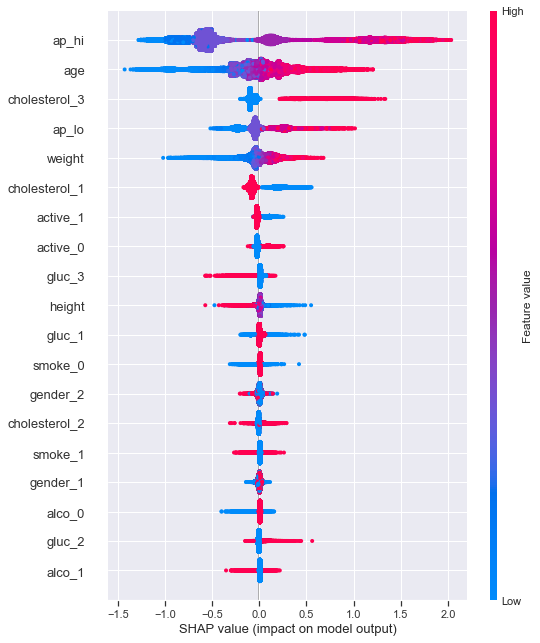

In [105]:
best_model_catboost = grid_search_catboost.best_estimator_
explainer = shap.TreeExplainer(best_model_catboost)
shap_values=explainer.shap_values(features_train, target_train)
shap.initjs()
shap.summary_plot(shap_values, features_train)

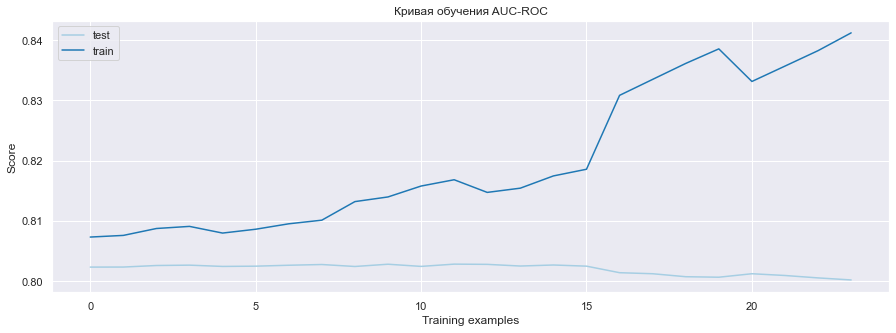

In [106]:
test_scores = grid_search_catboost.cv_results_['mean_test_score']
train_scores = grid_search_catboost.cv_results_['mean_train_score'] 

plt.plot(test_scores, label='test')
plt.plot(train_scores, label='train')
plt.legend(loc='best')
plt.xlabel('Training examples')
plt.ylabel('Score')
plt.title('Кривая обучения AUC-ROC')
plt.show()

In [ ]:
# models = [type(grid_search_dt.best_estimator_).__name__, type(grid_search_rf.best_estimator_).__name__, type(grid_search_lr.best_estimator_).__name__, type(grid_search_gb.best_estimator_).__name__, type(grid_search_xgb.best_estimator_).__name__, type(grid_search_catboost.best_estimator_).__name__ ]  
# roc = [grid_search_dt.best_score_, grid_search_rf.best_score_, grid_search_lr.best_score_, grid_search_gb.best_score_, grid_search_xgb.best_score_, grid_search_catboost.best_score_]
# parameters_best = [grid_search_dt.best_params_, grid_search_rf.best_params_, grid_search_lr.best_params_, grid_search_gb.best_params_, grid_search_xgb.best_params_, grid_search_catboost.best_params_]
# list_tuples = list(zip(models, roc, parameters_best)) 
# data = pd.DataFrame(list_tuples, columns=['Модель', 'AUC-ROC', 'Лучшие параметры']) 
# data.head(12)

In [108]:
models = [type(grid_search_gb.best_estimator_).__name__, type(grid_search_xgb.best_estimator_).__name__, type(grid_search_catboost.best_estimator_).__name__ ]  
roc = [grid_search_gb.best_score_, grid_search_xgb.best_score_, grid_search_catboost.best_score_]
parameters_best = [grid_search_gb.best_params_, grid_search_xgb.best_params_, grid_search_catboost.best_params_]
list_tuples = list(zip(models, roc, parameters_best)) 
data = pd.DataFrame(list_tuples, columns=['Модель', 'AUC-ROC', 'Лучшие параметры']) 
data.head()

,Модель,AUC-ROC,Лучшие параметры
0,GradientBoostingClassifier,0.803509,"{'learning_rate': 0.02, 'loss': 'exponential', 'max_depth': 5, 'max_features': 6, 'min_samples_leaf': 4, 'min_samples_split': 4, 'n_estimators': 440, 'subsample': 1}"
1,XGBClassifier,0.803395,"{'eta': 0.013991302340458816, 'max_depth': 5, 'n_estimators': 450, 'subsample': 0.7985915078268784}"
2,CatBoostClassifier,0.802787,"{'boosting_type': 'Plain', 'colsample_bylevel': 0.09963809767328392, 'depth': 6, 'l2_leaf_reg': 4, 'learning_rate': 0.07, 'n_estimators': 590, 'objective': 'Logloss', 'subsample': 1}"


# Получение submission

In [109]:
# Получение предсказаний test
target_pred_gb_test = grid_search_gb.predict_proba(features_test)[:, 1]

In [110]:
submission_data_gb = np.hstack((ids.values.reshape(-1, 1), target_pred_gb_test.reshape(-1, 1)))
submission_gb = pd.DataFrame(data=submission_data_gb, columns=['id', 'cardio'])
submission_gb['id']=submission_gb['id'].astype('int')
submission_gb.head()

,id,cardio
0,5,0.470795
1,6,0.552500
2,7,0.428968
3,10,0.562745
4,11,0.224261


In [111]:
submission_gb.to_csv('C:/Users/Elena/.kaggle/GradientBoosting_submission_result.csv', index=False)

In [112]:
!cat C:/Users/Olga/.kaggle/GradientBoosting_submission_result.csv | head

id,cardio
5,0.4707953960031836
6,0.5524997235404875
7,0.4289681817755665
10,0.5627449961419404
11,0.22426111614531966
17,0.29916410205241134
19,0.22712171992702648
20,0.436366448434804
22,0.2655903125903688


In [113]:
# Получение предсказаний test
target_pred_xgb_test = grid_search_xgb.predict_proba(features_test)[:, 1]

In [114]:
submission_data_xgb = np.hstack((ids.values.reshape(-1, 1), target_pred_xgb_test.reshape(-1, 1)))
submission_xgb = pd.DataFrame(data=submission_data_xgb, columns=['id', 'cardio'])
submission_xgb['id']=submission_xgb['id'].astype('int')
submission_xgb.head()

,id,cardio
0,5,0.489850
1,6,0.564291
2,7,0.431041
3,10,0.538002
4,11,0.219634


In [115]:
submission_xgb.to_csv('C:/Users/Elena/.kaggle/XGB_submission_result.csv', index=False)

In [116]:
!cat C:/Users/Olga/.kaggle/XGB_submission_result.csv | head

id,cardio
5,0.4898500144481659
6,0.5642907619476318
7,0.4310407340526581
10,0.5380018949508667
11,0.219633549451828
17,0.2932182550430298
19,0.21795286238193512
20,0.43485209345817566
22,0.2802661955356598


In [118]:
# Получение предсказаний test
target_pred_catboost_test = grid_search_catboost.predict_proba(features_test)[:, 1]

In [122]:
submission_data_catboost = np.hstack((ids.values.reshape(-1, 1), target_pred_catboost_test.reshape(-1, 1)))
submission_catboost = pd.DataFrame(data=submission_data_catboost, columns=['id', 'cardio'])
submission_catboost['id']=submission_catboost['id'].astype('int')
submission_catboost.head()

,id,cardio
0,5,0.485099
1,6,0.522464
2,7,0.404098
3,10,0.535744
4,11,0.221607


In [123]:
submission_catboost.to_csv('C:/Users/Elena/.kaggle/Catboost_submission_result.csv', index=False)

In [124]:
!cat C:/Users/Olga/.kaggle/Catboost_submission_result.csv | head

id,cardio
5,0.48509856092537945
6,0.5224641597799051
7,0.4040975987329845
10,0.5357442125483922
11,0.22160732939547031
17,0.2786322216548897
19,0.23574208213726275
20,0.41880445248457965
22,0.25315880972478777


# Выводы

Были проанализированы модели DecisionTreeClassifier, RandomForestClassifier, LogisticRegression, GradientBoostingClassifier, XGBClassifier, CatBoostClassifier. Первые три модели показали наименее значимый результат и были исключены из рассмотрения на первом этапе анализа.
Значимость признаков определялась с помощью библитеки SHAP. Наиболее значимыми признаками, влияющими на возникновение сердечно-сосудистых заболеваний являются ap_hi, ap_lo и значение cholesterol_3. Данные признаки действительно вносят наибольший вклад в развитие сердечно-сосудистых заболеваний.
Предобработка признаков производилась исходя из логики корректировки экстремальных значений (выбросов) по формулам:

нижняя граница: q25-1.5*(q75-q25)

верхняя граница q75+1.5*(q75-q25).

Интересно, что предобработка признаков не дала существенного вклада в улучшение результата. 
Private Score для данных без предобработки 0.80371.

Лучший результат показала модель градиентного бустинга c параметрами Значение auc-roc: 0.8035094787525118
Лучшие параметры: {'learning_rate': 0.02, 'loss': 'exponential', 'max_depth': 5, 'max_features': 6, 'min_samples_leaf': 4, 'min_samples_split': 4, 'n_estimators': 440, 'subsample': 1}. Подбор парамеров осуществлялся трехступенчато с постепенным сужением диапазона поисков с помощью optuna, RandomizedSearchCV и GridSearchCV.

Результат модели в соревновании Private Score:0.8038

# Сохранение лучшей модели, версионирование

In [125]:
print('The scikit-learn version is {}.'.format(sklearn.__version__))

The scikit-learn version is 1.1.3.


In [127]:
print('The XGB version is {}.'.format(xgb.__version__))

The XGB version is 1.7.3.


In [131]:
import pickle

In [132]:
import pickle
with open('C:/Users/Elena/Documents/SF/model.pkl', "wb") as dataset:
    pickle.dump(best_model_gb, dataset)
pickle.dump(scaler, open('C:/Users/Elena/Documents/SF/scaler.pkl','wb'))    